In [ ]:
from tensorflow import keras
from math import floor
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.datasets import mnist
from tensorflow.keras.layers import Input, Dropout, Flatten, Dense, Reshape, multiply, Embedding
from tensorflow.keras.layers import LeakyReLU, BatchNormalization
from tensorflow.keras.layers import Conv2D, Conv2DTranspose
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.optimizers import Adam
from google.colab import files

In [ ]:
#*******************   Loading Dataset *******************************
print('Started')
(trainx, trainy), (testx, testy) = mnist.load_data()
trainx = (trainx - 127.5)/127.5
testx = (testx - 127.5)/127.5
trainx = np.expand_dims(trainx, axis = -1)
testx = np.expand_dims(testx, axis = -1)
print(trainx.shape, trainy.shape, testx.shape, testy.shape, type(trainx))

Started
(60000, 28, 28, 1) (60000,) (10000, 28, 28, 1) (10000,) <class 'numpy.ndarray'>


In [ ]:
latent_size = 10
adam_lr = 0.0002
adam_beta_1 = 0.5
num_classes = 10

In [ ]:
# ********************   DISCRIMINATOR NETWORK   ****************************
def Discriminator(input__shape = (28,28,1)):
    
    model = Sequential()
    model.add(Conv2D(64, (3,3), strides = (2,2), input_shape = input__shape, padding = 'same'))
    model.add(LeakyReLU(alpha = 0.2))
    model.add(BatchNormalization())
    model.add(Conv2D(128, (3,3), strides = (2,2), padding = 'same'))
    model.add(LeakyReLU(alpha = 0.2))
    model.add(BatchNormalization())
    model.add(Dropout(0.3))
    model.add(Flatten())
    model.add(Dense(40, activation = 'relu'))
    model.summary()
    

    generated = Input(shape = (28,28,1))
    prediction = model(generated)
    fake_or_real = Dense(1, activation = 'sigmoid')(prediction)
    digit = Dense(num_classes, activation = 'softmax')(prediction)
    
    #model.compile(loss = 'binary_crossentropy', optimizer = Adam(), metrics = ['accuracy'])
    return Model(generated, [fake_or_real, digit])

In [ ]:
# ***************** Defining Discriminator ******************

discriminator = Discriminator()
discriminator.compile(loss = 'binary_crossentropy', optimizer = Adam(learning_rate = adam_lr, beta_1 = adam_beta_1), metrics = ['accuracy'])
discriminator.summary()
discriminator.save("Initial_Discriminator.h5")
#keras.utils.plot_model(discriminator)

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_8 (Conv2D)            (None, 14, 14, 64)        640       
_________________________________________________________________
leaky_re_lu_14 (LeakyReLU)   (None, 14, 14, 64)        0         
_________________________________________________________________
batch_normalization_10 (Batc (None, 14, 14, 64)        256       
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 7, 7, 128)         73856     
_________________________________________________________________
leaky_re_lu_15 (LeakyReLU)   (None, 7, 7, 128)         0         
_________________________________________________________________
batch_normalization_11 (Batc (None, 7, 7, 128)         512       
_________________________________________________________________
dropout_3 (Dropout)          (None, 7, 7, 128)        

In [ ]:
# *********************   Data Generating Functions For the Discriminator ************************

def discriminator_real_samples(dataset, num_samples):
	indx = np.random.randint(0, dataset.shape[0],num_samples)
	x = dataset[indx]
	y = np.ones((num_samples,1))
	return x, y

def discriminator_fake_samples(num_samples):
	x = np.random.uniform(0.0,1.0,num_samples*28*28)
	x = np.reshape(x, (num_samples, 28, 28, 1))
	y = np.zeros((num_samples,1))
	return x, y

In [ ]:
# ***********************  Training the Discriminator *******************

def train_discriminator(model, epoch = 10, batch_size = 128):
    print('Training Discriminator Started')
    for i in range(epoch):
        x_real , y_real = discriminator_real_samples(trainx, batch_size)
        _, real_acc = model.train_on_batch(x_real, y_real)
        x_fake, y_fake = discriminator_fake_samples(batch_size)
        _, fake_acc = model.train_on_batch(x_fake, y_fake)
        print('>%d real=%.0f%% fake=%.0f%%' % (i+1, real_acc*100, fake_acc*100))

In [ ]:
train_discriminator(discriminator)
discriminator.save('Initial_Discriminator.h5')

Training Discriminator Started
>1 real=83% fake=17%
>2 real=100% fake=98%
>3 real=100% fake=100%
>4 real=100% fake=100%
>5 real=100% fake=100%
>6 real=100% fake=100%
>7 real=100% fake=100%
>8 real=100% fake=100%
>9 real=100% fake=100%
>10 real=100% fake=100%


In [ ]:
# ************************  Generator Network **********************************

def Generator(latent_size = latent_size):
    model = Sequential()
    model.add(Dense(100, input_dim = latent_size))
    model.add(LeakyReLU(0.2))
    model.add(Dense(7*7*128))
    model.add(LeakyReLU(0.2))
    model.add(Reshape((7,7,128)))
    model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(BatchNormalization())
    model.add(Conv2DTranspose(256, (4,4), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(BatchNormalization())
    model.add(Conv2D(1, (7,7), activation='tanh', padding='same'))
    model.summary()
    
    random_vec = Input(shape = (latent_size,))
    image_class = Input(shape = (1,), dtype = 'int32')
    cls = Embedding(num_classes, latent_size, embeddings_initializer='glorot_normal')(image_class)
    inp = multiply([random_vec, cls])
    generated = model(inp)
    
    return Model([random_vec, image_class], generated)

In [ ]:
# ********************  Generator Data Generating Function *****************

def generator_fake_samples(length, n_samples):
    x = np.random.uniform(0, 1, length * n_samples)
    x = np.reshape(x, (n_samples, length))
    y = np.ones((n_samples,1))
    return x, y

In [ ]:
# **********************  Plot Images Function *************************** 
plt.rcParams['figure.figsize'] = 15, 15
def plot_predictions(model, data):
    y = model.predict(data)
    print(y.shape)
    for i in range(y.shape[0]):
        plt.subplot(y.shape[0]/4, 4, i+1)
        plt.imshow(np.reshape(y[i],(y.shape[1], y.shape[2])))
    plt.colorbar()
    plt.show()

In [ ]:
# ***************** Defining Generator ******************

generator = Generator()
generator.summary()
generator.save("Initial_Generator.h5")
#keras.utils.plot_model(generator)

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_16 (Dense)             (None, 100)               1100      
_________________________________________________________________
leaky_re_lu_16 (LeakyReLU)   (None, 100)               0         
_________________________________________________________________
dense_17 (Dense)             (None, 6272)              633472    
_________________________________________________________________
leaky_re_lu_17 (LeakyReLU)   (None, 6272)              0         
_________________________________________________________________
reshape_2 (Reshape)          (None, 7, 7, 128)         0         
_________________________________________________________________
conv2d_transpose_4 (Conv2DTr (None, 14, 14, 128)       262272    
_________________________________________________________________
leaky_re_lu_18 (LeakyReLU)   (None, 14, 14, 128)      

In [ ]:
generator.save('Generator.h5')
files.download('Generator.h5')
del generator
uploaded = files.upload()
generator = load_model('Generator.h5')

Saving Generator.h5 to Generator (1).h5


In [ ]:
generator = load_model("Initial_Generator.h5")

(24, 28, 28, 1)


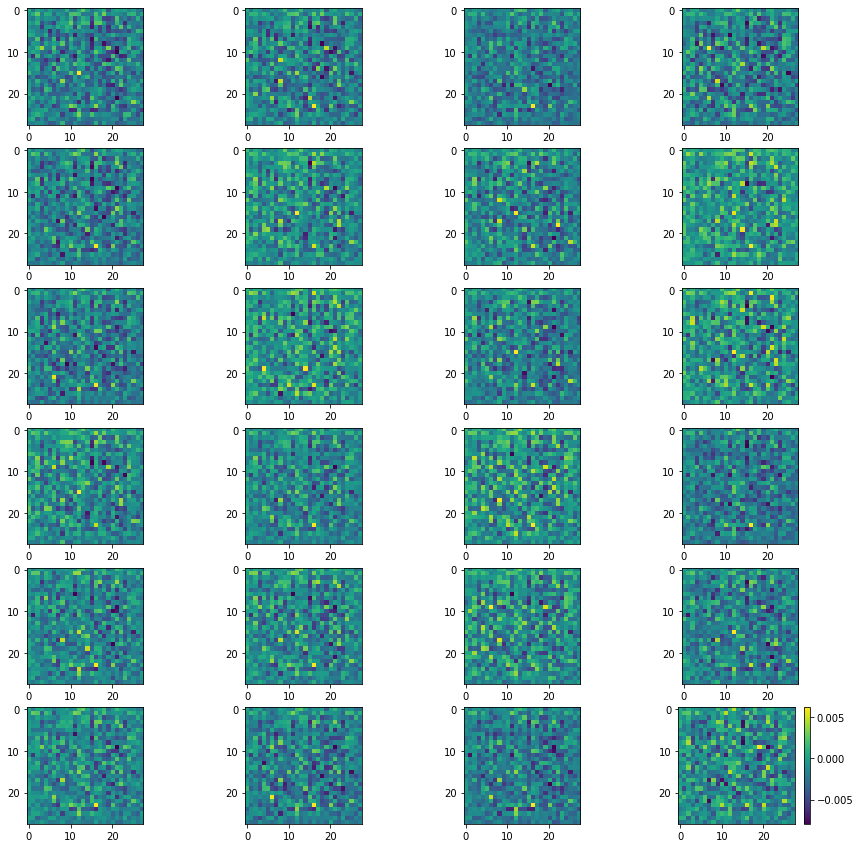

In [ ]:
x, _ = generator_fake_samples(10, 24)
plot_predictions(generator, x)

In [ ]:
# **********************  Defining GAN Network ******************

def GAN(g_model, d_model):
    d_model.trainable = False
    
    input_vec = Input(shape = (latent_size,))
    img_class = Input(shape = (1,), dtype = 'int32')
    gen_out = g_model([input_vec, img_class])
    fake_or_real, aux = d_model(gen_out)
    model = Model( [input_vec, img_class], [fake_or_real, aux] )

    return model

gan = GAN(generator, discriminator)
gan.compile(loss = 'binary_crossentropy', optimizer = Adam(learning_rate = adam_lr, beta_1 = adam_beta_1), metrics = ['accuracy'])
gan.summary()
gan.save('Initial_GAN.h5')
#gan.load_model('/content/gdrive/My Drive/GAN_MNIST_Weights/GAN_Weights0.h5')
#keras.utils.plot_model(gan)

Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_15 (InputLayer)           [(None, 10)]         0                                            
__________________________________________________________________________________________________
input_16 (InputLayer)           [(None, 1)]          0                                            
__________________________________________________________________________________________________
model_7 (Model)                 (None, 28, 28, 1)    1435569     input_15[0][0]                   
                                                                 input_16[0][0]                   
__________________________________________________________________________________________________
model_6 (Model)                 [(None, 1), (None, 1 326635      model_7[1][0]              

In [ ]:
files.download("Initial_GAN.h5")
files.download("Initial_Generator.h5")
files.download("Initial_Discriminator.h5")

8/8 [==============================] - 0s 10ms/step - loss: 0.1361 - accuracy: 0.8789
(20, 28, 28, 1)


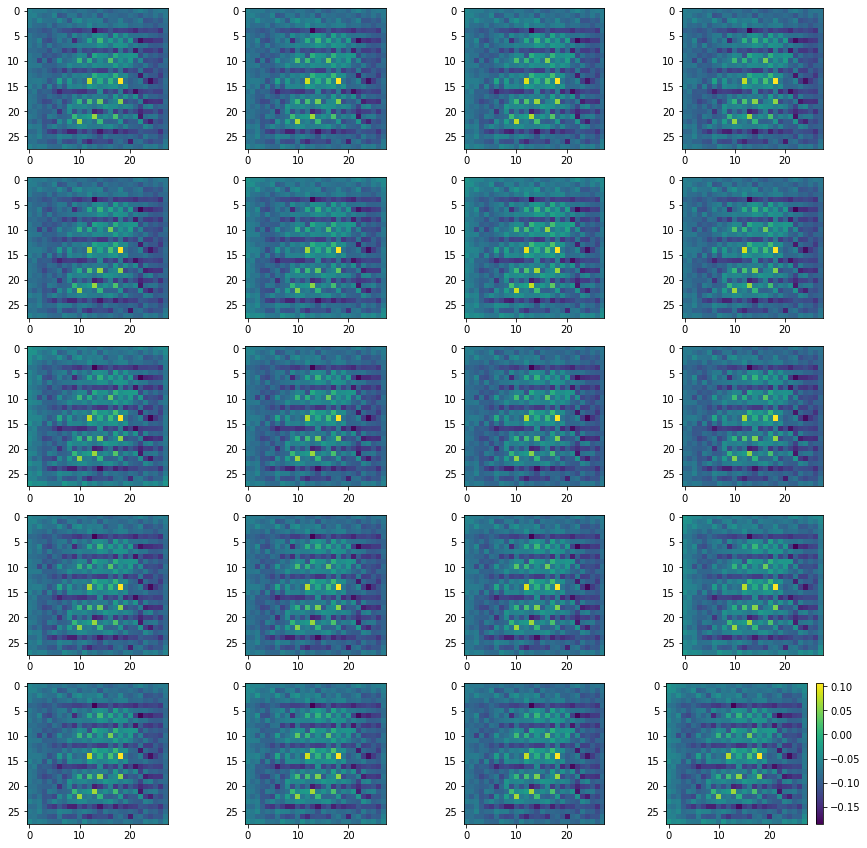

8/8 [==============================] - 0s 10ms/step - loss: 0.0112 - accuracy: 1.0000
(20, 28, 28, 1)


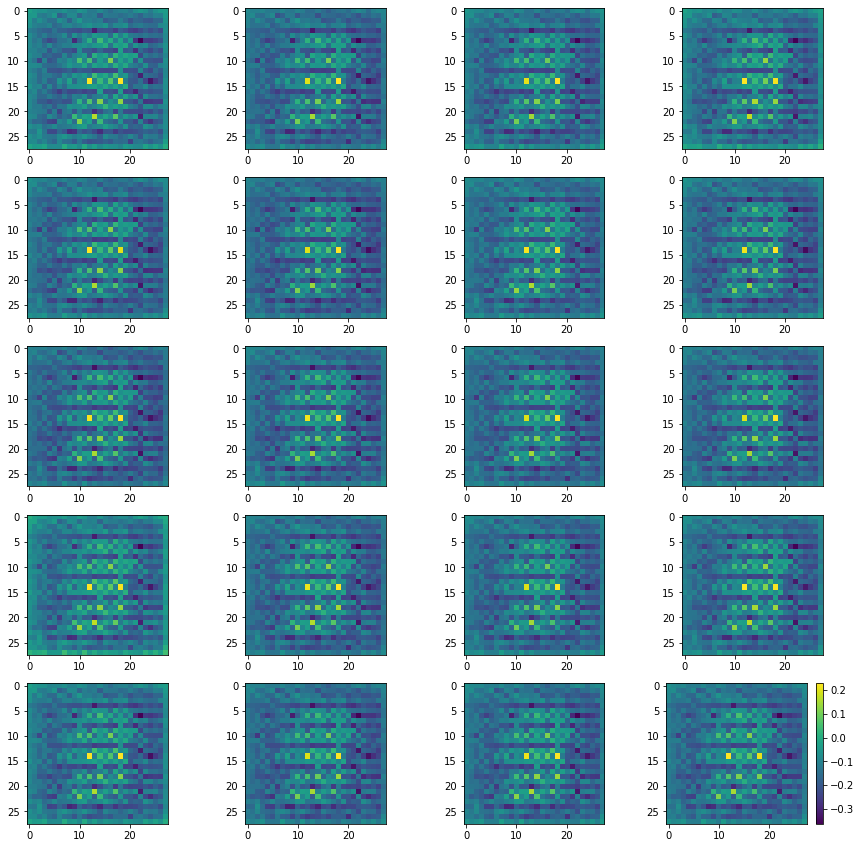

8/8 [==============================] - 0s 10ms/step - loss: 0.0068 - accuracy: 1.0000
(20, 28, 28, 1)


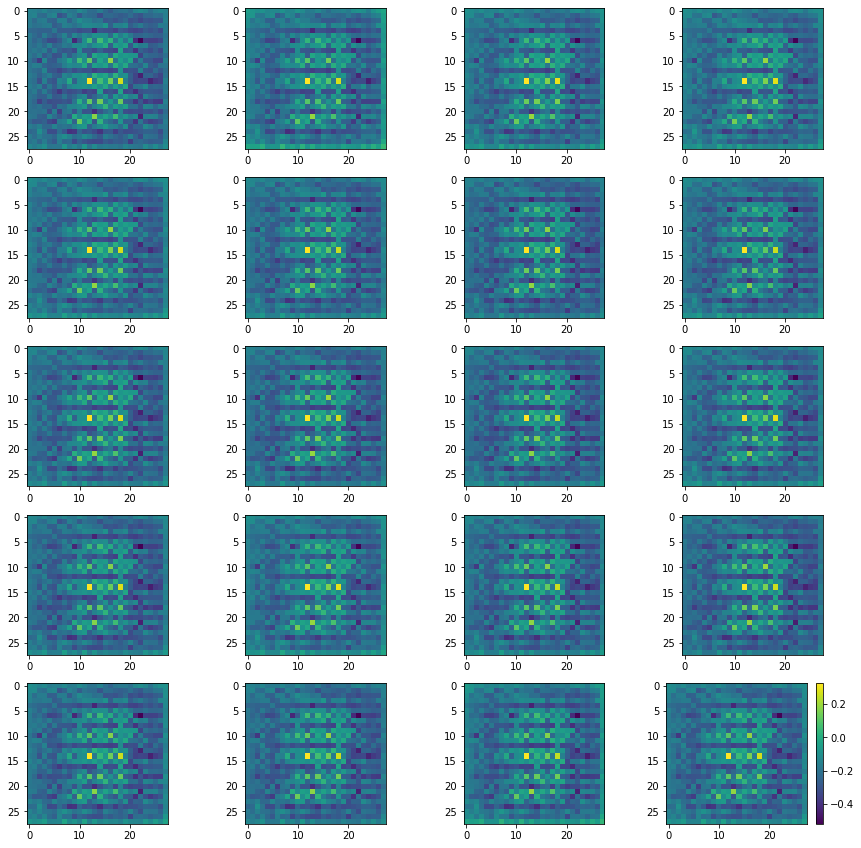

8/8 [==============================] - 0s 10ms/step - loss: 0.0055 - accuracy: 1.0000
(20, 28, 28, 1)


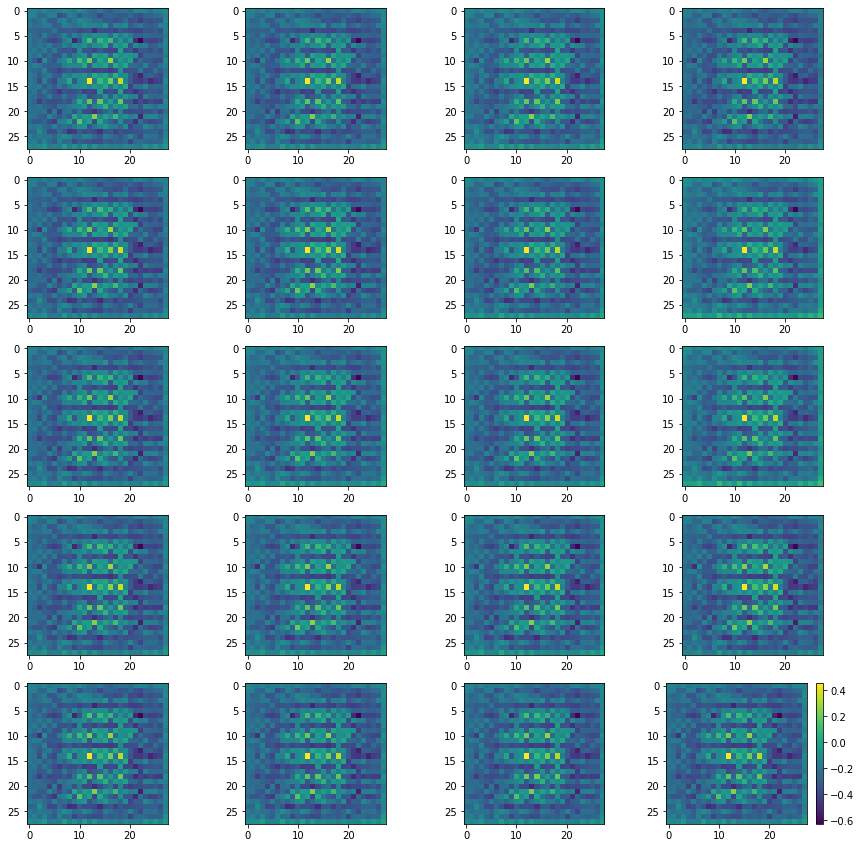

8/8 [==============================] - 0s 10ms/step - loss: 0.0050 - accuracy: 1.0000
(20, 28, 28, 1)


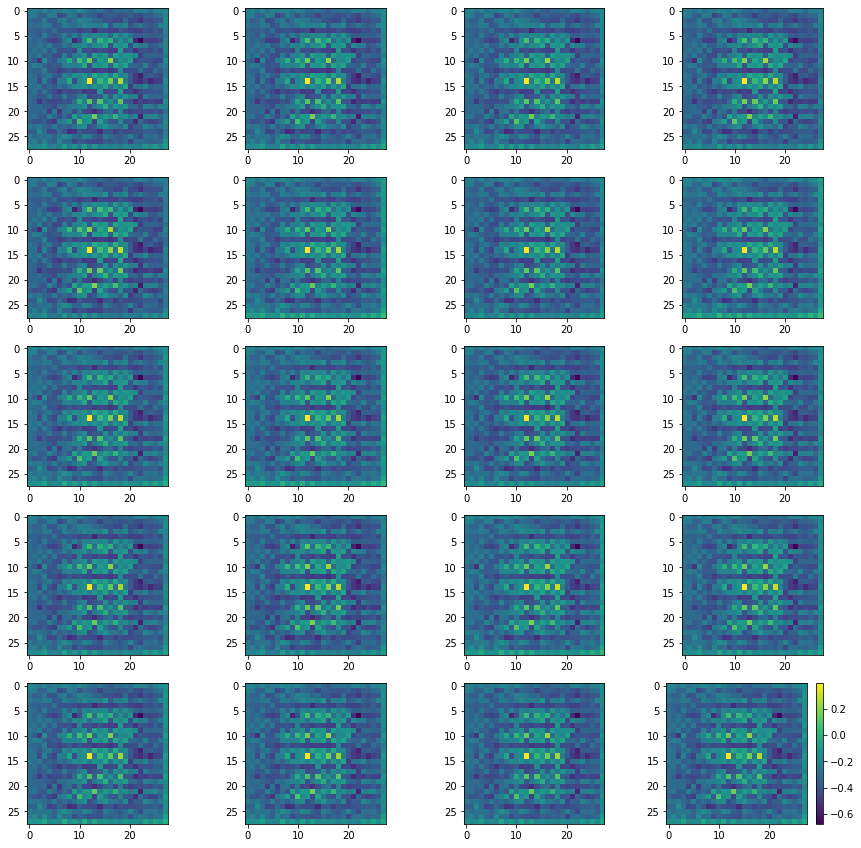

8/8 [==============================] - 0s 10ms/step - loss: 0.0048 - accuracy: 1.0000
(20, 28, 28, 1)


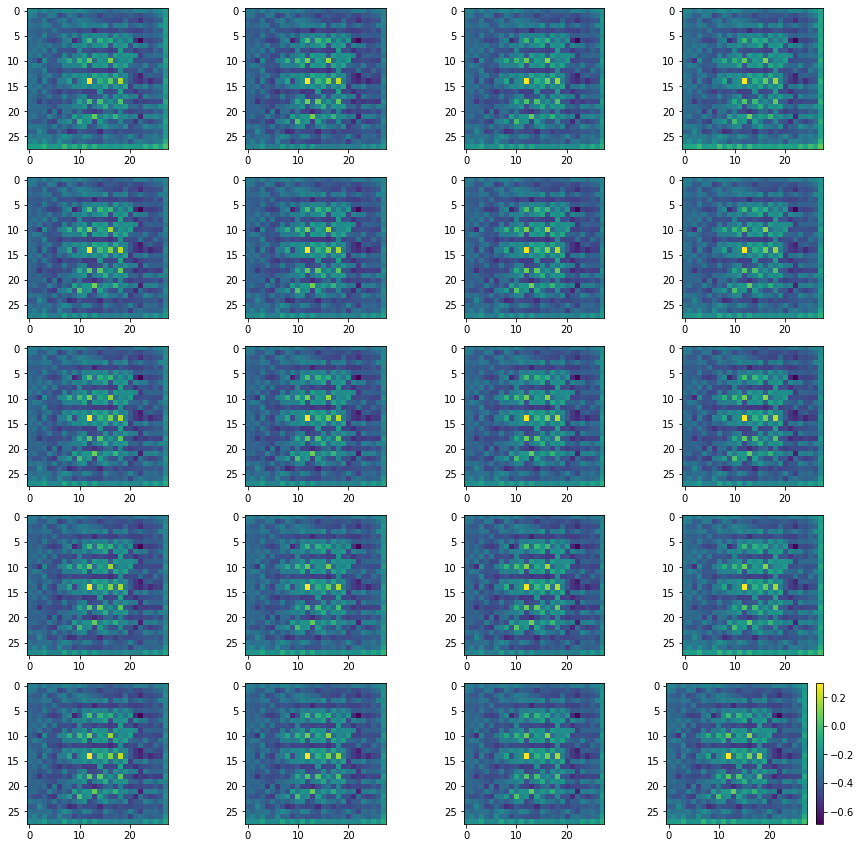

8/8 [==============================] - 0s 11ms/step - loss: 0.0046 - accuracy: 1.0000
(20, 28, 28, 1)


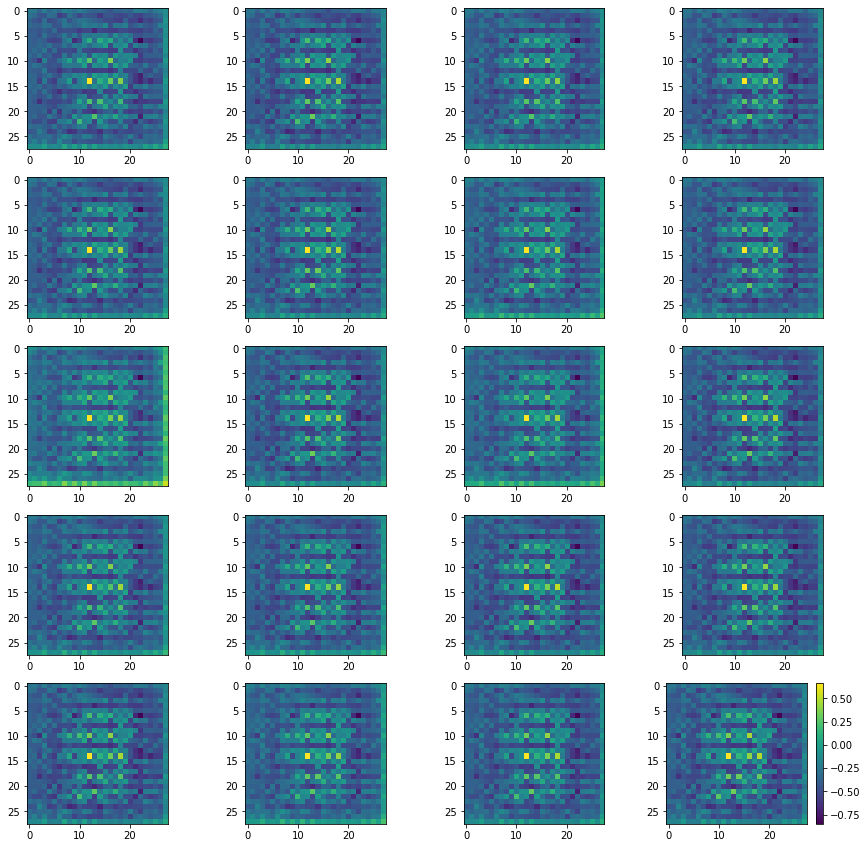

8/8 [==============================] - 0s 10ms/step - loss: 0.0044 - accuracy: 1.0000
(20, 28, 28, 1)


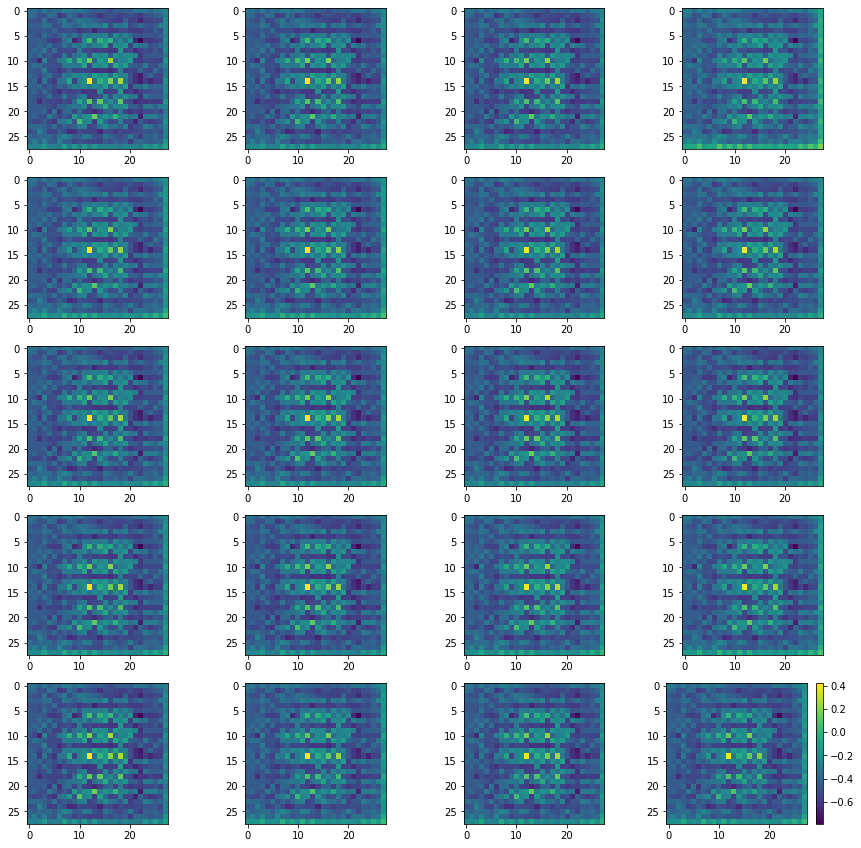

8/8 [==============================] - 0s 11ms/step - loss: 0.0044 - accuracy: 1.0000
(20, 28, 28, 1)


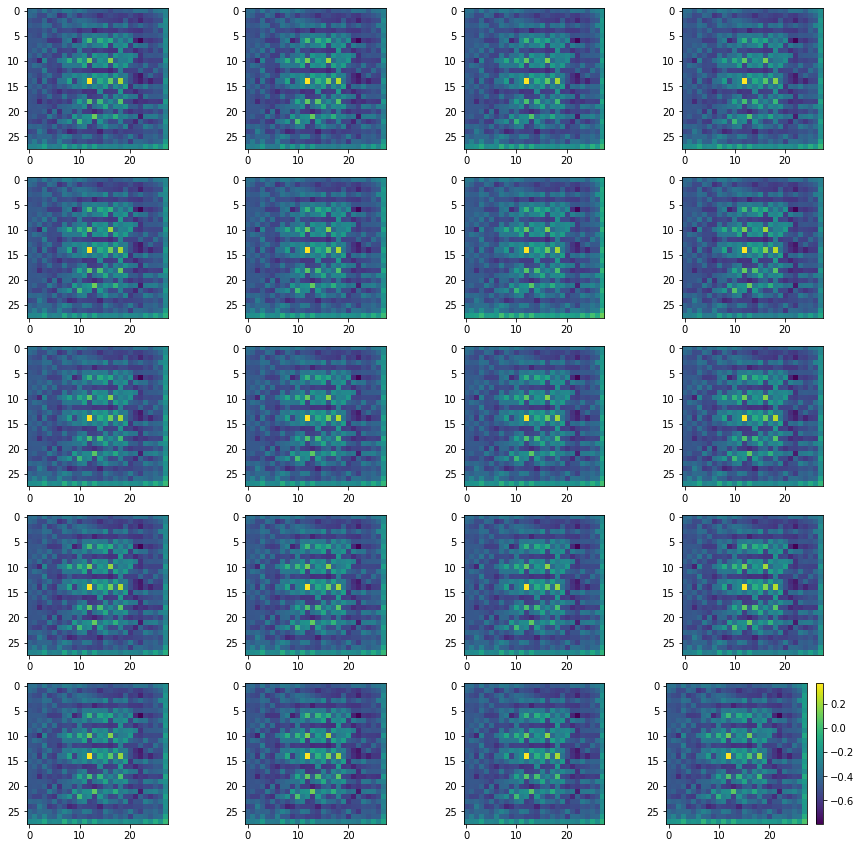

8/8 [==============================] - 0s 10ms/step - loss: 0.0043 - accuracy: 1.0000
(20, 28, 28, 1)


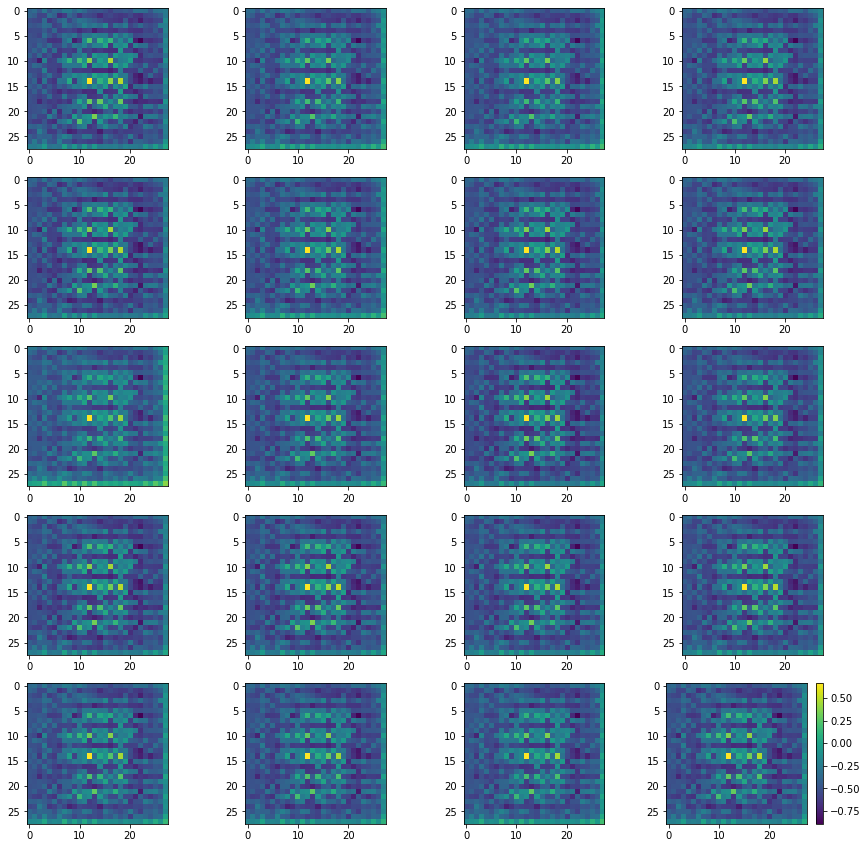

In [ ]:
# Already ran this cell. Not running this again as 100 % accuracy is reached this time
def train_gan(model, epochs = 10,input_len = 10, batch_size = 256):
    for i in range(epochs):
        x, y = generator_fake_samples(input_len, batch_size)
        model.fit(x, y)
        #print(">>> GAN Loss - ".format(loss))
        if i%1==0:
            X, _ = generator_fake_samples(10, 20)
            plot_predictions(generator, X)


train_gan(gan)
gan.save("GAN_0.h5")

Epoch : 1
Batch_Num : 1
D_Loss   :   [9.82553768157959, 0.31810462474823, 9.50743293762207, 0.5, 0.09765625] ;    GAN_Loss   :  [10.556924819946289, 0.4125016927719116, 10.144423484802246, 0.0, 0.109375]
(20, 28, 28, 1)


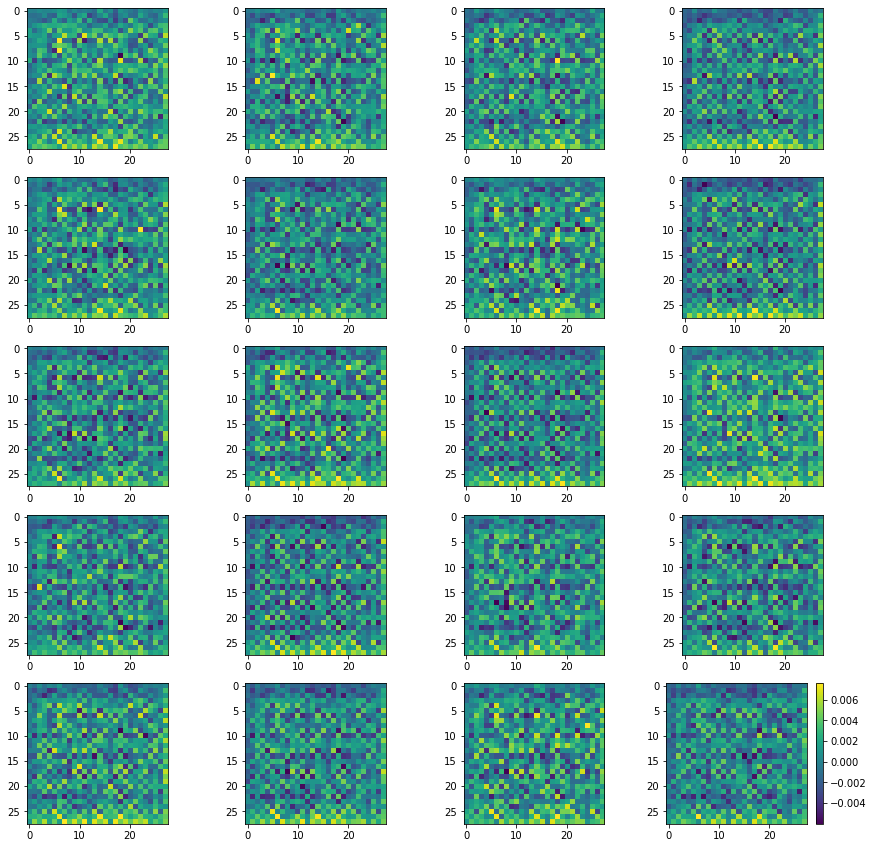

Batch_Num : 2
D_Loss   :   [10.506729125976562, 0.3161032199859619, 10.19062614440918, 0.5, 0.076171875] ;    GAN_Loss   :  [10.256378173828125, 0.3873344659805298, 9.869043350219727, 0.0, 0.103515625]
Batch_Num : 3
D_Loss   :   [10.542162895202637, 0.3272475302219391, 10.21491527557373, 0.5, 0.126953125] ;    GAN_Loss   :  [10.553436279296875, 0.37482428550720215, 10.178611755371094, 0.0, 0.091796875]
Batch_Num : 4
D_Loss   :   [10.631913185119629, 0.33178046345710754, 10.300132751464844, 0.5, 0.087890625] ;    GAN_Loss   :  [10.142460823059082, 0.36712104082107544, 9.77534008026123, 0.0, 0.07421875]
Batch_Num : 5
D_Loss   :   [10.484853744506836, 0.33014583587646484, 10.154707908630371, 0.5, 0.10546875] ;    GAN_Loss   :  [10.451784133911133, 0.35740116238594055, 10.094383239746094, 0.0, 0.099609375]
Batch_Num : 6
D_Loss   :   [10.776301383972168, 0.3281841576099396, 10.44811725616455, 0.5, 0.115234375] ;    GAN_Loss   :  [10.12929916381836, 0.3502429723739624, 9.779056549072266, 0.0

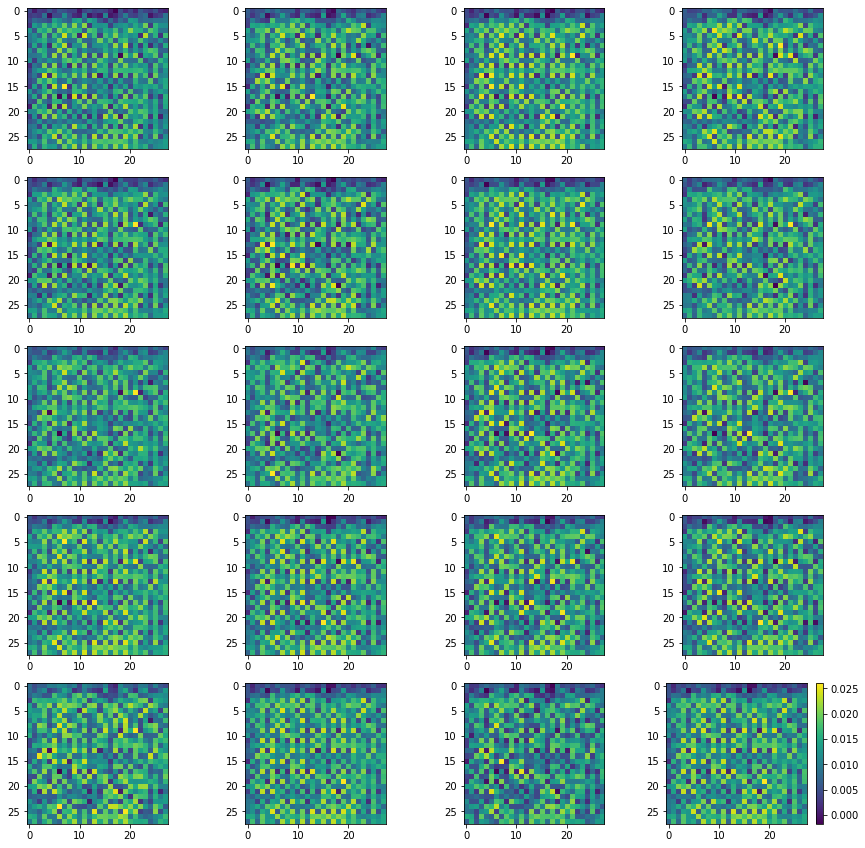

Batch_Num : 17
D_Loss   :   [10.030776023864746, 0.3408052325248718, 9.689970970153809, 0.5, 0.10546875] ;    GAN_Loss   :  [10.654029846191406, 0.31073540449142456, 10.343294143676758, 0.0, 0.10546875]
Batch_Num : 18
D_Loss   :   [10.163957595825195, 0.3396760821342468, 9.824281692504883, 0.5, 0.111328125] ;    GAN_Loss   :  [10.09736156463623, 0.30822068452835083, 9.789140701293945, 0.0, 0.109375]
Batch_Num : 19
D_Loss   :   [10.238460540771484, 0.34142622351646423, 9.897034645080566, 0.5, 0.095703125] ;    GAN_Loss   :  [10.915586471557617, 0.3049912452697754, 10.610594749450684, 0.0, 0.091796875]
Batch_Num : 20
D_Loss   :   [10.06438159942627, 0.341426819562912, 9.722954750061035, 0.5, 0.123046875] ;    GAN_Loss   :  [9.687726020812988, 0.3042667806148529, 9.383459091186523, 0.0, 0.130859375]
Batch_Num : 21
D_Loss   :   [9.894757270812988, 0.3400917053222656, 9.554665565490723, 0.5, 0.099609375] ;    GAN_Loss   :  [10.39632797241211, 0.29884904623031616, 10.097478866577148, 0.0, 0.

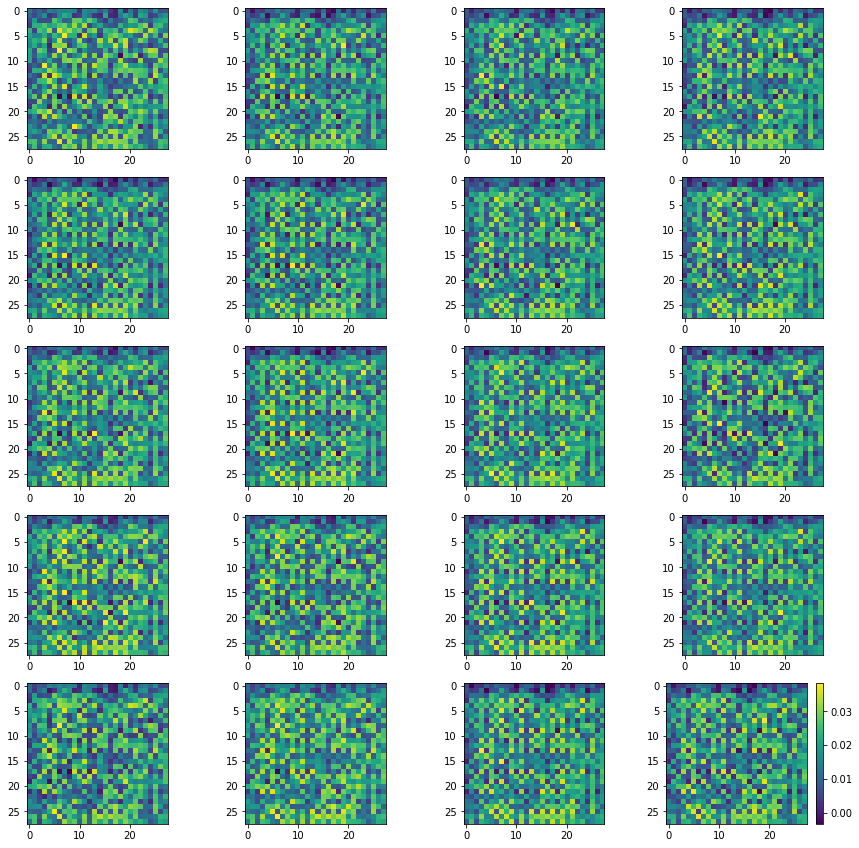

Batch_Num : 32
D_Loss   :   [9.920451164245605, 0.34003889560699463, 9.580411911010742, 0.5, 0.076171875] ;    GAN_Loss   :  [9.920204162597656, 0.28146541118621826, 9.638738632202148, 0.0, 0.099609375]
Batch_Num : 33
D_Loss   :   [10.506612777709961, 0.33928537368774414, 10.167327880859375, 0.5, 0.125] ;    GAN_Loss   :  [9.970762252807617, 0.2807765007019043, 9.689986228942871, 0.0, 0.109375]
Batch_Num : 34
D_Loss   :   [10.560158729553223, 0.34064173698425293, 10.21951675415039, 0.5, 0.09765625] ;    GAN_Loss   :  [9.797303199768066, 0.27954962849617004, 9.517753601074219, 0.0, 0.13671875]
Batch_Num : 35
D_Loss   :   [9.815040588378906, 0.33636903762817383, 9.47867202758789, 0.5, 0.0859375] ;    GAN_Loss   :  [10.707512855529785, 0.2768345773220062, 10.430678367614746, 0.0, 0.1015625]
Batch_Num : 36
D_Loss   :   [9.88485050201416, 0.3406989872455597, 9.544151306152344, 0.5, 0.103515625] ;    GAN_Loss   :  [10.37552547454834, 0.27876752614974976, 10.096757888793945, 0.0, 0.103515625]

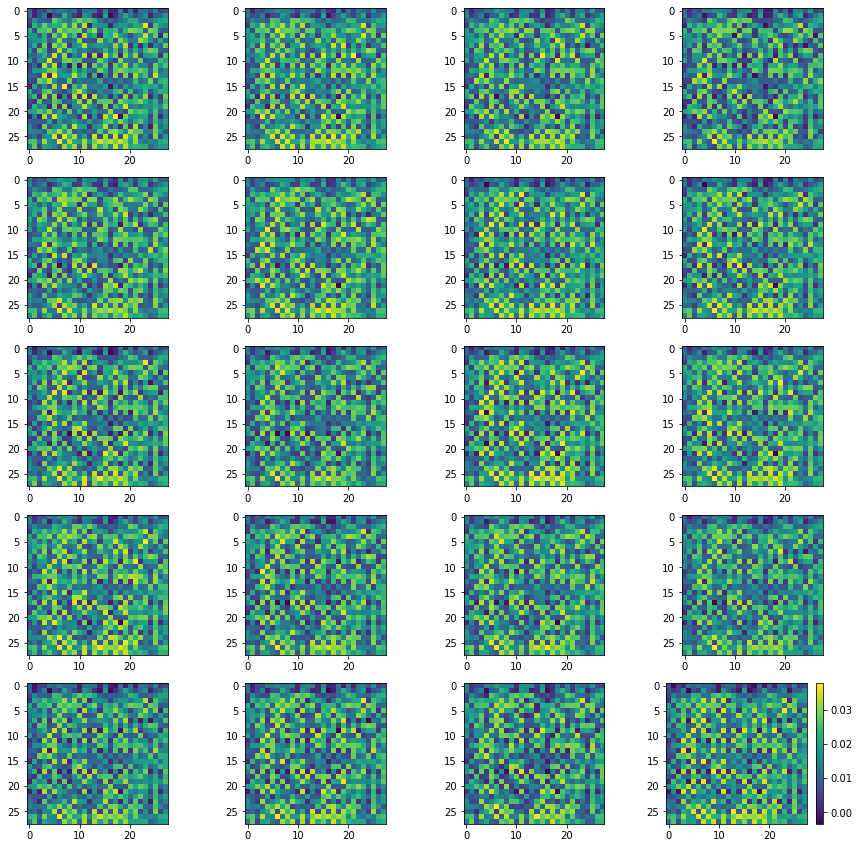

Batch_Num : 47
D_Loss   :   [10.87153148651123, 0.33950918912887573, 10.532022476196289, 0.5, 0.099609375] ;    GAN_Loss   :  [10.895633697509766, 0.2631378173828125, 10.632495880126953, 0.0, 0.099609375]
Batch_Num : 48
D_Loss   :   [10.316186904907227, 0.3361678719520569, 9.980018615722656, 0.5, 0.099609375] ;    GAN_Loss   :  [9.758743286132812, 0.2610608637332916, 9.497682571411133, 0.0, 0.103515625]
Batch_Num : 49
D_Loss   :   [10.241472244262695, 0.3362392485141754, 9.905233383178711, 0.5, 0.09375] ;    GAN_Loss   :  [10.085033416748047, 0.2606668174266815, 9.824366569519043, 0.0, 0.091796875]
Batch_Num : 50
D_Loss   :   [9.9666166305542, 0.3297768533229828, 9.636839866638184, 0.5, 0.11328125] ;    GAN_Loss   :  [10.444711685180664, 0.25990551710128784, 10.184805870056152, 0.0, 0.111328125]
Batch_Num : 51
D_Loss   :   [10.598699569702148, 0.33788883686065674, 10.260810852050781, 0.5, 0.107421875] ;    GAN_Loss   :  [10.104540824890137, 0.2564356327056885, 9.848105430603027, 0.0, 0

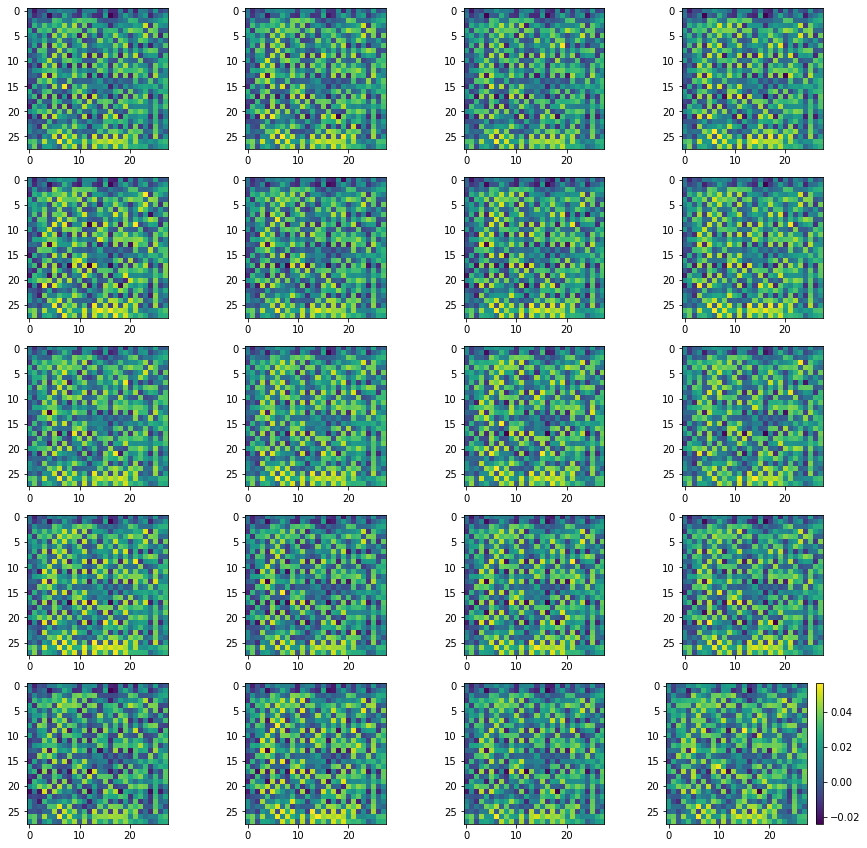

Batch_Num : 62
D_Loss   :   [9.964703559875488, 0.3329034447669983, 9.631799697875977, 0.5, 0.115234375] ;    GAN_Loss   :  [10.058554649353027, 0.2456832230091095, 9.812870979309082, 0.0, 0.099609375]
Batch_Num : 63
D_Loss   :   [10.226275444030762, 0.3354295790195465, 9.890846252441406, 0.5, 0.09375] ;    GAN_Loss   :  [10.124210357666016, 0.2467574179172516, 9.877452850341797, 0.0, 0.08984375]
Batch_Num : 64
D_Loss   :   [10.210006713867188, 0.3358725905418396, 9.874134063720703, 0.5, 0.09375] ;    GAN_Loss   :  [10.252429008483887, 0.24449223279953003, 10.007936477661133, 0.0, 0.08984375]
Batch_Num : 65
D_Loss   :   [10.340271949768066, 0.3347063362598419, 10.005565643310547, 0.5, 0.099609375] ;    GAN_Loss   :  [10.038782119750977, 0.2430380880832672, 9.795743942260742, 0.0, 0.09765625]
Batch_Num : 66
D_Loss   :   [10.969796180725098, 0.33860713243484497, 10.631189346313477, 0.5, 0.083984375] ;    GAN_Loss   :  [10.78249740600586, 0.2422802448272705, 10.540217399597168, 0.0, 0.113

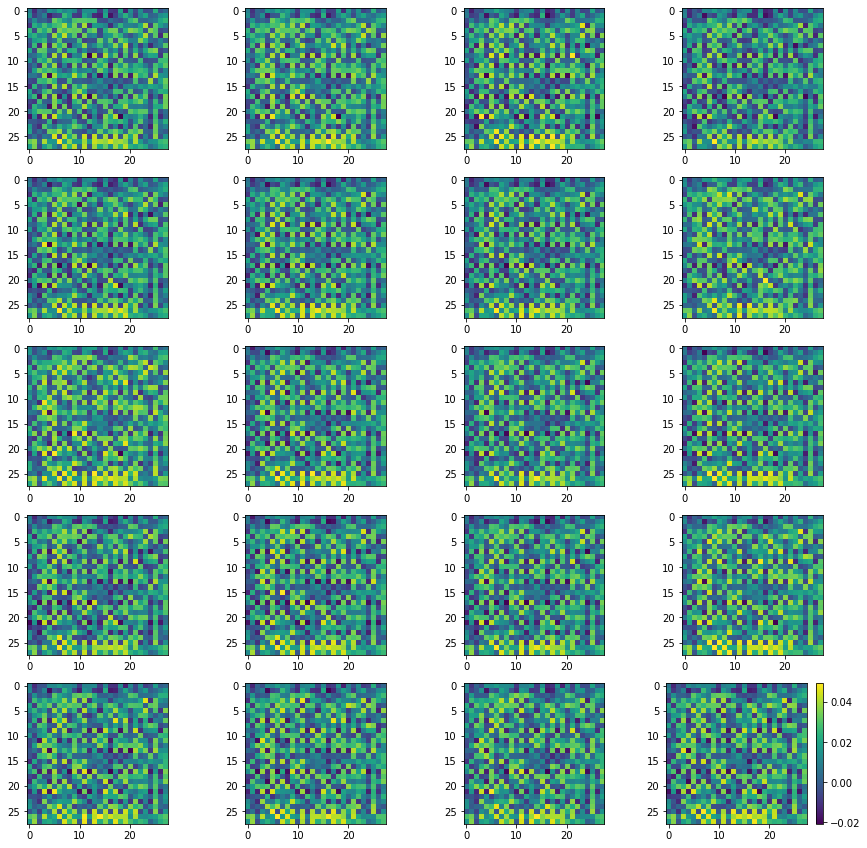

Batch_Num : 77
D_Loss   :   [10.242234230041504, 0.3305436968803406, 9.911690711975098, 0.5, 0.11328125] ;    GAN_Loss   :  [9.724552154541016, 0.23036915063858032, 9.494182586669922, 0.0, 0.103515625]
Batch_Num : 78
D_Loss   :   [9.896331787109375, 0.3308149576187134, 9.565516471862793, 0.5, 0.109375] ;    GAN_Loss   :  [10.404077529907227, 0.23012740910053253, 10.1739501953125, 0.0, 0.09765625]
Batch_Num : 79
D_Loss   :   [10.676895141601562, 0.327418714761734, 10.34947681427002, 0.5, 0.103515625] ;    GAN_Loss   :  [10.438590049743652, 0.2284323275089264, 10.21015739440918, 0.0, 0.109375]
Batch_Num : 80
D_Loss   :   [10.223867416381836, 0.3294644355773926, 9.894402503967285, 0.5, 0.09765625] ;    GAN_Loss   :  [10.334291458129883, 0.22784745693206787, 10.106444358825684, 0.0, 0.1015625]
Batch_Num : 81
D_Loss   :   [10.44921875, 0.3319018483161926, 10.117317199707031, 0.5, 0.091796875] ;    GAN_Loss   :  [10.079278945922852, 0.22838932275772095, 9.850889205932617, 0.0, 0.091796875]
B

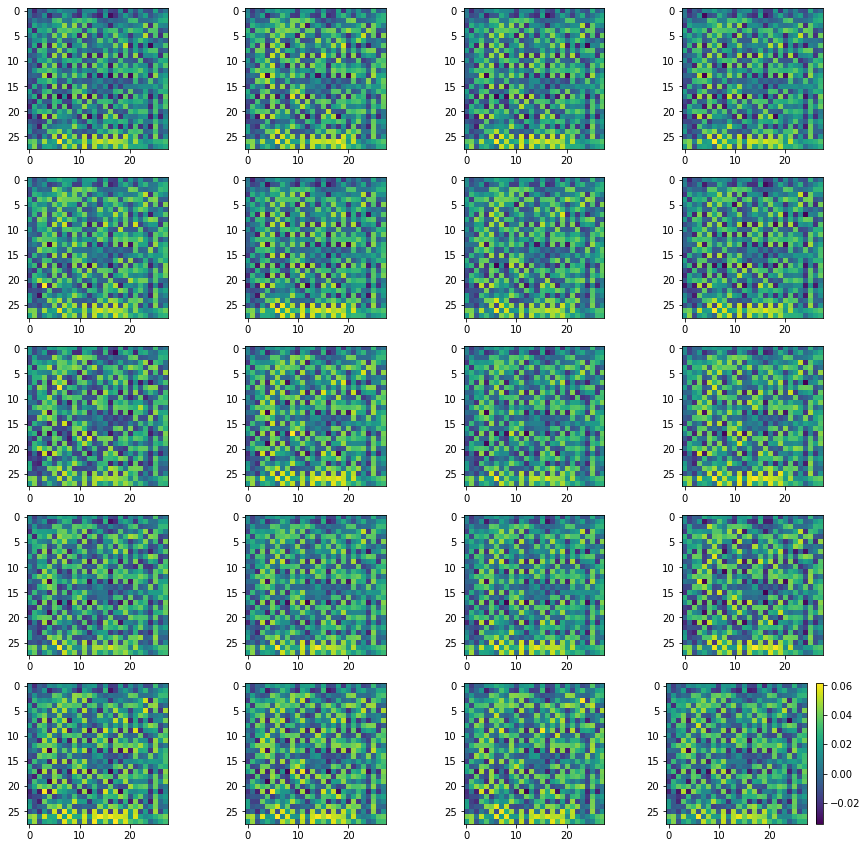

Batch_Num : 92
D_Loss   :   [10.342355728149414, 0.3276212513446808, 10.014734268188477, 0.5, 0.091796875] ;    GAN_Loss   :  [9.899154663085938, 0.21728801727294922, 9.681866645812988, 0.0, 0.083984375]
Batch_Num : 93
D_Loss   :   [10.782504081726074, 0.3275081515312195, 10.454996109008789, 0.5, 0.1015625] ;    GAN_Loss   :  [10.38696575164795, 0.21907107532024384, 10.16789436340332, 0.0, 0.1015625]
Batch_Num : 94
D_Loss   :   [10.200846672058105, 0.33047422766685486, 9.870372772216797, 0.5, 0.09765625] ;    GAN_Loss   :  [10.07217025756836, 0.21769729256629944, 9.854473114013672, 0.0, 0.111328125]
Batch_Num : 95
D_Loss   :   [10.3814058303833, 0.33134812116622925, 10.050057411193848, 0.5, 0.099609375] ;    GAN_Loss   :  [10.076393127441406, 0.2166440188884735, 9.859748840332031, 0.0, 0.1015625]
Batch_Num : 96
D_Loss   :   [9.929850578308105, 0.32408809661865234, 9.605762481689453, 0.5, 0.08203125] ;    GAN_Loss   :  [9.893623352050781, 0.21666491031646729, 9.676958084106445, 0.0, 0.1

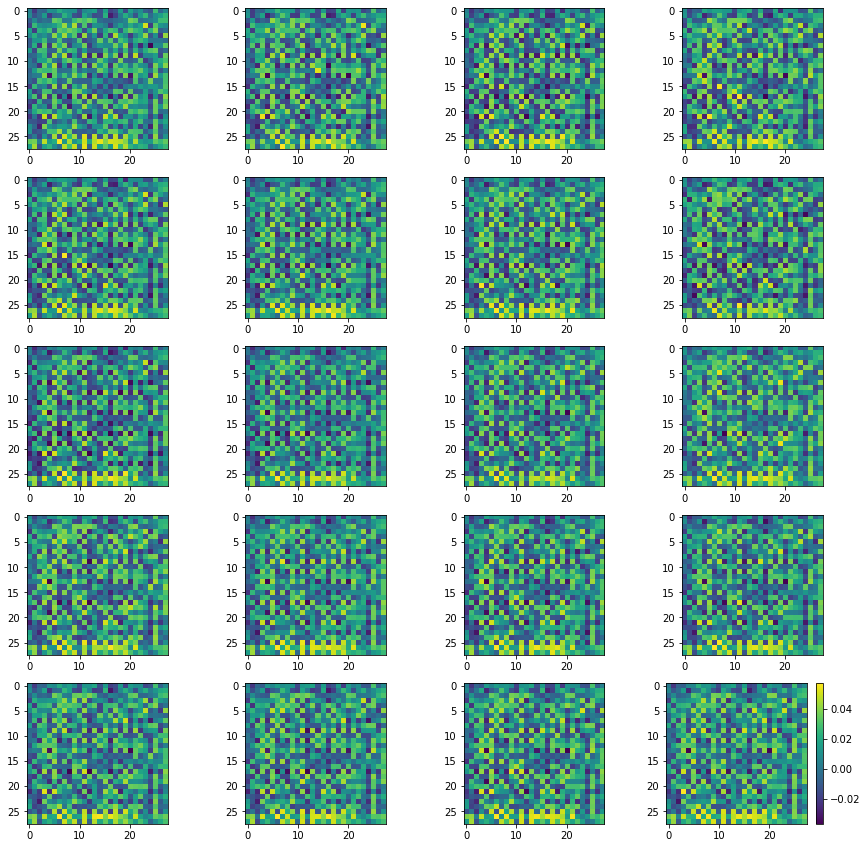

Batch_Num : 107
D_Loss   :   [10.203399658203125, 0.32618391513824463, 9.877215385437012, 0.5, 0.078125] ;    GAN_Loss   :  [10.58564567565918, 0.2094101458787918, 10.376235961914062, 0.0, 0.09375]
Batch_Num : 108
D_Loss   :   [9.63044261932373, 0.3260844647884369, 9.30435848236084, 0.5, 0.1015625] ;    GAN_Loss   :  [10.2410306930542, 0.20795772969722748, 10.033073425292969, 0.0, 0.109375]
Batch_Num : 109
D_Loss   :   [9.857611656188965, 0.3246457576751709, 9.532965660095215, 0.5, 0.087890625] ;    GAN_Loss   :  [10.319347381591797, 0.2082219272851944, 10.111124992370605, 0.0, 0.10546875]
Batch_Num : 110
D_Loss   :   [10.545326232910156, 0.32444965839385986, 10.220876693725586, 0.5, 0.107421875] ;    GAN_Loss   :  [10.453977584838867, 0.207474023103714, 10.246503829956055, 0.0, 0.1171875]
Batch_Num : 111
D_Loss   :   [9.719902038574219, 0.3207803964614868, 9.399121284484863, 0.5, 0.08203125] ;    GAN_Loss   :  [9.914983749389648, 0.2067774385213852, 9.708206176757812, 0.0, 0.109375]
B

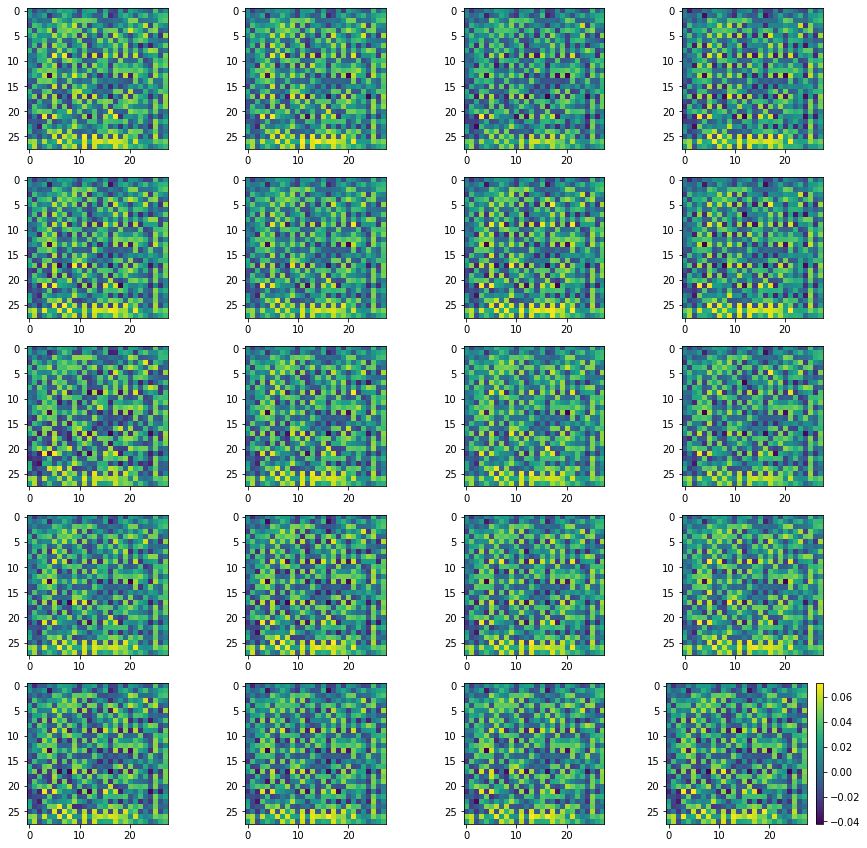

Batch_Num : 122
D_Loss   :   [10.727394104003906, 0.3209504187107086, 10.40644359588623, 0.5, 0.1015625] ;    GAN_Loss   :  [10.076844215393066, 0.20294290781021118, 9.8739013671875, 0.0, 0.107421875]
Batch_Num : 123
D_Loss   :   [10.104692459106445, 0.3235921561717987, 9.781100273132324, 0.5, 0.10546875] ;    GAN_Loss   :  [10.577672004699707, 0.20257316529750824, 10.375099182128906, 0.0, 0.083984375]
Batch_Num : 124
D_Loss   :   [10.453516960144043, 0.3260127604007721, 10.127504348754883, 0.5, 0.103515625] ;    GAN_Loss   :  [10.830181121826172, 0.20304657518863678, 10.627134323120117, 0.0, 0.10546875]
Batch_Num : 125
D_Loss   :   [10.62753677368164, 0.3287610411643982, 10.298775672912598, 0.5, 0.1015625] ;    GAN_Loss   :  [10.151416778564453, 0.20233167707920074, 9.949085235595703, 0.0, 0.125]
Batch_Num : 126
D_Loss   :   [10.575404167175293, 0.3277444541454315, 10.247659683227539, 0.5, 0.1171875] ;    GAN_Loss   :  [9.987679481506348, 0.20191136002540588, 9.785768508911133, 0.0, 0

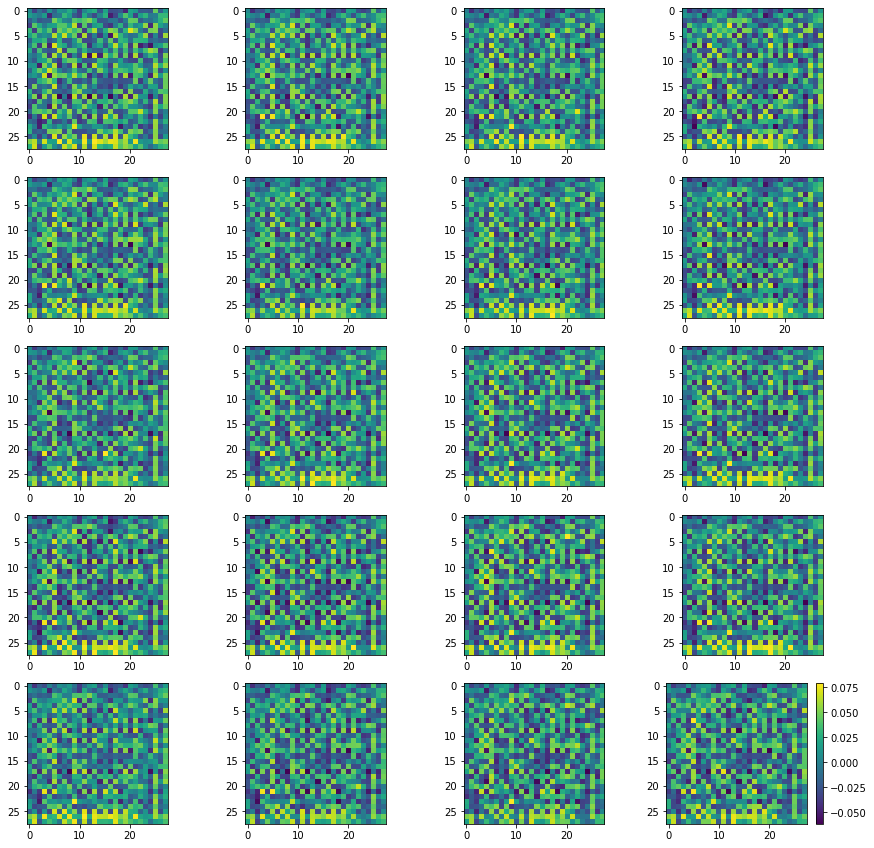

Batch_Num : 137
D_Loss   :   [10.951115608215332, 0.3233836889266968, 10.627732276916504, 0.5, 0.09765625] ;    GAN_Loss   :  [10.44975471496582, 0.2002745270729065, 10.249480247497559, 0.0, 0.11328125]
Batch_Num : 138
D_Loss   :   [10.221214294433594, 0.32574427127838135, 9.895469665527344, 0.5, 0.138671875] ;    GAN_Loss   :  [10.243624687194824, 0.19972792267799377, 10.043896675109863, 0.0, 0.10546875]
Batch_Num : 139
D_Loss   :   [10.124857902526855, 0.31906962394714355, 9.805788040161133, 0.5, 0.08984375] ;    GAN_Loss   :  [10.095301628112793, 0.19994738698005676, 9.895354270935059, 0.0, 0.087890625]
Batch_Num : 140
D_Loss   :   [9.714244842529297, 0.3141627311706543, 9.400081634521484, 0.5, 0.107421875] ;    GAN_Loss   :  [10.500762939453125, 0.19977563619613647, 10.300987243652344, 0.0, 0.12109375]
Batch_Num : 141
D_Loss   :   [10.300867080688477, 0.3244529366493225, 9.97641372680664, 0.5, 0.095703125] ;    GAN_Loss   :  [10.691544532775879, 0.19970029592514038, 10.491844177246

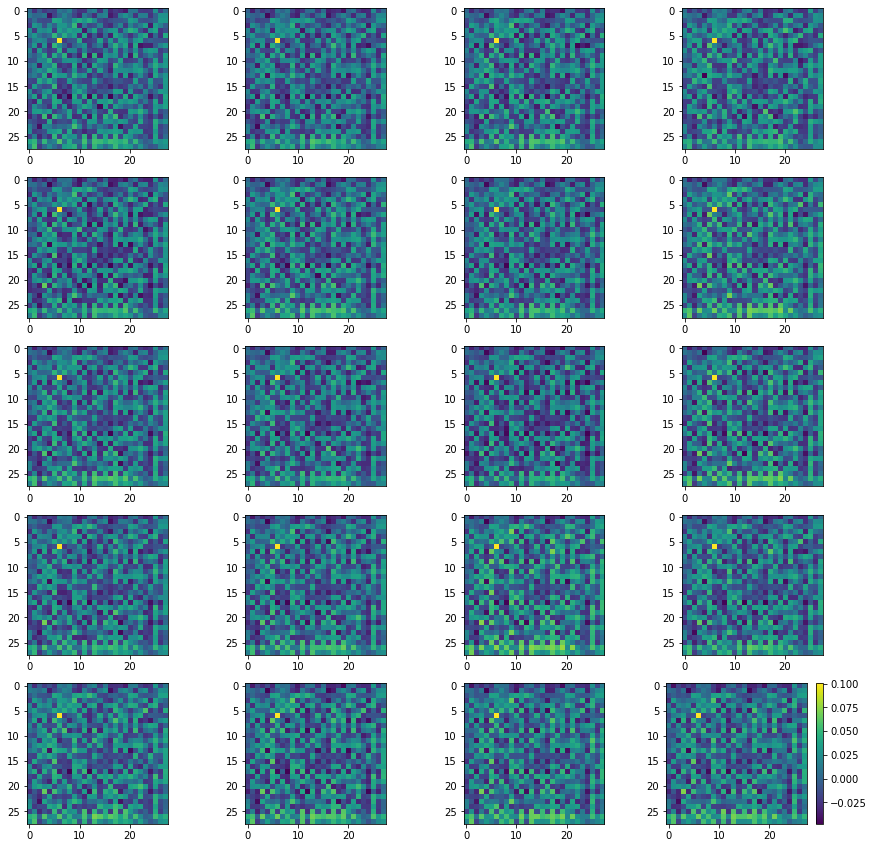

Batch_Num : 152
D_Loss   :   [9.993415832519531, 0.3180015981197357, 9.675414085388184, 0.5, 0.1015625] ;    GAN_Loss   :  [10.147157669067383, 0.1994991898536682, 9.94765853881836, 0.0, 0.10546875]
Batch_Num : 153
D_Loss   :   [10.248236656188965, 0.31647756695747375, 9.931758880615234, 0.5, 0.095703125] ;    GAN_Loss   :  [10.511045455932617, 0.1994055211544037, 10.311639785766602, 0.0, 0.0859375]
Batch_Num : 154
D_Loss   :   [10.22518539428711, 0.31910088658332825, 9.906084060668945, 0.5, 0.123046875] ;    GAN_Loss   :  [10.631060600280762, 0.19933132827281952, 10.431729316711426, 0.0, 0.0859375]
Batch_Num : 155
D_Loss   :   [10.584503173828125, 0.32326969504356384, 10.26123332977295, 0.5, 0.12109375] ;    GAN_Loss   :  [10.179948806762695, 0.1994568407535553, 9.980491638183594, 0.0, 0.078125]
Batch_Num : 156
D_Loss   :   [9.696632385253906, 0.3160055875778198, 9.380626678466797, 0.5, 0.09765625] ;    GAN_Loss   :  [9.811050415039062, 0.1995834857225418, 9.611467361450195, 0.0, 0.10

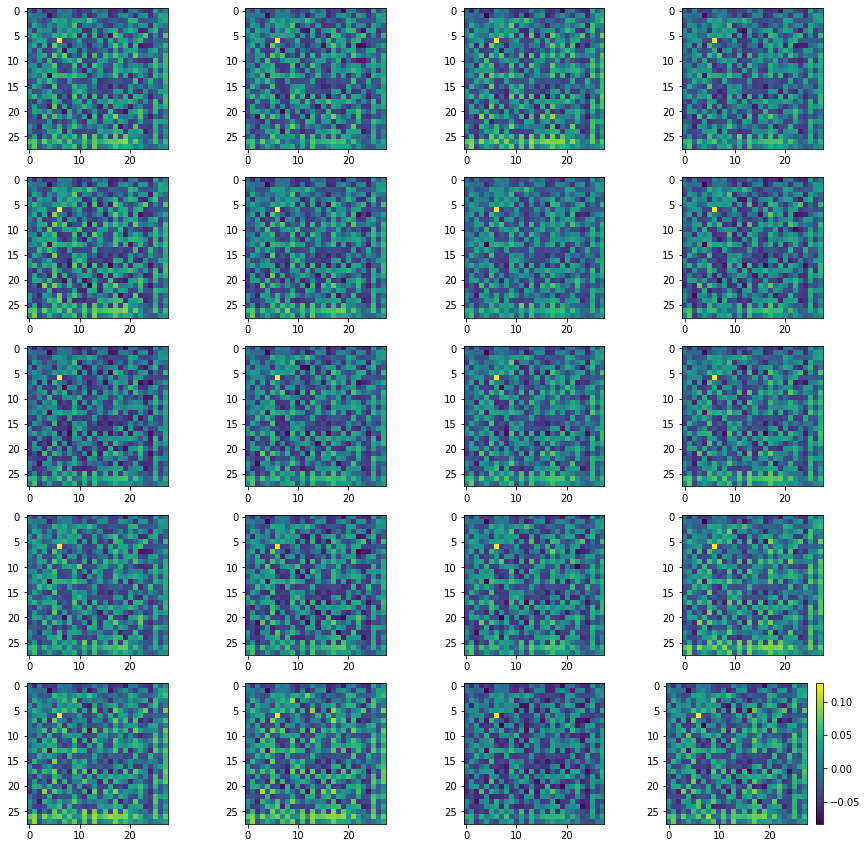

Batch_Num : 167
D_Loss   :   [10.716252326965332, 0.31854215264320374, 10.397709846496582, 0.5, 0.099609375] ;    GAN_Loss   :  [9.981219291687012, 0.20001879334449768, 9.781200408935547, 0.0, 0.083984375]
Batch_Num : 168
D_Loss   :   [9.751753807067871, 0.3120049238204956, 9.439748764038086, 0.5, 0.095703125] ;    GAN_Loss   :  [9.921895027160645, 0.1999129354953766, 9.7219820022583, 0.0, 0.10546875]
Batch_Num : 169
D_Loss   :   [10.271574020385742, 0.32000643014907837, 9.951567649841309, 0.5, 0.103515625] ;    GAN_Loss   :  [10.51827621459961, 0.20006315410137177, 10.31821346282959, 0.0, 0.111328125]
Batch_Num : 170
D_Loss   :   [10.249943733215332, 0.3187926709651947, 9.931151390075684, 0.5, 0.111328125] ;    GAN_Loss   :  [10.211902618408203, 0.19999158382415771, 10.011911392211914, 0.0, 0.095703125]
Batch_Num : 171
D_Loss   :   [10.593783378601074, 0.3175118863582611, 10.27627182006836, 0.5, 0.125] ;    GAN_Loss   :  [10.35657787322998, 0.20077669620513916, 10.155800819396973, 0.0

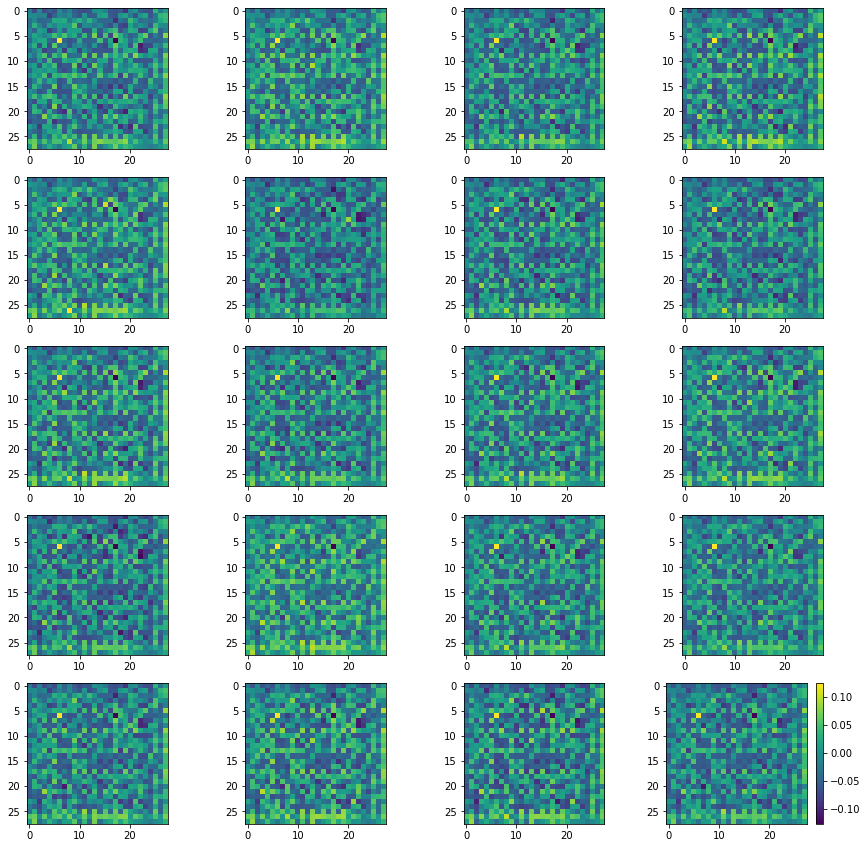

Batch_Num : 182
D_Loss   :   [9.902387619018555, 0.3143141567707062, 9.58807373046875, 0.5, 0.109375] ;    GAN_Loss   :  [11.042285919189453, 0.20021319389343262, 10.842072486877441, 0.0, 0.103515625]
Batch_Num : 183
D_Loss   :   [10.549127578735352, 0.3192063868045807, 10.229921340942383, 0.5, 0.123046875] ;    GAN_Loss   :  [10.561056137084961, 0.19992078840732574, 10.361135482788086, 0.0, 0.107421875]
Batch_Num : 184
D_Loss   :   [10.021413803100586, 0.31203240156173706, 9.709381103515625, 0.5, 0.115234375] ;    GAN_Loss   :  [10.698711395263672, 0.20015457272529602, 10.498557090759277, 0.0, 0.115234375]
Batch_Num : 185
D_Loss   :   [10.10446834564209, 0.3196917474269867, 9.78477668762207, 0.5, 0.099609375] ;    GAN_Loss   :  [9.820710182189941, 0.19979725778102875, 9.620912551879883, 0.0, 0.076171875]
Batch_Num : 186
D_Loss   :   [9.697278022766113, 0.31586506962776184, 9.381412506103516, 0.5, 0.091796875] ;    GAN_Loss   :  [10.23132610321045, 0.1998836249113083, 10.03144264221191

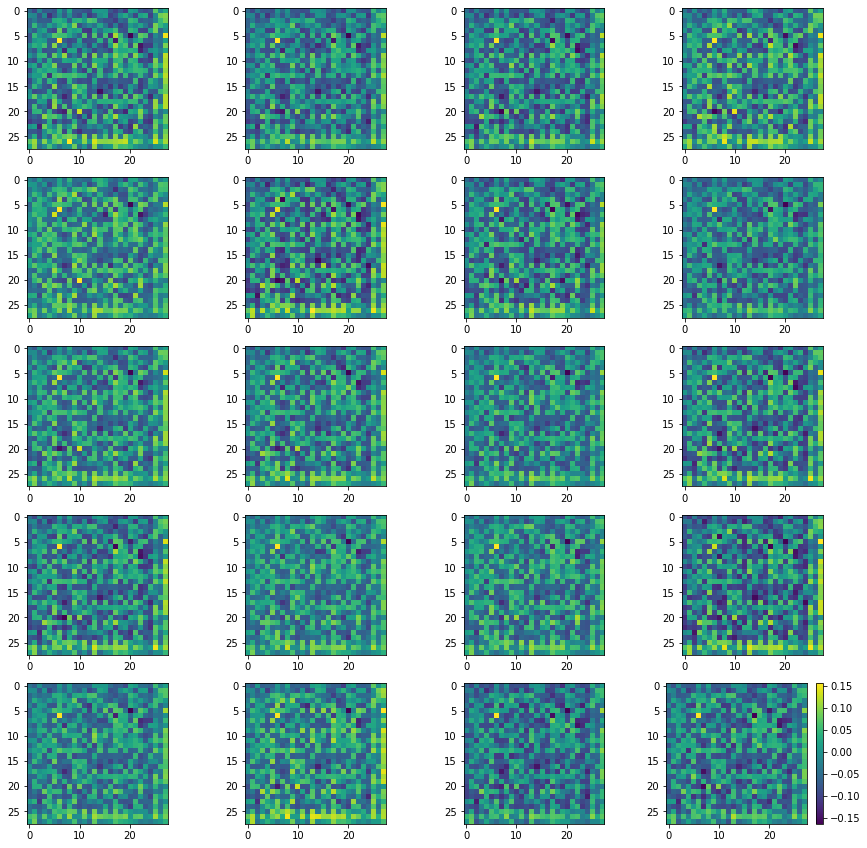

Batch_Num : 197
D_Loss   :   [10.157061576843262, 0.31671851873397827, 9.840343475341797, 0.5, 0.091796875] ;    GAN_Loss   :  [10.643752098083496, 0.19988839328289032, 10.443863868713379, 0.0, 0.078125]
Batch_Num : 198
D_Loss   :   [9.858153343200684, 0.3139353394508362, 9.544218063354492, 0.5, 0.10546875] ;    GAN_Loss   :  [10.270000457763672, 0.19973988831043243, 10.070261001586914, 0.0, 0.1015625]
Batch_Num : 199
D_Loss   :   [10.760488510131836, 0.31812113523483276, 10.442367553710938, 0.5, 0.09375] ;    GAN_Loss   :  [10.301487922668457, 0.19994200766086578, 10.101546287536621, 0.0, 0.07421875]
Batch_Num : 200
D_Loss   :   [10.333467483520508, 0.31393957138061523, 10.019527435302734, 0.5, 0.1015625] ;    GAN_Loss   :  [9.792211532592773, 0.19988679885864258, 9.592325210571289, 0.0, 0.109375]
Batch_Num : 201
D_Loss   :   [10.561172485351562, 0.3132168650627136, 10.247955322265625, 0.5, 0.091796875] ;    GAN_Loss   :  [10.10244083404541, 0.19979572296142578, 9.902645111083984, 0.0

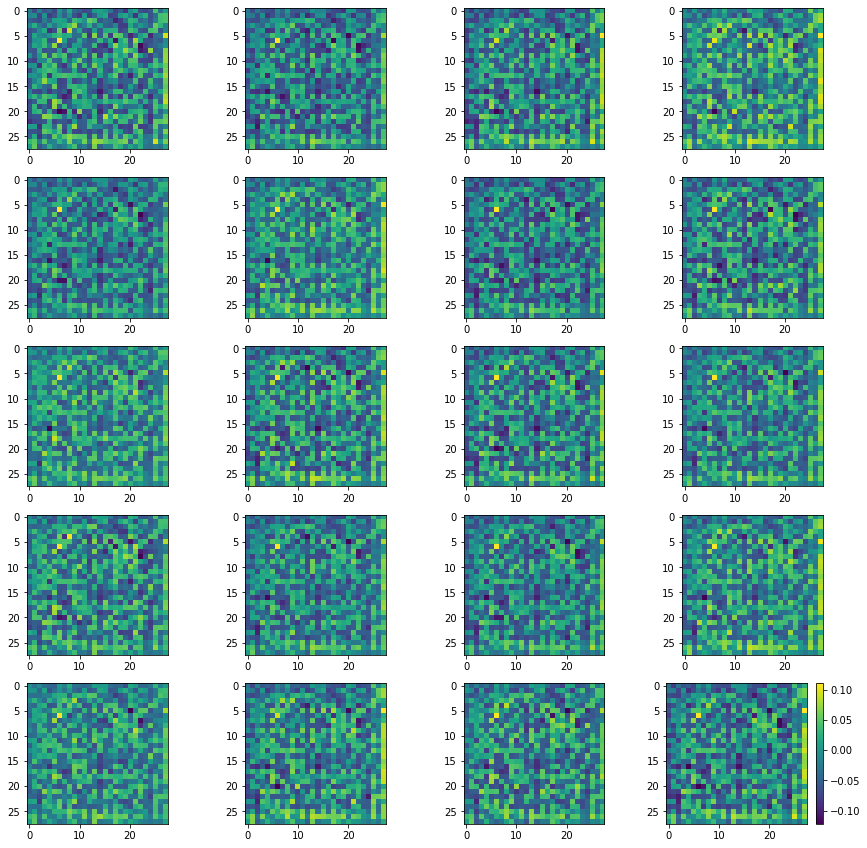

Batch_Num : 212
D_Loss   :   [11.098787307739258, 0.3174115717411041, 10.781375885009766, 0.5, 0.087890625] ;    GAN_Loss   :  [10.363622665405273, 0.2000173032283783, 10.163605690002441, 0.0, 0.083984375]
Batch_Num : 213
D_Loss   :   [9.778871536254883, 0.31419363617897034, 9.464677810668945, 0.5, 0.099609375] ;    GAN_Loss   :  [10.171070098876953, 0.19984157383441925, 9.97122859954834, 0.0, 0.125]
Batch_Num : 214
D_Loss   :   [10.551071166992188, 0.31724485754966736, 10.233826637268066, 0.5, 0.087890625] ;    GAN_Loss   :  [10.409331321716309, 0.20005066692829132, 10.209280967712402, 0.0, 0.109375]
Batch_Num : 215
D_Loss   :   [9.380967140197754, 0.30458205938339233, 9.076385498046875, 0.5, 0.099609375] ;    GAN_Loss   :  [10.359881401062012, 0.19996695220470428, 10.159914016723633, 0.0, 0.119140625]
Batch_Num : 216
D_Loss   :   [10.596049308776855, 0.30973559617996216, 10.286314010620117, 0.5, 0.087890625] ;    GAN_Loss   :  [10.764397621154785, 0.2000584751367569, 10.5643386840820

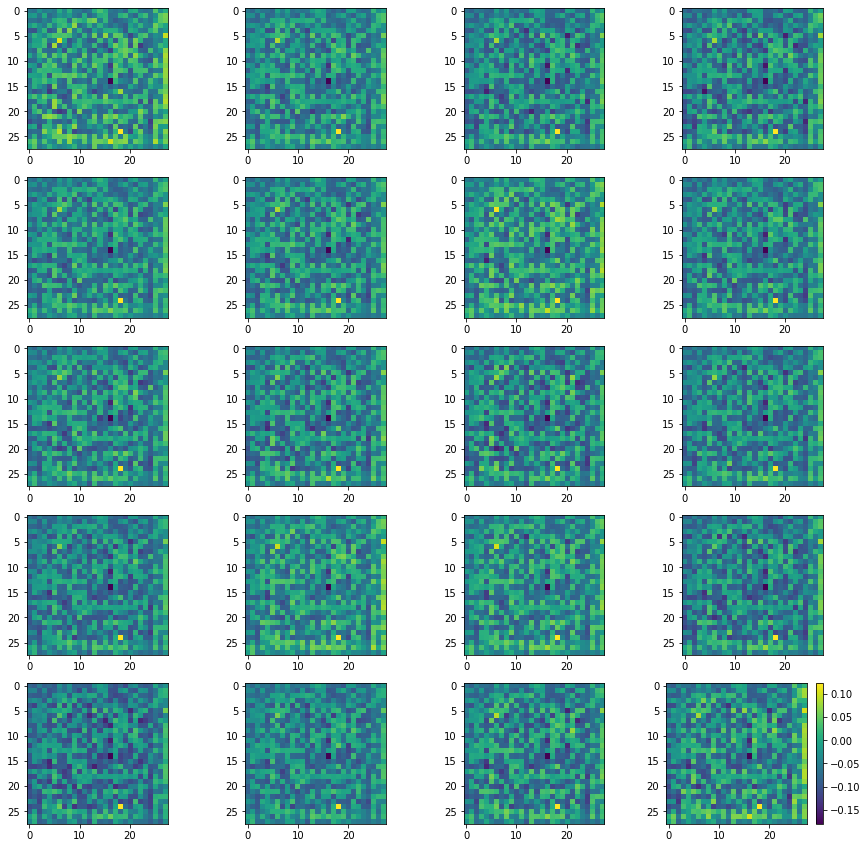

Batch_Num : 227
D_Loss   :   [9.438497543334961, 0.30945172905921936, 9.129045486450195, 0.5, 0.103515625] ;    GAN_Loss   :  [10.176193237304688, 0.20026114583015442, 9.975932121276855, 0.0, 0.09375]
Batch_Num : 228
D_Loss   :   [10.54336929321289, 0.3084295988082886, 10.234939575195312, 0.5, 0.1015625] ;    GAN_Loss   :  [9.729142189025879, 0.2000926434993744, 9.52904987335205, 0.0, 0.107421875]
Batch_Num : 229
D_Loss   :   [9.95886516571045, 0.3062182068824768, 9.652647018432617, 0.5, 0.08984375] ;    GAN_Loss   :  [10.545876502990723, 0.20020663738250732, 10.345669746398926, 0.0, 0.095703125]
Batch_Num : 230
D_Loss   :   [10.28465747833252, 0.31069833040237427, 9.973958969116211, 0.5, 0.11328125] ;    GAN_Loss   :  [10.567869186401367, 0.2004513144493103, 10.36741828918457, 0.0, 0.10546875]
Batch_Num : 231
D_Loss   :   [10.522417068481445, 0.30736875534057617, 10.215047836303711, 0.5, 0.1171875] ;    GAN_Loss   :  [10.400033950805664, 0.20047590136528015, 10.19955825805664, 0.0, 0.

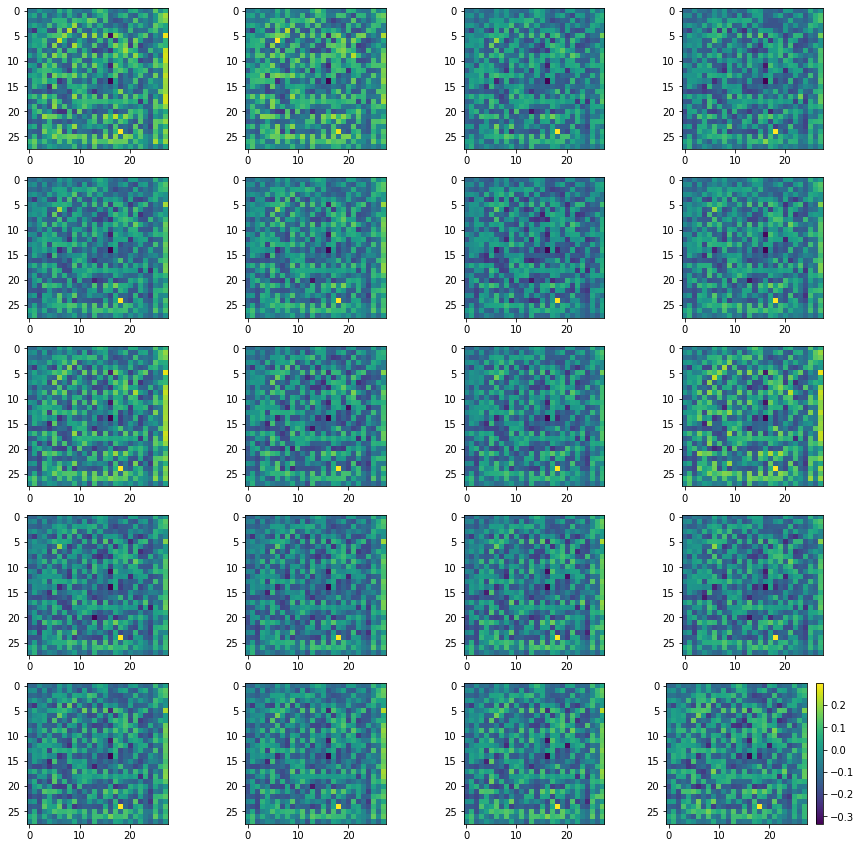

Batch_Num : 2
D_Loss   :   [10.31252670288086, 0.30538469552993774, 10.007142066955566, 0.5, 0.103515625] ;    GAN_Loss   :  [9.667683601379395, 0.20033469796180725, 9.4673490524292, 0.0, 0.1015625]
Batch_Num : 3
D_Loss   :   [10.34768295288086, 0.30731886625289917, 10.040364265441895, 0.5, 0.13671875] ;    GAN_Loss   :  [10.484410285949707, 0.20029331743717194, 10.284116744995117, 0.0, 0.0859375]
Batch_Num : 4
D_Loss   :   [10.52720832824707, 0.31148797273635864, 10.215720176696777, 0.5, 0.1171875] ;    GAN_Loss   :  [9.7405424118042, 0.20041683316230774, 9.540125846862793, 0.0, 0.1171875]
Batch_Num : 5
D_Loss   :   [10.371564865112305, 0.30970174074172974, 10.06186294555664, 0.5, 0.119140625] ;    GAN_Loss   :  [10.2341947555542, 0.20067551732063293, 10.03351879119873, 0.0, 0.099609375]
Batch_Num : 6
D_Loss   :   [10.664162635803223, 0.3118012547492981, 10.352361679077148, 0.5, 0.109375] ;    GAN_Loss   :  [10.220026969909668, 0.2004702389240265, 10.019556999206543, 0.0, 0.078125]
Ba

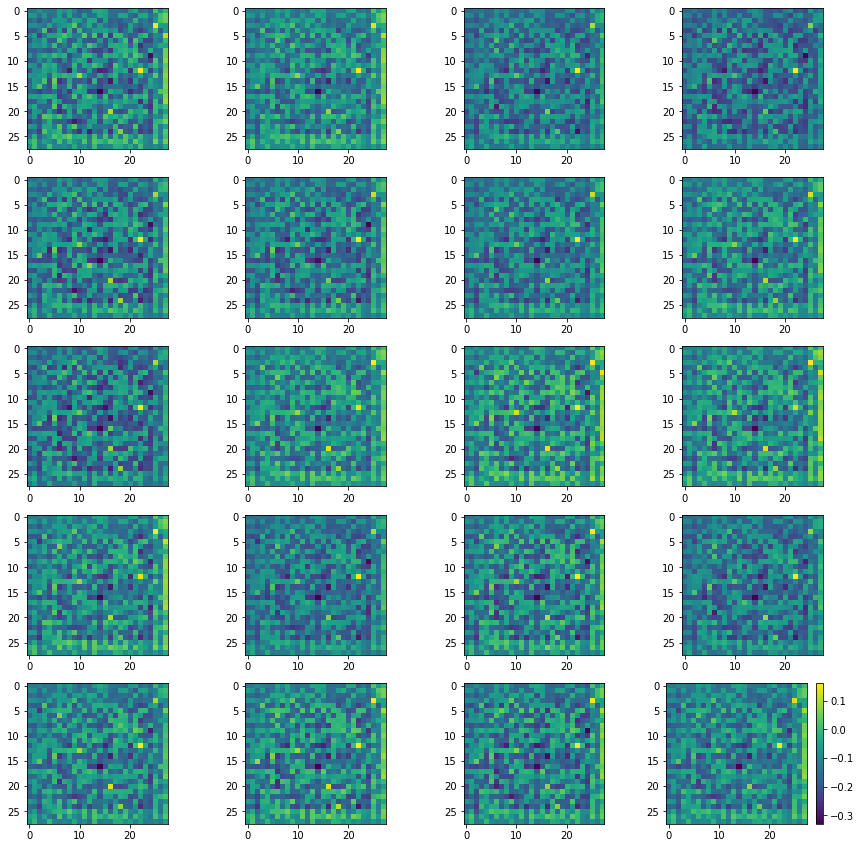

Batch_Num : 17
D_Loss   :   [9.965850830078125, 0.3056738078594208, 9.660177230834961, 0.5, 0.103515625] ;    GAN_Loss   :  [10.637207984924316, 0.20046070218086243, 10.436747550964355, 0.0, 0.109375]
Batch_Num : 18
D_Loss   :   [10.10991096496582, 0.3078919053077698, 9.802019119262695, 0.5, 0.103515625] ;    GAN_Loss   :  [9.917957305908203, 0.20077450573444366, 9.717183113098145, 0.0, 0.087890625]
Batch_Num : 19
D_Loss   :   [10.179388999938965, 0.3085668981075287, 9.870821952819824, 0.5, 0.1015625] ;    GAN_Loss   :  [10.208168029785156, 0.2004595398902893, 10.007708549499512, 0.0, 0.1015625]
Batch_Num : 20
D_Loss   :   [10.001214981079102, 0.29765284061431885, 9.703561782836914, 0.5, 0.099609375] ;    GAN_Loss   :  [10.681742668151855, 0.20053160190582275, 10.481210708618164, 0.0, 0.107421875]
Batch_Num : 21
D_Loss   :   [9.84500789642334, 0.29861629009246826, 9.546391487121582, 0.5, 0.09765625] ;    GAN_Loss   :  [10.652482032775879, 0.2004508078098297, 10.452031135559082, 0.0, 0.

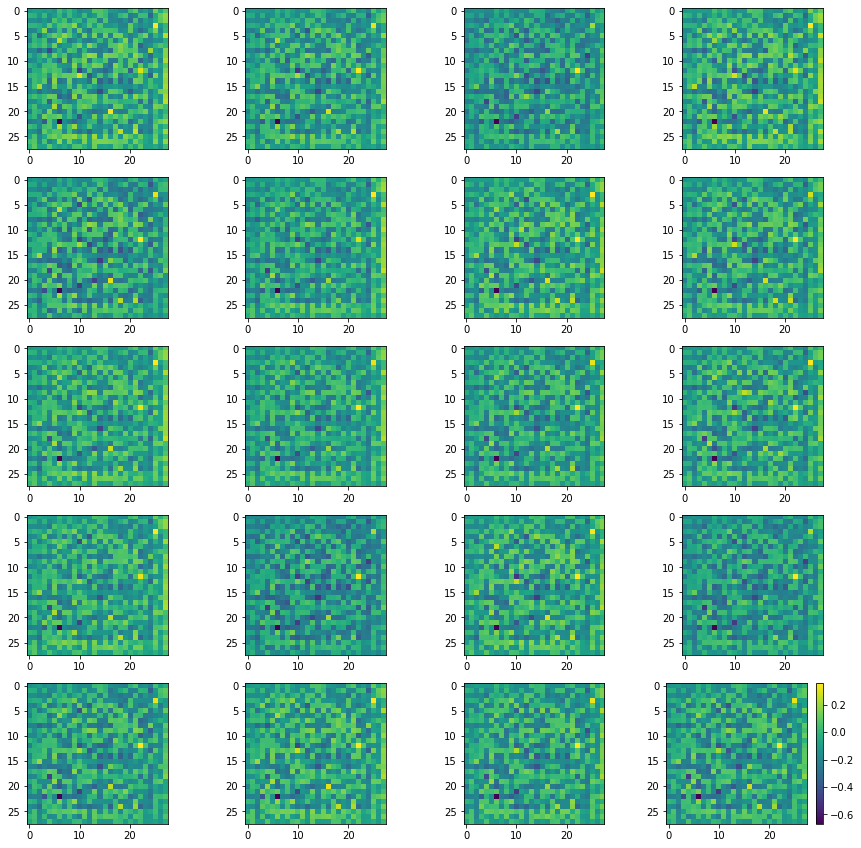

Batch_Num : 32
D_Loss   :   [9.883588790893555, 0.3009823262691498, 9.582606315612793, 0.5, 0.1015625] ;    GAN_Loss   :  [10.569404602050781, 0.20088018476963043, 10.368524551391602, 0.0, 0.109375]
Batch_Num : 33
D_Loss   :   [10.47409725189209, 0.3028036952018738, 10.171293258666992, 0.5, 0.115234375] ;    GAN_Loss   :  [10.300895690917969, 0.20070233941078186, 10.10019302368164, 0.0, 0.107421875]
Batch_Num : 34
D_Loss   :   [10.527338027954102, 0.3104918599128723, 10.216846466064453, 0.5, 0.109375] ;    GAN_Loss   :  [10.020564079284668, 0.20105579495429993, 9.81950855255127, 0.0, 0.083984375]
Batch_Num : 35
D_Loss   :   [9.780913352966309, 0.3082633912563324, 9.472649574279785, 0.5, 0.0703125] ;    GAN_Loss   :  [10.271550178527832, 0.20082886517047882, 10.070721626281738, 0.0, 0.09765625]
Batch_Num : 36
D_Loss   :   [9.844026565551758, 0.29120102524757385, 9.552825927734375, 0.5, 0.109375] ;    GAN_Loss   :  [10.204038619995117, 0.20099081099033356, 10.003047943115234, 0.0, 0.0820

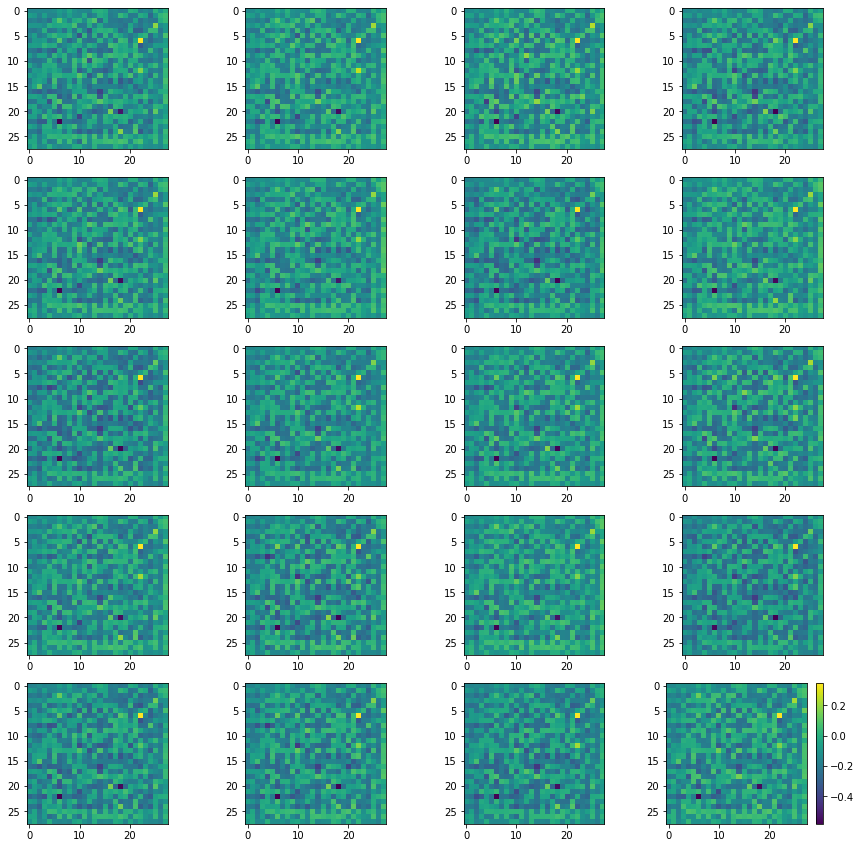

Batch_Num : 47
D_Loss   :   [10.838748931884766, 0.300509512424469, 10.538239479064941, 0.5, 0.10546875] ;    GAN_Loss   :  [10.701688766479492, 0.20121480524539948, 10.500473976135254, 0.0, 0.09765625]
Batch_Num : 48
D_Loss   :   [10.291998863220215, 0.29722756147384644, 9.994771003723145, 0.5, 0.10546875] ;    GAN_Loss   :  [10.491851806640625, 0.2010495662689209, 10.290802001953125, 0.0, 0.119140625]
Batch_Num : 49
D_Loss   :   [10.21243667602539, 0.30310094356536865, 9.90933609008789, 0.5, 0.12109375] ;    GAN_Loss   :  [10.022846221923828, 0.2010319083929062, 9.82181453704834, 0.0, 0.080078125]
Batch_Num : 50
D_Loss   :   [9.93957805633545, 0.29185178875923157, 9.647726058959961, 0.5, 0.103515625] ;    GAN_Loss   :  [10.316380500793457, 0.20152582228183746, 10.11485481262207, 0.0, 0.09765625]
Batch_Num : 51
D_Loss   :   [10.568520545959473, 0.30217429995536804, 10.266345977783203, 0.5, 0.09765625] ;    GAN_Loss   :  [10.398737907409668, 0.2012050896883011, 10.197532653808594, 0.0,

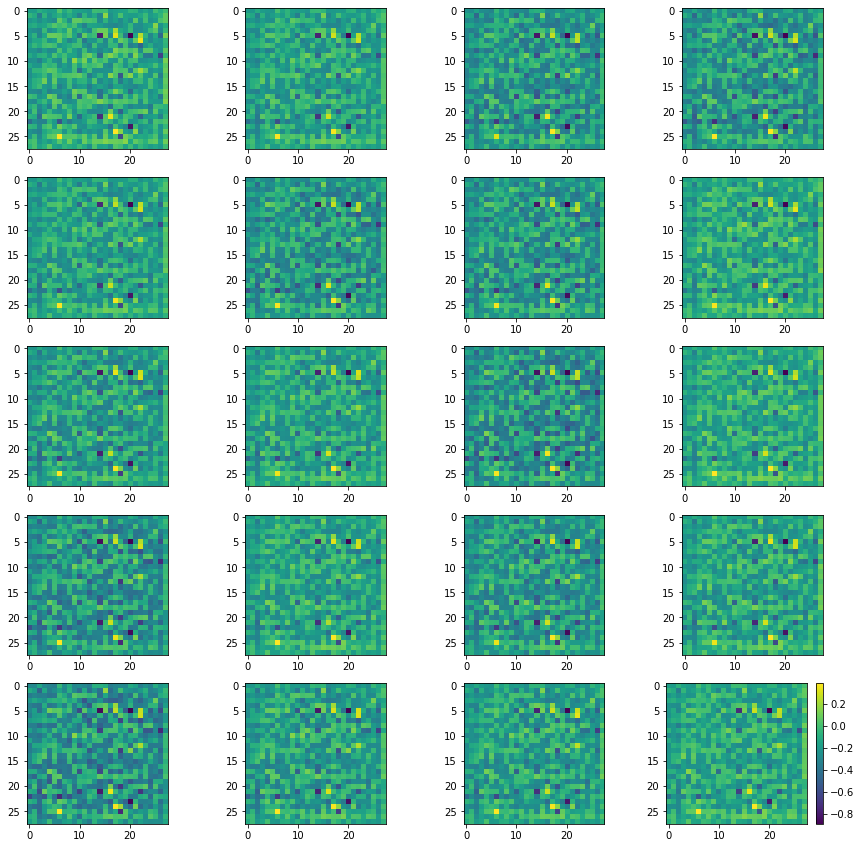

Batch_Num : 62
D_Loss   :   [9.940295219421387, 0.2960454225540161, 9.64424991607666, 0.5, 0.0859375] ;    GAN_Loss   :  [10.543729782104492, 0.2014065682888031, 10.342323303222656, 0.0, 0.09765625]
Batch_Num : 63
D_Loss   :   [10.195405960083008, 0.29483556747436523, 9.9005708694458, 0.5, 0.119140625] ;    GAN_Loss   :  [10.749354362487793, 0.20200610160827637, 10.547348022460938, 0.0, 0.119140625]
Batch_Num : 64
D_Loss   :   [10.17703914642334, 0.29690462350845337, 9.880134582519531, 0.5, 0.0859375] ;    GAN_Loss   :  [10.319402694702148, 0.20271404087543488, 10.11668872833252, 0.0, 0.083984375]
Batch_Num : 65
D_Loss   :   [10.311792373657227, 0.2957126796245575, 10.016079902648926, 0.5, 0.091796875] ;    GAN_Loss   :  [10.190853118896484, 0.20451763272285461, 9.986335754394531, 0.0, 0.1015625]
Batch_Num : 66
D_Loss   :   [10.94675064086914, 0.3053749203681946, 10.641375541687012, 0.5, 0.083984375] ;    GAN_Loss   :  [10.525811195373535, 0.20443293452262878, 10.321378707885742, 0.0, 

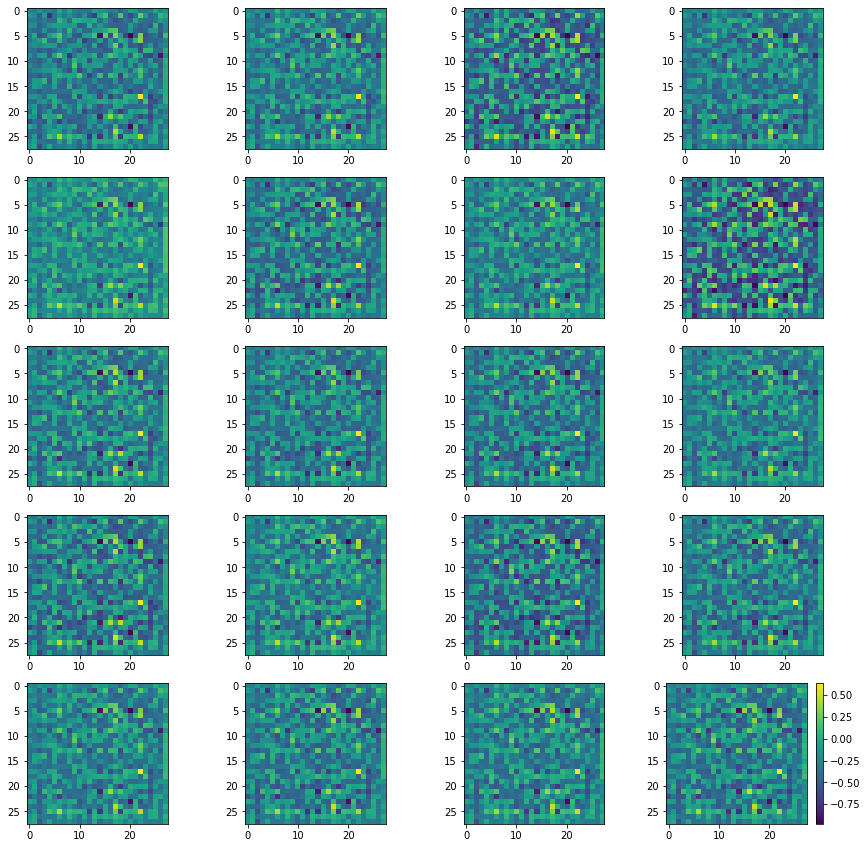

Batch_Num : 77
D_Loss   :   [10.214850425720215, 0.29153552651405334, 9.923315048217773, 0.5, 0.095703125] ;    GAN_Loss   :  [10.056325912475586, 0.20550815761089325, 9.850817680358887, 0.0, 0.119140625]
Batch_Num : 78
D_Loss   :   [9.858853340148926, 0.2935290038585663, 9.565324783325195, 0.5, 0.115234375] ;    GAN_Loss   :  [10.559338569641113, 0.20455078780651093, 10.354787826538086, 0.0, 0.087890625]
Batch_Num : 79
D_Loss   :   [10.649835586547852, 0.29817232489585876, 10.351663589477539, 0.5, 0.115234375] ;    GAN_Loss   :  [10.155047416687012, 0.20496588945388794, 9.950081825256348, 0.0, 0.111328125]
Batch_Num : 80
D_Loss   :   [10.198786735534668, 0.3007816970348358, 9.898005485534668, 0.5, 0.078125] ;    GAN_Loss   :  [10.467496871948242, 0.20559147000312805, 10.261905670166016, 0.0, 0.095703125]
Batch_Num : 81
D_Loss   :   [10.429891586303711, 0.2938559055328369, 10.136035919189453, 0.5, 0.09375] ;    GAN_Loss   :  [10.4905366897583, 0.2079417109489441, 10.282594680786133, 0.

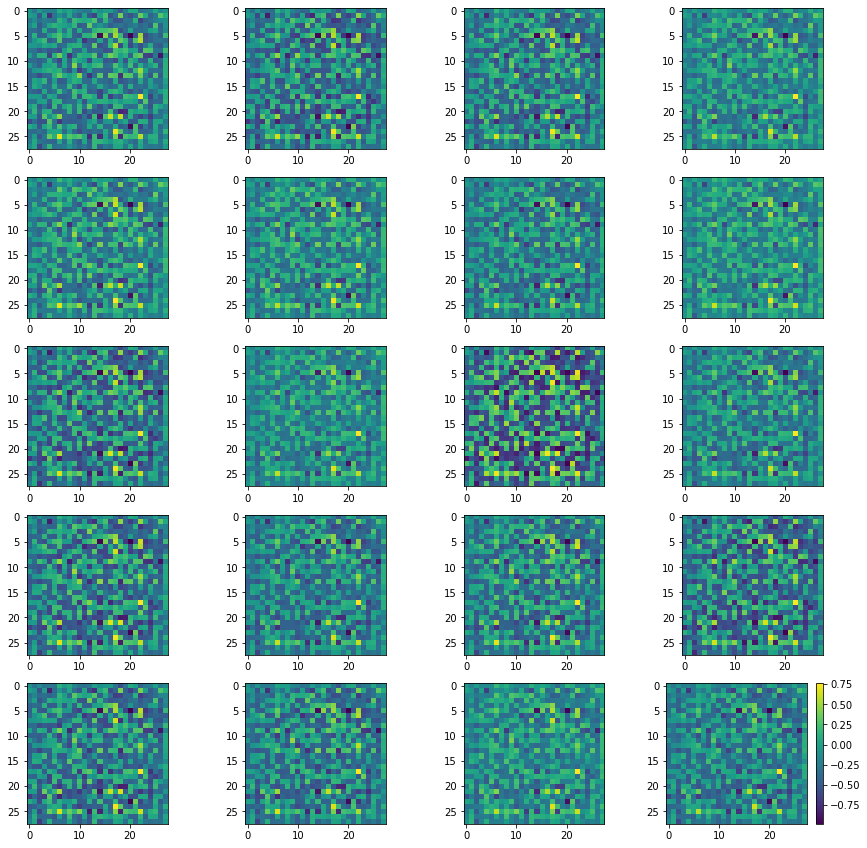

Batch_Num : 92
D_Loss   :   [10.316933631896973, 0.29276296496391296, 10.024170875549316, 0.5, 0.1171875] ;    GAN_Loss   :  [10.580814361572266, 0.20614735782146454, 10.374667167663574, 0.0, 0.130859375]
Batch_Num : 93
D_Loss   :   [10.761759757995605, 0.29650256037712097, 10.46525764465332, 0.5, 0.11328125] ;    GAN_Loss   :  [10.764345169067383, 0.20748643577098846, 10.556859016418457, 0.0, 0.10546875]
Batch_Num : 94
D_Loss   :   [10.175549507141113, 0.2983972430229187, 9.877152442932129, 0.5, 0.10546875] ;    GAN_Loss   :  [10.365221977233887, 0.21305333077907562, 10.152168273925781, 0.0, 0.09765625]
Batch_Num : 95
D_Loss   :   [10.355196952819824, 0.2981536090373993, 10.057043075561523, 0.5, 0.087890625] ;    GAN_Loss   :  [10.574443817138672, 0.21023774147033691, 10.364206314086914, 0.0, 0.087890625]
Batch_Num : 96
D_Loss   :   [9.905708312988281, 0.2881735563278198, 9.617534637451172, 0.5, 0.099609375] ;    GAN_Loss   :  [10.477964401245117, 0.2106257826089859, 10.26733875274658

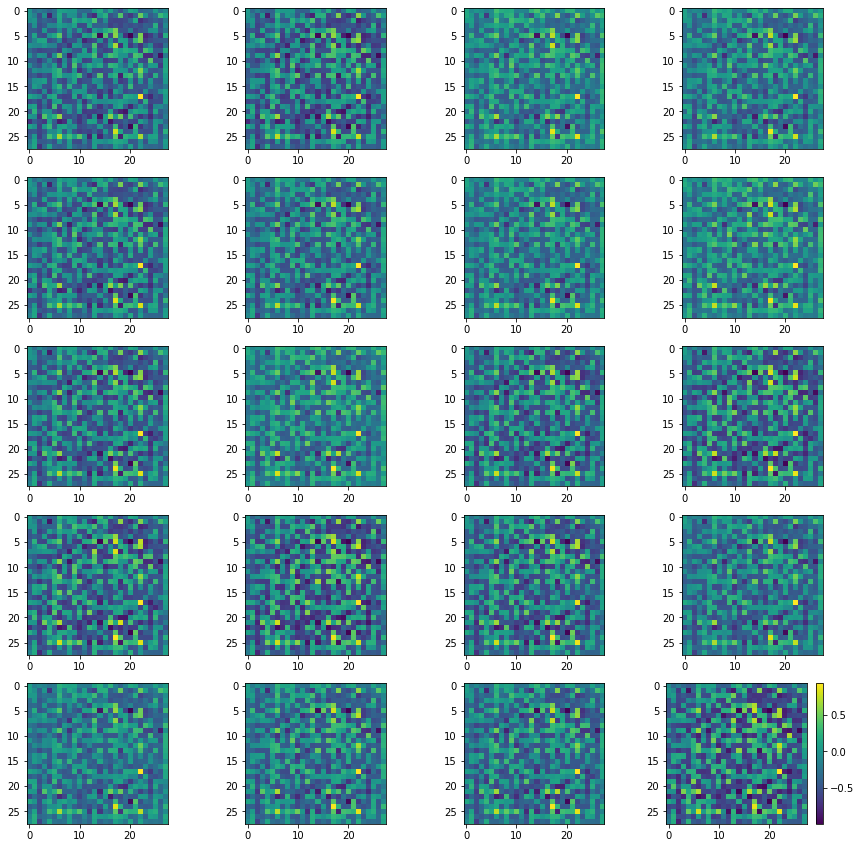

Batch_Num : 107
D_Loss   :   [10.181022644042969, 0.2920225262641907, 9.888999938964844, 0.5, 0.11328125] ;    GAN_Loss   :  [10.191547393798828, 0.21141532063484192, 9.980132102966309, 0.0, 0.126953125]
Batch_Num : 108
D_Loss   :   [9.597906112670898, 0.2845117449760437, 9.313394546508789, 0.5, 0.107421875] ;    GAN_Loss   :  [10.399771690368652, 0.21281777322292328, 10.1869535446167, 0.0, 0.111328125]
Batch_Num : 109
D_Loss   :   [9.836618423461914, 0.28732892870903015, 9.54928970336914, 0.5, 0.10546875] ;    GAN_Loss   :  [10.59655475616455, 0.2164953649044037, 10.380059242248535, 0.0, 0.091796875]
Batch_Num : 110
D_Loss   :   [10.525673866271973, 0.29054704308509827, 10.235126495361328, 0.5, 0.072265625] ;    GAN_Loss   :  [10.635675430297852, 0.21457648277282715, 10.421098709106445, 0.0, 0.1015625]
Batch_Num : 111
D_Loss   :   [9.695585250854492, 0.28135883808135986, 9.414226531982422, 0.5, 0.107421875] ;    GAN_Loss   :  [10.442279815673828, 0.21816083788871765, 10.22411918640136

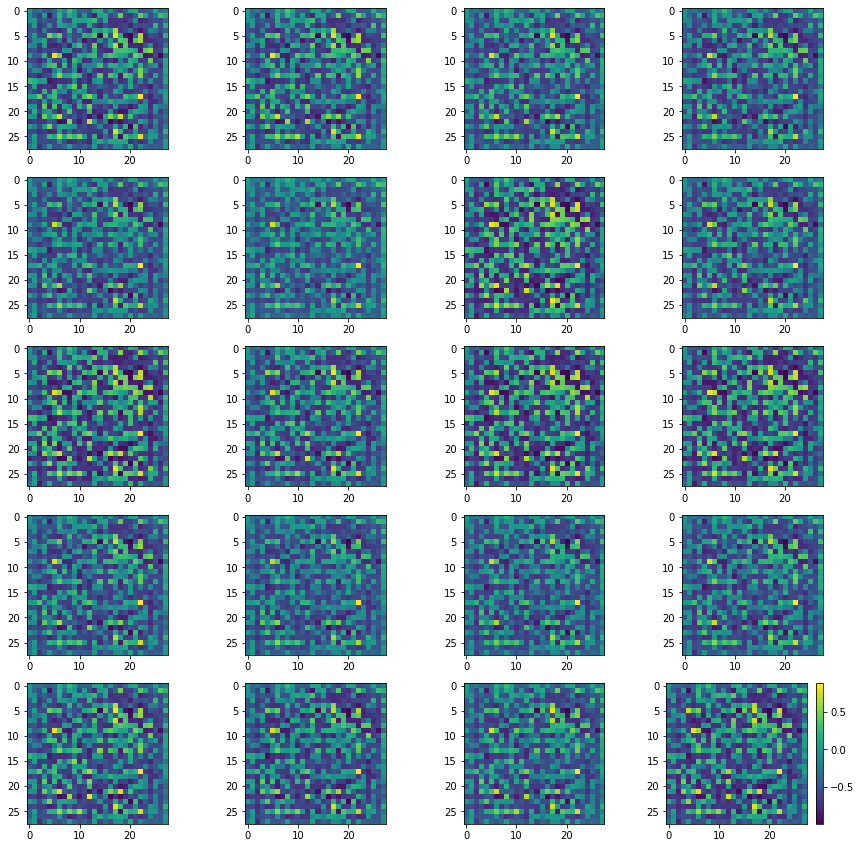

Batch_Num : 122
D_Loss   :   [10.702532768249512, 0.28945475816726685, 10.413078308105469, 0.5, 0.08984375] ;    GAN_Loss   :  [10.151249885559082, 0.23032636940479279, 9.920923233032227, 0.0, 0.12109375]
Batch_Num : 123
D_Loss   :   [10.0757474899292, 0.28165653347969055, 9.79409122467041, 0.5, 0.08203125] ;    GAN_Loss   :  [10.258411407470703, 0.23578181862831116, 10.022629737854004, 0.0, 0.115234375]
Batch_Num : 124
D_Loss   :   [10.42147445678711, 0.2918873727321625, 10.129587173461914, 0.5, 0.130859375] ;    GAN_Loss   :  [10.56352710723877, 0.24294701218605042, 10.32058048248291, 0.0, 0.099609375]
Batch_Num : 125
D_Loss   :   [10.601067543029785, 0.28420206904411316, 10.316865921020508, 0.5, 0.095703125] ;    GAN_Loss   :  [10.2699613571167, 0.2400321513414383, 10.029929161071777, 0.0, 0.08984375]
Batch_Num : 126
D_Loss   :   [10.550256729125977, 0.2906162738800049, 10.25964069366455, 0.5, 0.1015625] ;    GAN_Loss   :  [10.754861831665039, 0.2504016160964966, 10.504460334777832,

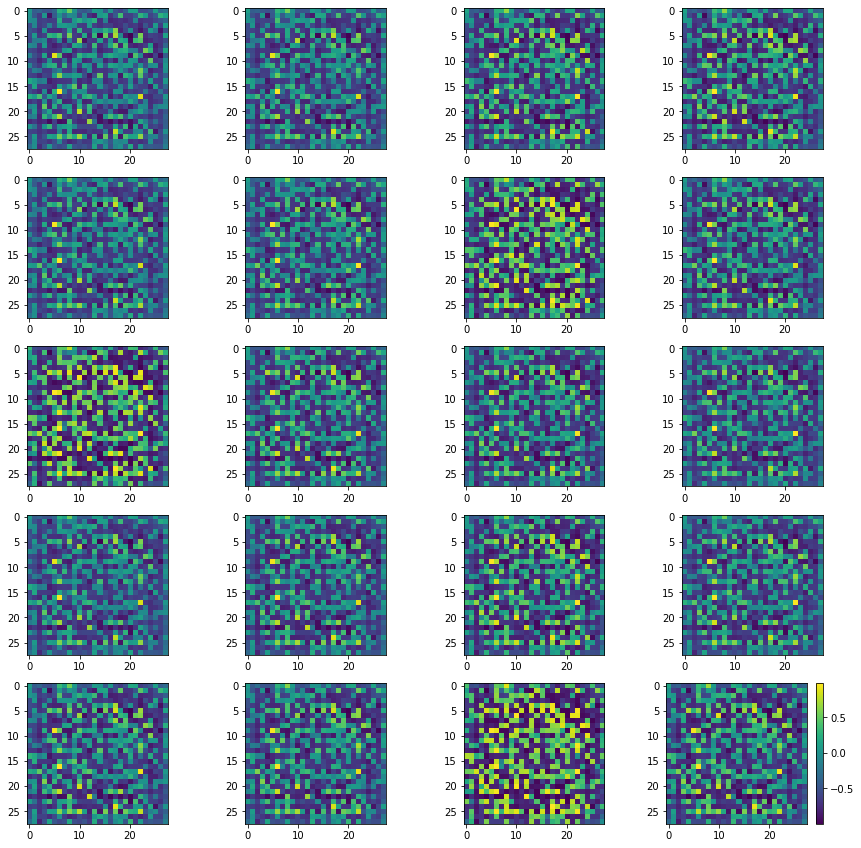

Batch_Num : 137
D_Loss   :   [10.927022933959961, 0.2882401943206787, 10.638782501220703, 0.5, 0.095703125] ;    GAN_Loss   :  [10.15669059753418, 0.2691846191883087, 9.887505531311035, 0.0, 0.095703125]
Batch_Num : 138
D_Loss   :   [10.195713996887207, 0.29103606939315796, 9.904678344726562, 0.5, 0.111328125] ;    GAN_Loss   :  [10.285428047180176, 0.27925148606300354, 10.006176948547363, 0.0, 0.095703125]
Batch_Num : 139
D_Loss   :   [10.098276138305664, 0.2895130515098572, 9.80876350402832, 0.5, 0.078125] ;    GAN_Loss   :  [10.631787300109863, 0.28912070393562317, 10.342666625976562, 0.0, 0.111328125]
Batch_Num : 140
D_Loss   :   [9.683185577392578, 0.27923765778541565, 9.403947830200195, 0.5, 0.08984375] ;    GAN_Loss   :  [10.701265335083008, 0.30385664105415344, 10.397408485412598, 0.0, 0.103515625]
Batch_Num : 141
D_Loss   :   [10.274028778076172, 0.28568947315216064, 9.9883394241333, 0.5, 0.107421875] ;    GAN_Loss   :  [10.762798309326172, 0.32687655091285706, 10.435921669006

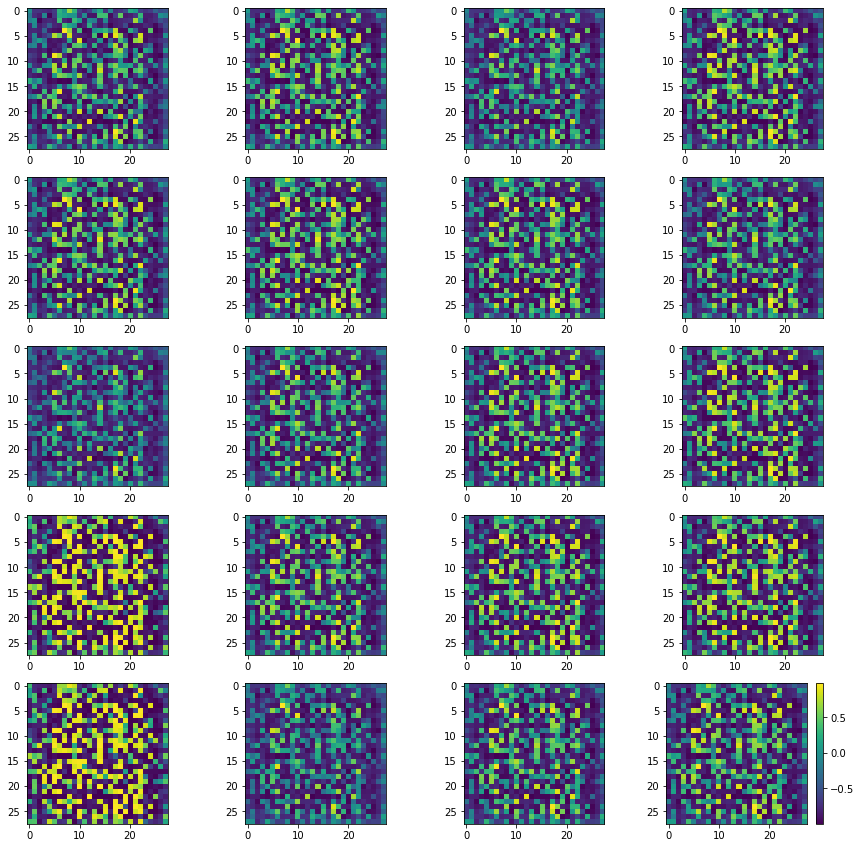

Batch_Num : 152
D_Loss   :   [9.967768669128418, 0.2869146466255188, 9.680853843688965, 0.5, 0.08984375] ;    GAN_Loss   :  [10.731244087219238, 0.35476601123809814, 10.37647819519043, 0.0, 0.1015625]
Batch_Num : 153
D_Loss   :   [10.223470687866211, 0.2789762318134308, 9.944494247436523, 0.5, 0.091796875] ;    GAN_Loss   :  [10.622110366821289, 0.4305972456932068, 10.191513061523438, 0.0, 0.09375]
Batch_Num : 154
D_Loss   :   [10.201415061950684, 0.2907520830631256, 9.910662651062012, 0.5, 0.08984375] ;    GAN_Loss   :  [11.04884147644043, 0.5437064170837402, 10.505134582519531, 0.0, 0.11328125]
Batch_Num : 155
D_Loss   :   [10.563699722290039, 0.2915880084037781, 10.272111892700195, 0.5, 0.080078125] ;    GAN_Loss   :  [11.314335823059082, 0.6433603763580322, 10.670975685119629, 0.0, 0.09375]
Batch_Num : 156
D_Loss   :   [9.670693397521973, 0.26922720670700073, 9.401466369628906, 0.5, 0.080078125] ;    GAN_Loss   :  [10.597984313964844, 0.7540115118026733, 9.843973159790039, 0.0, 0.0

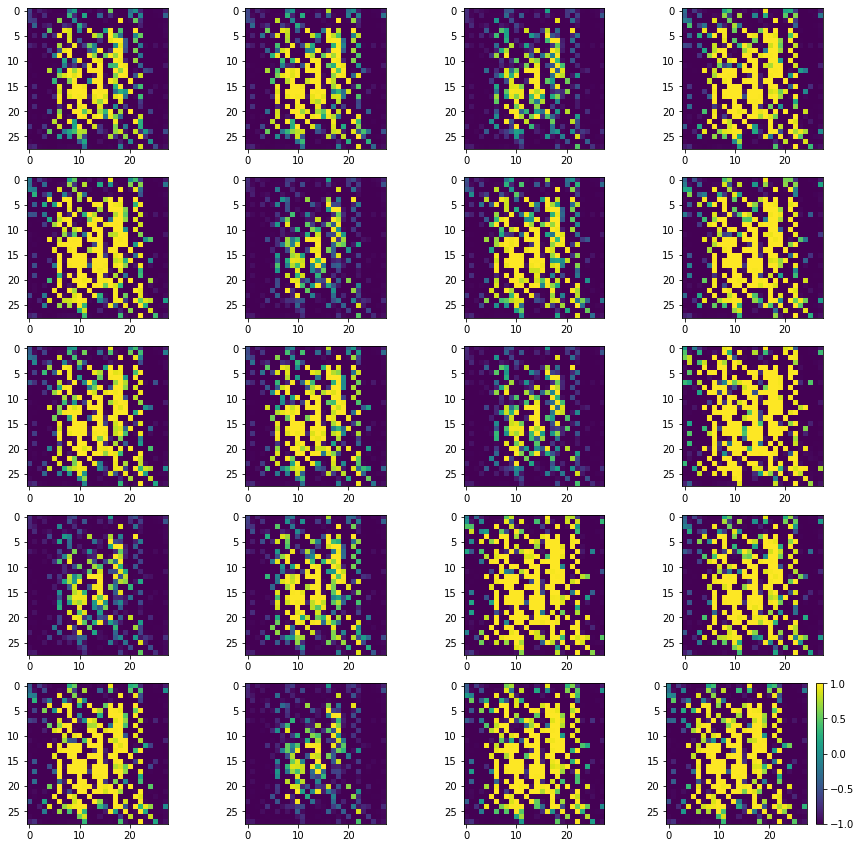

Batch_Num : 167
D_Loss   :   [10.724823951721191, 0.301356703042984, 10.423467636108398, 0.5, 0.078125] ;    GAN_Loss   :  [11.533646583557129, 1.304774522781372, 10.228872299194336, 0.0, 0.08984375]
Batch_Num : 168
D_Loss   :   [9.765290260314941, 0.2956593930721283, 9.46963119506836, 0.494140625, 0.109375] ;    GAN_Loss   :  [12.24614143371582, 1.5845274925231934, 10.661613464355469, 0.0, 0.083984375]
Batch_Num : 169
D_Loss   :   [10.295005798339844, 0.3270326852798462, 9.967972755432129, 0.494140625, 0.095703125] ;    GAN_Loss   :  [12.578010559082031, 1.8999625444412231, 10.678048133850098, 0.0, 0.08984375]
Batch_Num : 170
D_Loss   :   [10.307201385498047, 0.34179744124412537, 9.96540355682373, 0.498046875, 0.103515625] ;    GAN_Loss   :  [12.56788444519043, 1.3984971046447754, 11.169387817382812, 0.0, 0.10546875]
Batch_Num : 171
D_Loss   :   [10.671090126037598, 0.3438712954521179, 10.327219009399414, 0.5, 0.103515625] ;    GAN_Loss   :  [11.251750946044922, 1.0467579364776611, 10

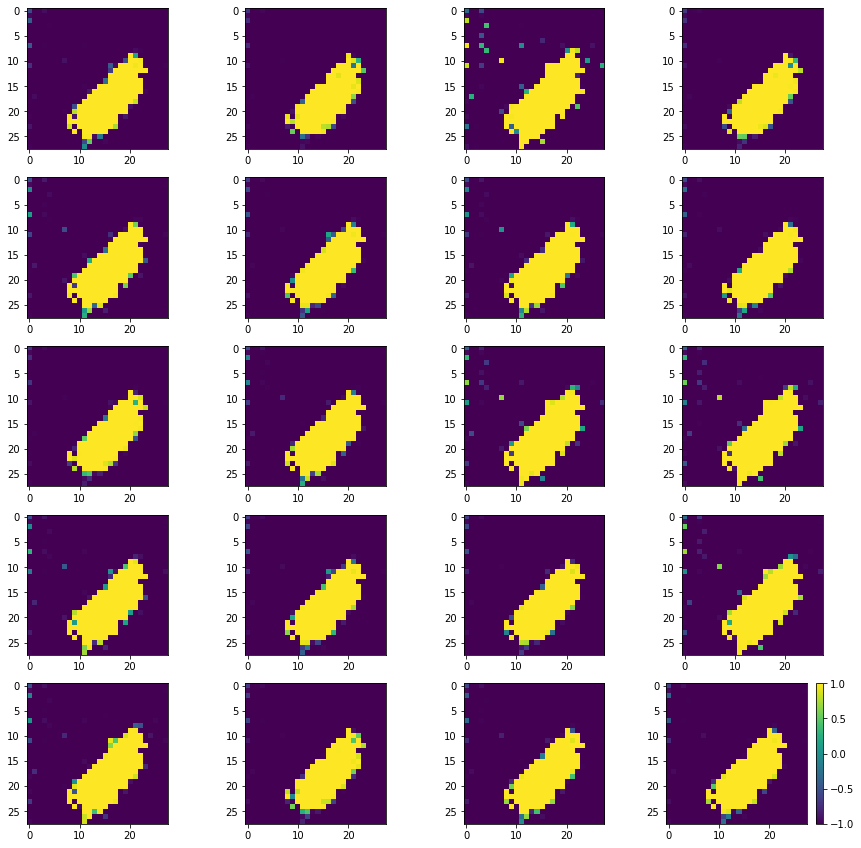

Batch_Num : 182
D_Loss   :   [9.889847755432129, 0.27705132961273193, 9.612796783447266, 0.5, 0.0859375] ;    GAN_Loss   :  [10.207560539245605, 0.7012644410133362, 9.506296157836914, 0.0, 0.1015625]
Batch_Num : 183
D_Loss   :   [10.532206535339355, 0.2823515236377716, 10.249855041503906, 0.5, 0.078125] ;    GAN_Loss   :  [10.778081893920898, 0.7489324808120728, 10.029149055480957, 0.0, 0.076171875]
Batch_Num : 184
D_Loss   :   [9.997642517089844, 0.2623002529144287, 9.735342025756836, 0.5, 0.099609375] ;    GAN_Loss   :  [10.843958854675293, 0.8213627934455872, 10.02259635925293, 0.0, 0.1015625]
Batch_Num : 185
D_Loss   :   [10.076064109802246, 0.26636630296707153, 9.809698104858398, 0.5, 0.095703125] ;    GAN_Loss   :  [11.271007537841797, 0.8514533042907715, 10.419553756713867, 0.0, 0.08203125]
Batch_Num : 186
D_Loss   :   [9.674423217773438, 0.26099035143852234, 9.413433074951172, 0.5, 0.09375] ;    GAN_Loss   :  [11.063429832458496, 0.8473526239395142, 10.216076850891113, 0.0, 0.0

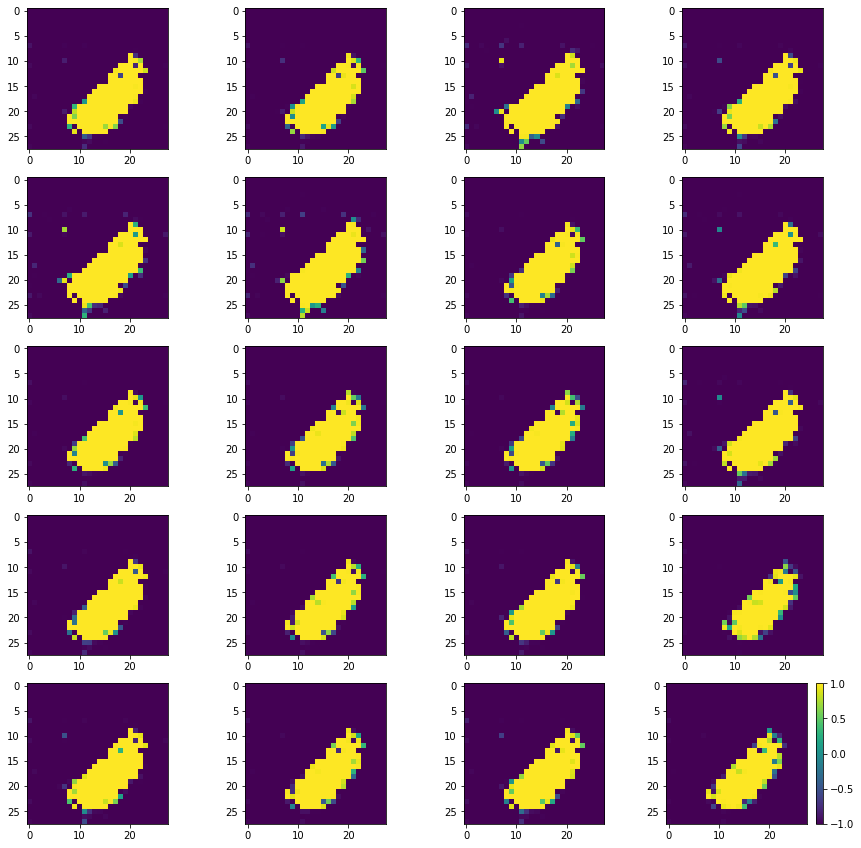

Batch_Num : 197
D_Loss   :   [10.126699447631836, 0.26337456703186035, 9.863325119018555, 0.5, 0.09375] ;    GAN_Loss   :  [11.311565399169922, 0.9842542409896851, 10.327311515808105, 0.0, 0.1171875]
Batch_Num : 198
D_Loss   :   [9.83113956451416, 0.25417137145996094, 9.5769681930542, 0.5, 0.095703125] ;    GAN_Loss   :  [11.53005599975586, 1.0445111989974976, 10.48554515838623, 0.0, 0.109375]
Batch_Num : 199
D_Loss   :   [10.723565101623535, 0.2685808837413788, 10.454984664916992, 0.5, 0.11328125] ;    GAN_Loss   :  [11.208149909973145, 1.0484861135482788, 10.159664154052734, 0.0, 0.083984375]
Batch_Num : 200
D_Loss   :   [10.298588752746582, 0.2614307701587677, 10.037158012390137, 0.5, 0.08984375] ;    GAN_Loss   :  [11.278436660766602, 1.0821757316589355, 10.196261405944824, 0.0, 0.0859375]
Batch_Num : 201
D_Loss   :   [10.533835411071777, 0.2481529265642166, 10.285682678222656, 0.5, 0.091796875] ;    GAN_Loss   :  [11.908134460449219, 1.1128841638565063, 10.795249938964844, 0.0, 0.

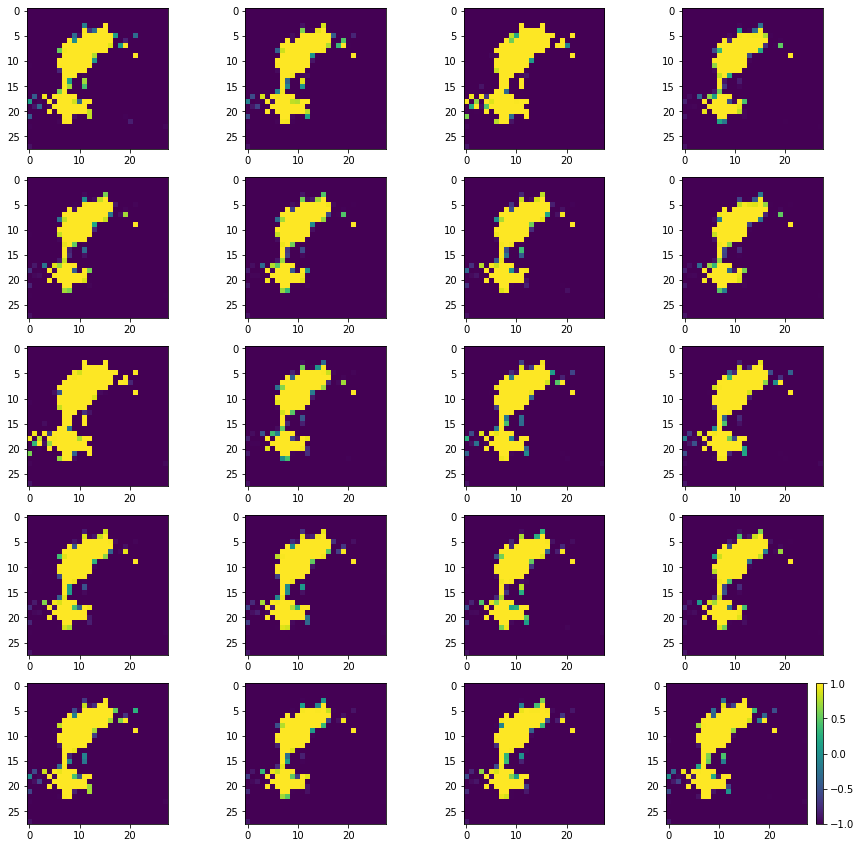

Batch_Num : 212
D_Loss   :   [11.2942476272583, 0.496273934841156, 10.7979736328125, 0.49609375, 0.103515625] ;    GAN_Loss   :  [10.6041259765625, 0.671332836151123, 9.932792663574219, 0.0, 0.107421875]
Batch_Num : 213
D_Loss   :   [9.867321968078613, 0.36825287342071533, 9.499069213867188, 0.5, 0.09375] ;    GAN_Loss   :  [10.627504348754883, 0.6933199167251587, 9.934184074401855, 0.0, 0.125]
Batch_Num : 214
D_Loss   :   [10.565512657165527, 0.3119460344314575, 10.25356674194336, 0.5, 0.095703125] ;    GAN_Loss   :  [10.636547088623047, 0.7006404399871826, 9.935906410217285, 0.0, 0.119140625]
Batch_Num : 215
D_Loss   :   [9.368658065795898, 0.26412978768348694, 9.104528427124023, 0.5, 0.103515625] ;    GAN_Loss   :  [10.753050804138184, 0.6569241285324097, 10.096126556396484, 0.0, 0.095703125]
Batch_Num : 216
D_Loss   :   [10.582775115966797, 0.27153995633125305, 10.311235427856445, 0.5, 0.060546875] ;    GAN_Loss   :  [10.84888744354248, 0.5977091193199158, 10.251178741455078, 0.0, 

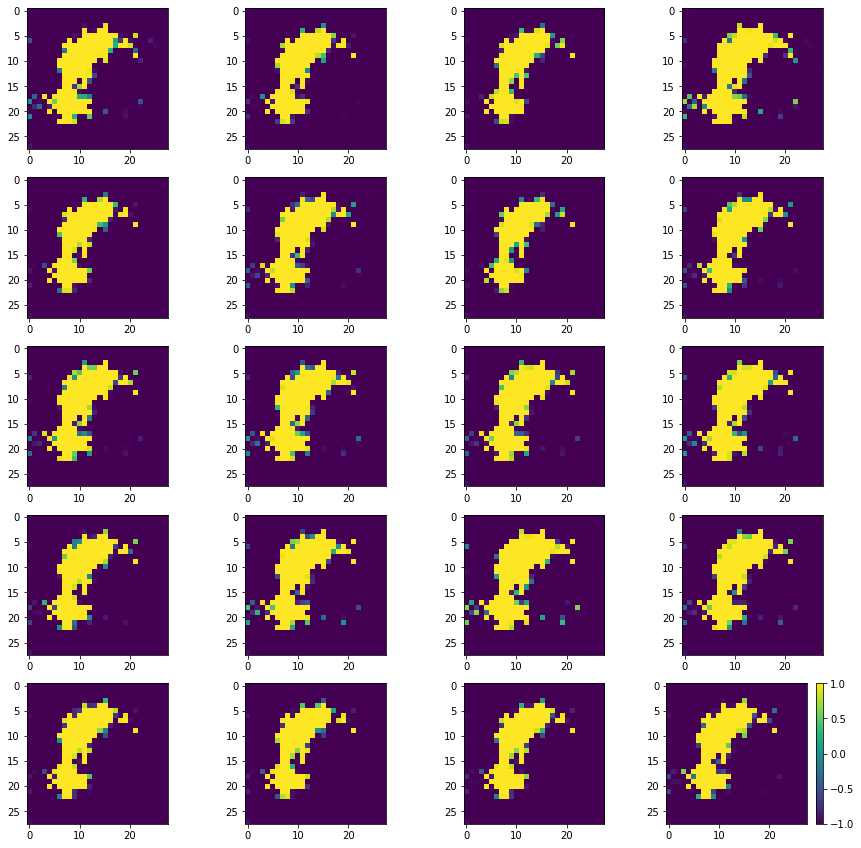

Batch_Num : 227
D_Loss   :   [9.399585723876953, 0.2195601463317871, 9.180025100708008, 0.5, 0.0703125] ;    GAN_Loss   :  [10.93044662475586, 0.4683980643749237, 10.462048530578613, 0.0, 0.0859375]
Batch_Num : 228
D_Loss   :   [10.509515762329102, 0.22917257249355316, 10.280343055725098, 0.5, 0.099609375] ;    GAN_Loss   :  [10.596155166625977, 0.46622055768966675, 10.129934310913086, 0.0, 0.095703125]
Batch_Num : 229
D_Loss   :   [9.915329933166504, 0.23435819149017334, 9.6809720993042, 0.5, 0.078125] ;    GAN_Loss   :  [10.900165557861328, 0.4832805097103119, 10.416885375976562, 0.0, 0.107421875]
Batch_Num : 230
D_Loss   :   [10.244597434997559, 0.23923435807228088, 10.005363464355469, 0.5, 0.103515625] ;    GAN_Loss   :  [10.866032600402832, 0.4982459545135498, 10.367786407470703, 0.0, 0.09765625]
Batch_Num : 231
D_Loss   :   [10.490204811096191, 0.2219918668270111, 10.268213272094727, 0.5, 0.0703125] ;    GAN_Loss   :  [10.396175384521484, 0.4946732521057129, 9.901501655578613, 0.

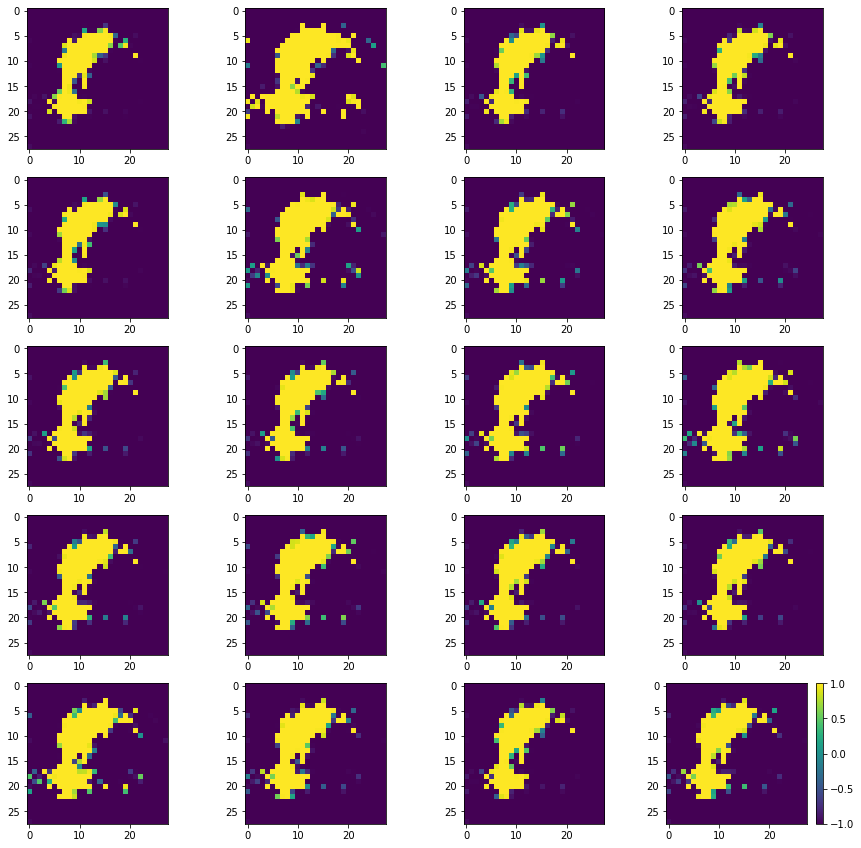

Batch_Num : 2
D_Loss   :   [10.266690254211426, 0.22505855560302734, 10.041631698608398, 0.5, 0.076171875] ;    GAN_Loss   :  [10.6227445602417, 0.5081650614738464, 10.114579200744629, 0.0, 0.109375]
Batch_Num : 3
D_Loss   :   [10.302163124084473, 0.22084400057792664, 10.081318855285645, 0.5, 0.103515625] ;    GAN_Loss   :  [11.021422386169434, 0.4960918724536896, 10.525330543518066, 0.0, 0.107421875]
Batch_Num : 4
D_Loss   :   [10.479846000671387, 0.22890859842300415, 10.250937461853027, 0.5, 0.11328125] ;    GAN_Loss   :  [10.47205638885498, 0.5033296942710876, 9.968727111816406, 0.0, 0.109375]
Batch_Num : 5
D_Loss   :   [10.325194358825684, 0.2154996395111084, 10.109694480895996, 0.5, 0.111328125] ;    GAN_Loss   :  [11.158262252807617, 0.5071743130683899, 10.651087760925293, 0.0, 0.11328125]
Batch_Num : 6
D_Loss   :   [10.623997688293457, 0.23621651530265808, 10.387781143188477, 0.5, 0.109375] ;    GAN_Loss   :  [10.993578910827637, 0.5035247206687927, 10.4900541305542, 0.0, 0.0878

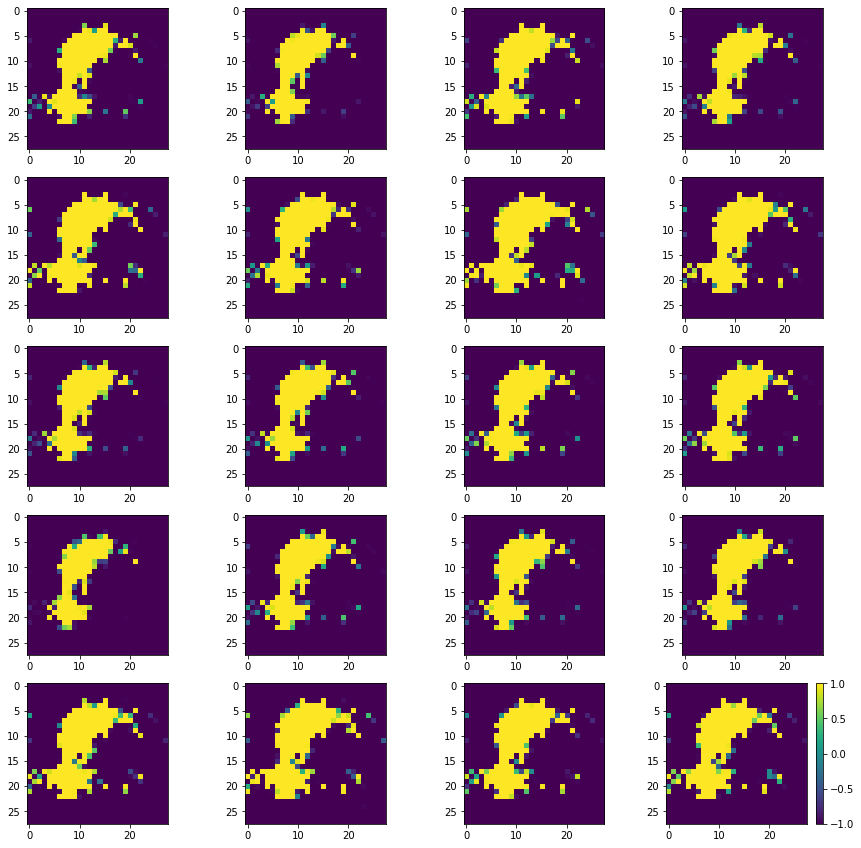

Batch_Num : 17
D_Loss   :   [9.913251876831055, 0.2041761726140976, 9.709075927734375, 0.5, 0.09375] ;    GAN_Loss   :  [10.944878578186035, 0.5512904524803162, 10.393588066101074, 0.0, 0.09765625]
Batch_Num : 18
D_Loss   :   [10.060078620910645, 0.2098015546798706, 9.850276947021484, 0.5, 0.091796875] ;    GAN_Loss   :  [11.152911186218262, 0.5546550750732422, 10.59825611114502, 0.0, 0.10546875]
Batch_Num : 19
D_Loss   :   [10.129274368286133, 0.19521939754486084, 9.93405532836914, 0.5, 0.087890625] ;    GAN_Loss   :  [10.543983459472656, 0.534464955329895, 10.00951862335205, 0.0, 0.1015625]
Batch_Num : 20
D_Loss   :   [9.952043533325195, 0.1997302621603012, 9.752313613891602, 0.5, 0.099609375] ;    GAN_Loss   :  [10.33841609954834, 0.5384045243263245, 9.80001163482666, 0.0, 0.115234375]
Batch_Num : 21
D_Loss   :   [9.786595344543457, 0.18993216753005981, 9.596663475036621, 0.5, 0.1015625] ;    GAN_Loss   :  [11.043807029724121, 0.5483123660087585, 10.495494842529297, 0.0, 0.09765625]

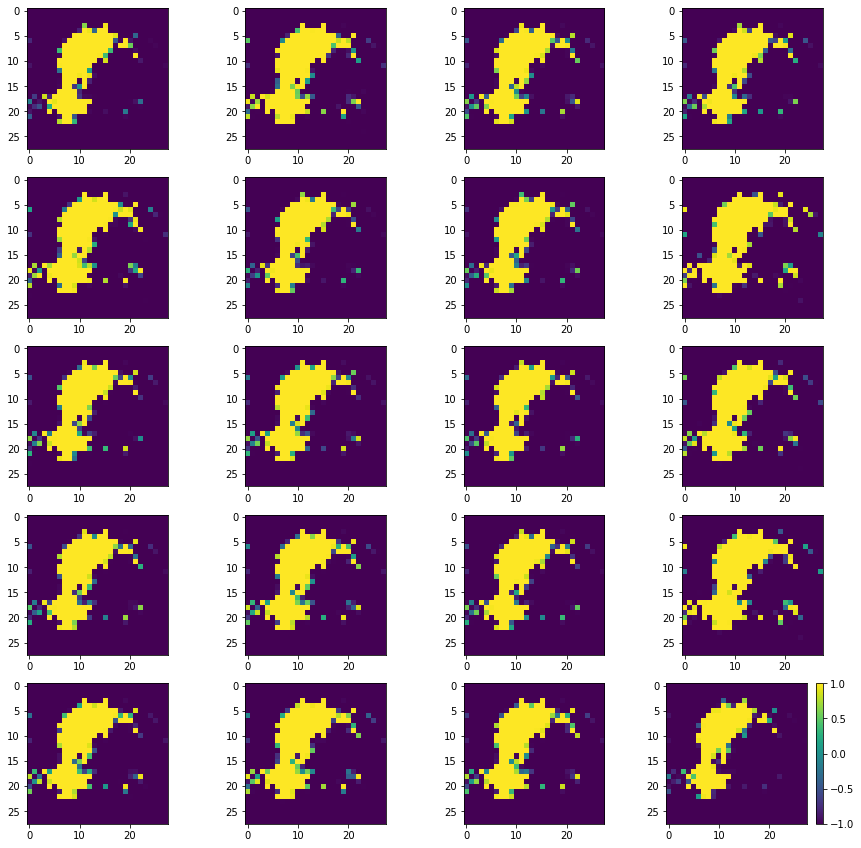

Batch_Num : 32
D_Loss   :   [9.818382263183594, 0.20788604021072388, 9.610496520996094, 0.5, 0.072265625] ;    GAN_Loss   :  [10.97172737121582, 0.5260941386222839, 10.445632934570312, 0.0, 0.123046875]
Batch_Num : 33
D_Loss   :   [10.399425506591797, 0.18512070178985596, 10.21430492401123, 0.5, 0.123046875] ;    GAN_Loss   :  [11.921470642089844, 0.5167898535728455, 11.404681205749512, 0.0, 0.087890625]
Batch_Num : 34
D_Loss   :   [10.448982238769531, 0.1740674078464508, 10.274914741516113, 0.5, 0.09375] ;    GAN_Loss   :  [11.42473030090332, 0.552757978439331, 10.87197208404541, 0.0, 0.11328125]
Batch_Num : 35
D_Loss   :   [9.704572677612305, 0.15689490735530853, 9.547677993774414, 0.5, 0.09375] ;    GAN_Loss   :  [11.505075454711914, 0.5306254625320435, 10.97445011138916, 0.0, 0.08203125]
Batch_Num : 36
D_Loss   :   [9.772856712341309, 0.15439298748970032, 9.618463516235352, 0.5, 0.1171875] ;    GAN_Loss   :  [11.458900451660156, 0.5993889570236206, 10.859511375427246, 0.0, 0.115234

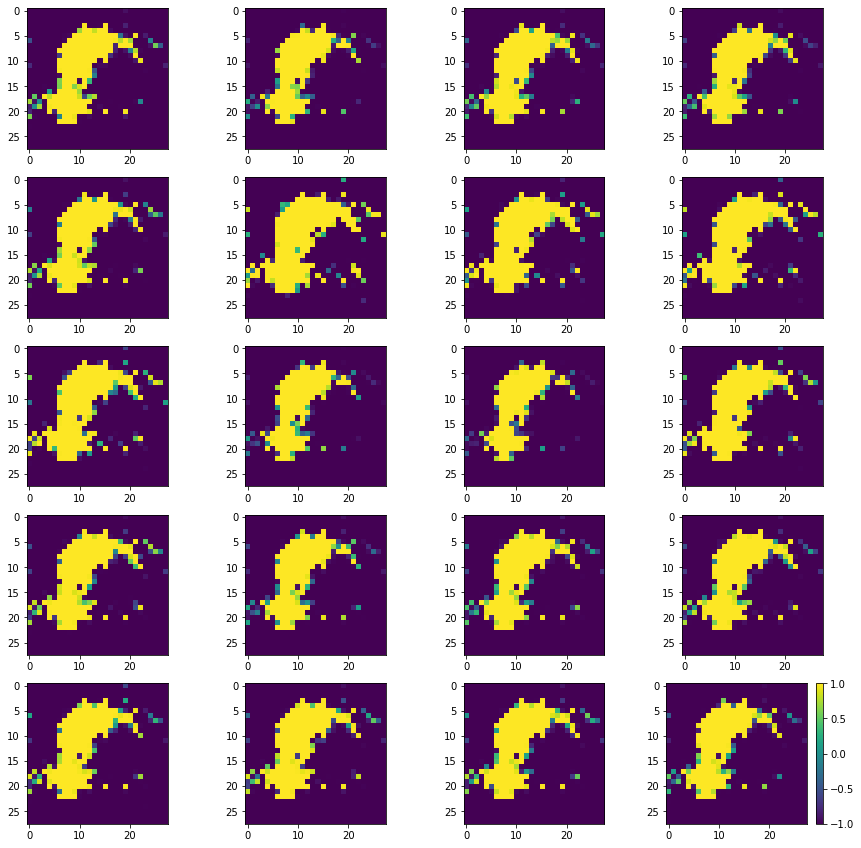

Batch_Num : 47
D_Loss   :   [10.766154289245605, 0.17631740868091583, 10.589837074279785, 0.5, 0.0859375] ;    GAN_Loss   :  [12.01273250579834, 0.6620134711265564, 11.350719451904297, 0.0, 0.09375]
Batch_Num : 48
D_Loss   :   [10.219657897949219, 0.15509283542633057, 10.06456470489502, 0.5, 0.123046875] ;    GAN_Loss   :  [11.528253555297852, 0.6928858757019043, 10.835367202758789, 0.0, 0.09375]
Batch_Num : 49
D_Loss   :   [10.118906021118164, 0.15941694378852844, 9.959488868713379, 0.5, 0.091796875] ;    GAN_Loss   :  [11.944601058959961, 0.6980886459350586, 11.246512413024902, 0.0, 0.109375]
Batch_Num : 50
D_Loss   :   [9.844636917114258, 0.14997133612632751, 9.694665908813477, 0.5, 0.083984375] ;    GAN_Loss   :  [11.012118339538574, 0.7004271745681763, 10.311691284179688, 0.0, 0.09765625]
Batch_Num : 51
D_Loss   :   [10.476320266723633, 0.14814497530460358, 10.32817554473877, 0.5, 0.09375] ;    GAN_Loss   :  [12.235687255859375, 0.8241376876831055, 11.41154956817627, 0.0, 0.087890

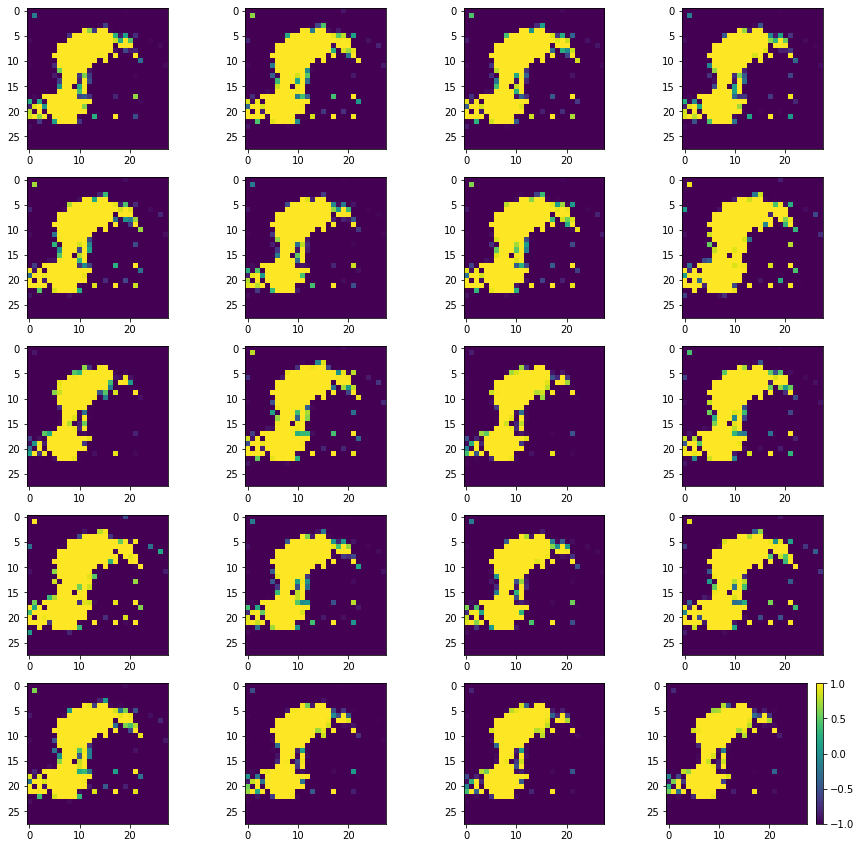

Batch_Num : 62
D_Loss   :   [9.841833114624023, 0.13905376195907593, 9.702779769897461, 0.5, 0.119140625] ;    GAN_Loss   :  [15.243953704833984, 1.7015469074249268, 13.542407035827637, 0.0, 0.1015625]
Batch_Num : 63
D_Loss   :   [10.10265827178955, 0.1538785994052887, 9.948780059814453, 0.5, 0.14453125] ;    GAN_Loss   :  [16.830507278442383, 2.5037474632263184, 14.326760292053223, 0.0, 0.109375]
Batch_Num : 64
D_Loss   :   [10.08879566192627, 0.16564840078353882, 9.923147201538086, 0.5, 0.10546875] ;    GAN_Loss   :  [16.832685470581055, 2.779503345489502, 14.053181648254395, 0.0, 0.091796875]
Batch_Num : 65
D_Loss   :   [10.243223190307617, 0.18526968359947205, 10.057953834533691, 0.5, 0.1015625] ;    GAN_Loss   :  [21.499414443969727, 3.731416940689087, 17.76799774169922, 0.0, 0.111328125]
Batch_Num : 66
D_Loss   :   [10.90367603302002, 0.21265947818756104, 10.69101619720459, 0.49609375, 0.099609375] ;    GAN_Loss   :  [27.78594970703125, 5.150937080383301, 22.635013580322266, 0.0,

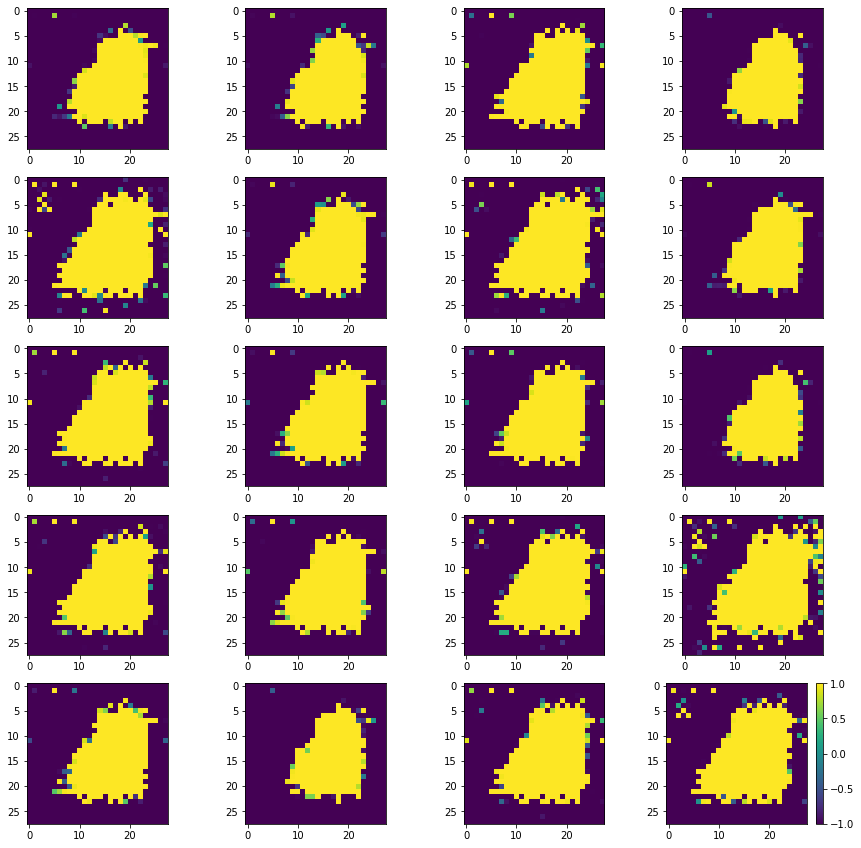

Batch_Num : 77
D_Loss   :   [10.146636962890625, 0.17212501168251038, 9.974512100219727, 0.494140625, 0.072265625] ;    GAN_Loss   :  [16.638198852539062, 3.7118964195251465, 12.926301956176758, 0.0, 0.068359375]
Batch_Num : 78
D_Loss   :   [9.786767959594727, 0.173690527677536, 9.613077163696289, 0.5, 0.072265625] ;    GAN_Loss   :  [18.718097686767578, 4.217665195465088, 14.500432968139648, 0.0, 0.12109375]
Batch_Num : 79
D_Loss   :   [10.632156372070312, 0.18089474737644196, 10.451261520385742, 0.5, 0.083984375] ;    GAN_Loss   :  [14.91077995300293, 2.695300579071045, 12.215478897094727, 0.0, 0.064453125]
Batch_Num : 80
D_Loss   :   [10.178728103637695, 0.22463782131671906, 9.954090118408203, 0.498046875, 0.103515625] ;    GAN_Loss   :  [13.749198913574219, 2.072927236557007, 11.676271438598633, 0.0, 0.068359375]
Batch_Num : 81
D_Loss   :   [10.493041038513184, 0.28581273555755615, 10.207228660583496, 0.486328125, 0.1171875] ;    GAN_Loss   :  [15.303350448608398, 2.195075750350952

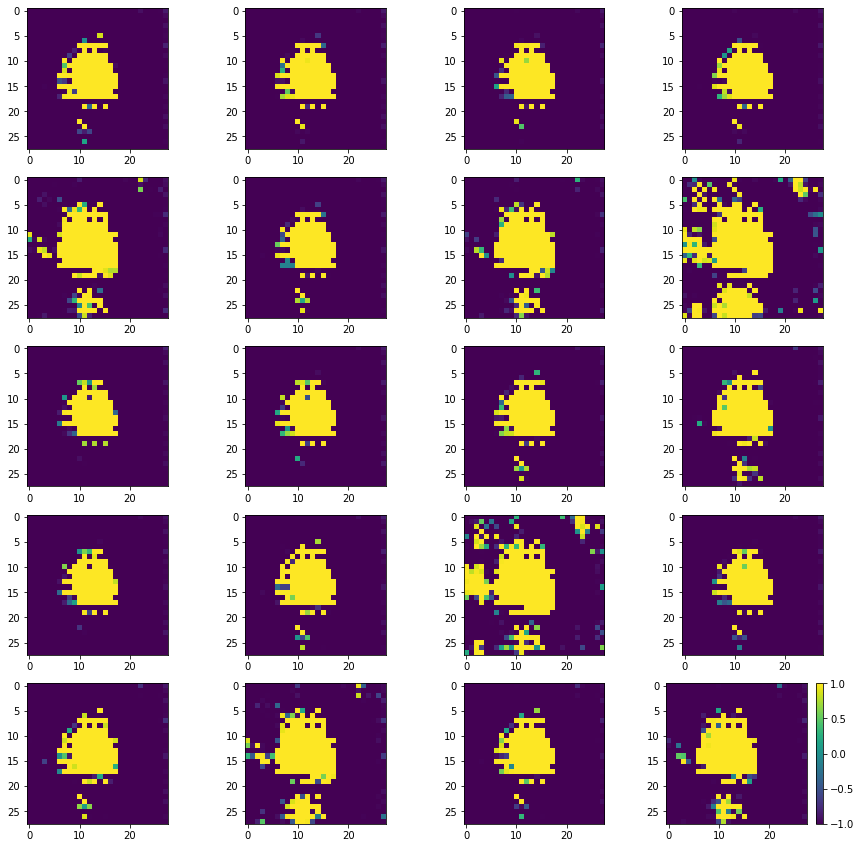

Batch_Num : 92
D_Loss   :   [10.304097175598145, 0.18733884394168854, 10.116758346557617, 0.5, 0.103515625] ;    GAN_Loss   :  [14.305115699768066, 1.7334558963775635, 12.571660041809082, 0.0, 0.087890625]
Batch_Num : 93
D_Loss   :   [10.71501636505127, 0.19570322334766388, 10.519312858581543, 0.5, 0.109375] ;    GAN_Loss   :  [13.698402404785156, 1.5256924629211426, 12.172710418701172, 0.0, 0.103515625]
Batch_Num : 94
D_Loss   :   [10.203484535217285, 0.27444031834602356, 9.929043769836426, 0.486328125, 0.099609375] ;    GAN_Loss   :  [14.8889741897583, 1.8742035627365112, 13.0147705078125, 0.0, 0.134765625]
Batch_Num : 95
D_Loss   :   [10.45712947845459, 0.3182312250137329, 10.138897895812988, 0.484375, 0.10546875] ;    GAN_Loss   :  [14.448409080505371, 1.848567008972168, 12.599842071533203, 0.0, 0.09375]
Batch_Num : 96
D_Loss   :   [9.936280250549316, 0.26493698358535767, 9.671342849731445, 0.5, 0.115234375] ;    GAN_Loss   :  [14.567776679992676, 1.9131313562393188, 12.65464496612

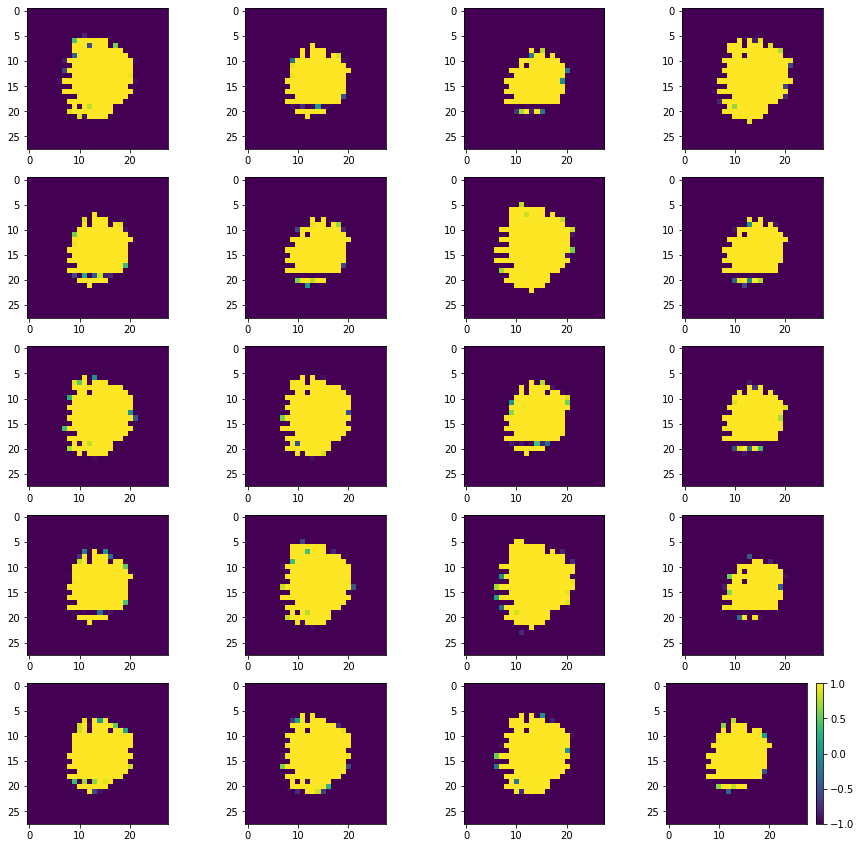

Batch_Num : 107
D_Loss   :   [10.202486038208008, 0.24786359071731567, 9.954622268676758, 0.498046875, 0.103515625] ;    GAN_Loss   :  [16.476093292236328, 3.3890573978424072, 13.087035179138184, 0.0, 0.078125]
Batch_Num : 108
D_Loss   :   [9.596307754516602, 0.21962565183639526, 9.37668228149414, 0.498046875, 0.08984375] ;    GAN_Loss   :  [16.44476318359375, 3.435300827026367, 13.0094633102417, 0.0, 0.091796875]
Batch_Num : 109
D_Loss   :   [9.813456535339355, 0.2241404503583908, 9.589316368103027, 0.494140625, 0.07421875] ;    GAN_Loss   :  [16.710954666137695, 3.3594329357147217, 13.351522445678711, 0.0, 0.087890625]
Batch_Num : 110
D_Loss   :   [10.74010181427002, 0.3682063817977905, 10.371895790100098, 0.46484375, 0.115234375] ;    GAN_Loss   :  [16.59505271911621, 3.67238187789917, 12.9226713180542, 0.0, 0.095703125]
Batch_Num : 111
D_Loss   :   [9.894576072692871, 0.3147715628147125, 9.579804420471191, 0.5, 0.087890625] ;    GAN_Loss   :  [12.915210723876953, 2.091439723968506,

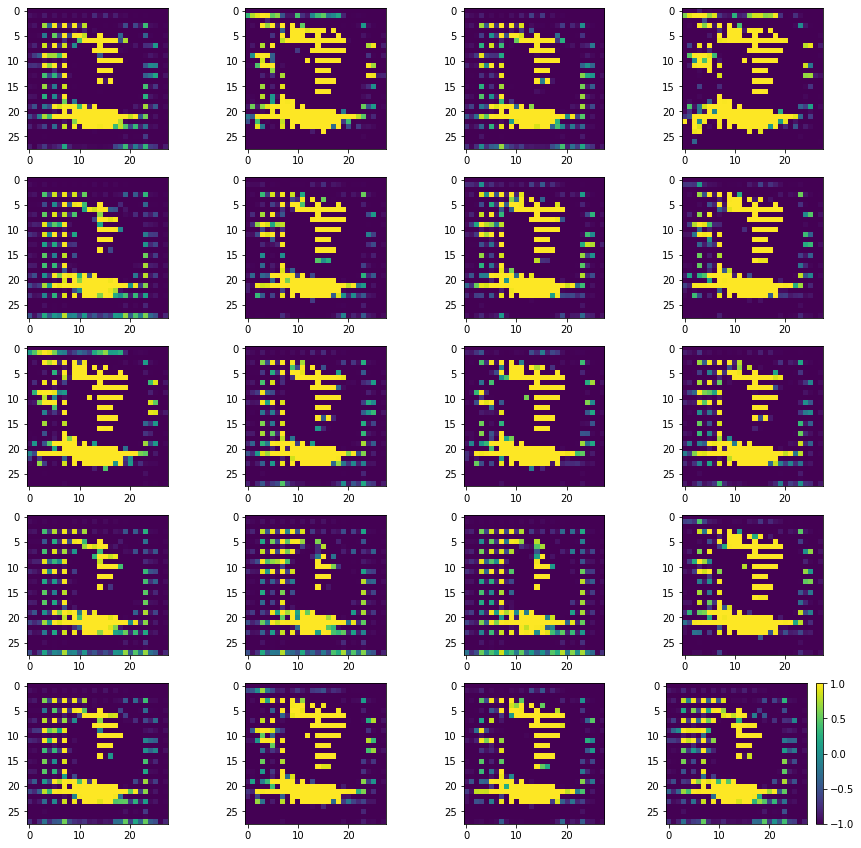

Batch_Num : 122
D_Loss   :   [10.659831047058105, 0.1954122632741928, 10.464418411254883, 0.4921875, 0.126953125] ;    GAN_Loss   :  [13.793497085571289, 2.4566404819488525, 11.336856842041016, 0.0, 0.125]
Batch_Num : 123
D_Loss   :   [10.090859413146973, 0.25565189123153687, 9.83520793914795, 0.462890625, 0.107421875] ;    GAN_Loss   :  [15.184792518615723, 2.743685722351074, 12.441106796264648, 0.0, 0.125]
Batch_Num : 124
D_Loss   :   [10.392888069152832, 0.2193193882703781, 10.173568725585938, 0.48828125, 0.134765625] ;    GAN_Loss   :  [15.093111991882324, 2.714233636856079, 12.378878593444824, 0.0, 0.125]
Batch_Num : 125
D_Loss   :   [10.58681583404541, 0.22099919617176056, 10.365817070007324, 0.4921875, 0.09375] ;    GAN_Loss   :  [14.069515228271484, 2.341613292694092, 11.727901458740234, 0.0, 0.126953125]
Batch_Num : 126
D_Loss   :   [10.520905494689941, 0.22547094523906708, 10.295434951782227, 0.48828125, 0.111328125] ;    GAN_Loss   :  [14.67574405670166, 2.615819215774536, 1

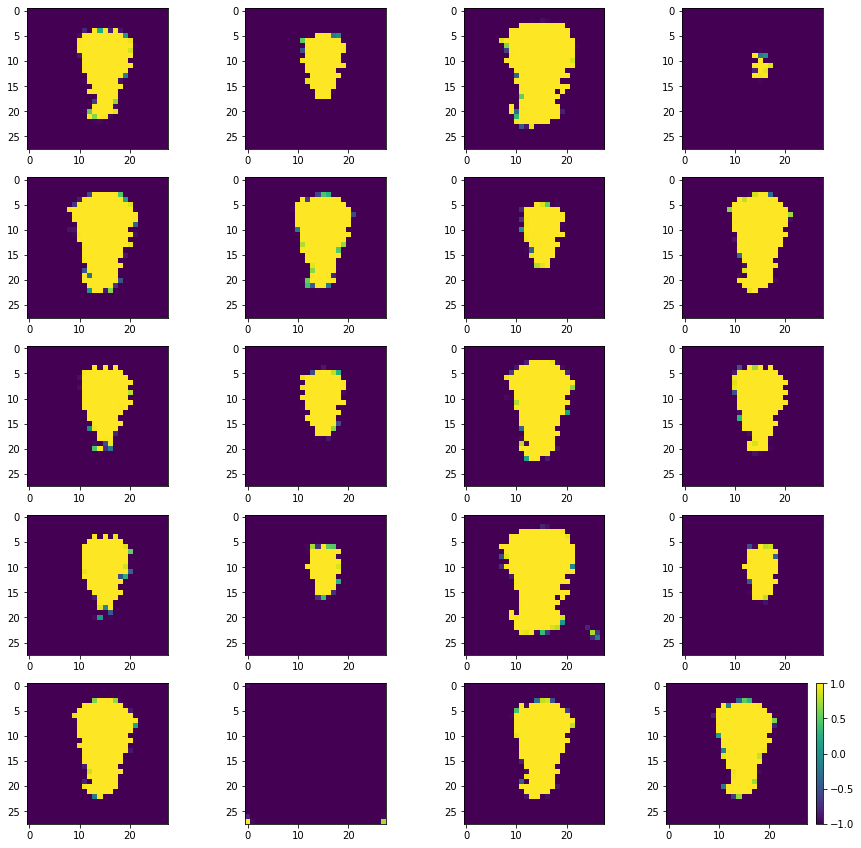

Batch_Num : 137
D_Loss   :   [11.041158676147461, 0.3532327711582184, 10.687926292419434, 0.455078125, 0.126953125] ;    GAN_Loss   :  [13.34799861907959, 2.150092363357544, 11.197906494140625, 0.0, 0.091796875]
Batch_Num : 138
D_Loss   :   [10.207327842712402, 0.26002174615859985, 9.947305679321289, 0.49609375, 0.107421875] ;    GAN_Loss   :  [14.5693998336792, 2.7586967945098877, 11.81070327758789, 0.0, 0.087890625]
Batch_Num : 139
D_Loss   :   [10.085077285766602, 0.2081822156906128, 9.8768949508667, 0.5, 0.08984375] ;    GAN_Loss   :  [14.515743255615234, 2.8188087940216064, 11.696934700012207, 0.0, 0.064453125]
Batch_Num : 140
D_Loss   :   [9.630748748779297, 0.17397402226924896, 9.456774711608887, 0.5, 0.12109375] ;    GAN_Loss   :  [14.68329906463623, 2.7429144382476807, 11.940384864807129, 0.0, 0.080078125]
Batch_Num : 141
D_Loss   :   [10.257431983947754, 0.1978132426738739, 10.059618949890137, 0.5, 0.072265625] ;    GAN_Loss   :  [13.937217712402344, 2.6379337310791016, 11.29

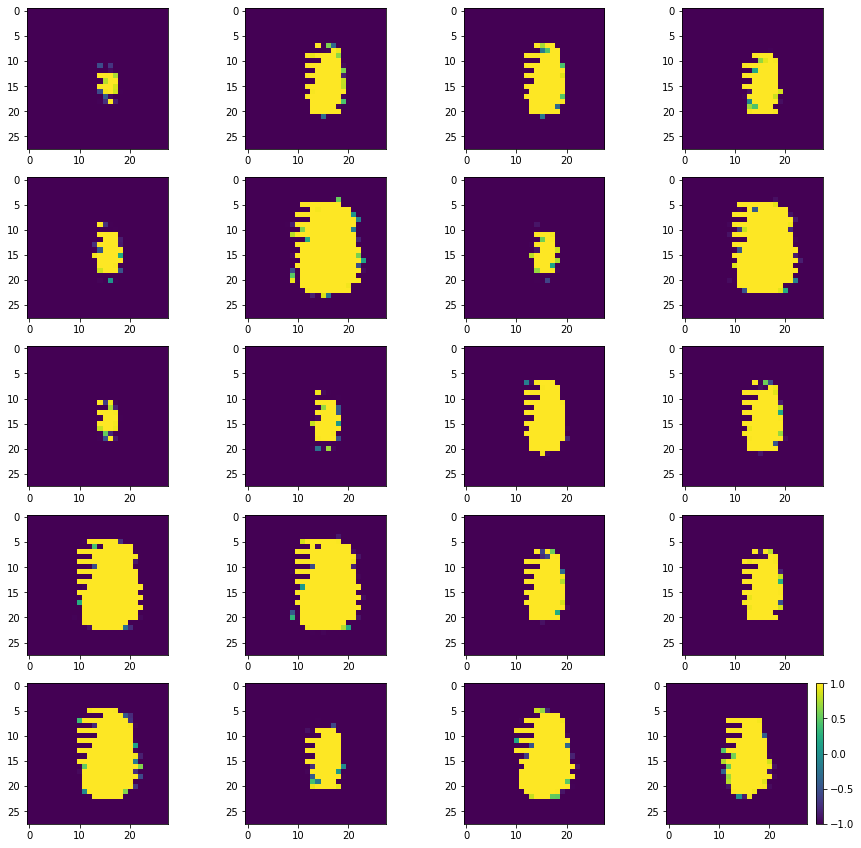

Batch_Num : 152
D_Loss   :   [9.85855770111084, 0.1495801955461502, 9.708977699279785, 0.5, 0.11328125] ;    GAN_Loss   :  [16.02752685546875, 3.554147958755493, 12.473379135131836, 0.0, 0.099609375]
Batch_Num : 153
D_Loss   :   [10.126699447631836, 0.153212308883667, 9.97348690032959, 0.5, 0.103515625] ;    GAN_Loss   :  [15.667076110839844, 3.385936975479126, 12.281139373779297, 0.0, 0.11328125]
Batch_Num : 154
D_Loss   :   [10.112247467041016, 0.1780758798122406, 9.934171676635742, 0.5, 0.103515625] ;    GAN_Loss   :  [15.329933166503906, 3.2890729904174805, 12.040860176086426, 0.0, 0.10546875]
Batch_Num : 155
D_Loss   :   [10.530901908874512, 0.21860596537590027, 10.312295913696289, 0.494140625, 0.11328125] ;    GAN_Loss   :  [15.441337585449219, 3.334923267364502, 12.106413841247559, 0.0, 0.09765625]
Batch_Num : 156
D_Loss   :   [9.599742889404297, 0.18621096014976501, 9.413532257080078, 0.5, 0.083984375] ;    GAN_Loss   :  [14.628609657287598, 3.0830557346343994, 11.5455541610717

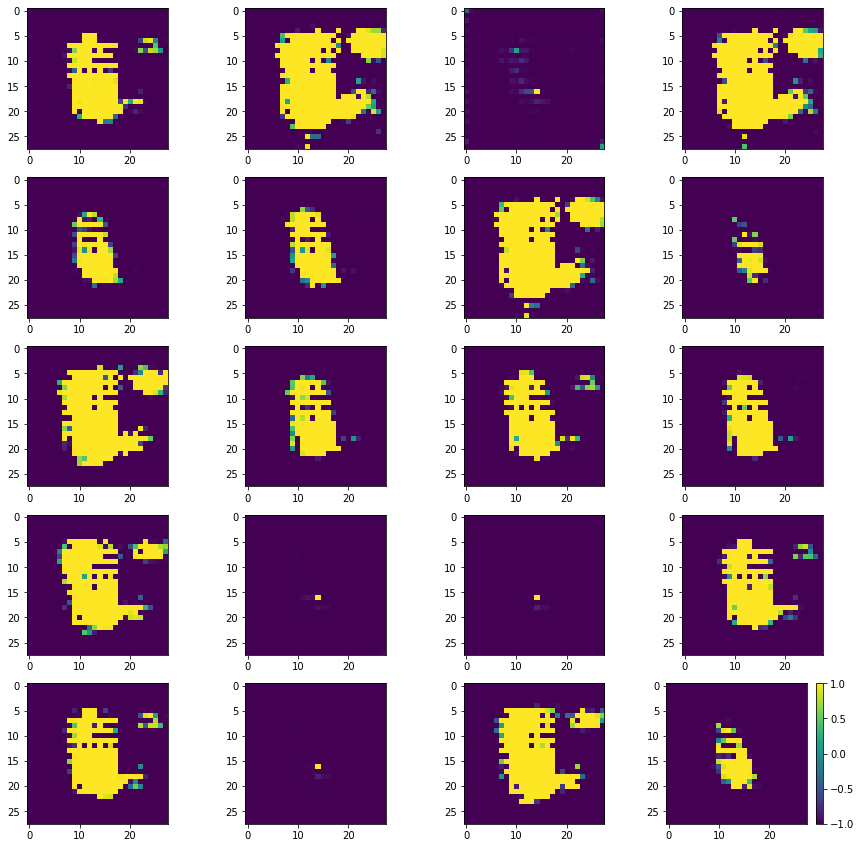

Batch_Num : 167
D_Loss   :   [10.594154357910156, 0.15705810487270355, 10.43709659576416, 0.5, 0.123046875] ;    GAN_Loss   :  [14.400787353515625, 2.9095444679260254, 11.491243362426758, 0.0, 0.099609375]
Batch_Num : 168
D_Loss   :   [9.634922981262207, 0.15401533246040344, 9.480907440185547, 0.498046875, 0.091796875] ;    GAN_Loss   :  [14.119548797607422, 3.0840423107147217, 11.035506248474121, 0.0, 0.12109375]
Batch_Num : 169
D_Loss   :   [10.144331932067871, 0.16047216951847076, 9.98386001586914, 0.484375, 0.072265625] ;    GAN_Loss   :  [14.698637962341309, 3.1822216510772705, 11.516416549682617, 0.0, 0.091796875]
Batch_Num : 170
D_Loss   :   [10.110665321350098, 0.14974822103977203, 9.960917472839355, 0.498046875, 0.107421875] ;    GAN_Loss   :  [15.132293701171875, 3.0911965370178223, 12.041096687316895, 0.0, 0.125]
Batch_Num : 171
D_Loss   :   [10.492532730102539, 0.18202823400497437, 10.310504913330078, 0.49609375, 0.115234375] ;    GAN_Loss   :  [14.201204299926758, 2.991615

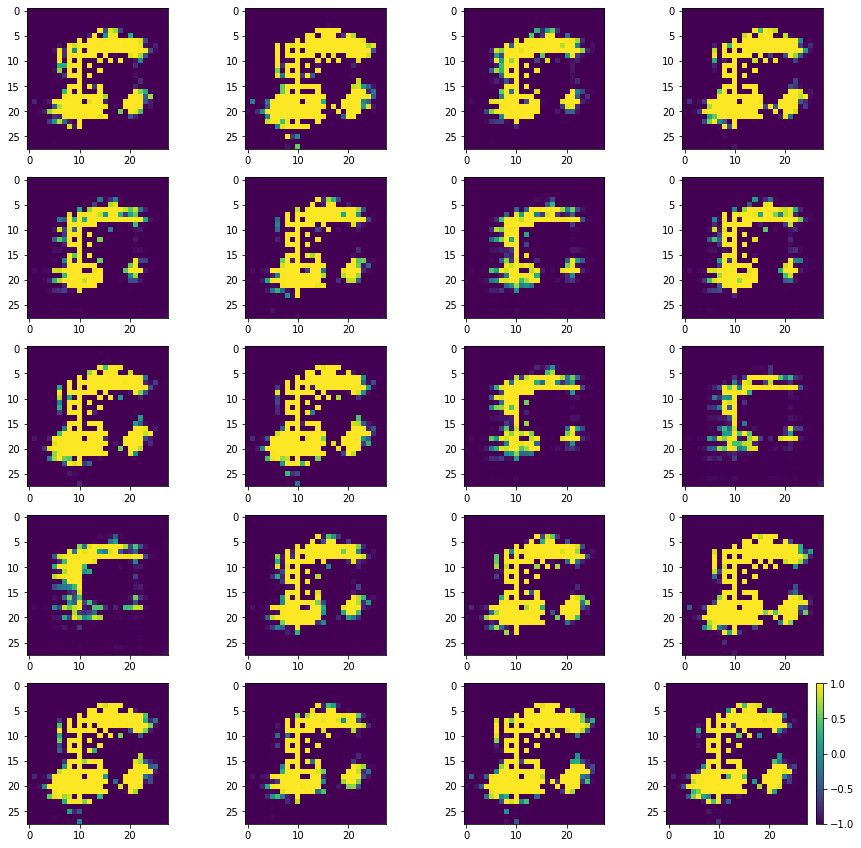

Batch_Num : 182
D_Loss   :   [9.760457992553711, 0.1511681079864502, 9.60929012298584, 0.5, 0.095703125] ;    GAN_Loss   :  [14.087284088134766, 2.752361297607422, 11.334922790527344, 0.0, 0.099609375]
Batch_Num : 183
D_Loss   :   [10.430065155029297, 0.1601751446723938, 10.269889831542969, 0.5, 0.123046875] ;    GAN_Loss   :  [14.209731101989746, 2.633136749267578, 11.576594352722168, 0.0, 0.12890625]
Batch_Num : 184
D_Loss   :   [9.912763595581055, 0.18253573775291443, 9.73022747039795, 0.49609375, 0.115234375] ;    GAN_Loss   :  [14.306938171386719, 2.945204734802246, 11.361733436584473, 0.0, 0.1015625]
Batch_Num : 185
D_Loss   :   [9.970194816589355, 0.15719929337501526, 9.812995910644531, 0.498046875, 0.0859375] ;    GAN_Loss   :  [14.012720108032227, 2.7482590675354004, 11.264460563659668, 0.0, 0.115234375]
Batch_Num : 186
D_Loss   :   [9.616190910339355, 0.1926511824131012, 9.423540115356445, 0.48046875, 0.103515625] ;    GAN_Loss   :  [13.234737396240234, 2.3417856693267822, 10

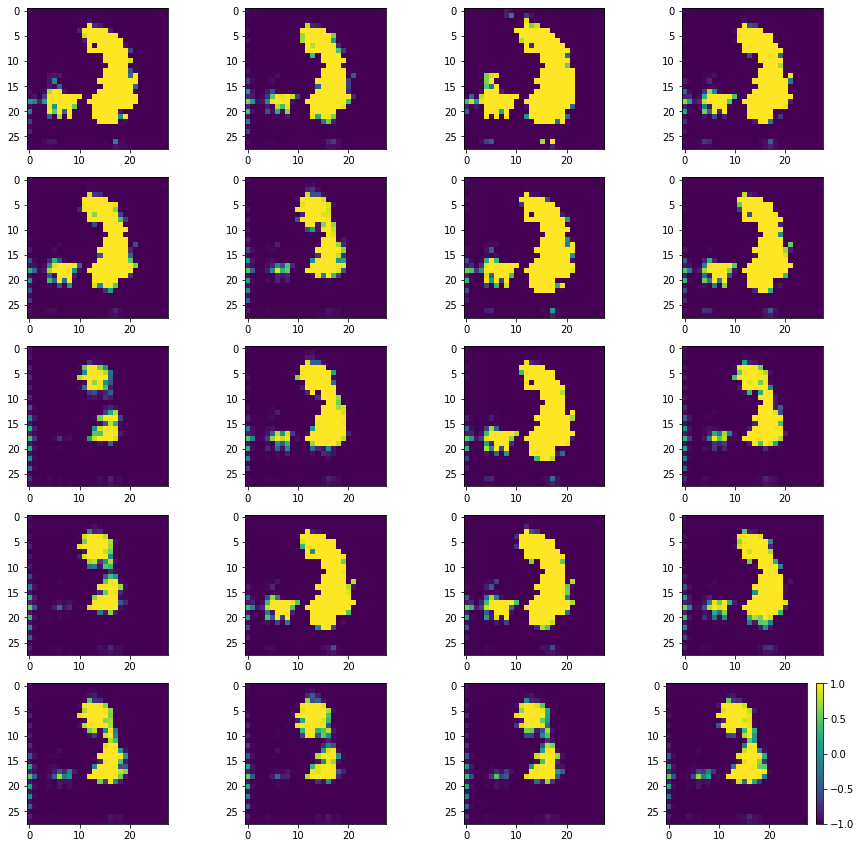

Batch_Num : 197
D_Loss   :   [10.023286819458008, 0.14553338289260864, 9.877753257751465, 0.5, 0.0859375] ;    GAN_Loss   :  [12.539998054504395, 1.389463186264038, 11.150534629821777, 0.0, 0.119140625]
Batch_Num : 198
D_Loss   :   [9.74582290649414, 0.16844463348388672, 9.577378273010254, 0.49609375, 0.119140625] ;    GAN_Loss   :  [12.78310775756836, 1.3315571546554565, 11.451550483703613, 0.0, 0.11328125]
Batch_Num : 199
D_Loss   :   [10.63138484954834, 0.15503832697868347, 10.476346969604492, 0.498046875, 0.12890625] ;    GAN_Loss   :  [12.292040824890137, 1.2036516666412354, 11.08838939666748, 0.0, 0.095703125]
Batch_Num : 200
D_Loss   :   [10.210165977478027, 0.14833465218544006, 10.0618314743042, 0.5, 0.1171875] ;    GAN_Loss   :  [11.457669258117676, 0.8220161199569702, 10.635653495788574, 0.0, 0.099609375]
Batch_Num : 201
D_Loss   :   [10.484365463256836, 0.1826297640800476, 10.301735877990723, 0.498046875, 0.138671875] ;    GAN_Loss   :  [11.668390274047852, 0.832310855388641

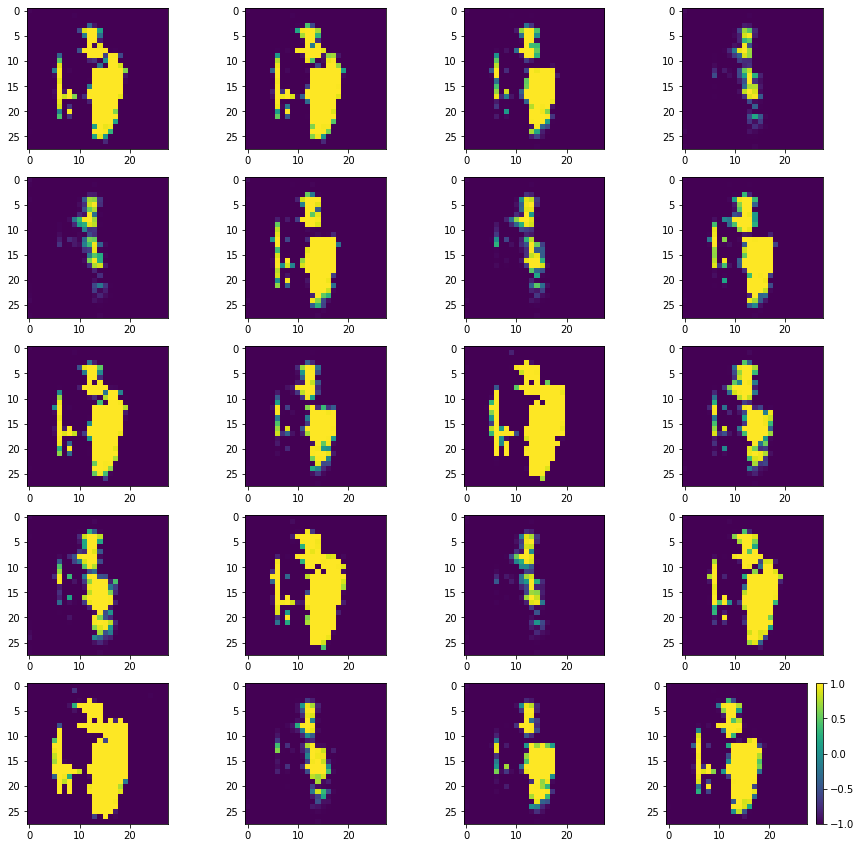

Batch_Num : 212
D_Loss   :   [10.946521759033203, 0.1349070966243744, 10.811614990234375, 0.5, 0.1015625] ;    GAN_Loss   :  [11.209896087646484, 0.6576499938964844, 10.55224609375, 0.0, 0.111328125]
Batch_Num : 213
D_Loss   :   [9.627742767333984, 0.13153406977653503, 9.496209144592285, 0.5, 0.091796875] ;    GAN_Loss   :  [11.302255630493164, 0.6122205257415771, 10.690034866333008, 0.0, 0.09375]
Batch_Num : 214
D_Loss   :   [10.39355182647705, 0.1409621685743332, 10.252589225769043, 0.5, 0.1015625] ;    GAN_Loss   :  [11.359990119934082, 0.6982714533805847, 10.661718368530273, 0.0, 0.08984375]
Batch_Num : 215
D_Loss   :   [9.221131324768066, 0.13047833740711212, 9.090653419494629, 0.5, 0.080078125] ;    GAN_Loss   :  [10.683416366577148, 0.6304996013641357, 10.052916526794434, 0.0, 0.080078125]
Batch_Num : 216
D_Loss   :   [10.4262113571167, 0.12716081738471985, 10.299050331115723, 0.5, 0.078125] ;    GAN_Loss   :  [11.197502136230469, 0.6708993315696716, 10.526602745056152, 0.0, 0.0

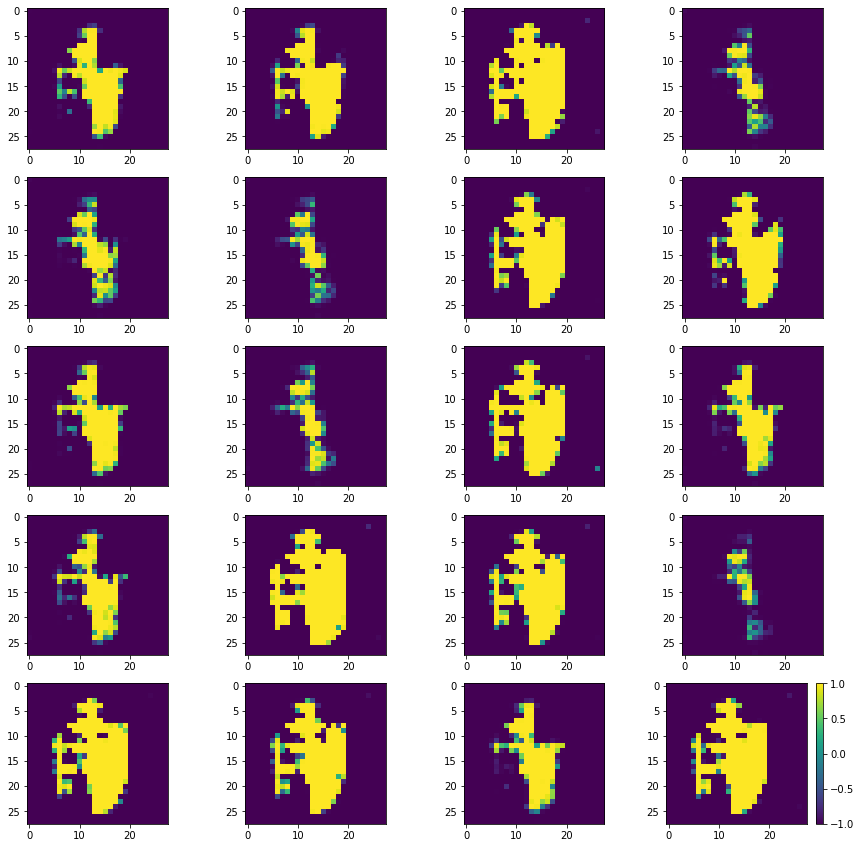

Batch_Num : 227
D_Loss   :   [9.282262802124023, 0.13659225404262543, 9.145670890808105, 0.49609375, 0.091796875] ;    GAN_Loss   :  [10.77454948425293, 0.5763909816741943, 10.198158264160156, 0.0, 0.08984375]
Batch_Num : 228
D_Loss   :   [10.372635841369629, 0.12797802686691284, 10.244657516479492, 0.5, 0.095703125] ;    GAN_Loss   :  [10.78218936920166, 0.6072969436645508, 10.17489242553711, 0.0, 0.095703125]
Batch_Num : 229
D_Loss   :   [9.786521911621094, 0.12626001238822937, 9.660262107849121, 0.5, 0.1015625] ;    GAN_Loss   :  [11.026355743408203, 0.7358996868133545, 10.29045581817627, 0.0, 0.109375]
Batch_Num : 230
D_Loss   :   [10.117436408996582, 0.12915274500846863, 9.98828411102295, 0.49609375, 0.09765625] ;    GAN_Loss   :  [11.313018798828125, 0.7423898577690125, 10.570629119873047, 0.0, 0.09765625]
Batch_Num : 231
D_Loss   :   [10.352235794067383, 0.1245759129524231, 10.227660179138184, 0.498046875, 0.072265625] ;    GAN_Loss   :  [11.13817024230957, 0.6139599084854126, 1

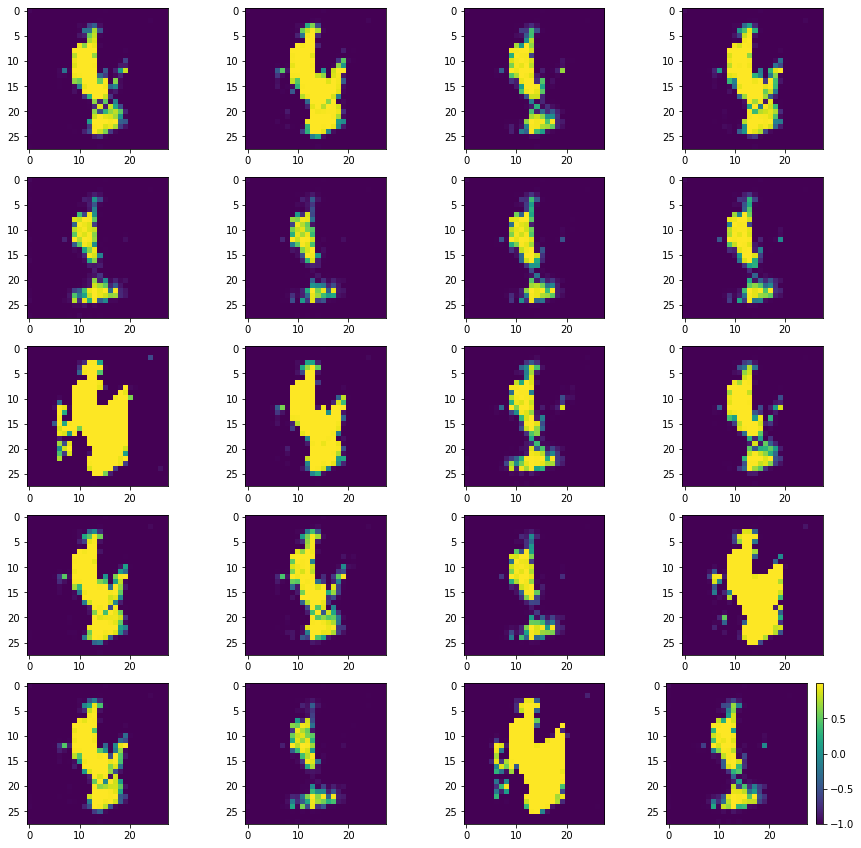

Batch_Num : 2
D_Loss   :   [10.18532657623291, 0.15393729507923126, 10.031389236450195, 0.5, 0.125] ;    GAN_Loss   :  [10.799576759338379, 0.5434331893920898, 10.256143569946289, 0.0, 0.0703125]
Batch_Num : 3
D_Loss   :   [10.188661575317383, 0.14238114655017853, 10.046280860900879, 0.494140625, 0.07421875] ;    GAN_Loss   :  [11.190584182739258, 0.5047638416290283, 10.685820579528809, 0.0, 0.123046875]
Batch_Num : 4
D_Loss   :   [10.360116958618164, 0.13656142354011536, 10.223555564880371, 0.5, 0.095703125] ;    GAN_Loss   :  [10.79794979095459, 0.526007890701294, 10.271942138671875, 0.0, 0.091796875]
Batch_Num : 5
D_Loss   :   [10.227173805236816, 0.14277195930480957, 10.084402084350586, 0.5, 0.08984375] ;    GAN_Loss   :  [10.747364044189453, 0.3336424231529236, 10.413722038269043, 0.0, 0.09765625]
Batch_Num : 6
D_Loss   :   [10.517842292785645, 0.14806264638900757, 10.369779586791992, 0.5, 0.1015625] ;    GAN_Loss   :  [10.73013687133789, 0.6296642422676086, 10.100472450256348, 0.

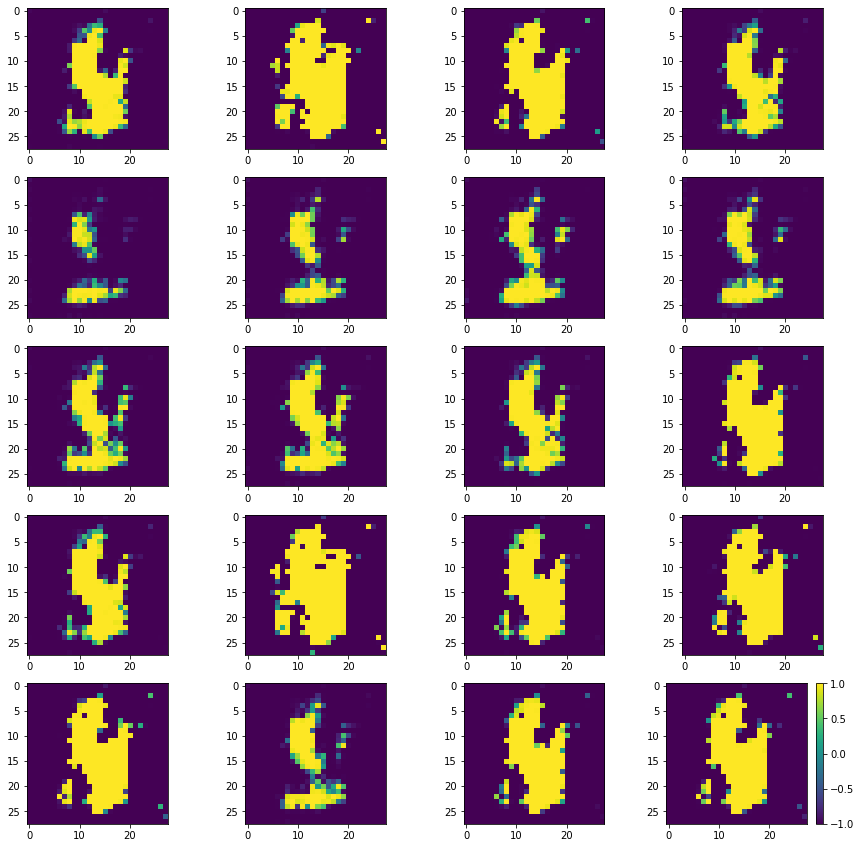

Batch_Num : 17
D_Loss   :   [9.797819137573242, 0.12144634127616882, 9.676372528076172, 0.5, 0.10546875] ;    GAN_Loss   :  [10.355815887451172, 0.4292425215244293, 9.926573753356934, 0.0, 0.109375]
Batch_Num : 18
D_Loss   :   [9.937646865844727, 0.12018823623657227, 9.817458152770996, 0.5, 0.083984375] ;    GAN_Loss   :  [10.867929458618164, 0.3930841386318207, 10.474844932556152, 0.0, 0.126953125]
Batch_Num : 19
D_Loss   :   [10.016351699829102, 0.12556880712509155, 9.890783309936523, 0.5, 0.111328125] ;    GAN_Loss   :  [10.641165733337402, 0.39084747433662415, 10.25031852722168, 0.0, 0.12109375]
Batch_Num : 20
D_Loss   :   [9.824408531188965, 0.11565134674310684, 9.708757400512695, 0.5, 0.095703125] ;    GAN_Loss   :  [10.714136123657227, 0.4165670573711395, 10.297569274902344, 0.0, 0.109375]
Batch_Num : 21
D_Loss   :   [9.670287132263184, 0.11703378707170486, 9.553253173828125, 0.5, 0.09375] ;    GAN_Loss   :  [10.557861328125, 0.40577027201652527, 10.152091026306152, 0.0, 0.11914

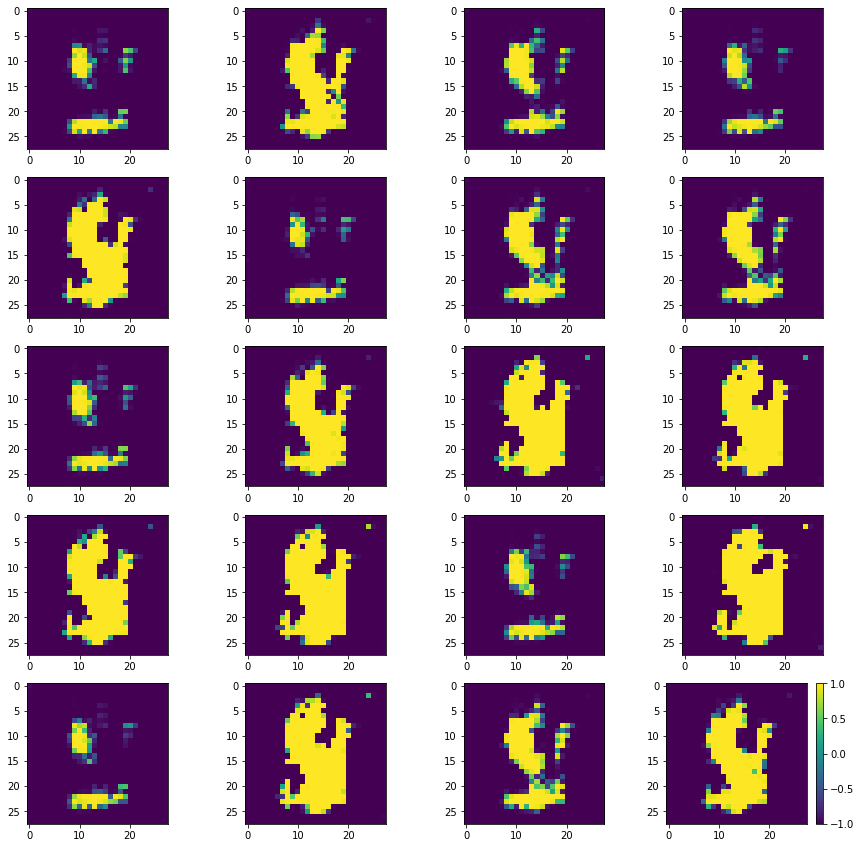

Batch_Num : 32
D_Loss   :   [9.709912300109863, 0.11530790477991104, 9.5946044921875, 0.5, 0.107421875] ;    GAN_Loss   :  [10.508537292480469, 0.2779466211795807, 10.2305908203125, 0.0, 0.1015625]
Batch_Num : 33
D_Loss   :   [10.288333892822266, 0.11473067104816437, 10.173603057861328, 0.5, 0.099609375] ;    GAN_Loss   :  [11.254132270812988, 0.28416112065315247, 10.969970703125, 0.0, 0.1171875]
Batch_Num : 34
D_Loss   :   [10.34593391418457, 0.11673010885715485, 10.229204177856445, 0.5, 0.111328125] ;    GAN_Loss   :  [10.200787544250488, 0.24531111121177673, 9.955476760864258, 0.0, 0.1015625]
Batch_Num : 35
D_Loss   :   [9.59111499786377, 0.11313798278570175, 9.47797679901123, 0.5, 0.083984375] ;    GAN_Loss   :  [9.681578636169434, 0.2563331425189972, 9.42524528503418, 0.0, 0.1171875]
Batch_Num : 36
D_Loss   :   [9.666133880615234, 0.11267498135566711, 9.553459167480469, 0.5, 0.1015625] ;    GAN_Loss   :  [10.323979377746582, 0.3048393428325653, 10.019140243530273, 0.0, 0.103515625

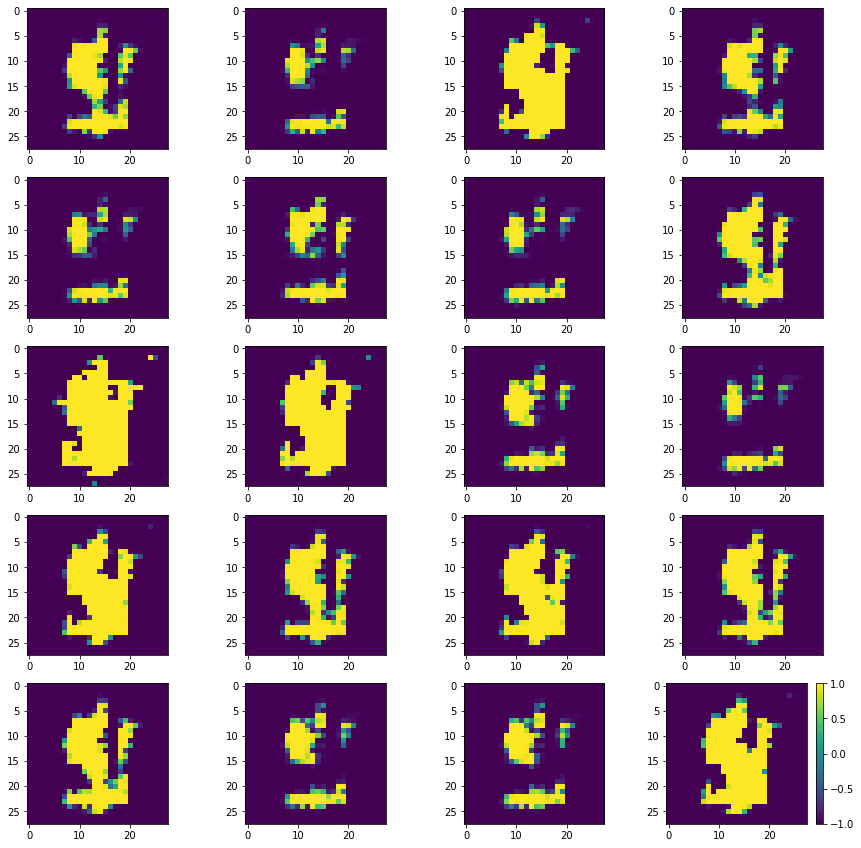

Batch_Num : 47
D_Loss   :   [10.653810501098633, 0.11333024501800537, 10.540480613708496, 0.5, 0.1015625] ;    GAN_Loss   :  [10.697588920593262, 0.28883039951324463, 10.408758163452148, 0.0, 0.138671875]
Batch_Num : 48
D_Loss   :   [10.103422164916992, 0.11339409649372101, 9.990028381347656, 0.5, 0.107421875] ;    GAN_Loss   :  [9.711702346801758, 0.3041155934333801, 9.407587051391602, 0.0, 0.146484375]
Batch_Num : 49
D_Loss   :   [10.03524398803711, 0.11337999999523163, 9.921863555908203, 0.5, 0.119140625] ;    GAN_Loss   :  [10.1692533493042, 0.2993842661380768, 9.869869232177734, 0.0, 0.12109375]
Batch_Num : 50
D_Loss   :   [9.752440452575684, 0.11311975121498108, 9.639320373535156, 0.5, 0.09765625] ;    GAN_Loss   :  [10.349603652954102, 0.27680638432502747, 10.072796821594238, 0.0, 0.130859375]
Batch_Num : 51
D_Loss   :   [10.387702941894531, 0.11738234758377075, 10.270320892333984, 0.5, 0.11328125] ;    GAN_Loss   :  [10.819767951965332, 0.2504619061946869, 10.569306373596191, 0

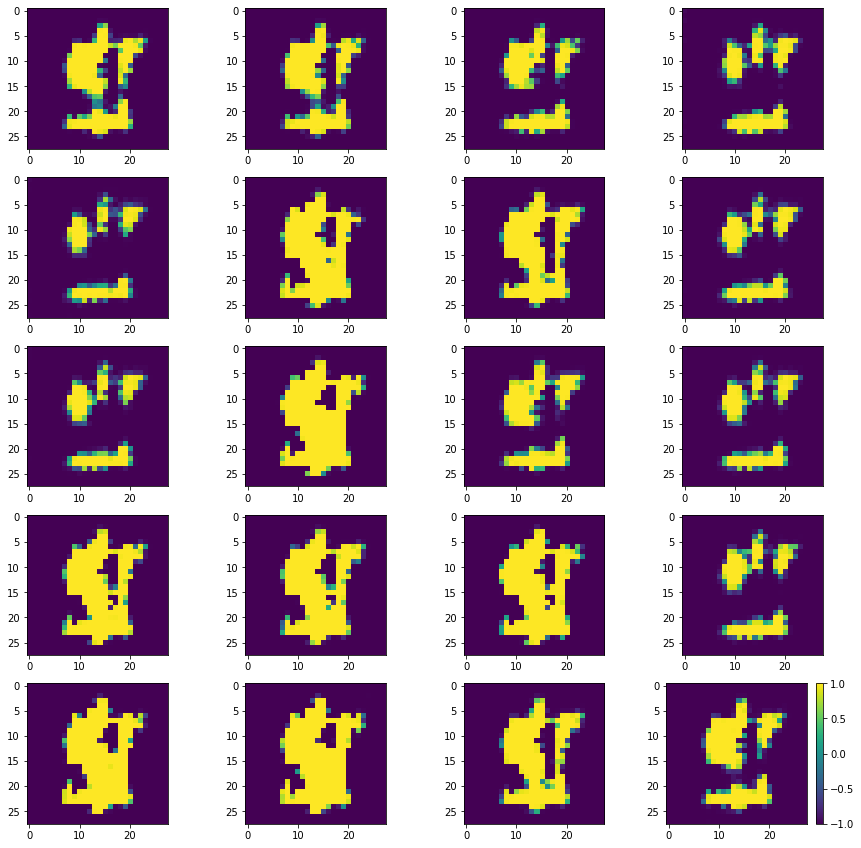

Batch_Num : 62
D_Loss   :   [9.754569053649902, 0.11358506232500076, 9.640983581542969, 0.5, 0.087890625] ;    GAN_Loss   :  [10.449966430664062, 0.2865395247936249, 10.163427352905273, 0.0, 0.09375]
Batch_Num : 63
D_Loss   :   [10.013869285583496, 0.11212584376335144, 9.90174388885498, 0.5, 0.095703125] ;    GAN_Loss   :  [10.544352531433105, 0.2774708867073059, 10.266881942749023, 0.0, 0.09765625]
Batch_Num : 64
D_Loss   :   [9.986485481262207, 0.10994996875524521, 9.876535415649414, 0.5, 0.107421875] ;    GAN_Loss   :  [9.963495254516602, 0.3124205768108368, 9.651074409484863, 0.0, 0.130859375]
Batch_Num : 65
D_Loss   :   [10.12468433380127, 0.1097906231880188, 10.014893531799316, 0.5, 0.109375] ;    GAN_Loss   :  [10.447784423828125, 0.29390662908554077, 10.153878211975098, 0.0, 0.12109375]
Batch_Num : 66
D_Loss   :   [10.753891944885254, 0.11114783585071564, 10.642744064331055, 0.5, 0.142578125] ;    GAN_Loss   :  [10.505741119384766, 0.28395551443099976, 10.221785545349121, 0.0, 

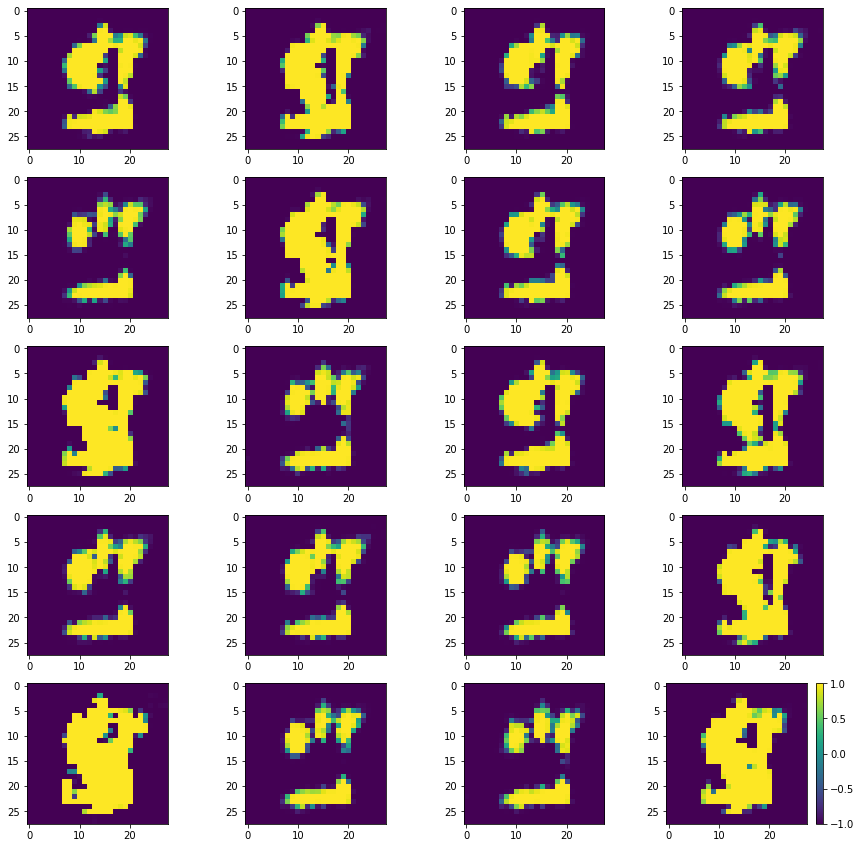

Batch_Num : 77
D_Loss   :   [10.0623197555542, 0.12253715097904205, 9.93978214263916, 0.5, 0.1015625] ;    GAN_Loss   :  [11.141496658325195, 0.3203451931476593, 10.821151733398438, 0.0, 0.12109375]
Batch_Num : 78
D_Loss   :   [9.695802688598633, 0.12480585277080536, 9.57099723815918, 0.5, 0.125] ;    GAN_Loss   :  [10.876753807067871, 0.5324529409408569, 10.344301223754883, 0.0, 0.095703125]
Batch_Num : 79
D_Loss   :   [10.472912788391113, 0.12027494609355927, 10.352638244628906, 0.5, 0.109375] ;    GAN_Loss   :  [10.96890640258789, 0.7432815432548523, 10.225625038146973, 0.0, 0.111328125]
Batch_Num : 80
D_Loss   :   [10.010607719421387, 0.11592773348093033, 9.89468002319336, 0.5, 0.107421875] ;    GAN_Loss   :  [11.129545211791992, 0.6560940146446228, 10.473451614379883, 0.0, 0.078125]
Batch_Num : 81
D_Loss   :   [10.245635032653809, 0.11515301465988159, 10.130481719970703, 0.5, 0.126953125] ;    GAN_Loss   :  [11.002574920654297, 0.5046847462654114, 10.49789047241211, 0.0, 0.1191406

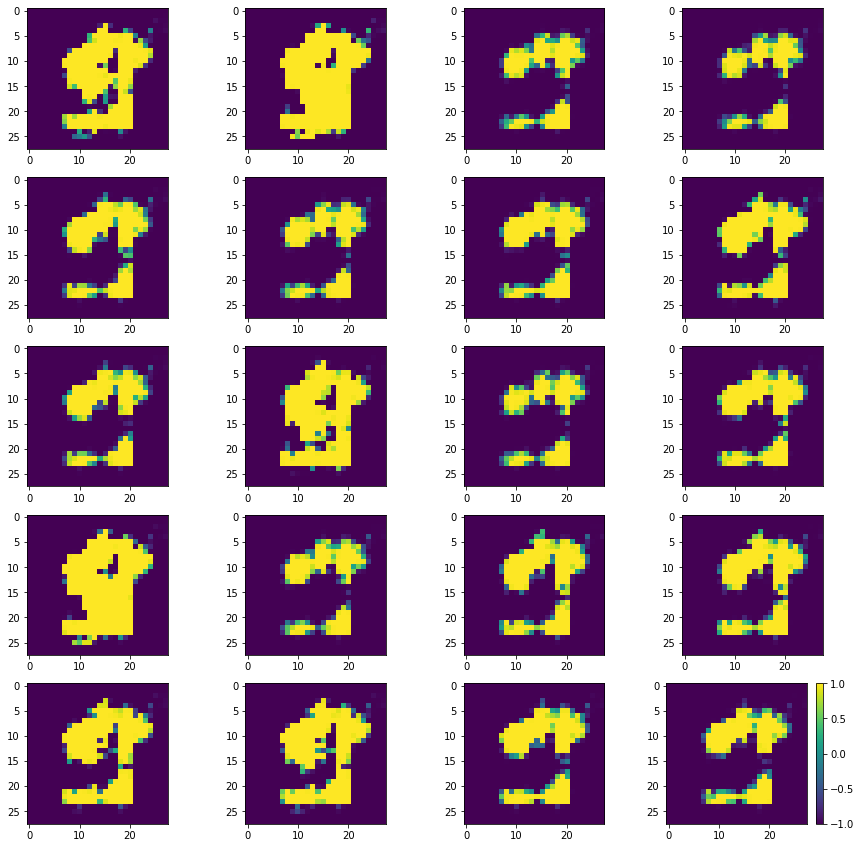

Batch_Num : 92
D_Loss   :   [10.134581565856934, 0.11226317286491394, 10.022318840026855, 0.5, 0.11328125] ;    GAN_Loss   :  [10.30052661895752, 0.395969033241272, 9.904557228088379, 0.0, 0.099609375]
Batch_Num : 93
D_Loss   :   [10.575718879699707, 0.11275812983512878, 10.462961196899414, 0.5, 0.109375] ;    GAN_Loss   :  [10.394927978515625, 0.4166198670864105, 9.978307723999023, 0.0, 0.107421875]
Batch_Num : 94
D_Loss   :   [9.988890647888184, 0.11105243861675262, 9.877838134765625, 0.5, 0.12109375] ;    GAN_Loss   :  [10.481012344360352, 0.5235180854797363, 9.957494735717773, 0.0, 0.123046875]
Batch_Num : 95
D_Loss   :   [10.17166519165039, 0.11238129436969757, 10.059284210205078, 0.5, 0.111328125] ;    GAN_Loss   :  [10.708459854125977, 0.4445468485355377, 10.26391315460205, 0.0, 0.103515625]
Batch_Num : 96
D_Loss   :   [9.719075202941895, 0.11058494448661804, 9.608489990234375, 0.5, 0.123046875] ;    GAN_Loss   :  [10.943533897399902, 0.4168553948402405, 10.526678085327148, 0.0,

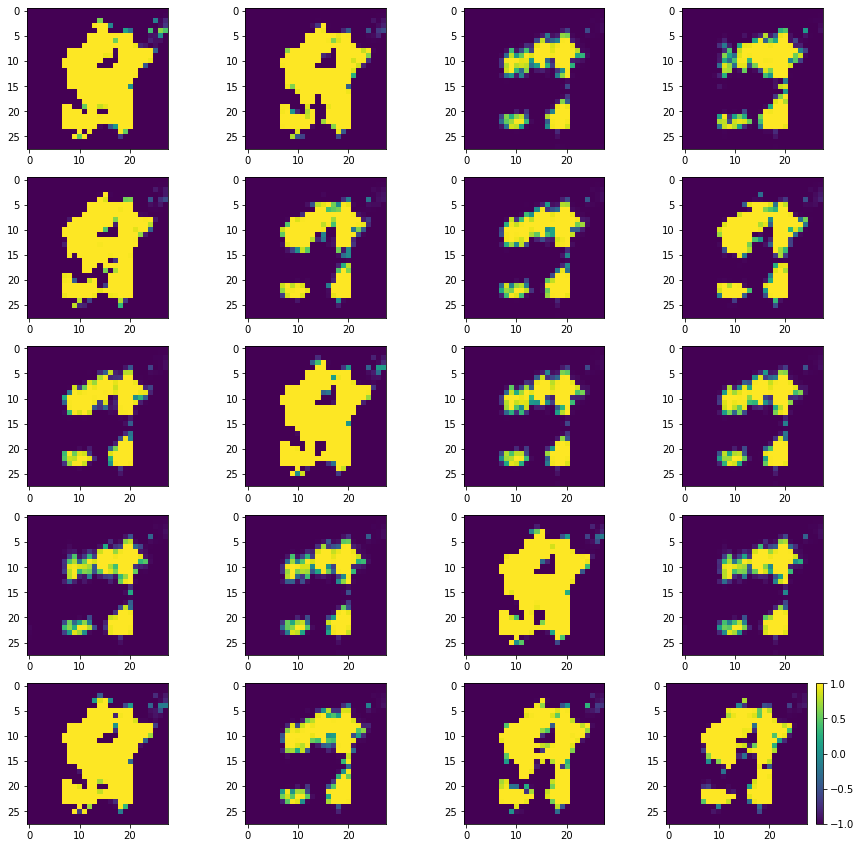

Batch_Num : 107
D_Loss   :   [9.99327564239502, 0.10856106132268906, 9.884714126586914, 0.5, 0.099609375] ;    GAN_Loss   :  [10.069622993469238, 0.27160903811454773, 9.798013687133789, 0.0, 0.12109375]
Batch_Num : 108
D_Loss   :   [9.418256759643555, 0.10904217511415482, 9.30921459197998, 0.5, 0.111328125] ;    GAN_Loss   :  [10.847383499145508, 0.26983842253685, 10.577545166015625, 0.0, 0.125]
Batch_Num : 109
D_Loss   :   [9.640680313110352, 0.10937083512544632, 9.531309127807617, 0.5, 0.107421875] ;    GAN_Loss   :  [9.929516792297363, 0.2967725992202759, 9.632743835449219, 0.0, 0.103515625]
Batch_Num : 110
D_Loss   :   [10.3368558883667, 0.10866494476795197, 10.228191375732422, 0.498046875, 0.107421875] ;    GAN_Loss   :  [11.130586624145508, 0.3626627027988434, 10.767924308776855, 0.0, 0.115234375]
Batch_Num : 111
D_Loss   :   [9.532002449035645, 0.1141064465045929, 9.417896270751953, 0.5, 0.111328125] ;    GAN_Loss   :  [10.656872749328613, 0.25466030836105347, 10.402212142944336

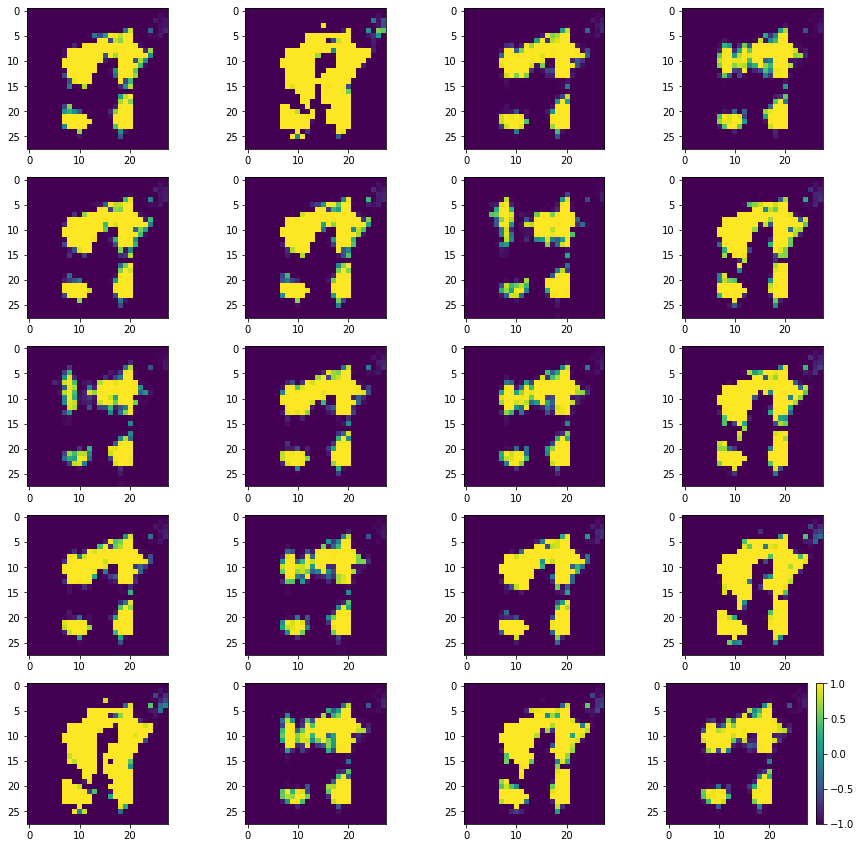

Batch_Num : 122
D_Loss   :   [10.516334533691406, 0.10931134223937988, 10.407023429870605, 0.5, 0.10546875] ;    GAN_Loss   :  [10.023575782775879, 0.3073504865169525, 9.716225624084473, 0.0, 0.091796875]
Batch_Num : 123
D_Loss   :   [9.894959449768066, 0.1099054366350174, 9.785054206848145, 0.5, 0.10546875] ;    GAN_Loss   :  [10.368124008178711, 0.27764272689819336, 10.090481758117676, 0.0, 0.10546875]
Batch_Num : 124
D_Loss   :   [10.234299659729004, 0.10851094126701355, 10.125788688659668, 0.5, 0.111328125] ;    GAN_Loss   :  [10.3924560546875, 0.2565842866897583, 10.135871887207031, 0.0, 0.08984375]
Batch_Num : 125
D_Loss   :   [10.418395042419434, 0.11053552478551865, 10.307859420776367, 0.5, 0.099609375] ;    GAN_Loss   :  [10.66972541809082, 0.2597289979457855, 10.409996032714844, 0.0, 0.10546875]
Batch_Num : 126
D_Loss   :   [10.362384796142578, 0.10905317962169647, 10.253331184387207, 0.5, 0.103515625] ;    GAN_Loss   :  [10.17155647277832, 0.29446738958358765, 9.877089500427

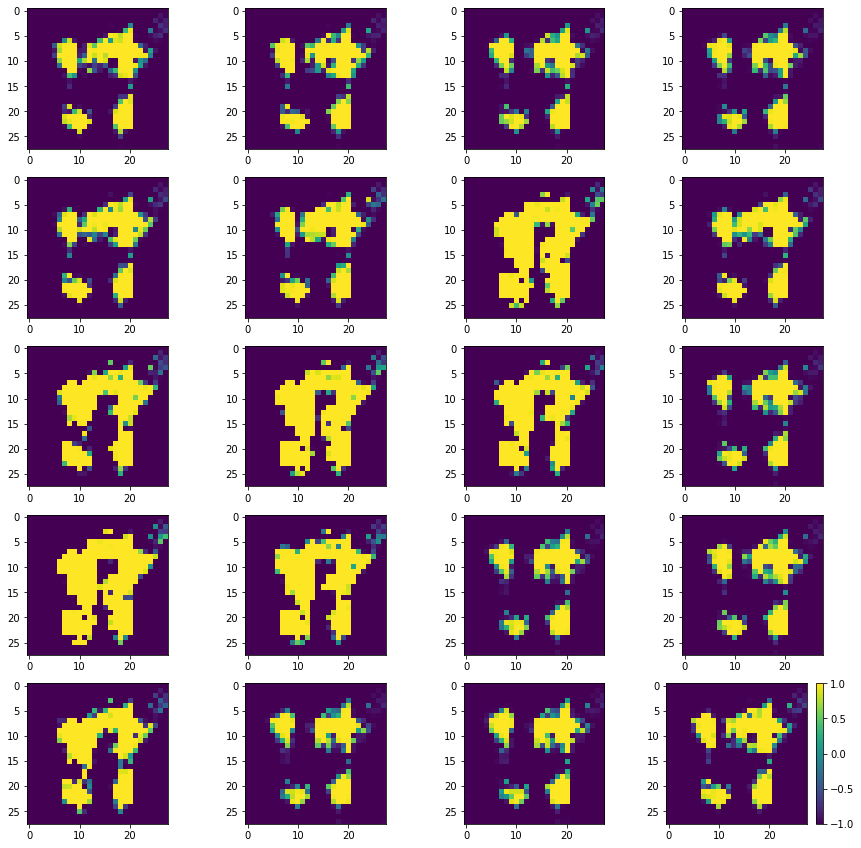

Batch_Num : 137
D_Loss   :   [10.742325782775879, 0.10959567129611969, 10.632730484008789, 0.5, 0.0859375] ;    GAN_Loss   :  [10.541091918945312, 0.5648486018180847, 9.976243019104004, 0.0, 0.087890625]
Batch_Num : 138
D_Loss   :   [10.008002281188965, 0.10782192647457123, 9.90018081665039, 0.5, 0.1015625] ;    GAN_Loss   :  [10.863055229187012, 0.5287579298019409, 10.334297180175781, 0.0, 0.09765625]
Batch_Num : 139
D_Loss   :   [9.911847114562988, 0.10643967241048813, 9.805407524108887, 0.5, 0.09765625] ;    GAN_Loss   :  [11.482218742370605, 0.44678065180778503, 11.035438537597656, 0.0, 0.09375]
Batch_Num : 140
D_Loss   :   [9.508862495422363, 0.10652638226747513, 9.402336120605469, 0.5, 0.1015625] ;    GAN_Loss   :  [10.995941162109375, 0.4400404989719391, 10.555900573730469, 0.0, 0.115234375]
Batch_Num : 141
D_Loss   :   [10.08626937866211, 0.1076488271355629, 9.978620529174805, 0.5, 0.111328125] ;    GAN_Loss   :  [10.979362487792969, 0.45628637075424194, 10.523076057434082, 0.0

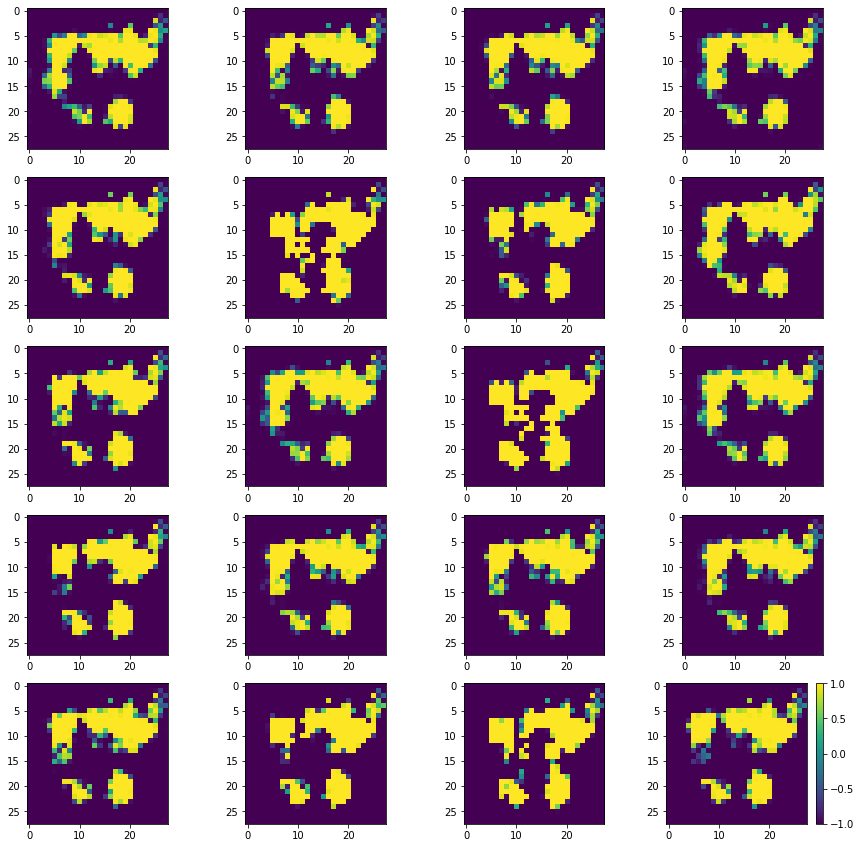

Batch_Num : 152
D_Loss   :   [9.797367095947266, 0.11617061495780945, 9.681196212768555, 0.5, 0.138671875] ;    GAN_Loss   :  [34.50639343261719, 12.174219131469727, 22.332172393798828, 0.0, 0.130859375]
Batch_Num : 153
D_Loss   :   [10.168821334838867, 0.18678489327430725, 9.982036590576172, 0.5, 0.09375] ;    GAN_Loss   :  [22.61095428466797, 6.65067720413208, 15.960277557373047, 0.0, 0.1171875]
Batch_Num : 154
D_Loss   :   [10.199882507324219, 0.25237488746643066, 9.947507858276367, 0.478515625, 0.09765625] ;    GAN_Loss   :  [18.575359344482422, 4.69793176651001, 13.87742805480957, 0.0, 0.083984375]
Batch_Num : 155
D_Loss   :   [10.571964263916016, 0.2968316078186035, 10.275132179260254, 0.4453125, 0.09375] ;    GAN_Loss   :  [21.526145935058594, 4.792156219482422, 16.733989715576172, 0.0, 0.109375]
Batch_Num : 156
D_Loss   :   [9.562100410461426, 0.16774018108844757, 9.394360542297363, 0.5, 0.09765625] ;    GAN_Loss   :  [21.4593505859375, 4.26991605758667, 17.189434051513672, 0.0

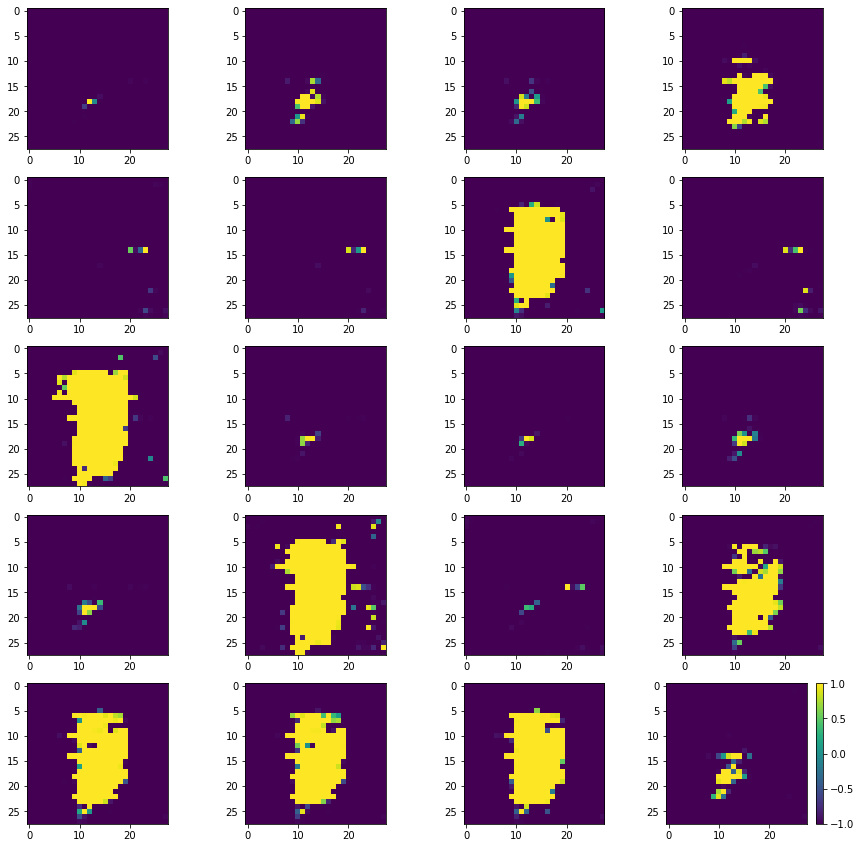

Batch_Num : 167
D_Loss   :   [10.560651779174805, 0.15257900953292847, 10.408072471618652, 0.5, 0.087890625] ;    GAN_Loss   :  [14.828268051147461, 2.954362392425537, 11.873906135559082, 0.0, 0.107421875]
Batch_Num : 168
D_Loss   :   [9.59830379486084, 0.13894401490688324, 9.459360122680664, 0.5, 0.080078125] ;    GAN_Loss   :  [15.066182136535645, 2.5510711669921875, 12.515110969543457, 0.0, 0.111328125]
Batch_Num : 169
D_Loss   :   [10.102612495422363, 0.13778012990951538, 9.964832305908203, 0.5, 0.09375] ;    GAN_Loss   :  [14.046972274780273, 2.4277608394622803, 11.619211196899414, 0.0, 0.10546875]
Batch_Num : 170
D_Loss   :   [10.078554153442383, 0.1352461725473404, 9.943307876586914, 0.5, 0.140625] ;    GAN_Loss   :  [14.155856132507324, 2.296527147293091, 11.859329223632812, 0.0, 0.130859375]
Batch_Num : 171
D_Loss   :   [10.443375587463379, 0.14820344746112823, 10.295171737670898, 0.5, 0.126953125] ;    GAN_Loss   :  [14.233071327209473, 2.452756881713867, 11.780314445495605, 

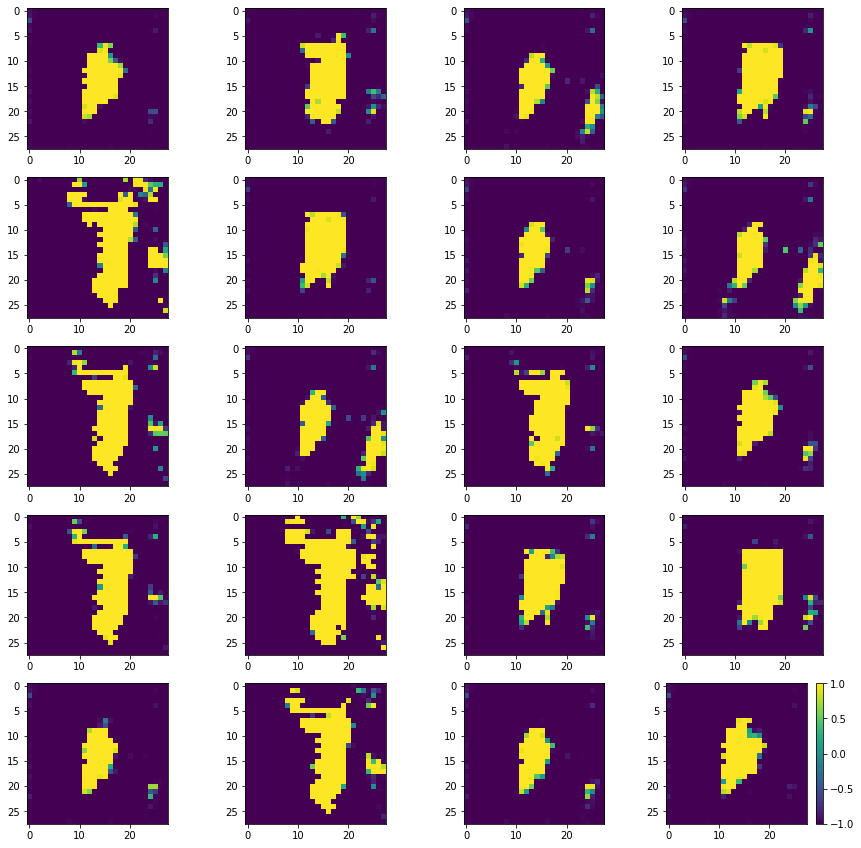

Batch_Num : 182
D_Loss   :   [9.732818603515625, 0.13836675882339478, 9.594451904296875, 0.49609375, 0.072265625] ;    GAN_Loss   :  [10.822649002075195, 0.7602757215499878, 10.062373161315918, 0.0, 0.1015625]
Batch_Num : 183
D_Loss   :   [10.401670455932617, 0.1441337615251541, 10.257536888122559, 0.498046875, 0.072265625] ;    GAN_Loss   :  [11.159027099609375, 0.7524634599685669, 10.406563758850098, 0.0, 0.12109375]
Batch_Num : 184
D_Loss   :   [9.858863830566406, 0.13843275606632233, 9.720431327819824, 0.494140625, 0.095703125] ;    GAN_Loss   :  [10.379093170166016, 0.5991147756576538, 9.77997875213623, 0.0, 0.111328125]
Batch_Num : 185
D_Loss   :   [9.944252014160156, 0.1352045089006424, 9.80904769897461, 0.5, 0.095703125] ;    GAN_Loss   :  [10.717418670654297, 0.6067773103713989, 10.110641479492188, 0.0, 0.142578125]
Batch_Num : 186
D_Loss   :   [9.563027381896973, 0.15861450135707855, 9.404413223266602, 0.5, 0.103515625] ;    GAN_Loss   :  [11.644935607910156, 1.34825575351715

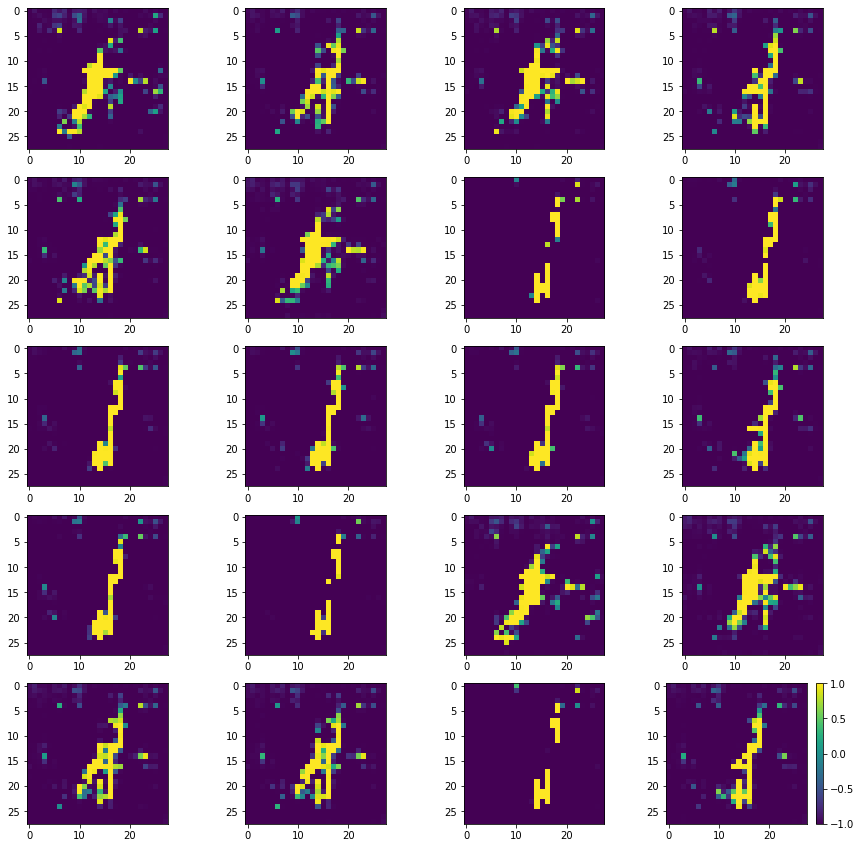

Batch_Num : 197
D_Loss   :   [9.976655960083008, 0.12518803775310516, 9.851468086242676, 0.5, 0.099609375] ;    GAN_Loss   :  [11.258270263671875, 0.9620356559753418, 10.296234130859375, 0.0, 0.107421875]
Batch_Num : 198
D_Loss   :   [9.682049751281738, 0.13098229467868805, 9.551067352294922, 0.5, 0.095703125] ;    GAN_Loss   :  [11.33690071105957, 0.9344457387924194, 10.40245532989502, 0.0, 0.109375]
Batch_Num : 199
D_Loss   :   [10.577220916748047, 0.127371147274971, 10.449850082397461, 0.5, 0.111328125] ;    GAN_Loss   :  [11.21238899230957, 1.1058745384216309, 10.106514930725098, 0.0, 0.126953125]
Batch_Num : 200
D_Loss   :   [10.166093826293945, 0.1324826180934906, 10.033611297607422, 0.5, 0.115234375] ;    GAN_Loss   :  [11.200824737548828, 0.9717248678207397, 10.229100227355957, 0.0, 0.095703125]
Batch_Num : 201
D_Loss   :   [10.405231475830078, 0.13901588320732117, 10.266215324401855, 0.498046875, 0.109375] ;    GAN_Loss   :  [11.704109191894531, 0.8166072368621826, 10.88750171

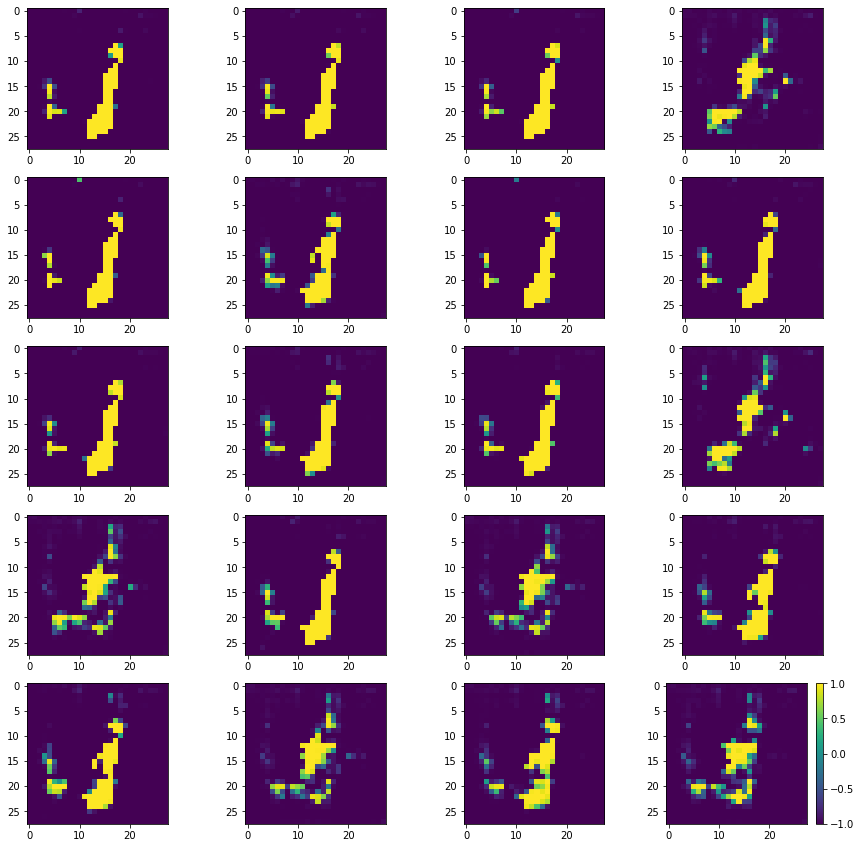

Batch_Num : 212
D_Loss   :   [10.91962718963623, 0.12873362004756927, 10.7908935546875, 0.498046875, 0.1171875] ;    GAN_Loss   :  [10.96005916595459, 0.9770443439483643, 9.983015060424805, 0.0, 0.126953125]
Batch_Num : 213
D_Loss   :   [9.610922813415527, 0.1341390162706375, 9.476783752441406, 0.5, 0.107421875] ;    GAN_Loss   :  [11.313105583190918, 0.8086393475532532, 10.50446605682373, 0.0, 0.16796875]
Batch_Num : 214
D_Loss   :   [10.376592636108398, 0.13578709959983826, 10.240805625915527, 0.5, 0.107421875] ;    GAN_Loss   :  [11.44381332397461, 0.8111079335212708, 10.632705688476562, 0.0, 0.126953125]
Batch_Num : 215
D_Loss   :   [9.21773624420166, 0.1318332552909851, 9.08590316772461, 0.5, 0.12109375] ;    GAN_Loss   :  [11.22970199584961, 0.7165161967277527, 10.513185501098633, 0.0, 0.123046875]
Batch_Num : 216
D_Loss   :   [10.441840171813965, 0.13937464356422424, 10.302465438842773, 0.5, 0.115234375] ;    GAN_Loss   :  [10.544020652770996, 0.7013654112815857, 9.8426551818847

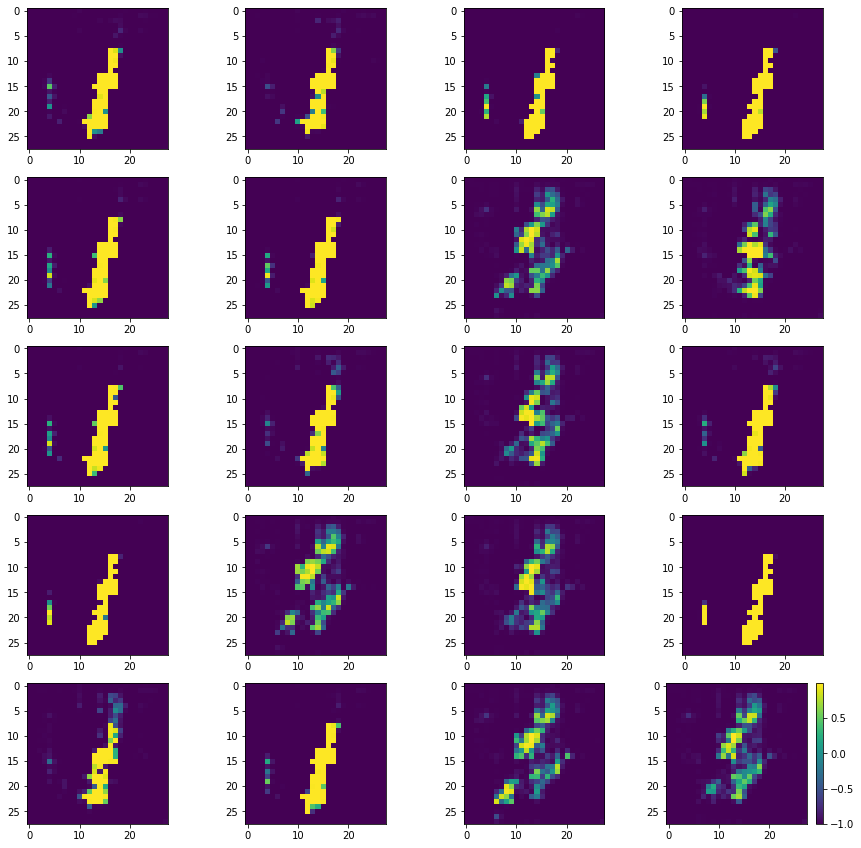

Batch_Num : 227
D_Loss   :   [9.310005187988281, 0.1734485775232315, 9.136556625366211, 0.5, 0.099609375] ;    GAN_Loss   :  [10.87374210357666, 0.8086912631988525, 10.065051078796387, 0.0, 0.115234375]
Batch_Num : 228
D_Loss   :   [10.425204277038574, 0.16903674602508545, 10.2561674118042, 0.49609375, 0.140625] ;    GAN_Loss   :  [10.347787857055664, 0.9297800064086914, 9.418007850646973, 0.0, 0.080078125]
Batch_Num : 229
D_Loss   :   [9.873210906982422, 0.2020011693239212, 9.671209335327148, 0.48046875, 0.091796875] ;    GAN_Loss   :  [10.535757064819336, 0.7019331455230713, 9.833824157714844, 0.0, 0.109375]
Batch_Num : 230
D_Loss   :   [10.141032218933105, 0.15475599467754364, 9.986276626586914, 0.4921875, 0.107421875] ;    GAN_Loss   :  [10.305269241333008, 0.49198248982429504, 9.813286781311035, 0.0, 0.119140625]
Batch_Num : 231
D_Loss   :   [10.361145973205566, 0.1323171854019165, 10.228828430175781, 0.5, 0.107421875] ;    GAN_Loss   :  [10.415094375610352, 0.40432947874069214, 1

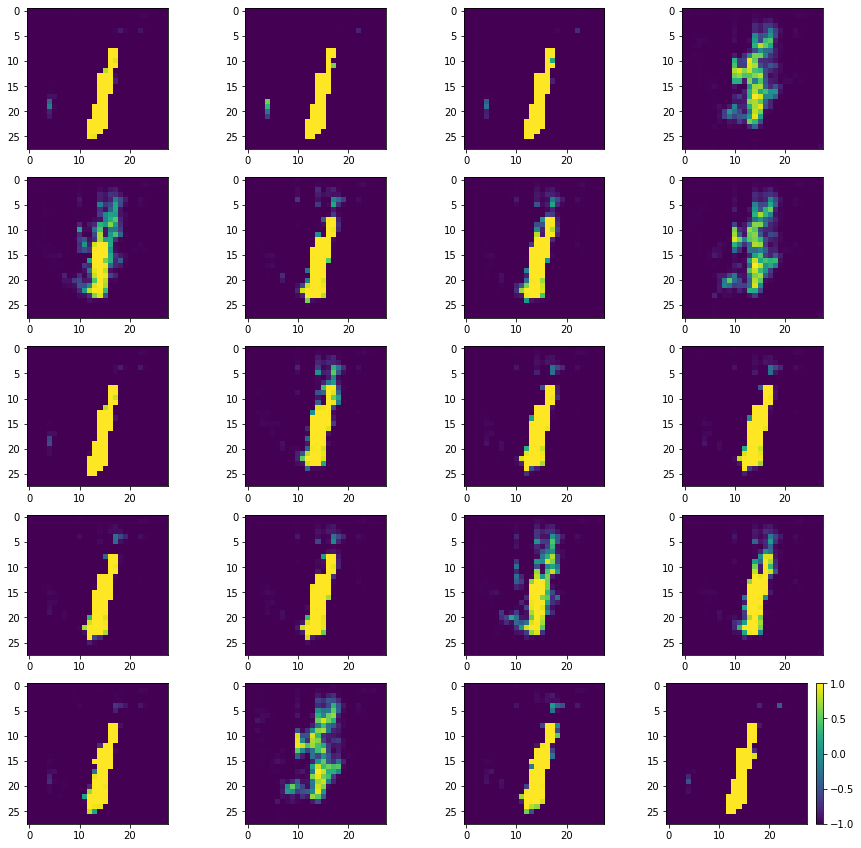

Batch_Num : 2
D_Loss   :   [10.201997756958008, 0.18556126952171326, 10.016436576843262, 0.49609375, 0.10546875] ;    GAN_Loss   :  [10.832147598266602, 0.6016227006912231, 10.230525016784668, 0.0, 0.13671875]
Batch_Num : 3
D_Loss   :   [10.218658447265625, 0.16423191130161285, 10.054426193237305, 0.5, 0.115234375] ;    GAN_Loss   :  [10.92313003540039, 0.6259906888008118, 10.297139167785645, 0.0, 0.1015625]
Batch_Num : 4
D_Loss   :   [10.425313949584961, 0.18171682953834534, 10.243597030639648, 0.49609375, 0.125] ;    GAN_Loss   :  [10.866181373596191, 0.5952683687210083, 10.270913124084473, 0.0, 0.119140625]
Batch_Num : 5
D_Loss   :   [10.323295593261719, 0.23442894220352173, 10.088866233825684, 0.48828125, 0.11328125] ;    GAN_Loss   :  [10.616820335388184, 0.7236058115959167, 9.893214225769043, 0.0, 0.12890625]
Batch_Num : 6
D_Loss   :   [10.56867504119873, 0.20305843651294708, 10.365616798400879, 0.48046875, 0.1015625] ;    GAN_Loss   :  [11.30994701385498, 1.3457365036010742, 9.9

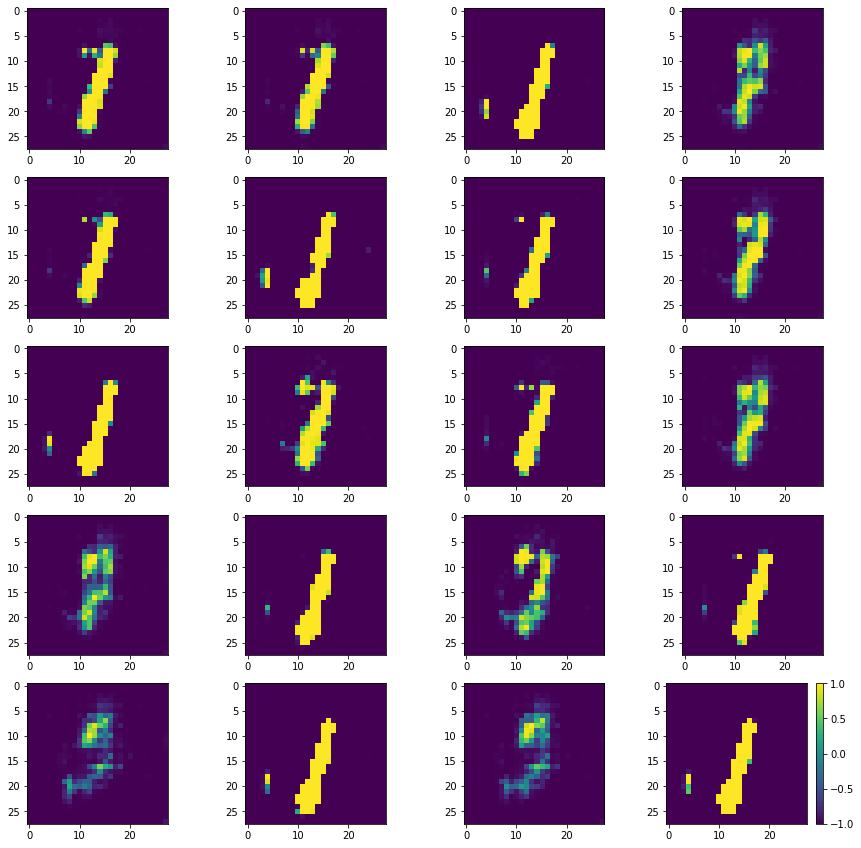

Batch_Num : 17
D_Loss   :   [9.884849548339844, 0.20658732950687408, 9.678261756896973, 0.498046875, 0.138671875] ;    GAN_Loss   :  [13.153437614440918, 2.8625166416168213, 10.290921211242676, 0.0, 0.142578125]
Batch_Num : 18
D_Loss   :   [10.045858383178711, 0.22779662907123566, 9.818061828613281, 0.5, 0.134765625] ;    GAN_Loss   :  [13.251825332641602, 2.9621493816375732, 10.28967571258545, 0.0, 0.12890625]
Batch_Num : 19
D_Loss   :   [10.190879821777344, 0.2937944829463959, 9.897085189819336, 0.482421875, 0.111328125] ;    GAN_Loss   :  [13.472676277160645, 3.0640363693237305, 10.408639907836914, 0.0, 0.1484375]
Batch_Num : 20
D_Loss   :   [10.037678718566895, 0.30461904406547546, 9.733059883117676, 0.498046875, 0.109375] ;    GAN_Loss   :  [12.914375305175781, 2.768878936767578, 10.145496368408203, 0.0, 0.109375]
Batch_Num : 21
D_Loss   :   [9.845621109008789, 0.2772673964500427, 9.568353652954102, 0.494140625, 0.11328125] ;    GAN_Loss   :  [13.013845443725586, 2.730698108673095

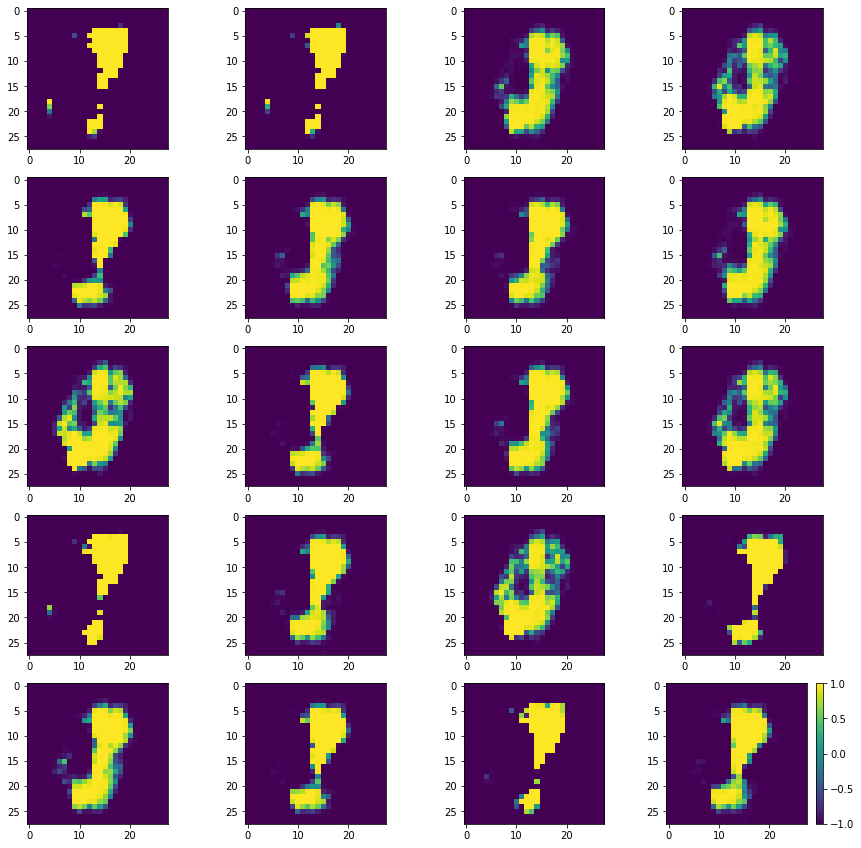

Batch_Num : 32
D_Loss   :   [9.733169555664062, 0.14842866361141205, 9.58474063873291, 0.5, 0.11328125] ;    GAN_Loss   :  [11.845402717590332, 0.5024287104606628, 11.342973709106445, 0.0, 0.111328125]
Batch_Num : 33
D_Loss   :   [10.319023132324219, 0.14318853616714478, 10.175834655761719, 0.498046875, 0.107421875] ;    GAN_Loss   :  [10.914321899414062, 0.5526089668273926, 10.361713409423828, 0.0, 0.119140625]
Batch_Num : 34
D_Loss   :   [10.39339828491211, 0.1648852825164795, 10.22851276397705, 0.5, 0.09375] ;    GAN_Loss   :  [10.620438575744629, 0.42860493063926697, 10.19183349609375, 0.0, 0.138671875]
Batch_Num : 35
D_Loss   :   [9.608088493347168, 0.13321764767169952, 9.474870681762695, 0.49609375, 0.083984375] ;    GAN_Loss   :  [10.637694358825684, 0.48573124408721924, 10.151963233947754, 0.0, 0.109375]
Batch_Num : 36
D_Loss   :   [9.681133270263672, 0.12929029762744904, 9.55184268951416, 0.5, 0.111328125] ;    GAN_Loss   :  [10.684344291687012, 0.5224229693412781, 10.16192150

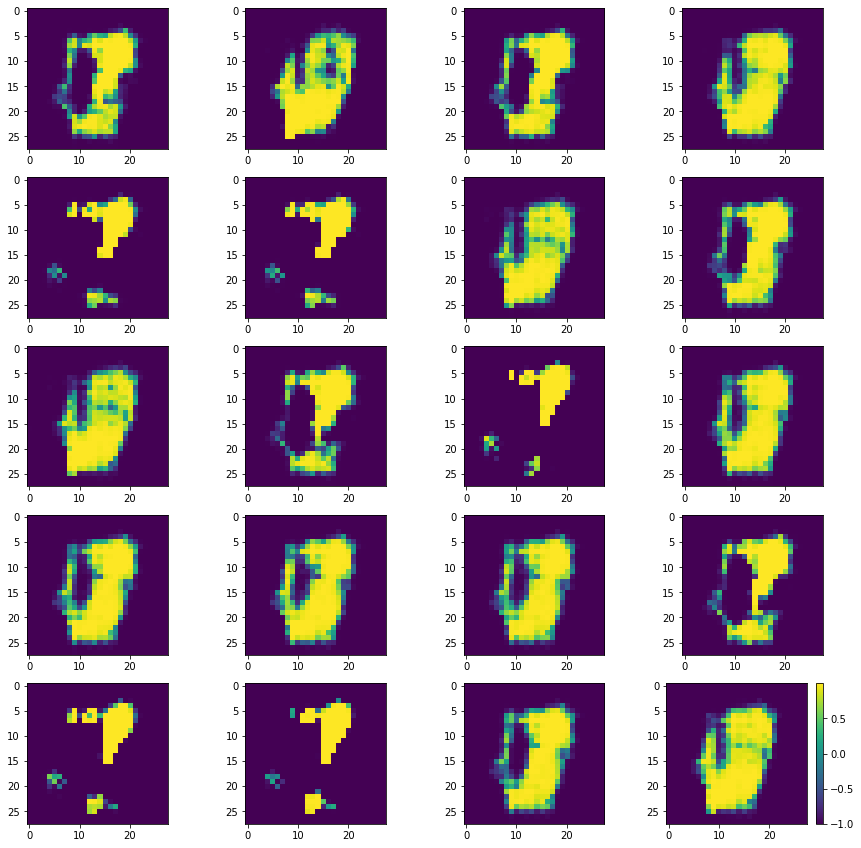

Batch_Num : 47
D_Loss   :   [10.720430374145508, 0.16481301188468933, 10.555617332458496, 0.494140625, 0.109375] ;    GAN_Loss   :  [11.268152236938477, 0.7307171821594238, 10.537434577941895, 0.0, 0.099609375]
Batch_Num : 48
D_Loss   :   [10.186410903930664, 0.18941810727119446, 9.996993064880371, 0.486328125, 0.0859375] ;    GAN_Loss   :  [13.217883110046387, 1.9092494249343872, 11.308633804321289, 0.0, 0.11328125]
Batch_Num : 49
D_Loss   :   [10.269327163696289, 0.2994573712348938, 9.969869613647461, 0.4375, 0.10546875] ;    GAN_Loss   :  [10.483566284179688, 0.7216618657112122, 9.7619047164917, 0.0, 0.119140625]
Batch_Num : 50
D_Loss   :   [9.92600154876709, 0.2709497809410095, 9.655052185058594, 0.490234375, 0.103515625] ;    GAN_Loss   :  [11.160894393920898, 0.7709255218505859, 10.389968872070312, 0.0, 0.12109375]
Batch_Num : 51
D_Loss   :   [10.505483627319336, 0.23496372997760773, 10.270520210266113, 0.494140625, 0.103515625] ;    GAN_Loss   :  [12.835357666015625, 2.186752080

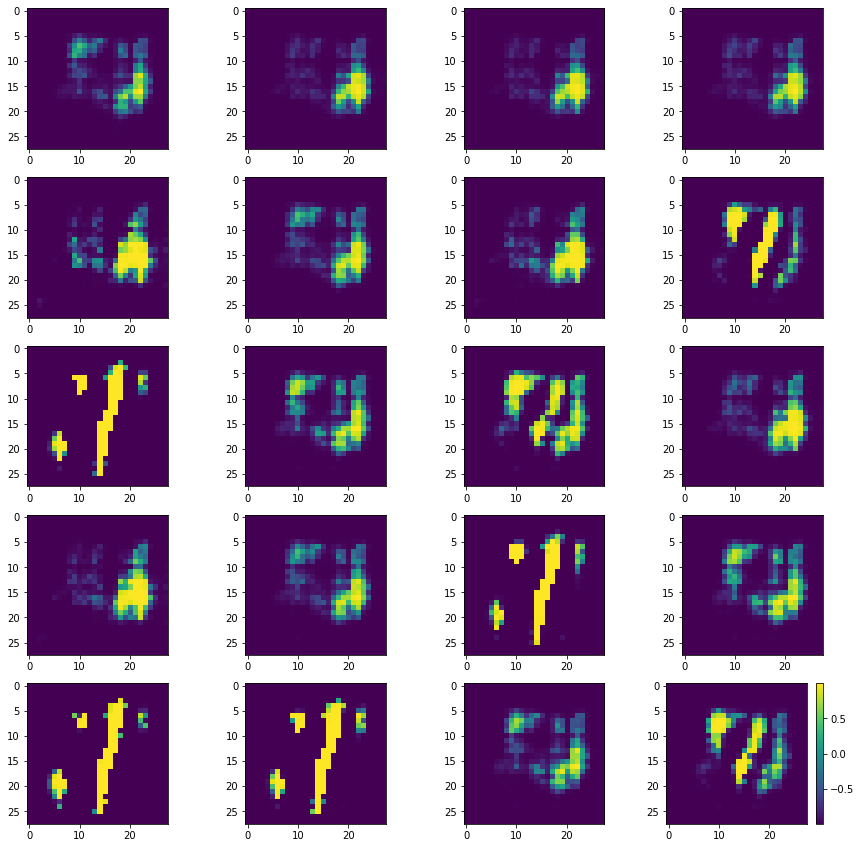

Batch_Num : 62
D_Loss   :   [10.032696723937988, 0.39102107286453247, 9.64167594909668, 0.224609375, 0.0859375] ;    GAN_Loss   :  [11.35686206817627, 1.4519128799438477, 9.904949188232422, 0.0, 0.109375]
Batch_Num : 63
D_Loss   :   [10.282129287719727, 0.3781873285770416, 9.903942108154297, 0.234375, 0.107421875] ;    GAN_Loss   :  [11.446077346801758, 1.4404394626617432, 10.005638122558594, 0.0, 0.0703125]
Batch_Num : 64
D_Loss   :   [10.27849006652832, 0.3953782916069031, 9.883111953735352, 0.244140625, 0.125] ;    GAN_Loss   :  [12.203160285949707, 1.5992757081985474, 10.60388469696045, 0.0, 0.0703125]
Batch_Num : 65
D_Loss   :   [10.395291328430176, 0.378094345331192, 10.017196655273438, 0.240234375, 0.091796875] ;    GAN_Loss   :  [12.35634708404541, 1.6044703722000122, 10.751876831054688, 0.0, 0.072265625]
Batch_Num : 66
D_Loss   :   [11.051069259643555, 0.39380767941474915, 10.657261848449707, 0.291015625, 0.109375] ;    GAN_Loss   :  [12.682036399841309, 1.6861246824264526, 10

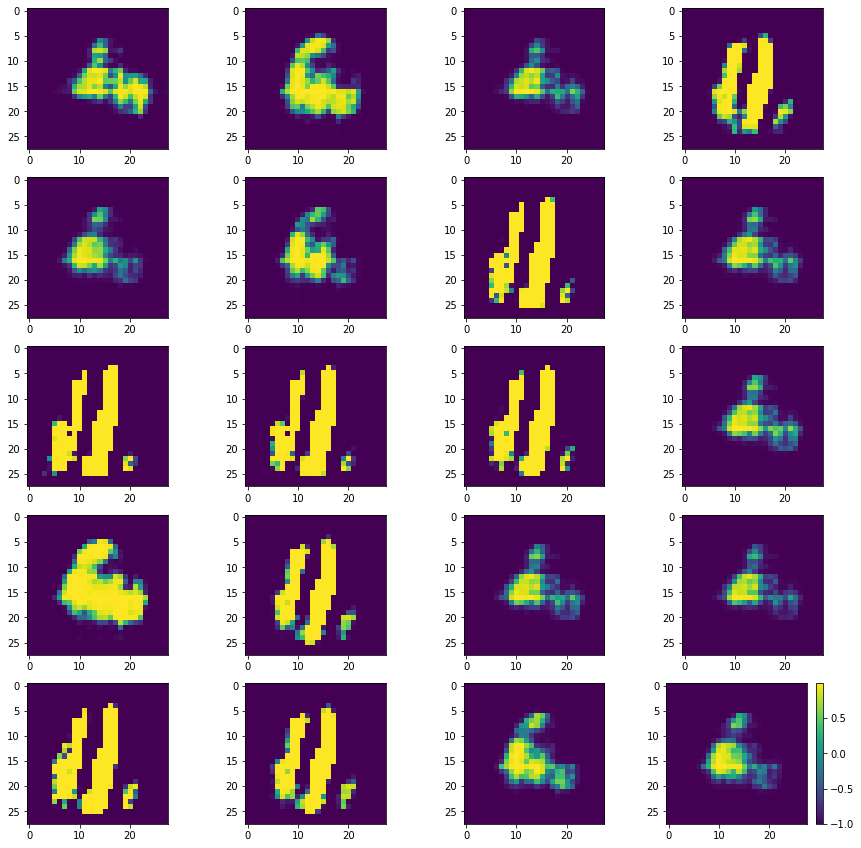

Batch_Num : 77
D_Loss   :   [10.266079902648926, 0.27667662501335144, 9.98940372467041, 0.494140625, 0.068359375] ;    GAN_Loss   :  [12.895081520080566, 1.4407341480255127, 11.454347610473633, 0.0, 0.06640625]
Batch_Num : 78
D_Loss   :   [9.856977462768555, 0.2612592279911041, 9.595718383789062, 0.490234375, 0.0859375] ;    GAN_Loss   :  [12.180368423461914, 1.4841686487197876, 10.696199417114258, 0.0, 0.06640625]
Batch_Num : 79
D_Loss   :   [10.635539054870605, 0.2556430399417877, 10.37989616394043, 0.494140625, 0.0625] ;    GAN_Loss   :  [12.491384506225586, 1.536271572113037, 10.955113410949707, 0.0, 0.0859375]
Batch_Num : 80
D_Loss   :   [10.149906158447266, 0.2373565137386322, 9.91254997253418, 0.5, 0.06640625] ;    GAN_Loss   :  [12.626055717468262, 1.786325454711914, 10.839730262756348, 0.0, 0.064453125]
Batch_Num : 81
D_Loss   :   [10.363067626953125, 0.21846206486225128, 10.14460563659668, 0.5, 0.072265625] ;    GAN_Loss   :  [12.539344787597656, 1.7074462175369263, 10.831898

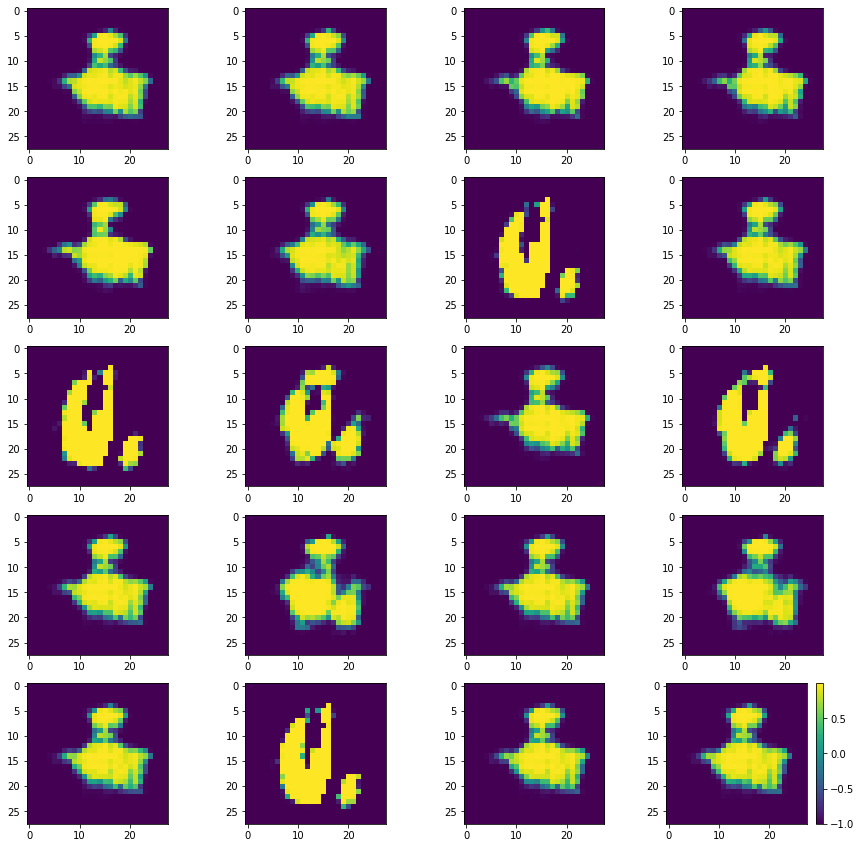

Batch_Num : 92
D_Loss   :   [10.22364616394043, 0.1783449649810791, 10.04530143737793, 0.5, 0.083984375] ;    GAN_Loss   :  [13.147699356079102, 1.7766895294189453, 11.371009826660156, 0.0, 0.076171875]
Batch_Num : 93
D_Loss   :   [10.622832298278809, 0.156685471534729, 10.466146469116211, 0.5, 0.078125] ;    GAN_Loss   :  [12.725472450256348, 1.9498811960220337, 10.775590896606445, 0.0, 0.06640625]
Batch_Num : 94
D_Loss   :   [10.038837432861328, 0.1536351591348648, 9.885202407836914, 0.5, 0.080078125] ;    GAN_Loss   :  [13.616602897644043, 2.147433042526245, 11.469169616699219, 0.0, 0.05078125]
Batch_Num : 95
D_Loss   :   [10.22222900390625, 0.14796733856201172, 10.074261665344238, 0.5, 0.08203125] ;    GAN_Loss   :  [13.306795120239258, 2.1574349403381348, 11.149360656738281, 0.0, 0.048828125]
Batch_Num : 96
D_Loss   :   [9.786327362060547, 0.15449728071689606, 9.631830215454102, 0.5, 0.109375] ;    GAN_Loss   :  [13.15766716003418, 1.9772224426269531, 11.180444717407227, 0.0, 0.06

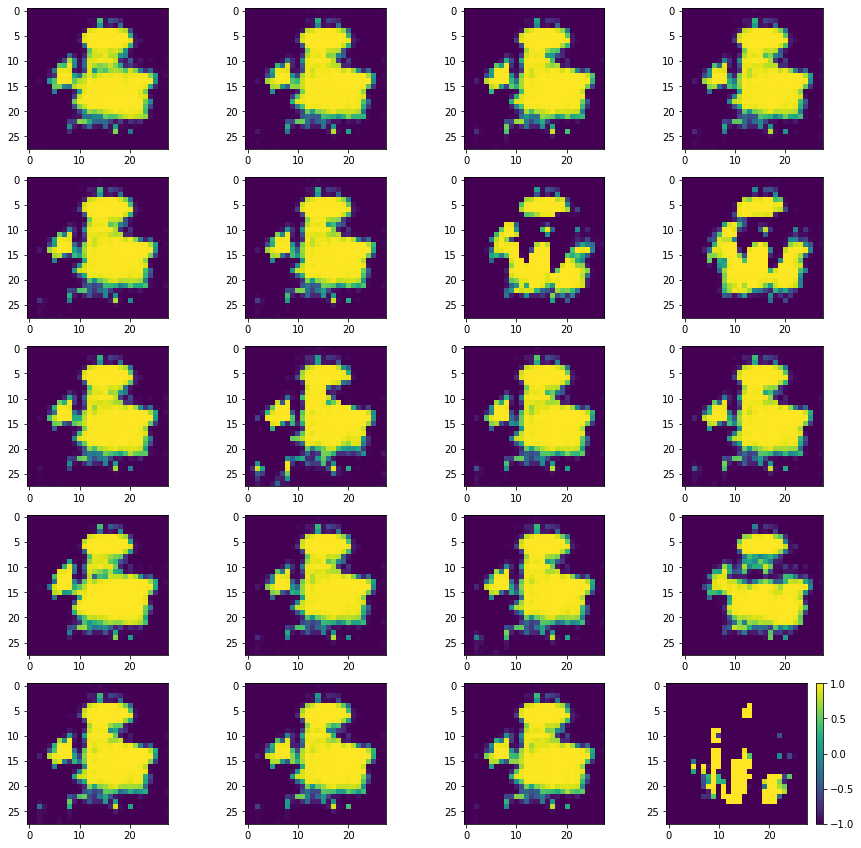

Batch_Num : 107
D_Loss   :   [10.081488609313965, 0.18247592449188232, 9.899012565612793, 0.5, 0.099609375] ;    GAN_Loss   :  [16.539276123046875, 4.431685447692871, 12.107590675354004, 0.0, 0.08984375]
Batch_Num : 108
D_Loss   :   [9.4828519821167, 0.1580810695886612, 9.3247709274292, 0.498046875, 0.083984375] ;    GAN_Loss   :  [17.75636100769043, 4.090520858764648, 13.665840148925781, 0.0, 0.04296875]
Batch_Num : 109
D_Loss   :   [9.722414016723633, 0.19333037734031677, 9.529083251953125, 0.4921875, 0.083984375] ;    GAN_Loss   :  [18.31634521484375, 4.8174638748168945, 13.498880386352539, 0.0, 0.083984375]
Batch_Num : 110
D_Loss   :   [10.583605766296387, 0.25611791014671326, 10.32748794555664, 0.49609375, 0.076171875] ;    GAN_Loss   :  [14.746543884277344, 2.6048150062561035, 12.141729354858398, 0.0, 0.080078125]
Batch_Num : 111
D_Loss   :   [10.040559768676758, 0.5270921587944031, 9.513467788696289, 0.306640625, 0.099609375] ;    GAN_Loss   :  [15.93857479095459, 3.632319688796

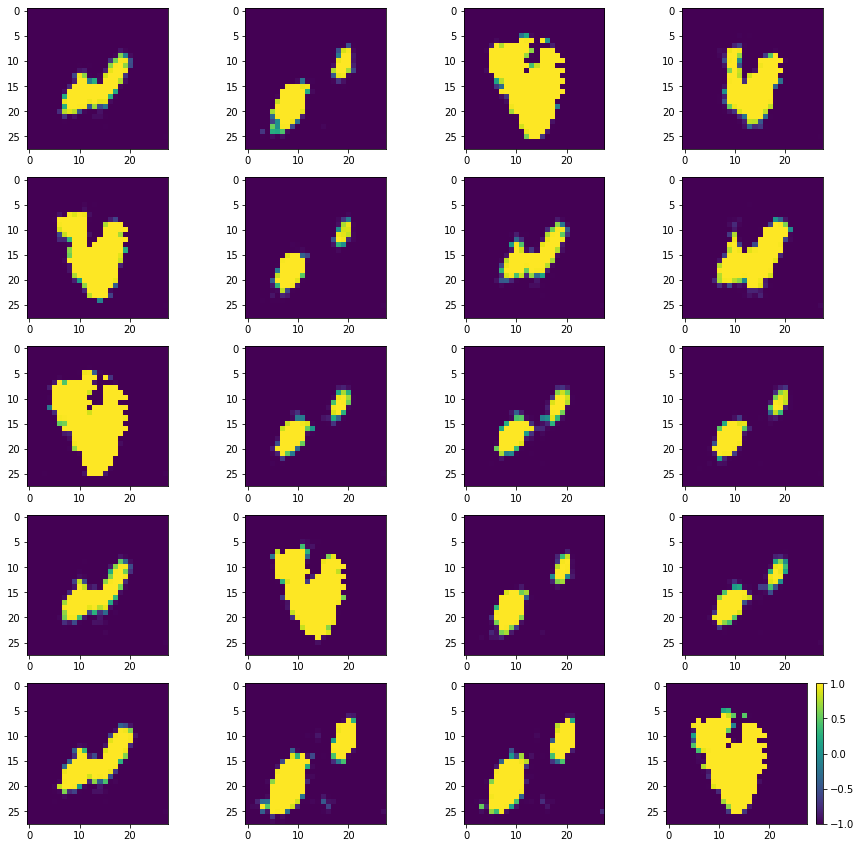

Batch_Num : 122
D_Loss   :   [10.853269577026367, 0.32173970341682434, 10.531529426574707, 0.494140625, 0.078125] ;    GAN_Loss   :  [16.516721725463867, 4.149580478668213, 12.367141723632812, 0.0, 0.078125]
Batch_Num : 123
D_Loss   :   [10.140583038330078, 0.3399023115634918, 9.800681114196777, 0.423828125, 0.080078125] ;    GAN_Loss   :  [16.7285099029541, 3.8986668586730957, 12.829843521118164, 0.0, 0.083984375]
Batch_Num : 124
D_Loss   :   [10.46231746673584, 0.31423288583755493, 10.14808464050293, 0.478515625, 0.083984375] ;    GAN_Loss   :  [17.663415908813477, 4.750526428222656, 12.91288948059082, 0.0, 0.115234375]
Batch_Num : 125
D_Loss   :   [10.551767349243164, 0.23195023834705353, 10.319817543029785, 0.5, 0.087890625] ;    GAN_Loss   :  [19.79132652282715, 5.290336608886719, 14.50098991394043, 0.0, 0.080078125]
Batch_Num : 126
D_Loss   :   [10.513312339782715, 0.21988826990127563, 10.293423652648926, 0.498046875, 0.07421875] ;    GAN_Loss   :  [18.451311111450195, 5.08449888

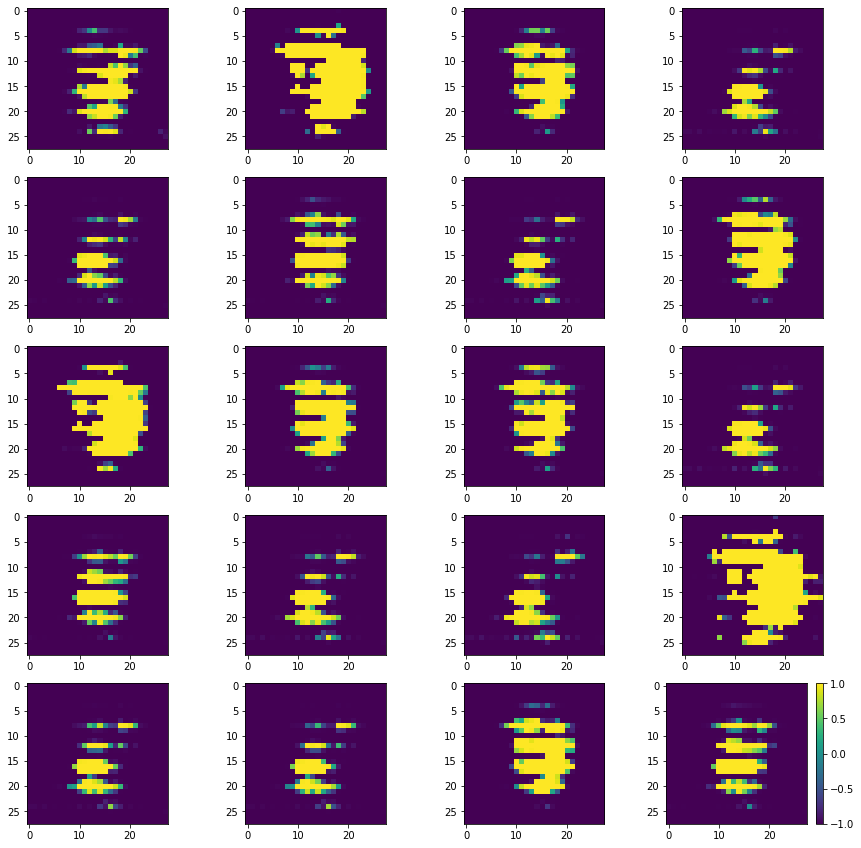

Batch_Num : 137
D_Loss   :   [10.851813316345215, 0.19862304627895355, 10.653190612792969, 0.494140625, 0.12109375] ;    GAN_Loss   :  [22.519399642944336, 10.529407501220703, 11.989992141723633, 0.0, 0.12109375]
Batch_Num : 138
D_Loss   :   [10.087031364440918, 0.16908133029937744, 9.917949676513672, 0.498046875, 0.125] ;    GAN_Loss   :  [22.946189880371094, 10.191362380981445, 12.754827499389648, 0.0, 0.11328125]
Batch_Num : 139
D_Loss   :   [10.00472640991211, 0.18047282099723816, 9.824254035949707, 0.498046875, 0.138671875] ;    GAN_Loss   :  [23.680206298828125, 10.966915130615234, 12.71329116821289, 0.0, 0.099609375]
Batch_Num : 140
D_Loss   :   [9.560714721679688, 0.15645086765289307, 9.404263496398926, 0.5, 0.12109375] ;    GAN_Loss   :  [23.753829956054688, 11.074966430664062, 12.678862571716309, 0.0, 0.109375]
Batch_Num : 141
D_Loss   :   [10.128219604492188, 0.1503233015537262, 9.977896690368652, 0.5, 0.099609375] ;    GAN_Loss   :  [24.667245864868164, 11.64195442199707, 1

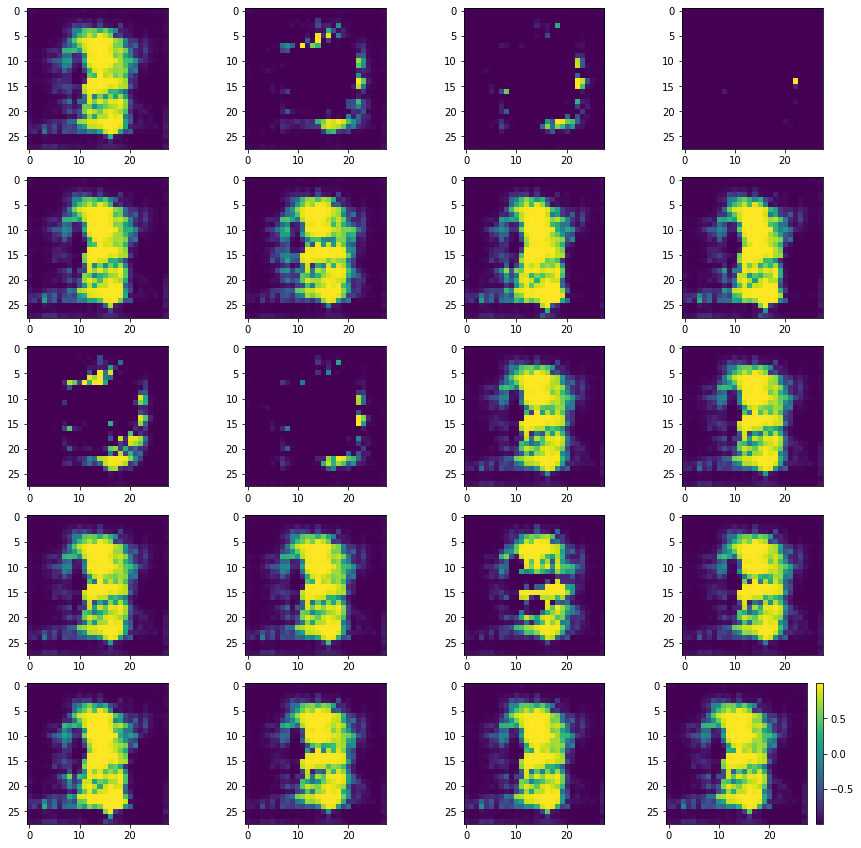

Batch_Num : 152
D_Loss   :   [9.842752456665039, 0.15485188364982605, 9.68790054321289, 0.49609375, 0.1328125] ;    GAN_Loss   :  [12.542377471923828, 2.131815195083618, 10.410562515258789, 0.0, 0.1171875]
Batch_Num : 153
D_Loss   :   [10.105256080627441, 0.16071927547454834, 9.944537162780762, 0.4921875, 0.126953125] ;    GAN_Loss   :  [12.018209457397461, 1.6531928777694702, 10.36501693725586, 0.0, 0.09765625]
Batch_Num : 154
D_Loss   :   [10.093292236328125, 0.17001362144947052, 9.92327880859375, 0.5, 0.1328125] ;    GAN_Loss   :  [12.246389389038086, 1.9477670192718506, 10.298622131347656, 0.0, 0.126953125]
Batch_Num : 155
D_Loss   :   [10.439459800720215, 0.1760280728340149, 10.263431549072266, 0.5, 0.126953125] ;    GAN_Loss   :  [11.83366870880127, 1.8844834566116333, 9.949185371398926, 0.0, 0.150390625]
Batch_Num : 156
D_Loss   :   [9.535669326782227, 0.14583587646484375, 9.389833450317383, 0.5, 0.130859375] ;    GAN_Loss   :  [12.68851089477539, 1.8842310905456543, 10.80427932

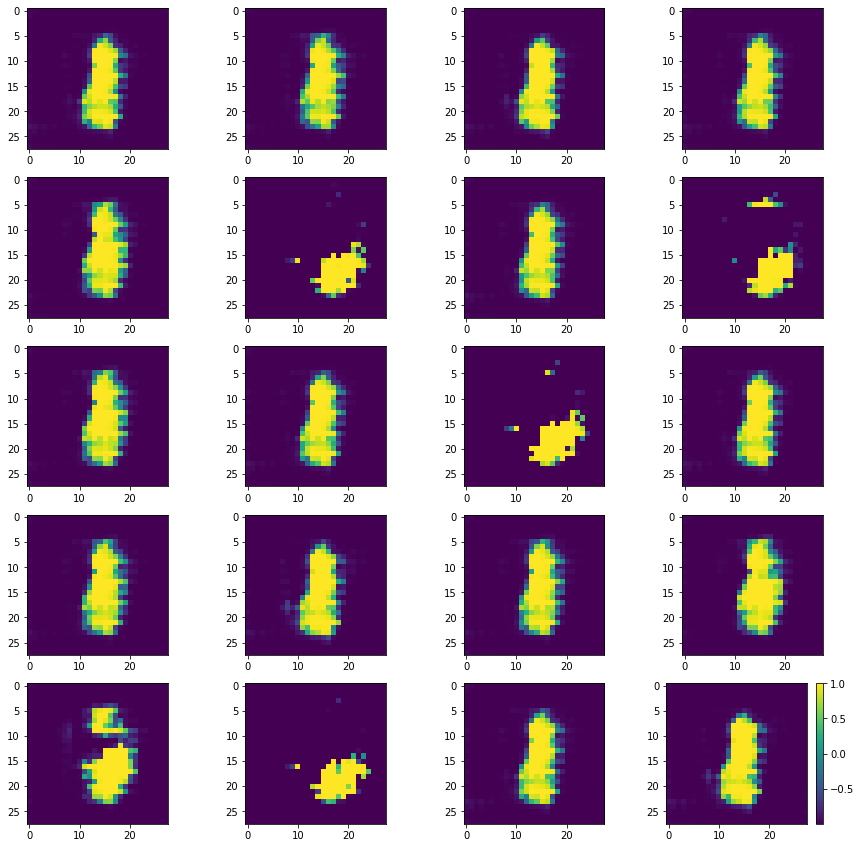

Batch_Num : 167
D_Loss   :   [10.731874465942383, 0.31798118352890015, 10.413893699645996, 0.498046875, 0.130859375] ;    GAN_Loss   :  [30.113248825073242, 8.858768463134766, 21.254480361938477, 0.0, 0.16796875]
Batch_Num : 168
D_Loss   :   [9.899582862854004, 0.3998124599456787, 9.499770164489746, 0.439453125, 0.076171875] ;    GAN_Loss   :  [29.853763580322266, 13.24086856842041, 16.612895965576172, 0.0, 0.142578125]
Batch_Num : 169
D_Loss   :   [10.349945068359375, 0.27618175745010376, 10.073762893676758, 0.5, 0.140625] ;    GAN_Loss   :  [28.68036651611328, 12.026566505432129, 16.65380096435547, 0.0, 0.1640625]
Batch_Num : 170
D_Loss   :   [10.223361015319824, 0.25255298614501953, 9.970808029174805, 0.4921875, 0.115234375] ;    GAN_Loss   :  [27.35590362548828, 11.368058204650879, 15.987846374511719, 0.0, 0.142578125]
Batch_Num : 171
D_Loss   :   [10.737948417663574, 0.43611544370651245, 10.301833152770996, 0.416015625, 0.095703125] ;    GAN_Loss   :  [28.926498413085938, 12.83487

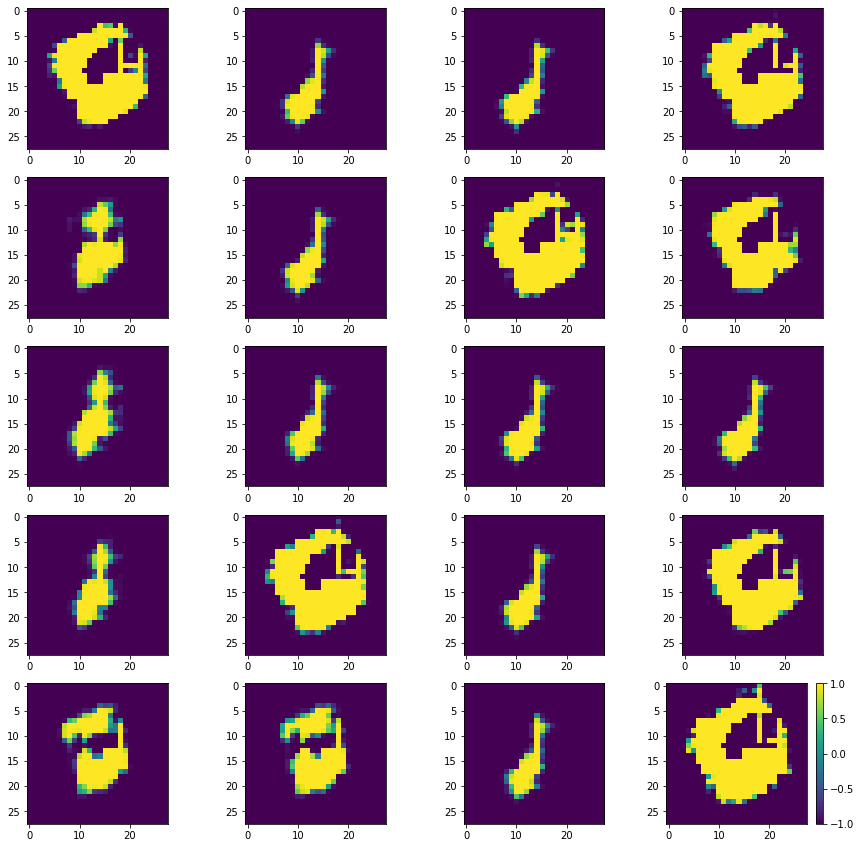

Batch_Num : 182
D_Loss   :   [9.826537132263184, 0.22232064604759216, 9.604216575622559, 0.5, 0.103515625] ;    GAN_Loss   :  [18.86322784423828, 6.812811851501465, 12.050415992736816, 0.0, 0.068359375]
Batch_Num : 183
D_Loss   :   [10.443282127380371, 0.20635384321212769, 10.23692798614502, 0.494140625, 0.111328125] ;    GAN_Loss   :  [19.29164695739746, 6.919112682342529, 12.37253475189209, 0.0, 0.08203125]
Batch_Num : 184
D_Loss   :   [9.919198036193848, 0.19588446617126465, 9.723313331604004, 0.498046875, 0.103515625] ;    GAN_Loss   :  [17.992965698242188, 6.7367143630981445, 11.256250381469727, 0.0, 0.0859375]
Batch_Num : 185
D_Loss   :   [9.987696647644043, 0.19375789165496826, 9.793938636779785, 0.5, 0.0859375] ;    GAN_Loss   :  [18.24662971496582, 6.61113977432251, 11.635490417480469, 0.0, 0.083984375]
Batch_Num : 186
D_Loss   :   [9.60584545135498, 0.2212723195552826, 9.384572982788086, 0.4921875, 0.08203125] ;    GAN_Loss   :  [18.25767707824707, 6.637670516967773, 11.62000

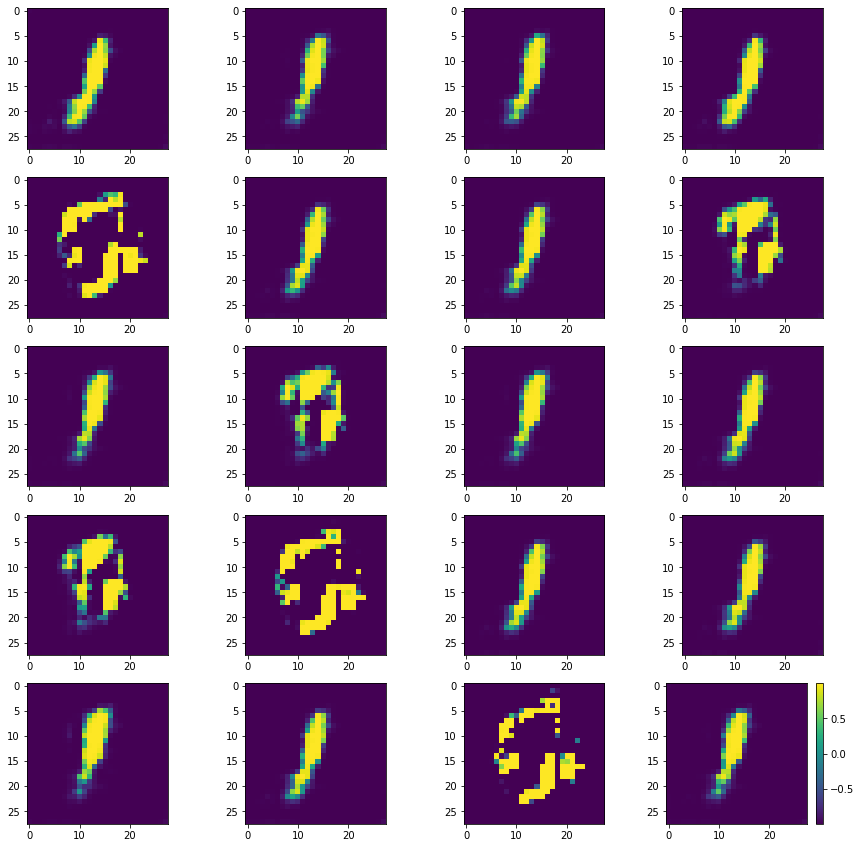

Batch_Num : 197
D_Loss   :   [10.0164794921875, 0.17220565676689148, 9.844273567199707, 0.5, 0.07421875] ;    GAN_Loss   :  [15.364018440246582, 4.393643379211426, 10.970375061035156, 0.0, 0.115234375]
Batch_Num : 198
D_Loss   :   [9.744060516357422, 0.19006213545799255, 9.553997993469238, 0.5, 0.083984375] ;    GAN_Loss   :  [15.192975997924805, 4.209951400756836, 10.983024597167969, 0.0, 0.06640625]
Batch_Num : 199
D_Loss   :   [10.63170337677002, 0.1879817694425583, 10.443721771240234, 0.5, 0.09375] ;    GAN_Loss   :  [16.13345718383789, 4.918390274047852, 11.215066909790039, 0.0, 0.115234375]
Batch_Num : 200
D_Loss   :   [10.195623397827148, 0.1665467619895935, 10.02907657623291, 0.5, 0.0859375] ;    GAN_Loss   :  [15.25883674621582, 4.473931789398193, 10.784904479980469, 0.0, 0.10546875]
Batch_Num : 201
D_Loss   :   [10.439566612243652, 0.17089222371578217, 10.268674850463867, 0.5, 0.091796875] ;    GAN_Loss   :  [15.427206039428711, 4.342001438140869, 11.085205078125, 0.0, 0.0839

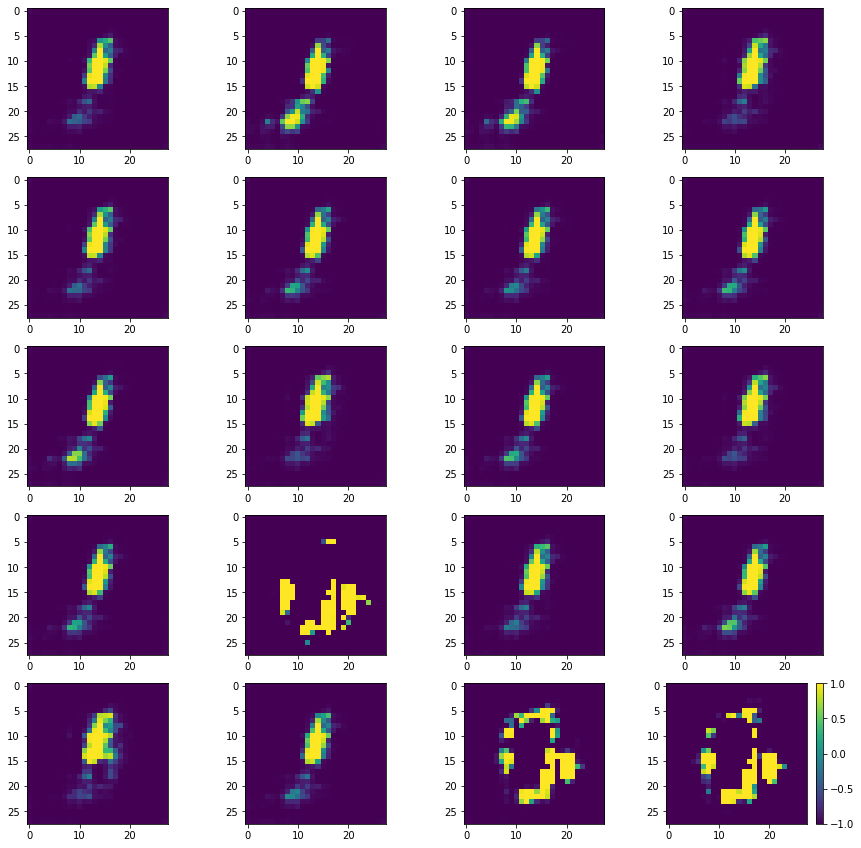

Batch_Num : 212
D_Loss   :   [10.942818641662598, 0.15133611857891083, 10.791482925415039, 0.5, 0.080078125] ;    GAN_Loss   :  [16.75543212890625, 5.7096967697143555, 11.045735359191895, 0.0, 0.109375]
Batch_Num : 213
D_Loss   :   [9.631047248840332, 0.15966221690177917, 9.47138500213623, 0.5, 0.08203125] ;    GAN_Loss   :  [18.222970962524414, 6.101576328277588, 12.121394157409668, 0.0, 0.08984375]
Batch_Num : 214
D_Loss   :   [10.405187606811523, 0.16866302490234375, 10.23652458190918, 0.5, 0.078125] ;    GAN_Loss   :  [17.351886749267578, 6.226441383361816, 11.125444412231445, 0.0, 0.099609375]
Batch_Num : 215
D_Loss   :   [9.260377883911133, 0.16525235772132874, 9.095125198364258, 0.498046875, 0.099609375] ;    GAN_Loss   :  [17.564022064208984, 6.263428688049316, 11.300593376159668, 0.0, 0.1015625]
Batch_Num : 216
D_Loss   :   [10.484514236450195, 0.18539460003376007, 10.29911994934082, 0.49609375, 0.083984375] ;    GAN_Loss   :  [16.539730072021484, 5.725926399230957, 10.8138027

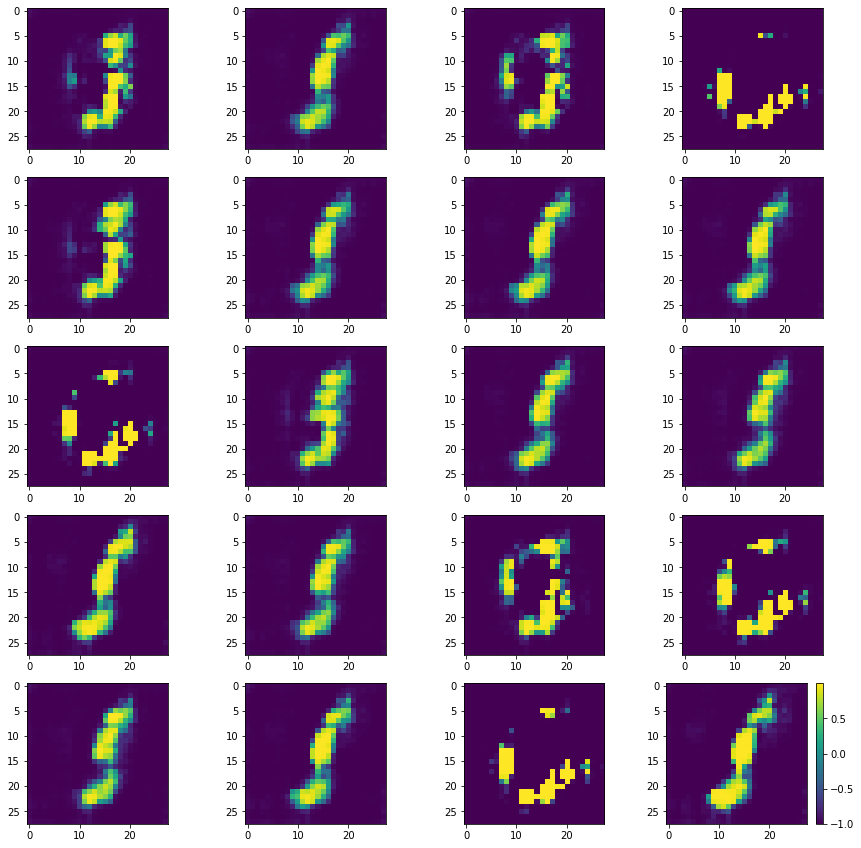

Batch_Num : 227
D_Loss   :   [9.318474769592285, 0.17223989963531494, 9.146234512329102, 0.498046875, 0.076171875] ;    GAN_Loss   :  [15.005741119384766, 3.790323257446289, 11.215417861938477, 0.0, 0.103515625]
Batch_Num : 228
D_Loss   :   [10.405055046081543, 0.15842393040657043, 10.246630668640137, 0.5, 0.123046875] ;    GAN_Loss   :  [14.824663162231445, 3.795738458633423, 11.028924942016602, 0.0, 0.087890625]
Batch_Num : 229
D_Loss   :   [9.880919456481934, 0.22548381984233856, 9.655435562133789, 0.466796875, 0.109375] ;    GAN_Loss   :  [13.433878898620605, 2.8897323608398438, 10.544146537780762, 0.0, 0.07421875]
Batch_Num : 230
D_Loss   :   [10.195846557617188, 0.21222805976867676, 9.98361873626709, 0.490234375, 0.08984375] ;    GAN_Loss   :  [14.17125415802002, 3.6764955520629883, 10.494758605957031, 0.0, 0.091796875]
Batch_Num : 231
D_Loss   :   [10.442930221557617, 0.20691688358783722, 10.236013412475586, 0.5, 0.078125] ;    GAN_Loss   :  [13.527177810668945, 2.88280630111694

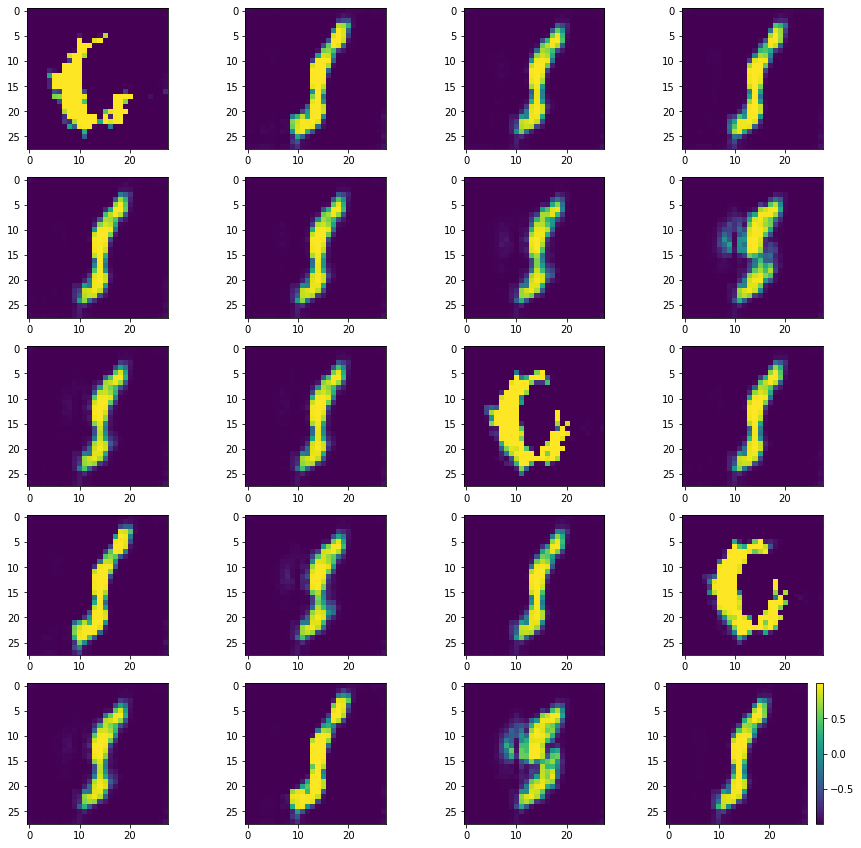

Batch_Num : 2
D_Loss   :   [10.317383766174316, 0.29050880670547485, 10.026874542236328, 0.455078125, 0.0703125] ;    GAN_Loss   :  [13.81412124633789, 2.8065173625946045, 11.007603645324707, 0.0, 0.05859375]
Batch_Num : 3
D_Loss   :   [10.304269790649414, 0.2520252764225006, 10.052244186401367, 0.46875, 0.072265625] ;    GAN_Loss   :  [14.229942321777344, 2.798034191131592, 11.43190860748291, 0.0, 0.033203125]
Batch_Num : 4
D_Loss   :   [10.505152702331543, 0.24640044569969177, 10.25875186920166, 0.470703125, 0.083984375] ;    GAN_Loss   :  [14.346978187561035, 2.8926265239715576, 11.454351425170898, 0.0, 0.0703125]
Batch_Num : 5
D_Loss   :   [10.336233139038086, 0.2592484652996063, 10.076984405517578, 0.451171875, 0.0703125] ;    GAN_Loss   :  [15.438464164733887, 3.2967841625213623, 12.141679763793945, 0.0, 0.056640625]
Batch_Num : 6
D_Loss   :   [10.613815307617188, 0.24786199629306793, 10.36595344543457, 0.4609375, 0.056640625] ;    GAN_Loss   :  [16.04401397705078, 4.026451587677

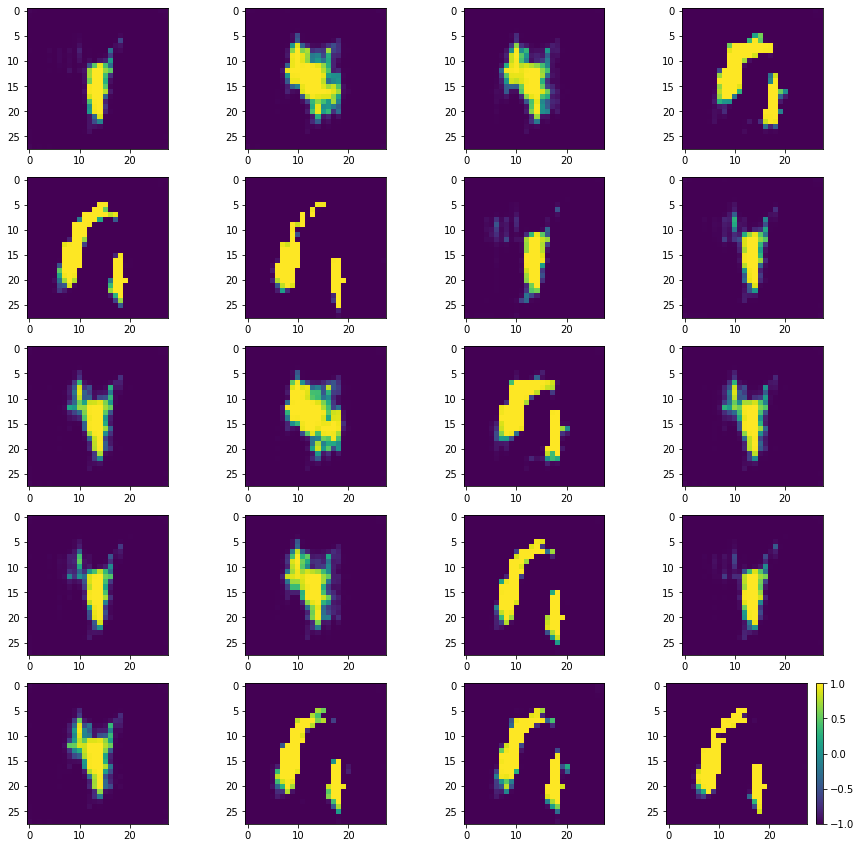

Batch_Num : 17
D_Loss   :   [9.886076927185059, 0.22080259025096893, 9.665274620056152, 0.498046875, 0.078125] ;    GAN_Loss   :  [19.762922286987305, 7.157255172729492, 12.605667114257812, 0.0, 0.0625]
Batch_Num : 18
D_Loss   :   [10.091136932373047, 0.2684921622276306, 9.82264518737793, 0.49609375, 0.095703125] ;    GAN_Loss   :  [19.859107971191406, 6.8524370193481445, 13.006670951843262, 0.0, 0.068359375]
Batch_Num : 19
D_Loss   :   [10.268535614013672, 0.36239543557167053, 9.906140327453613, 0.470703125, 0.083984375] ;    GAN_Loss   :  [19.5693302154541, 6.498140335083008, 13.071189880371094, 0.0, 0.05859375]
Batch_Num : 20
D_Loss   :   [10.279300689697266, 0.4577730596065521, 9.821527481079102, 0.478515625, 0.107421875] ;    GAN_Loss   :  [15.055428504943848, 3.545504570007324, 11.509923934936523, 0.0, 0.03515625]
Batch_Num : 21
D_Loss   :   [10.015032768249512, 0.4383493959903717, 9.576683044433594, 0.408203125, 0.0625] ;    GAN_Loss   :  [15.408134460449219, 3.634507417678833, 

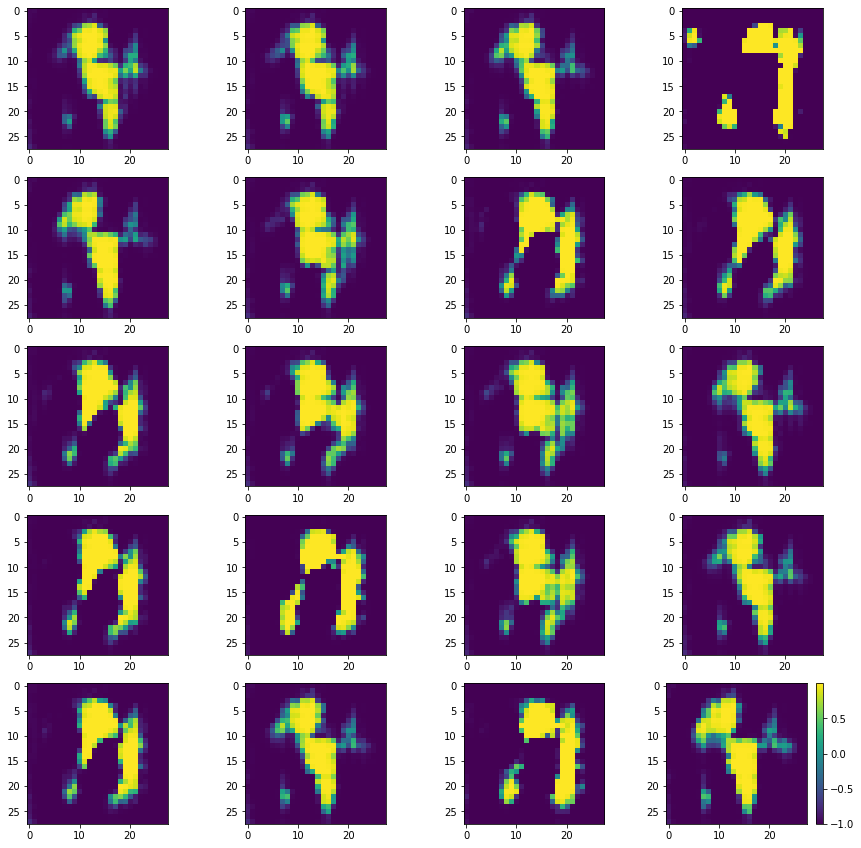

Batch_Num : 32
D_Loss   :   [9.904511451721191, 0.29602691531181335, 9.608484268188477, 0.48046875, 0.07421875] ;    GAN_Loss   :  [14.615229606628418, 3.369149923324585, 11.246079444885254, 0.0, 0.107421875]
Batch_Num : 33
D_Loss   :   [10.43232250213623, 0.2600574195384979, 10.17226505279541, 0.486328125, 0.07421875] ;    GAN_Loss   :  [14.418741226196289, 3.4661736488342285, 10.952568054199219, 0.0, 0.103515625]
Batch_Num : 34
D_Loss   :   [10.744510650634766, 0.4338212013244629, 10.310688972473145, 0.462890625, 0.103515625] ;    GAN_Loss   :  [14.204424858093262, 3.0977296829223633, 11.106695175170898, 0.0, 0.07421875]
Batch_Num : 35
D_Loss   :   [9.792842864990234, 0.3125807046890259, 9.48026180267334, 0.45703125, 0.080078125] ;    GAN_Loss   :  [15.724367141723633, 3.9431746006011963, 11.781192779541016, 0.0, 0.08203125]
Batch_Num : 36
D_Loss   :   [9.86011028289795, 0.28797656297683716, 9.572134017944336, 0.498046875, 0.09375] ;    GAN_Loss   :  [15.985252380371094, 3.5941839218

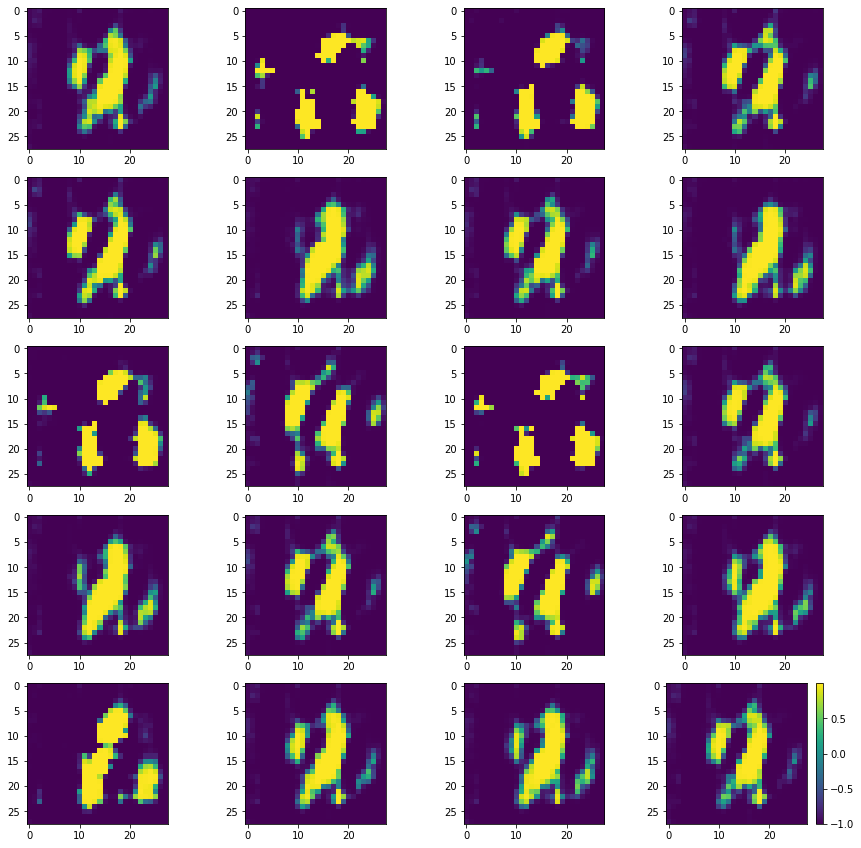

Batch_Num : 47
D_Loss   :   [11.155922889709473, 0.5955702066421509, 10.560352325439453, 0.14453125, 0.091796875] ;    GAN_Loss   :  [11.738459587097168, 1.353901982307434, 10.384557723999023, 0.0, 0.0859375]
Batch_Num : 48
D_Loss   :   [10.56289291381836, 0.5730339288711548, 9.989858627319336, 0.125, 0.078125] ;    GAN_Loss   :  [11.583399772644043, 1.3125889301300049, 10.270811080932617, 0.0, 0.111328125]
Batch_Num : 49
D_Loss   :   [10.449493408203125, 0.5343614220619202, 9.915131568908691, 0.138671875, 0.083984375] ;    GAN_Loss   :  [11.597066879272461, 1.2329691648483276, 10.364097595214844, 0.0, 0.091796875]
Batch_Num : 50
D_Loss   :   [10.106931686401367, 0.4757649600505829, 9.631166458129883, 0.1640625, 0.10546875] ;    GAN_Loss   :  [11.912168502807617, 1.3559396266937256, 10.556228637695312, 0.0, 0.080078125]
Batch_Num : 51
D_Loss   :   [10.72060775756836, 0.46187013387680054, 10.258737564086914, 0.158203125, 0.107421875] ;    GAN_Loss   :  [11.312323570251465, 1.36816585063

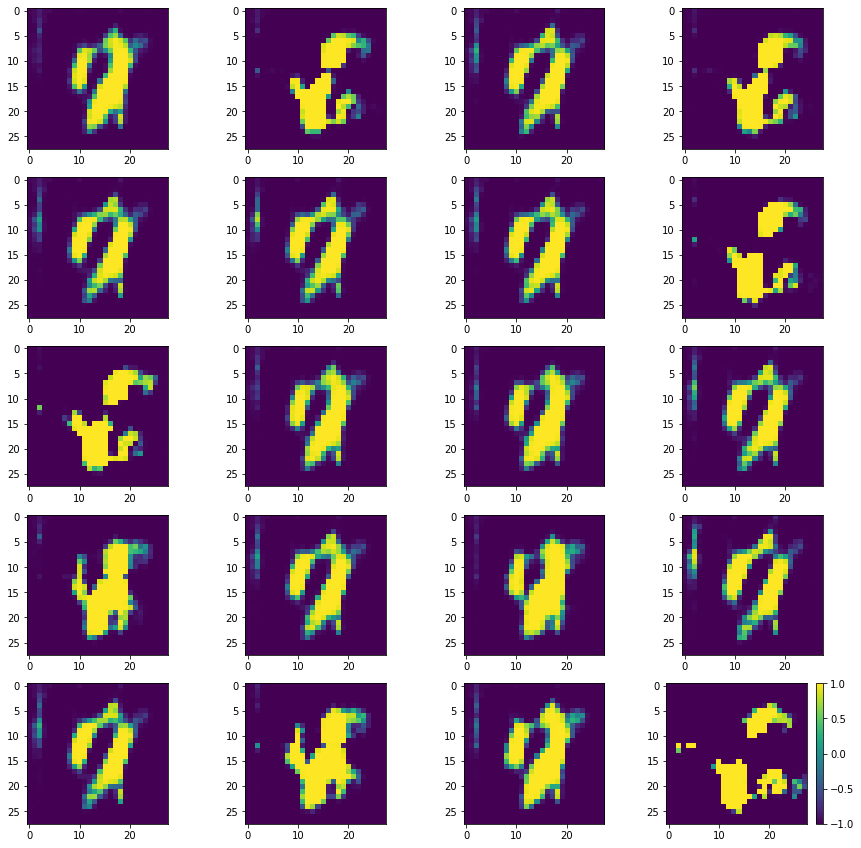

Batch_Num : 62
D_Loss   :   [9.824389457702637, 0.17512229084968567, 9.649267196655273, 0.4921875, 0.07421875] ;    GAN_Loss   :  [11.164543151855469, 0.9937785863876343, 10.170764923095703, 0.0, 0.09375]
Batch_Num : 63
D_Loss   :   [10.128874778747559, 0.18956789374351501, 9.93930721282959, 0.498046875, 0.095703125] ;    GAN_Loss   :  [10.638389587402344, 0.6491297483444214, 9.989259719848633, 0.0, 0.056640625]
Batch_Num : 64
D_Loss   :   [10.05405044555664, 0.1772560179233551, 9.876794815063477, 0.49609375, 0.099609375] ;    GAN_Loss   :  [10.50809383392334, 0.6415932774543762, 9.866500854492188, 0.0, 0.0859375]
Batch_Num : 65
D_Loss   :   [10.17088794708252, 0.15624837577342987, 10.014639854431152, 0.5, 0.080078125] ;    GAN_Loss   :  [10.916581153869629, 0.6544532775878906, 10.262127876281738, 0.0, 0.0859375]
Batch_Num : 66
D_Loss   :   [10.81226921081543, 0.16414515674114227, 10.648123741149902, 0.498046875, 0.103515625] ;    GAN_Loss   :  [11.329164505004883, 0.6389245986938477, 

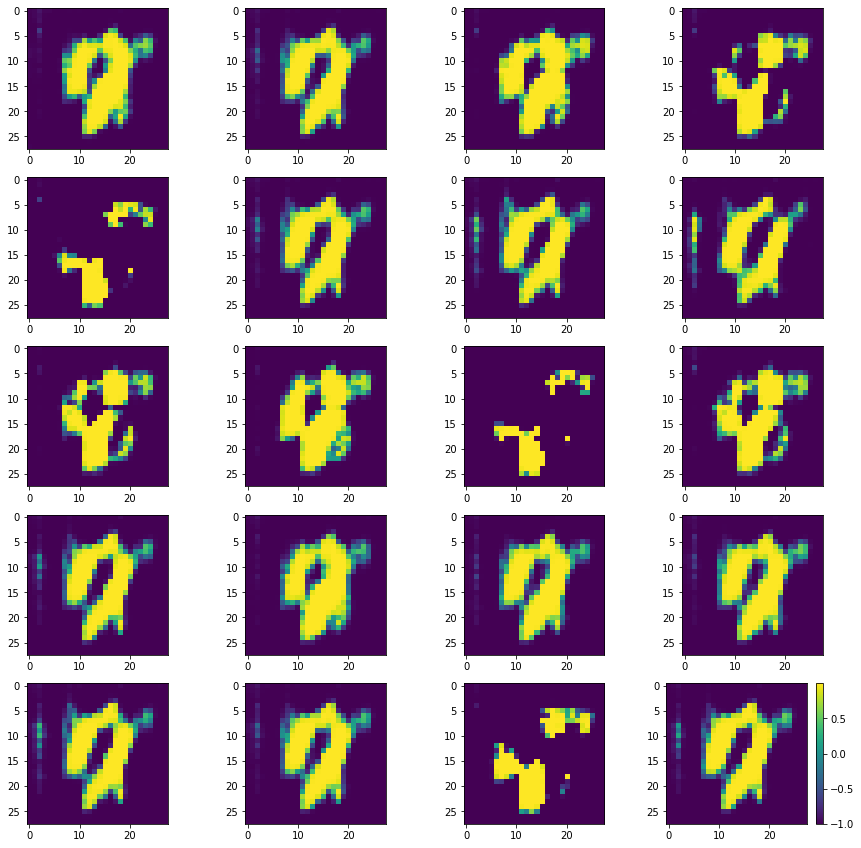

Batch_Num : 77
D_Loss   :   [10.091784477233887, 0.15742798149585724, 9.934356689453125, 0.4921875, 0.087890625] ;    GAN_Loss   :  [11.562707901000977, 0.7475799322128296, 10.815128326416016, 0.0, 0.10546875]
Batch_Num : 78
D_Loss   :   [9.71440601348877, 0.15153230726718903, 9.562873840332031, 0.49609375, 0.103515625] ;    GAN_Loss   :  [11.249214172363281, 0.8382259607315063, 10.410987854003906, 0.0, 0.072265625]
Batch_Num : 79
D_Loss   :   [10.489267349243164, 0.14225172996520996, 10.347015380859375, 0.5, 0.080078125] ;    GAN_Loss   :  [11.076226234436035, 0.8954218029975891, 10.180804252624512, 0.0, 0.072265625]
Batch_Num : 80
D_Loss   :   [10.033467292785645, 0.13666929304599762, 9.896798133850098, 0.5, 0.09375] ;    GAN_Loss   :  [11.180356979370117, 0.9005122184753418, 10.279845237731934, 0.0, 0.0859375]
Batch_Num : 81
D_Loss   :   [10.257872581481934, 0.1336493194103241, 10.124223709106445, 0.5, 0.0859375] ;    GAN_Loss   :  [11.777750015258789, 0.933402955532074, 10.84434700

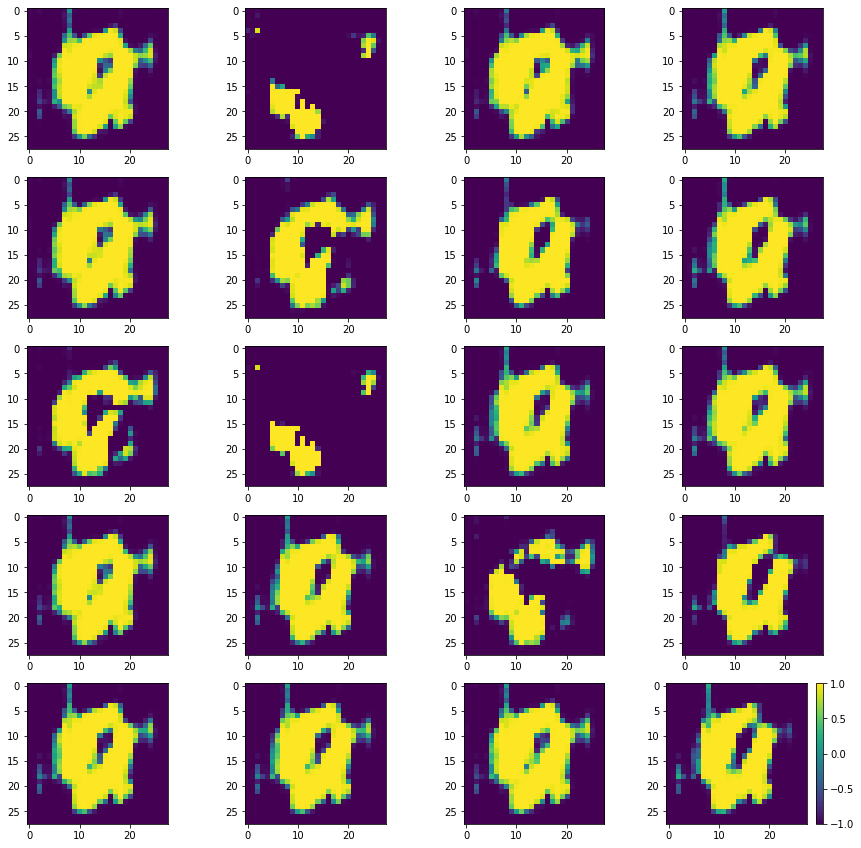

Batch_Num : 92
D_Loss   :   [10.152191162109375, 0.1368655413389206, 10.015325546264648, 0.498046875, 0.091796875] ;    GAN_Loss   :  [15.526853561401367, 2.945197582244873, 12.581655502319336, 0.0, 0.107421875]
Batch_Num : 93
D_Loss   :   [10.585803985595703, 0.1293848752975464, 10.456418991088867, 0.5, 0.076171875] ;    GAN_Loss   :  [16.243858337402344, 2.991511821746826, 13.25234603881836, 0.0, 0.087890625]
Batch_Num : 94
D_Loss   :   [10.006965637207031, 0.13588716089725494, 9.871078491210938, 0.5, 0.091796875] ;    GAN_Loss   :  [17.494441986083984, 3.412644386291504, 14.081796646118164, 0.0, 0.087890625]
Batch_Num : 95
D_Loss   :   [10.216694831848145, 0.13572873175144196, 10.080965995788574, 0.5, 0.103515625] ;    GAN_Loss   :  [16.126873016357422, 2.775521755218506, 13.351350784301758, 0.0, 0.0859375]
Batch_Num : 96
D_Loss   :   [9.74505615234375, 0.13453340530395508, 9.610522270202637, 0.5, 0.087890625] ;    GAN_Loss   :  [17.469751358032227, 3.141062021255493, 14.32868862152

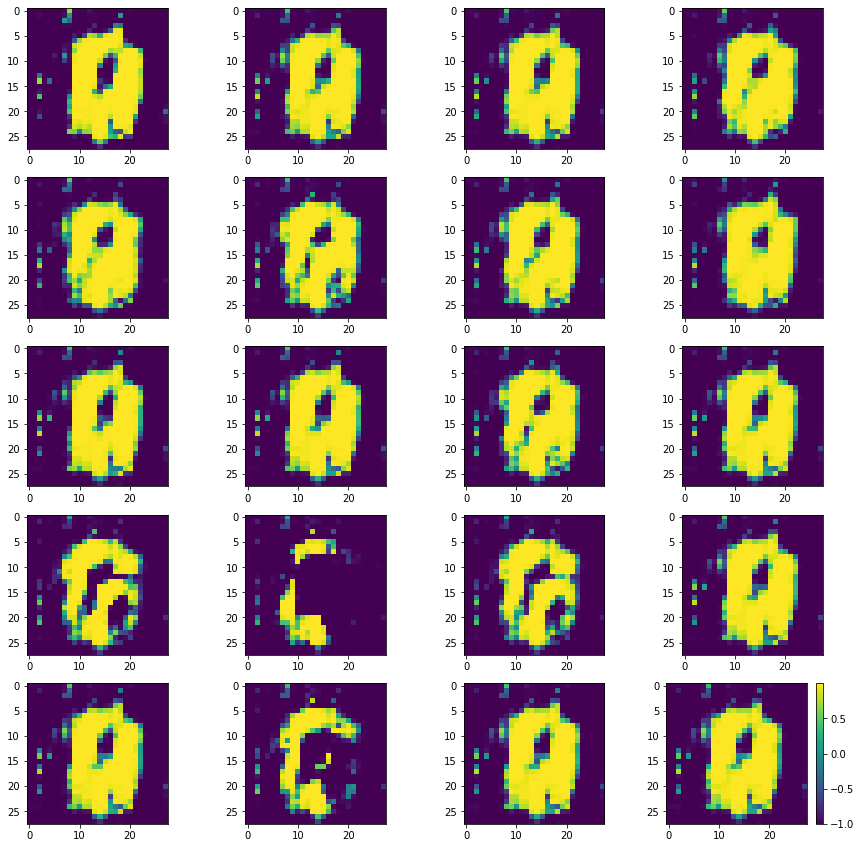

Batch_Num : 107
D_Loss   :   [10.030854225158691, 0.14720851182937622, 9.883646011352539, 0.5, 0.08984375] ;    GAN_Loss   :  [17.528961181640625, 4.773341178894043, 12.755620956420898, 0.0, 0.09765625]
Batch_Num : 108
D_Loss   :   [9.4625883102417, 0.15235477685928345, 9.310233116149902, 0.498046875, 0.09765625] ;    GAN_Loss   :  [17.892662048339844, 5.19276237487793, 12.699898719787598, 0.0, 0.08984375]
Batch_Num : 109
D_Loss   :   [9.700108528137207, 0.16667373478412628, 9.533434867858887, 0.498046875, 0.078125] ;    GAN_Loss   :  [17.3211727142334, 4.216675758361816, 13.104496955871582, 0.0, 0.12109375]
Batch_Num : 110
D_Loss   :   [10.754863739013672, 0.4711720943450928, 10.28369140625, 0.4140625, 0.09375] ;    GAN_Loss   :  [14.064255714416504, 2.485426902770996, 11.578828811645508, 0.0, 0.107421875]
Batch_Num : 111
D_Loss   :   [10.0241117477417, 0.41166096925735474, 9.61245059967041, 0.494140625, 0.09765625] ;    GAN_Loss   :  [14.390671730041504, 2.862314224243164, 11.5283575

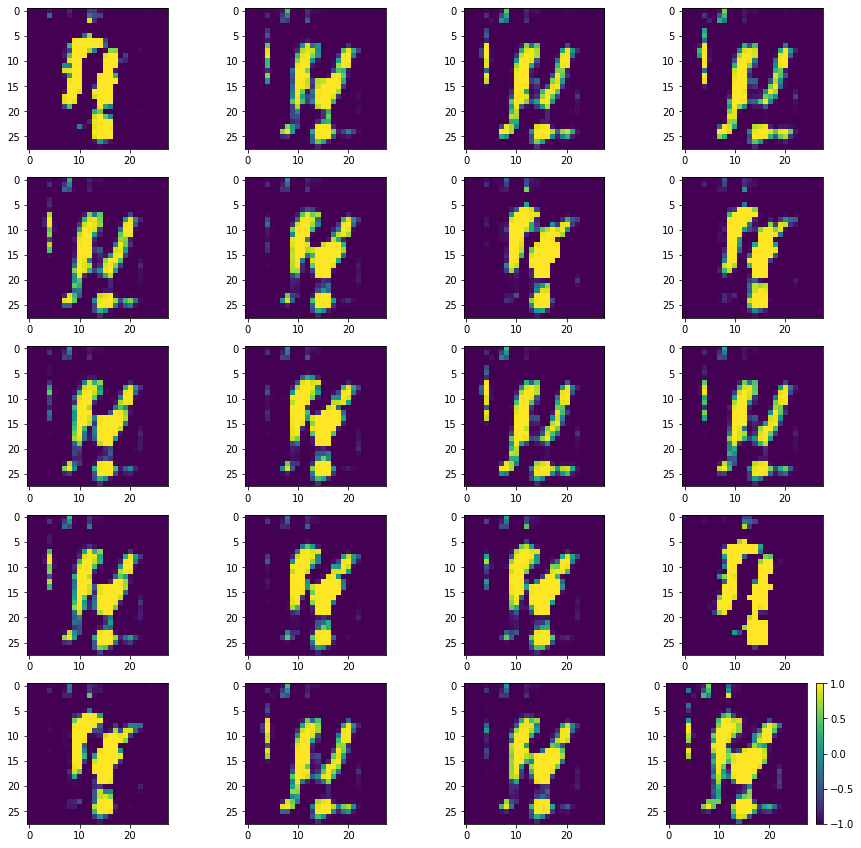

Batch_Num : 122
D_Loss   :   [10.558106422424316, 0.14358842372894287, 10.414518356323242, 0.5, 0.10546875] ;    GAN_Loss   :  [10.773981094360352, 0.6116370558738708, 10.162343978881836, 0.0, 0.09375]
Batch_Num : 123
D_Loss   :   [9.913997650146484, 0.13119512796401978, 9.78280258178711, 0.5, 0.07421875] ;    GAN_Loss   :  [10.70994758605957, 0.6080489158630371, 10.101899147033691, 0.0, 0.08984375]
Batch_Num : 124
D_Loss   :   [10.267901420593262, 0.13851365447044373, 10.129387855529785, 0.5, 0.078125] ;    GAN_Loss   :  [10.376967430114746, 0.5909962058067322, 9.785971641540527, 0.0, 0.07421875]
Batch_Num : 125
D_Loss   :   [10.434843063354492, 0.13063988089561462, 10.304203033447266, 0.5, 0.076171875] ;    GAN_Loss   :  [10.889657974243164, 0.5320204496383667, 10.357637405395508, 0.0, 0.076171875]
Batch_Num : 126
D_Loss   :   [10.383445739746094, 0.13148948550224304, 10.25195598602295, 0.498046875, 0.126953125] ;    GAN_Loss   :  [10.947646141052246, 0.5278719663619995, 10.419774055

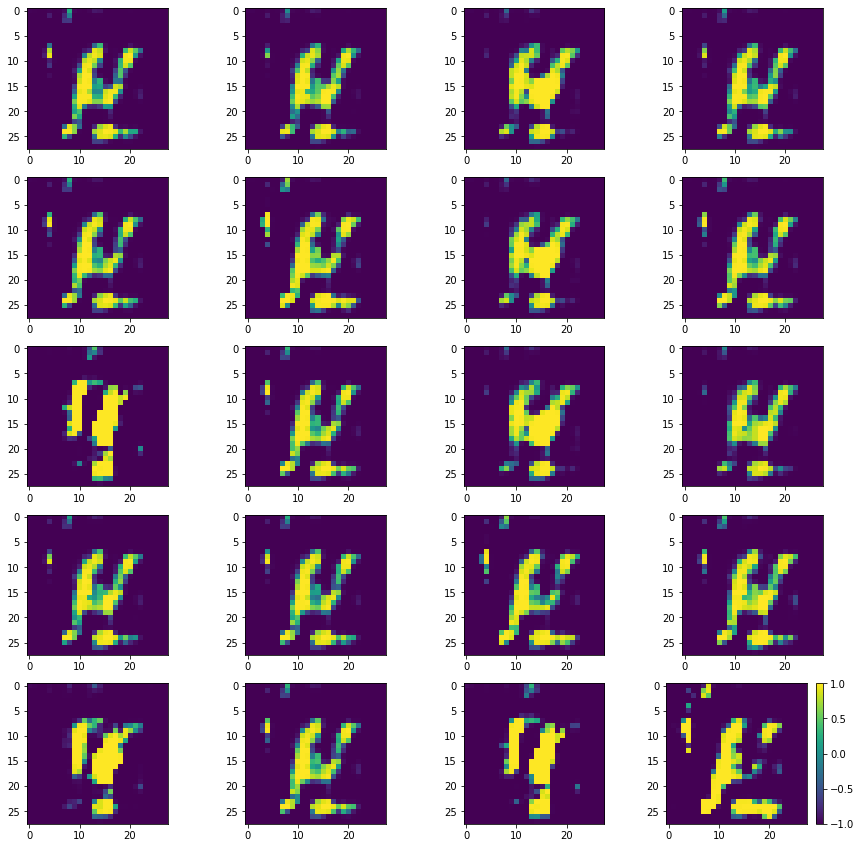

Batch_Num : 137
D_Loss   :   [10.769168853759766, 0.13210678100585938, 10.637062072753906, 0.5, 0.11328125] ;    GAN_Loss   :  [10.429220199584961, 0.33711981773376465, 10.092100143432617, 0.0, 0.0703125]
Batch_Num : 138
D_Loss   :   [10.0470609664917, 0.14430707693099976, 9.902753829956055, 0.5, 0.09375] ;    GAN_Loss   :  [10.470266342163086, 0.35716646909713745, 10.113100051879883, 0.0, 0.109375]
Batch_Num : 139
D_Loss   :   [9.92396354675293, 0.12249259650707245, 9.801470756530762, 0.5, 0.072265625] ;    GAN_Loss   :  [10.486384391784668, 0.4054573178291321, 10.080926895141602, 0.0, 0.083984375]
Batch_Num : 140
D_Loss   :   [9.521121978759766, 0.12100701779127121, 9.400115013122559, 0.5, 0.080078125] ;    GAN_Loss   :  [9.977374076843262, 0.37809380888938904, 9.59928035736084, 0.0, 0.103515625]
Batch_Num : 141
D_Loss   :   [10.111762046813965, 0.12871715426445007, 9.983044624328613, 0.5, 0.087890625] ;    GAN_Loss   :  [10.407905578613281, 0.3333373963832855, 10.074567794799805, 0.

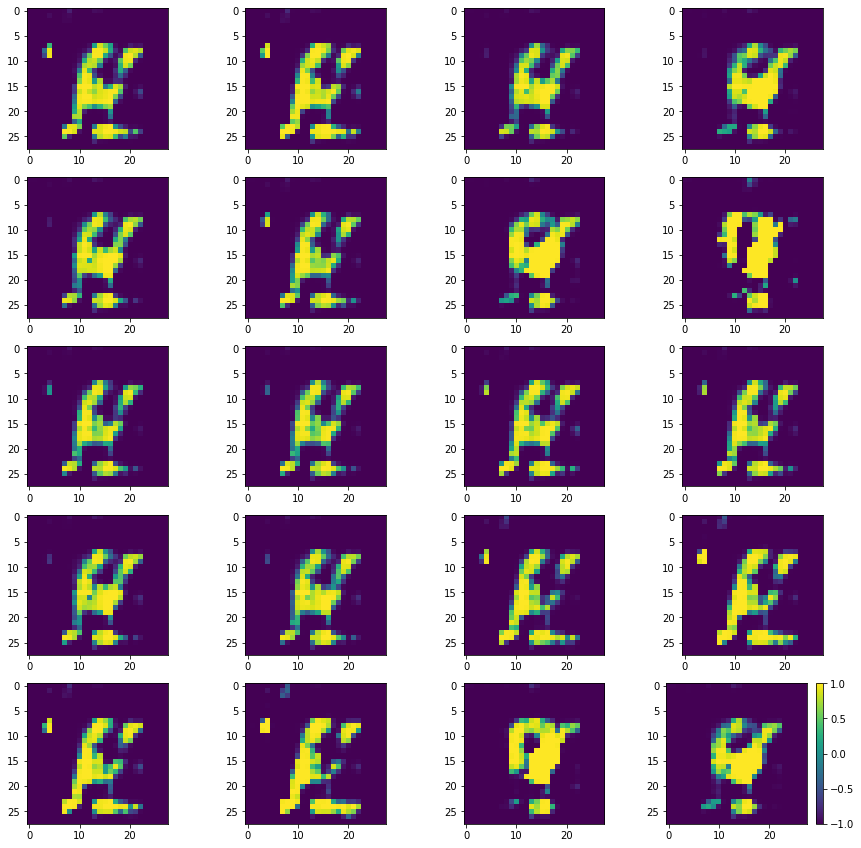

Batch_Num : 152
D_Loss   :   [9.799883842468262, 0.12305891513824463, 9.676824569702148, 0.5, 0.109375] ;    GAN_Loss   :  [10.117181777954102, 0.33497220277786255, 9.782209396362305, 0.0, 0.130859375]
Batch_Num : 153
D_Loss   :   [10.050129890441895, 0.11939897388219833, 9.930730819702148, 0.5, 0.11328125] ;    GAN_Loss   :  [10.24726390838623, 0.3199155628681183, 9.927348136901855, 0.0, 0.08203125]
Batch_Num : 154
D_Loss   :   [10.017457962036133, 0.11849658191204071, 9.898961067199707, 0.5, 0.103515625] ;    GAN_Loss   :  [10.725332260131836, 0.30836325883865356, 10.416969299316406, 0.0, 0.10546875]
Batch_Num : 155
D_Loss   :   [10.390617370605469, 0.12574246525764465, 10.264874458312988, 0.5, 0.099609375] ;    GAN_Loss   :  [10.18080997467041, 0.286426305770874, 9.894383430480957, 0.0, 0.09765625]
Batch_Num : 156
D_Loss   :   [9.496490478515625, 0.12217684090137482, 9.374313354492188, 0.5, 0.09375] ;    GAN_Loss   :  [10.489838600158691, 0.2705712616443634, 10.219266891479492, 0.0,

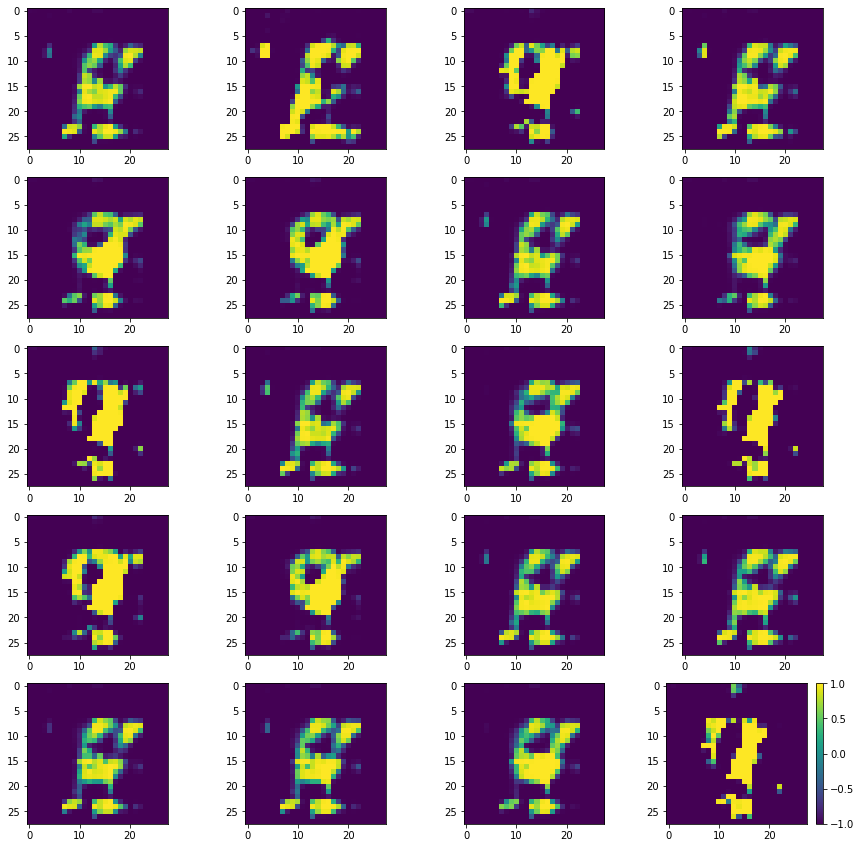

Batch_Num : 167
D_Loss   :   [10.508833885192871, 0.11566053330898285, 10.393173217773438, 0.5, 0.1171875] ;    GAN_Loss   :  [10.551872253417969, 0.34550511837005615, 10.206367492675781, 0.0, 0.09375]
Batch_Num : 168
D_Loss   :   [9.546188354492188, 0.11490067839622498, 9.43128776550293, 0.5, 0.083984375] ;    GAN_Loss   :  [10.514026641845703, 0.34807443618774414, 10.165952682495117, 0.0, 0.10546875]
Batch_Num : 169
D_Loss   :   [10.066229820251465, 0.1160401999950409, 9.950189590454102, 0.5, 0.080078125] ;    GAN_Loss   :  [9.903430938720703, 0.34771889448165894, 9.55571174621582, 0.0, 0.125]
Batch_Num : 170
D_Loss   :   [10.047849655151367, 0.11610744893550873, 9.931742668151855, 0.5, 0.109375] ;    GAN_Loss   :  [10.365156173706055, 0.3550608456134796, 10.010095596313477, 0.0, 0.107421875]
Batch_Num : 171
D_Loss   :   [10.390381813049316, 0.11705130338668823, 10.273330688476562, 0.5, 0.078125] ;    GAN_Loss   :  [10.845259666442871, 0.34431004524230957, 10.50094985961914, 0.0, 0.1

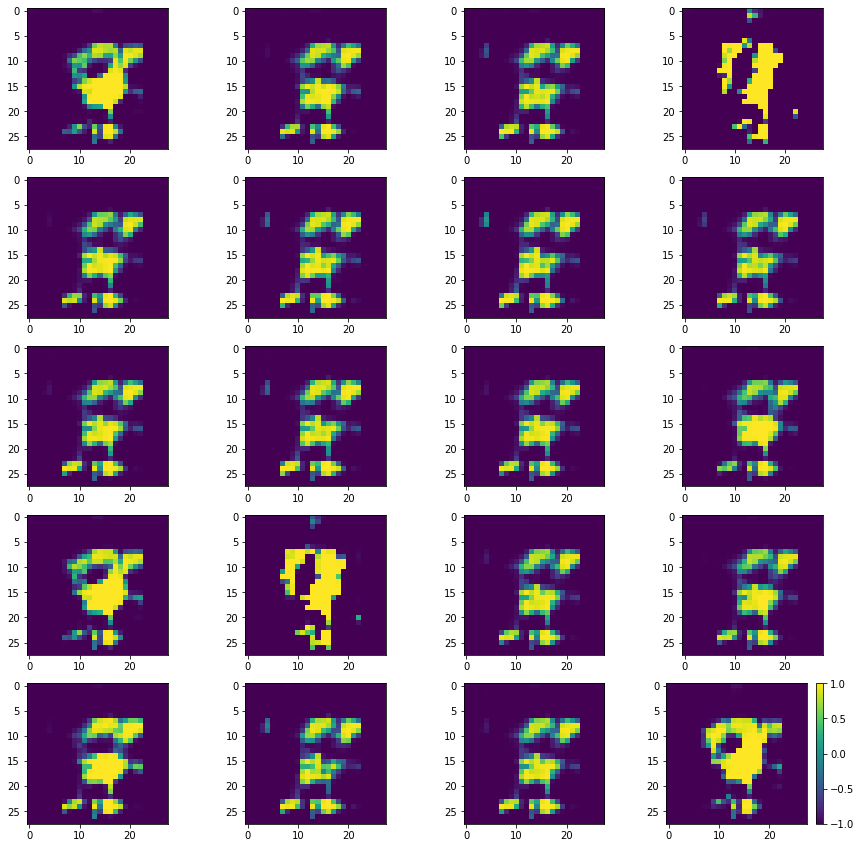

Batch_Num : 182
D_Loss   :   [9.697986602783203, 0.11863334476947784, 9.579353332519531, 0.5, 0.091796875] ;    GAN_Loss   :  [10.25794792175293, 0.3024722635746002, 9.955475807189941, 0.0, 0.109375]
Batch_Num : 183
D_Loss   :   [10.350525856018066, 0.11982434242963791, 10.230701446533203, 0.5, 0.103515625] ;    GAN_Loss   :  [10.599259376525879, 0.3501395583152771, 10.249119758605957, 0.0, 0.119140625]
Batch_Num : 184
D_Loss   :   [9.824664115905762, 0.11650007963180542, 9.70816421508789, 0.5, 0.11328125] ;    GAN_Loss   :  [10.752140045166016, 0.36888939142227173, 10.38325023651123, 0.0, 0.111328125]
Batch_Num : 185
D_Loss   :   [9.909832954406738, 0.12278880923986435, 9.787044525146484, 0.498046875, 0.087890625] ;    GAN_Loss   :  [11.067032814025879, 0.36675581336021423, 10.700277328491211, 0.0, 0.099609375]
Batch_Num : 186
D_Loss   :   [9.495537757873535, 0.12132154405117035, 9.374216079711914, 0.498046875, 0.080078125] ;    GAN_Loss   :  [10.503470420837402, 0.3413335680961609, 1

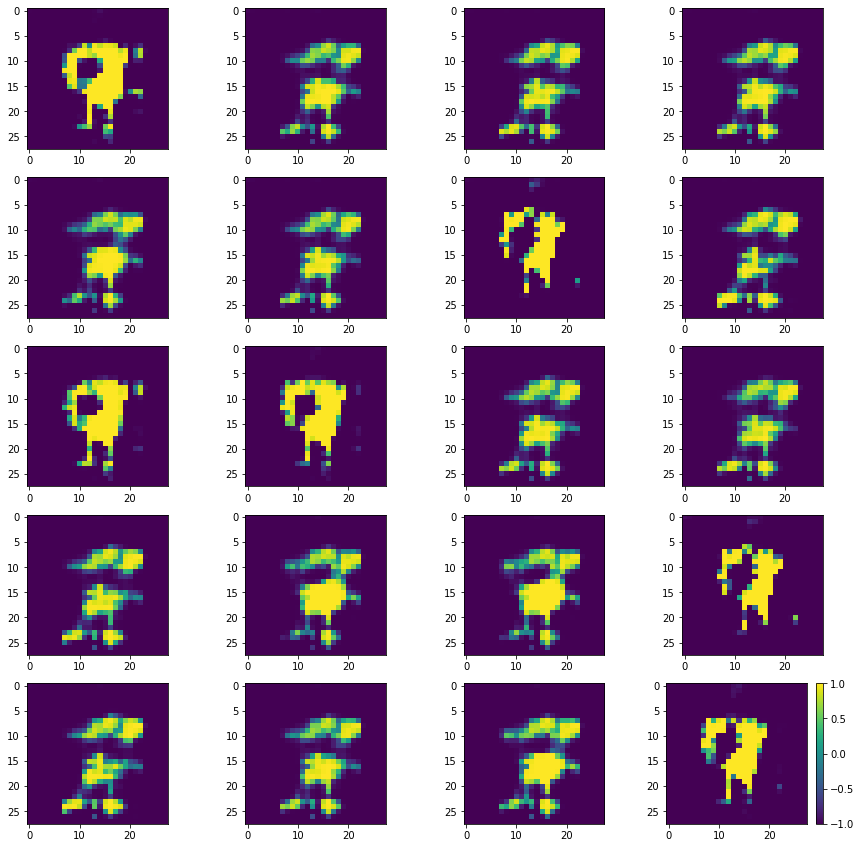

Batch_Num : 197
D_Loss   :   [9.975302696228027, 0.13414742052555084, 9.841155052185059, 0.5, 0.080078125] ;    GAN_Loss   :  [10.56358814239502, 0.37313416600227356, 10.19045352935791, 0.0, 0.095703125]
Batch_Num : 198
D_Loss   :   [9.671948432922363, 0.12635359168052673, 9.545595169067383, 0.5, 0.10546875] ;    GAN_Loss   :  [10.31476879119873, 0.3504979908466339, 9.96427059173584, 0.0, 0.10546875]
Batch_Num : 199
D_Loss   :   [10.568255424499512, 0.13017946481704712, 10.43807601928711, 0.5, 0.103515625] ;    GAN_Loss   :  [10.655027389526367, 0.5502581596374512, 10.104769706726074, 0.0, 0.08984375]
Batch_Num : 200
D_Loss   :   [10.1542329788208, 0.13206355273723602, 10.02216911315918, 0.5, 0.1015625] ;    GAN_Loss   :  [10.493644714355469, 0.4668887257575989, 10.026756286621094, 0.0, 0.083984375]
Batch_Num : 201
D_Loss   :   [10.383508682250977, 0.12978899478912354, 10.253719329833984, 0.498046875, 0.099609375] ;    GAN_Loss   :  [10.726008415222168, 0.4729372262954712, 10.253070831

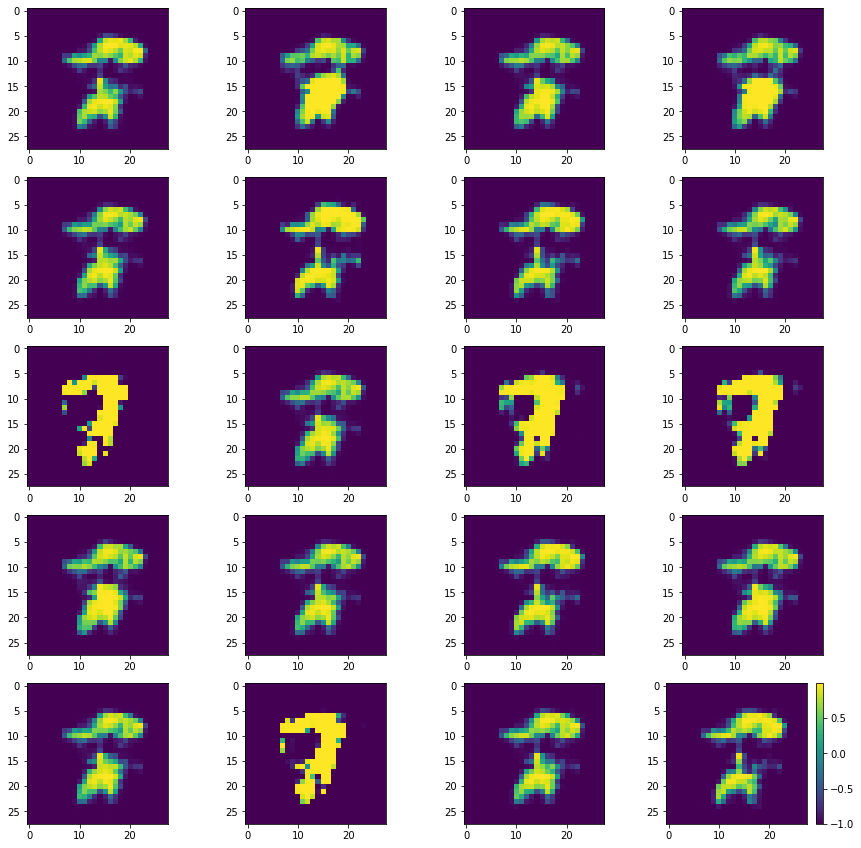

Batch_Num : 212
D_Loss   :   [11.046211242675781, 0.238828644156456, 10.807382583618164, 0.490234375, 0.107421875] ;    GAN_Loss   :  [10.67662525177002, 0.8882980346679688, 9.78832721710205, 0.0, 0.095703125]
Batch_Num : 213
D_Loss   :   [9.733722686767578, 0.24506579339504242, 9.488656997680664, 0.470703125, 0.08984375] ;    GAN_Loss   :  [12.939972877502441, 2.2658779621124268, 10.674095153808594, 0.0, 0.09375]
Batch_Num : 214
D_Loss   :   [10.528214454650879, 0.23768819868564606, 10.290526390075684, 0.5, 0.099609375] ;    GAN_Loss   :  [11.72663402557373, 1.2239501476287842, 10.502683639526367, 0.0, 0.115234375]
Batch_Num : 215
D_Loss   :   [9.362395286560059, 0.26650989055633545, 9.095885276794434, 0.462890625, 0.119140625] ;    GAN_Loss   :  [12.314507484436035, 1.5386186838150024, 10.775888442993164, 0.0, 0.08984375]
Batch_Num : 216
D_Loss   :   [10.497447967529297, 0.195577472448349, 10.301870346069336, 0.498046875, 0.12109375] ;    GAN_Loss   :  [12.253028869628906, 1.79682111

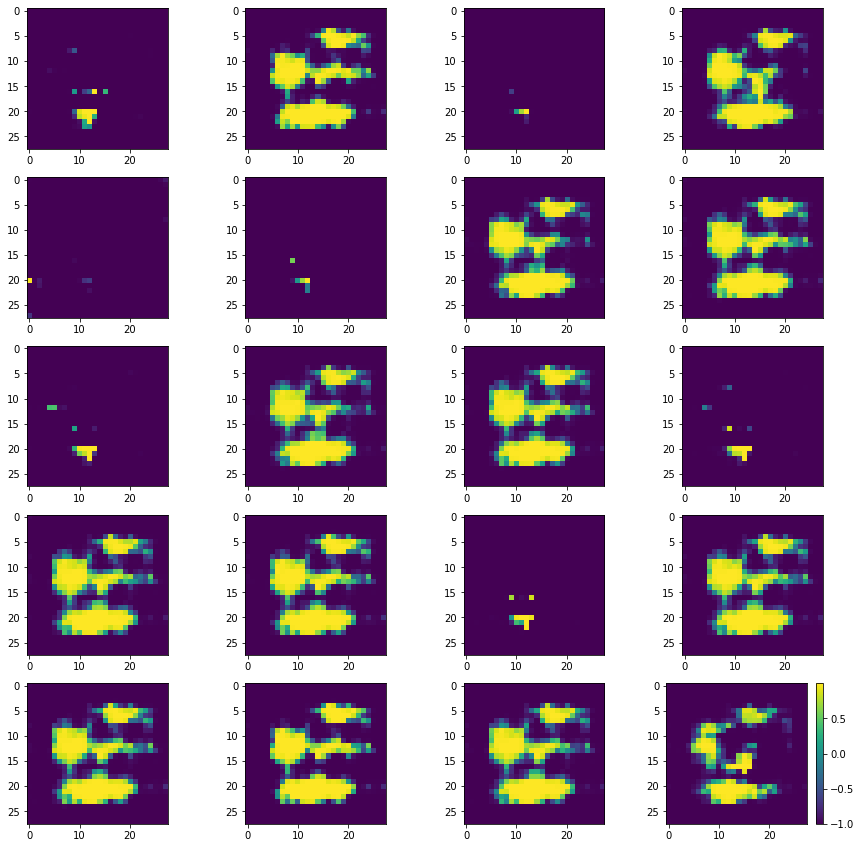

Batch_Num : 227
D_Loss   :   [9.595102310180664, 0.3853129744529724, 9.209789276123047, 0.47265625, 0.080078125] ;    GAN_Loss   :  [14.31216049194336, 2.5488128662109375, 11.763347625732422, 0.0, 0.072265625]
Batch_Num : 228
D_Loss   :   [10.569626808166504, 0.3109613358974457, 10.258665084838867, 0.478515625, 0.10546875] ;    GAN_Loss   :  [13.294561386108398, 2.584865093231201, 10.709695816040039, 0.0, 0.064453125]
Batch_Num : 229
D_Loss   :   [9.901735305786133, 0.2482004165649414, 9.653534889221191, 0.474609375, 0.0859375] ;    GAN_Loss   :  [14.212905883789062, 3.3381896018981934, 10.874716758728027, 0.0, 0.087890625]
Batch_Num : 230
D_Loss   :   [10.195542335510254, 0.21879629790782928, 9.97674560546875, 0.49609375, 0.091796875] ;    GAN_Loss   :  [15.18917465209961, 3.6954243183135986, 11.49375057220459, 0.0, 0.078125]
Batch_Num : 231
D_Loss   :   [10.478682518005371, 0.2589145600795746, 10.219767570495605, 0.478515625, 0.123046875] ;    GAN_Loss   :  [15.389974594116211, 3.953

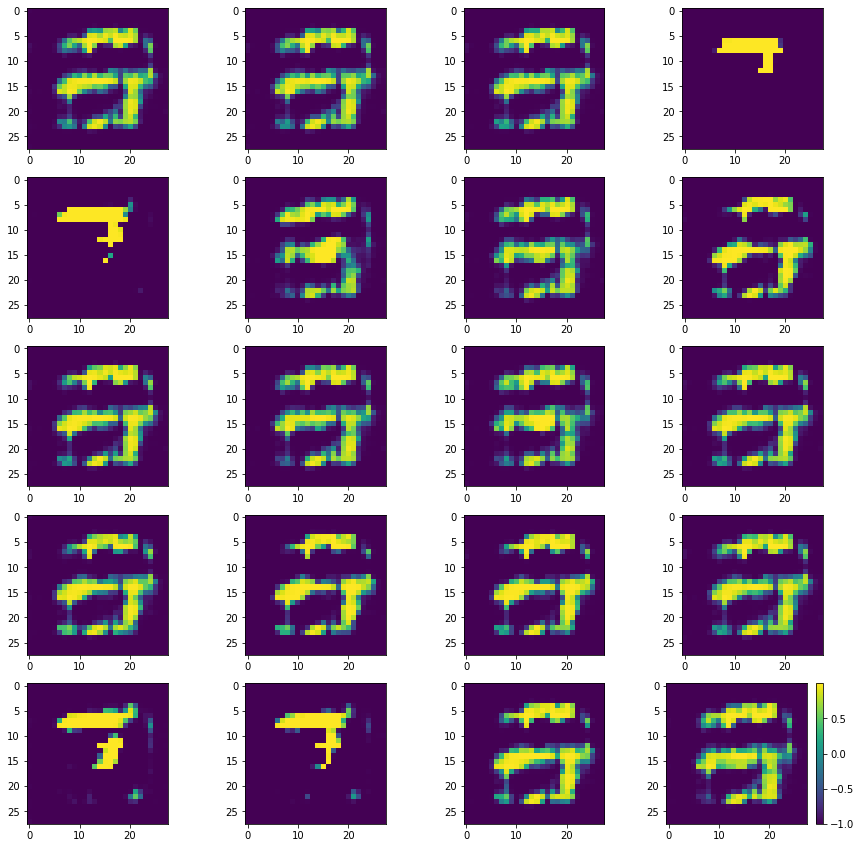

Batch_Num : 2
D_Loss   :   [10.278076171875, 0.25920286774635315, 10.01887321472168, 0.5, 0.107421875] ;    GAN_Loss   :  [18.89310073852539, 5.066510200500488, 13.826591491699219, 0.0, 0.068359375]
Batch_Num : 3
D_Loss   :   [10.28891372680664, 0.2387145608663559, 10.050199508666992, 0.498046875, 0.119140625] ;    GAN_Loss   :  [17.208091735839844, 4.819104194641113, 12.388986587524414, 0.0, 0.095703125]
Batch_Num : 4
D_Loss   :   [10.467843055725098, 0.24558484554290771, 10.222258567810059, 0.462890625, 0.146484375] ;    GAN_Loss   :  [17.480789184570312, 4.533251762390137, 12.94753646850586, 0.0, 0.0859375]
Batch_Num : 5
D_Loss   :   [10.34372329711914, 0.2745250165462494, 10.069198608398438, 0.484375, 0.125] ;    GAN_Loss   :  [19.56057357788086, 4.680944442749023, 14.87962818145752, 0.0, 0.09375]
Batch_Num : 6
D_Loss   :   [10.590651512145996, 0.21922732889652252, 10.371423721313477, 0.5, 0.107421875] ;    GAN_Loss   :  [20.292648315429688, 4.40492057800293, 15.887726783752441, 0.

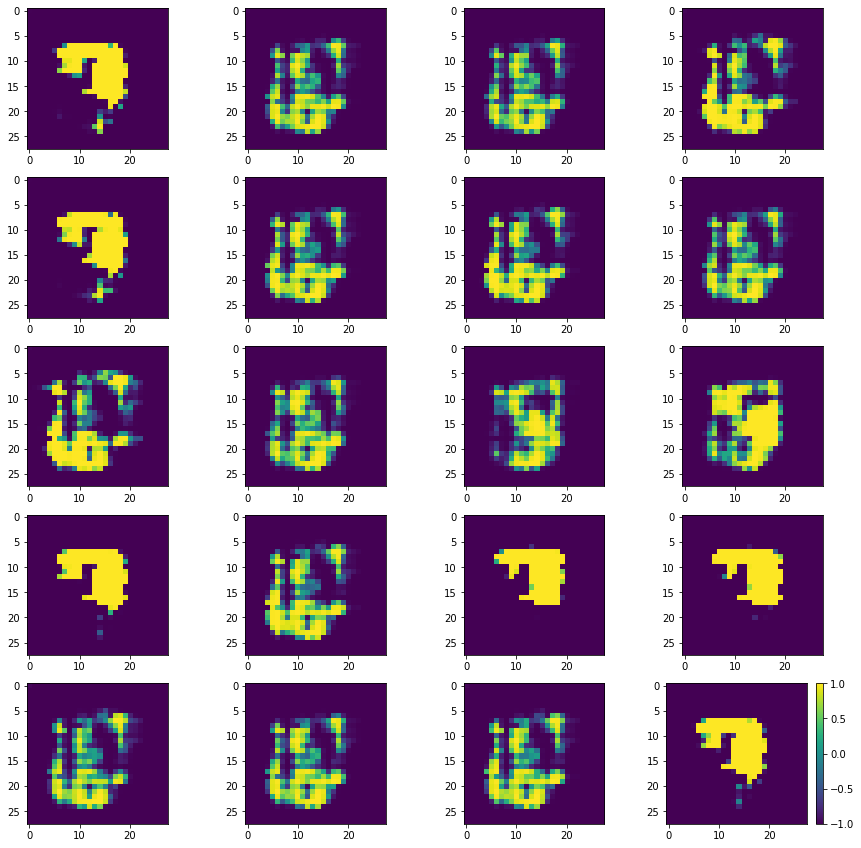

Batch_Num : 17
D_Loss   :   [9.948552131652832, 0.27203723788261414, 9.676514625549316, 0.458984375, 0.119140625] ;    GAN_Loss   :  [16.93077278137207, 5.827877998352051, 11.10289478302002, 0.0, 0.1015625]
Batch_Num : 18
D_Loss   :   [10.129867553710938, 0.28738102316856384, 9.842486381530762, 0.478515625, 0.10546875] ;    GAN_Loss   :  [15.228116989135742, 4.764829158782959, 10.463287353515625, 0.0, 0.064453125]
Batch_Num : 19
D_Loss   :   [10.188798904418945, 0.28811392188072205, 9.90068531036377, 0.46875, 0.099609375] ;    GAN_Loss   :  [16.014801025390625, 4.506658554077148, 11.50814151763916, 0.0, 0.0546875]
Batch_Num : 20
D_Loss   :   [9.956311225891113, 0.22743986546993256, 9.72887134552002, 0.48046875, 0.1015625] ;    GAN_Loss   :  [14.659818649291992, 3.636883497238159, 11.022934913635254, 0.0, 0.068359375]
Batch_Num : 21
D_Loss   :   [9.848468780517578, 0.27781942486763, 9.570649147033691, 0.458984375, 0.08984375] ;    GAN_Loss   :  [16.921316146850586, 5.481039047241211, 11

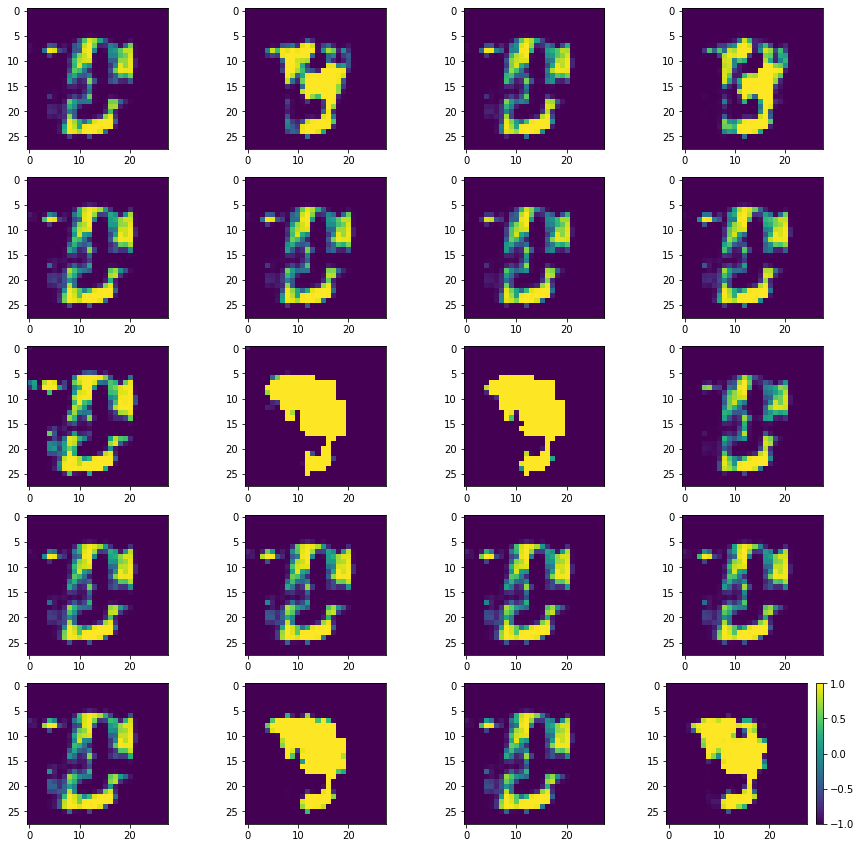

Batch_Num : 32
D_Loss   :   [9.737566947937012, 0.15529334545135498, 9.582273483276367, 0.49609375, 0.115234375] ;    GAN_Loss   :  [11.592697143554688, 1.1917849779129028, 10.400912284851074, 0.0, 0.076171875]
Batch_Num : 33
D_Loss   :   [10.31471061706543, 0.14387047290802002, 10.1708402633667, 0.5, 0.080078125] ;    GAN_Loss   :  [10.895291328430176, 1.2215696573257446, 9.673721313476562, 0.0, 0.087890625]
Batch_Num : 34
D_Loss   :   [10.418360710144043, 0.18021591007709503, 10.238144874572754, 0.49609375, 0.08984375] ;    GAN_Loss   :  [10.937705039978027, 1.0406605005264282, 9.89704418182373, 0.0, 0.087890625]
Batch_Num : 35
D_Loss   :   [9.618414878845215, 0.14388379454612732, 9.474531173706055, 0.5, 0.103515625] ;    GAN_Loss   :  [11.17905044555664, 1.0464534759521484, 10.132596969604492, 0.0, 0.080078125]
Batch_Num : 36
D_Loss   :   [9.725627899169922, 0.1754208505153656, 9.550207138061523, 0.494140625, 0.087890625] ;    GAN_Loss   :  [10.97071647644043, 1.031334400177002, 9.9

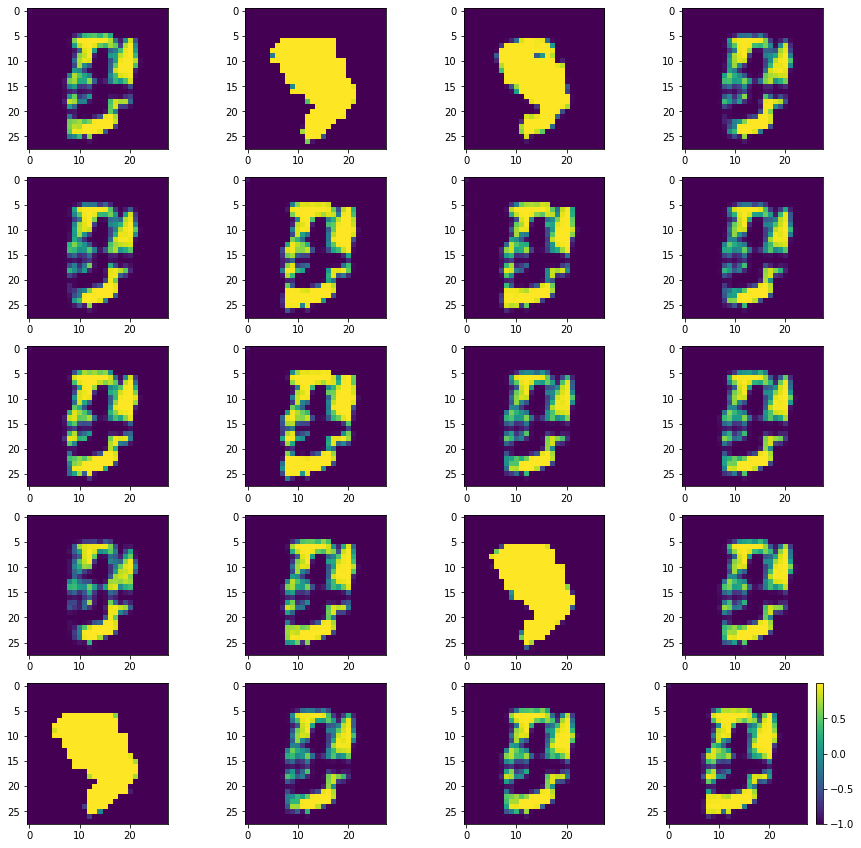

Batch_Num : 47
D_Loss   :   [10.678960800170898, 0.1354059875011444, 10.54355525970459, 0.5, 0.09765625] ;    GAN_Loss   :  [11.304762840270996, 0.9617974758148193, 10.342965126037598, 0.0, 0.080078125]
Batch_Num : 48
D_Loss   :   [10.138036727905273, 0.14597086608409882, 9.9920654296875, 0.5, 0.060546875] ;    GAN_Loss   :  [10.720038414001465, 0.9758806228637695, 9.744157791137695, 0.0, 0.076171875]
Batch_Num : 49
D_Loss   :   [10.04422664642334, 0.1394636183977127, 9.904763221740723, 0.498046875, 0.0625] ;    GAN_Loss   :  [11.13328742980957, 1.2685859203338623, 9.864701271057129, 0.0, 0.09765625]
Batch_Num : 50
D_Loss   :   [9.769198417663574, 0.13594576716423035, 9.63325309753418, 0.5, 0.087890625] ;    GAN_Loss   :  [11.71123218536377, 1.2993842363357544, 10.411848068237305, 0.0, 0.083984375]
Batch_Num : 51
D_Loss   :   [10.396510124206543, 0.1350162923336029, 10.261493682861328, 0.5, 0.064453125] ;    GAN_Loss   :  [11.592795372009277, 1.2869336605072021, 10.305861473083496, 0.0

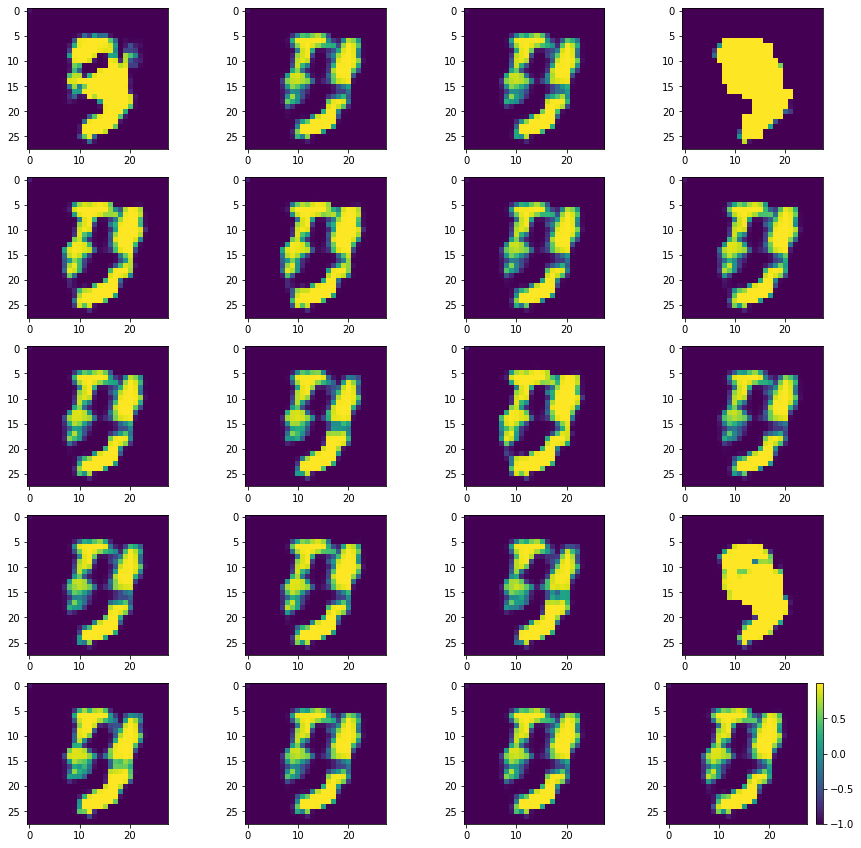

Batch_Num : 62
D_Loss   :   [9.760602951049805, 0.12985394895076752, 9.630748748779297, 0.5, 0.07421875] ;    GAN_Loss   :  [11.261391639709473, 1.3907610177993774, 9.870630264282227, 0.0, 0.08984375]
Batch_Num : 63
D_Loss   :   [10.02673625946045, 0.13583628833293915, 9.890899658203125, 0.5, 0.08203125] ;    GAN_Loss   :  [10.939308166503906, 1.192406177520752, 9.746902465820312, 0.0, 0.109375]
Batch_Num : 64
D_Loss   :   [10.012727737426758, 0.13995929062366486, 9.87276840209961, 0.5, 0.072265625] ;    GAN_Loss   :  [11.11886215209961, 0.9512217044830322, 10.167640686035156, 0.0, 0.083984375]
Batch_Num : 65
D_Loss   :   [10.13644790649414, 0.12892481684684753, 10.007523536682129, 0.5, 0.08203125] ;    GAN_Loss   :  [11.413908004760742, 0.9255527257919312, 10.48835563659668, 0.0, 0.087890625]
Batch_Num : 66
D_Loss   :   [10.767799377441406, 0.13106022775173187, 10.636738777160645, 0.5, 0.091796875] ;    GAN_Loss   :  [11.139581680297852, 1.027207851409912, 10.112374305725098, 0.0, 0.0

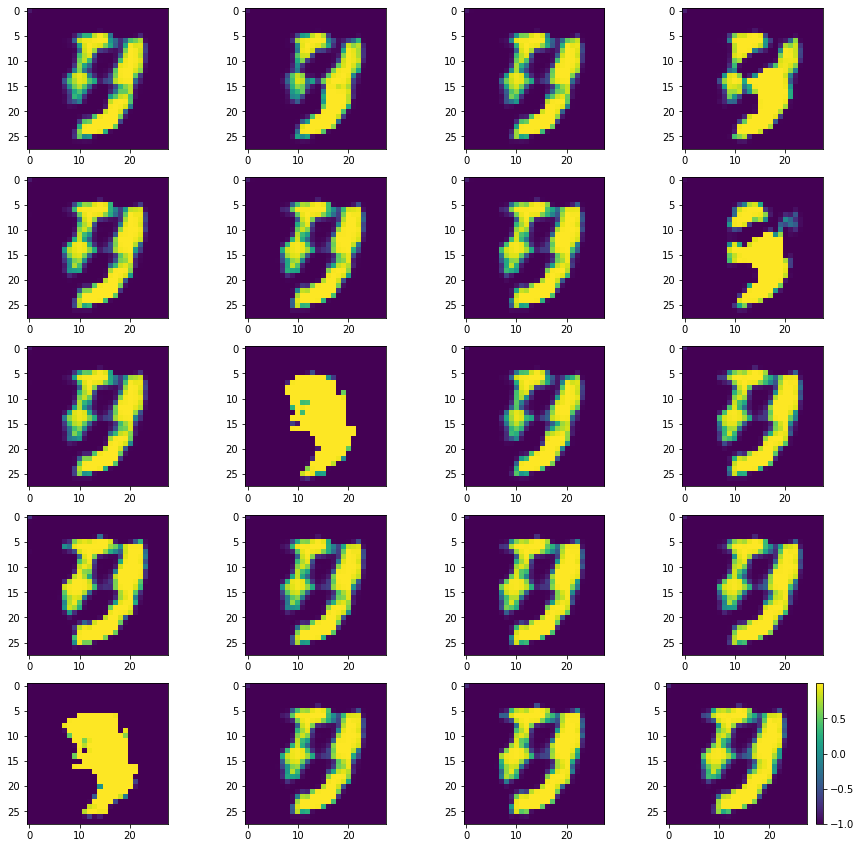

Batch_Num : 77
D_Loss   :   [10.085835456848145, 0.17312657833099365, 9.91270923614502, 0.478515625, 0.099609375] ;    GAN_Loss   :  [11.795103073120117, 1.161842703819275, 10.633260726928711, 0.0, 0.125]
Batch_Num : 78
D_Loss   :   [9.700640678405762, 0.13524745404720306, 9.565393447875977, 0.5, 0.08203125] ;    GAN_Loss   :  [11.699431419372559, 1.5833308696746826, 10.116100311279297, 0.0, 0.123046875]
Batch_Num : 79
D_Loss   :   [10.475218772888184, 0.1286400854587555, 10.346578598022461, 0.5, 0.1015625] ;    GAN_Loss   :  [12.32632064819336, 2.237229824066162, 10.089090347290039, 0.0, 0.08203125]
Batch_Num : 80
D_Loss   :   [10.019065856933594, 0.12969012558460236, 9.889375686645508, 0.498046875, 0.078125] ;    GAN_Loss   :  [11.650586128234863, 1.329519271850586, 10.321066856384277, 0.0, 0.103515625]
Batch_Num : 81
D_Loss   :   [10.273733139038086, 0.14751587808132172, 10.126216888427734, 0.5, 0.087890625] ;    GAN_Loss   :  [11.167928695678711, 0.9698740243911743, 10.198054313659

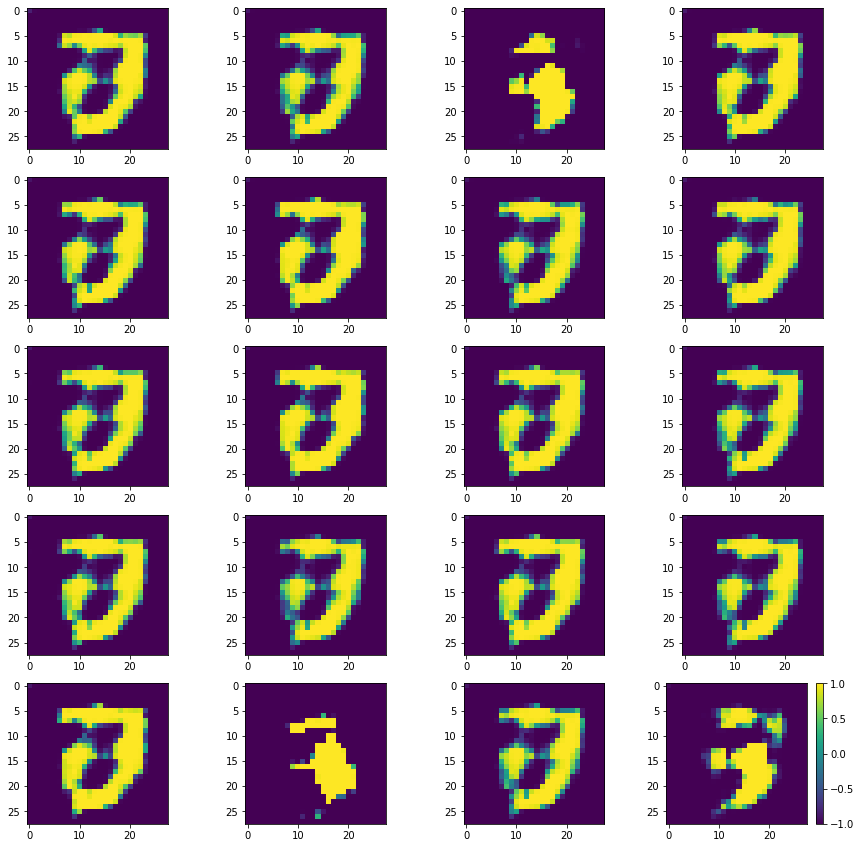

Batch_Num : 92
D_Loss   :   [10.171385765075684, 0.15019339323043823, 10.02119255065918, 0.5, 0.09375] ;    GAN_Loss   :  [11.218707084655762, 1.0178965330123901, 10.200810432434082, 0.0, 0.064453125]
Batch_Num : 93
D_Loss   :   [10.598736763000488, 0.13249421119689941, 10.466242790222168, 0.5, 0.1015625] ;    GAN_Loss   :  [11.619405746459961, 1.04742431640625, 10.571981430053711, 0.0, 0.052734375]
Batch_Num : 94
D_Loss   :   [10.017057418823242, 0.14219236373901367, 9.874865531921387, 0.5, 0.08984375] ;    GAN_Loss   :  [11.162307739257812, 1.016280174255371, 10.146027565002441, 0.0, 0.07421875]
Batch_Num : 95
D_Loss   :   [10.192288398742676, 0.14127124845981598, 10.051016807556152, 0.498046875, 0.08984375] ;    GAN_Loss   :  [11.41989517211914, 0.9712324738502502, 10.448662757873535, 0.0, 0.083984375]
Batch_Num : 96
D_Loss   :   [9.745283126831055, 0.1386624574661255, 9.606620788574219, 0.5, 0.10546875] ;    GAN_Loss   :  [11.578490257263184, 0.9489620923995972, 10.629528045654297,

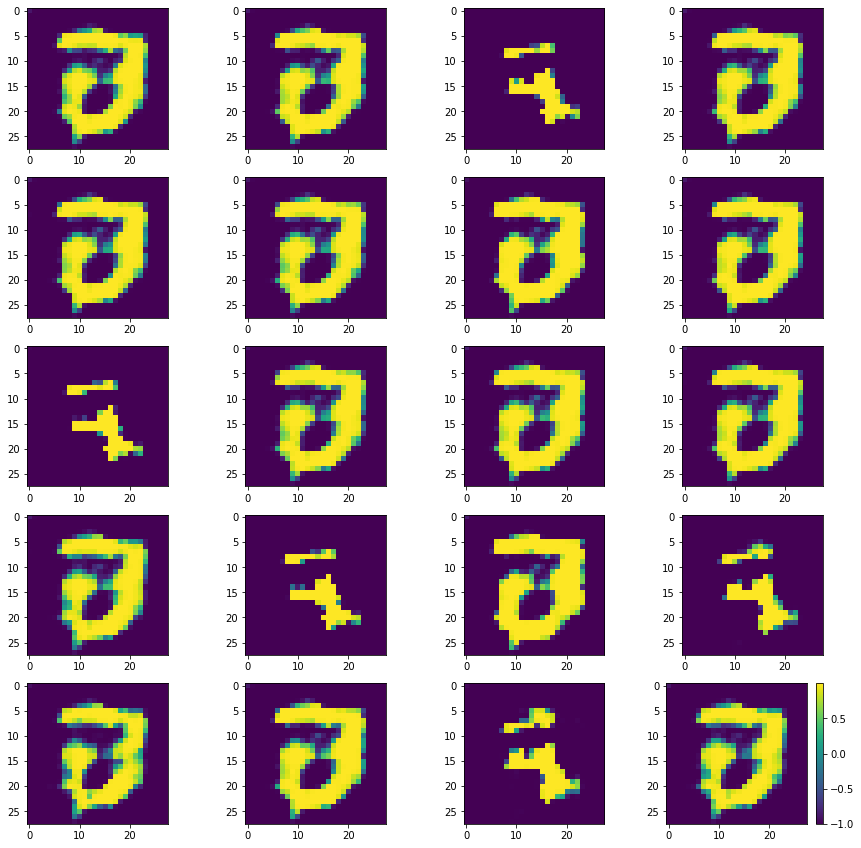

Batch_Num : 107
D_Loss   :   [10.023092269897461, 0.13938787579536438, 9.88370418548584, 0.498046875, 0.099609375] ;    GAN_Loss   :  [11.528534889221191, 1.3518040180206299, 10.17673110961914, 0.0, 0.09765625]
Batch_Num : 108
D_Loss   :   [9.456799507141113, 0.15270483493804932, 9.304094314575195, 0.490234375, 0.087890625] ;    GAN_Loss   :  [14.022043228149414, 3.158428430557251, 10.863615036010742, 0.0, 0.09375]
Batch_Num : 109
D_Loss   :   [9.652806282043457, 0.12292042374610901, 9.529886245727539, 0.5, 0.11328125] ;    GAN_Loss   :  [15.349905014038086, 4.6430983543396, 10.706806182861328, 0.0, 0.080078125]
Batch_Num : 110
D_Loss   :   [10.399266242980957, 0.16798503696918488, 10.231281280517578, 0.49609375, 0.09765625] ;    GAN_Loss   :  [14.536626815795898, 3.8364768028259277, 10.700149536132812, 0.0, 0.087890625]
Batch_Num : 111
D_Loss   :   [9.590531349182129, 0.1720917820930481, 9.418439865112305, 0.5, 0.111328125] ;    GAN_Loss   :  [12.90612506866455, 2.1805429458618164, 10

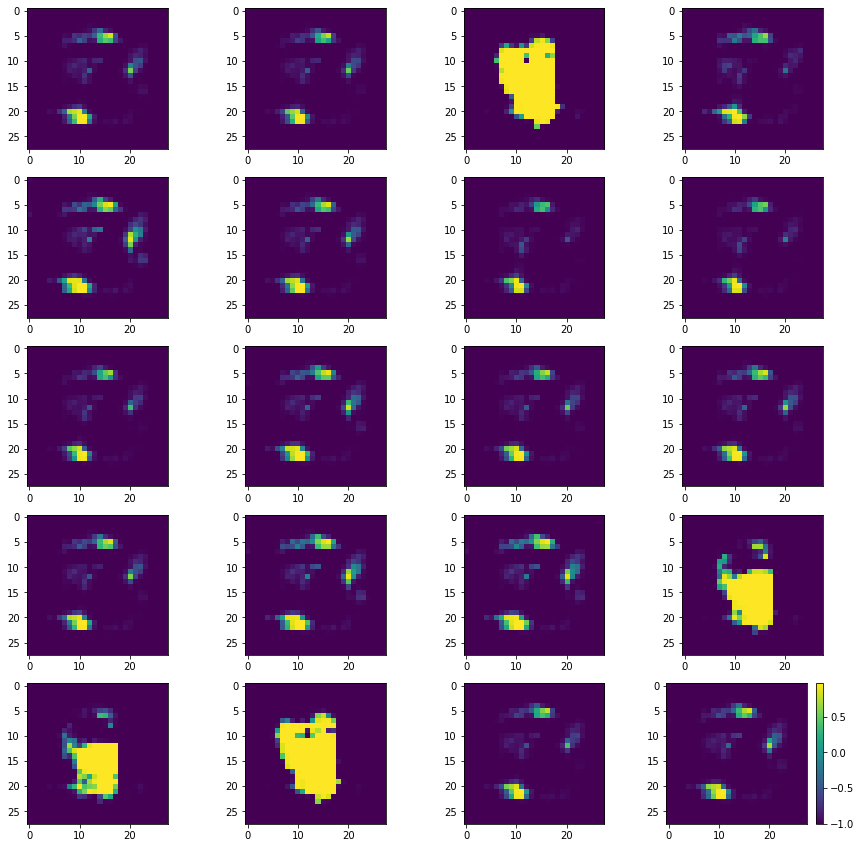

Batch_Num : 122
D_Loss   :   [10.678536415100098, 0.24860779941082, 10.42992877960205, 0.5, 0.126953125] ;    GAN_Loss   :  [17.54181671142578, 4.944281101226807, 12.597535133361816, 0.0, 0.119140625]
Batch_Num : 123
D_Loss   :   [10.002610206604004, 0.19154220819473267, 9.811067581176758, 0.494140625, 0.08984375] ;    GAN_Loss   :  [21.573497772216797, 8.11070728302002, 13.462791442871094, 0.0, 0.091796875]
Batch_Num : 124
D_Loss   :   [10.324624061584473, 0.19424176216125488, 10.130382537841797, 0.48046875, 0.103515625] ;    GAN_Loss   :  [21.94969940185547, 8.668618202209473, 13.28108024597168, 0.0, 0.119140625]
Batch_Num : 125
D_Loss   :   [10.482851028442383, 0.16499900817871094, 10.317852020263672, 0.498046875, 0.099609375] ;    GAN_Loss   :  [24.114566802978516, 9.756314277648926, 14.358253479003906, 0.0, 0.11328125]
Batch_Num : 126
D_Loss   :   [10.441672325134277, 0.18045231699943542, 10.26121997833252, 0.4921875, 0.0703125] ;    GAN_Loss   :  [23.825286865234375, 10.004827499

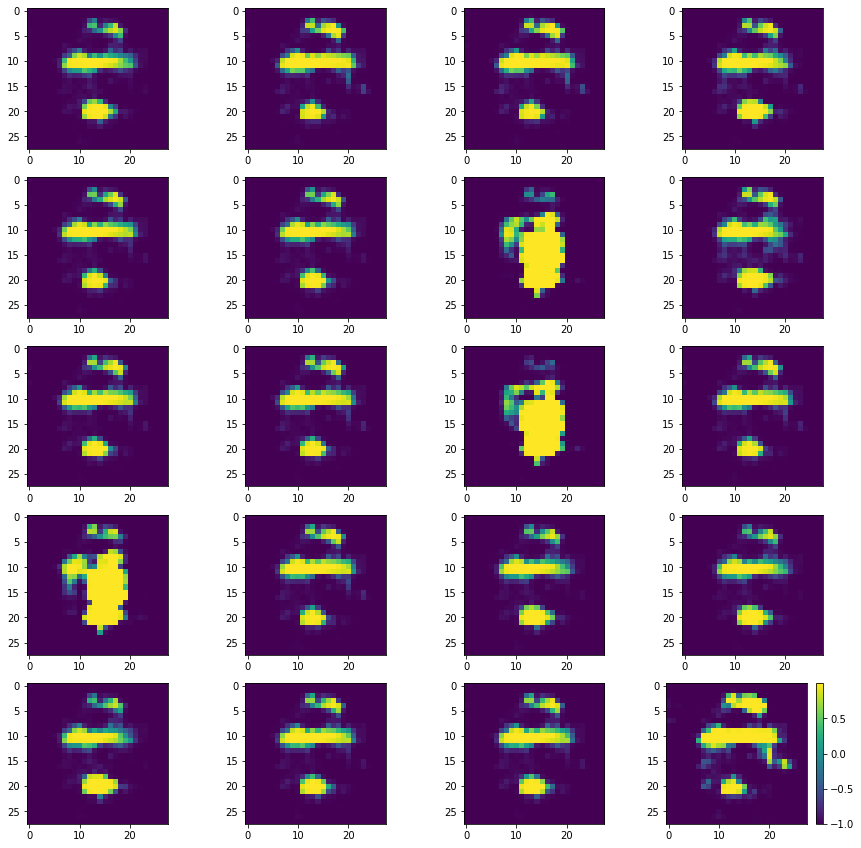

Batch_Num : 137
D_Loss   :   [10.941783905029297, 0.27701762318611145, 10.664766311645508, 0.490234375, 0.123046875] ;    GAN_Loss   :  [17.104944229125977, 4.610485076904297, 12.49445915222168, 0.0, 0.119140625]
Batch_Num : 138
D_Loss   :   [10.176637649536133, 0.24557071924209595, 9.931066513061523, 0.49609375, 0.125] ;    GAN_Loss   :  [17.476707458496094, 4.828521728515625, 12.648184776306152, 0.0, 0.1171875]
Batch_Num : 139
D_Loss   :   [10.069686889648438, 0.2489665001630783, 9.820720672607422, 0.474609375, 0.119140625] ;    GAN_Loss   :  [18.430953979492188, 5.465200424194336, 12.965754508972168, 0.0, 0.07421875]
Batch_Num : 140
D_Loss   :   [9.714285850524902, 0.2627147138118744, 9.451571464538574, 0.490234375, 0.1015625] ;    GAN_Loss   :  [18.882713317871094, 6.326150417327881, 12.556562423706055, 0.0, 0.095703125]
Batch_Num : 141
D_Loss   :   [10.28281307220459, 0.27696412801742554, 10.00584888458252, 0.494140625, 0.11328125] ;    GAN_Loss   :  [18.614686965942383, 5.8471236

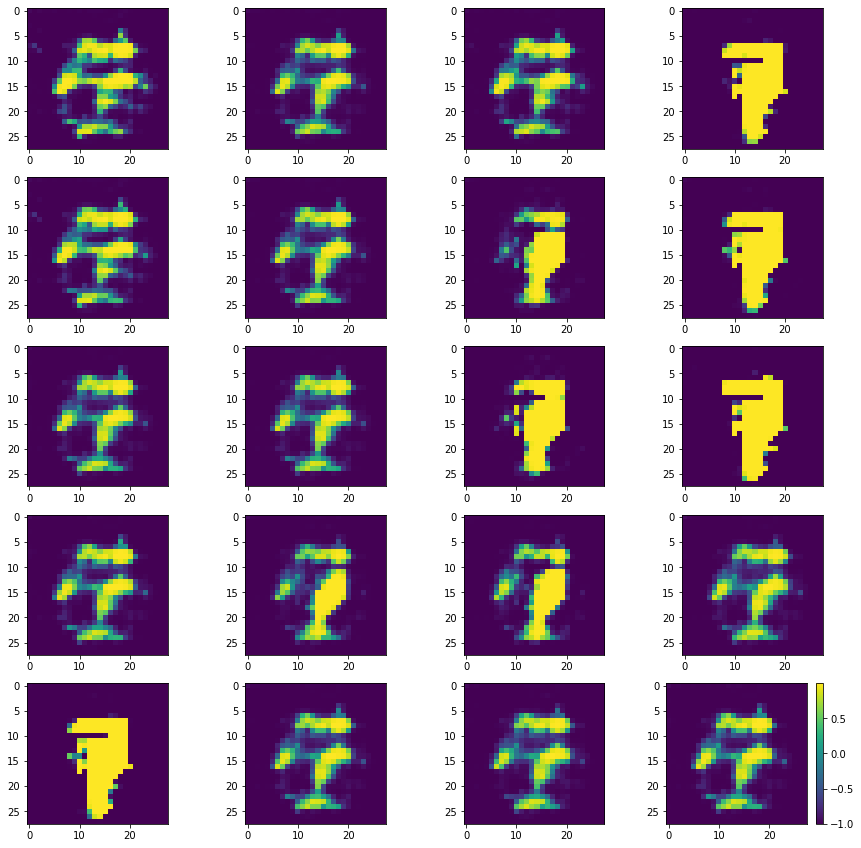

Batch_Num : 152
D_Loss   :   [10.014176368713379, 0.24886199831962585, 9.765314102172852, 0.5, 0.109375] ;    GAN_Loss   :  [11.783360481262207, 1.433034062385559, 10.350326538085938, 0.0, 0.091796875]
Batch_Num : 153
D_Loss   :   [10.199527740478516, 0.2575860023498535, 9.94194221496582, 0.5, 0.1015625] ;    GAN_Loss   :  [12.760274887084961, 1.8468385934829712, 10.913435935974121, 0.0, 0.107421875]
Batch_Num : 154
D_Loss   :   [10.156245231628418, 0.23051556944847107, 9.925729751586914, 0.5, 0.10546875] ;    GAN_Loss   :  [12.853349685668945, 2.0143113136291504, 10.839038848876953, 0.0, 0.1015625]
Batch_Num : 155
D_Loss   :   [10.551308631896973, 0.2395084947347641, 10.311800003051758, 0.5, 0.1015625] ;    GAN_Loss   :  [12.022092819213867, 1.6935769319534302, 10.328516006469727, 0.0, 0.08203125]
Batch_Num : 156
D_Loss   :   [9.647367477416992, 0.26576799154281616, 9.381599426269531, 0.4921875, 0.078125] ;    GAN_Loss   :  [12.28872013092041, 1.9160810708999634, 10.372638702392578, 0

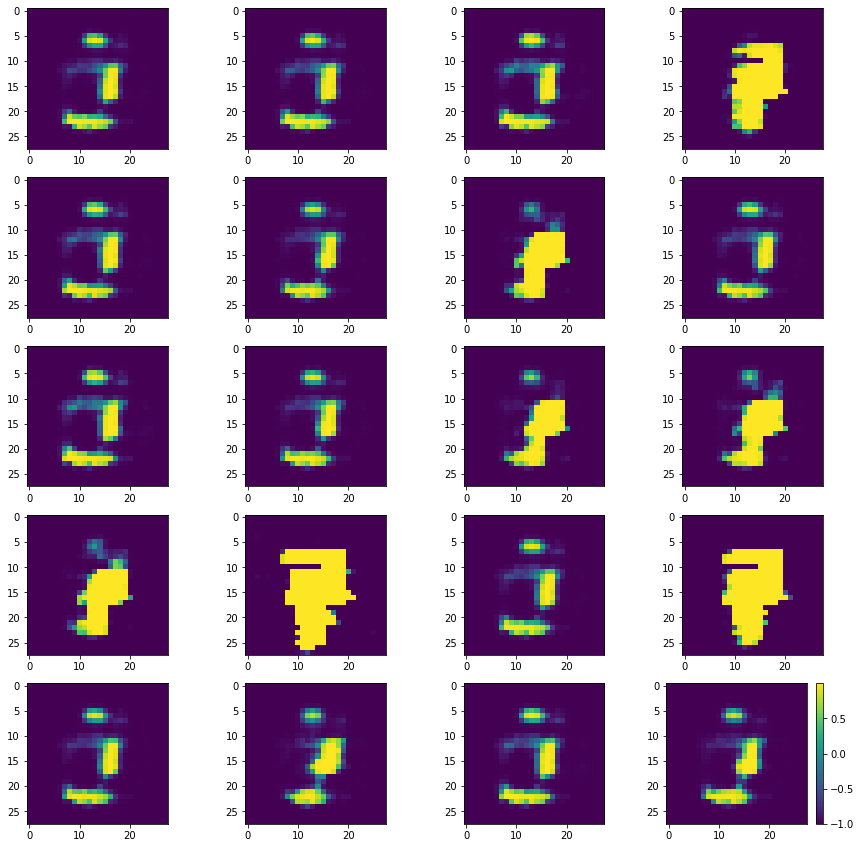

Batch_Num : 167
D_Loss   :   [10.628310203552246, 0.2011839747428894, 10.427125930786133, 0.5, 0.095703125] ;    GAN_Loss   :  [17.688749313354492, 6.053320407867432, 11.635429382324219, 0.0, 0.095703125]
Batch_Num : 168
D_Loss   :   [9.685413360595703, 0.2020466923713684, 9.483366966247559, 0.5, 0.109375] ;    GAN_Loss   :  [19.08115005493164, 6.972170829772949, 12.108979225158691, 0.0, 0.09375]
Batch_Num : 169
D_Loss   :   [10.131280899047852, 0.17753386497497559, 9.953746795654297, 0.498046875, 0.0859375] ;    GAN_Loss   :  [19.799854278564453, 7.583134651184082, 12.216719627380371, 0.0, 0.08203125]
Batch_Num : 170
D_Loss   :   [10.108885765075684, 0.1664227843284607, 9.942462921142578, 0.5, 0.09765625] ;    GAN_Loss   :  [20.539249420166016, 7.79790735244751, 12.741341590881348, 0.0, 0.08984375]
Batch_Num : 171
D_Loss   :   [10.511566162109375, 0.2105720341205597, 10.300993919372559, 0.5, 0.115234375] ;    GAN_Loss   :  [20.62441635131836, 8.15471076965332, 12.469705581665039, 0.0,

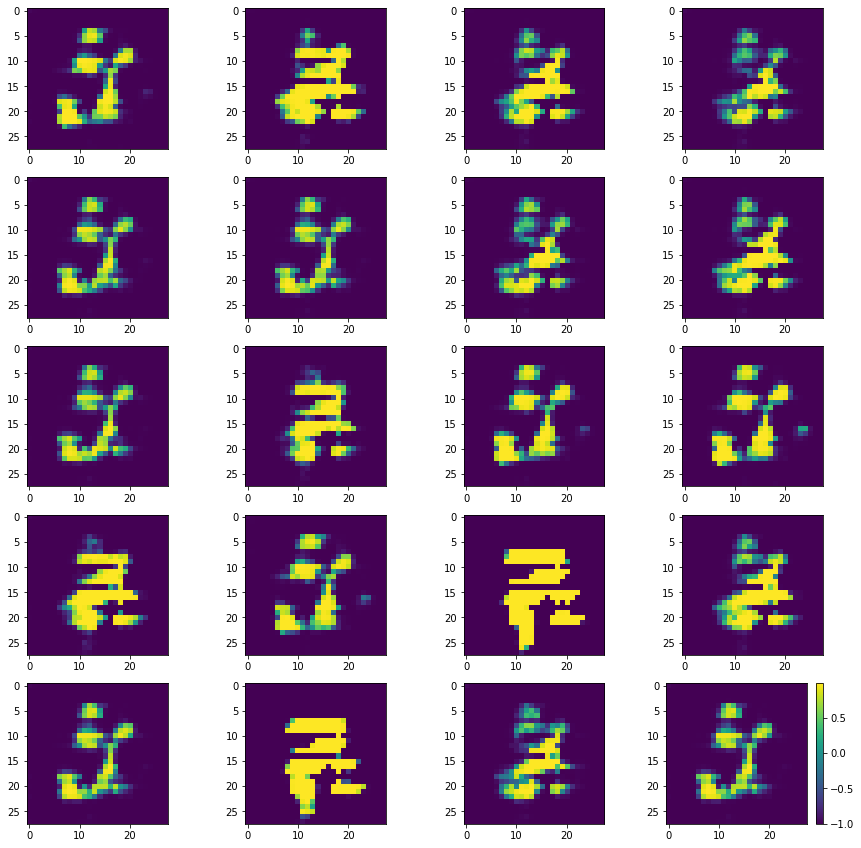

Batch_Num : 182
D_Loss   :   [9.779352188110352, 0.19622309505939484, 9.583128929138184, 0.5, 0.09765625] ;    GAN_Loss   :  [16.834360122680664, 5.34083366394043, 11.493526458740234, 0.0, 0.125]
Batch_Num : 183
D_Loss   :   [10.430219650268555, 0.19464212656021118, 10.235577583312988, 0.498046875, 0.095703125] ;    GAN_Loss   :  [16.297115325927734, 4.697506427764893, 11.599608421325684, 0.0, 0.115234375]
Batch_Num : 184
D_Loss   :   [9.923087120056152, 0.20235678553581238, 9.720730781555176, 0.5, 0.083984375] ;    GAN_Loss   :  [15.74846076965332, 4.163332462310791, 11.585127830505371, 0.0, 0.0859375]
Batch_Num : 185
D_Loss   :   [10.01168441772461, 0.21894900500774384, 9.79273509979248, 0.49609375, 0.1015625] ;    GAN_Loss   :  [15.196664810180664, 3.931018352508545, 11.265645980834961, 0.0, 0.103515625]
Batch_Num : 186
D_Loss   :   [9.602155685424805, 0.2210373878479004, 9.381117820739746, 0.498046875, 0.09375] ;    GAN_Loss   :  [15.006196975708008, 3.9235520362854004, 11.08264541

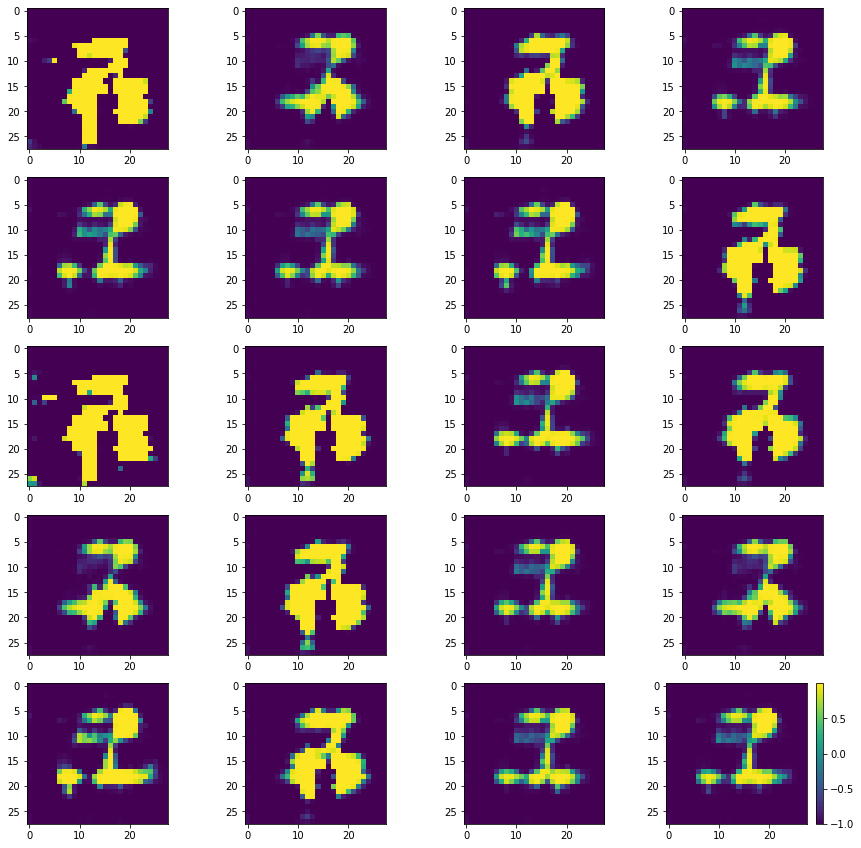

Batch_Num : 197
D_Loss   :   [10.0452880859375, 0.1956636607646942, 9.849624633789062, 0.494140625, 0.09375] ;    GAN_Loss   :  [13.981405258178711, 3.214785099029541, 10.766620635986328, 0.0, 0.08203125]
Batch_Num : 198
D_Loss   :   [9.75911808013916, 0.1981656402349472, 9.560952186584473, 0.49609375, 0.078125] ;    GAN_Loss   :  [14.791309356689453, 3.569162607192993, 11.222146987915039, 0.0, 0.095703125]
Batch_Num : 199
D_Loss   :   [10.659071922302246, 0.20658360421657562, 10.45248794555664, 0.486328125, 0.1171875] ;    GAN_Loss   :  [15.145956039428711, 4.034711837768555, 11.111244201660156, 0.0, 0.1015625]
Batch_Num : 200
D_Loss   :   [10.20665454864502, 0.17831268906593323, 10.028342247009277, 0.498046875, 0.10546875] ;    GAN_Loss   :  [15.305389404296875, 4.486108779907227, 10.819280624389648, 0.0, 0.08203125]
Batch_Num : 201
D_Loss   :   [10.445743560791016, 0.17763224244117737, 10.268111228942871, 0.498046875, 0.09765625] ;    GAN_Loss   :  [16.46261215209961, 5.037701606750

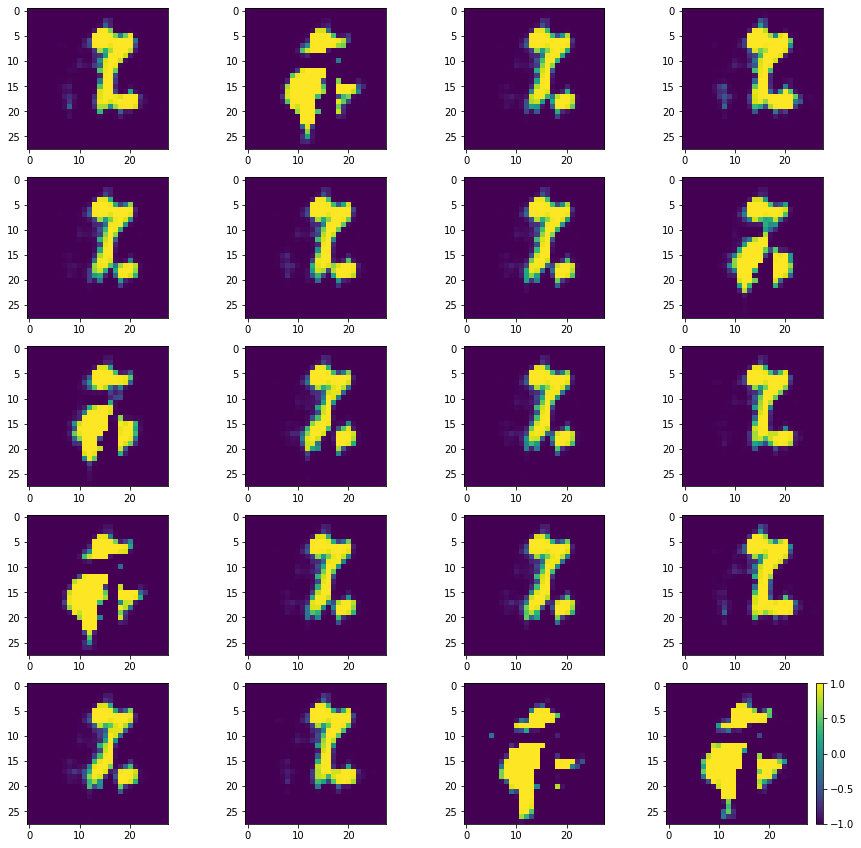

Batch_Num : 212
D_Loss   :   [10.952393531799316, 0.16359005868434906, 10.788803100585938, 0.5, 0.125] ;    GAN_Loss   :  [16.58382797241211, 4.7293243408203125, 11.854503631591797, 0.0, 0.095703125]
Batch_Num : 213
D_Loss   :   [9.619546890258789, 0.15128010511398315, 9.468266487121582, 0.5, 0.099609375] ;    GAN_Loss   :  [16.344280242919922, 4.78192138671875, 11.562358856201172, 0.0, 0.11328125]
Batch_Num : 214
D_Loss   :   [10.4034423828125, 0.16024117171764374, 10.24320125579834, 0.5, 0.09765625] ;    GAN_Loss   :  [17.156558990478516, 5.1427321434021, 12.013827323913574, 0.0, 0.111328125]
Batch_Num : 215
D_Loss   :   [9.262832641601562, 0.17597974836826324, 9.08685302734375, 0.5, 0.091796875] ;    GAN_Loss   :  [16.885467529296875, 5.395077228546143, 11.49039077758789, 0.0, 0.103515625]
Batch_Num : 216
D_Loss   :   [10.45709228515625, 0.1680920422077179, 10.289000511169434, 0.498046875, 0.107421875] ;    GAN_Loss   :  [18.1608943939209, 5.557368755340576, 12.603525161743164, 0.0,

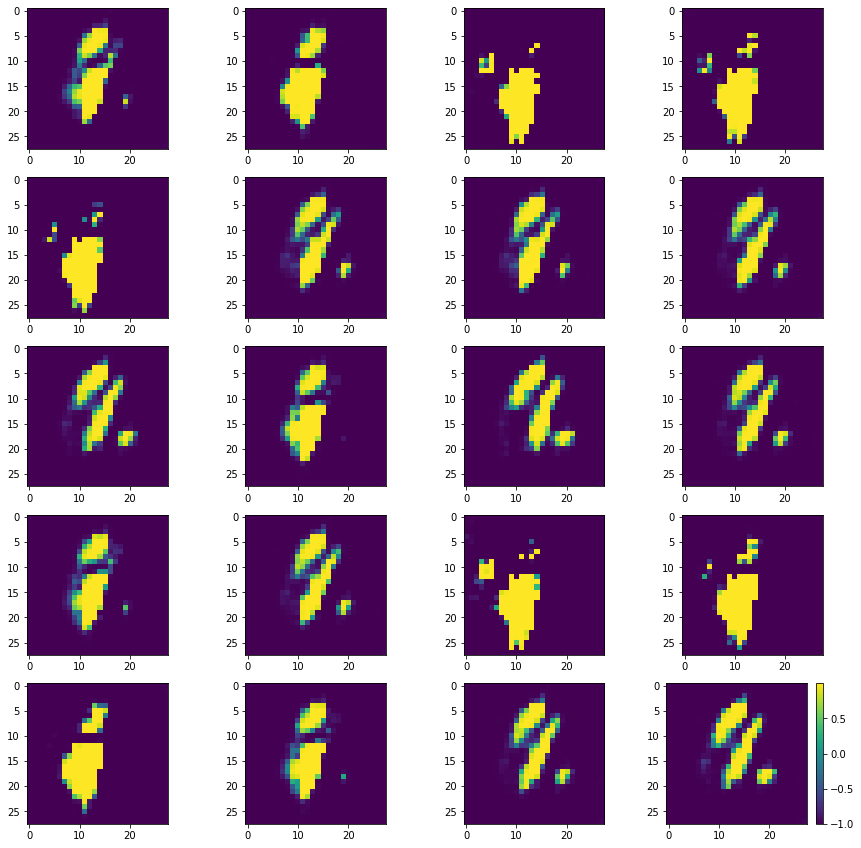

Batch_Num : 227
D_Loss   :   [9.30258560180664, 0.16920804977416992, 9.133377075195312, 0.5, 0.103515625] ;    GAN_Loss   :  [15.079998016357422, 3.8347296714782715, 11.245267868041992, 0.0, 0.095703125]
Batch_Num : 228
D_Loss   :   [10.422103881835938, 0.17699329555034637, 10.245110511779785, 0.5, 0.076171875] ;    GAN_Loss   :  [15.821977615356445, 3.797584295272827, 12.024393081665039, 0.0, 0.09765625]
Batch_Num : 229
D_Loss   :   [9.848280906677246, 0.1886470913887024, 9.65963363647461, 0.498046875, 0.107421875] ;    GAN_Loss   :  [14.51053524017334, 3.4583656787872314, 11.052169799804688, 0.0, 0.087890625]
Batch_Num : 230
D_Loss   :   [10.164339065551758, 0.1846257746219635, 9.979713439941406, 0.498046875, 0.087890625] ;    GAN_Loss   :  [15.873469352722168, 4.529370307922363, 11.344099044799805, 0.0, 0.08203125]
Batch_Num : 231
D_Loss   :   [10.410646438598633, 0.18260455131530762, 10.228041648864746, 0.5, 0.095703125] ;    GAN_Loss   :  [15.46352481842041, 4.07520866394043, 11.3

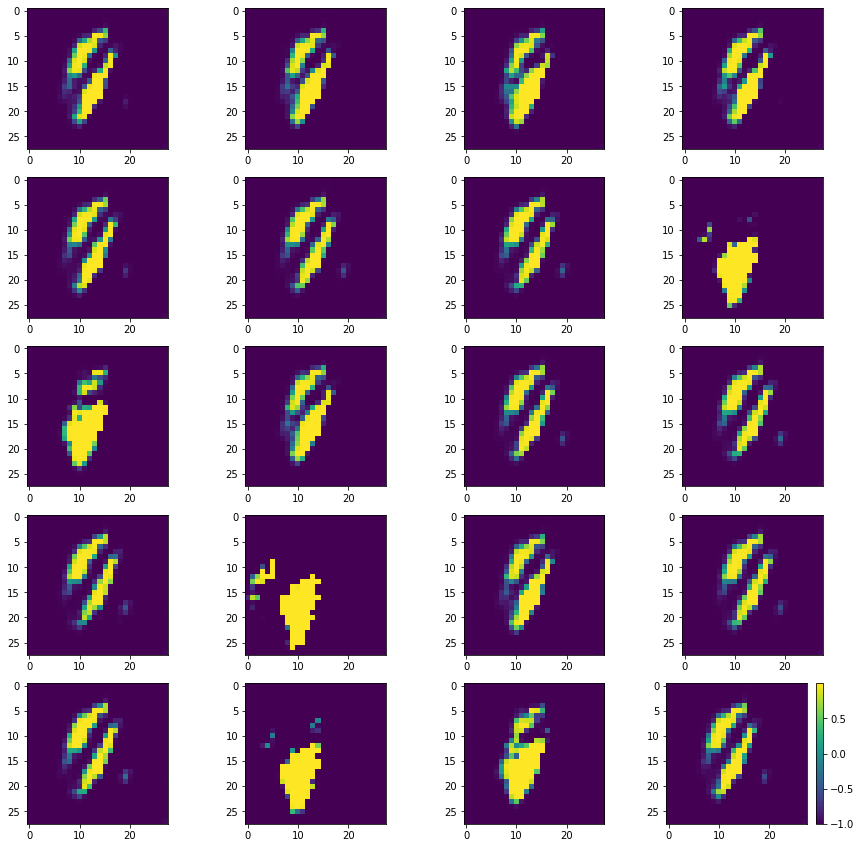

Batch_Num : 2
D_Loss   :   [10.230725288391113, 0.22860683500766754, 10.002118110656738, 0.482421875, 0.087890625] ;    GAN_Loss   :  [18.00979232788086, 5.613969802856445, 12.395822525024414, 0.0, 0.099609375]
Batch_Num : 3
D_Loss   :   [10.27712631225586, 0.20434170961380005, 10.072784423828125, 0.5, 0.1171875] ;    GAN_Loss   :  [18.101924896240234, 5.30003547668457, 12.801889419555664, 0.0, 0.087890625]
Batch_Num : 4
D_Loss   :   [10.422728538513184, 0.19317159056663513, 10.229557037353516, 0.5, 0.095703125] ;    GAN_Loss   :  [17.16692352294922, 4.747808933258057, 12.41911506652832, 0.0, 0.07421875]
Batch_Num : 5
D_Loss   :   [10.326926231384277, 0.2583755552768707, 10.068551063537598, 0.4765625, 0.08203125] ;    GAN_Loss   :  [18.862342834472656, 5.763297080993652, 13.09904670715332, 0.0, 0.07421875]
Batch_Num : 6
D_Loss   :   [10.550143241882324, 0.18864436447620392, 10.361498832702637, 0.5, 0.0859375] ;    GAN_Loss   :  [20.637859344482422, 6.142125129699707, 14.495734214782715

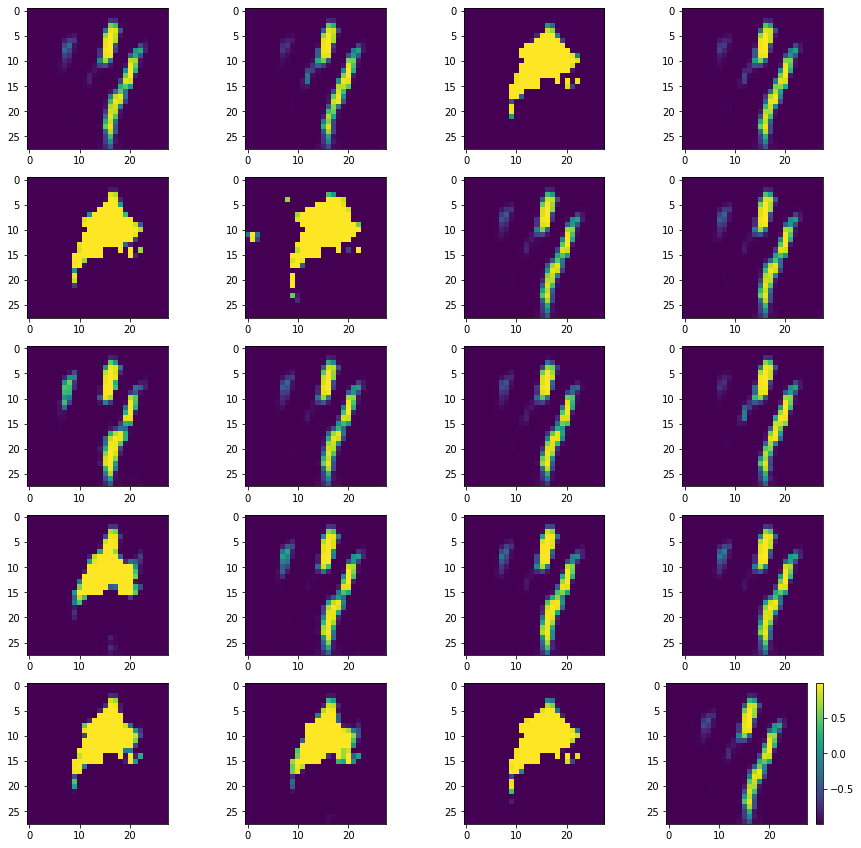

Batch_Num : 17
D_Loss   :   [10.00620174407959, 0.32657501101493835, 9.67962646484375, 0.484375, 0.111328125] ;    GAN_Loss   :  [20.031465530395508, 7.329675674438477, 12.701789855957031, 0.0, 0.109375]
Batch_Num : 18
D_Loss   :   [10.162630081176758, 0.3111594617366791, 9.851470947265625, 0.498046875, 0.115234375] ;    GAN_Loss   :  [23.40067481994629, 8.5448637008667, 14.85581111907959, 0.0, 0.07421875]
Batch_Num : 19
D_Loss   :   [10.138948440551758, 0.23557060956954956, 9.903377532958984, 0.5, 0.1171875] ;    GAN_Loss   :  [23.35340690612793, 8.503122329711914, 14.850284576416016, 0.0, 0.107421875]
Batch_Num : 20
D_Loss   :   [9.940116882324219, 0.22962571680545807, 9.710491180419922, 0.5, 0.09375] ;    GAN_Loss   :  [23.797222137451172, 8.988996505737305, 14.808225631713867, 0.0, 0.126953125]
Batch_Num : 21
D_Loss   :   [9.797809600830078, 0.2474236637353897, 9.550385475158691, 0.484375, 0.103515625] ;    GAN_Loss   :  [25.96792984008789, 10.288394927978516, 15.679535865783691, 0

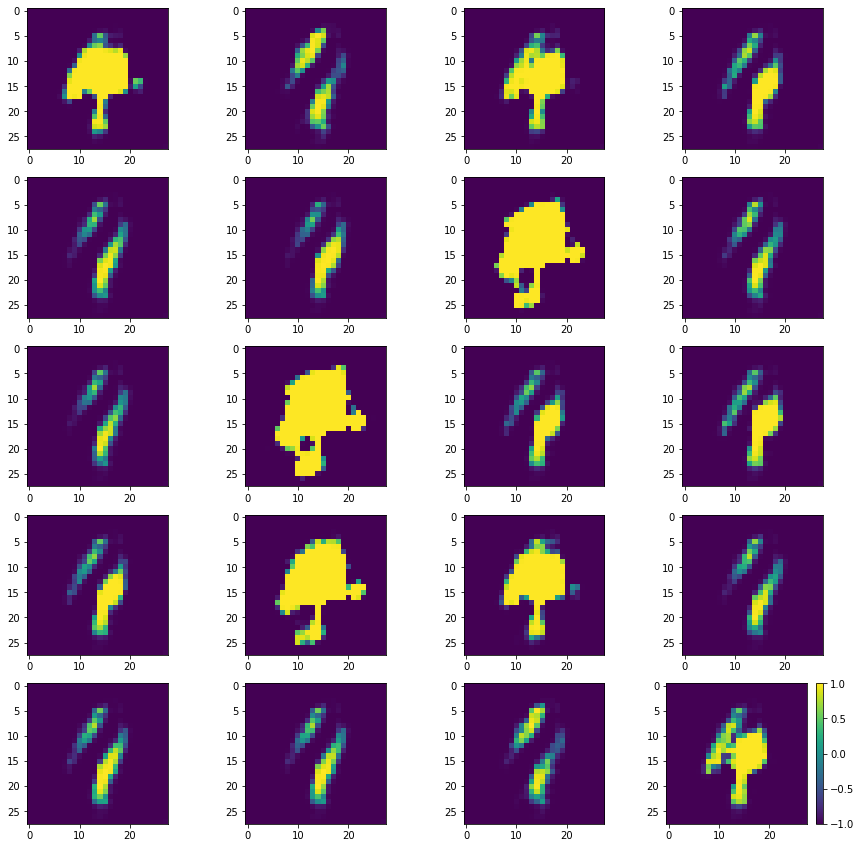

Batch_Num : 32
D_Loss   :   [10.13923168182373, 0.5177040100097656, 9.621527671813965, 0.298828125, 0.12109375] ;    GAN_Loss   :  [22.307518005371094, 9.321294784545898, 12.986224174499512, 0.0, 0.119140625]
Batch_Num : 33
D_Loss   :   [10.681127548217773, 0.3673749268054962, 10.313752174377441, 0.5, 0.103515625] ;    GAN_Loss   :  [25.24117660522461, 13.665412902832031, 11.575763702392578, 0.0, 0.11328125]
Batch_Num : 34
D_Loss   :   [10.603365898132324, 0.35066917538642883, 10.252696990966797, 0.447265625, 0.091796875] ;    GAN_Loss   :  [19.58496856689453, 8.075654983520508, 11.50931453704834, 0.0, 0.08984375]
Batch_Num : 35
D_Loss   :   [9.910066604614258, 0.4371452033519745, 9.472921371459961, 0.34765625, 0.048828125] ;    GAN_Loss   :  [21.800445556640625, 9.16883659362793, 12.631608963012695, 0.0, 0.056640625]
Batch_Num : 36
D_Loss   :   [9.90939712524414, 0.34650832414627075, 9.562889099121094, 0.5, 0.048828125] ;    GAN_Loss   :  [22.27945899963379, 8.538841247558594, 13.7406

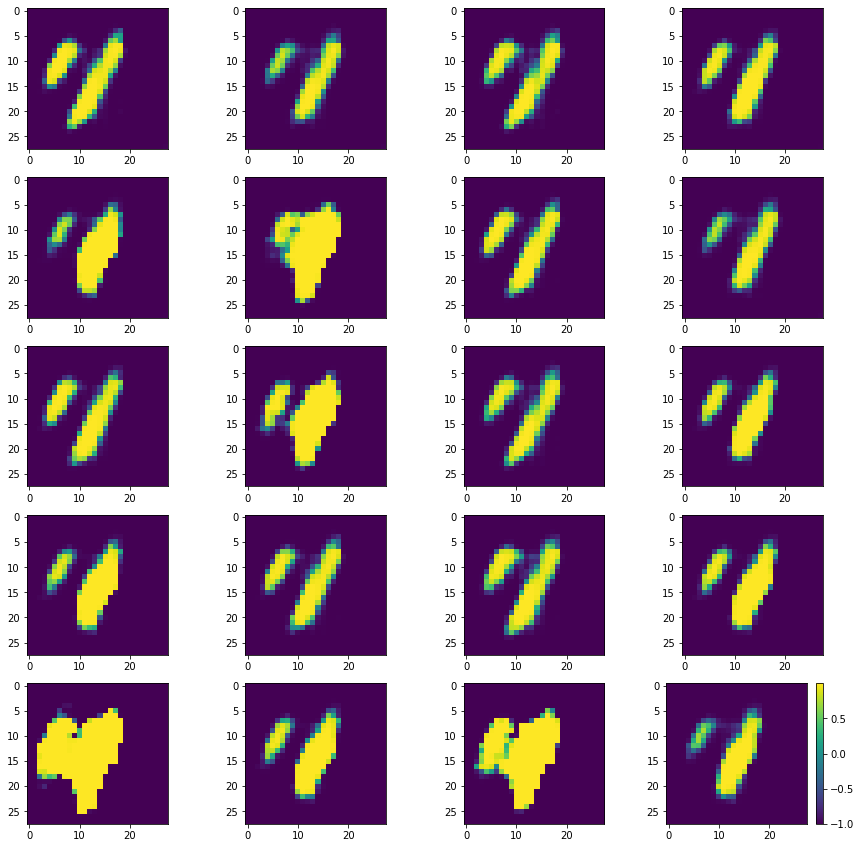

Batch_Num : 47
D_Loss   :   [10.813037872314453, 0.27095845341682434, 10.542078971862793, 0.5, 0.083984375] ;    GAN_Loss   :  [22.763843536376953, 5.504548072814941, 17.259296417236328, 0.0, 0.091796875]
Batch_Num : 48
D_Loss   :   [10.252324104309082, 0.24347004294395447, 10.008853912353516, 0.5, 0.0859375] ;    GAN_Loss   :  [22.86042022705078, 5.508068084716797, 17.352352142333984, 0.0, 0.109375]
Batch_Num : 49
D_Loss   :   [10.11827564239502, 0.2057734876871109, 9.91250228881836, 0.5, 0.099609375] ;    GAN_Loss   :  [22.735187530517578, 6.197633743286133, 16.537553787231445, 0.0, 0.09765625]
Batch_Num : 50
D_Loss   :   [9.851299285888672, 0.1995777040719986, 9.651721954345703, 0.5, 0.10546875] ;    GAN_Loss   :  [21.65858268737793, 6.3168864250183105, 15.341696739196777, 0.0, 0.080078125]
Batch_Num : 51
D_Loss   :   [10.51804256439209, 0.23294919729232788, 10.285093307495117, 0.494140625, 0.0859375] ;    GAN_Loss   :  [21.89015769958496, 6.626650333404541, 15.263506889343262, 0.0,

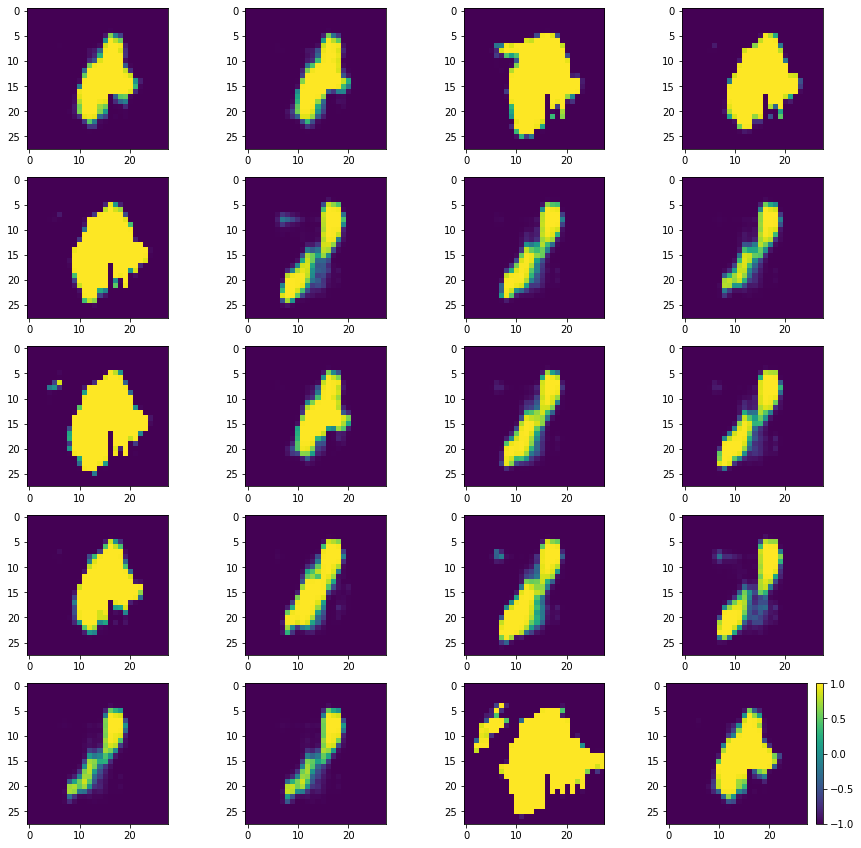

Batch_Num : 62
D_Loss   :   [9.800545692443848, 0.1671900451183319, 9.633356094360352, 0.49609375, 0.095703125] ;    GAN_Loss   :  [20.379070281982422, 7.334238529205322, 13.044831275939941, 0.0, 0.1328125]
Batch_Num : 63
D_Loss   :   [10.0968017578125, 0.18540102243423462, 9.91140079498291, 0.498046875, 0.09375] ;    GAN_Loss   :  [19.50429916381836, 7.056972503662109, 12.44732666015625, 0.0, 0.14453125]
Batch_Num : 64
D_Loss   :   [10.06437873840332, 0.18404783308506012, 9.880331039428711, 0.49609375, 0.1171875] ;    GAN_Loss   :  [19.03740882873535, 6.893243789672852, 12.1441650390625, 0.0, 0.1328125]
Batch_Num : 65
D_Loss   :   [10.168306350708008, 0.1612471491098404, 10.007059097290039, 0.494140625, 0.095703125] ;    GAN_Loss   :  [20.07132911682129, 7.147427082061768, 12.923901557922363, 0.0, 0.13671875]
Batch_Num : 66
D_Loss   :   [10.8087158203125, 0.16900263726711273, 10.639713287353516, 0.498046875, 0.09765625] ;    GAN_Loss   :  [19.01079750061035, 6.888786792755127, 12.1220

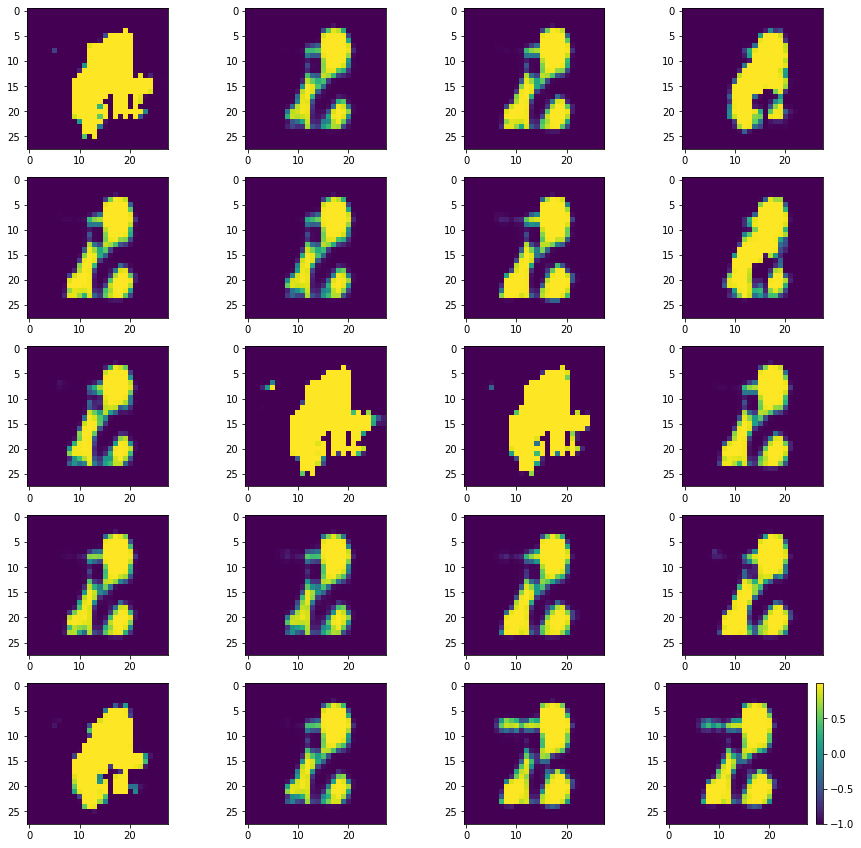

Batch_Num : 77
D_Loss   :   [10.175057411193848, 0.23408682644367218, 9.940970420837402, 0.498046875, 0.07421875] ;    GAN_Loss   :  [15.355698585510254, 4.569684028625488, 10.786014556884766, 0.0, 0.099609375]
Batch_Num : 78
D_Loss   :   [9.74870491027832, 0.1863936334848404, 9.562311172485352, 0.498046875, 0.056640625] ;    GAN_Loss   :  [18.250349044799805, 5.943795204162598, 12.306553840637207, 0.0, 0.078125]
Batch_Num : 79
D_Loss   :   [10.4783296585083, 0.13048754632472992, 10.3478422164917, 0.5, 0.0859375] ;    GAN_Loss   :  [19.123291015625, 6.631779670715332, 12.491510391235352, 0.0, 0.087890625]
Batch_Num : 80
D_Loss   :   [10.026529312133789, 0.1361660361289978, 9.890363693237305, 0.5, 0.09375] ;    GAN_Loss   :  [19.059249877929688, 6.6958842277526855, 12.363365173339844, 0.0, 0.099609375]
Batch_Num : 81
D_Loss   :   [10.256702423095703, 0.1324649304151535, 10.124237060546875, 0.5, 0.09375] ;    GAN_Loss   :  [16.977928161621094, 5.8187665939331055, 11.159162521362305, 0.0,

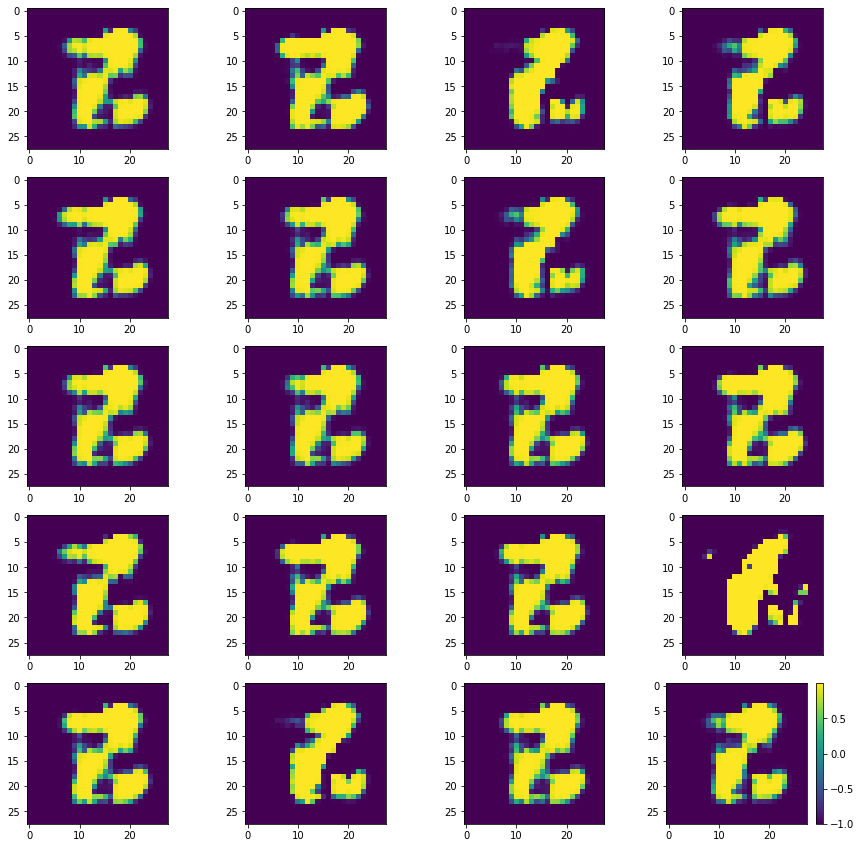

Batch_Num : 92
D_Loss   :   [10.141928672790527, 0.12662380933761597, 10.015304565429688, 0.5, 0.068359375] ;    GAN_Loss   :  [15.4213228225708, 3.759903907775879, 11.661418914794922, 0.0, 0.080078125]
Batch_Num : 93
D_Loss   :   [10.575943946838379, 0.12313138693571091, 10.452812194824219, 0.5, 0.10546875] ;    GAN_Loss   :  [14.834015846252441, 3.67153263092041, 11.162483215332031, 0.0, 0.08203125]
Batch_Num : 94
D_Loss   :   [9.996466636657715, 0.12442143261432648, 9.872045516967773, 0.5, 0.09375] ;    GAN_Loss   :  [14.675036430358887, 3.431877851486206, 11.243158340454102, 0.0, 0.08984375]
Batch_Num : 95
D_Loss   :   [10.17950439453125, 0.12730169296264648, 10.052202224731445, 0.5, 0.091796875] ;    GAN_Loss   :  [14.693421363830566, 3.275724411010742, 11.417696952819824, 0.0, 0.056640625]
Batch_Num : 96
D_Loss   :   [9.73367691040039, 0.1274554431438446, 9.606221199035645, 0.5, 0.1015625] ;    GAN_Loss   :  [14.156671524047852, 3.182617664337158, 10.974053382873535, 0.0, 0.07031

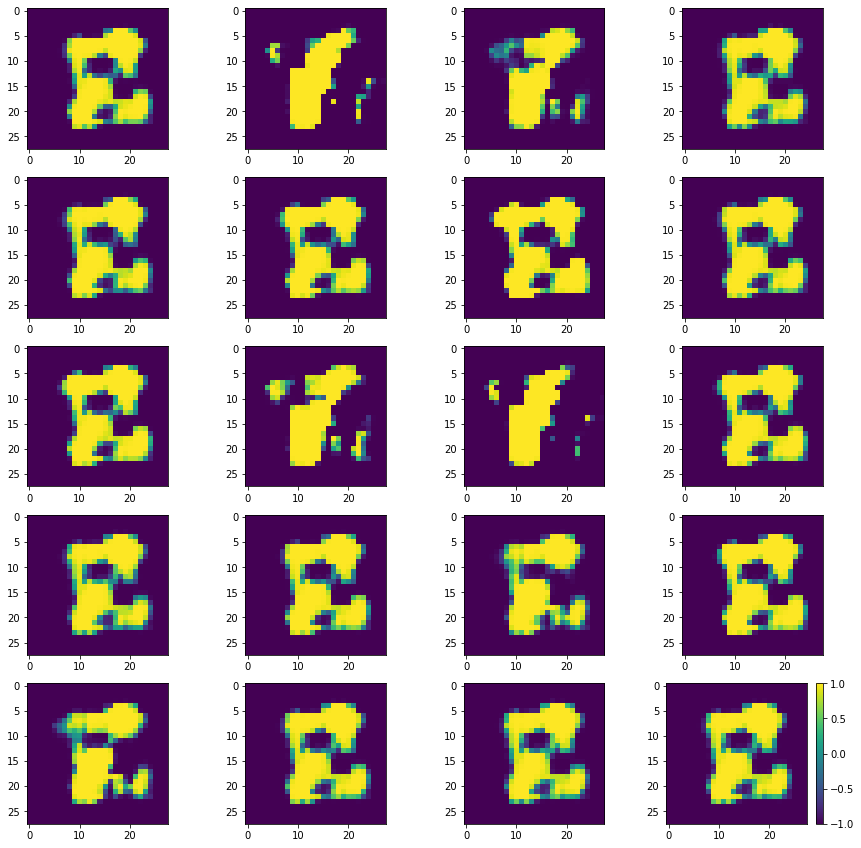

Batch_Num : 107
D_Loss   :   [10.001991271972656, 0.12243647128343582, 9.879554748535156, 0.5, 0.0859375] ;    GAN_Loss   :  [13.869429588317871, 2.7112510204315186, 11.158178329467773, 0.0, 0.064453125]
Batch_Num : 108
D_Loss   :   [9.420472145080566, 0.11710939556360245, 9.303362846374512, 0.5, 0.068359375] ;    GAN_Loss   :  [13.325942993164062, 2.8084301948547363, 10.517512321472168, 0.0, 0.072265625]
Batch_Num : 109
D_Loss   :   [9.640935897827148, 0.11614614725112915, 9.524789810180664, 0.5, 0.07421875] ;    GAN_Loss   :  [13.469195365905762, 2.672675371170044, 10.796520233154297, 0.0, 0.05859375]
Batch_Num : 110
D_Loss   :   [10.355905532836914, 0.13252919912338257, 10.223376274108887, 0.5, 0.078125] ;    GAN_Loss   :  [13.928205490112305, 2.6224851608276367, 11.305720329284668, 0.0, 0.0703125]
Batch_Num : 111
D_Loss   :   [9.539339065551758, 0.1351744681596756, 9.40416431427002, 0.5, 0.083984375] ;    GAN_Loss   :  [13.02001953125, 2.5394814014434814, 10.480538368225098, 0.0, 0

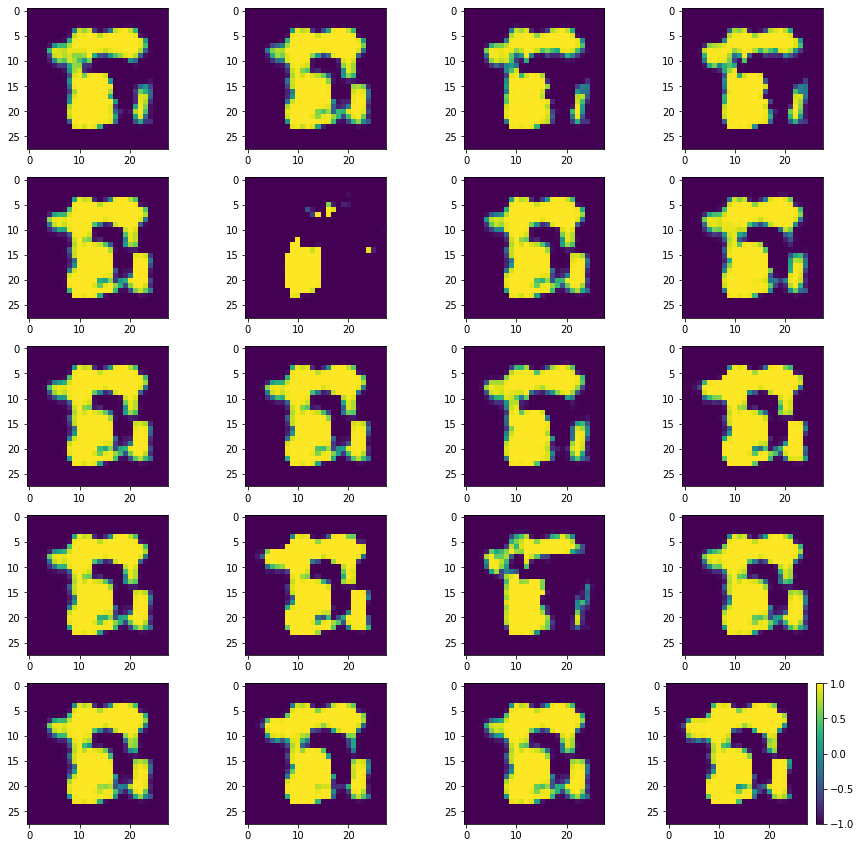

Batch_Num : 122
D_Loss   :   [10.539556503295898, 0.13315758109092712, 10.40639877319336, 0.5, 0.08984375] ;    GAN_Loss   :  [14.572550773620605, 3.4207565784454346, 11.15179443359375, 0.0, 0.099609375]
Batch_Num : 123
D_Loss   :   [9.927364349365234, 0.14832055568695068, 9.779044151306152, 0.5, 0.10546875] ;    GAN_Loss   :  [13.790794372558594, 2.970083713531494, 10.820710182189941, 0.0, 0.060546875]
Batch_Num : 124
D_Loss   :   [10.247701644897461, 0.12631040811538696, 10.121391296386719, 0.5, 0.08984375] ;    GAN_Loss   :  [13.293169975280762, 2.623440980911255, 10.669729232788086, 0.0, 0.083984375]
Batch_Num : 125
D_Loss   :   [10.427668571472168, 0.12688742578029633, 10.30078125, 0.5, 0.09765625] ;    GAN_Loss   :  [13.290578842163086, 2.6615827083587646, 10.628995895385742, 0.0, 0.0625]
Batch_Num : 126
D_Loss   :   [10.382707595825195, 0.1349179744720459, 10.24778938293457, 0.5, 0.091796875] ;    GAN_Loss   :  [13.640081405639648, 2.852893352508545, 10.787187576293945, 0.0, 0.0

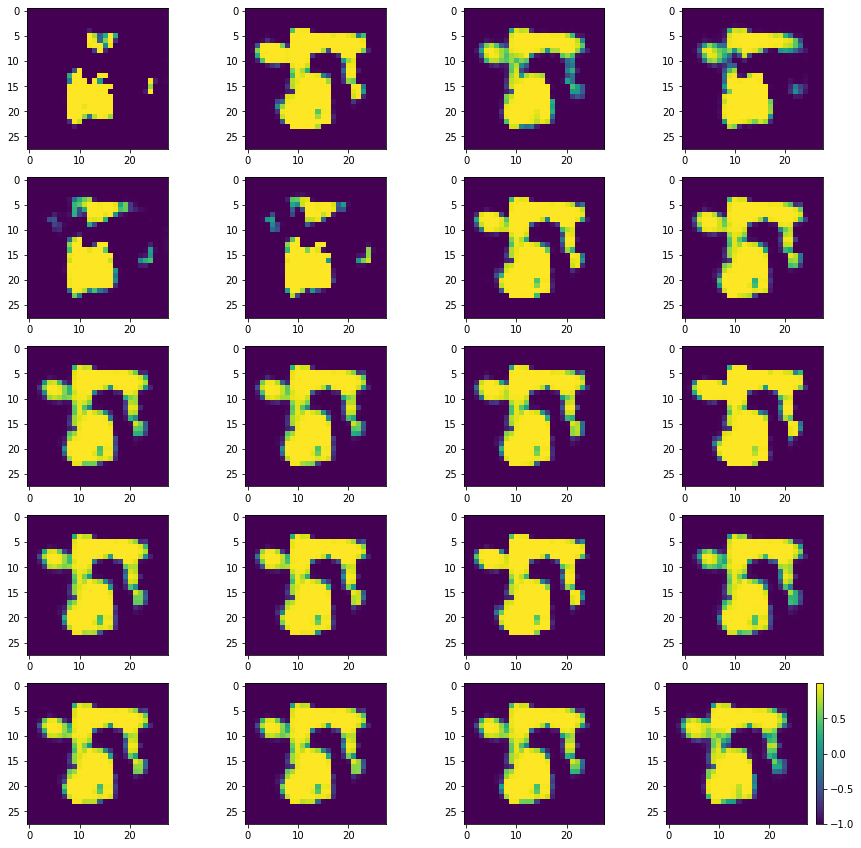

Batch_Num : 137
D_Loss   :   [10.763352394104004, 0.13341030478477478, 10.629941940307617, 0.5, 0.10546875] ;    GAN_Loss   :  [11.795948028564453, 1.3873615264892578, 10.408586502075195, 0.0, 0.091796875]
Batch_Num : 138
D_Loss   :   [10.01928424835205, 0.12604841589927673, 9.89323616027832, 0.494140625, 0.09375] ;    GAN_Loss   :  [11.93637752532959, 1.7531764507293701, 10.18320083618164, 0.0, 0.09765625]
Batch_Num : 139
D_Loss   :   [9.940994262695312, 0.13885560631752014, 9.802138328552246, 0.5, 0.09375] ;    GAN_Loss   :  [12.037610054016113, 1.8957659006118774, 10.141843795776367, 0.0, 0.087890625]
Batch_Num : 140
D_Loss   :   [9.538922309875488, 0.140414297580719, 9.398508071899414, 0.498046875, 0.09765625] ;    GAN_Loss   :  [12.054106712341309, 1.667466163635254, 10.386640548706055, 0.0, 0.10546875]
Batch_Num : 141
D_Loss   :   [10.102187156677246, 0.13067519664764404, 9.971511840820312, 0.494140625, 0.103515625] ;    GAN_Loss   :  [12.140803337097168, 1.880956768989563, 10.25

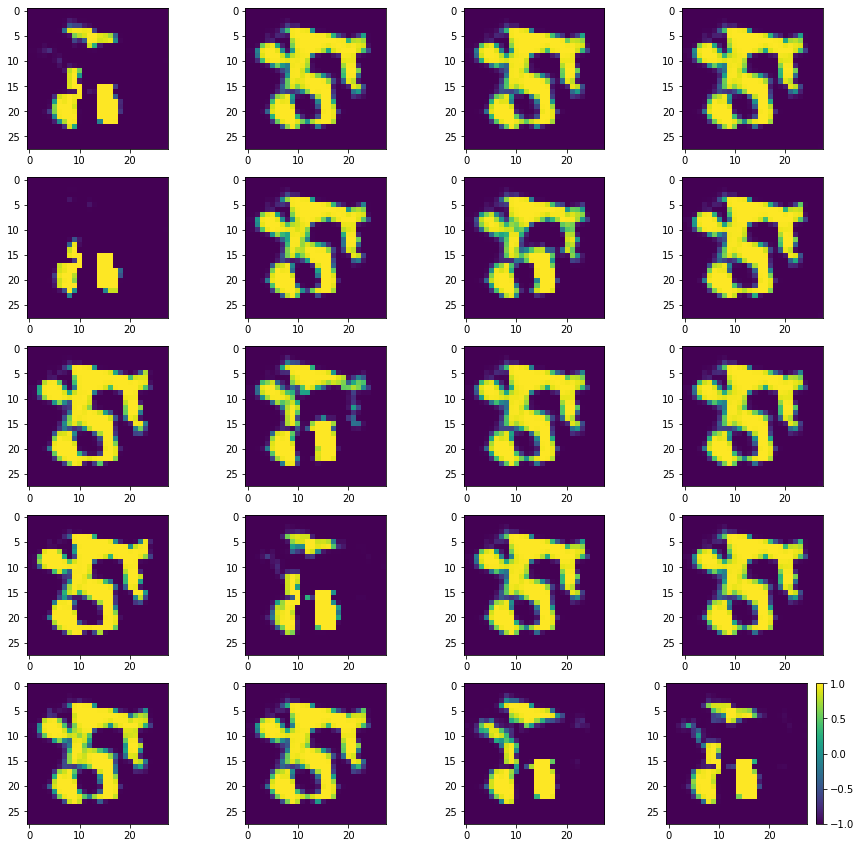

Batch_Num : 152
D_Loss   :   [9.803191184997559, 0.1299300491809845, 9.673260688781738, 0.494140625, 0.09765625] ;    GAN_Loss   :  [11.475390434265137, 1.0615909099578857, 10.413799285888672, 0.0, 0.060546875]
Batch_Num : 153
D_Loss   :   [10.065786361694336, 0.13383838534355164, 9.931947708129883, 0.5, 0.099609375] ;    GAN_Loss   :  [10.795816421508789, 1.0160208940505981, 9.77979564666748, 0.0, 0.091796875]
Batch_Num : 154
D_Loss   :   [10.03429126739502, 0.13518063724040985, 9.899110794067383, 0.498046875, 0.10546875] ;    GAN_Loss   :  [11.582548141479492, 0.9427251815795898, 10.639822959899902, 0.0, 0.09765625]
Batch_Num : 155
D_Loss   :   [10.397039413452148, 0.1325758695602417, 10.264463424682617, 0.5, 0.095703125] ;    GAN_Loss   :  [11.094188690185547, 0.9351503252983093, 10.159038543701172, 0.0, 0.1015625]
Batch_Num : 156
D_Loss   :   [9.509323120117188, 0.13574641942977905, 9.373577117919922, 0.49609375, 0.138671875] ;    GAN_Loss   :  [10.180500030517578, 0.90753728151321

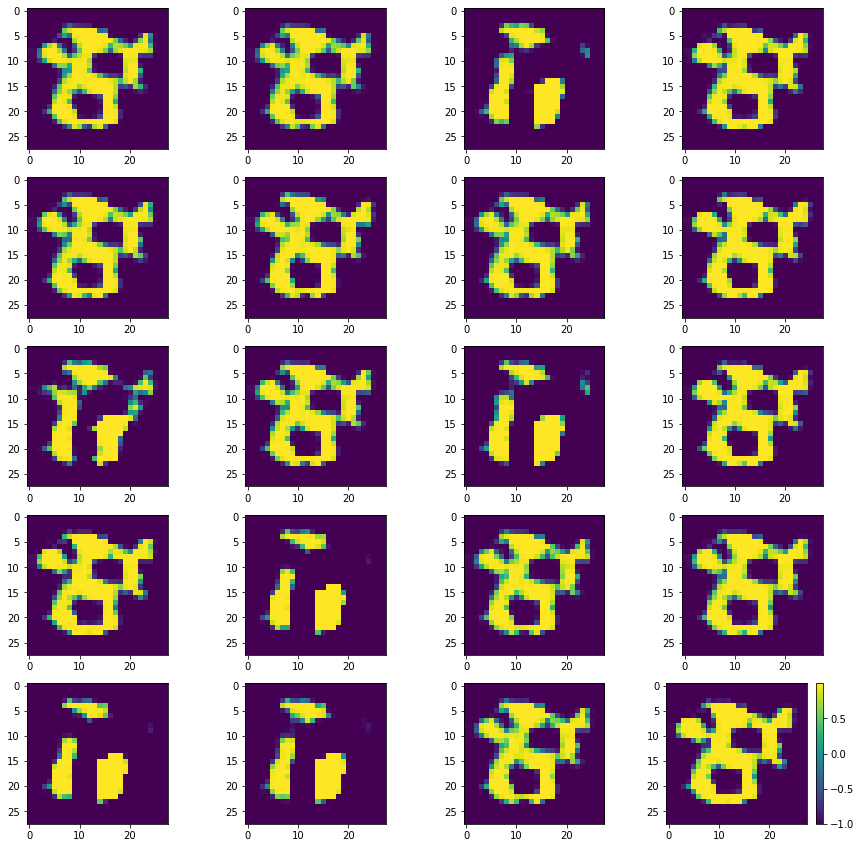

Batch_Num : 167
D_Loss   :   [10.512870788574219, 0.11773772537708282, 10.395133018493652, 0.5, 0.123046875] ;    GAN_Loss   :  [10.209637641906738, 0.8350516557693481, 9.37458610534668, 0.0, 0.0703125]
Batch_Num : 168
D_Loss   :   [9.549432754516602, 0.11945060640573502, 9.42998218536377, 0.5, 0.095703125] ;    GAN_Loss   :  [11.4154691696167, 0.8310524225234985, 10.584416389465332, 0.0, 0.0859375]
Batch_Num : 169
D_Loss   :   [10.060504913330078, 0.11632625758647919, 9.944178581237793, 0.5, 0.0859375] ;    GAN_Loss   :  [11.421537399291992, 0.9603348970413208, 10.461202621459961, 0.0, 0.10546875]
Batch_Num : 170
D_Loss   :   [10.050680160522461, 0.12158221751451492, 9.929098129272461, 0.5, 0.1328125] ;    GAN_Loss   :  [11.180527687072754, 0.8762139678001404, 10.304313659667969, 0.0, 0.083984375]
Batch_Num : 171
D_Loss   :   [10.397337913513184, 0.12563784420490265, 10.271699905395508, 0.5, 0.11328125] ;    GAN_Loss   :  [10.765946388244629, 0.9489791989326477, 9.816967010498047, 0.0

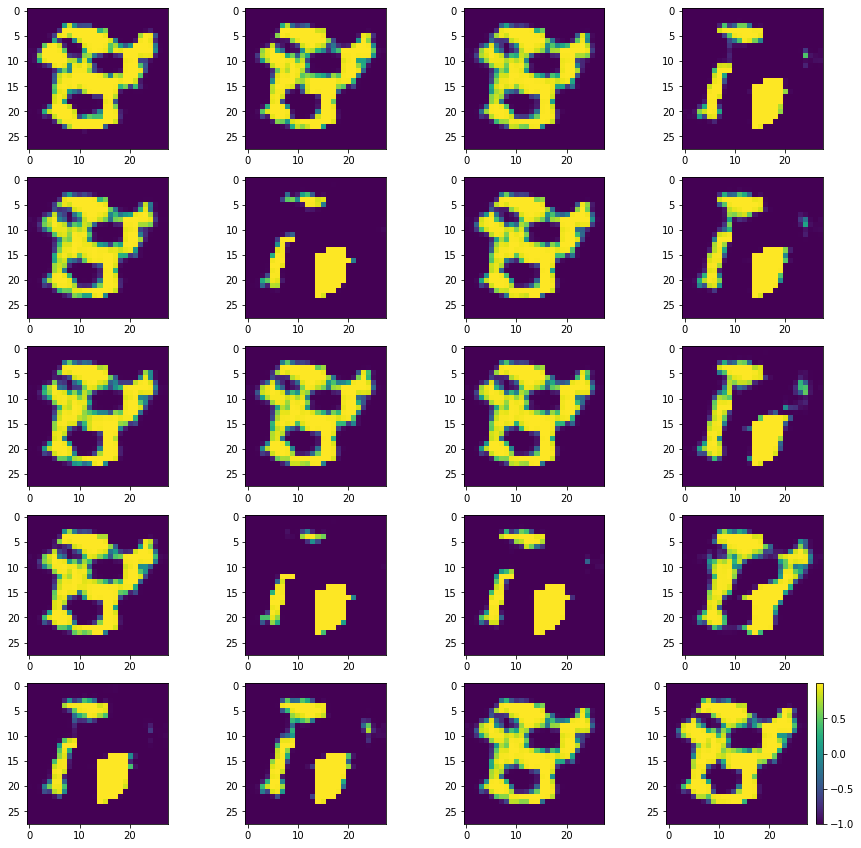

Batch_Num : 182
D_Loss   :   [9.695724487304688, 0.11887569725513458, 9.576848983764648, 0.5, 0.08984375] ;    GAN_Loss   :  [10.670804023742676, 0.8797553181648254, 9.791049003601074, 0.0, 0.083984375]
Batch_Num : 183
D_Loss   :   [10.339808464050293, 0.11225433647632599, 10.227554321289062, 0.5, 0.080078125] ;    GAN_Loss   :  [10.877974510192871, 0.7276151776313782, 10.150359153747559, 0.0, 0.08984375]
Batch_Num : 184
D_Loss   :   [9.82089614868164, 0.11533960700035095, 9.705556869506836, 0.5, 0.06640625] ;    GAN_Loss   :  [11.116839408874512, 0.6420968770980835, 10.474742889404297, 0.0, 0.078125]
Batch_Num : 185
D_Loss   :   [9.91081714630127, 0.12747249007225037, 9.783344268798828, 0.5, 0.09375] ;    GAN_Loss   :  [10.87094783782959, 0.6946361064910889, 10.176311492919922, 0.0, 0.0859375]
Batch_Num : 186
D_Loss   :   [9.486032485961914, 0.11500698328018188, 9.371025085449219, 0.5, 0.078125] ;    GAN_Loss   :  [11.007164001464844, 0.7346745133399963, 10.272489547729492, 0.0, 0.082

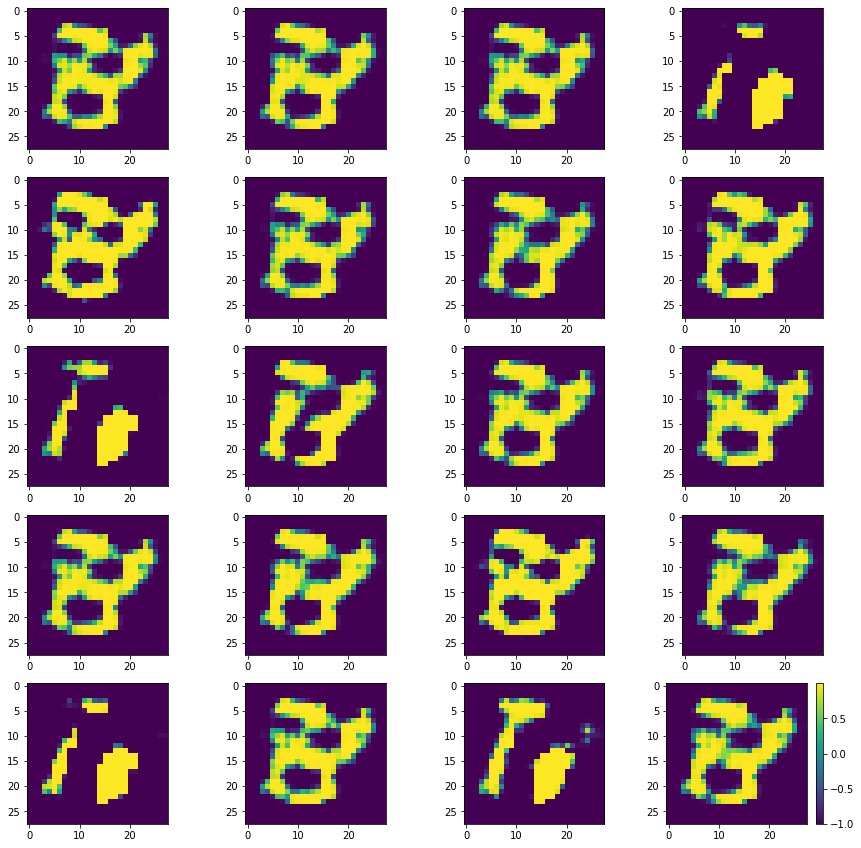

Batch_Num : 197
D_Loss   :   [9.94970989227295, 0.11594942212104797, 9.833760261535645, 0.5, 0.083984375] ;    GAN_Loss   :  [10.823287963867188, 0.5468168258666992, 10.276471138000488, 0.0, 0.09765625]
Batch_Num : 198
D_Loss   :   [9.66003131866455, 0.11859815567731857, 9.541433334350586, 0.5, 0.0859375] ;    GAN_Loss   :  [10.92477798461914, 0.547452449798584, 10.377325057983398, 0.0, 0.12890625]
Batch_Num : 199
D_Loss   :   [10.548279762268066, 0.11485368758440018, 10.433425903320312, 0.5, 0.080078125] ;    GAN_Loss   :  [10.167391777038574, 0.5595618486404419, 9.607830047607422, 0.0, 0.09375]
Batch_Num : 200
D_Loss   :   [10.124039649963379, 0.11132703721523285, 10.012712478637695, 0.5, 0.076171875] ;    GAN_Loss   :  [10.933577537536621, 0.6590573191642761, 10.274519920349121, 0.0, 0.083984375]
Batch_Num : 201
D_Loss   :   [10.360350608825684, 0.1141594722867012, 10.246191024780273, 0.5, 0.09375] ;    GAN_Loss   :  [10.853185653686523, 0.6187353730201721, 10.234450340270996, 0.0, 

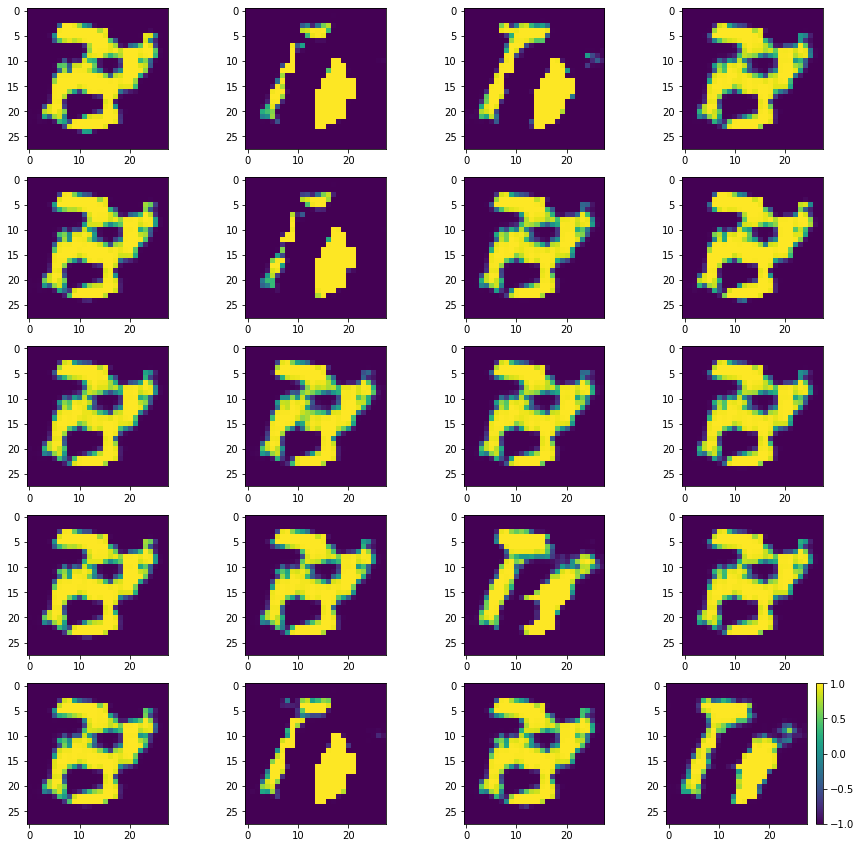

Batch_Num : 212
D_Loss   :   [10.89489459991455, 0.11684230715036392, 10.77805233001709, 0.5, 0.08984375] ;    GAN_Loss   :  [10.572059631347656, 0.4304537773132324, 10.141605377197266, 0.0, 0.11328125]
Batch_Num : 213
D_Loss   :   [9.573927879333496, 0.11102670431137085, 9.46290111541748, 0.5, 0.080078125] ;    GAN_Loss   :  [10.742170333862305, 0.4463319480419159, 10.295838356018066, 0.0, 0.095703125]
Batch_Num : 214
D_Loss   :   [10.340255737304688, 0.11318498849868774, 10.227070808410645, 0.5, 0.107421875] ;    GAN_Loss   :  [11.423966407775879, 0.5652837753295898, 10.858682632446289, 0.0, 0.115234375]
Batch_Num : 215
D_Loss   :   [9.185271263122559, 0.11559918522834778, 9.069671630859375, 0.5, 0.0859375] ;    GAN_Loss   :  [10.847616195678711, 0.503879189491272, 10.34373664855957, 0.0, 0.095703125]
Batch_Num : 216
D_Loss   :   [10.3910493850708, 0.11176995187997818, 10.279279708862305, 0.5, 0.099609375] ;    GAN_Loss   :  [10.61795425415039, 0.4733063578605652, 10.144647598266602,

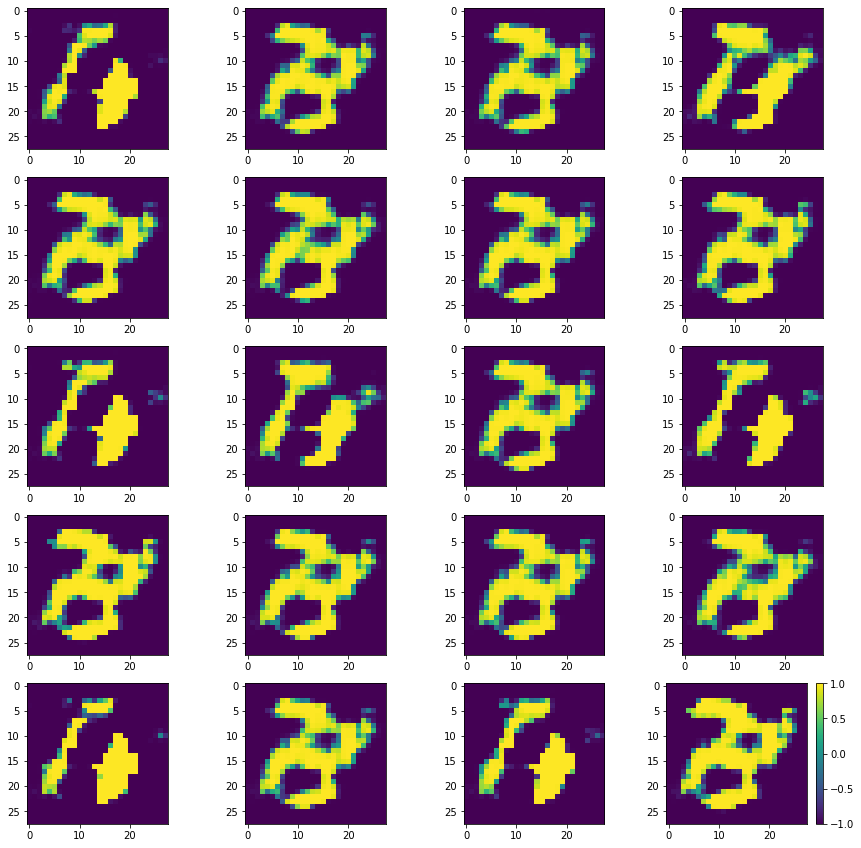

Batch_Num : 227
D_Loss   :   [9.233382225036621, 0.11297161877155304, 9.120410919189453, 0.5, 0.083984375] ;    GAN_Loss   :  [10.677738189697266, 0.6018531918525696, 10.075884819030762, 0.0, 0.1328125]
Batch_Num : 228
D_Loss   :   [10.338643074035645, 0.10970650613307953, 10.228936195373535, 0.5, 0.1015625] ;    GAN_Loss   :  [10.919219017028809, 0.5407934188842773, 10.378425598144531, 0.0, 0.1171875]
Batch_Num : 229
D_Loss   :   [9.756107330322266, 0.11194302141666412, 9.644164085388184, 0.5, 0.103515625] ;    GAN_Loss   :  [10.546488761901855, 0.45464348793029785, 10.091845512390137, 0.0, 0.123046875]
Batch_Num : 230
D_Loss   :   [10.078975677490234, 0.1090845912694931, 9.969891548156738, 0.5, 0.095703125] ;    GAN_Loss   :  [10.077783584594727, 0.5776352286338806, 9.50014877319336, 0.0, 0.1015625]
Batch_Num : 231
D_Loss   :   [10.318291664123535, 0.10846270620822906, 10.209829330444336, 0.5, 0.076171875] ;    GAN_Loss   :  [10.879114151000977, 0.517025351524353, 10.362089157104492,

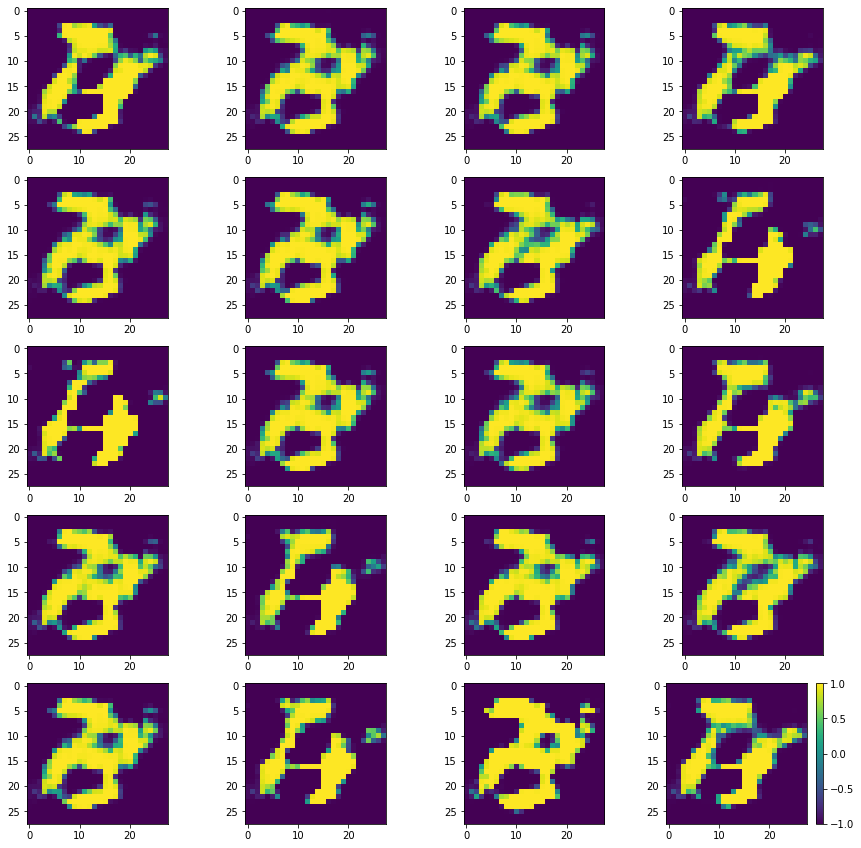

Batch_Num : 2
D_Loss   :   [10.103968620300293, 0.1087874174118042, 9.9951810836792, 0.5, 0.10546875] ;    GAN_Loss   :  [10.544342994689941, 0.8797659277915955, 9.66457748413086, 0.0, 0.107421875]
Batch_Num : 3
D_Loss   :   [10.137606620788574, 0.10814981907606125, 10.029457092285156, 0.5, 0.119140625] ;    GAN_Loss   :  [10.879107475280762, 1.008015751838684, 9.871091842651367, 0.0, 0.099609375]
Batch_Num : 4
D_Loss   :   [10.318840026855469, 0.11794277280569077, 10.200897216796875, 0.49609375, 0.109375] ;    GAN_Loss   :  [11.273195266723633, 1.1042898893356323, 10.168905258178711, 0.0, 0.091796875]
Batch_Num : 5
D_Loss   :   [10.162020683288574, 0.11485335975885391, 10.047167778015137, 0.5, 0.1171875] ;    GAN_Loss   :  [11.149539947509766, 1.0080475807189941, 10.14149284362793, 0.0, 0.103515625]
Batch_Num : 6
D_Loss   :   [10.46168041229248, 0.11307784169912338, 10.348602294921875, 0.5, 0.109375] ;    GAN_Loss   :  [11.196511268615723, 0.967261552810669, 10.229249954223633, 0.0, 0

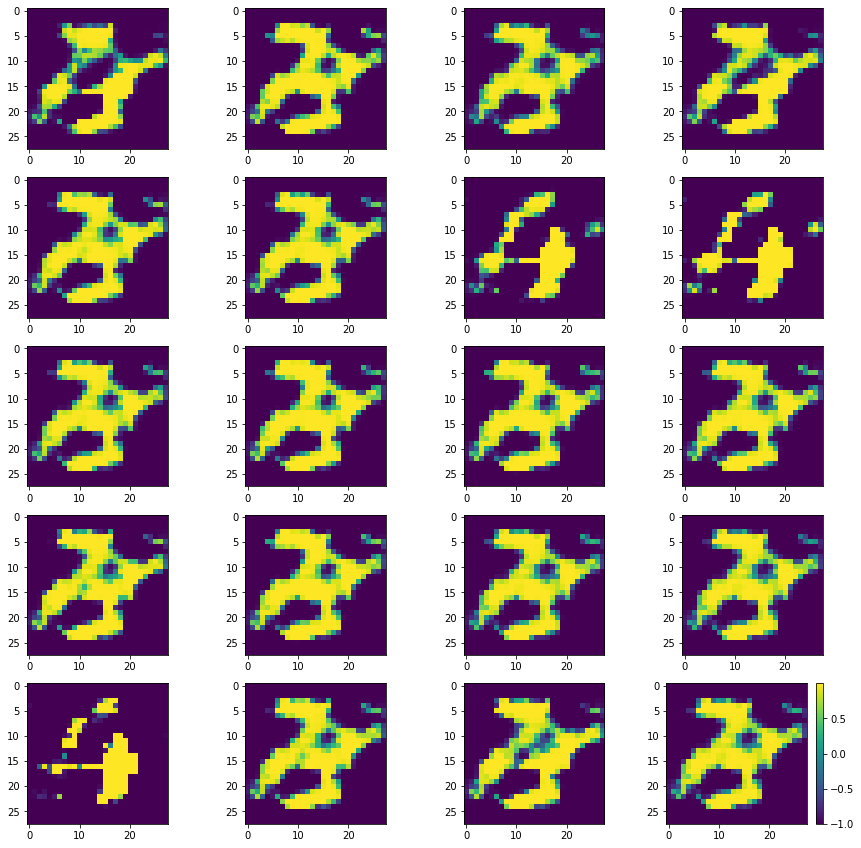

Batch_Num : 17
D_Loss   :   [9.76669692993164, 0.11398451030254364, 9.65271282196045, 0.5, 0.111328125] ;    GAN_Loss   :  [10.463263511657715, 1.1540037393569946, 9.309259414672852, 0.0, 0.072265625]
Batch_Num : 18
D_Loss   :   [9.912880897521973, 0.11494076997041702, 9.797940254211426, 0.5, 0.10546875] ;    GAN_Loss   :  [10.981012344360352, 1.269014835357666, 9.711997032165527, 0.0, 0.087890625]
Batch_Num : 19
D_Loss   :   [9.980799674987793, 0.1133306622505188, 9.86746883392334, 0.5, 0.08203125] ;    GAN_Loss   :  [12.382439613342285, 1.489151120185852, 10.893288612365723, 0.0, 0.056640625]
Batch_Num : 20
D_Loss   :   [9.808684349060059, 0.11280699074268341, 9.695877075195312, 0.5, 0.09375] ;    GAN_Loss   :  [11.89989185333252, 1.678956151008606, 10.220935821533203, 0.0, 0.091796875]
Batch_Num : 21
D_Loss   :   [9.654038429260254, 0.11374400556087494, 9.540294647216797, 0.5, 0.0859375] ;    GAN_Loss   :  [11.579157829284668, 1.2559549808502197, 10.323203086853027, 0.0, 0.07421875]

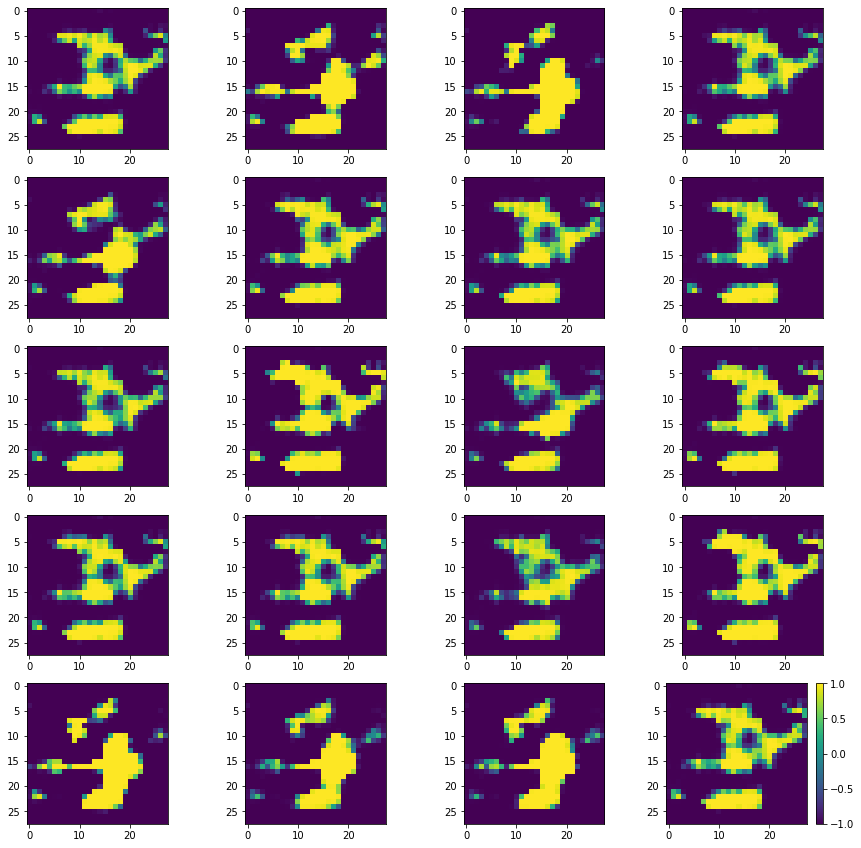

Batch_Num : 32
D_Loss   :   [9.727901458740234, 0.150826096534729, 9.577075004577637, 0.5, 0.103515625] ;    GAN_Loss   :  [11.25810718536377, 0.4741937518119812, 10.783913612365723, 0.0, 0.083984375]
Batch_Num : 33
D_Loss   :   [10.285210609436035, 0.12392318248748779, 10.161287307739258, 0.5, 0.09375] ;    GAN_Loss   :  [11.023639678955078, 0.42184221744537354, 10.601797103881836, 0.0, 0.080078125]
Batch_Num : 34
D_Loss   :   [10.396315574645996, 0.1744079440832138, 10.221907615661621, 0.5, 0.109375] ;    GAN_Loss   :  [11.140789985656738, 0.47103533148765564, 10.669754981994629, 0.0, 0.083984375]
Batch_Num : 35
D_Loss   :   [9.597681045532227, 0.1328192502260208, 9.464861869812012, 0.5, 0.111328125] ;    GAN_Loss   :  [11.77163314819336, 0.5956480503082275, 11.175985336303711, 0.0, 0.095703125]
Batch_Num : 36
D_Loss   :   [9.671222686767578, 0.1266934871673584, 9.54452896118164, 0.49609375, 0.103515625] ;    GAN_Loss   :  [12.728489875793457, 0.7061390280723572, 12.022351264953613, 

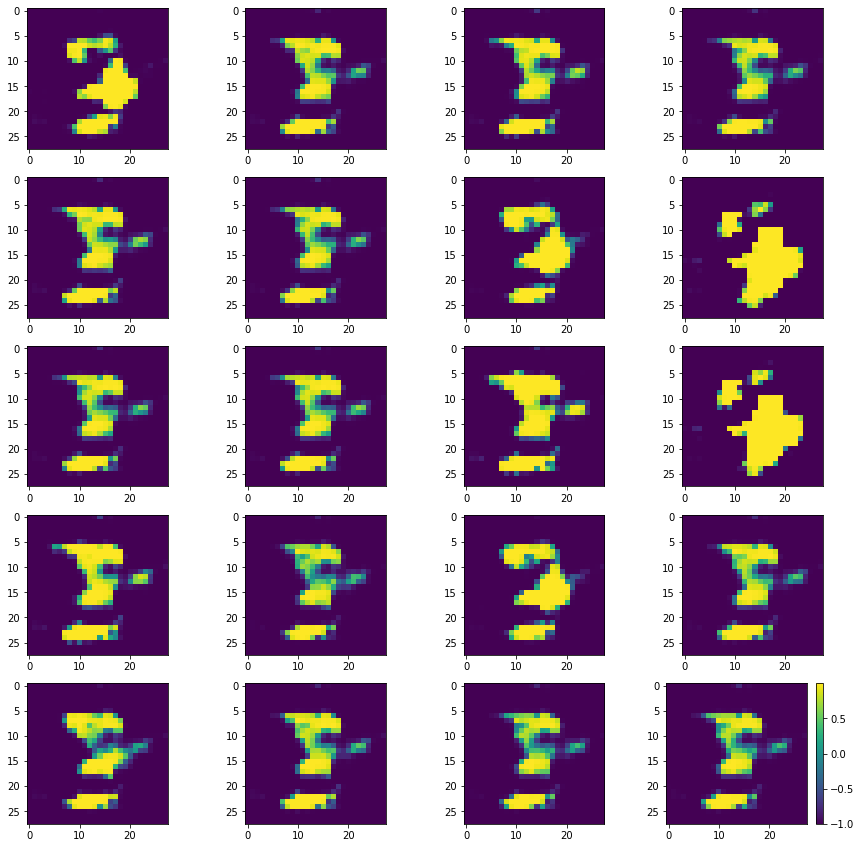

Batch_Num : 47
D_Loss   :   [10.669453620910645, 0.1345134824514389, 10.534939765930176, 0.5, 0.087890625] ;    GAN_Loss   :  [10.645106315612793, 0.3222494125366211, 10.322856903076172, 0.0, 0.08984375]
Batch_Num : 48
D_Loss   :   [10.122234344482422, 0.1401997059583664, 9.982034683227539, 0.5, 0.11328125] ;    GAN_Loss   :  [10.371524810791016, 0.29483363032341003, 10.076691627502441, 0.0, 0.103515625]
Batch_Num : 49
D_Loss   :   [10.066980361938477, 0.15553811192512512, 9.911441802978516, 0.5, 0.068359375] ;    GAN_Loss   :  [9.962498664855957, 0.26828309893608093, 9.694215774536133, 0.0, 0.130859375]
Batch_Num : 50
D_Loss   :   [9.77578353881836, 0.13375888764858246, 9.642024993896484, 0.5, 0.1015625] ;    GAN_Loss   :  [10.546399116516113, 0.29990172386169434, 10.24649715423584, 0.0, 0.109375]
Batch_Num : 51
D_Loss   :   [10.401717185974121, 0.13941127061843872, 10.262306213378906, 0.5, 0.1015625] ;    GAN_Loss   :  [10.054085731506348, 0.24494394659996033, 9.809142112731934, 0.0,

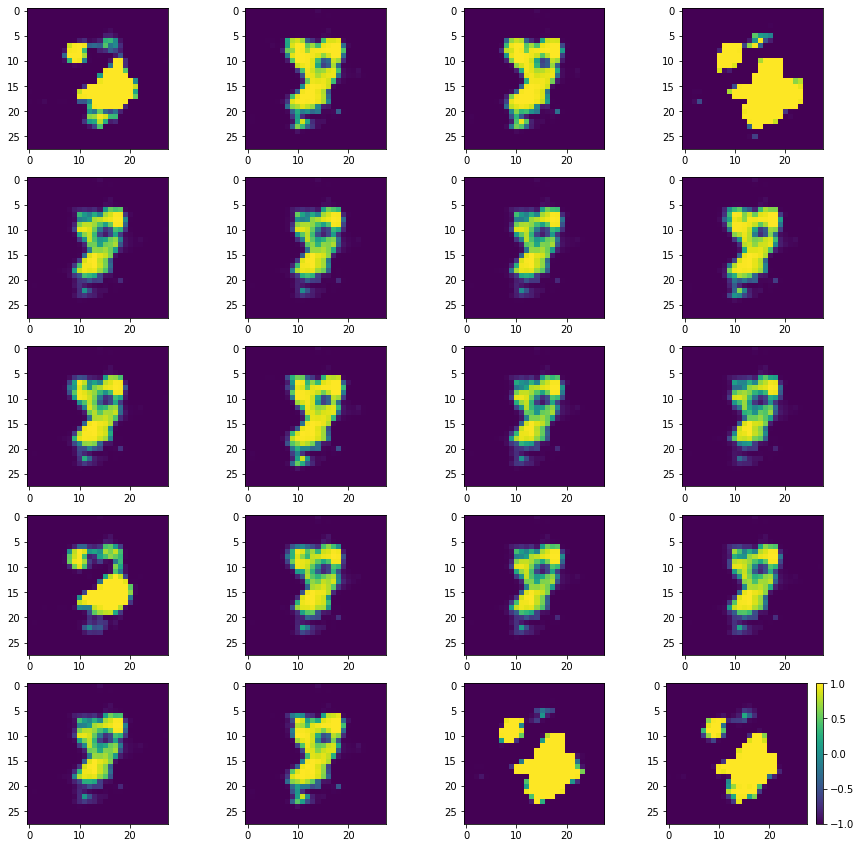

Batch_Num : 62
D_Loss   :   [9.82236385345459, 0.18575838208198547, 9.636605262756348, 0.498046875, 0.076171875] ;    GAN_Loss   :  [10.828258514404297, 0.4489481449127197, 10.379310607910156, 0.0, 0.10546875]
Batch_Num : 63
D_Loss   :   [10.114360809326172, 0.213063046336174, 9.901297569274902, 0.498046875, 0.1171875] ;    GAN_Loss   :  [11.040844917297363, 0.8427900075912476, 10.198055267333984, 0.0, 0.126953125]
Batch_Num : 64
D_Loss   :   [10.101080894470215, 0.2243703305721283, 9.876710891723633, 0.490234375, 0.09765625] ;    GAN_Loss   :  [12.626800537109375, 1.6281418800354004, 10.998659133911133, 0.0, 0.10546875]
Batch_Num : 65
D_Loss   :   [10.22744369506836, 0.1981922686100006, 10.029251098632812, 0.5, 0.107421875] ;    GAN_Loss   :  [13.497873306274414, 2.19345760345459, 11.304415702819824, 0.0, 0.119140625]
Batch_Num : 66
D_Loss   :   [10.911245346069336, 0.2471146583557129, 10.664131164550781, 0.47265625, 0.07421875] ;    GAN_Loss   :  [14.225547790527344, 3.72265672683715

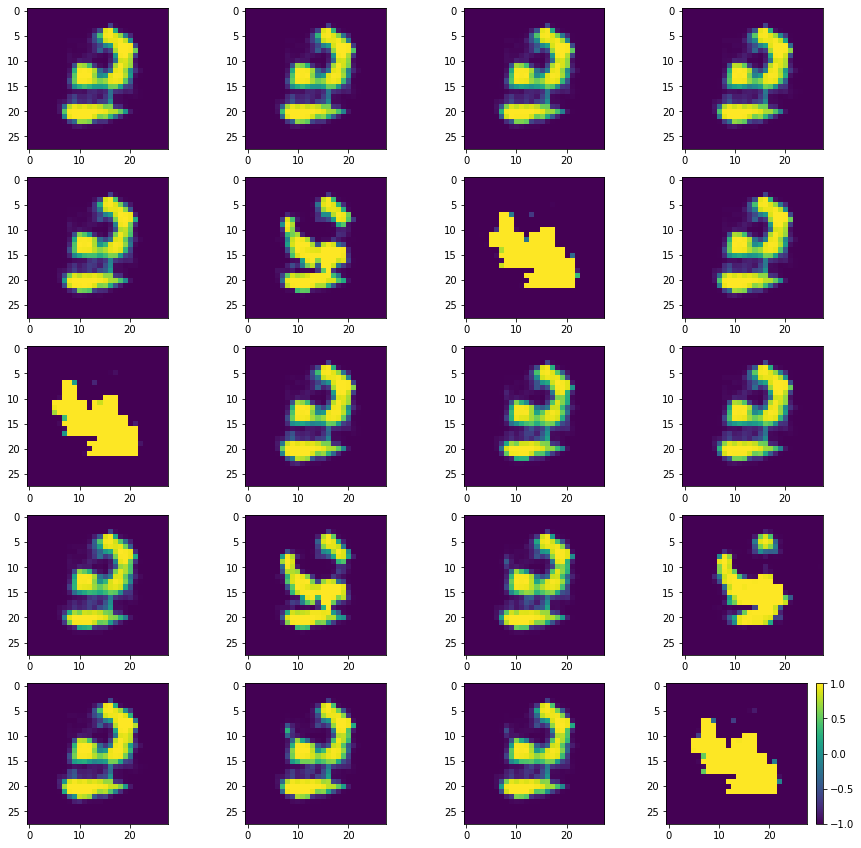

Batch_Num : 77
D_Loss   :   [10.20110034942627, 0.2747410535812378, 9.926359176635742, 0.5, 0.083984375] ;    GAN_Loss   :  [14.509353637695312, 3.999103546142578, 10.510250091552734, 0.0, 0.11328125]
Batch_Num : 78
D_Loss   :   [9.776694297790527, 0.21180462837219238, 9.564889907836914, 0.4921875, 0.08984375] ;    GAN_Loss   :  [14.063085556030273, 3.8861489295959473, 10.176936149597168, 0.0, 0.107421875]
Batch_Num : 79
D_Loss   :   [10.555855751037598, 0.20868663489818573, 10.347168922424316, 0.49609375, 0.095703125] ;    GAN_Loss   :  [14.97504997253418, 4.169590473175049, 10.805459976196289, 0.0, 0.154296875]
Batch_Num : 80
D_Loss   :   [10.116057395935059, 0.22481055557727814, 9.891246795654297, 0.5, 0.095703125] ;    GAN_Loss   :  [13.384885787963867, 3.5751399993896484, 9.809745788574219, 0.0, 0.16015625]
Batch_Num : 81
D_Loss   :   [10.366081237792969, 0.237557515501976, 10.128523826599121, 0.49609375, 0.091796875] ;    GAN_Loss   :  [13.632169723510742, 3.1772353649139404, 10.

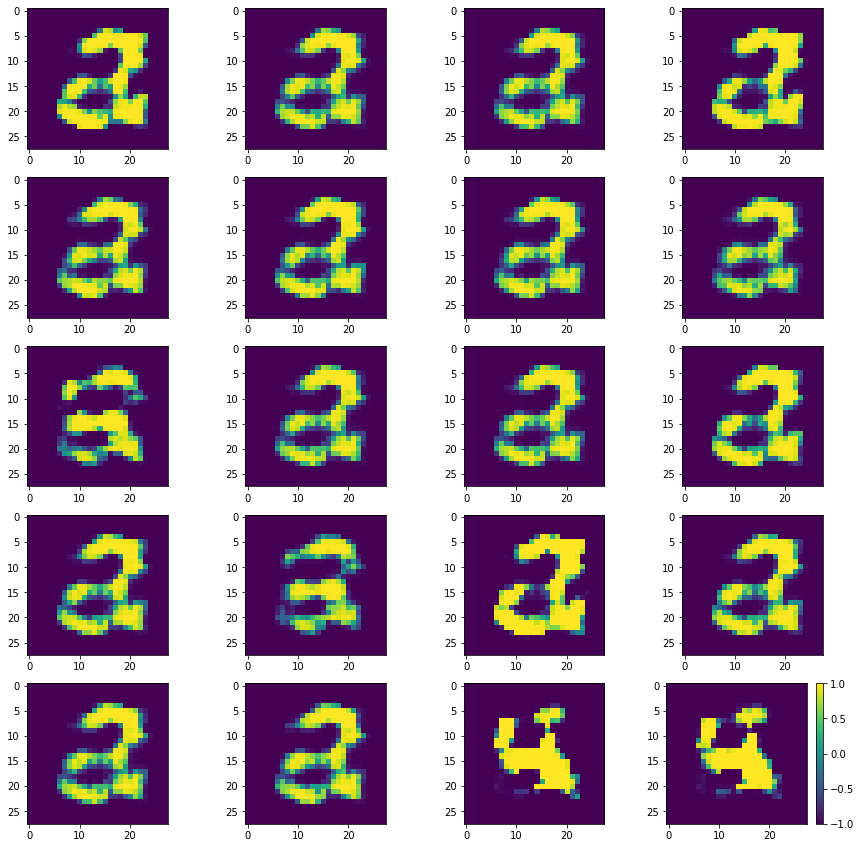

Batch_Num : 92
D_Loss   :   [10.206503868103027, 0.1866912692785263, 10.01981258392334, 0.5, 0.080078125] ;    GAN_Loss   :  [15.064194679260254, 4.579107284545898, 10.485087394714355, 0.0, 0.11328125]
Batch_Num : 93
D_Loss   :   [10.647394180297852, 0.19096776843070984, 10.456426620483398, 0.5, 0.109375] ;    GAN_Loss   :  [14.835484504699707, 4.242520332336426, 10.592964172363281, 0.0, 0.11328125]
Batch_Num : 94
D_Loss   :   [10.063154220581055, 0.19022969901561737, 9.8729248046875, 0.4921875, 0.123046875] ;    GAN_Loss   :  [14.383340835571289, 4.186118125915527, 10.197222709655762, 0.0, 0.103515625]
Batch_Num : 95
D_Loss   :   [10.224810600280762, 0.1730489879846573, 10.051761627197266, 0.48828125, 0.091796875] ;    GAN_Loss   :  [15.010834693908691, 4.561570167541504, 10.449264526367188, 0.0, 0.111328125]
Batch_Num : 96
D_Loss   :   [9.774862289428711, 0.16545498371124268, 9.609407424926758, 0.5, 0.091796875] ;    GAN_Loss   :  [15.007585525512695, 4.236050128936768, 10.7715349197

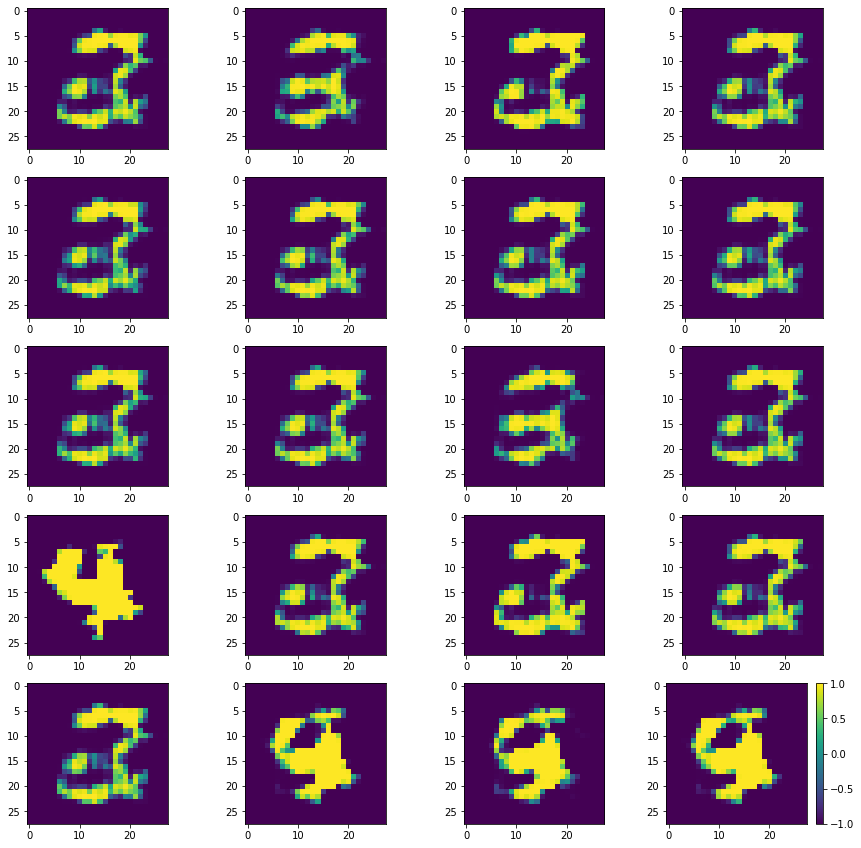

Batch_Num : 107
D_Loss   :   [10.06118106842041, 0.17854227125644684, 9.882638931274414, 0.5, 0.083984375] ;    GAN_Loss   :  [12.73727035522461, 3.186664342880249, 9.550605773925781, 0.0, 0.087890625]
Batch_Num : 108
D_Loss   :   [9.441205978393555, 0.13965289294719696, 9.301552772521973, 0.5, 0.09765625] ;    GAN_Loss   :  [12.910964012145996, 3.3031959533691406, 9.607768058776855, 0.0, 0.076171875]
Batch_Num : 109
D_Loss   :   [9.664606094360352, 0.1399608999490738, 9.52464485168457, 0.5, 0.087890625] ;    GAN_Loss   :  [13.889262199401855, 3.374783754348755, 10.51447868347168, 0.0, 0.109375]
Batch_Num : 110
D_Loss   :   [10.358390808105469, 0.1387420892715454, 10.219648361206055, 0.5, 0.119140625] ;    GAN_Loss   :  [14.434869766235352, 3.671273708343506, 10.763596534729004, 0.0, 0.091796875]
Batch_Num : 111
D_Loss   :   [9.556790351867676, 0.15681953728199005, 9.399971008300781, 0.5, 0.080078125] ;    GAN_Loss   :  [14.013778686523438, 3.5280203819274902, 10.485757827758789, 0.0, 

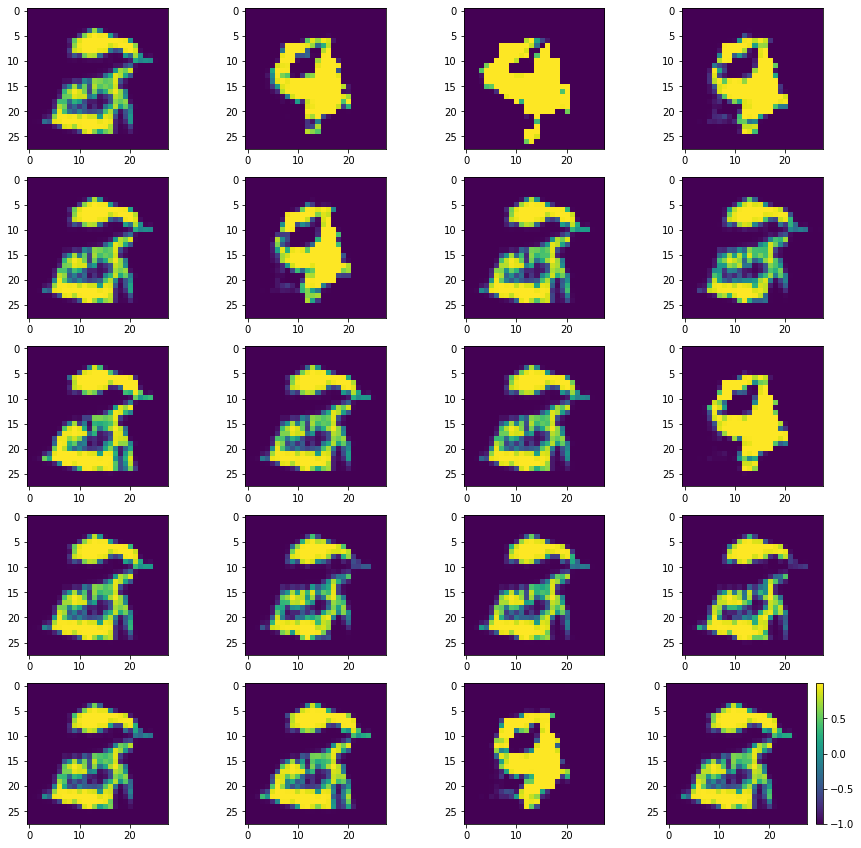

Batch_Num : 122
D_Loss   :   [10.66904067993164, 0.24696293473243713, 10.422078132629395, 0.46484375, 0.12890625] ;    GAN_Loss   :  [13.569429397583008, 2.4934306144714355, 11.075998306274414, 0.0, 0.099609375]
Batch_Num : 123
D_Loss   :   [9.98170280456543, 0.19985340535640717, 9.78184986114502, 0.498046875, 0.107421875] ;    GAN_Loss   :  [12.134852409362793, 1.7461076974868774, 10.388744354248047, 0.0, 0.09765625]
Batch_Num : 124
D_Loss   :   [10.358136177062988, 0.21490779519081116, 10.143228530883789, 0.4921875, 0.103515625] ;    GAN_Loss   :  [12.056275367736816, 1.867444396018982, 10.188831329345703, 0.0, 0.115234375]
Batch_Num : 125
D_Loss   :   [10.530667304992676, 0.2188165932893753, 10.311850547790527, 0.48828125, 0.103515625] ;    GAN_Loss   :  [11.289651870727539, 1.123386025428772, 10.166265487670898, 0.0, 0.107421875]
Batch_Num : 126
D_Loss   :   [10.5310697555542, 0.27354127168655396, 10.257528305053711, 0.482421875, 0.091796875] ;    GAN_Loss   :  [11.94419002532959, 

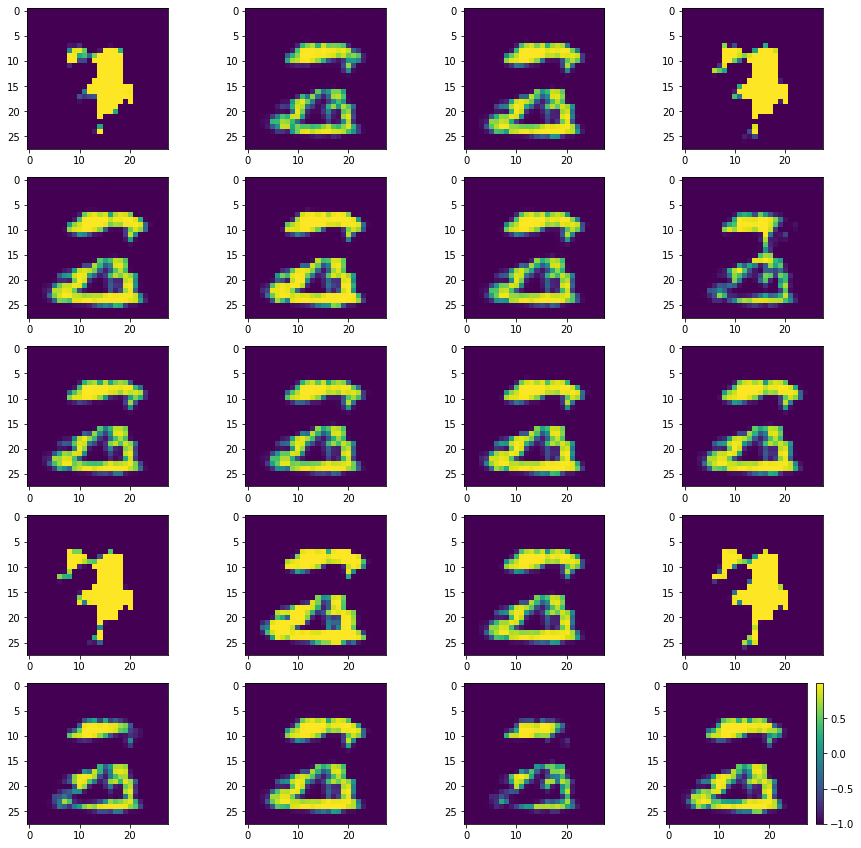

Batch_Num : 137
D_Loss   :   [10.929010391235352, 0.3003391921520233, 10.628671646118164, 0.46484375, 0.12109375] ;    GAN_Loss   :  [20.26691436767578, 4.276878356933594, 15.990036010742188, 0.0, 0.142578125]
Batch_Num : 138
D_Loss   :   [10.094446182250977, 0.18129996955394745, 9.913146018981934, 0.49609375, 0.095703125] ;    GAN_Loss   :  [19.99155044555664, 4.250788688659668, 15.740762710571289, 0.0, 0.111328125]
Batch_Num : 139
D_Loss   :   [10.046243667602539, 0.20474864542484283, 9.8414945602417, 0.48828125, 0.11328125] ;    GAN_Loss   :  [17.004573822021484, 3.483262538909912, 13.521310806274414, 0.0, 0.138671875]
Batch_Num : 140
D_Loss   :   [9.652551651000977, 0.2464512437582016, 9.406100273132324, 0.484375, 0.111328125] ;    GAN_Loss   :  [17.441057205200195, 3.5213491916656494, 13.919708251953125, 0.0, 0.111328125]
Batch_Num : 141
D_Loss   :   [10.181498527526855, 0.20799073576927185, 9.97350788116455, 0.494140625, 0.10546875] ;    GAN_Loss   :  [20.24091339111328, 4.862133

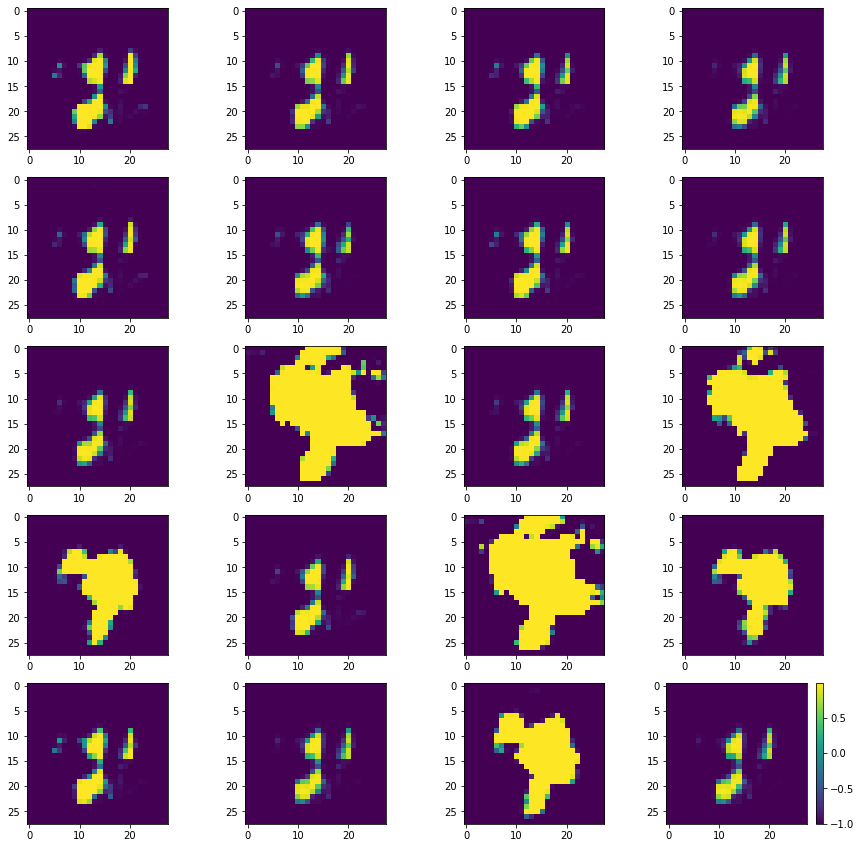

Batch_Num : 152
D_Loss   :   [9.86077880859375, 0.17811401188373566, 9.68266487121582, 0.5, 0.1171875] ;    GAN_Loss   :  [18.40244483947754, 5.2195281982421875, 13.182916641235352, 0.0, 0.123046875]
Batch_Num : 153
D_Loss   :   [10.106719017028809, 0.1731092929840088, 9.933609962463379, 0.5, 0.12890625] ;    GAN_Loss   :  [19.372953414916992, 5.748418807983398, 13.624534606933594, 0.0, 0.107421875]
Batch_Num : 154
D_Loss   :   [10.101799964904785, 0.20055004954338074, 9.901249885559082, 0.498046875, 0.119140625] ;    GAN_Loss   :  [21.242631912231445, 6.442633628845215, 14.79999828338623, 0.0, 0.134765625]
Batch_Num : 155
D_Loss   :   [10.457406997680664, 0.18244066834449768, 10.2749662399292, 0.498046875, 0.138671875] ;    GAN_Loss   :  [20.965307235717773, 7.053308486938477, 13.911998748779297, 0.0, 0.134765625]
Batch_Num : 156
D_Loss   :   [9.604632377624512, 0.20972736179828644, 9.394905090332031, 0.5, 0.111328125] ;    GAN_Loss   :  [20.85138511657715, 7.452087879180908, 13.39929

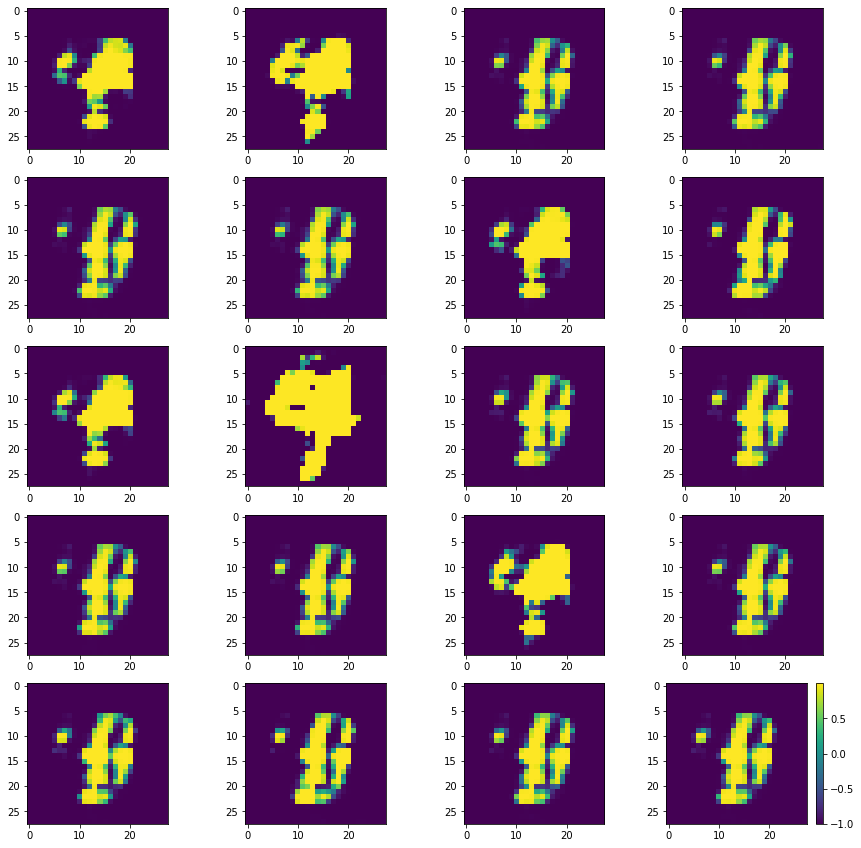

Batch_Num : 167
D_Loss   :   [10.550261497497559, 0.14777415990829468, 10.402487754821777, 0.5, 0.091796875] ;    GAN_Loss   :  [16.132556915283203, 5.032807350158691, 11.099748611450195, 0.0, 0.072265625]
Batch_Num : 168
D_Loss   :   [9.587349891662598, 0.14757280051708221, 9.439777374267578, 0.5, 0.095703125] ;    GAN_Loss   :  [15.616148948669434, 4.8098297119140625, 10.806319236755371, 0.0, 0.091796875]
Batch_Num : 169
D_Loss   :   [10.081748962402344, 0.13343694806098938, 9.948311805725098, 0.5, 0.095703125] ;    GAN_Loss   :  [15.503175735473633, 4.5942182540893555, 10.908957481384277, 0.0, 0.099609375]
Batch_Num : 170
D_Loss   :   [10.068150520324707, 0.13921579718589783, 9.928935050964355, 0.5, 0.140625] ;    GAN_Loss   :  [15.374155044555664, 4.507412433624268, 10.866742134094238, 0.0, 0.08984375]
Batch_Num : 171
D_Loss   :   [10.433249473571777, 0.15186867117881775, 10.281380653381348, 0.5, 0.103515625] ;    GAN_Loss   :  [15.133549690246582, 4.310650825500488, 10.82289886474

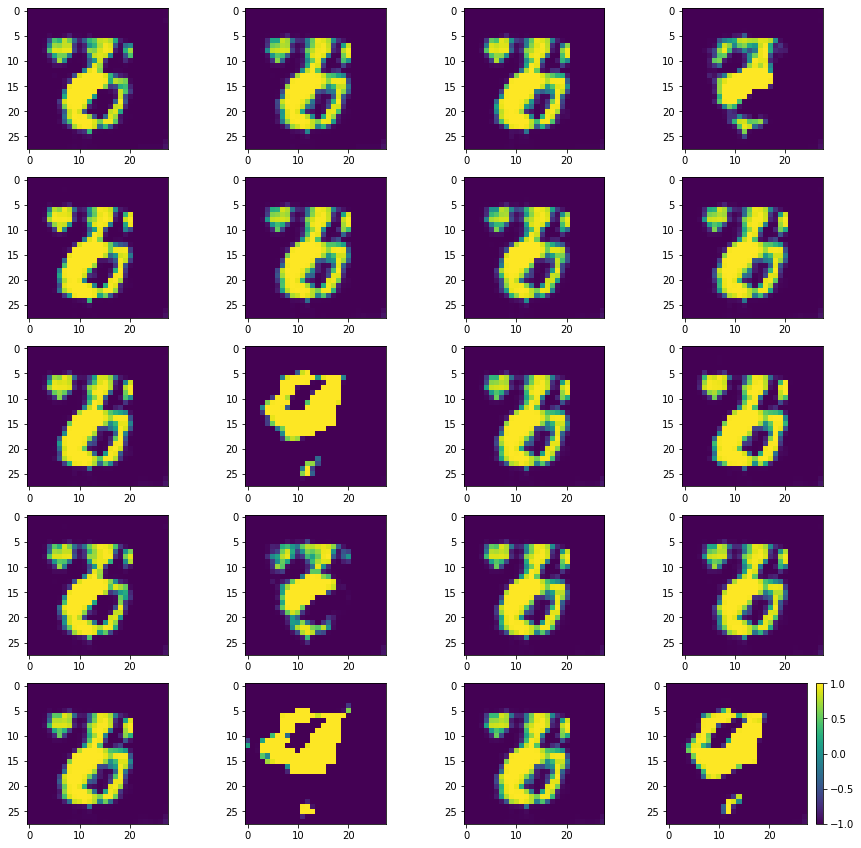

Batch_Num : 182
D_Loss   :   [9.749696731567383, 0.16559381783008575, 9.584102630615234, 0.498046875, 0.078125] ;    GAN_Loss   :  [13.309041023254395, 3.27182674407959, 10.037214279174805, 0.0, 0.08203125]
Batch_Num : 183
D_Loss   :   [10.452168464660645, 0.20501850545406342, 10.247150421142578, 0.5, 0.091796875] ;    GAN_Loss   :  [13.067073822021484, 2.8092384338378906, 10.257835388183594, 0.0, 0.10546875]
Batch_Num : 184
D_Loss   :   [9.933022499084473, 0.21842239797115326, 9.714600563049316, 0.484375, 0.083984375] ;    GAN_Loss   :  [12.909936904907227, 3.043151378631592, 9.866786003112793, 0.0, 0.125]
Batch_Num : 185
D_Loss   :   [10.004596710205078, 0.19810810685157776, 9.806488990783691, 0.5, 0.087890625] ;    GAN_Loss   :  [12.353588104248047, 2.3037495613098145, 10.04983901977539, 0.0, 0.08984375]
Batch_Num : 186
D_Loss   :   [9.731541633605957, 0.32225802540779114, 9.409283638000488, 0.48828125, 0.10546875] ;    GAN_Loss   :  [13.97818660736084, 3.3338871002197266, 10.644299

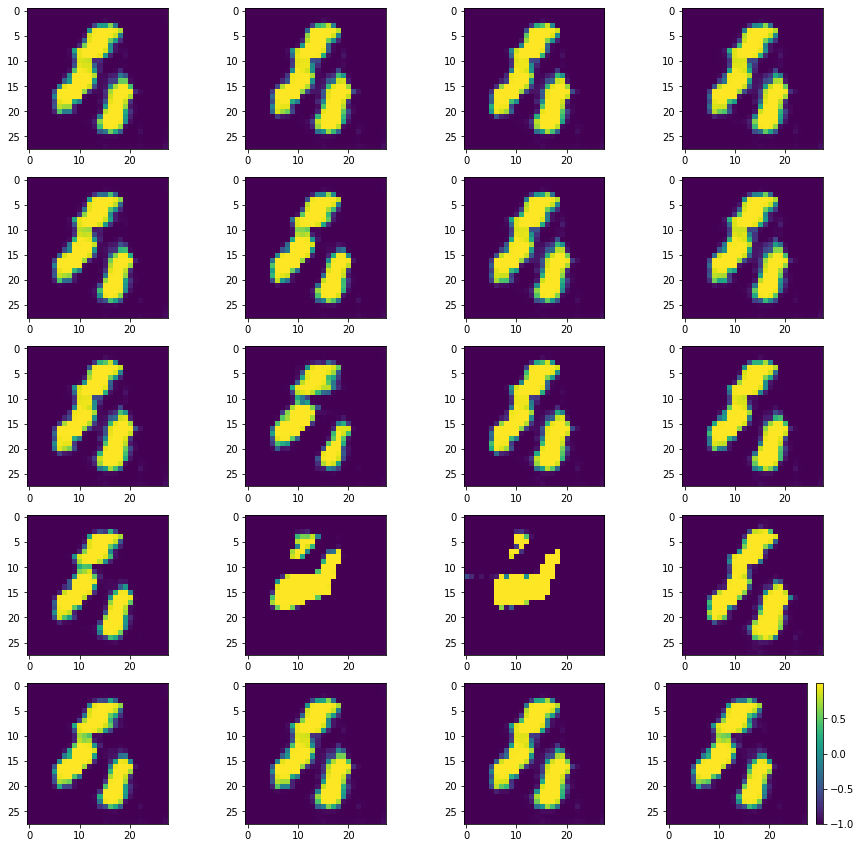

Batch_Num : 197
D_Loss   :   [10.058764457702637, 0.21047374606132507, 9.84829044342041, 0.498046875, 0.076171875] ;    GAN_Loss   :  [18.107036590576172, 6.964237689971924, 11.142799377441406, 0.0, 0.125]
Batch_Num : 198
D_Loss   :   [9.74073314666748, 0.19511300325393677, 9.54561996459961, 0.486328125, 0.08984375] ;    GAN_Loss   :  [18.20257568359375, 7.640048980712891, 10.562525749206543, 0.0, 0.111328125]
Batch_Num : 199
D_Loss   :   [10.648618698120117, 0.203526571393013, 10.44509220123291, 0.5, 0.099609375] ;    GAN_Loss   :  [16.76622772216797, 6.30967378616333, 10.456554412841797, 0.0, 0.12109375]
Batch_Num : 200
D_Loss   :   [10.204655647277832, 0.18956245481967926, 10.015092849731445, 0.49609375, 0.109375] ;    GAN_Loss   :  [17.510610580444336, 6.790894985198975, 10.71971607208252, 0.0, 0.13671875]
Batch_Num : 201
D_Loss   :   [10.434261322021484, 0.18667013943195343, 10.247591018676758, 0.5, 0.138671875] ;    GAN_Loss   :  [17.240318298339844, 6.591817855834961, 10.6485004

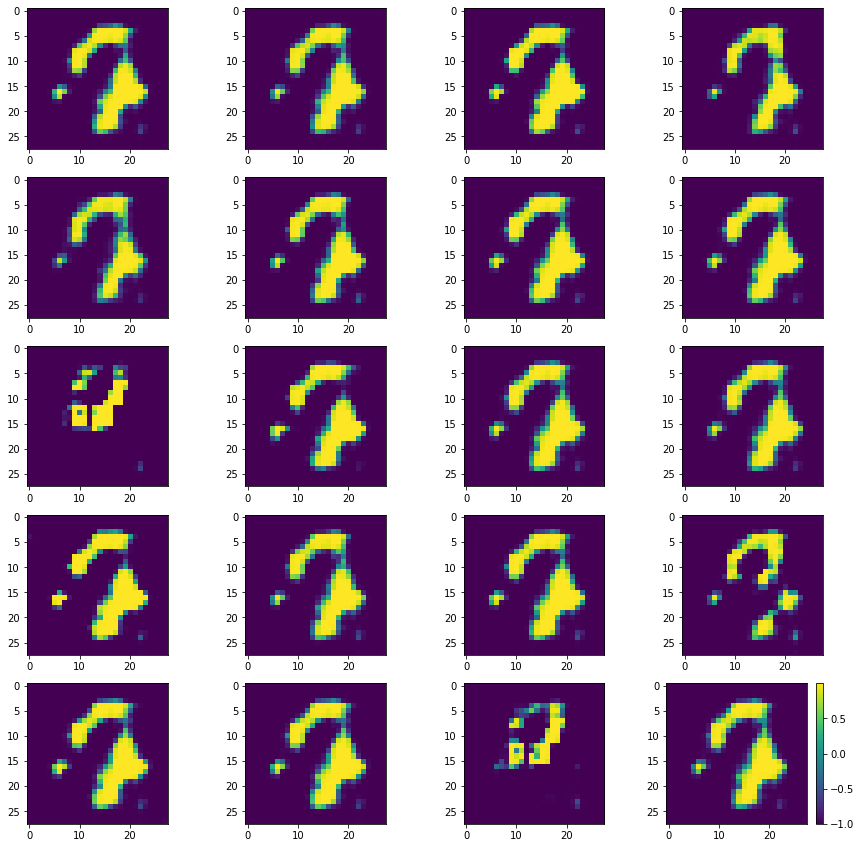

Batch_Num : 212
D_Loss   :   [10.983786582946777, 0.19081227481365204, 10.792974472045898, 0.48828125, 0.142578125] ;    GAN_Loss   :  [19.419437408447266, 7.667285442352295, 11.752151489257812, 0.0, 0.13671875]
Batch_Num : 213
D_Loss   :   [9.700116157531738, 0.22998157143592834, 9.470134735107422, 0.482421875, 0.1171875] ;    GAN_Loss   :  [19.602399826049805, 7.27793550491333, 12.324464797973633, 0.0, 0.1328125]
Batch_Num : 214
D_Loss   :   [10.470481872558594, 0.23768626153469086, 10.232795715332031, 0.46484375, 0.12890625] ;    GAN_Loss   :  [20.48642921447754, 7.4213666915893555, 13.065062522888184, 0.0, 0.142578125]
Batch_Num : 215
D_Loss   :   [9.323138236999512, 0.2476249486207962, 9.075512886047363, 0.484375, 0.09765625] ;    GAN_Loss   :  [21.133481979370117, 7.429651260375977, 13.70383071899414, 0.0, 0.140625]
Batch_Num : 216
D_Loss   :   [10.479652404785156, 0.1944712996482849, 10.285181045532227, 0.49609375, 0.134765625] ;    GAN_Loss   :  [21.975223541259766, 8.239469528

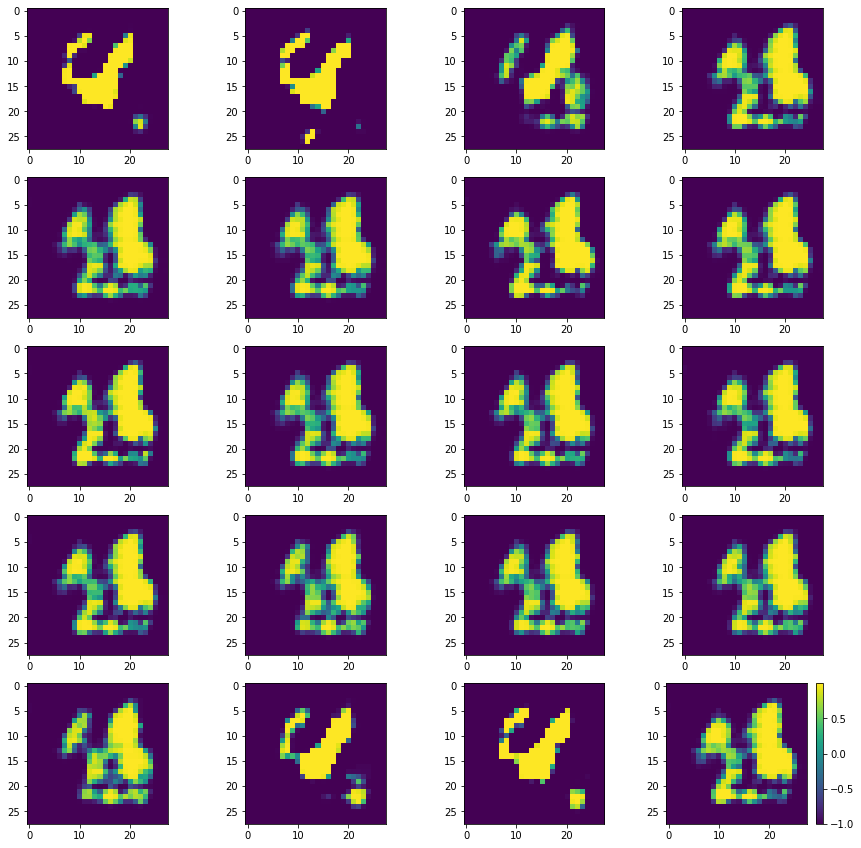

Batch_Num : 227
D_Loss   :   [9.338703155517578, 0.21562474966049194, 9.123078346252441, 0.48828125, 0.11328125] ;    GAN_Loss   :  [17.18282127380371, 5.190611362457275, 11.992209434509277, 0.0, 0.125]
Batch_Num : 228
D_Loss   :   [10.426041603088379, 0.19569234549999237, 10.23034954071045, 0.494140625, 0.12109375] ;    GAN_Loss   :  [16.91863441467285, 5.390487194061279, 11.52814769744873, 0.0, 0.11328125]
Batch_Num : 229
D_Loss   :   [9.836512565612793, 0.1888626366853714, 9.647649765014648, 0.498046875, 0.13671875] ;    GAN_Loss   :  [18.176599502563477, 5.6222710609436035, 12.554328918457031, 0.0, 0.103515625]
Batch_Num : 230
D_Loss   :   [10.122578620910645, 0.1499178409576416, 9.972661018371582, 0.5, 0.1171875] ;    GAN_Loss   :  [18.46854019165039, 5.957932472229004, 12.51060676574707, 0.0, 0.15234375]
Batch_Num : 231
D_Loss   :   [10.35946273803711, 0.14851398766040802, 10.210948944091797, 0.49609375, 0.140625] ;    GAN_Loss   :  [18.566862106323242, 5.9926533699035645, 12.574

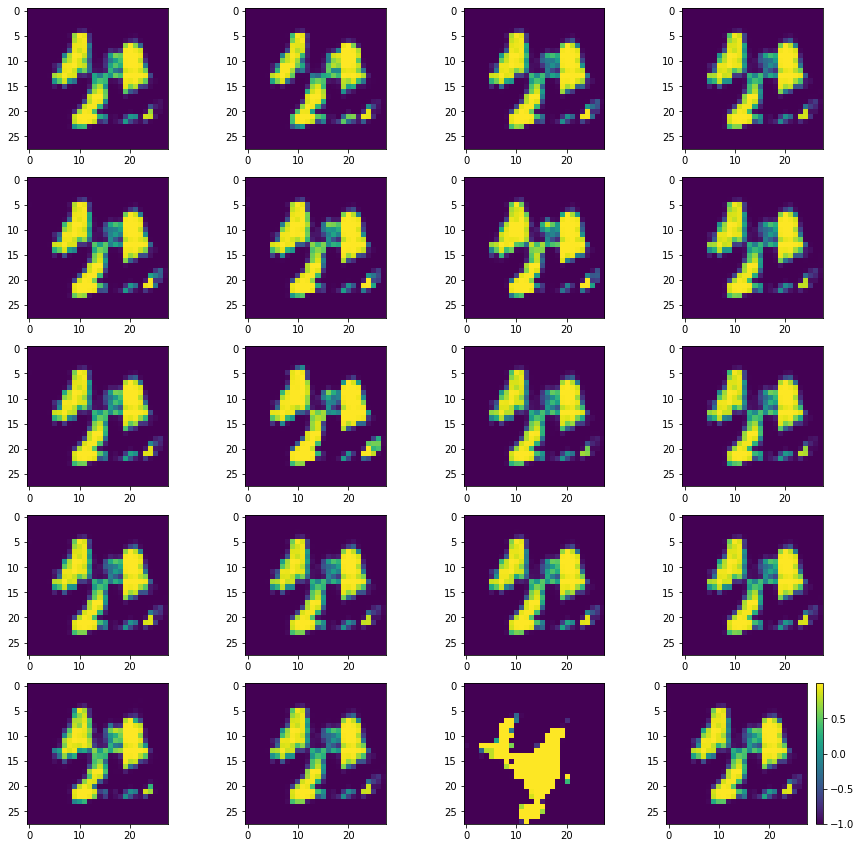

Batch_Num : 2
D_Loss   :   [10.158452033996582, 0.15333475172519684, 10.005117416381836, 0.498046875, 0.13671875] ;    GAN_Loss   :  [19.28093719482422, 6.905553817749023, 12.375384330749512, 0.0, 0.130859375]
Batch_Num : 3
D_Loss   :   [10.196968078613281, 0.16124960780143738, 10.03571891784668, 0.49609375, 0.134765625] ;    GAN_Loss   :  [17.515214920043945, 5.730758190155029, 11.784456253051758, 0.0, 0.099609375]
Batch_Num : 4
D_Loss   :   [10.395833969116211, 0.18521378934383392, 10.210619926452637, 0.5, 0.1328125] ;    GAN_Loss   :  [17.779769897460938, 5.884826183319092, 11.894944190979004, 0.0, 0.111328125]
Batch_Num : 5
D_Loss   :   [10.314264297485352, 0.2522197961807251, 10.062044143676758, 0.494140625, 0.087890625] ;    GAN_Loss   :  [19.137226104736328, 6.612746238708496, 12.524480819702148, 0.0, 0.091796875]
Batch_Num : 6
D_Loss   :   [10.533475875854492, 0.17303155362606049, 10.360444068908691, 0.498046875, 0.130859375] ;    GAN_Loss   :  [19.778905868530273, 6.9938426017

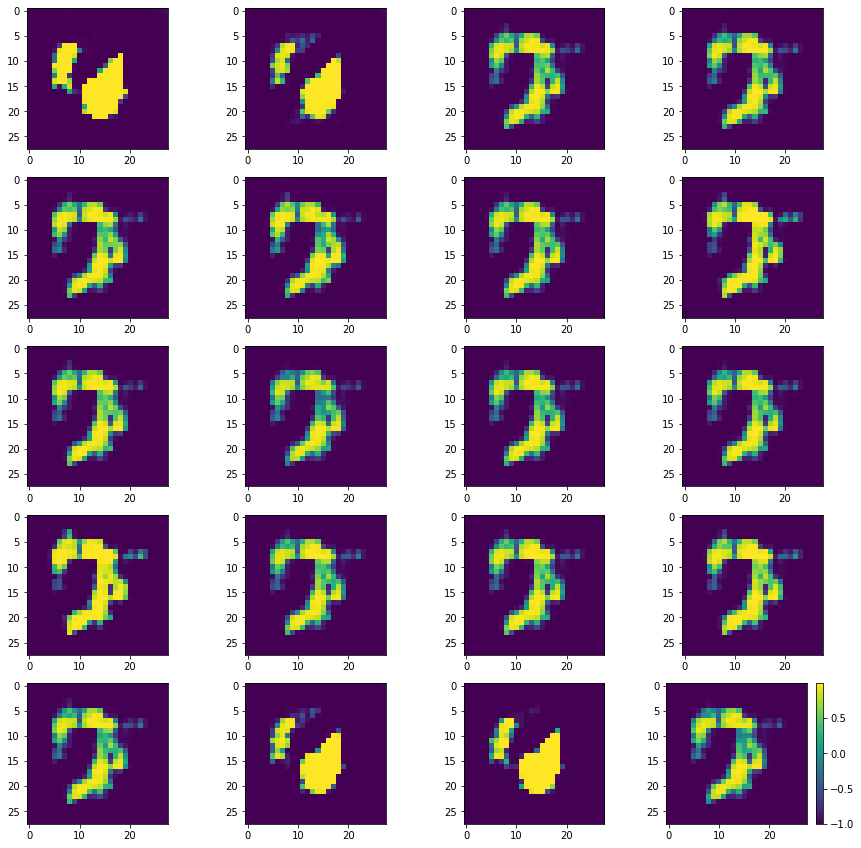

Batch_Num : 17
D_Loss   :   [9.844568252563477, 0.1733316332101822, 9.671236991882324, 0.5, 0.078125] ;    GAN_Loss   :  [20.999794006347656, 6.753551483154297, 14.246241569519043, 0.0, 0.072265625]
Batch_Num : 18
D_Loss   :   [10.20701789855957, 0.3780837953090668, 9.828933715820312, 0.388671875, 0.125] ;    GAN_Loss   :  [25.29571533203125, 7.786969184875488, 17.508745193481445, 0.0, 0.083984375]
Batch_Num : 19
D_Loss   :   [10.313669204711914, 0.30642032623291016, 10.007248878479004, 0.498046875, 0.095703125] ;    GAN_Loss   :  [22.986328125, 8.638391494750977, 14.34793758392334, 0.0, 0.0625]
Batch_Num : 20
D_Loss   :   [10.001934051513672, 0.29492342472076416, 9.707010269165039, 0.4609375, 0.123046875] ;    GAN_Loss   :  [20.45440673828125, 7.315048694610596, 13.139357566833496, 0.0, 0.091796875]
Batch_Num : 21
D_Loss   :   [9.896256446838379, 0.3254745304584503, 9.570781707763672, 0.474609375, 0.076171875] ;    GAN_Loss   :  [20.146644592285156, 6.543759822845459, 13.6028852462768

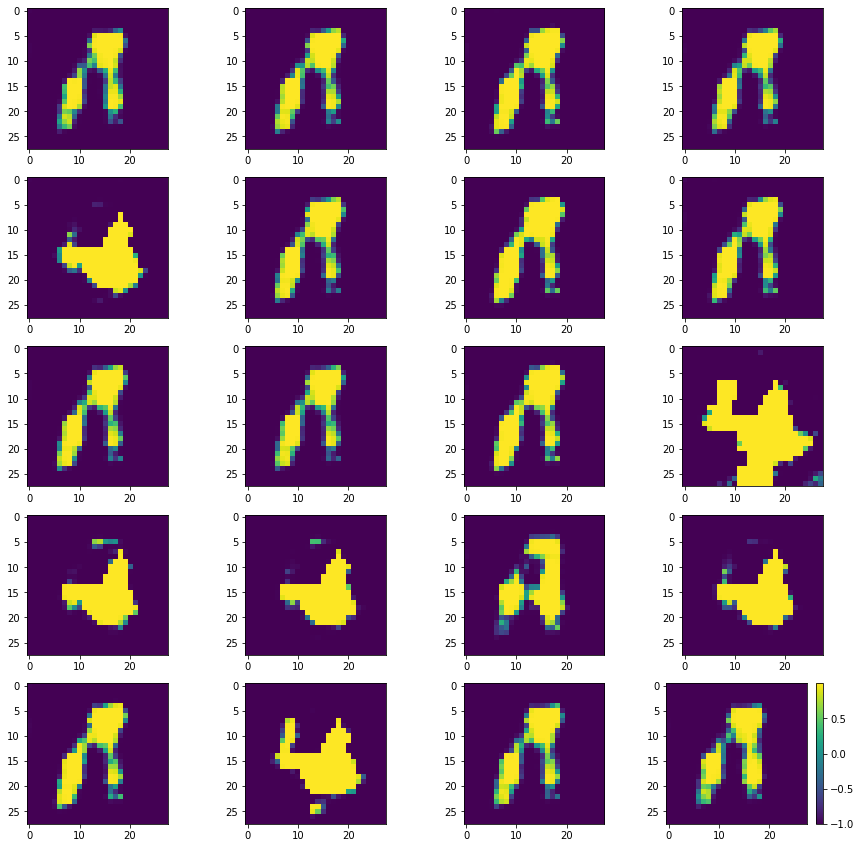

Batch_Num : 32
D_Loss   :   [9.77529239654541, 0.19027778506278992, 9.585014343261719, 0.494140625, 0.126953125] ;    GAN_Loss   :  [19.086278915405273, 7.029751300811768, 12.056528091430664, 0.0, 0.1015625]
Batch_Num : 33
D_Loss   :   [10.349491119384766, 0.1684880554676056, 10.181002616882324, 0.5, 0.13671875] ;    GAN_Loss   :  [20.727611541748047, 7.792915344238281, 12.93469524383545, 0.0, 0.099609375]
Batch_Num : 34
D_Loss   :   [10.497967720031738, 0.25402504205703735, 10.243942260742188, 0.4921875, 0.15625] ;    GAN_Loss   :  [20.677410125732422, 7.491286754608154, 13.18612289428711, 0.0, 0.1015625]
Batch_Num : 35
D_Loss   :   [9.682998657226562, 0.20591989159584045, 9.477078437805176, 0.474609375, 0.0859375] ;    GAN_Loss   :  [22.218425750732422, 8.402210235595703, 13.816214561462402, 0.0, 0.10546875]
Batch_Num : 36
D_Loss   :   [9.708281517028809, 0.1519666463136673, 9.556314468383789, 0.498046875, 0.099609375] ;    GAN_Loss   :  [22.157760620117188, 8.686840057373047, 13.470

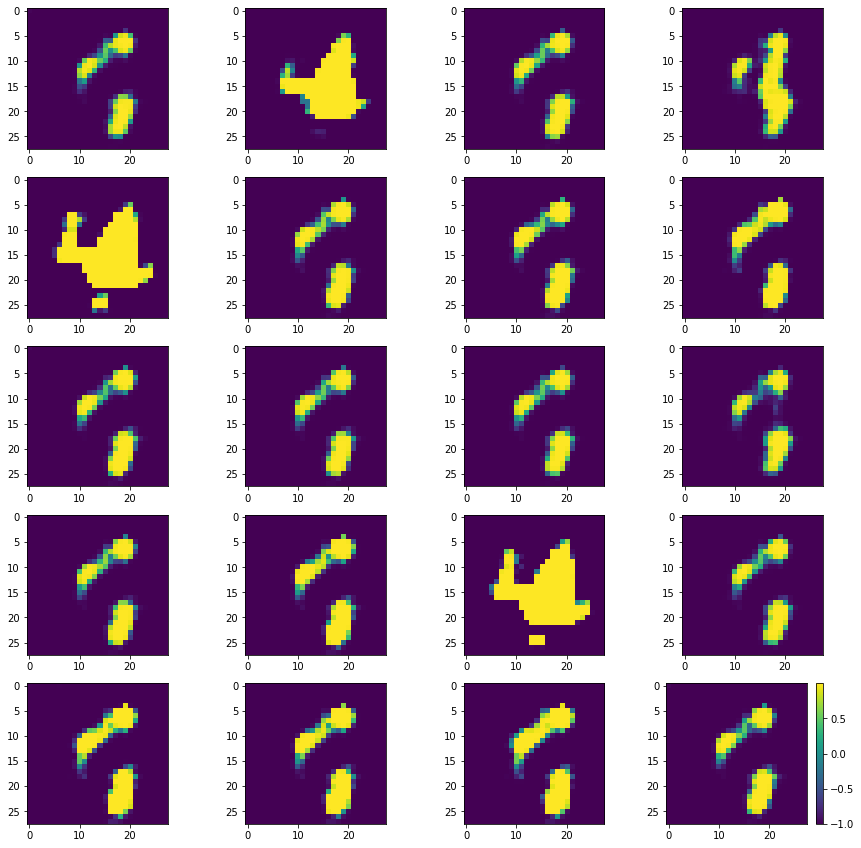

Batch_Num : 47
D_Loss   :   [10.817785263061523, 0.24453315138816833, 10.573251724243164, 0.494140625, 0.142578125] ;    GAN_Loss   :  [25.412776947021484, 12.050163269042969, 13.362614631652832, 0.0, 0.125]
Batch_Num : 48
D_Loss   :   [10.219383239746094, 0.22893138229846954, 9.99045181274414, 0.4921875, 0.138671875] ;    GAN_Loss   :  [27.134078979492188, 13.007925033569336, 14.126153945922852, 0.0, 0.107421875]
Batch_Num : 49
D_Loss   :   [10.159707069396973, 0.2217741459608078, 9.937932968139648, 0.49609375, 0.1328125] ;    GAN_Loss   :  [26.670547485351562, 11.9488525390625, 14.721694946289062, 0.0, 0.109375]
Batch_Num : 50
D_Loss   :   [9.814050674438477, 0.17775173485279083, 9.636299133300781, 0.494140625, 0.115234375] ;    GAN_Loss   :  [25.655296325683594, 11.146113395690918, 14.509183883666992, 0.0, 0.109375]
Batch_Num : 51
D_Loss   :   [10.448640823364258, 0.1831706464290619, 10.265470504760742, 0.4921875, 0.115234375] ;    GAN_Loss   :  [25.162925720214844, 10.8660583496093

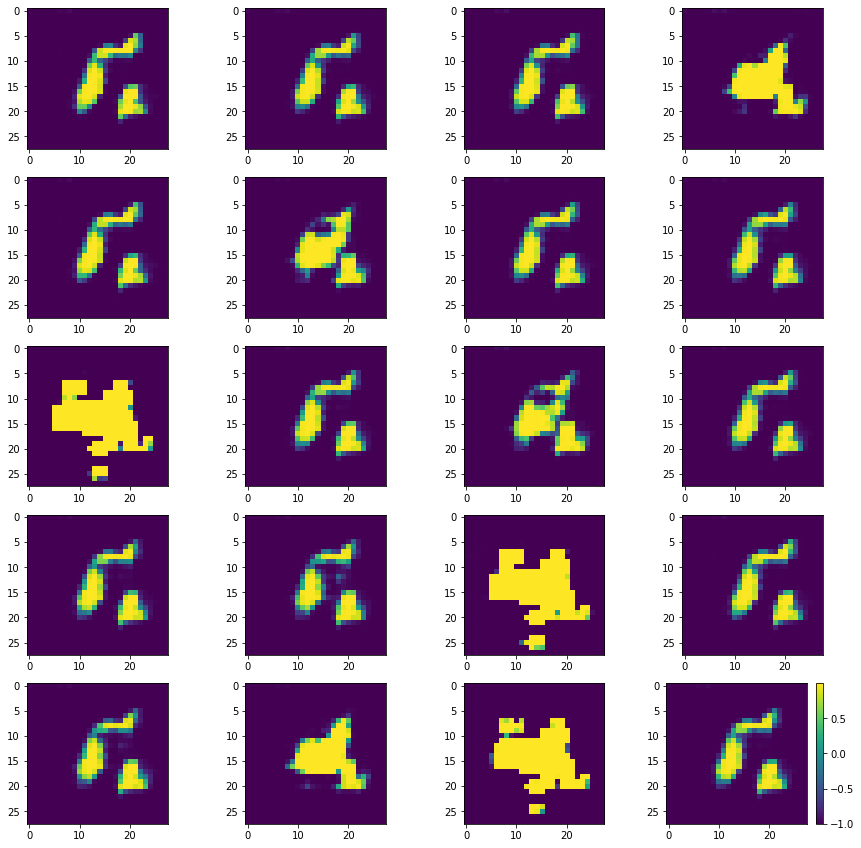

Batch_Num : 62
D_Loss   :   [9.77322769165039, 0.1409262865781784, 9.632301330566406, 0.5, 0.091796875] ;    GAN_Loss   :  [24.56367301940918, 10.692292213439941, 13.871380805969238, 0.0, 0.099609375]
Batch_Num : 63
D_Loss   :   [10.042624473571777, 0.1561478078365326, 9.886476516723633, 0.5, 0.08984375] ;    GAN_Loss   :  [24.994121551513672, 10.732410430908203, 14.261712074279785, 0.0, 0.10546875]
Batch_Num : 64
D_Loss   :   [10.029480934143066, 0.15782061219215393, 9.871660232543945, 0.498046875, 0.09375] ;    GAN_Loss   :  [26.40856170654297, 10.524271011352539, 15.88429069519043, 0.0, 0.048828125]
Batch_Num : 65
D_Loss   :   [10.151285171508789, 0.14472904801368713, 10.006556510925293, 0.5, 0.091796875] ;    GAN_Loss   :  [25.855636596679688, 10.520330429077148, 15.335306167602539, 0.0, 0.037109375]
Batch_Num : 66
D_Loss   :   [10.827042579650879, 0.1839912086725235, 10.643051147460938, 0.498046875, 0.09765625] ;    GAN_Loss   :  [26.312232971191406, 11.144433975219727, 15.1677989

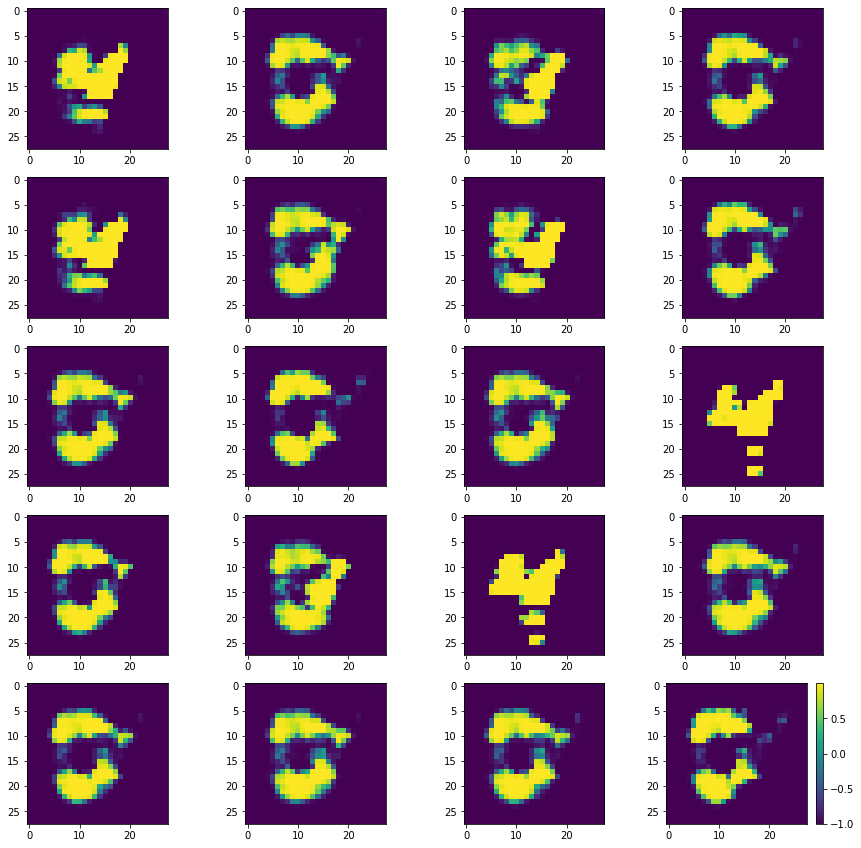

Batch_Num : 77
D_Loss   :   [10.174098014831543, 0.24111346900463104, 9.932984352111816, 0.498046875, 0.09375] ;    GAN_Loss   :  [16.60348129272461, 4.741965293884277, 11.861516952514648, 0.0, 0.103515625]
Batch_Num : 78
D_Loss   :   [9.85399055480957, 0.26597678661346436, 9.588013648986816, 0.482421875, 0.08203125] ;    GAN_Loss   :  [15.894229888916016, 4.5217108726501465, 11.372519493103027, 0.0, 0.080078125]
Batch_Num : 79
D_Loss   :   [10.611492156982422, 0.2478887140750885, 10.363603591918945, 0.486328125, 0.07421875] ;    GAN_Loss   :  [17.91252899169922, 4.86739444732666, 13.045135498046875, 0.0, 0.146484375]
Batch_Num : 80
D_Loss   :   [10.12031364440918, 0.20690752565860748, 9.913406372070312, 0.498046875, 0.115234375] ;    GAN_Loss   :  [17.341144561767578, 4.586595058441162, 12.754549026489258, 0.0, 0.154296875]
Batch_Num : 81
D_Loss   :   [10.328224182128906, 0.1930118054151535, 10.135211944580078, 0.498046875, 0.11328125] ;    GAN_Loss   :  [15.113529205322266, 4.0595154

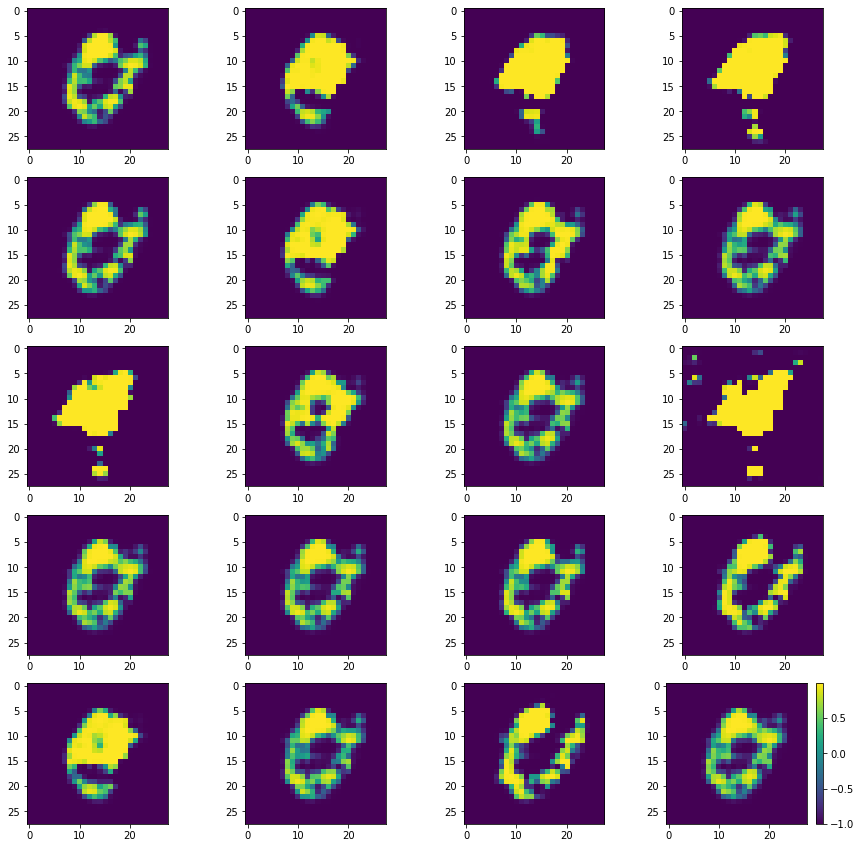

Batch_Num : 92
D_Loss   :   [10.231804847717285, 0.20746098458766937, 10.024343490600586, 0.5, 0.1171875] ;    GAN_Loss   :  [15.635601043701172, 5.209473609924316, 10.426127433776855, 0.0, 0.083984375]
Batch_Num : 93
D_Loss   :   [10.69587516784668, 0.21229419112205505, 10.483580589294434, 0.5, 0.138671875] ;    GAN_Loss   :  [15.210395812988281, 4.1874494552612305, 11.02294635772705, 0.0, 0.12109375]
Batch_Num : 94
D_Loss   :   [10.093546867370605, 0.20817607641220093, 9.885371208190918, 0.49609375, 0.1171875] ;    GAN_Loss   :  [13.924897193908691, 3.036668062210083, 10.888229370117188, 0.0, 0.125]
Batch_Num : 95
D_Loss   :   [10.34653091430664, 0.2606852054595947, 10.085845947265625, 0.498046875, 0.09375] ;    GAN_Loss   :  [12.137807846069336, 2.0327718257904053, 10.105035781860352, 0.0, 0.119140625]
Batch_Num : 96
D_Loss   :   [9.955867767333984, 0.3105739653110504, 9.645294189453125, 0.478515625, 0.095703125] ;    GAN_Loss   :  [12.471508979797363, 2.1339123249053955, 10.3375968

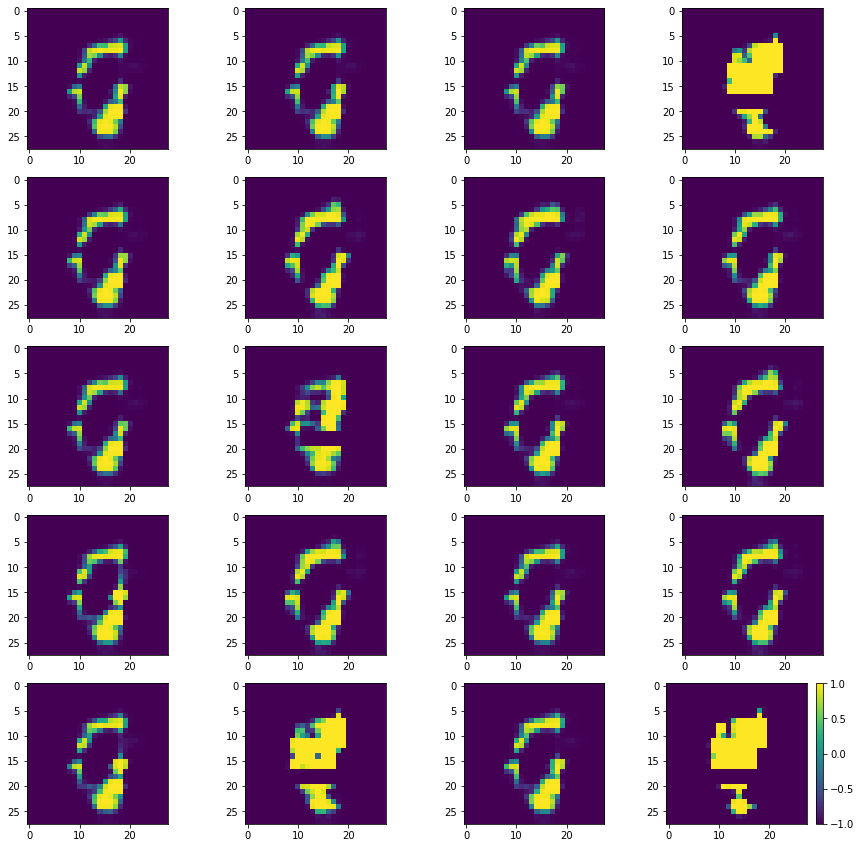

Batch_Num : 107
D_Loss   :   [10.04593563079834, 0.16470281779766083, 9.881233215332031, 0.5, 0.08984375] ;    GAN_Loss   :  [17.768352508544922, 5.381492614746094, 12.386859893798828, 0.0, 0.115234375]
Batch_Num : 108
D_Loss   :   [9.468555450439453, 0.1532481461763382, 9.3153076171875, 0.5, 0.111328125] ;    GAN_Loss   :  [16.964279174804688, 5.771118640899658, 11.193160057067871, 0.0, 0.08984375]
Batch_Num : 109
D_Loss   :   [9.687129974365234, 0.15555262565612793, 9.531577110290527, 0.498046875, 0.10546875] ;    GAN_Loss   :  [17.325740814208984, 5.401854515075684, 11.923885345458984, 0.0, 0.080078125]
Batch_Num : 110
D_Loss   :   [10.373919486999512, 0.14648441970348358, 10.227435111999512, 0.5, 0.087890625] ;    GAN_Loss   :  [17.436058044433594, 5.899262428283691, 11.536795616149902, 0.0, 0.103515625]
Batch_Num : 111
D_Loss   :   [9.550982475280762, 0.14958912134170532, 9.401392936706543, 0.5, 0.109375] ;    GAN_Loss   :  [18.073505401611328, 5.286967754364014, 12.78653812408447

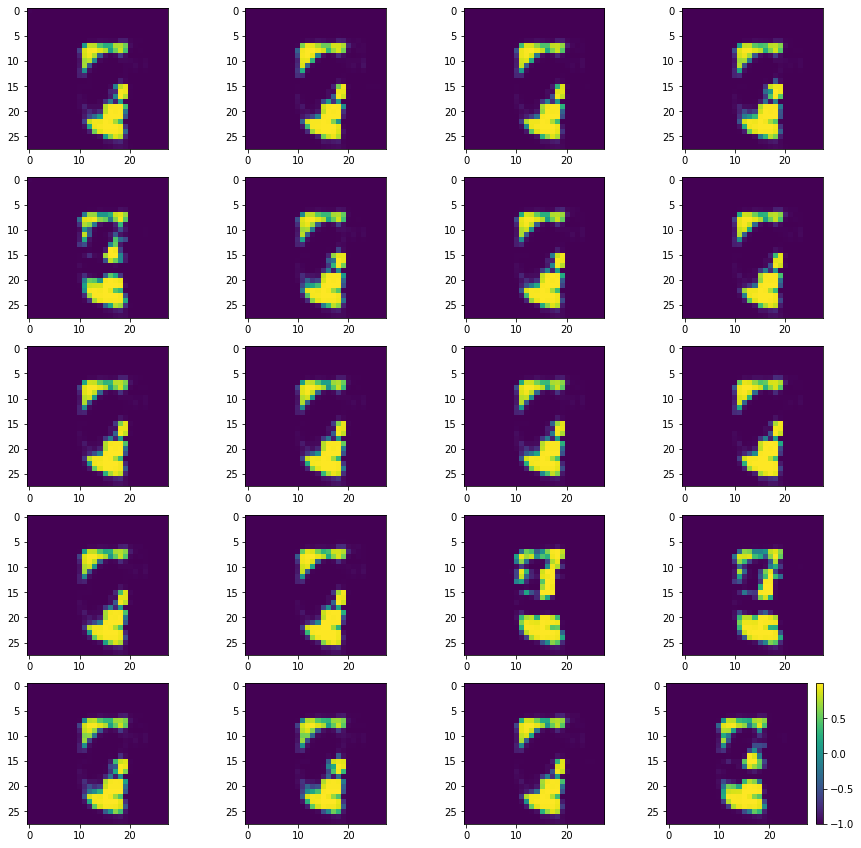

Batch_Num : 122
D_Loss   :   [10.547948837280273, 0.1450118124485016, 10.402936935424805, 0.5, 0.080078125] ;    GAN_Loss   :  [17.04635238647461, 5.452236175537109, 11.5941162109375, 0.0, 0.072265625]
Batch_Num : 123
D_Loss   :   [9.911212921142578, 0.1377047300338745, 9.773508071899414, 0.5, 0.083984375] ;    GAN_Loss   :  [16.345367431640625, 5.482456207275391, 10.862910270690918, 0.0, 0.072265625]
Batch_Num : 124
D_Loss   :   [10.27001667022705, 0.14796799421310425, 10.122048377990723, 0.5, 0.087890625] ;    GAN_Loss   :  [16.220876693725586, 5.587901592254639, 10.632974624633789, 0.0, 0.087890625]
Batch_Num : 125
D_Loss   :   [10.444404602050781, 0.14248938858509064, 10.301915168762207, 0.5, 0.083984375] ;    GAN_Loss   :  [16.954483032226562, 5.976340293884277, 10.978142738342285, 0.0, 0.091796875]
Batch_Num : 126
D_Loss   :   [10.394482612609863, 0.14568926393985748, 10.248793601989746, 0.5, 0.109375] ;    GAN_Loss   :  [17.545917510986328, 6.753940105438232, 10.791977882385254,

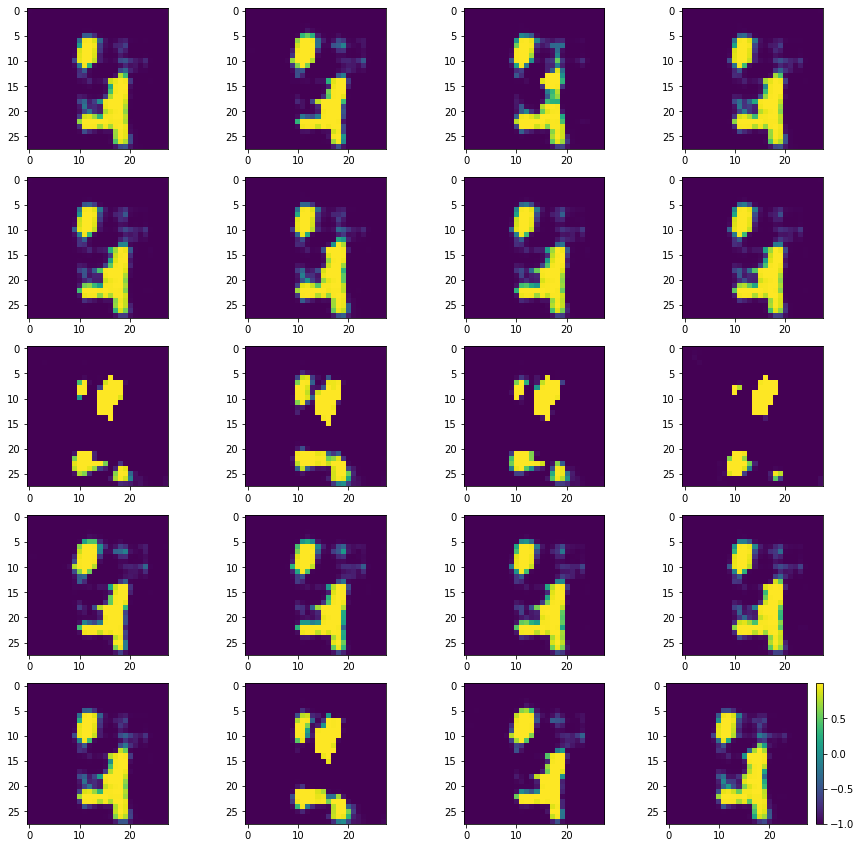

Batch_Num : 137
D_Loss   :   [10.803426742553711, 0.17428767681121826, 10.629138946533203, 0.5, 0.099609375] ;    GAN_Loss   :  [20.021224975585938, 8.351019859313965, 11.670204162597656, 0.0, 0.083984375]
Batch_Num : 138
D_Loss   :   [10.06803035736084, 0.1697068065404892, 9.898324012756348, 0.5, 0.107421875] ;    GAN_Loss   :  [19.01209259033203, 7.385552406311035, 11.626540184020996, 0.0, 0.087890625]
Batch_Num : 139
D_Loss   :   [9.97933578491211, 0.170181006193161, 9.809154510498047, 0.5, 0.109375] ;    GAN_Loss   :  [16.357269287109375, 6.019837379455566, 10.337431907653809, 0.0, 0.08984375]
Batch_Num : 140
D_Loss   :   [9.604645729064941, 0.19655866920948029, 9.408086776733398, 0.5, 0.103515625] ;    GAN_Loss   :  [16.191665649414062, 5.213031768798828, 10.978632926940918, 0.0, 0.060546875]
Batch_Num : 141
D_Loss   :   [10.193325996398926, 0.20689734816551208, 9.986428260803223, 0.498046875, 0.095703125] ;    GAN_Loss   :  [15.324495315551758, 4.5190277099609375, 10.805467605590

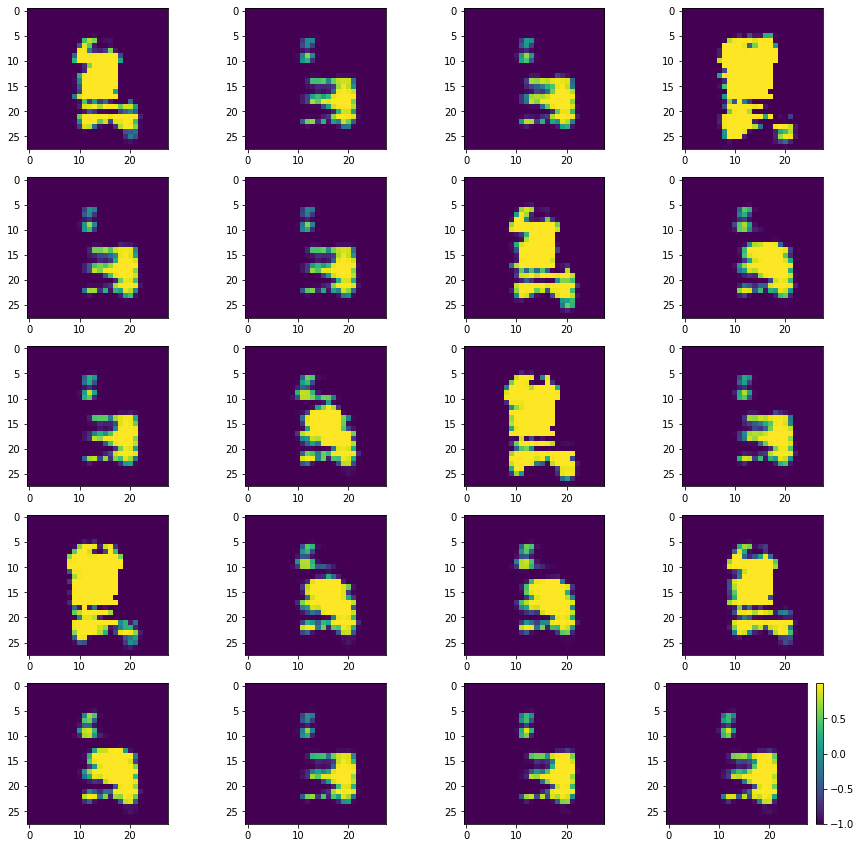

Batch_Num : 152
D_Loss   :   [9.81755542755127, 0.1467467099428177, 9.670808792114258, 0.5, 0.0625] ;    GAN_Loss   :  [15.639847755432129, 4.6415815353393555, 10.998266220092773, 0.0, 0.0625]
Batch_Num : 153
D_Loss   :   [10.082666397094727, 0.15272314846515656, 9.929943084716797, 0.498046875, 0.083984375] ;    GAN_Loss   :  [14.800494194030762, 4.411201477050781, 10.38929271697998, 0.0, 0.0703125]
Batch_Num : 154
D_Loss   :   [10.082366943359375, 0.187022402882576, 9.895344734191895, 0.498046875, 0.080078125] ;    GAN_Loss   :  [17.130290985107422, 6.6200079917907715, 10.510283470153809, 0.0, 0.0625]
Batch_Num : 155
D_Loss   :   [10.435001373291016, 0.17680443823337555, 10.258196830749512, 0.486328125, 0.08984375] ;    GAN_Loss   :  [16.866130828857422, 6.275840759277344, 10.590291023254395, 0.0, 0.0859375]
Batch_Num : 156
D_Loss   :   [9.541238784790039, 0.16964104771614075, 9.371597290039062, 0.49609375, 0.068359375] ;    GAN_Loss   :  [16.70295524597168, 5.636937618255615, 11.0660

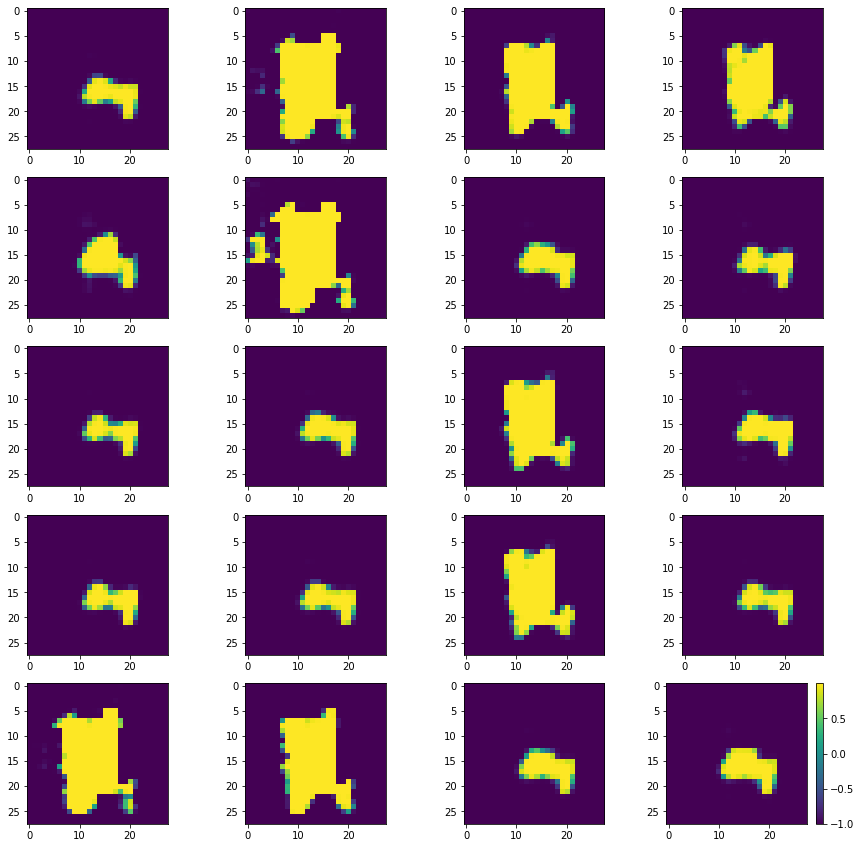

Batch_Num : 167
D_Loss   :   [10.548514366149902, 0.15426567196846008, 10.394248962402344, 0.5, 0.11328125] ;    GAN_Loss   :  [25.490001678466797, 14.632587432861328, 10.857414245605469, 0.0, 0.08984375]
Batch_Num : 168
D_Loss   :   [9.565705299377441, 0.13639596104621887, 9.429308891296387, 0.5, 0.115234375] ;    GAN_Loss   :  [25.119937896728516, 14.603869438171387, 10.516069412231445, 0.0, 0.103515625]
Batch_Num : 169
D_Loss   :   [10.0925874710083, 0.14200840890407562, 9.950578689575195, 0.5, 0.0859375] ;    GAN_Loss   :  [26.881946563720703, 16.07230567932129, 10.809639930725098, 0.0, 0.080078125]
Batch_Num : 170
D_Loss   :   [10.054234504699707, 0.12759855389595032, 9.9266357421875, 0.5, 0.0859375] ;    GAN_Loss   :  [28.12419891357422, 17.141414642333984, 10.982783317565918, 0.0, 0.072265625]
Batch_Num : 171
D_Loss   :   [10.423172950744629, 0.1498490422964096, 10.273324012756348, 0.498046875, 0.109375] ;    GAN_Loss   :  [27.098060607910156, 15.795037269592285, 11.303023338317

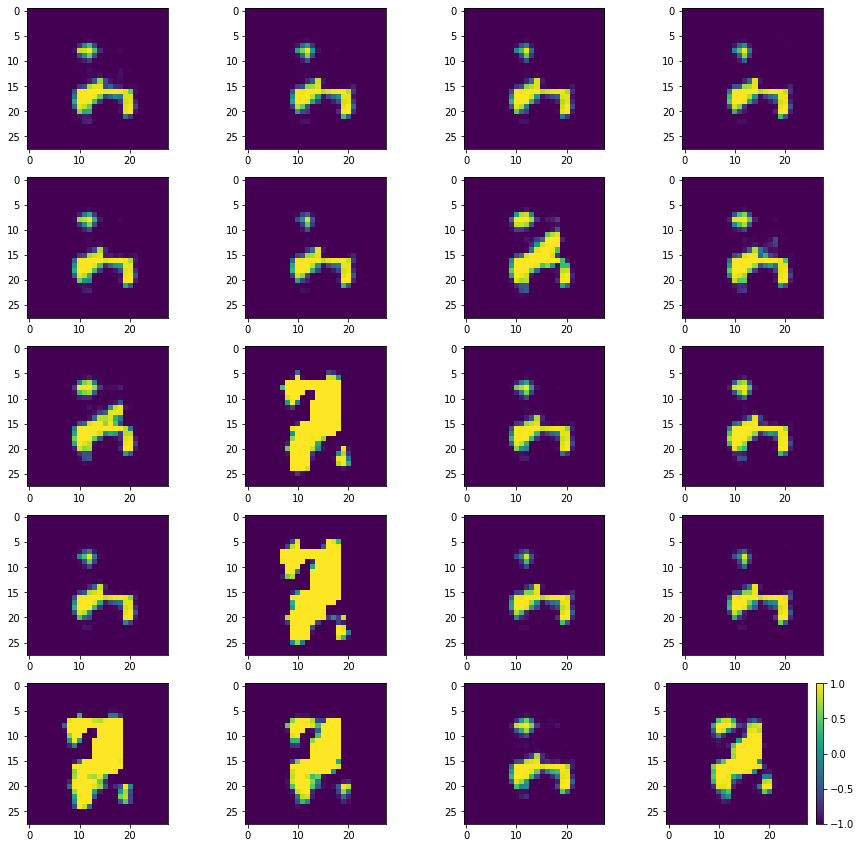

Batch_Num : 182
D_Loss   :   [9.758894920349121, 0.1818150132894516, 9.577079772949219, 0.49609375, 0.103515625] ;    GAN_Loss   :  [22.221025466918945, 11.100013732910156, 11.121011734008789, 0.0, 0.125]
Batch_Num : 183
D_Loss   :   [10.401388168334961, 0.17314277589321136, 10.228245735168457, 0.5, 0.09765625] ;    GAN_Loss   :  [23.464771270751953, 12.116750717163086, 11.348020553588867, 0.0, 0.12890625]
Batch_Num : 184
D_Loss   :   [9.850037574768066, 0.1460522562265396, 9.703985214233398, 0.5, 0.099609375] ;    GAN_Loss   :  [23.026355743408203, 12.07451057434082, 10.951844215393066, 0.0, 0.09375]
Batch_Num : 185
D_Loss   :   [9.960126876831055, 0.1704014092683792, 9.789725303649902, 0.5, 0.08984375] ;    GAN_Loss   :  [22.593704223632812, 11.174881935119629, 11.418821334838867, 0.0, 0.099609375]
Batch_Num : 186
D_Loss   :   [9.54117488861084, 0.1655503809452057, 9.375624656677246, 0.5, 0.119140625] ;    GAN_Loss   :  [22.28741455078125, 11.390207290649414, 10.89720630645752, 0.0, 

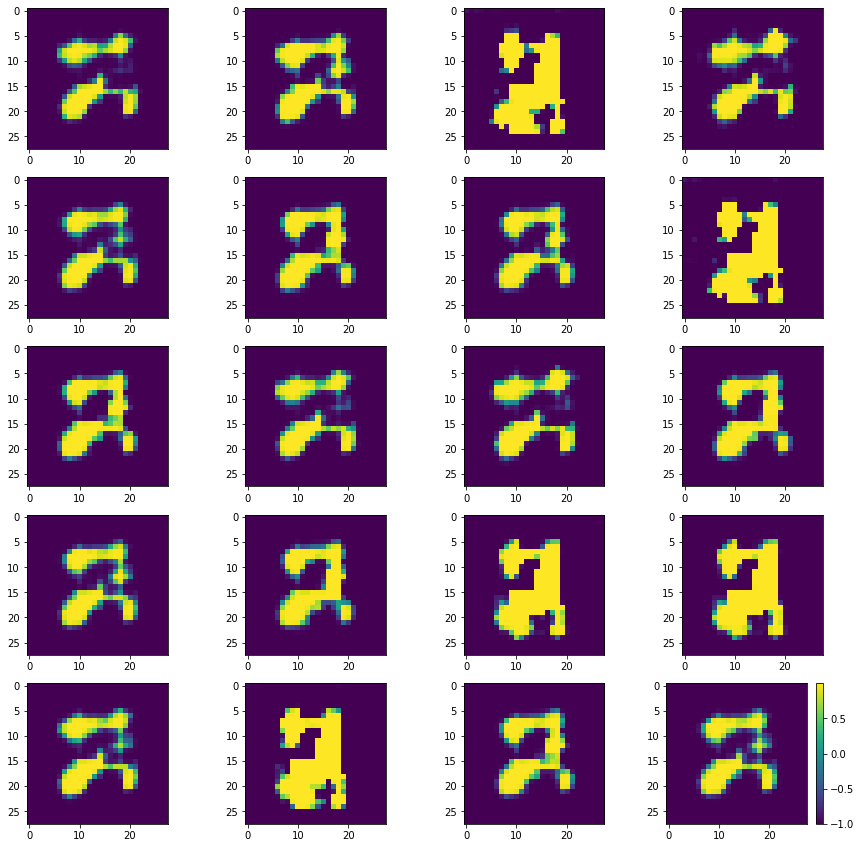

Batch_Num : 197
D_Loss   :   [9.980693817138672, 0.14684399962425232, 9.833849906921387, 0.5, 0.095703125] ;    GAN_Loss   :  [17.419086456298828, 6.876951217651367, 10.542136192321777, 0.0, 0.11328125]
Batch_Num : 198
D_Loss   :   [9.6875, 0.14563414454460144, 9.541866302490234, 0.5, 0.111328125] ;    GAN_Loss   :  [17.577194213867188, 6.80764627456665, 10.769547462463379, 0.0, 0.119140625]
Batch_Num : 199
D_Loss   :   [10.610932350158691, 0.16957855224609375, 10.441353797912598, 0.5, 0.099609375] ;    GAN_Loss   :  [16.35732650756836, 6.494780540466309, 9.862546920776367, 0.0, 0.130859375]
Batch_Num : 200
D_Loss   :   [10.182143211364746, 0.16711196303367615, 10.015030860900879, 0.5, 0.111328125] ;    GAN_Loss   :  [16.833547592163086, 6.303588390350342, 10.529958724975586, 0.0, 0.1171875]
Batch_Num : 201
D_Loss   :   [10.41109561920166, 0.16351020336151123, 10.24758529663086, 0.5, 0.0859375] ;    GAN_Loss   :  [16.537452697753906, 6.193029403686523, 10.3444242477417, 0.0, 0.11523437

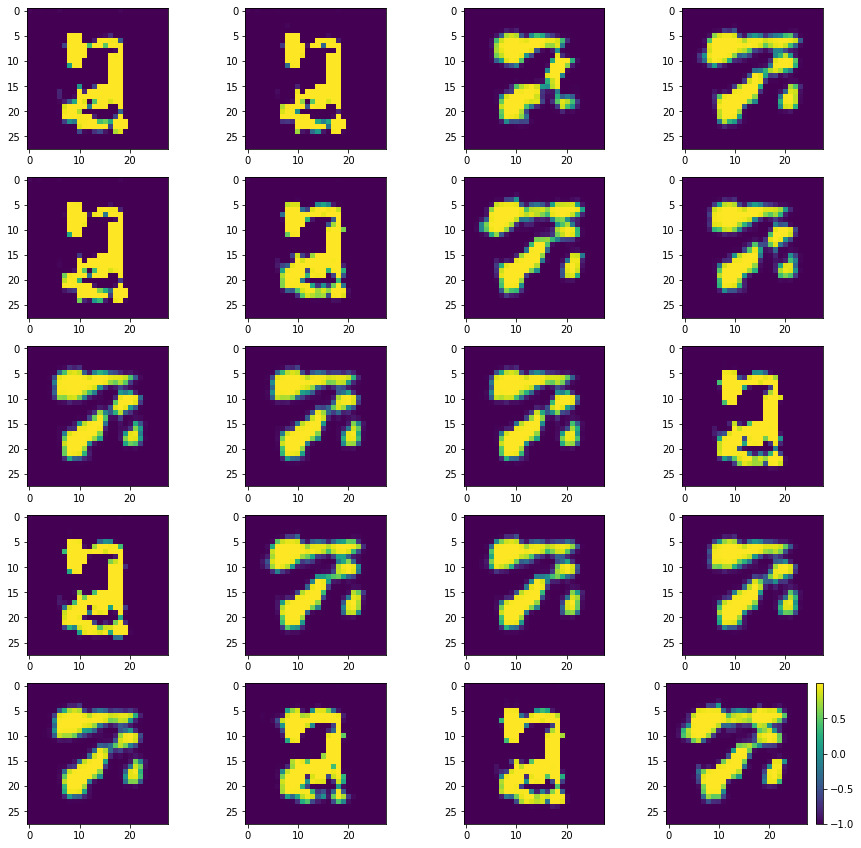

Batch_Num : 212
D_Loss   :   [10.9498929977417, 0.1650298535823822, 10.784863471984863, 0.5, 0.095703125] ;    GAN_Loss   :  [14.13237190246582, 4.148627758026123, 9.983743667602539, 0.0, 0.11328125]
Batch_Num : 213
D_Loss   :   [9.611242294311523, 0.14778102934360504, 9.463460922241211, 0.5, 0.111328125] ;    GAN_Loss   :  [14.429523468017578, 4.033079624176025, 10.396444320678711, 0.0, 0.125]
Batch_Num : 214
D_Loss   :   [10.390378952026367, 0.16138409078121185, 10.228995323181152, 0.498046875, 0.095703125] ;    GAN_Loss   :  [14.38443374633789, 4.2791876792907715, 10.105245590209961, 0.0, 0.1015625]
Batch_Num : 215
D_Loss   :   [9.221693992614746, 0.1526833176612854, 9.069010734558105, 0.498046875, 0.09765625] ;    GAN_Loss   :  [14.436135292053223, 4.25076961517334, 10.185365676879883, 0.0, 0.111328125]
Batch_Num : 216
D_Loss   :   [10.416711807250977, 0.13818900287151337, 10.278522491455078, 0.5, 0.1015625] ;    GAN_Loss   :  [14.220329284667969, 4.106009483337402, 10.114319801330

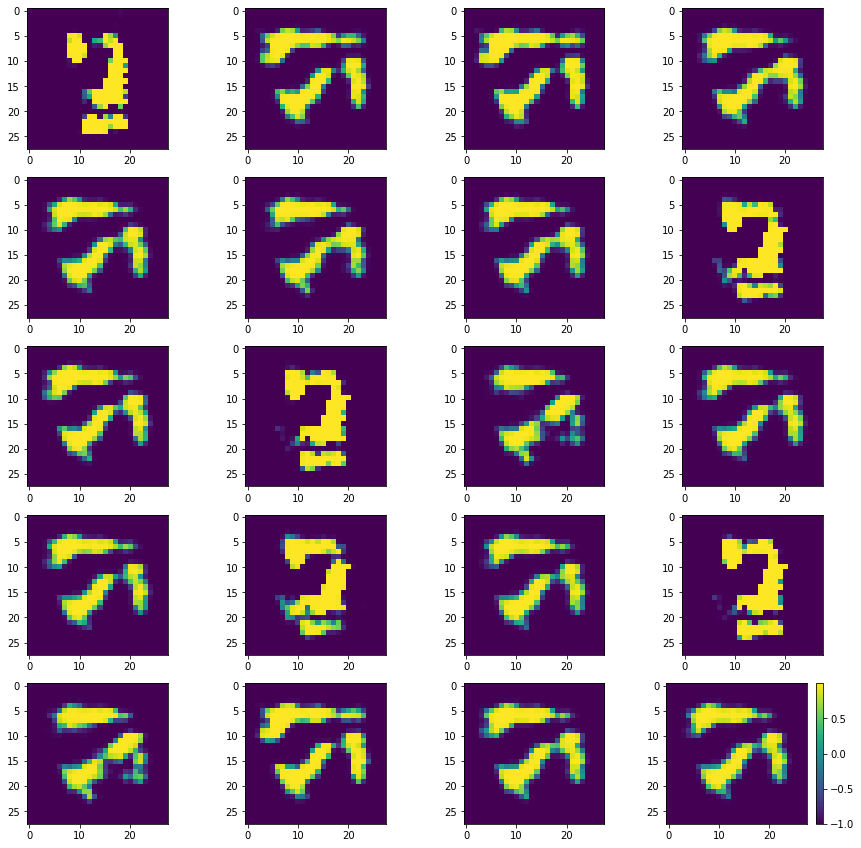

Batch_Num : 227
D_Loss   :   [9.313065528869629, 0.19105111062526703, 9.122014045715332, 0.5, 0.087890625] ;    GAN_Loss   :  [12.359586715698242, 2.3986563682556152, 9.960929870605469, 0.0, 0.087890625]
Batch_Num : 228
D_Loss   :   [10.38039493560791, 0.1536668837070465, 10.226728439331055, 0.5, 0.10546875] ;    GAN_Loss   :  [12.883431434631348, 2.0936567783355713, 10.789774894714355, 0.0, 0.0703125]
Batch_Num : 229
D_Loss   :   [9.791665077209473, 0.1486395001411438, 9.643025398254395, 0.5, 0.064453125] ;    GAN_Loss   :  [12.189048767089844, 2.047274589538574, 10.14177417755127, 0.0, 0.06640625]
Batch_Num : 230
D_Loss   :   [10.133169174194336, 0.1632353514432907, 9.96993350982666, 0.5, 0.07421875] ;    GAN_Loss   :  [11.979330062866211, 1.9992749691009521, 9.98005485534668, 0.0, 0.076171875]
Batch_Num : 231
D_Loss   :   [10.364888191223145, 0.1554594784975052, 10.209428787231445, 0.498046875, 0.109375] ;    GAN_Loss   :  [11.89012336730957, 1.991854190826416, 9.898269653320312, 0.

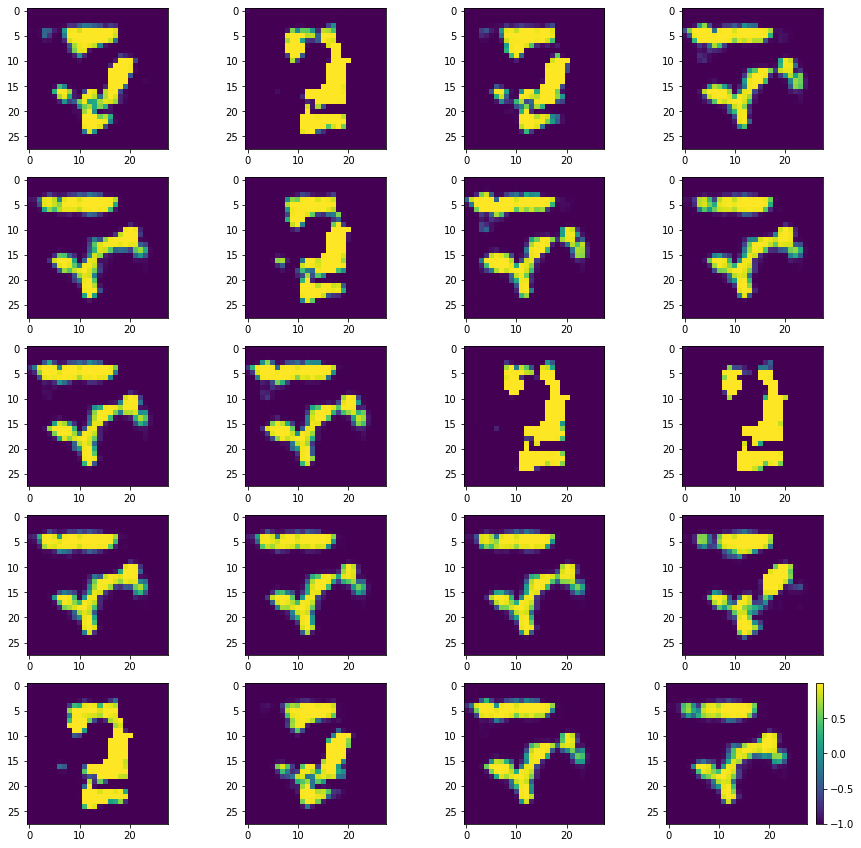

Batch_Num : 2
D_Loss   :   [10.178417205810547, 0.18148671090602875, 9.996930122375488, 0.5, 0.08203125] ;    GAN_Loss   :  [13.670066833496094, 3.663377285003662, 10.00669002532959, 0.0, 0.06640625]
Batch_Num : 3
D_Loss   :   [10.211429595947266, 0.1777876913547516, 10.033641815185547, 0.494140625, 0.087890625] ;    GAN_Loss   :  [13.076432228088379, 2.5177628993988037, 10.558669090270996, 0.0, 0.09375]
Batch_Num : 4
D_Loss   :   [10.384340286254883, 0.17968621850013733, 10.2046537399292, 0.494140625, 0.115234375] ;    GAN_Loss   :  [11.937623977661133, 1.6202082633972168, 10.317415237426758, 0.0, 0.095703125]
Batch_Num : 5
D_Loss   :   [10.277839660644531, 0.22838100790977478, 10.049458503723145, 0.48828125, 0.09765625] ;    GAN_Loss   :  [12.335655212402344, 2.084620952606201, 10.251033782958984, 0.0, 0.111328125]
Batch_Num : 6
D_Loss   :   [10.565412521362305, 0.21270789206027985, 10.352705001831055, 0.498046875, 0.08203125] ;    GAN_Loss   :  [11.901881217956543, 1.980245351791381

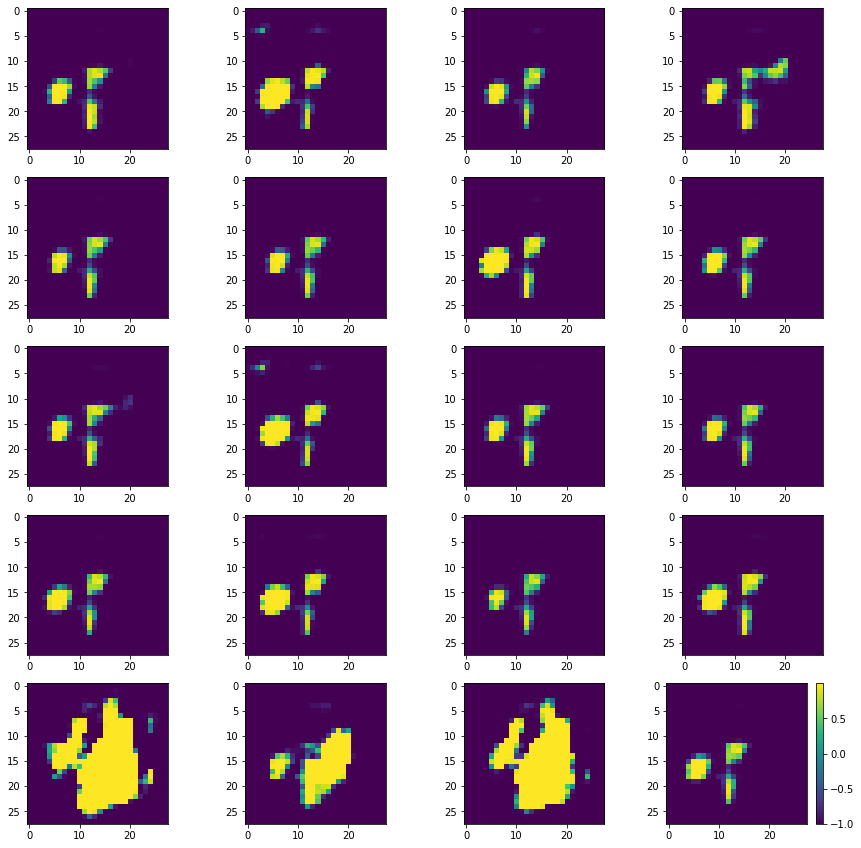

Batch_Num : 17
D_Loss   :   [9.809155464172363, 0.1573878824710846, 9.65176773071289, 0.5, 0.107421875] ;    GAN_Loss   :  [11.57956314086914, 1.967872142791748, 9.611690521240234, 0.0, 0.111328125]
Batch_Num : 18
D_Loss   :   [9.957253456115723, 0.1569777876138687, 9.800275802612305, 0.5, 0.091796875] ;    GAN_Loss   :  [12.740216255187988, 2.9727447032928467, 9.767471313476562, 0.0, 0.140625]
Batch_Num : 19
D_Loss   :   [10.031538963317871, 0.16471289098262787, 9.866826057434082, 0.490234375, 0.109375] ;    GAN_Loss   :  [12.641328811645508, 3.067060708999634, 9.574268341064453, 0.0, 0.103515625]
Batch_Num : 20
D_Loss   :   [9.862128257751465, 0.16722893714904785, 9.694899559020996, 0.48828125, 0.09765625] ;    GAN_Loss   :  [11.943175315856934, 2.209528923034668, 9.733646392822266, 0.0, 0.130859375]
Batch_Num : 21
D_Loss   :   [9.7122163772583, 0.17096315324306488, 9.541253089904785, 0.5, 0.119140625] ;    GAN_Loss   :  [12.904589653015137, 2.8482625484466553, 10.056326866149902, 0.

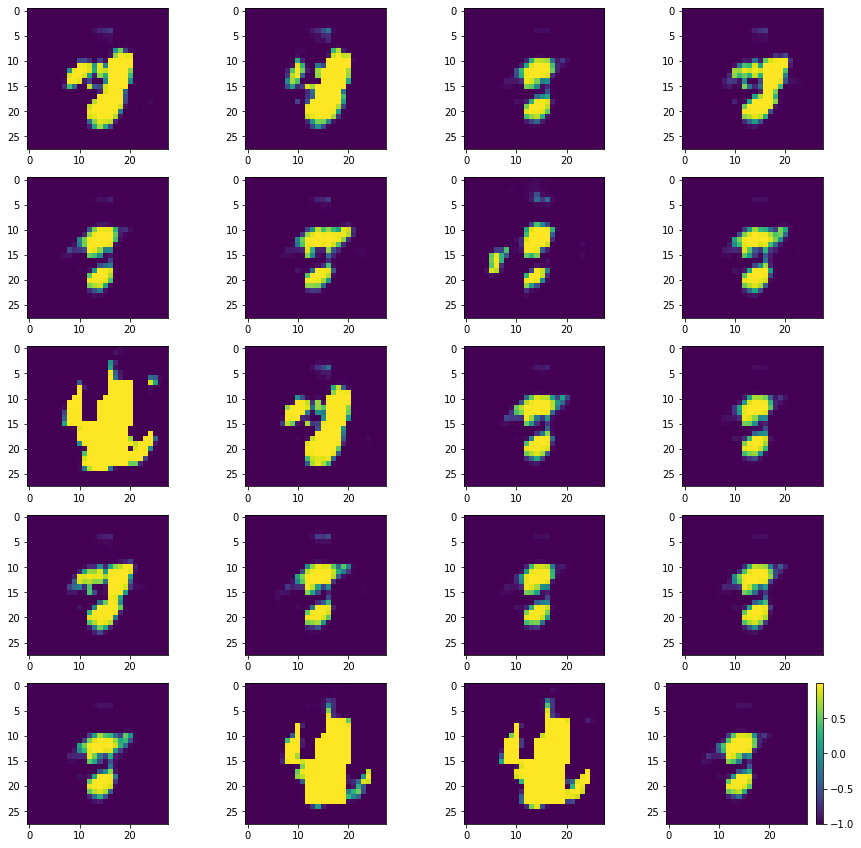

Batch_Num : 32
D_Loss   :   [9.76707649230957, 0.20143137872219086, 9.565645217895508, 0.5, 0.09765625] ;    GAN_Loss   :  [16.303749084472656, 6.420887470245361, 9.882862091064453, 0.0, 0.1171875]
Batch_Num : 33
D_Loss   :   [10.347556114196777, 0.18920210003852844, 10.158353805541992, 0.49609375, 0.095703125] ;    GAN_Loss   :  [16.175582885742188, 6.147438049316406, 10.028144836425781, 0.0, 0.103515625]
Batch_Num : 34
D_Loss   :   [10.454107284545898, 0.24408233165740967, 10.2100248336792, 0.484375, 0.115234375] ;    GAN_Loss   :  [16.308521270751953, 6.3802714347839355, 9.92824935913086, 0.0, 0.1015625]
Batch_Num : 35
D_Loss   :   [9.671380996704102, 0.20743630826473236, 9.463944435119629, 0.498046875, 0.107421875] ;    GAN_Loss   :  [16.182910919189453, 6.40911865234375, 9.773791313171387, 0.0, 0.09375]
Batch_Num : 36
D_Loss   :   [9.772558212280273, 0.23163631558418274, 9.540922164916992, 0.498046875, 0.091796875] ;    GAN_Loss   :  [16.403762817382812, 6.193946361541748, 10.2098

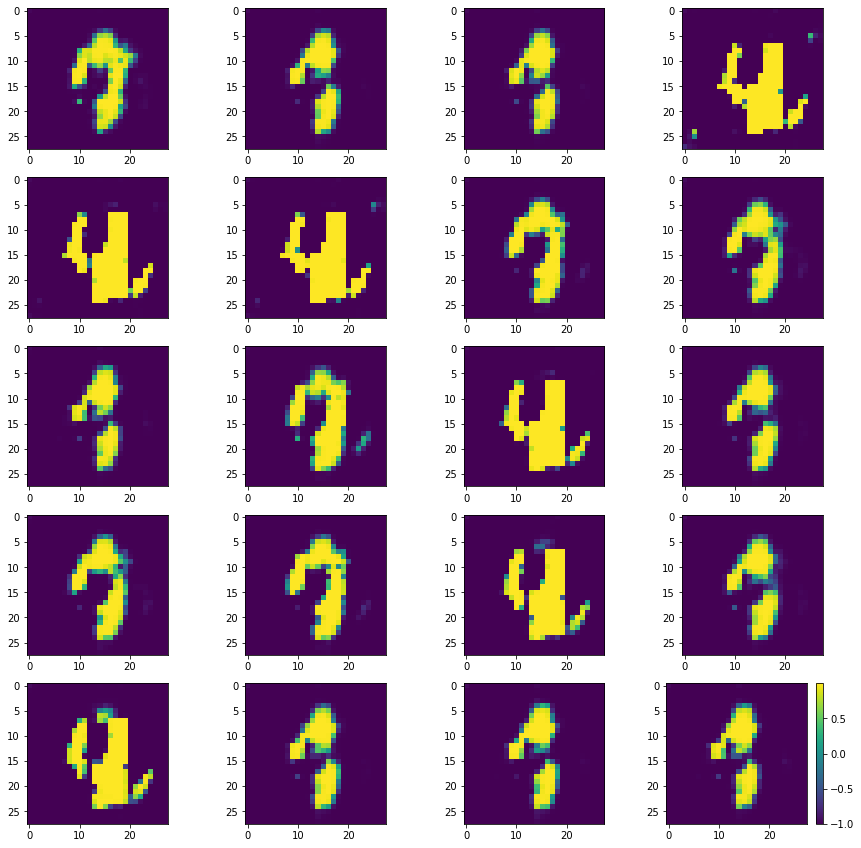

Batch_Num : 47
D_Loss   :   [10.733893394470215, 0.20586083829402924, 10.528032302856445, 0.5, 0.119140625] ;    GAN_Loss   :  [13.853349685668945, 3.9456417560577393, 9.907708168029785, 0.0, 0.119140625]
Batch_Num : 48
D_Loss   :   [10.18062973022461, 0.20214609801769257, 9.978483200073242, 0.498046875, 0.107421875] ;    GAN_Loss   :  [14.048504829406738, 3.993655204772949, 10.054849624633789, 0.0, 0.09765625]
Batch_Num : 49
D_Loss   :   [10.12492561340332, 0.22378936409950256, 9.90113639831543, 0.498046875, 0.115234375] ;    GAN_Loss   :  [14.53200626373291, 4.235841751098633, 10.296164512634277, 0.0, 0.076171875]
Batch_Num : 50
D_Loss   :   [9.834051132202148, 0.20691491663455963, 9.62713623046875, 0.5, 0.08203125] ;    GAN_Loss   :  [14.188987731933594, 4.276195049285889, 9.912792205810547, 0.0, 0.083984375]
Batch_Num : 51
D_Loss   :   [10.487569808959961, 0.233969584107399, 10.253600120544434, 0.49609375, 0.109375] ;    GAN_Loss   :  [14.822617530822754, 5.124295234680176, 9.69832

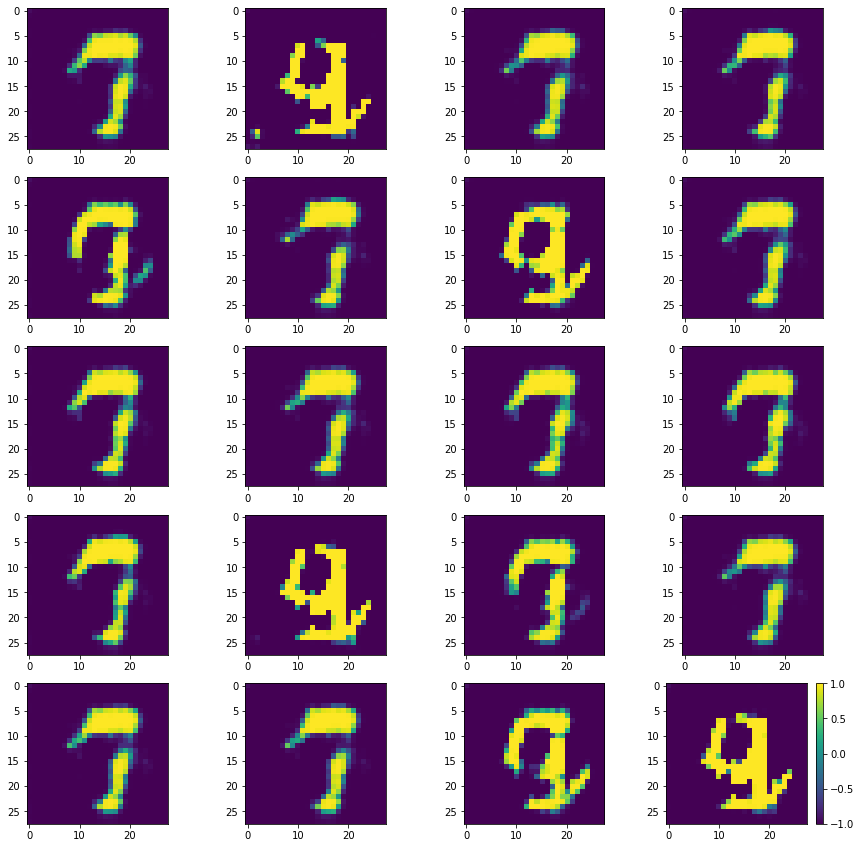

Batch_Num : 62
D_Loss   :   [9.807661056518555, 0.18209469318389893, 9.625566482543945, 0.5, 0.107421875] ;    GAN_Loss   :  [16.13467025756836, 5.433951377868652, 10.70071792602539, 0.0, 0.103515625]
Batch_Num : 63
D_Loss   :   [10.09476089477539, 0.21069203317165375, 9.884068489074707, 0.498046875, 0.10546875] ;    GAN_Loss   :  [15.168034553527832, 5.267599105834961, 9.900435447692871, 0.0, 0.1171875]
Batch_Num : 64
D_Loss   :   [10.044573783874512, 0.17871934175491333, 9.865854263305664, 0.49609375, 0.08203125] ;    GAN_Loss   :  [15.02273178100586, 5.014275074005127, 10.008456230163574, 0.0, 0.1171875]
Batch_Num : 65
D_Loss   :   [10.171768188476562, 0.1684601902961731, 10.003308296203613, 0.498046875, 0.091796875] ;    GAN_Loss   :  [14.682745933532715, 4.8131303787231445, 9.86961555480957, 0.0, 0.091796875]
Batch_Num : 66
D_Loss   :   [10.803804397583008, 0.17304444313049316, 10.630760192871094, 0.5, 0.09375] ;    GAN_Loss   :  [14.344891548156738, 4.722467422485352, 9.622424125

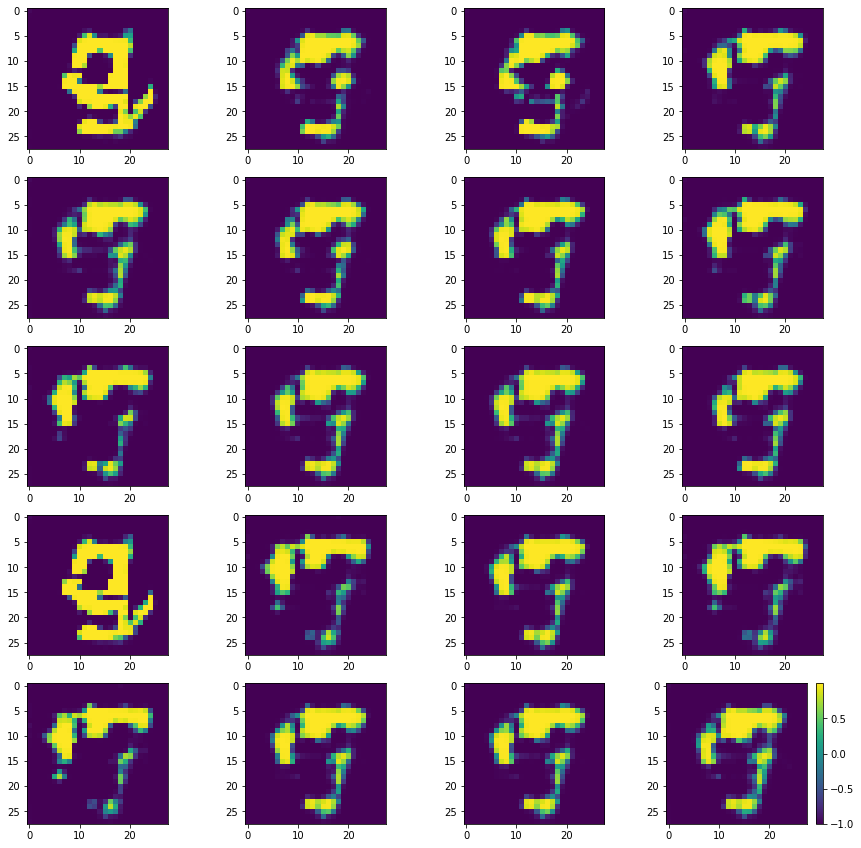

Batch_Num : 77
D_Loss   :   [10.095575332641602, 0.18616986274719238, 9.909405708312988, 0.494140625, 0.0703125] ;    GAN_Loss   :  [11.147476196289062, 1.2092301845550537, 9.93824577331543, 0.0, 0.05859375]
Batch_Num : 78
D_Loss   :   [9.756736755371094, 0.19724571704864502, 9.559491157531738, 0.5, 0.06640625] ;    GAN_Loss   :  [10.66556167602539, 0.8465384244918823, 9.819023132324219, 0.0, 0.064453125]
Batch_Num : 79
D_Loss   :   [10.508480072021484, 0.16741111874580383, 10.341069221496582, 0.5, 0.072265625] ;    GAN_Loss   :  [10.900350570678711, 0.6752076148986816, 10.225142478942871, 0.0, 0.06640625]
Batch_Num : 80
D_Loss   :   [10.041486740112305, 0.15640005469322205, 9.885087013244629, 0.5, 0.06640625] ;    GAN_Loss   :  [10.938494682312012, 0.6999498009681702, 10.238544464111328, 0.0, 0.07421875]
Batch_Num : 81
D_Loss   :   [10.265064239501953, 0.14624032378196716, 10.118824005126953, 0.5, 0.095703125] ;    GAN_Loss   :  [11.00667953491211, 0.6860466003417969, 10.3206329345703

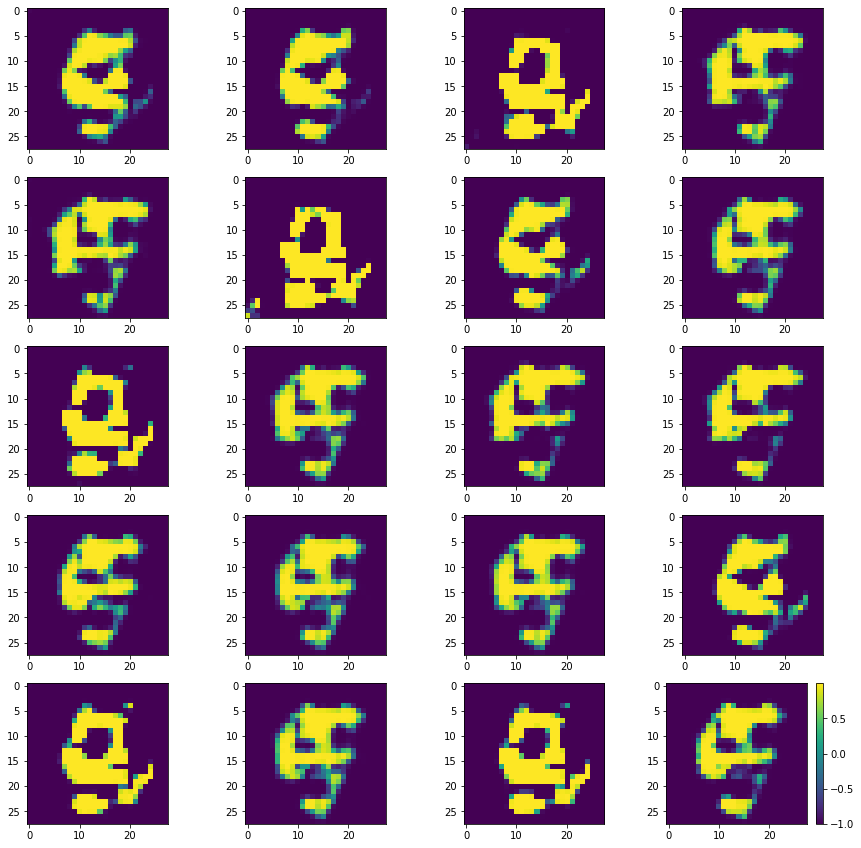

Batch_Num : 92
D_Loss   :   [10.144619941711426, 0.13296233117580414, 10.01165771484375, 0.5, 0.08203125] ;    GAN_Loss   :  [10.3212251663208, 0.38319021463394165, 9.938035011291504, 0.0, 0.06640625]
Batch_Num : 93
D_Loss   :   [10.572810173034668, 0.12291186302900314, 10.449898719787598, 0.5, 0.080078125] ;    GAN_Loss   :  [10.531160354614258, 0.34992489218711853, 10.181235313415527, 0.0, 0.064453125]
Batch_Num : 94
D_Loss   :   [9.995922088623047, 0.12933878600597382, 9.866582870483398, 0.5, 0.087890625] ;    GAN_Loss   :  [10.523974418640137, 0.34407317638397217, 10.179901123046875, 0.0, 0.10546875]
Batch_Num : 95
D_Loss   :   [10.176898002624512, 0.13110946118831635, 10.045788764953613, 0.5, 0.080078125] ;    GAN_Loss   :  [10.765900611877441, 0.34423503279685974, 10.42166519165039, 0.0, 0.0859375]
Batch_Num : 96
D_Loss   :   [9.722431182861328, 0.12158232182264328, 9.600849151611328, 0.5, 0.09375] ;    GAN_Loss   :  [10.292975425720215, 0.3333805203437805, 9.9595947265625, 0.0, 

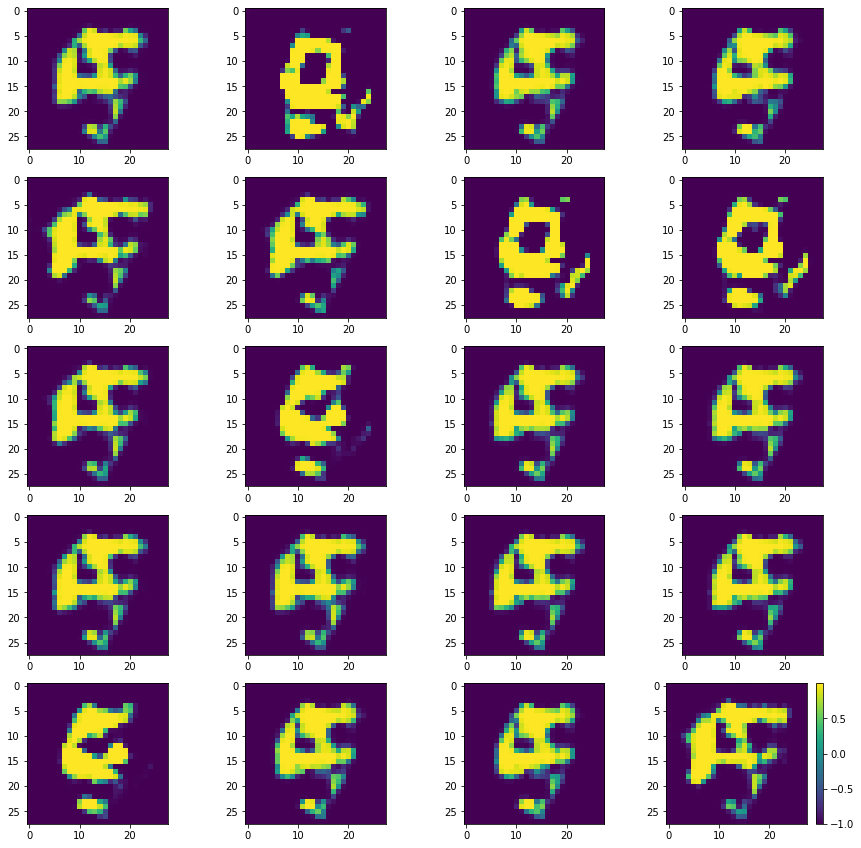

Batch_Num : 107
D_Loss   :   [9.99458122253418, 0.11962269246578217, 9.874958992004395, 0.5, 0.083984375] ;    GAN_Loss   :  [10.897956848144531, 0.29714494943618774, 10.600811958312988, 0.0, 0.107421875]
Batch_Num : 108
D_Loss   :   [9.432997703552246, 0.1326940804719925, 9.30030345916748, 0.5, 0.08984375] ;    GAN_Loss   :  [10.496203422546387, 0.31830018758773804, 10.177903175354004, 0.0, 0.095703125]
Batch_Num : 109
D_Loss   :   [9.636828422546387, 0.11472232639789581, 9.522106170654297, 0.5, 0.08203125] ;    GAN_Loss   :  [9.88256549835205, 0.3077612817287445, 9.574804306030273, 0.0, 0.0859375]
Batch_Num : 110
D_Loss   :   [10.335651397705078, 0.11777923256158829, 10.217872619628906, 0.5, 0.099609375] ;    GAN_Loss   :  [10.245462417602539, 0.30810490250587463, 9.937357902526855, 0.0, 0.072265625]
Batch_Num : 111
D_Loss   :   [9.527647972106934, 0.13202838599681854, 9.39561939239502, 0.5, 0.064453125] ;    GAN_Loss   :  [10.497260093688965, 0.33756187558174133, 10.159698486328125,

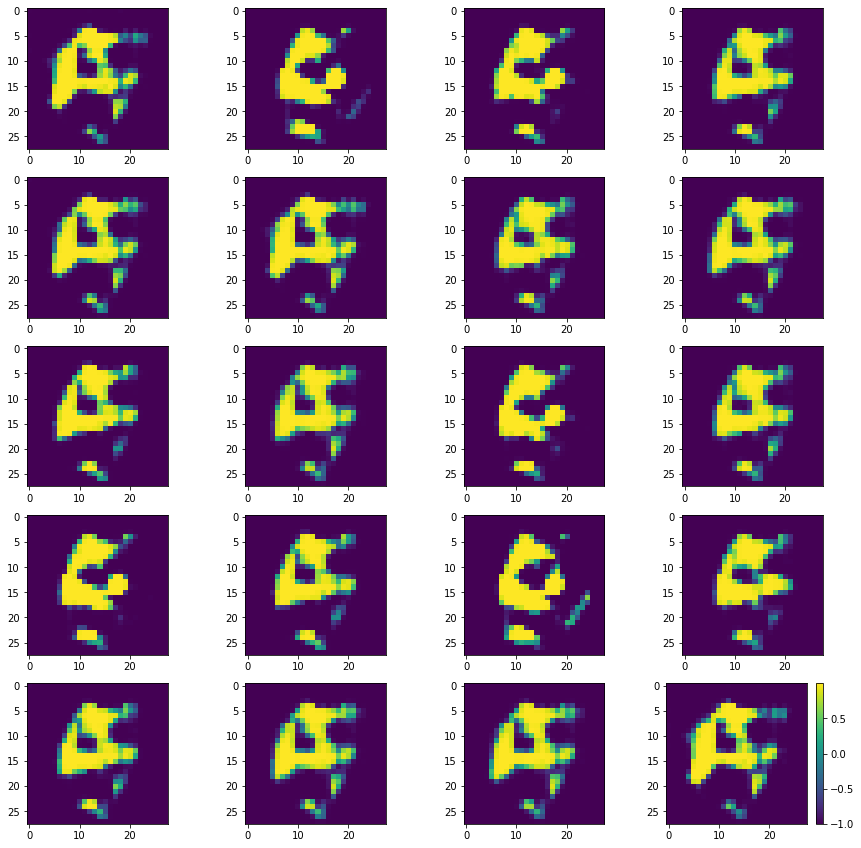

Batch_Num : 122
D_Loss   :   [10.51370906829834, 0.11396811157464981, 10.399741172790527, 0.5, 0.080078125] ;    GAN_Loss   :  [10.717035293579102, 0.2601415514945984, 10.456893920898438, 0.0, 0.078125]
Batch_Num : 123
D_Loss   :   [9.888593673706055, 0.11699621379375458, 9.771597862243652, 0.5, 0.099609375] ;    GAN_Loss   :  [10.64916706085205, 0.26072826981544495, 10.388439178466797, 0.0, 0.08203125]
Batch_Num : 124
D_Loss   :   [10.2386474609375, 0.12318658083677292, 10.115461349487305, 0.5, 0.103515625] ;    GAN_Loss   :  [10.26950740814209, 0.2751780152320862, 9.994329452514648, 0.0, 0.1015625]
Batch_Num : 125
D_Loss   :   [10.433613777160645, 0.13701756298542023, 10.29659652709961, 0.5, 0.083984375] ;    GAN_Loss   :  [10.348268508911133, 0.27765271067619324, 10.070615768432617, 0.0, 0.103515625]
Batch_Num : 126
D_Loss   :   [10.370616912841797, 0.12551580369472504, 10.245100975036621, 0.5, 0.1015625] ;    GAN_Loss   :  [10.157581329345703, 0.30691131949424744, 9.850669860839844

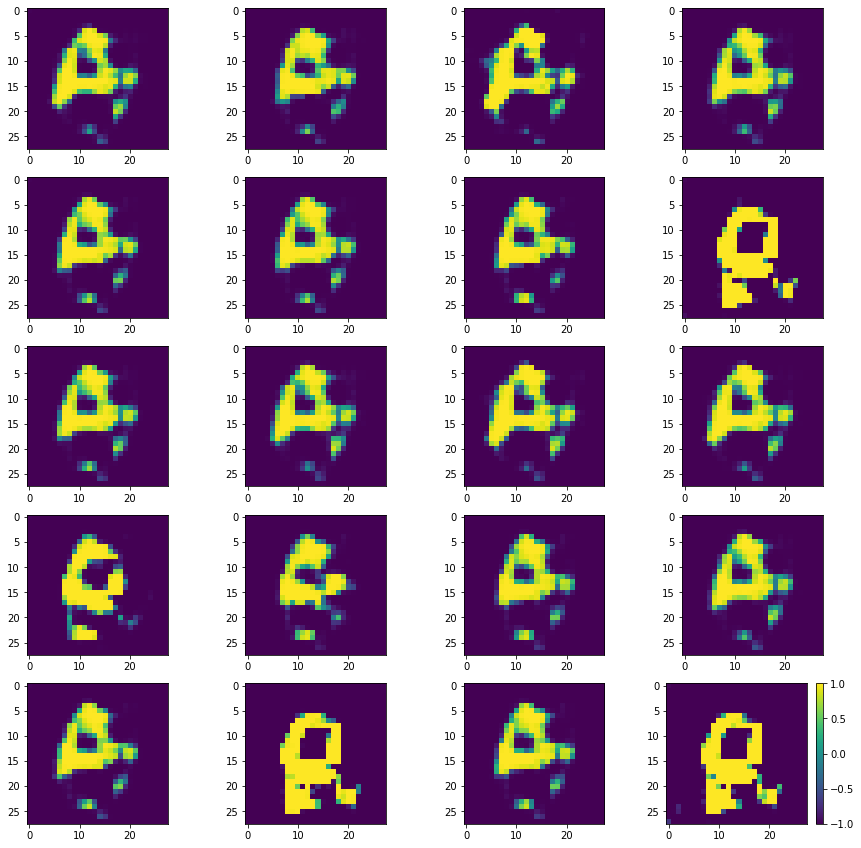

Batch_Num : 137
D_Loss   :   [10.743744850158691, 0.12172715365886688, 10.622017860412598, 0.5, 0.109375] ;    GAN_Loss   :  [10.385214805603027, 0.36915045976638794, 10.016064643859863, 0.0, 0.064453125]
Batch_Num : 138
D_Loss   :   [10.018440246582031, 0.12650901079177856, 9.891931533813477, 0.5, 0.0703125] ;    GAN_Loss   :  [10.085970878601074, 0.35095375776290894, 9.735016822814941, 0.0, 0.05078125]
Batch_Num : 139
D_Loss   :   [9.922102928161621, 0.12441553175449371, 9.797687530517578, 0.5, 0.091796875] ;    GAN_Loss   :  [10.853134155273438, 0.35581326484680176, 10.497321128845215, 0.0, 0.064453125]
Batch_Num : 140
D_Loss   :   [9.515119552612305, 0.12004873156547546, 9.395071029663086, 0.5, 0.08984375] ;    GAN_Loss   :  [10.505081176757812, 0.32771092653274536, 10.177370071411133, 0.0, 0.07421875]
Batch_Num : 141
D_Loss   :   [10.086283683776855, 0.11667667329311371, 9.96960735321045, 0.5, 0.111328125] ;    GAN_Loss   :  [10.297932624816895, 0.3017924427986145, 9.9961404800415

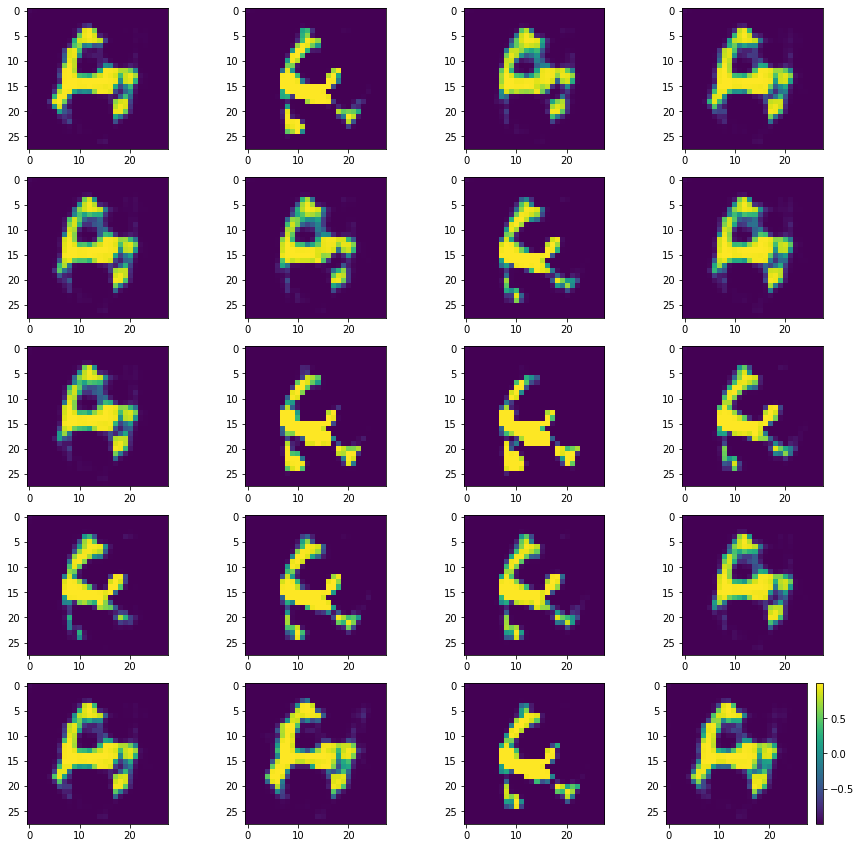

Batch_Num : 152
D_Loss   :   [9.803983688354492, 0.1351068764925003, 9.668876647949219, 0.498046875, 0.123046875] ;    GAN_Loss   :  [10.905680656433105, 0.431056946516037, 10.474623680114746, 0.0, 0.0703125]
Batch_Num : 153
D_Loss   :   [10.060674667358398, 0.13140544295310974, 9.929268836975098, 0.498046875, 0.11328125] ;    GAN_Loss   :  [11.096572875976562, 0.5057352781295776, 10.590837478637695, 0.0, 0.107421875]
Batch_Num : 154
D_Loss   :   [10.031234741210938, 0.13259758055210114, 9.898636817932129, 0.5, 0.109375] ;    GAN_Loss   :  [10.69737434387207, 0.5430729985237122, 10.154301643371582, 0.0, 0.083984375]
Batch_Num : 155
D_Loss   :   [10.40705680847168, 0.14529849588871002, 10.261757850646973, 0.5, 0.09375] ;    GAN_Loss   :  [10.538307189941406, 0.6772516369819641, 9.861055374145508, 0.0, 0.078125]
Batch_Num : 156
D_Loss   :   [9.523211479187012, 0.15132129192352295, 9.3718900680542, 0.5, 0.103515625] ;    GAN_Loss   :  [11.02550983428955, 0.641867995262146, 10.383642196655

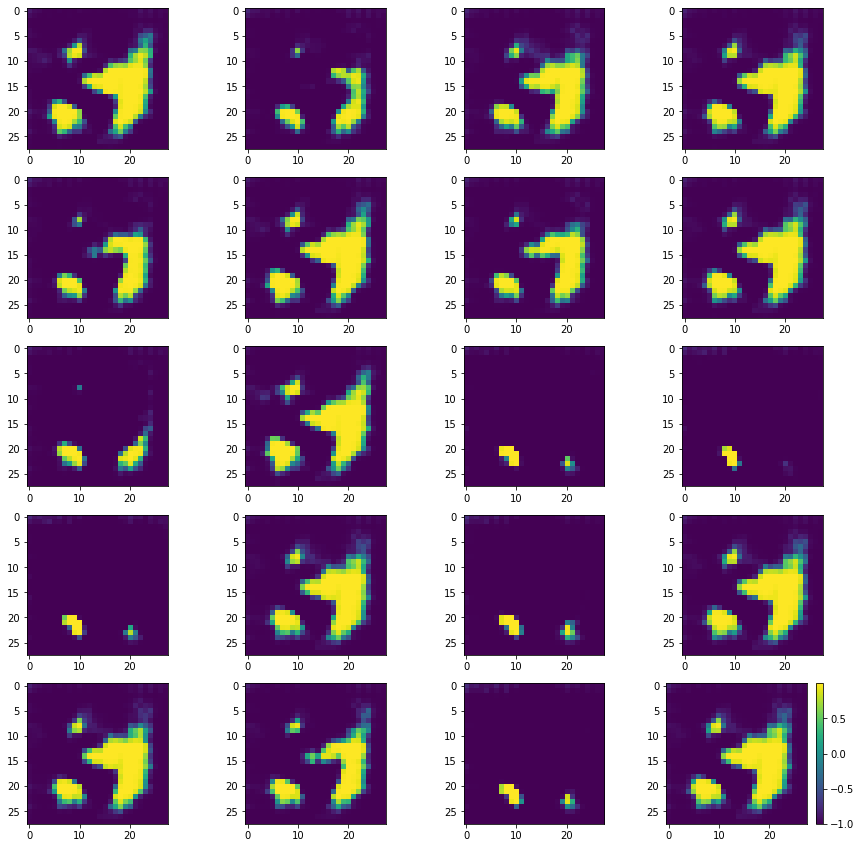

Batch_Num : 167
D_Loss   :   [10.612059593200684, 0.21062211692333221, 10.401437759399414, 0.4921875, 0.08984375] ;    GAN_Loss   :  [20.794221878051758, 9.053812980651855, 11.740408897399902, 0.0, 0.068359375]
Batch_Num : 168
D_Loss   :   [9.583767890930176, 0.14532127976417542, 9.438446998596191, 0.5, 0.083984375] ;    GAN_Loss   :  [19.24375343322754, 8.205562591552734, 11.038190841674805, 0.0, 0.05859375]
Batch_Num : 169
D_Loss   :   [10.0950927734375, 0.14232280850410461, 9.952770233154297, 0.5, 0.095703125] ;    GAN_Loss   :  [19.127174377441406, 7.980477333068848, 11.146697998046875, 0.0, 0.072265625]
Batch_Num : 170
D_Loss   :   [10.092296600341797, 0.15896835923194885, 9.933328628540039, 0.5, 0.09765625] ;    GAN_Loss   :  [19.153432846069336, 7.930660724639893, 11.222772598266602, 0.0, 0.0703125]
Batch_Num : 171
D_Loss   :   [10.436140060424805, 0.16207654774188995, 10.274063110351562, 0.49609375, 0.0859375] ;    GAN_Loss   :  [20.304346084594727, 8.777135848999023, 11.527210

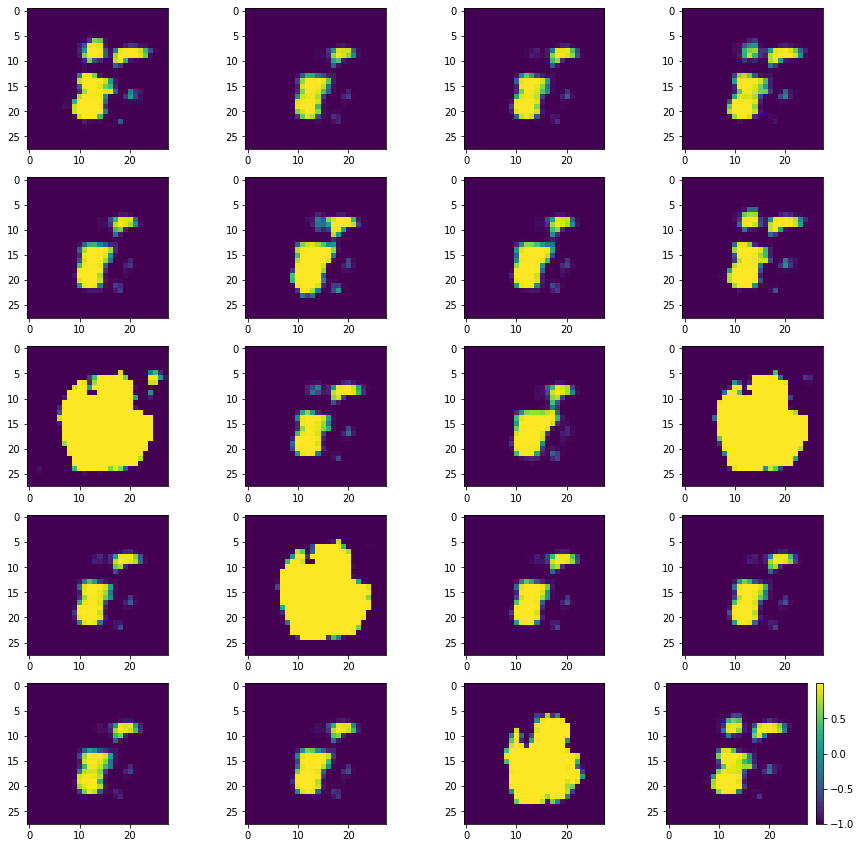

Batch_Num : 182
D_Loss   :   [9.843182563781738, 0.259549081325531, 9.583633422851562, 0.490234375, 0.091796875] ;    GAN_Loss   :  [24.723876953125, 12.82669734954834, 11.897180557250977, 0.0, 0.125]
Batch_Num : 183
D_Loss   :   [10.431921005249023, 0.19183829426765442, 10.240082740783691, 0.5, 0.072265625] ;    GAN_Loss   :  [25.446922302246094, 13.012767791748047, 12.434154510498047, 0.0, 0.06640625]
Batch_Num : 184
D_Loss   :   [9.934865951538086, 0.21352055668830872, 9.721344947814941, 0.4921875, 0.109375] ;    GAN_Loss   :  [23.856830596923828, 12.980257987976074, 10.876571655273438, 0.0, 0.1171875]
Batch_Num : 185
D_Loss   :   [9.983597755432129, 0.19237980246543884, 9.791217803955078, 0.4921875, 0.109375] ;    GAN_Loss   :  [21.08331298828125, 9.531704902648926, 11.55160903930664, 0.0, 0.076171875]
Batch_Num : 186
D_Loss   :   [9.740428924560547, 0.3168396055698395, 9.423589706420898, 0.49609375, 0.083984375] ;    GAN_Loss   :  [18.917724609375, 7.485913276672363, 11.4318103790

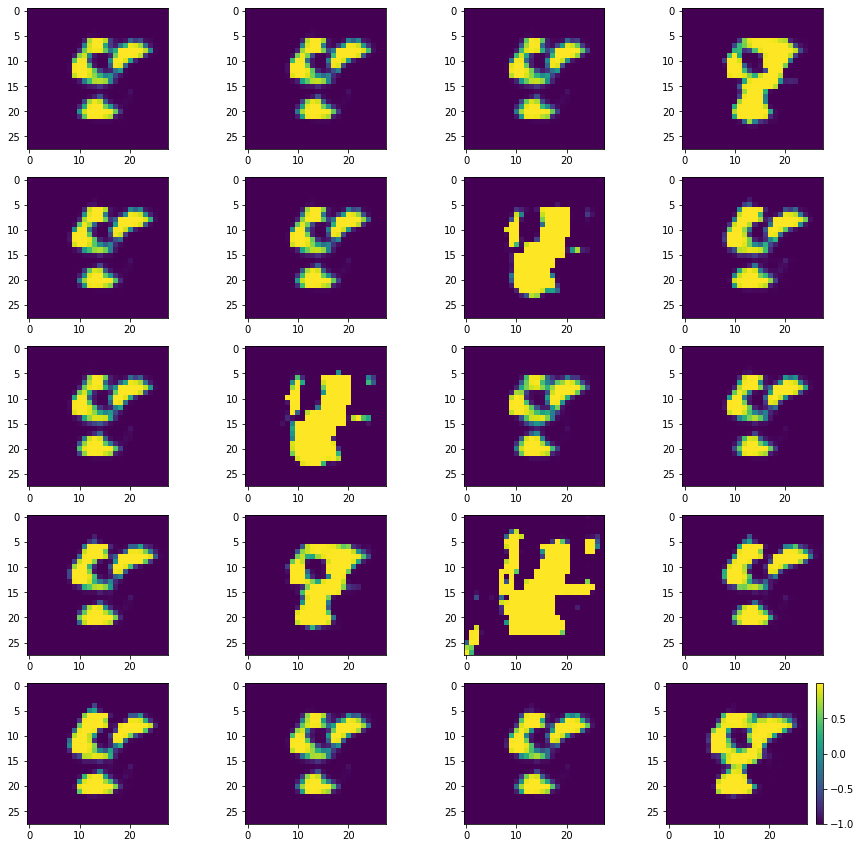

Batch_Num : 197
D_Loss   :   [9.991571426391602, 0.15038853883743286, 9.841182708740234, 0.5, 0.087890625] ;    GAN_Loss   :  [16.51384735107422, 5.254883766174316, 11.258962631225586, 0.0, 0.076171875]
Batch_Num : 198
D_Loss   :   [9.697563171386719, 0.15376418828964233, 9.54379940032959, 0.5, 0.07421875] ;    GAN_Loss   :  [15.862375259399414, 5.280659198760986, 10.58171558380127, 0.0, 0.076171875]
Batch_Num : 199
D_Loss   :   [10.616854667663574, 0.16722014546394348, 10.449634552001953, 0.5, 0.099609375] ;    GAN_Loss   :  [16.061504364013672, 5.180019378662109, 10.881484031677246, 0.0, 0.07421875]
Batch_Num : 200
D_Loss   :   [10.210654258728027, 0.1910143345594406, 10.01963996887207, 0.498046875, 0.09765625] ;    GAN_Loss   :  [15.998477935791016, 5.153716564178467, 10.844761848449707, 0.0, 0.068359375]
Batch_Num : 201
D_Loss   :   [10.477591514587402, 0.21253874897956848, 10.265052795410156, 0.498046875, 0.091796875] ;    GAN_Loss   :  [16.402875900268555, 5.4327545166015625, 10.

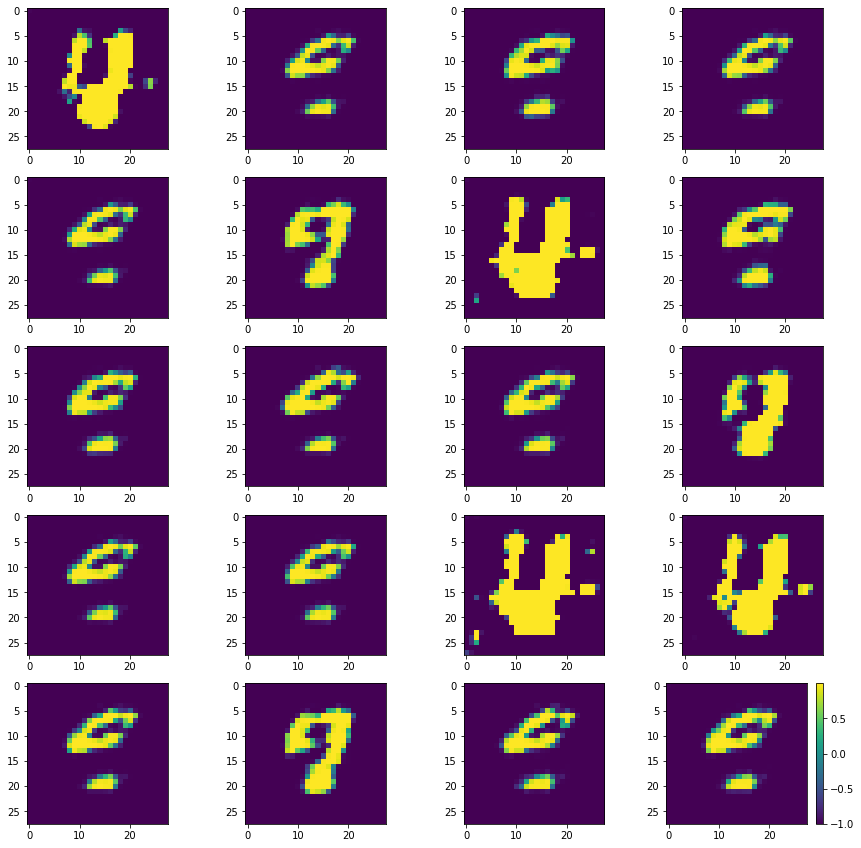

Batch_Num : 212
D_Loss   :   [10.968255996704102, 0.17604555189609528, 10.792210578918457, 0.498046875, 0.083984375] ;    GAN_Loss   :  [16.841398239135742, 5.522590160369873, 11.318808555603027, 0.0, 0.11328125]
Batch_Num : 213
D_Loss   :   [9.652864456176758, 0.1858372688293457, 9.467026710510254, 0.5, 0.091796875] ;    GAN_Loss   :  [17.003009796142578, 6.213796615600586, 10.789213180541992, 0.0, 0.07421875]
Batch_Num : 214
D_Loss   :   [10.423542022705078, 0.18207716941833496, 10.241464614868164, 0.498046875, 0.107421875] ;    GAN_Loss   :  [18.466053009033203, 7.436894416809082, 11.029157638549805, 0.0, 0.076171875]
Batch_Num : 215
D_Loss   :   [9.244232177734375, 0.17221754789352417, 9.072014808654785, 0.5, 0.080078125] ;    GAN_Loss   :  [18.1055908203125, 6.844627857208252, 11.260963439941406, 0.0, 0.068359375]
Batch_Num : 216
D_Loss   :   [10.465702056884766, 0.1803327202796936, 10.285368919372559, 0.494140625, 0.08203125] ;    GAN_Loss   :  [17.378467559814453, 6.637728691101

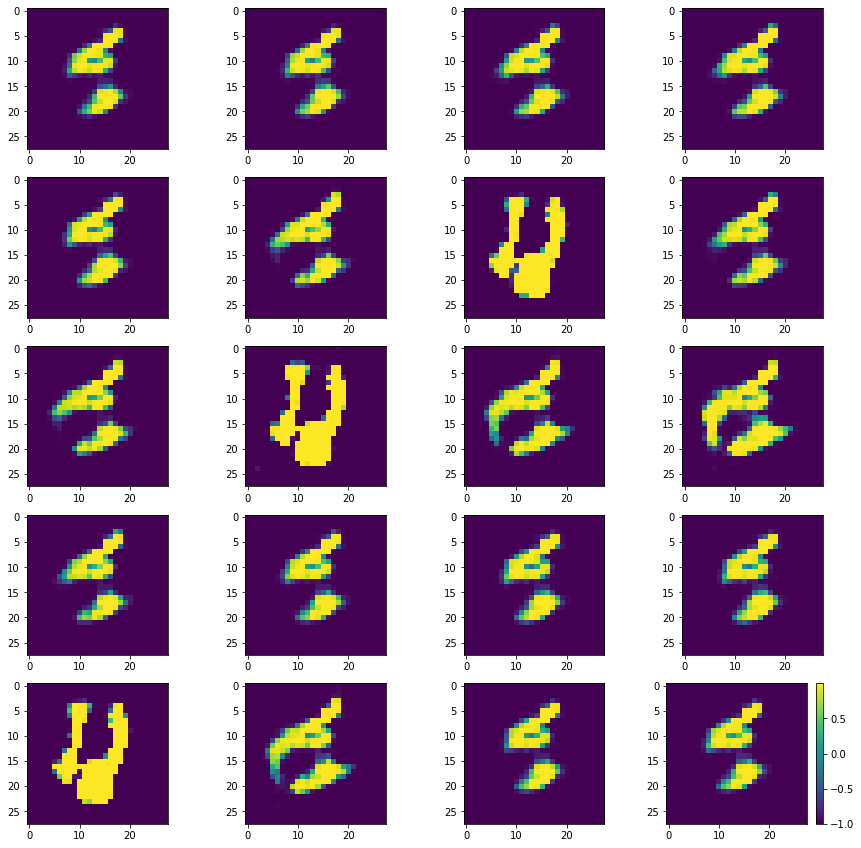

Batch_Num : 227
D_Loss   :   [9.282340049743652, 0.1591011881828308, 9.123238563537598, 0.494140625, 0.0859375] ;    GAN_Loss   :  [16.612464904785156, 5.7831244468688965, 10.829340934753418, 0.0, 0.087890625]
Batch_Num : 228
D_Loss   :   [10.395563125610352, 0.16345453262329102, 10.232108116149902, 0.49609375, 0.09765625] ;    GAN_Loss   :  [15.85348892211914, 5.256246089935303, 10.597243309020996, 0.0, 0.087890625]
Batch_Num : 229
D_Loss   :   [9.823783874511719, 0.17621725797653198, 9.647566795349121, 0.486328125, 0.087890625] ;    GAN_Loss   :  [16.771615982055664, 5.350843906402588, 11.420771598815918, 0.0, 0.087890625]
Batch_Num : 230
D_Loss   :   [10.124183654785156, 0.15317237377166748, 9.9710111618042, 0.4921875, 0.08203125] ;    GAN_Loss   :  [16.22454071044922, 5.222846031188965, 11.00169563293457, 0.0, 0.056640625]
Batch_Num : 231
D_Loss   :   [10.380376815795898, 0.16271789371967316, 10.217658996582031, 0.49609375, 0.1015625] ;    GAN_Loss   :  [15.996576309204102, 4.93454

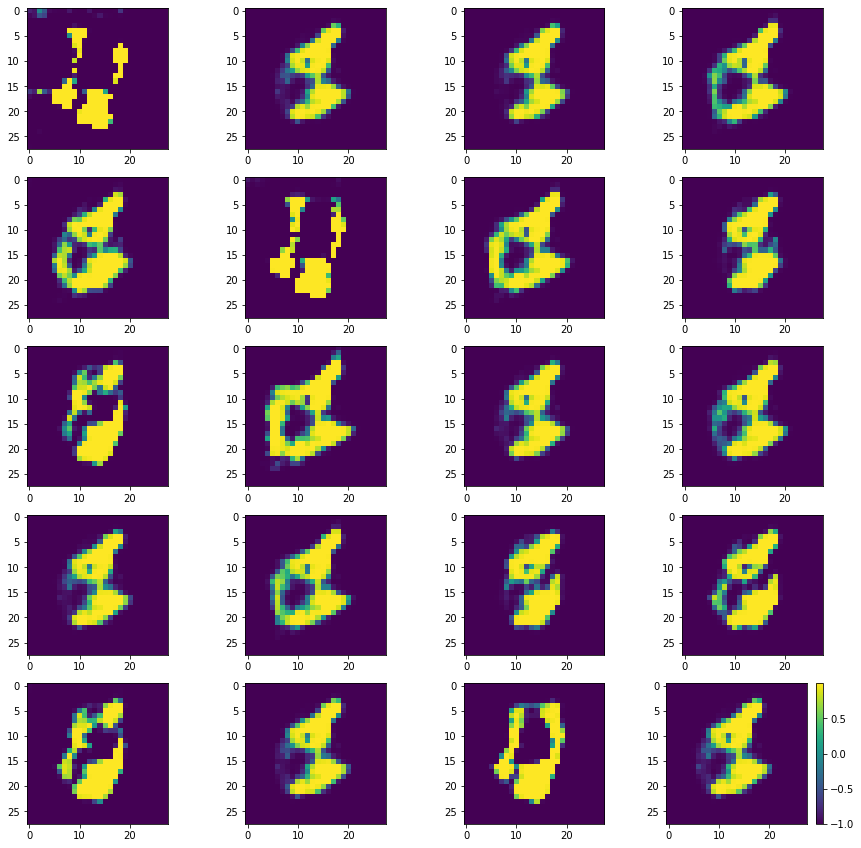

Batch_Num : 2
D_Loss   :   [10.174776077270508, 0.17228570580482483, 10.002490043640137, 0.498046875, 0.068359375] ;    GAN_Loss   :  [16.935077667236328, 5.5870161056518555, 11.348060607910156, 0.0, 0.01953125]
Batch_Num : 3
D_Loss   :   [10.195696830749512, 0.15451045334339142, 10.041186332702637, 0.5, 0.091796875] ;    GAN_Loss   :  [16.174226760864258, 5.013192653656006, 11.161033630371094, 0.0, 0.03125]
Batch_Num : 4
D_Loss   :   [10.374151229858398, 0.16141366958618164, 10.212738037109375, 0.5, 0.08984375] ;    GAN_Loss   :  [16.562389373779297, 4.694457530975342, 11.867932319641113, 0.0, 0.03125]
Batch_Num : 5
D_Loss   :   [10.327383995056152, 0.24902501702308655, 10.07835865020752, 0.490234375, 0.130859375] ;    GAN_Loss   :  [16.604799270629883, 4.526843070983887, 12.077956199645996, 0.0, 0.12109375]
Batch_Num : 6
D_Loss   :   [10.624629974365234, 0.2559460699558258, 10.368683815002441, 0.5, 0.1484375] ;    GAN_Loss   :  [16.85605239868164, 4.676043510437012, 12.18000984191894

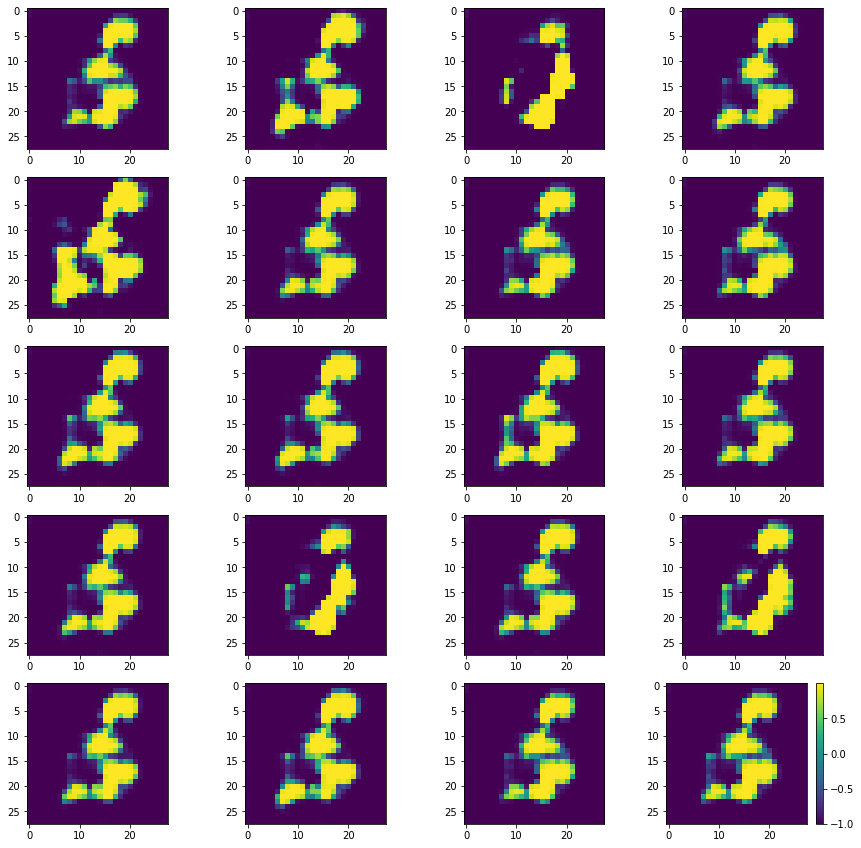

Batch_Num : 17
D_Loss   :   [9.885210037231445, 0.20744085311889648, 9.67776870727539, 0.5, 0.13671875] ;    GAN_Loss   :  [14.999537467956543, 3.8591480255126953, 11.140389442443848, 0.0, 0.095703125]
Batch_Num : 18
D_Loss   :   [10.063594818115234, 0.21769867837429047, 9.845895767211914, 0.498046875, 0.1015625] ;    GAN_Loss   :  [15.21532154083252, 4.3119001388549805, 10.903421401977539, 0.0, 0.078125]
Batch_Num : 19
D_Loss   :   [10.08466625213623, 0.19979634881019592, 9.884869575500488, 0.5, 0.080078125] ;    GAN_Loss   :  [15.820738792419434, 4.460057258605957, 11.360681533813477, 0.0, 0.103515625]
Batch_Num : 20
D_Loss   :   [9.89608383178711, 0.1778034120798111, 9.718280792236328, 0.498046875, 0.095703125] ;    GAN_Loss   :  [16.32331085205078, 4.56792688369751, 11.75538444519043, 0.0, 0.103515625]
Batch_Num : 21
D_Loss   :   [9.728507041931152, 0.16570250689983368, 9.562804222106934, 0.5, 0.080078125] ;    GAN_Loss   :  [15.918134689331055, 4.2758708000183105, 11.6422634124755

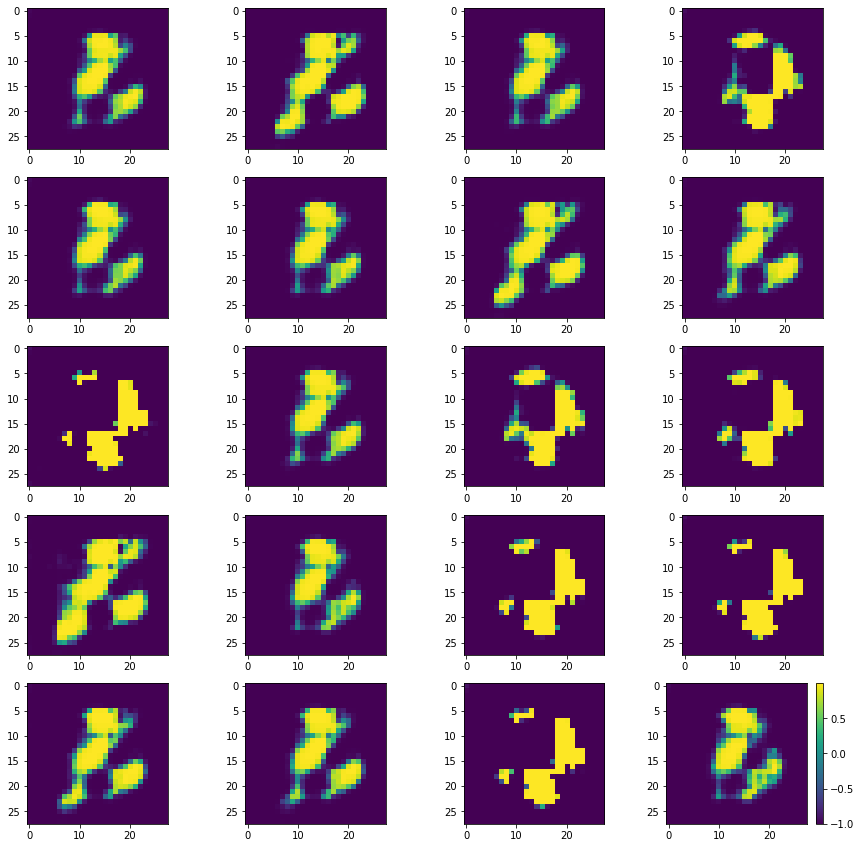

Batch_Num : 32
D_Loss   :   [9.781365394592285, 0.20264902710914612, 9.578716278076172, 0.5, 0.09765625] ;    GAN_Loss   :  [15.822381019592285, 4.268768310546875, 11.55361270904541, 0.0, 0.095703125]
Batch_Num : 33
D_Loss   :   [10.391887664794922, 0.20075267553329468, 10.19113540649414, 0.5, 0.0703125] ;    GAN_Loss   :  [16.205530166625977, 5.138786792755127, 11.066742897033691, 0.0, 0.099609375]
Batch_Num : 34
D_Loss   :   [10.5027437210083, 0.2263985127210617, 10.276345252990723, 0.5, 0.09375] ;    GAN_Loss   :  [16.119613647460938, 4.999447345733643, 11.120166778564453, 0.0, 0.08203125]
Batch_Num : 35
D_Loss   :   [9.68993854522705, 0.22147418558597565, 9.468463897705078, 0.4609375, 0.080078125] ;    GAN_Loss   :  [16.222095489501953, 4.692366600036621, 11.529729843139648, 0.0, 0.078125]
Batch_Num : 36
D_Loss   :   [9.693807601928711, 0.15267178416252136, 9.541135787963867, 0.5, 0.09375] ;    GAN_Loss   :  [17.146957397460938, 4.788018226623535, 12.358939170837402, 0.0, 0.0898437

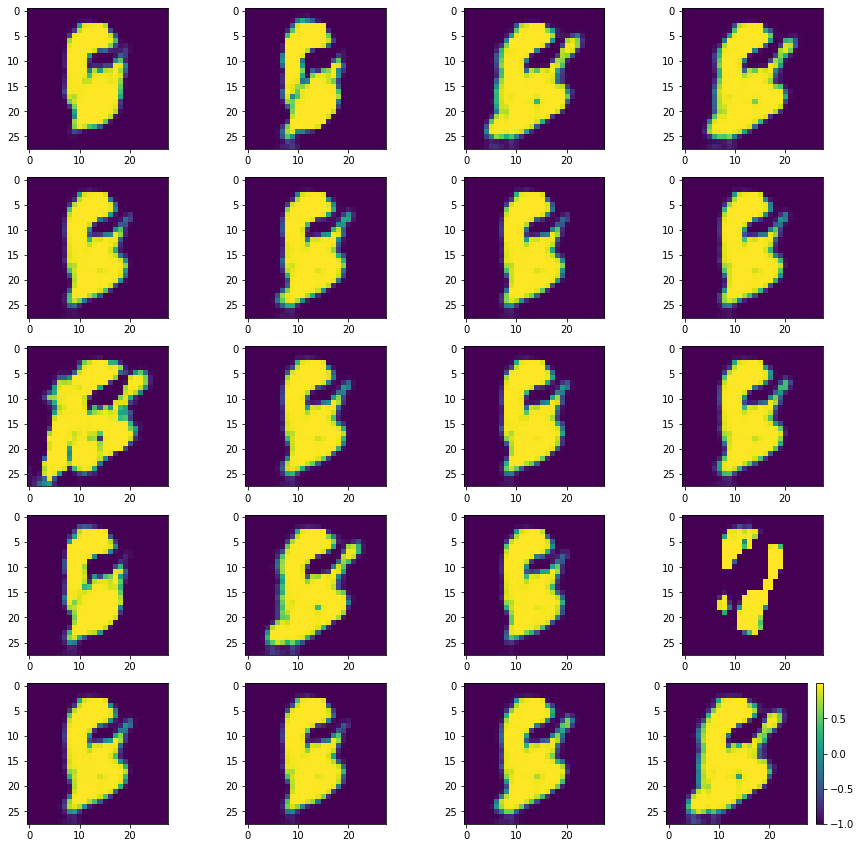

Batch_Num : 47
D_Loss   :   [10.762307167053223, 0.18797388672828674, 10.574333190917969, 0.498046875, 0.1015625] ;    GAN_Loss   :  [16.972469329833984, 5.316054344177246, 11.656414985656738, 0.0, 0.12109375]
Batch_Num : 48
D_Loss   :   [10.13849925994873, 0.15498411655426025, 9.983514785766602, 0.498046875, 0.083984375] ;    GAN_Loss   :  [18.250526428222656, 5.375265598297119, 12.875261306762695, 0.0, 0.11328125]
Batch_Num : 49
D_Loss   :   [10.062409400939941, 0.14748211205005646, 9.91492748260498, 0.5, 0.08984375] ;    GAN_Loss   :  [17.98116111755371, 5.484048366546631, 12.497112274169922, 0.0, 0.10546875]
Batch_Num : 50
D_Loss   :   [9.773237228393555, 0.13959291577339172, 9.633644104003906, 0.5, 0.052734375] ;    GAN_Loss   :  [18.855457305908203, 5.619475364685059, 13.235980987548828, 0.0, 0.080078125]
Batch_Num : 51
D_Loss   :   [10.415542602539062, 0.1465703696012497, 10.268972396850586, 0.5, 0.09765625] ;    GAN_Loss   :  [19.580806732177734, 5.531044006347656, 14.049762725

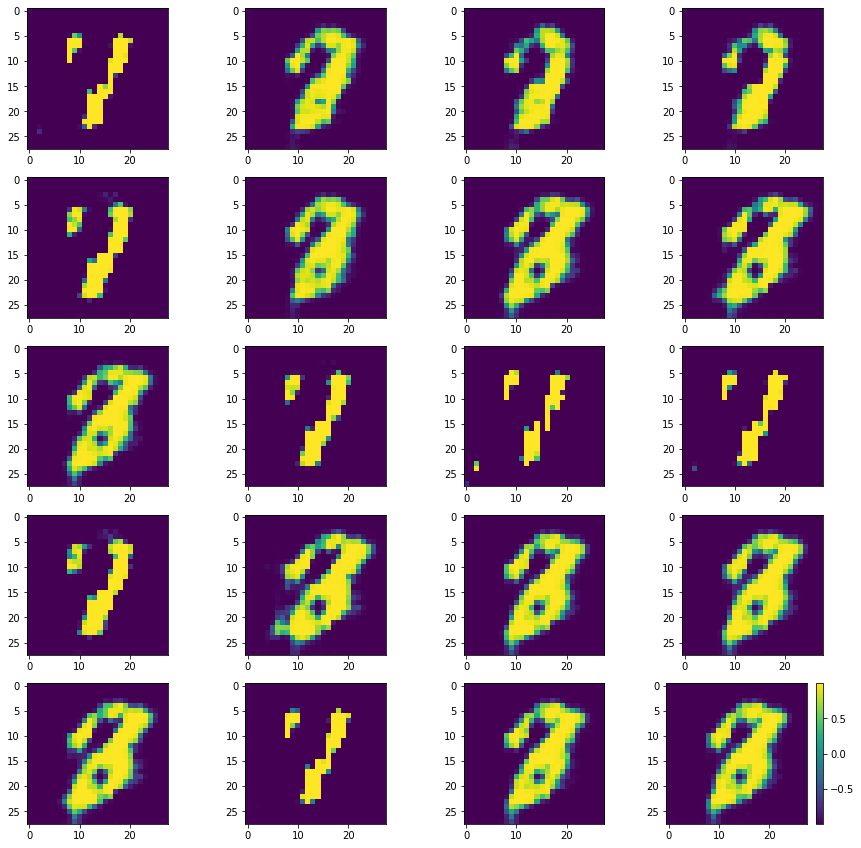

Batch_Num : 62
D_Loss   :   [9.838018417358398, 0.1889715939760208, 9.649046897888184, 0.5, 0.08984375] ;    GAN_Loss   :  [15.933359146118164, 3.9305644035339355, 12.002795219421387, 0.0, 0.0546875]
Batch_Num : 63
D_Loss   :   [10.140966415405273, 0.21665751934051514, 9.924308776855469, 0.5, 0.09375] ;    GAN_Loss   :  [14.589128494262695, 3.3284804821014404, 11.260647773742676, 0.0, 0.0703125]
Batch_Num : 64
D_Loss   :   [10.124074935913086, 0.23010969161987305, 9.893965721130371, 0.490234375, 0.080078125] ;    GAN_Loss   :  [14.473073959350586, 3.2469191551208496, 11.226155281066895, 0.0, 0.060546875]
Batch_Num : 65
D_Loss   :   [10.277960777282715, 0.2335076481103897, 10.044452667236328, 0.49609375, 0.060546875] ;    GAN_Loss   :  [15.450836181640625, 3.077118396759033, 12.37371826171875, 0.0, 0.072265625]
Batch_Num : 66
D_Loss   :   [10.89175033569336, 0.21326063573360443, 10.678489685058594, 0.498046875, 0.08203125] ;    GAN_Loss   :  [15.044107437133789, 2.911092758178711, 12.13

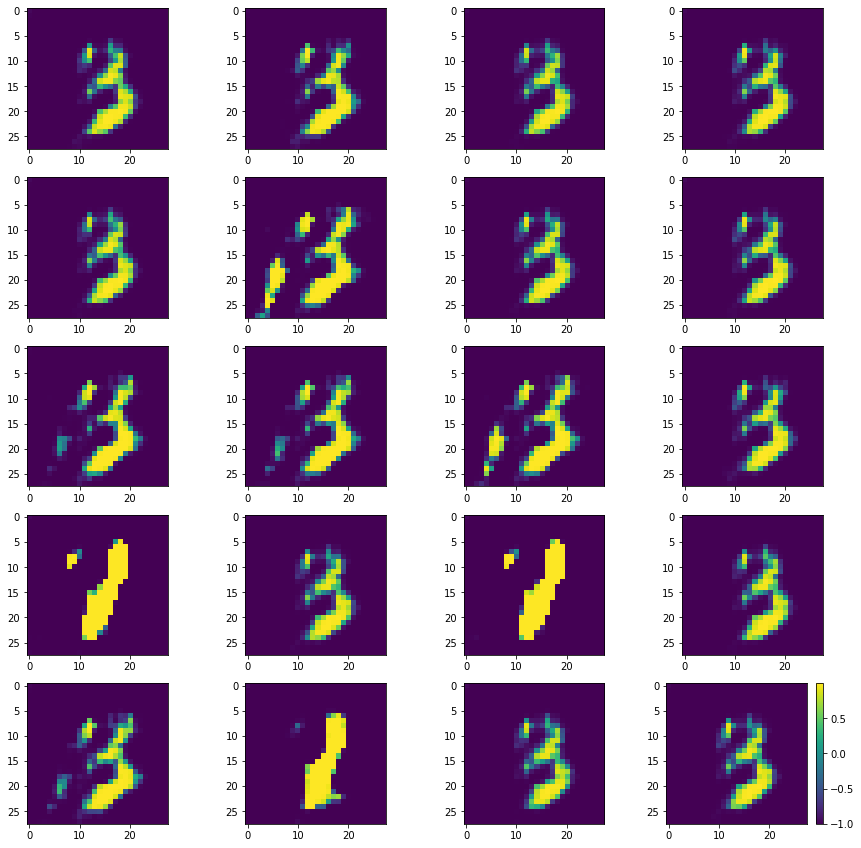

Batch_Num : 77
D_Loss   :   [10.073533058166504, 0.15755349397659302, 9.915979385375977, 0.5, 0.08984375] ;    GAN_Loss   :  [24.667850494384766, 11.896750450134277, 12.771100044250488, 0.0, 0.05078125]
Batch_Num : 78
D_Loss   :   [9.722987174987793, 0.1506567746400833, 9.572330474853516, 0.5, 0.095703125] ;    GAN_Loss   :  [23.24584197998047, 10.17933464050293, 13.066508293151855, 0.0, 0.072265625]
Batch_Num : 79
D_Loss   :   [10.517329216003418, 0.17477525770664215, 10.342554092407227, 0.49609375, 0.083984375] ;    GAN_Loss   :  [20.794466018676758, 8.117603302001953, 12.676862716674805, 0.0, 0.068359375]
Batch_Num : 80
D_Loss   :   [10.087790489196777, 0.18605738878250122, 9.9017333984375, 0.5, 0.09375] ;    GAN_Loss   :  [18.022397994995117, 6.573351860046387, 11.44904613494873, 0.0, 0.115234375]
Batch_Num : 81
D_Loss   :   [10.34399700164795, 0.1994079053401947, 10.1445894241333, 0.49609375, 0.12890625] ;    GAN_Loss   :  [17.912818908691406, 5.958856582641602, 11.953963279724121

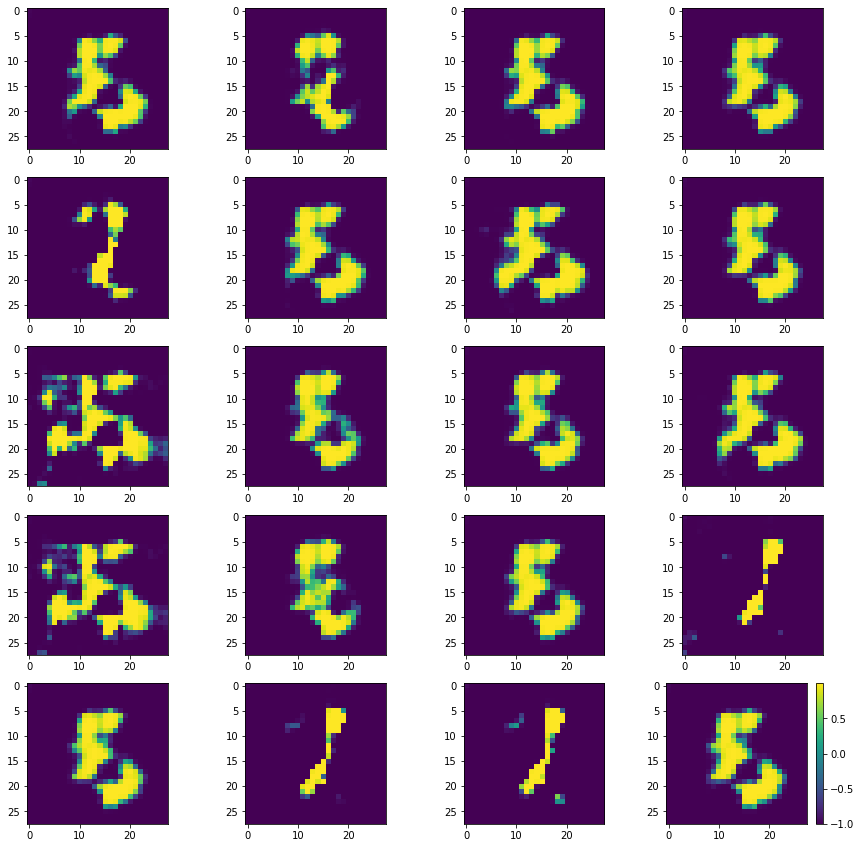

Batch_Num : 92
D_Loss   :   [10.217323303222656, 0.1898498684167862, 10.027473449707031, 0.478515625, 0.1484375] ;    GAN_Loss   :  [15.877531051635742, 4.748058795928955, 11.129472732543945, 0.0, 0.123046875]
Batch_Num : 93
D_Loss   :   [10.614253997802734, 0.15477396547794342, 10.459480285644531, 0.494140625, 0.115234375] ;    GAN_Loss   :  [16.419464111328125, 5.295760154724121, 11.12370491027832, 0.0, 0.123046875]
Batch_Num : 94
D_Loss   :   [10.040685653686523, 0.15961411595344543, 9.881071090698242, 0.498046875, 0.111328125] ;    GAN_Loss   :  [16.934898376464844, 5.366730213165283, 11.568168640136719, 0.0, 0.125]
Batch_Num : 95
D_Loss   :   [10.22392463684082, 0.16252562403678894, 10.061399459838867, 0.48828125, 0.130859375] ;    GAN_Loss   :  [16.531490325927734, 4.962176322937012, 11.569314002990723, 0.0, 0.115234375]
Batch_Num : 96
D_Loss   :   [9.775795936584473, 0.16310016810894012, 9.612695693969727, 0.494140625, 0.072265625] ;    GAN_Loss   :  [16.424396514892578, 4.98429

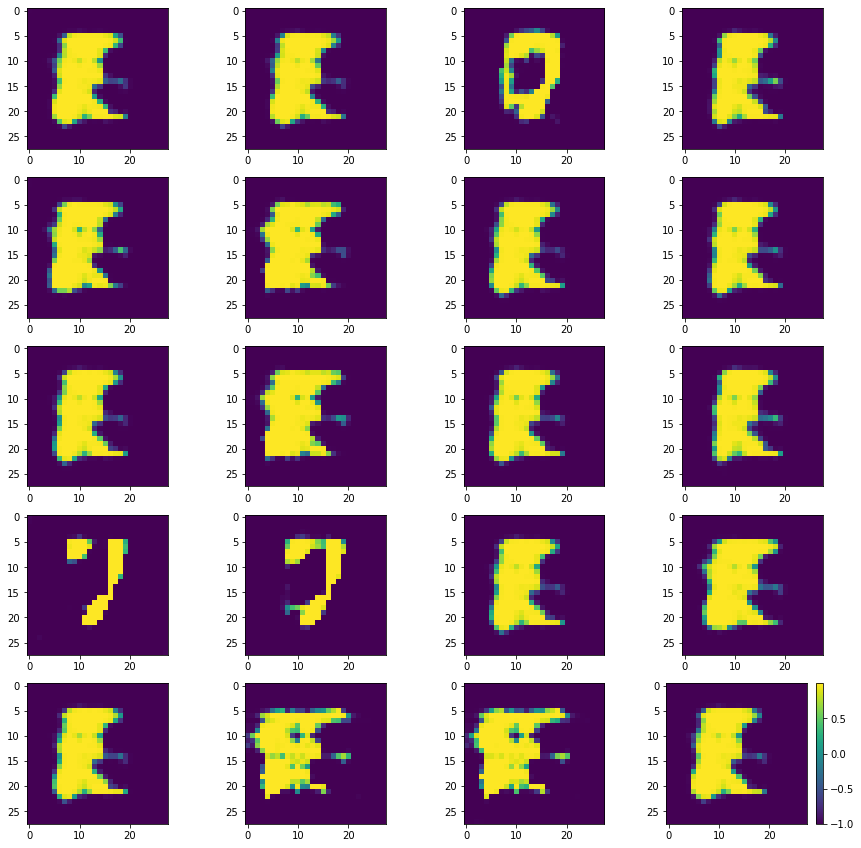

Batch_Num : 107
D_Loss   :   [10.045472145080566, 0.15662623941898346, 9.888845443725586, 0.5, 0.126953125] ;    GAN_Loss   :  [21.62803077697754, 6.51149320602417, 15.116537094116211, 0.0, 0.12109375]
Batch_Num : 108
D_Loss   :   [9.46757984161377, 0.15160627663135529, 9.315973281860352, 0.498046875, 0.111328125] ;    GAN_Loss   :  [20.780742645263672, 6.224946975708008, 14.55579662322998, 0.0, 0.107421875]
Batch_Num : 109
D_Loss   :   [9.694509506225586, 0.16167312860488892, 9.532835960388184, 0.498046875, 0.099609375] ;    GAN_Loss   :  [21.963411331176758, 6.686840534210205, 15.276570320129395, 0.0, 0.09765625]
Batch_Num : 110
D_Loss   :   [10.413522720336914, 0.17047138512134552, 10.243051528930664, 0.498046875, 0.109375] ;    GAN_Loss   :  [23.70355987548828, 7.37929630279541, 16.324264526367188, 0.0, 0.123046875]
Batch_Num : 111
D_Loss   :   [9.6016845703125, 0.1810728907585144, 9.420611381530762, 0.5, 0.091796875] ;    GAN_Loss   :  [20.282424926757812, 6.694177150726318, 13.58

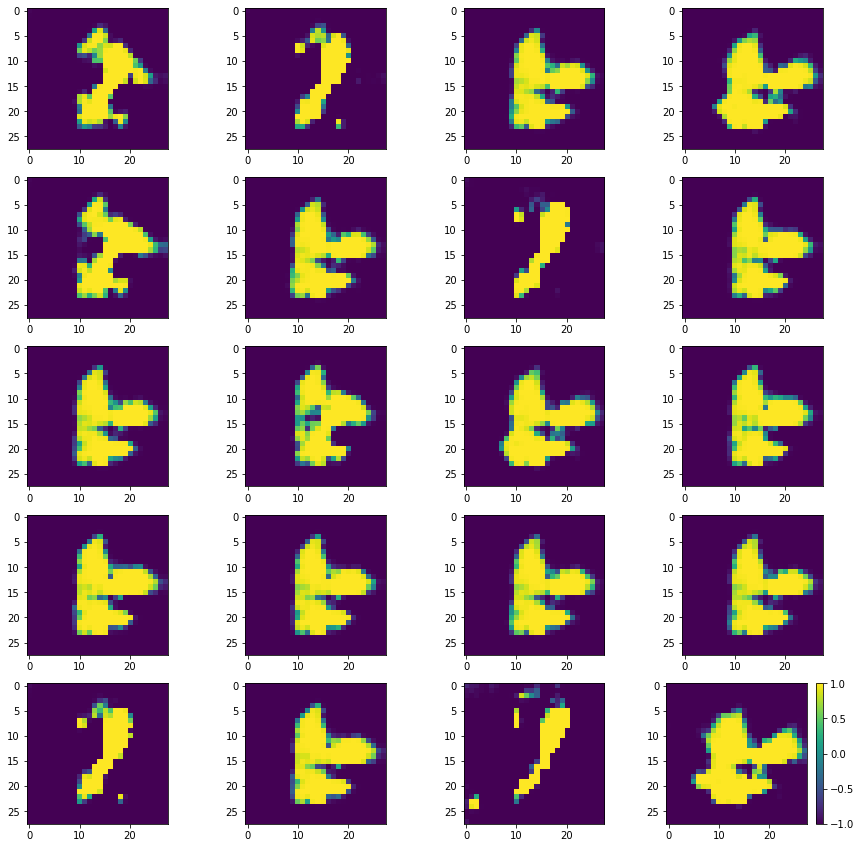

Batch_Num : 122
D_Loss   :   [10.60473346710205, 0.181850403547287, 10.422883033752441, 0.5, 0.1171875] ;    GAN_Loss   :  [17.9904842376709, 4.50463342666626, 13.48585033416748, 0.0, 0.130859375]
Batch_Num : 123
D_Loss   :   [9.982205390930176, 0.1981852650642395, 9.78402042388916, 0.498046875, 0.111328125] ;    GAN_Loss   :  [18.97588348388672, 4.73880672454834, 14.237077713012695, 0.0, 0.1484375]
Batch_Num : 124
D_Loss   :   [10.310248374938965, 0.16321055591106415, 10.147037506103516, 0.5, 0.123046875] ;    GAN_Loss   :  [18.755569458007812, 4.645904541015625, 14.109665870666504, 0.0, 0.123046875]
Batch_Num : 125
D_Loss   :   [10.55881404876709, 0.2215733826160431, 10.337240219116211, 0.498046875, 0.07421875] ;    GAN_Loss   :  [19.056060791015625, 5.106867790222168, 13.949193954467773, 0.0, 0.087890625]
Batch_Num : 126
D_Loss   :   [10.500850677490234, 0.23408803343772888, 10.266762733459473, 0.482421875, 0.087890625] ;    GAN_Loss   :  [22.134357452392578, 6.180448532104492, 15.9

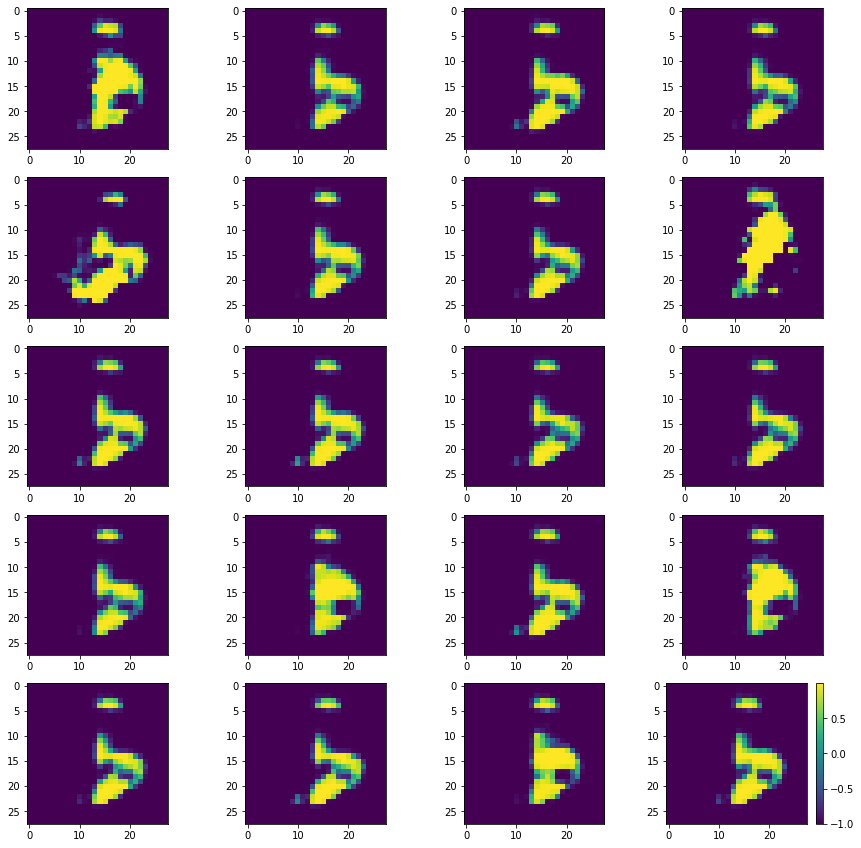

Batch_Num : 137
D_Loss   :   [10.787723541259766, 0.1600060760974884, 10.627717018127441, 0.5, 0.095703125] ;    GAN_Loss   :  [18.044654846191406, 4.750012397766113, 13.294641494750977, 0.0, 0.068359375]
Batch_Num : 138
D_Loss   :   [10.094735145568848, 0.18731848895549774, 9.907416343688965, 0.498046875, 0.09375] ;    GAN_Loss   :  [17.807905197143555, 5.919137477874756, 11.888768196105957, 0.0, 0.068359375]
Batch_Num : 139
D_Loss   :   [9.998363494873047, 0.18412527441978455, 9.814238548278809, 0.498046875, 0.0859375] ;    GAN_Loss   :  [18.964468002319336, 5.484852313995361, 13.479616165161133, 0.0, 0.109375]
Batch_Num : 140
D_Loss   :   [9.573620796203613, 0.16905173659324646, 9.404568672180176, 0.5, 0.08984375] ;    GAN_Loss   :  [18.118362426757812, 5.241124153137207, 12.877239227294922, 0.0, 0.1015625]
Batch_Num : 141
D_Loss   :   [10.188185691833496, 0.18092045187950134, 10.007265090942383, 0.5, 0.109375] ;    GAN_Loss   :  [17.182069778442383, 4.929811477661133, 12.2522583007

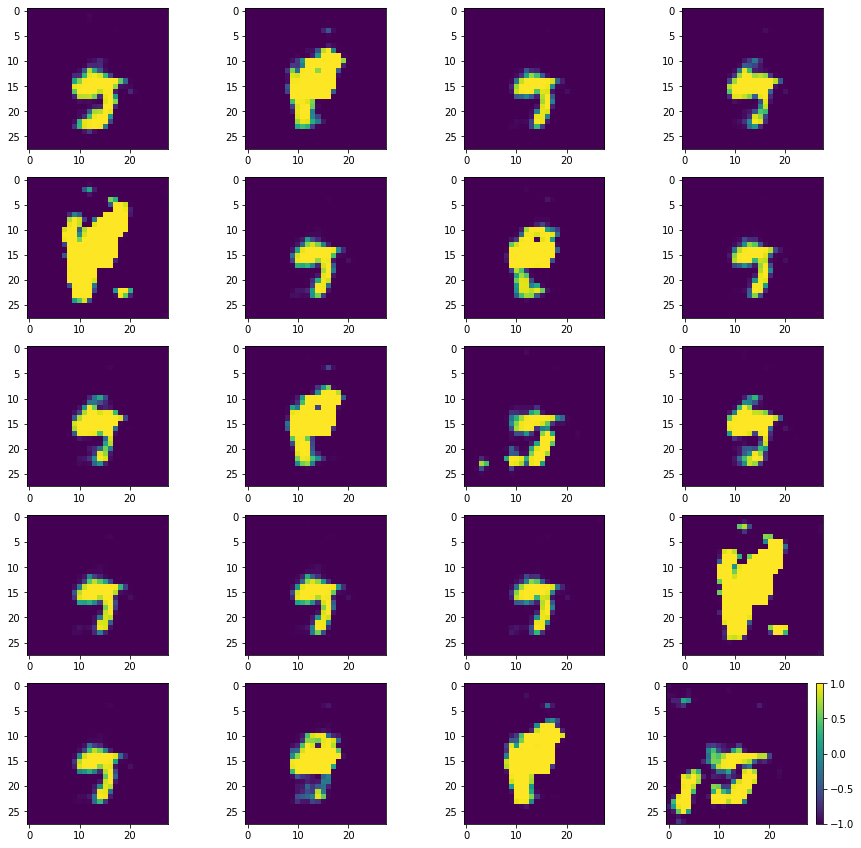

Batch_Num : 152
D_Loss   :   [9.856457710266113, 0.17749616503715515, 9.678961753845215, 0.5, 0.09375] ;    GAN_Loss   :  [18.578588485717773, 6.679015159606934, 11.89957332611084, 0.0, 0.103515625]
Batch_Num : 153
D_Loss   :   [10.096016883850098, 0.15921378135681152, 9.936802864074707, 0.5, 0.11328125] ;    GAN_Loss   :  [19.18758201599121, 7.066198825836182, 12.121382713317871, 0.0, 0.09765625]
Batch_Num : 154
D_Loss   :   [10.063104629516602, 0.15648967027664185, 9.906615257263184, 0.5, 0.11328125] ;    GAN_Loss   :  [20.052608489990234, 7.545090675354004, 12.50751781463623, 0.0, 0.10546875]
Batch_Num : 155
D_Loss   :   [10.423738479614258, 0.1658482551574707, 10.257889747619629, 0.49609375, 0.1015625] ;    GAN_Loss   :  [20.12125587463379, 6.748992443084717, 13.37226390838623, 0.0, 0.099609375]
Batch_Num : 156
D_Loss   :   [9.51527214050293, 0.1382564753293991, 9.377016067504883, 0.5, 0.111328125] ;    GAN_Loss   :  [18.76912498474121, 6.379173278808594, 12.389951705932617, 0.0, 0

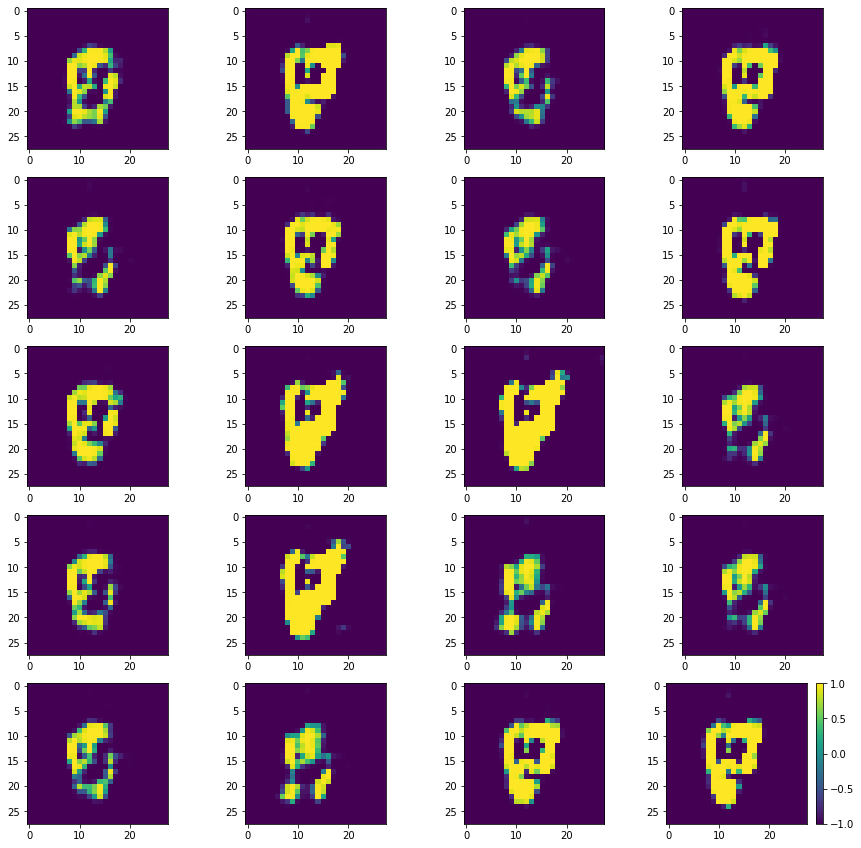

Batch_Num : 167
D_Loss   :   [10.559596061706543, 0.16329452395439148, 10.39630126953125, 0.5, 0.09375] ;    GAN_Loss   :  [18.1832275390625, 5.687106132507324, 12.49612045288086, 0.0, 0.08203125]
Batch_Num : 168
D_Loss   :   [9.594107627868652, 0.14769737422466278, 9.446410179138184, 0.5, 0.111328125] ;    GAN_Loss   :  [17.714757919311523, 5.800443649291992, 11.914314270019531, 0.0, 0.08203125]
Batch_Num : 169
D_Loss   :   [10.094423294067383, 0.14259979128837585, 9.951823234558105, 0.5, 0.1015625] ;    GAN_Loss   :  [17.75560188293457, 5.632303714752197, 12.123298645019531, 0.0, 0.083984375]
Batch_Num : 170
D_Loss   :   [10.074776649475098, 0.1455283761024475, 9.929247856140137, 0.5, 0.1015625] ;    GAN_Loss   :  [17.882869720458984, 5.413623809814453, 12.469246864318848, 0.0, 0.076171875]
Batch_Num : 171
D_Loss   :   [10.435833930969238, 0.15507379174232483, 10.280759811401367, 0.5, 0.10546875] ;    GAN_Loss   :  [17.560012817382812, 5.27565860748291, 12.284353256225586, 0.0, 0.072

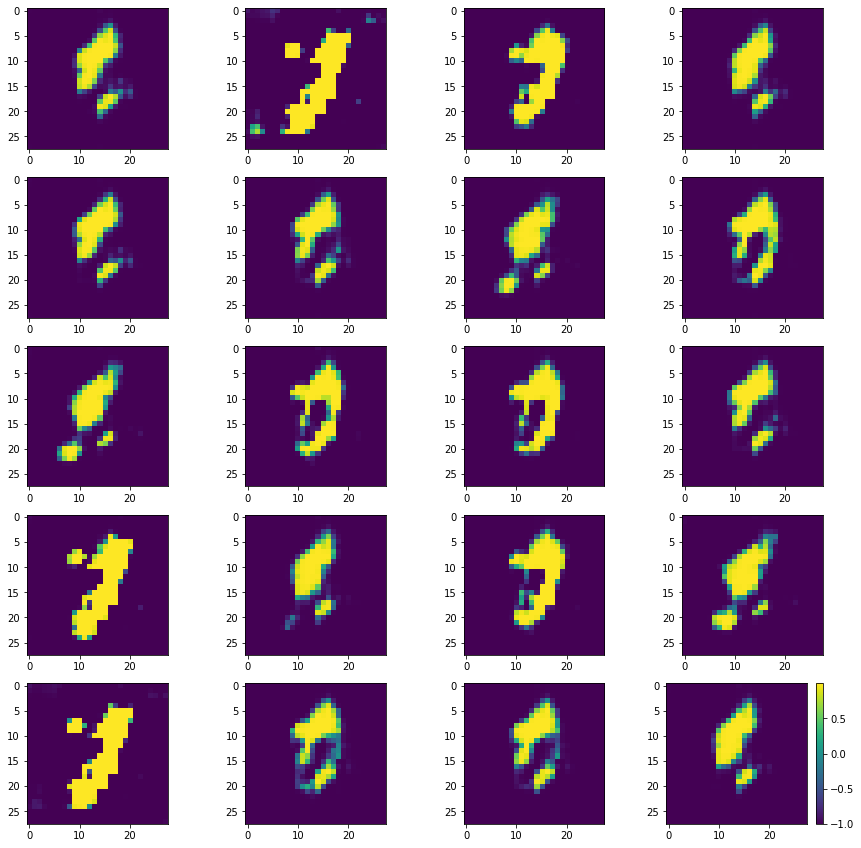

Batch_Num : 182
D_Loss   :   [9.760235786437988, 0.17855951189994812, 9.581676483154297, 0.5, 0.091796875] ;    GAN_Loss   :  [15.900927543640137, 4.524718284606934, 11.376209259033203, 0.0, 0.087890625]
Batch_Num : 183
D_Loss   :   [10.413172721862793, 0.17080317437648773, 10.242369651794434, 0.5, 0.1328125] ;    GAN_Loss   :  [15.807193756103516, 4.790349006652832, 11.016844749450684, 0.0, 0.083984375]
Batch_Num : 184
D_Loss   :   [9.871563911437988, 0.15416784584522247, 9.717395782470703, 0.5, 0.0859375] ;    GAN_Loss   :  [16.514087677001953, 4.838123798370361, 11.67596435546875, 0.0, 0.09765625]
Batch_Num : 185
D_Loss   :   [9.97176456451416, 0.17034253478050232, 9.801422119140625, 0.5, 0.1171875] ;    GAN_Loss   :  [15.555910110473633, 4.4879608154296875, 11.067949295043945, 0.0, 0.0703125]
Batch_Num : 186
D_Loss   :   [9.570009231567383, 0.18859533965587616, 9.381413459777832, 0.498046875, 0.0859375] ;    GAN_Loss   :  [16.170310974121094, 4.744612693786621, 11.425697326660156, 

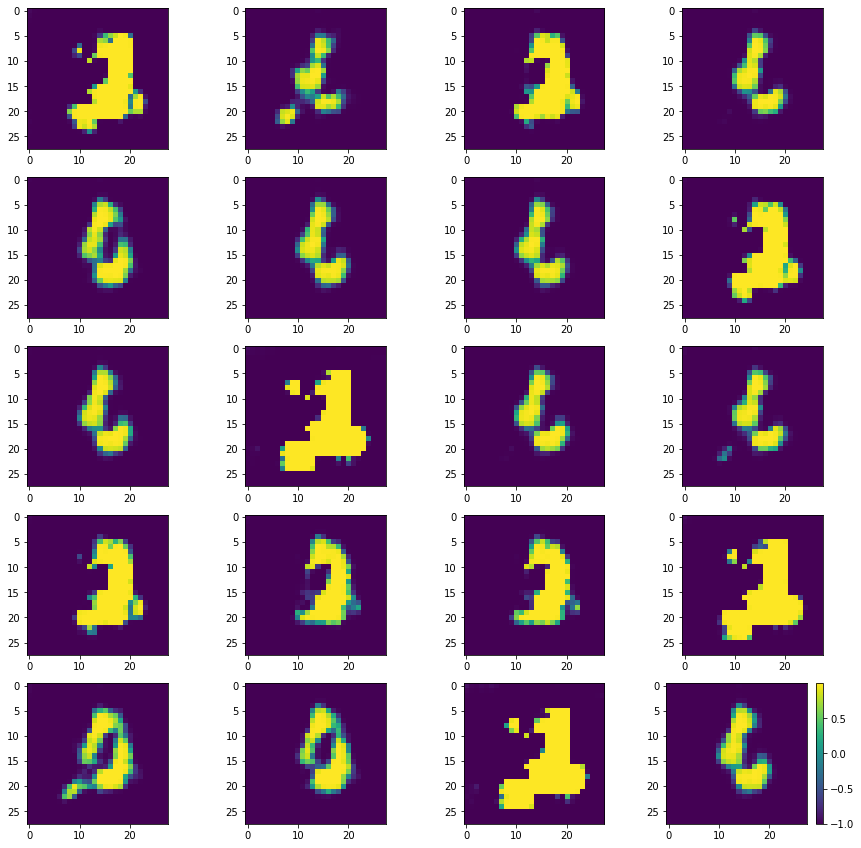

Batch_Num : 197
D_Loss   :   [9.989775657653809, 0.15443316102027893, 9.835342407226562, 0.498046875, 0.09375] ;    GAN_Loss   :  [16.410411834716797, 5.063164710998535, 11.347247123718262, 0.0, 0.099609375]
Batch_Num : 198
D_Loss   :   [9.693702697753906, 0.1506018191576004, 9.54310131072998, 0.49609375, 0.091796875] ;    GAN_Loss   :  [16.556716918945312, 5.1076812744140625, 11.449036598205566, 0.0, 0.109375]
Batch_Num : 199
D_Loss   :   [10.666540145874023, 0.2075815349817276, 10.458958625793457, 0.498046875, 0.111328125] ;    GAN_Loss   :  [16.36104965209961, 5.321345806121826, 11.039704322814941, 0.0, 0.111328125]
Batch_Num : 200
D_Loss   :   [10.200858116149902, 0.18233582377433777, 10.018522262573242, 0.5, 0.07421875] ;    GAN_Loss   :  [17.715965270996094, 6.575568675994873, 11.140397071838379, 0.0, 0.115234375]
Batch_Num : 201
D_Loss   :   [10.447548866271973, 0.18973836302757263, 10.257810592651367, 0.498046875, 0.09375] ;    GAN_Loss   :  [17.60602378845215, 6.05205392837524

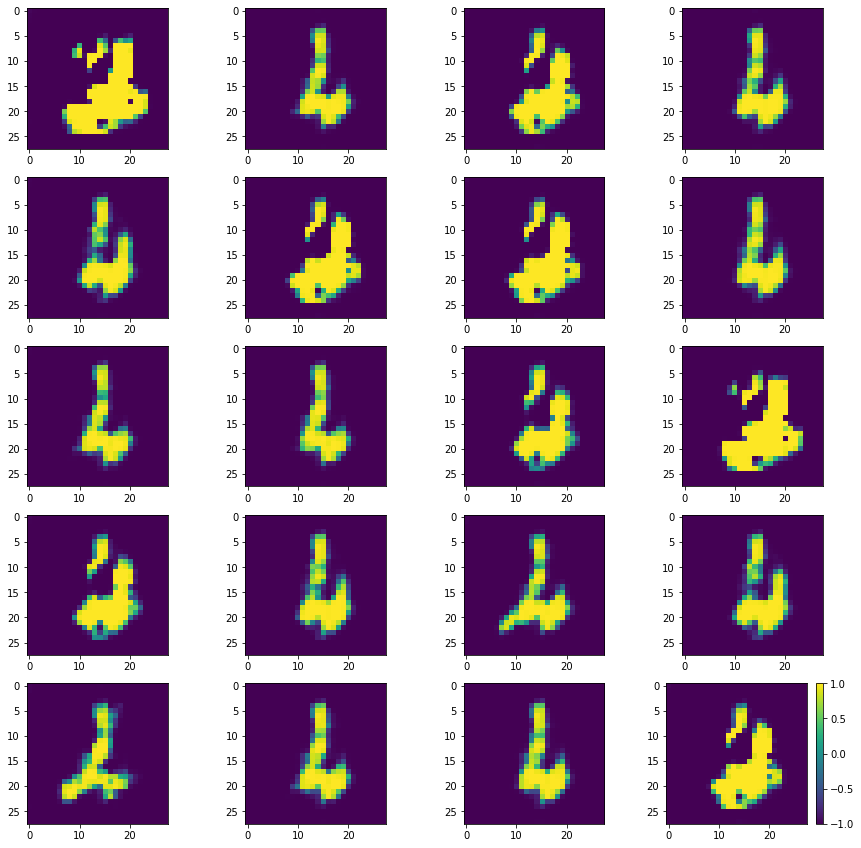

Batch_Num : 212
D_Loss   :   [10.957036972045898, 0.16613513231277466, 10.790902137756348, 0.5, 0.107421875] ;    GAN_Loss   :  [15.798662185668945, 4.481576919555664, 11.317085266113281, 0.0, 0.126953125]
Batch_Num : 213
D_Loss   :   [9.638707160949707, 0.1719927191734314, 9.466714859008789, 0.5, 0.07421875] ;    GAN_Loss   :  [15.145208358764648, 4.232635974884033, 10.912572860717773, 0.0, 0.119140625]
Batch_Num : 214
D_Loss   :   [10.441478729248047, 0.20161962509155273, 10.239859580993652, 0.498046875, 0.072265625] ;    GAN_Loss   :  [15.147289276123047, 4.051742076873779, 11.095547676086426, 0.0, 0.103515625]
Batch_Num : 215
D_Loss   :   [9.246325492858887, 0.1738182008266449, 9.07250690460205, 0.498046875, 0.08984375] ;    GAN_Loss   :  [15.58792495727539, 4.187386989593506, 11.400538444519043, 0.0, 0.123046875]
Batch_Num : 216
D_Loss   :   [10.473548889160156, 0.1860937774181366, 10.287455558776855, 0.5, 0.068359375] ;    GAN_Loss   :  [15.775362968444824, 4.532647132873535, 11.

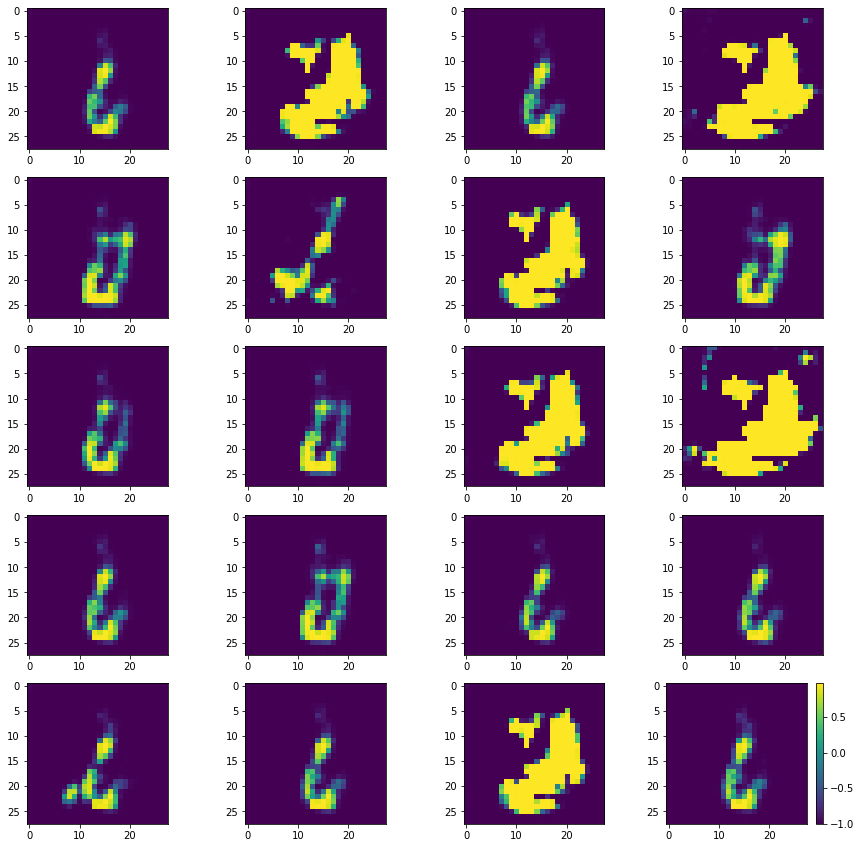

Batch_Num : 227
D_Loss   :   [9.387388229370117, 0.2530149519443512, 9.134373664855957, 0.494140625, 0.109375] ;    GAN_Loss   :  [17.2017822265625, 6.515219211578369, 10.686563491821289, 0.0, 0.099609375]
Batch_Num : 228
D_Loss   :   [10.410149574279785, 0.17884686589241028, 10.231302261352539, 0.5, 0.103515625] ;    GAN_Loss   :  [15.27506160736084, 4.693019866943359, 10.58204174041748, 0.0, 0.09765625]
Batch_Num : 229
D_Loss   :   [9.872495651245117, 0.21894130110740662, 9.65355396270752, 0.5, 0.06640625] ;    GAN_Loss   :  [14.916434288024902, 4.204700469970703, 10.7117338180542, 0.0, 0.1171875]
Batch_Num : 230
D_Loss   :   [10.185020446777344, 0.2067287415266037, 9.978291511535645, 0.498046875, 0.09375] ;    GAN_Loss   :  [15.184310913085938, 4.24811315536499, 10.936198234558105, 0.0, 0.119140625]
Batch_Num : 231
D_Loss   :   [10.395545959472656, 0.1767663061618805, 10.218779563903809, 0.5, 0.103515625] ;    GAN_Loss   :  [14.551251411437988, 4.344874382019043, 10.206377029418945,

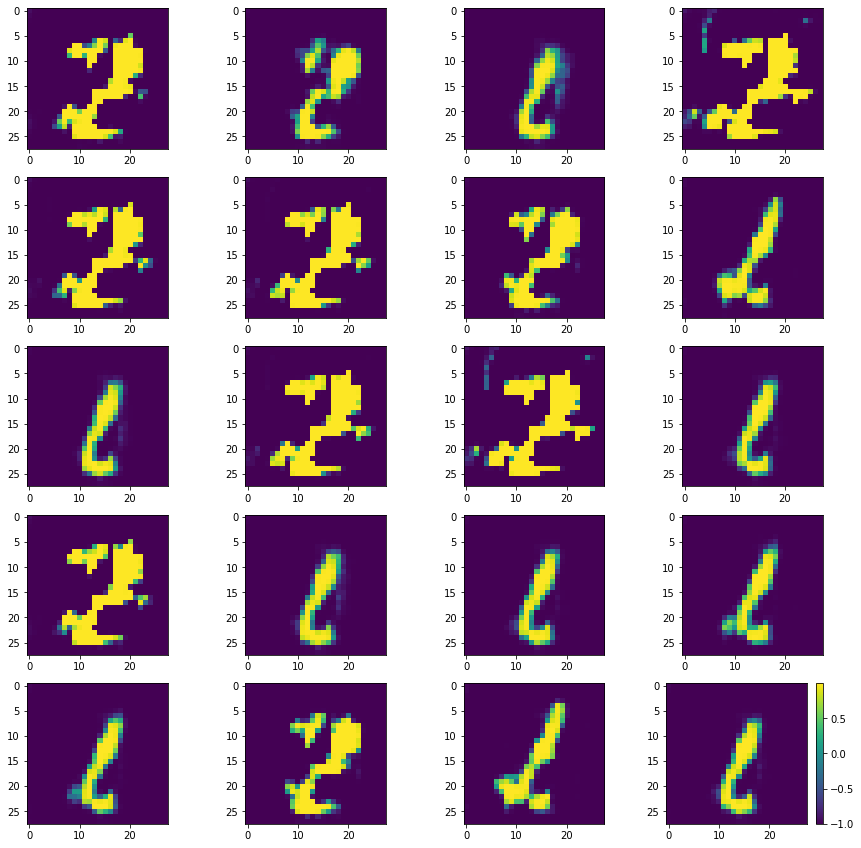

Batch_Num : 2
D_Loss   :   [10.19294548034668, 0.19244593381881714, 10.000499725341797, 0.49609375, 0.091796875] ;    GAN_Loss   :  [16.573871612548828, 5.765960693359375, 10.80791187286377, 0.0, 0.1171875]
Batch_Num : 3
D_Loss   :   [10.209776878356934, 0.1728353500366211, 10.036941528320312, 0.498046875, 0.109375] ;    GAN_Loss   :  [16.70066261291504, 5.223844528198242, 11.476818084716797, 0.0, 0.109375]
Batch_Num : 4
D_Loss   :   [10.358782768249512, 0.15569564700126648, 10.203086853027344, 0.498046875, 0.09765625] ;    GAN_Loss   :  [16.042510986328125, 5.069960117340088, 10.972550392150879, 0.0, 0.107421875]
Batch_Num : 5
D_Loss   :   [10.220072746276855, 0.16973967850208282, 10.050333023071289, 0.5, 0.091796875] ;    GAN_Loss   :  [15.852210998535156, 5.037982940673828, 10.814228057861328, 0.0, 0.08203125]
Batch_Num : 6
D_Loss   :   [10.503267288208008, 0.154762864112854, 10.348504066467285, 0.5, 0.111328125] ;    GAN_Loss   :  [15.949122428894043, 5.0323896408081055, 10.9167327

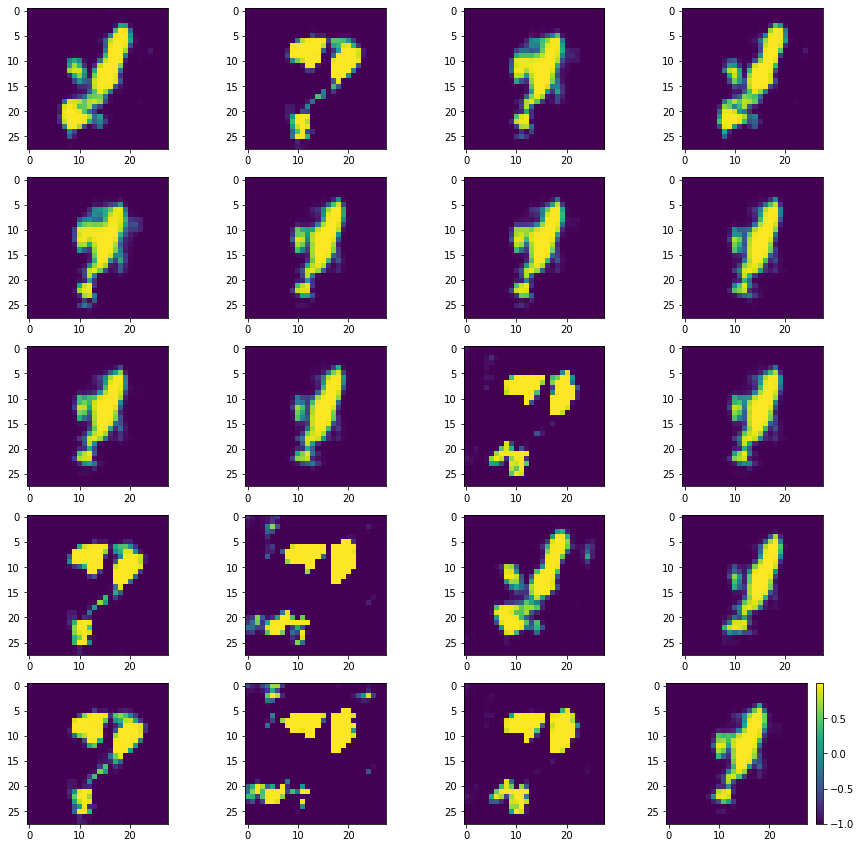

Batch_Num : 17
D_Loss   :   [9.898083686828613, 0.24136102199554443, 9.656723022460938, 0.486328125, 0.09765625] ;    GAN_Loss   :  [14.738455772399902, 3.555375099182129, 11.183080673217773, 0.0, 0.123046875]
Batch_Num : 18
D_Loss   :   [10.095184326171875, 0.26651203632354736, 9.828672409057617, 0.490234375, 0.1015625] ;    GAN_Loss   :  [12.899450302124023, 2.6269240379333496, 10.272525787353516, 0.0, 0.099609375]
Batch_Num : 19
D_Loss   :   [10.119022369384766, 0.2352573126554489, 9.88376522064209, 0.498046875, 0.095703125] ;    GAN_Loss   :  [13.200555801391602, 2.248661518096924, 10.951894760131836, 0.0, 0.10546875]
Batch_Num : 20
D_Loss   :   [9.919532775878906, 0.2127227783203125, 9.706809997558594, 0.498046875, 0.07421875] ;    GAN_Loss   :  [12.964205741882324, 2.420820474624634, 10.54338550567627, 0.0, 0.109375]
Batch_Num : 21
D_Loss   :   [9.786155700683594, 0.21405120193958282, 9.572104454040527, 0.5, 0.09375] ;    GAN_Loss   :  [12.18370246887207, 2.0631704330444336, 10.1

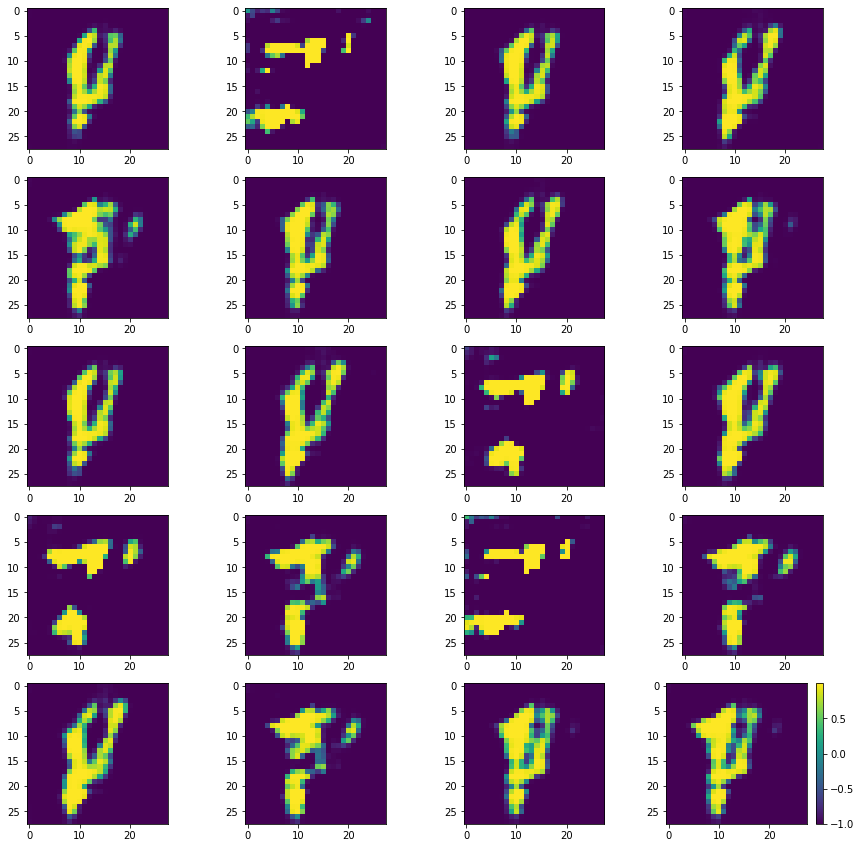

Batch_Num : 32
D_Loss   :   [9.778847694396973, 0.20814597606658936, 9.570701599121094, 0.498046875, 0.080078125] ;    GAN_Loss   :  [10.358230590820312, 0.5573832988739014, 9.800847053527832, 0.0, 0.044921875]
Batch_Num : 33
D_Loss   :   [10.311023712158203, 0.1509145349264145, 10.160109519958496, 0.5, 0.09375] ;    GAN_Loss   :  [10.845611572265625, 0.6842265725135803, 10.161384582519531, 0.0, 0.02734375]
Batch_Num : 34
D_Loss   :   [10.394495964050293, 0.17752212285995483, 10.216974258422852, 0.5, 0.1015625] ;    GAN_Loss   :  [11.230608940124512, 1.0391452312469482, 10.191463470458984, 0.0, 0.046875]
Batch_Num : 35
D_Loss   :   [9.608050346374512, 0.14316105842590332, 9.464889526367188, 0.5, 0.083984375] ;    GAN_Loss   :  [10.880958557128906, 1.0539064407348633, 9.827052116394043, 0.0, 0.046875]
Batch_Num : 36
D_Loss   :   [9.678376197814941, 0.13807837665081024, 9.540297508239746, 0.498046875, 0.080078125] ;    GAN_Loss   :  [11.74268913269043, 1.0351102352142334, 10.707578659057

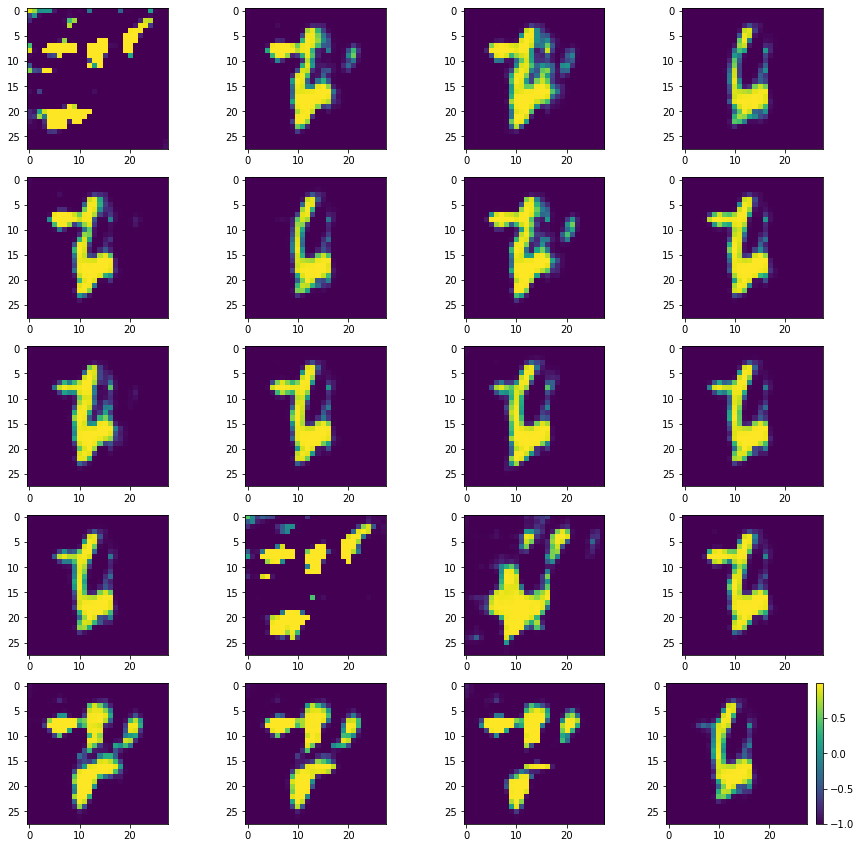

Batch_Num : 47
D_Loss   :   [10.704362869262695, 0.1733849197626114, 10.530978202819824, 0.5, 0.1171875] ;    GAN_Loss   :  [11.747112274169922, 0.6576333045959473, 11.089479446411133, 0.0, 0.080078125]
Batch_Num : 48
D_Loss   :   [10.144519805908203, 0.16306492686271667, 9.981454849243164, 0.494140625, 0.06640625] ;    GAN_Loss   :  [12.255783081054688, 0.8245378136634827, 11.431244850158691, 0.0, 0.068359375]
Batch_Num : 49
D_Loss   :   [10.06977653503418, 0.16319912672042847, 9.906577110290527, 0.498046875, 0.072265625] ;    GAN_Loss   :  [12.957094192504883, 1.4360575675964355, 11.521036148071289, 0.0, 0.072265625]
Batch_Num : 50
D_Loss   :   [9.77640438079834, 0.14889965951442719, 9.627504348754883, 0.49609375, 0.080078125] ;    GAN_Loss   :  [12.411561965942383, 1.5263859033584595, 10.885175704956055, 0.0, 0.068359375]
Batch_Num : 51
D_Loss   :   [10.441428184509277, 0.17036384344100952, 10.271064758300781, 0.4921875, 0.10546875] ;    GAN_Loss   :  [13.515518188476562, 1.94297790

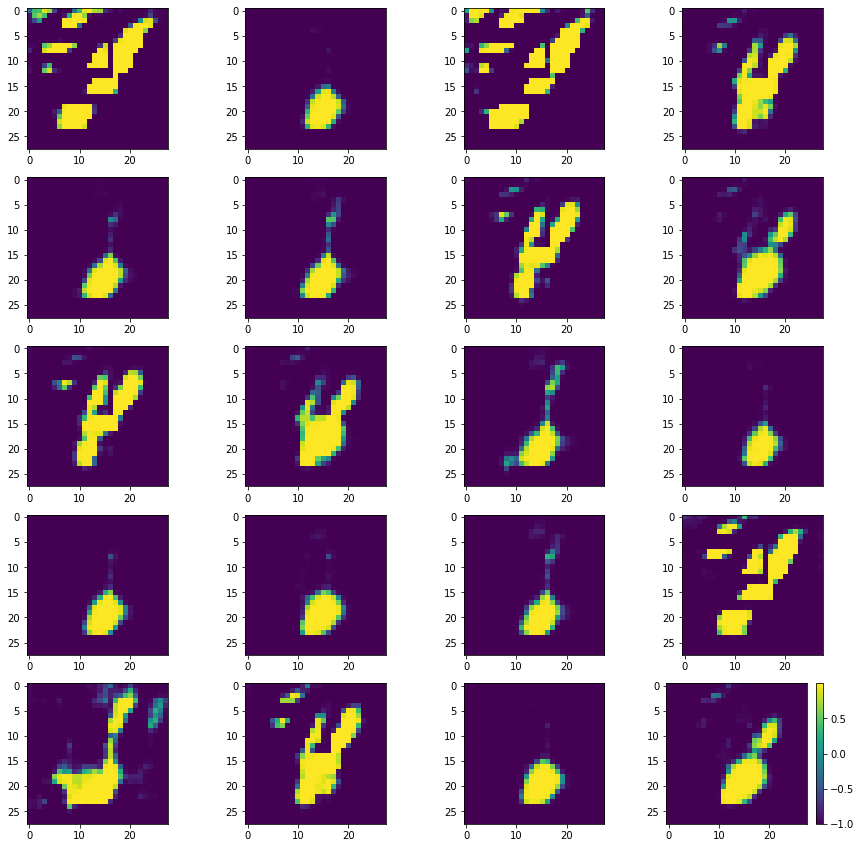

Batch_Num : 62
D_Loss   :   [9.786231994628906, 0.16099900007247925, 9.625232696533203, 0.5, 0.0859375] ;    GAN_Loss   :  [12.986294746398926, 3.1540145874023438, 9.832280158996582, 0.0, 0.033203125]
Batch_Num : 63
D_Loss   :   [10.090644836425781, 0.2052219808101654, 9.885422706604004, 0.4921875, 0.078125] ;    GAN_Loss   :  [15.422032356262207, 5.073822975158691, 10.348209381103516, 0.0, 0.05859375]
Batch_Num : 64
D_Loss   :   [10.029037475585938, 0.16170674562454224, 9.867330551147461, 0.5, 0.076171875] ;    GAN_Loss   :  [16.684297561645508, 6.397631645202637, 10.286665916442871, 0.0, 0.05078125]
Batch_Num : 65
D_Loss   :   [10.139106750488281, 0.13664144277572632, 10.00246524810791, 0.498046875, 0.078125] ;    GAN_Loss   :  [17.229969024658203, 6.543996334075928, 10.685973167419434, 0.0, 0.095703125]
Batch_Num : 66
D_Loss   :   [10.774940490722656, 0.1454641968011856, 10.629476547241211, 0.4921875, 0.0703125] ;    GAN_Loss   :  [16.840147018432617, 6.131502628326416, 10.708644866

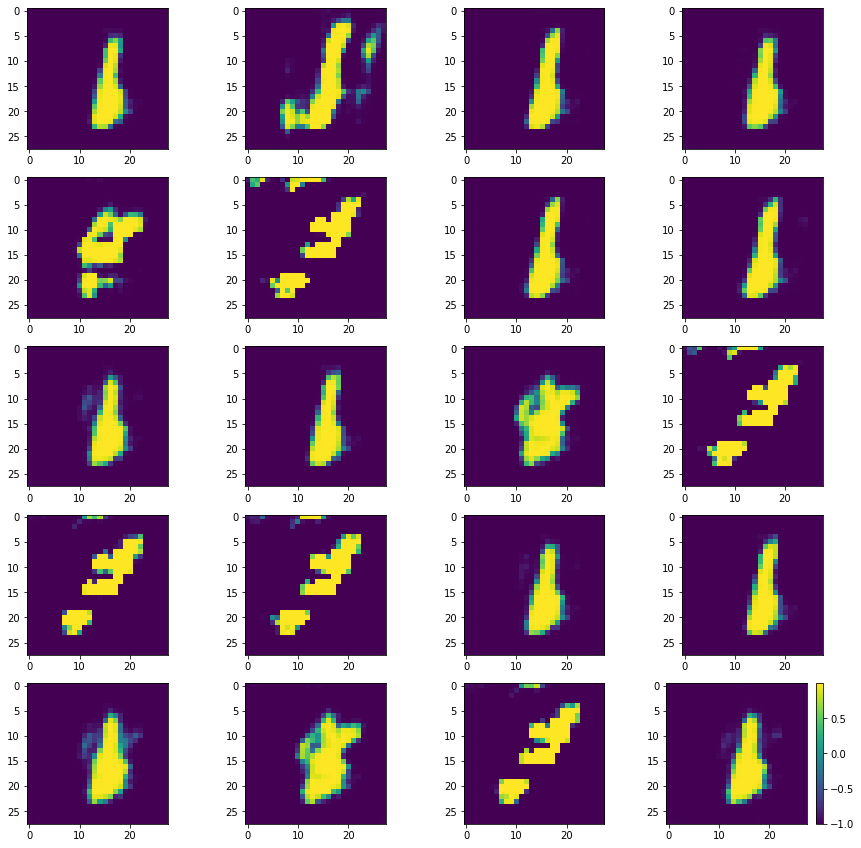

Batch_Num : 77
D_Loss   :   [10.091742515563965, 0.18352770805358887, 9.908214569091797, 0.498046875, 0.04296875] ;    GAN_Loss   :  [18.651033401489258, 8.254003524780273, 10.397029876708984, 0.0, 0.03125]
Batch_Num : 78
D_Loss   :   [9.708353042602539, 0.15154391527175903, 9.556809425354004, 0.498046875, 0.041015625] ;    GAN_Loss   :  [20.795822143554688, 8.925225257873535, 11.870597839355469, 0.0, 0.03515625]
Batch_Num : 79
D_Loss   :   [10.499852180480957, 0.16228272020816803, 10.337569236755371, 0.5, 0.056640625] ;    GAN_Loss   :  [19.443946838378906, 8.496423721313477, 10.94752311706543, 0.0, 0.044921875]
Batch_Num : 80
D_Loss   :   [10.036378860473633, 0.1522250920534134, 9.884153366088867, 0.498046875, 0.06640625] ;    GAN_Loss   :  [18.603195190429688, 7.902431011199951, 10.700764656066895, 0.0, 0.044921875]
Batch_Num : 81
D_Loss   :   [10.285313606262207, 0.16782405972480774, 10.1174898147583, 0.5, 0.0546875] ;    GAN_Loss   :  [18.788583755493164, 7.877353191375732, 10.911

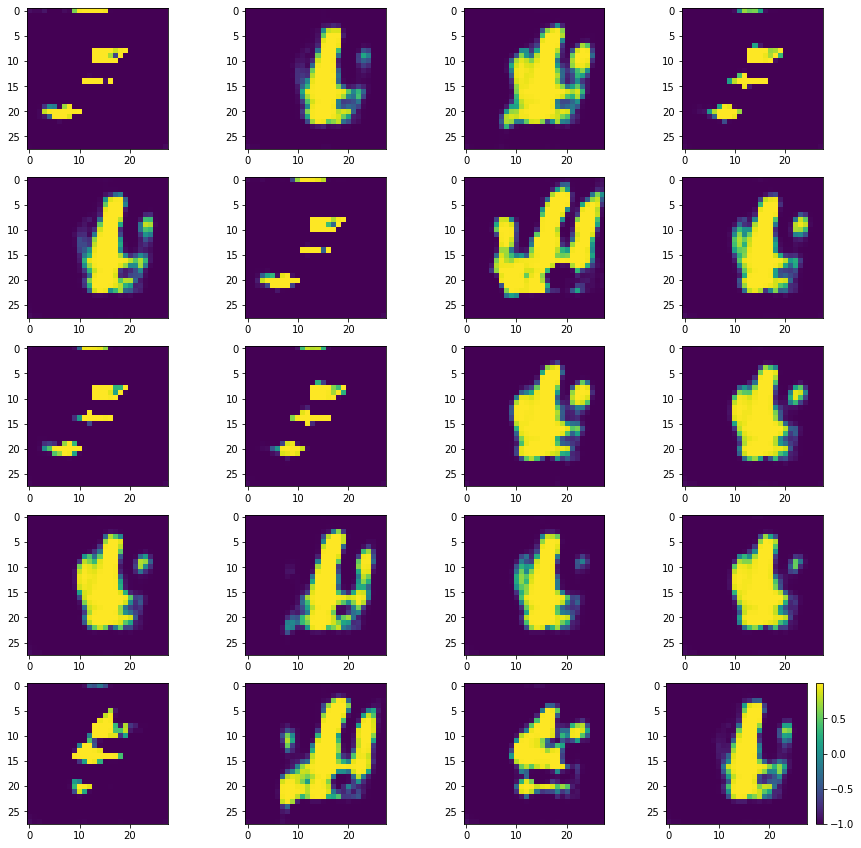

Batch_Num : 92
D_Loss   :   [10.173179626464844, 0.1589842140674591, 10.014195442199707, 0.5, 0.068359375] ;    GAN_Loss   :  [16.154651641845703, 5.76590633392334, 10.388745307922363, 0.0, 0.041015625]
Batch_Num : 93
D_Loss   :   [10.620996475219727, 0.1696702092885971, 10.451326370239258, 0.5, 0.076171875] ;    GAN_Loss   :  [15.138136863708496, 4.869298934936523, 10.268837928771973, 0.0, 0.041015625]
Batch_Num : 94
D_Loss   :   [10.037113189697266, 0.16845646500587463, 9.868657112121582, 0.49609375, 0.064453125] ;    GAN_Loss   :  [13.989686965942383, 4.047117710113525, 9.9425687789917, 0.0, 0.060546875]
Batch_Num : 95
D_Loss   :   [10.224717140197754, 0.1766107827425003, 10.04810619354248, 0.49609375, 0.064453125] ;    GAN_Loss   :  [14.49118423461914, 3.957488775253296, 10.533695220947266, 0.0, 0.072265625]
Batch_Num : 96
D_Loss   :   [9.757241249084473, 0.15528614819049835, 9.60195541381836, 0.5, 0.072265625] ;    GAN_Loss   :  [13.559941291809082, 3.4066944122314453, 10.15324687

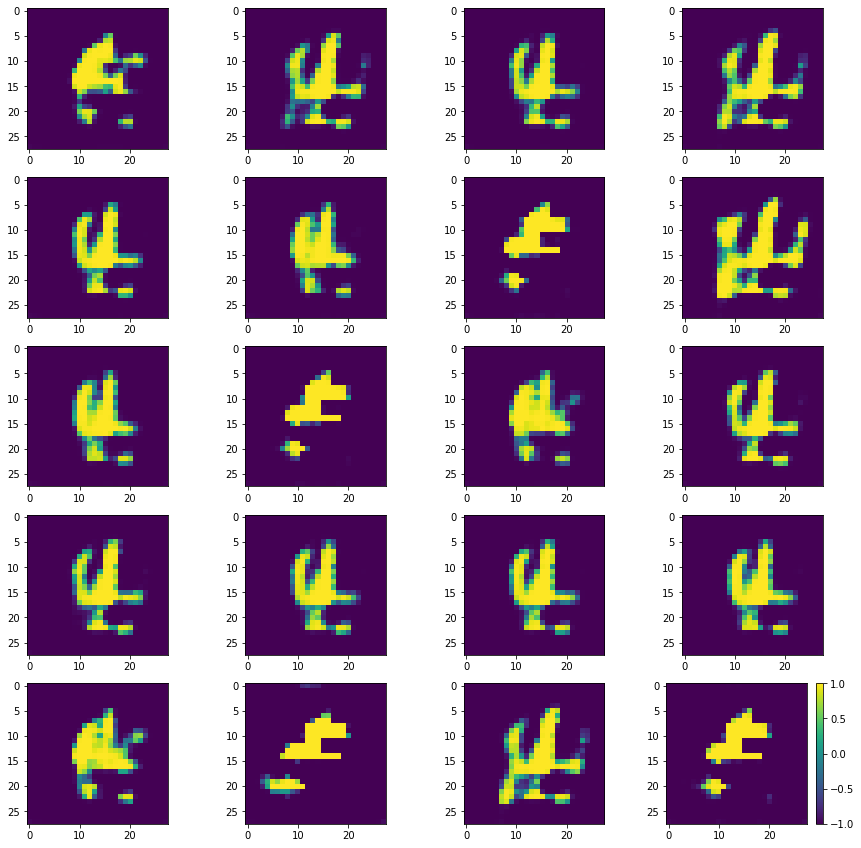

Batch_Num : 107
D_Loss   :   [10.016947746276855, 0.14187091588974, 9.875077247619629, 0.5, 0.083984375] ;    GAN_Loss   :  [11.038413047790527, 0.7183614373207092, 10.320051193237305, 0.0, 0.080078125]
Batch_Num : 108
D_Loss   :   [9.43838882446289, 0.1364944875240326, 9.301894187927246, 0.5, 0.10546875] ;    GAN_Loss   :  [10.722567558288574, 0.4907066226005554, 10.231861114501953, 0.0, 0.091796875]
Batch_Num : 109
D_Loss   :   [9.680862426757812, 0.15228784084320068, 9.52857494354248, 0.5, 0.0859375] ;    GAN_Loss   :  [10.596802711486816, 0.2983987629413605, 10.2984037399292, 0.0, 0.0859375]
Batch_Num : 110
D_Loss   :   [10.36875057220459, 0.14900678396224976, 10.219743728637695, 0.5, 0.107421875] ;    GAN_Loss   :  [10.238858222961426, 0.4483563303947449, 9.790501594543457, 0.0, 0.099609375]
Batch_Num : 111
D_Loss   :   [9.55849838256836, 0.16099995374679565, 9.39749813079834, 0.5, 0.111328125] ;    GAN_Loss   :  [10.533364295959473, 0.3022870719432831, 10.231077194213867, 0.0, 0.

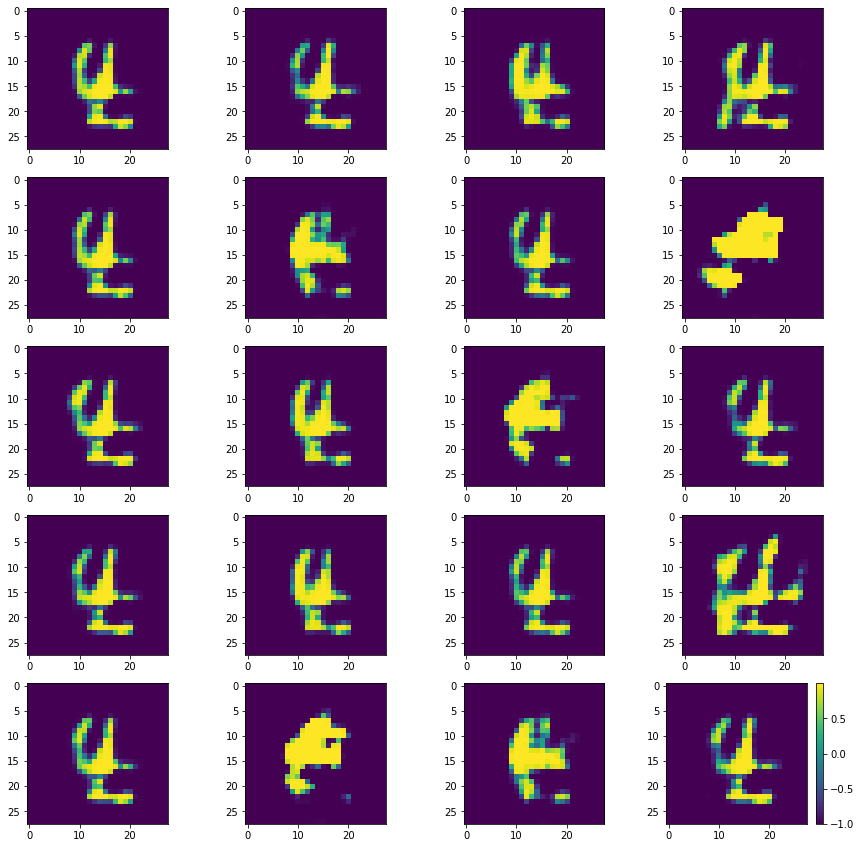

Batch_Num : 122
D_Loss   :   [10.520331382751465, 0.12148969620466232, 10.398841857910156, 0.5, 0.1171875] ;    GAN_Loss   :  [10.89431095123291, 0.5431930422782898, 10.351118087768555, 0.0, 0.08984375]
Batch_Num : 123
D_Loss   :   [9.899168014526367, 0.12435036152601242, 9.77481746673584, 0.5, 0.109375] ;    GAN_Loss   :  [10.732840538024902, 0.5583645105361938, 10.17447566986084, 0.0, 0.099609375]
Batch_Num : 124
D_Loss   :   [10.24066162109375, 0.12560665607452393, 10.115055084228516, 0.5, 0.08984375] ;    GAN_Loss   :  [10.183978080749512, 0.5227304100990295, 9.661247253417969, 0.0, 0.091796875]
Batch_Num : 125
D_Loss   :   [10.4330415725708, 0.1317528337240219, 10.301288604736328, 0.5, 0.099609375] ;    GAN_Loss   :  [10.389693260192871, 0.43100810050964355, 9.958684921264648, 0.0, 0.0859375]
Batch_Num : 126
D_Loss   :   [10.373852729797363, 0.1296718269586563, 10.244180679321289, 0.498046875, 0.091796875] ;    GAN_Loss   :  [10.478889465332031, 0.5179282426834106, 9.9609613418579

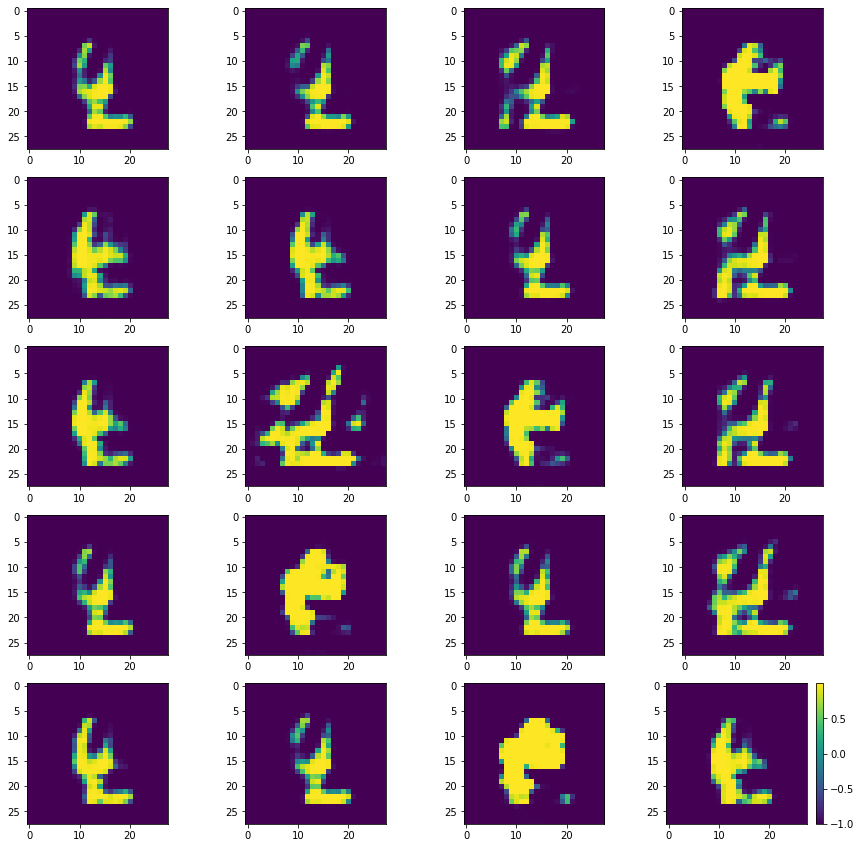

Batch_Num : 137
D_Loss   :   [10.796062469482422, 0.15211716294288635, 10.643945693969727, 0.5, 0.10546875] ;    GAN_Loss   :  [10.564878463745117, 0.7152755856513977, 9.849602699279785, 0.0, 0.10546875]
Batch_Num : 138
D_Loss   :   [10.022331237792969, 0.13036876916885376, 9.891962051391602, 0.498046875, 0.0859375] ;    GAN_Loss   :  [11.0720796585083, 0.9193173050880432, 10.152762413024902, 0.0, 0.10546875]
Batch_Num : 139
D_Loss   :   [9.924652099609375, 0.12711122632026672, 9.797540664672852, 0.5, 0.11328125] ;    GAN_Loss   :  [11.45121955871582, 1.0145153999328613, 10.436704635620117, 0.0, 0.103515625]
Batch_Num : 140
D_Loss   :   [9.52647590637207, 0.13092775642871857, 9.395547866821289, 0.5, 0.103515625] ;    GAN_Loss   :  [11.219114303588867, 1.0009685754776, 10.218145370483398, 0.0, 0.109375]
Batch_Num : 141
D_Loss   :   [10.109642028808594, 0.13918264210224152, 9.970458984375, 0.498046875, 0.115234375] ;    GAN_Loss   :  [11.129854202270508, 1.111031413078308, 10.01882266998

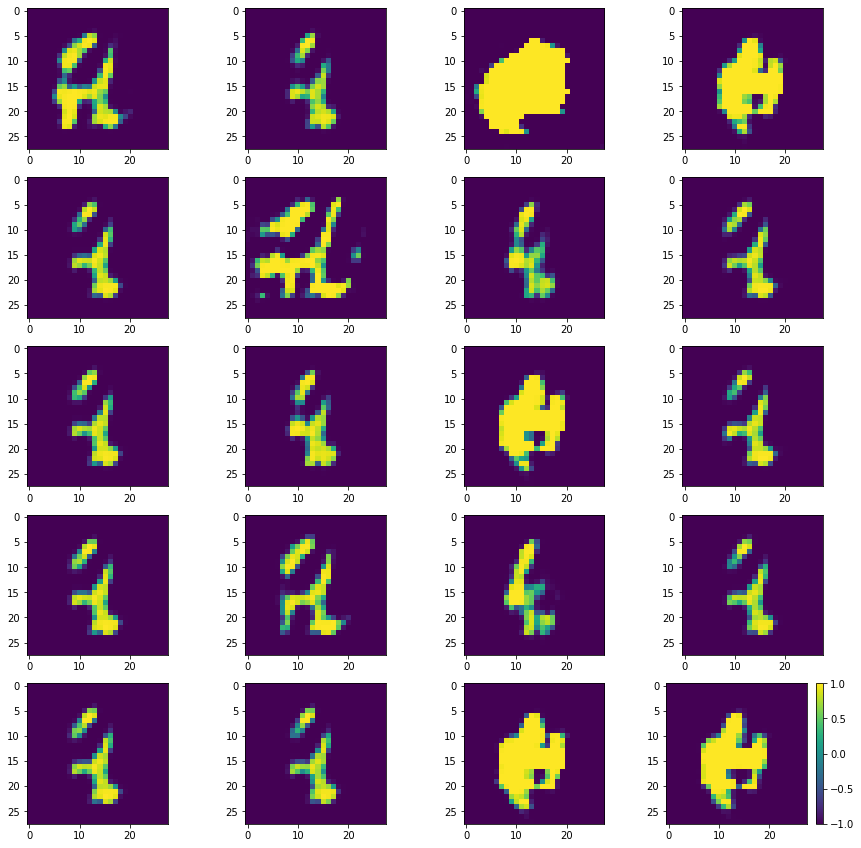

Batch_Num : 152
D_Loss   :   [9.851655006408691, 0.17874827980995178, 9.672906875610352, 0.5, 0.09765625] ;    GAN_Loss   :  [15.055671691894531, 3.9548211097717285, 11.100851058959961, 0.0, 0.0546875]
Batch_Num : 153
D_Loss   :   [10.109825134277344, 0.1807233691215515, 9.929101943969727, 0.494140625, 0.06640625] ;    GAN_Loss   :  [13.977974891662598, 3.5821621417999268, 10.39581298828125, 0.0, 0.056640625]
Batch_Num : 154
D_Loss   :   [10.102867126464844, 0.20264333486557007, 9.900223731994629, 0.49609375, 0.095703125] ;    GAN_Loss   :  [15.283181190490723, 4.519106864929199, 10.764074325561523, 0.0, 0.05078125]
Batch_Num : 155
D_Loss   :   [10.445233345031738, 0.18680372834205627, 10.258429527282715, 0.494140625, 0.068359375] ;    GAN_Loss   :  [14.945209503173828, 4.081903457641602, 10.863306045532227, 0.0, 0.078125]
Batch_Num : 156
D_Loss   :   [9.603381156921387, 0.20735310018062592, 9.396028518676758, 0.498046875, 0.09375] ;    GAN_Loss   :  [14.212053298950195, 3.144487619400

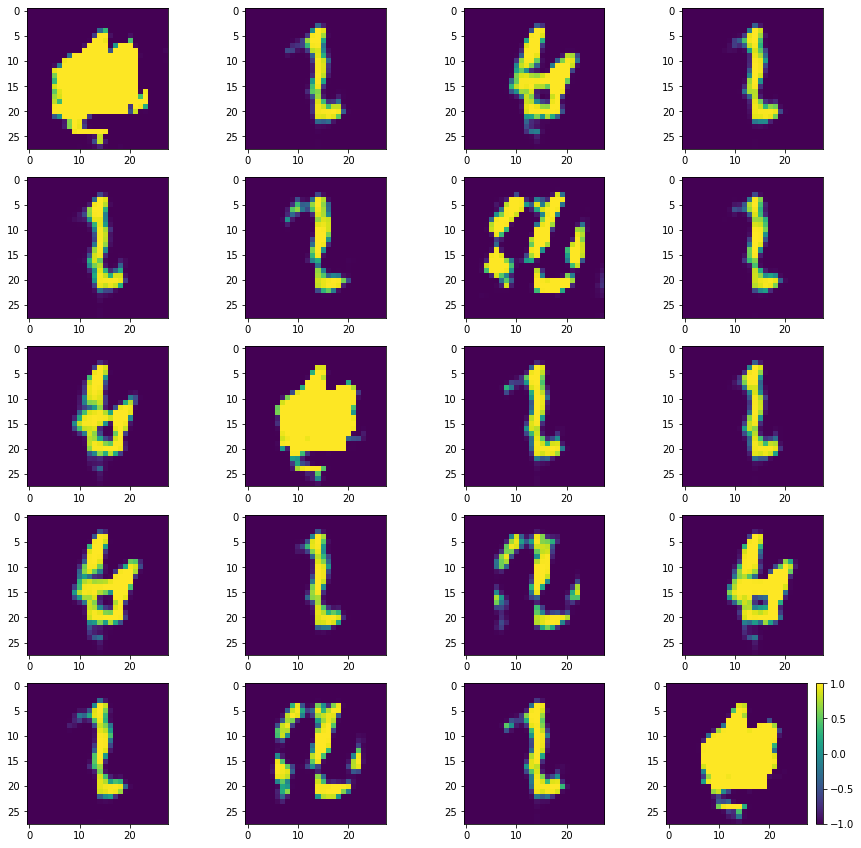

Batch_Num : 167
D_Loss   :   [10.59317398071289, 0.19729305803775787, 10.395880699157715, 0.5, 0.1015625] ;    GAN_Loss   :  [16.630393981933594, 5.607266902923584, 11.023126602172852, 0.0, 0.126953125]
Batch_Num : 168
D_Loss   :   [9.599227905273438, 0.160635307431221, 9.438592910766602, 0.5, 0.12890625] ;    GAN_Loss   :  [16.113969802856445, 5.305849552154541, 10.808119773864746, 0.0, 0.09375]
Batch_Num : 169
D_Loss   :   [10.094836235046387, 0.1444496512413025, 9.950387001037598, 0.5, 0.09765625] ;    GAN_Loss   :  [15.649988174438477, 4.827089309692383, 10.822898864746094, 0.0, 0.115234375]
Batch_Num : 170
D_Loss   :   [10.108024597167969, 0.17723585665225983, 9.93078899383545, 0.5, 0.0859375] ;    GAN_Loss   :  [15.563331604003906, 4.624936103820801, 10.938395500183105, 0.0, 0.091796875]
Batch_Num : 171
D_Loss   :   [10.472086906433105, 0.19327682256698608, 10.278810501098633, 0.49609375, 0.068359375] ;    GAN_Loss   :  [15.443229675292969, 4.61231803894043, 10.830911636352539, 0

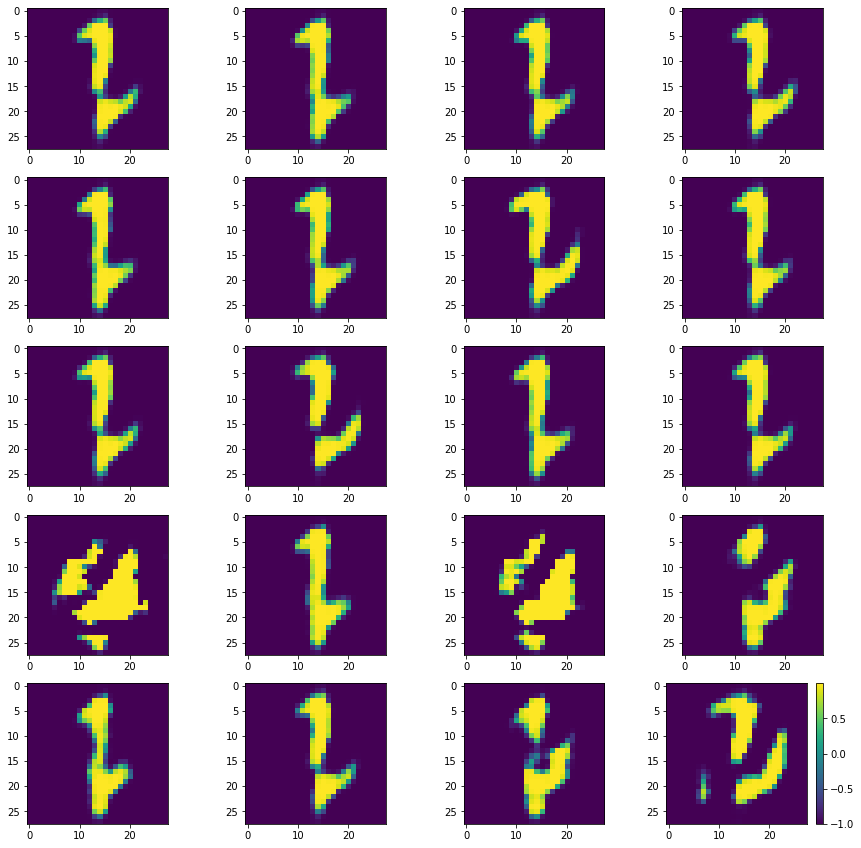

Batch_Num : 182
D_Loss   :   [9.737449645996094, 0.1596355140209198, 9.577814102172852, 0.5, 0.0703125] ;    GAN_Loss   :  [13.071399688720703, 1.9622721672058105, 11.10912799835205, 0.0, 0.064453125]
Batch_Num : 183
D_Loss   :   [10.398762702941895, 0.15136966109275818, 10.247392654418945, 0.498046875, 0.09765625] ;    GAN_Loss   :  [12.600932121276855, 2.0358591079711914, 10.565073013305664, 0.0, 0.0546875]
Batch_Num : 184
D_Loss   :   [9.86117172241211, 0.1555355340242386, 9.705636024475098, 0.49609375, 0.083984375] ;    GAN_Loss   :  [13.296343803405762, 2.6963977813720703, 10.599946022033691, 0.0, 0.080078125]
Batch_Num : 185
D_Loss   :   [9.919500350952148, 0.1325378119945526, 9.786962509155273, 0.5, 0.09375] ;    GAN_Loss   :  [14.141271591186523, 2.8728461265563965, 11.268425941467285, 0.0, 0.056640625]
Batch_Num : 186
D_Loss   :   [9.523374557495117, 0.1506807953119278, 9.37269401550293, 0.5, 0.068359375] ;    GAN_Loss   :  [13.230331420898438, 2.347903251647949, 10.8824281692

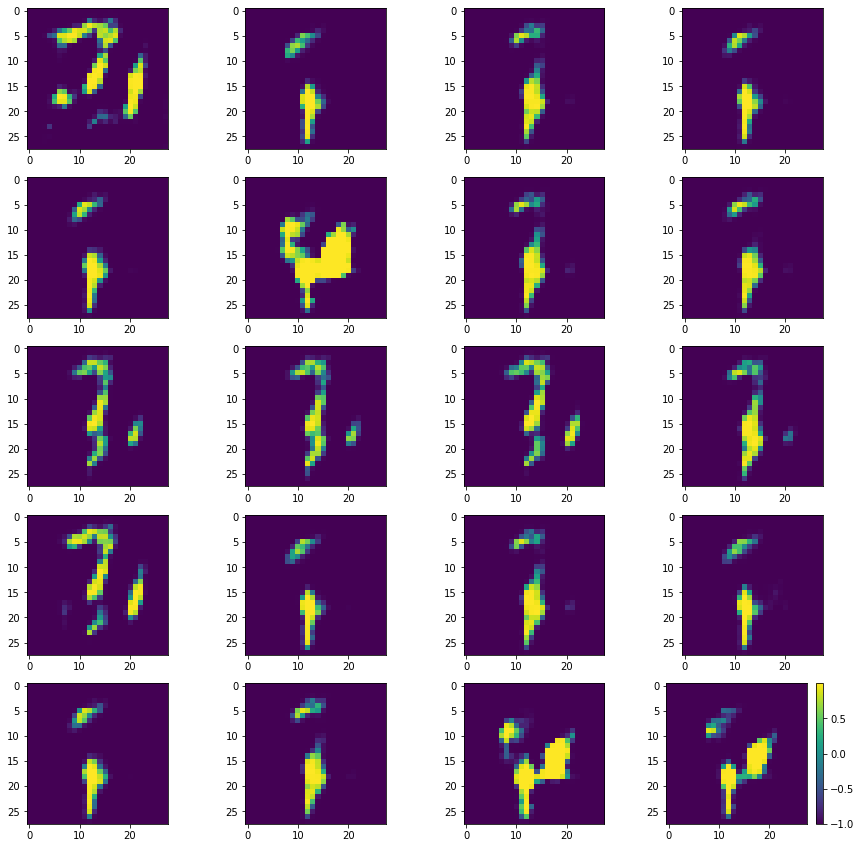

Batch_Num : 197
D_Loss   :   [10.013118743896484, 0.1772443801164627, 9.835874557495117, 0.49609375, 0.09765625] ;    GAN_Loss   :  [12.872041702270508, 2.826699733734131, 10.045342445373535, 0.0, 0.07421875]
Batch_Num : 198
D_Loss   :   [9.700392723083496, 0.15717951953411102, 9.543212890625, 0.5, 0.06640625] ;    GAN_Loss   :  [14.181434631347656, 3.651277542114258, 10.530157089233398, 0.0, 0.076171875]
Batch_Num : 199
D_Loss   :   [10.630205154418945, 0.1861465573310852, 10.444058418273926, 0.498046875, 0.068359375] ;    GAN_Loss   :  [15.018845558166504, 4.392209053039551, 10.626636505126953, 0.0, 0.0703125]
Batch_Num : 200
D_Loss   :   [10.172208786010742, 0.16086530685424805, 10.011343002319336, 0.490234375, 0.076171875] ;    GAN_Loss   :  [15.753165245056152, 4.3931169509887695, 11.360048294067383, 0.0, 0.056640625]
Batch_Num : 201
D_Loss   :   [10.400487899780273, 0.15076103806495667, 10.249727249145508, 0.5, 0.08203125] ;    GAN_Loss   :  [15.536218643188477, 4.975188732147217

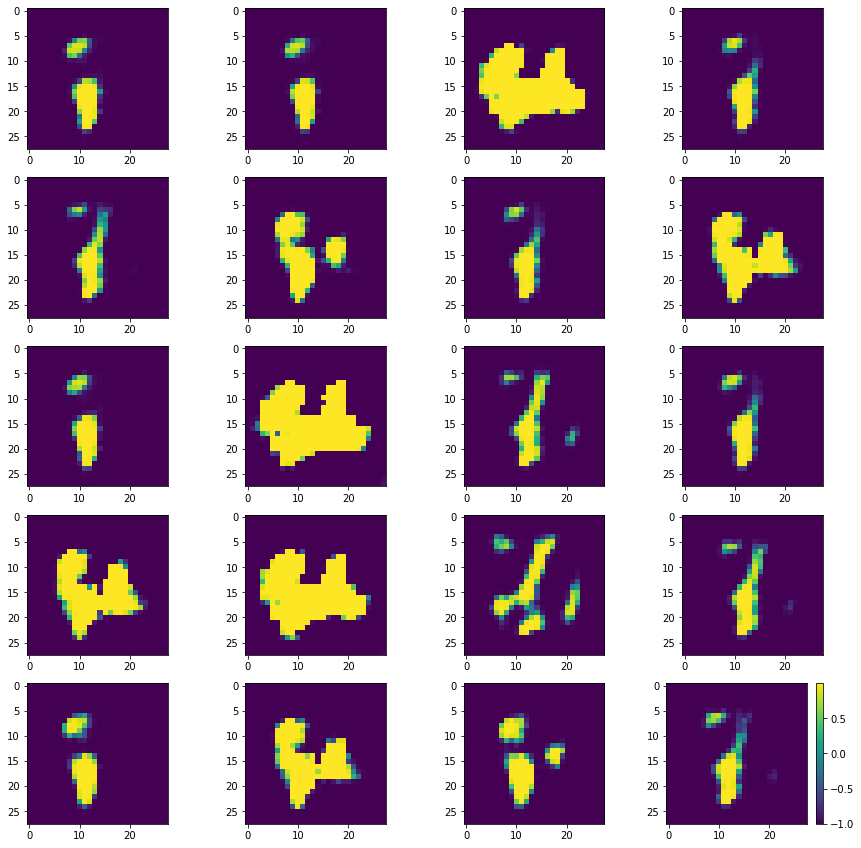

Batch_Num : 212
D_Loss   :   [10.930704116821289, 0.1506427526473999, 10.780061721801758, 0.5, 0.0859375] ;    GAN_Loss   :  [16.337554931640625, 5.3878912925720215, 10.949663162231445, 0.0, 0.056640625]
Batch_Num : 213
D_Loss   :   [9.623998641967773, 0.1565760225057602, 9.467422485351562, 0.498046875, 0.083984375] ;    GAN_Loss   :  [17.306991577148438, 5.959898948669434, 11.347092628479004, 0.0, 0.064453125]
Batch_Num : 214
D_Loss   :   [10.41071891784668, 0.17456719279289246, 10.236151695251465, 0.5, 0.0859375] ;    GAN_Loss   :  [17.04695701599121, 5.361773490905762, 11.68518352508545, 0.0, 0.078125]
Batch_Num : 215
D_Loss   :   [9.24282169342041, 0.16632390022277832, 9.076498031616211, 0.5, 0.072265625] ;    GAN_Loss   :  [16.73110008239746, 5.046716690063477, 11.684383392333984, 0.0, 0.07421875]
Batch_Num : 216
D_Loss   :   [10.453986167907715, 0.16759420931339264, 10.286392211914062, 0.49609375, 0.05859375] ;    GAN_Loss   :  [17.421764373779297, 5.099138259887695, 12.322626113

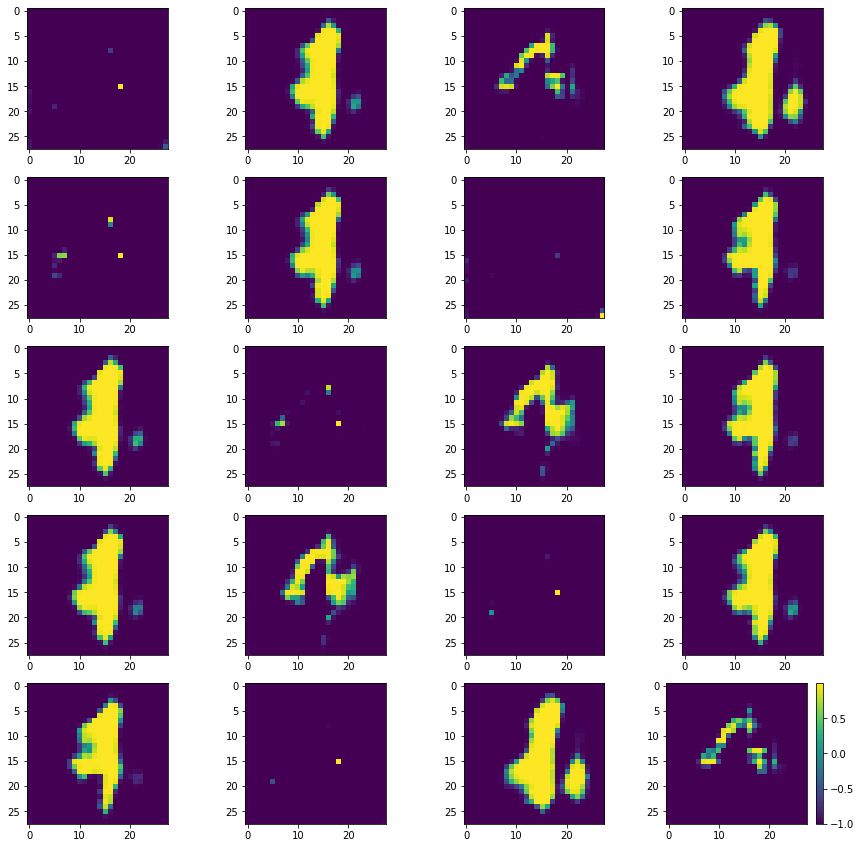

Batch_Num : 227
D_Loss   :   [9.43982219696045, 0.2966577410697937, 9.14316463470459, 0.4765625, 0.0859375] ;    GAN_Loss   :  [20.127424240112305, 8.405599594116211, 11.721824645996094, 0.0, 0.068359375]
Batch_Num : 228
D_Loss   :   [10.599814414978027, 0.3625544011592865, 10.237259864807129, 0.435546875, 0.09375] ;    GAN_Loss   :  [23.385684967041016, 11.57143783569336, 11.81424617767334, 0.0, 0.072265625]
Batch_Num : 229
D_Loss   :   [10.134300231933594, 0.45412614941596985, 9.680173873901367, 0.498046875, 0.0703125] ;    GAN_Loss   :  [20.994356155395508, 10.26129150390625, 10.733064651489258, 0.0, 0.056640625]
Batch_Num : 230
D_Loss   :   [10.28039264678955, 0.31013771891593933, 9.970254898071289, 0.423828125, 0.052734375] ;    GAN_Loss   :  [21.122657775878906, 10.465282440185547, 10.65737533569336, 0.0, 0.1015625]
Batch_Num : 231
D_Loss   :   [10.44015884399414, 0.2290206253528595, 10.211137771606445, 0.5, 0.0703125] ;    GAN_Loss   :  [21.330455780029297, 10.77549934387207, 10

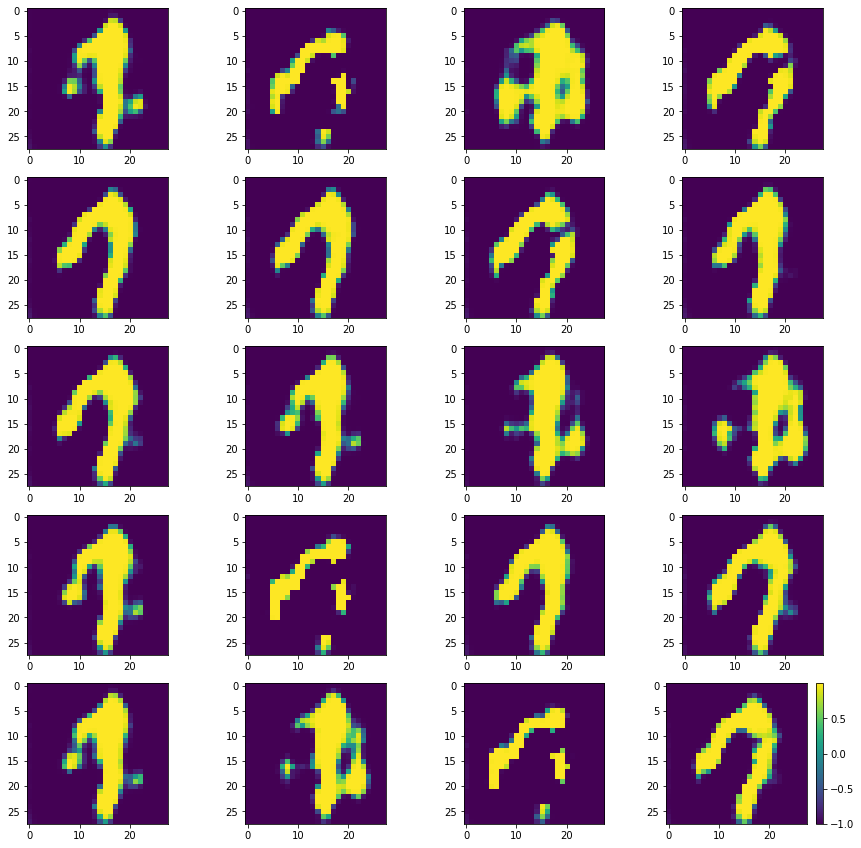

Batch_Num : 2
D_Loss   :   [10.300836563110352, 0.3031076490879059, 9.997729301452637, 0.482421875, 0.08203125] ;    GAN_Loss   :  [23.1319580078125, 12.35562515258789, 10.776331901550293, 0.0, 0.068359375]
Batch_Num : 3
D_Loss   :   [10.24010944366455, 0.21013130247592926, 10.029977798461914, 0.5, 0.08203125] ;    GAN_Loss   :  [21.74501609802246, 10.883512496948242, 10.861503601074219, 0.0, 0.068359375]
Batch_Num : 4
D_Loss   :   [10.36790943145752, 0.16686123609542847, 10.201047897338867, 0.5, 0.12109375] ;    GAN_Loss   :  [21.27623748779297, 10.427759170532227, 10.848478317260742, 0.0, 0.07421875]
Batch_Num : 5
D_Loss   :   [10.228880882263184, 0.18207424879074097, 10.046806335449219, 0.5, 0.09765625] ;    GAN_Loss   :  [20.149368286132812, 9.296380043029785, 10.852988243103027, 0.0, 0.07421875]
Batch_Num : 6
D_Loss   :   [10.511700630187988, 0.16418269276618958, 10.347517967224121, 0.5, 0.0859375] ;    GAN_Loss   :  [18.519550323486328, 8.378785133361816, 10.140766143798828, 0.0,

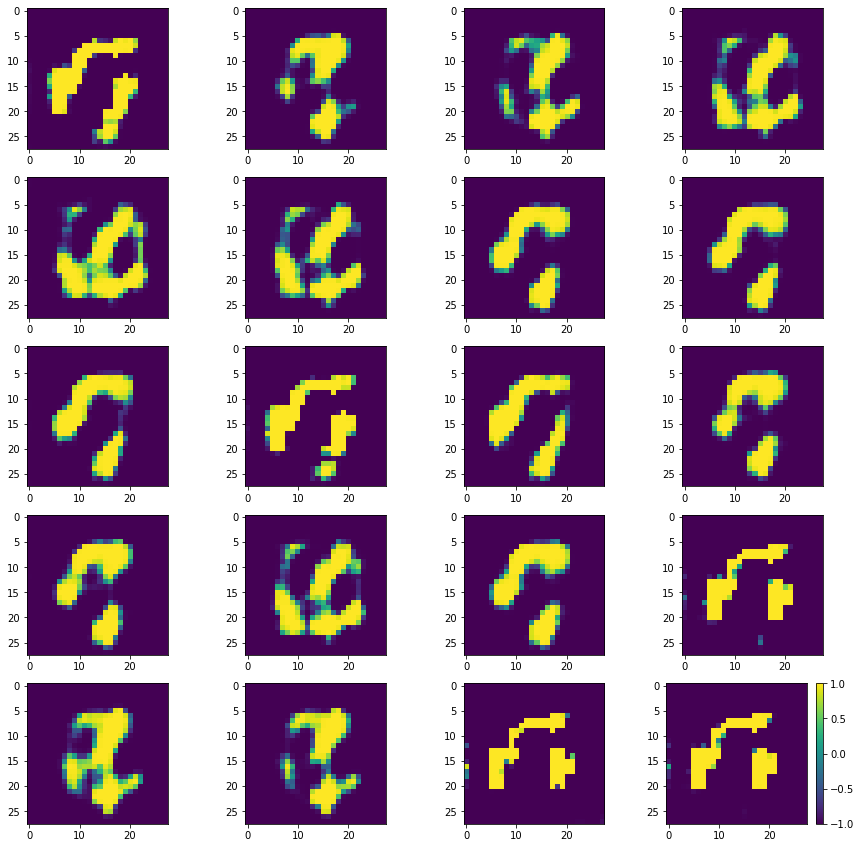

Batch_Num : 17
D_Loss   :   [9.806802749633789, 0.15543332695960999, 9.651369094848633, 0.498046875, 0.087890625] ;    GAN_Loss   :  [13.01913070678711, 3.131502389907837, 9.887628555297852, 0.0, 0.078125]
Batch_Num : 18
D_Loss   :   [9.976399421691895, 0.17848199605941772, 9.797917366027832, 0.490234375, 0.111328125] ;    GAN_Loss   :  [13.033185958862305, 2.871929407119751, 10.161256790161133, 0.0, 0.072265625]
Batch_Num : 19
D_Loss   :   [10.065845489501953, 0.19861790537834167, 9.867227554321289, 0.49609375, 0.072265625] ;    GAN_Loss   :  [12.852140426635742, 2.8437674045562744, 10.008373260498047, 0.0, 0.087890625]
Batch_Num : 20
D_Loss   :   [9.855213165283203, 0.16111908853054047, 9.694093704223633, 0.49609375, 0.0859375] ;    GAN_Loss   :  [12.661004066467285, 2.723475456237793, 9.937528610229492, 0.0, 0.080078125]
Batch_Num : 21
D_Loss   :   [9.693451881408691, 0.15434537827968597, 9.539106369018555, 0.4921875, 0.076171875] ;    GAN_Loss   :  [13.620084762573242, 3.3904805183

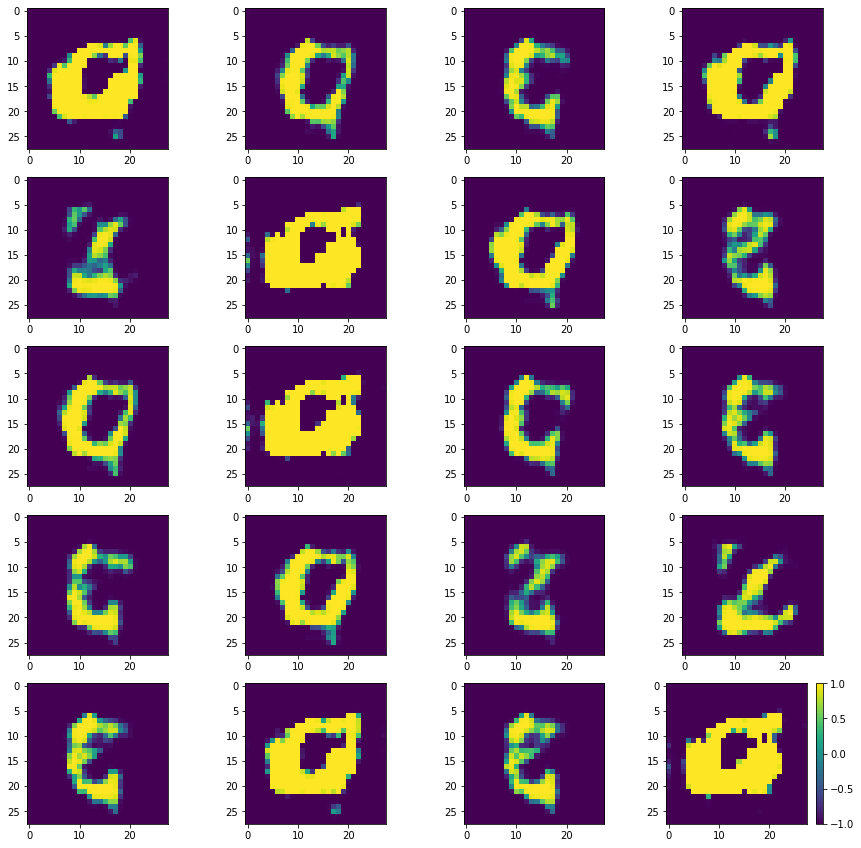

Batch_Num : 32
D_Loss   :   [9.863057136535645, 0.2899945378303528, 9.573062896728516, 0.486328125, 0.08203125] ;    GAN_Loss   :  [12.673487663269043, 2.5727767944335938, 10.10071086883545, 0.0, 0.111328125]
Batch_Num : 33
D_Loss   :   [10.408659934997559, 0.2479294091463089, 10.160730361938477, 0.494140625, 0.0703125] ;    GAN_Loss   :  [13.885650634765625, 4.092398166656494, 9.793252944946289, 0.0, 0.091796875]
Batch_Num : 34
D_Loss   :   [10.739450454711914, 0.5142269730567932, 10.225223541259766, 0.49609375, 0.07421875] ;    GAN_Loss   :  [16.51642608642578, 6.073173522949219, 10.443253517150879, 0.0, 0.119140625]
Batch_Num : 35
D_Loss   :   [9.987954139709473, 0.5259948968887329, 9.461958885192871, 0.2421875, 0.10546875] ;    GAN_Loss   :  [16.42401885986328, 6.324942111968994, 10.099076271057129, 0.0, 0.10546875]
Batch_Num : 36
D_Loss   :   [9.907024383544922, 0.3625068664550781, 9.544517517089844, 0.5, 0.08984375] ;    GAN_Loss   :  [15.808616638183594, 5.569716453552246, 10.23

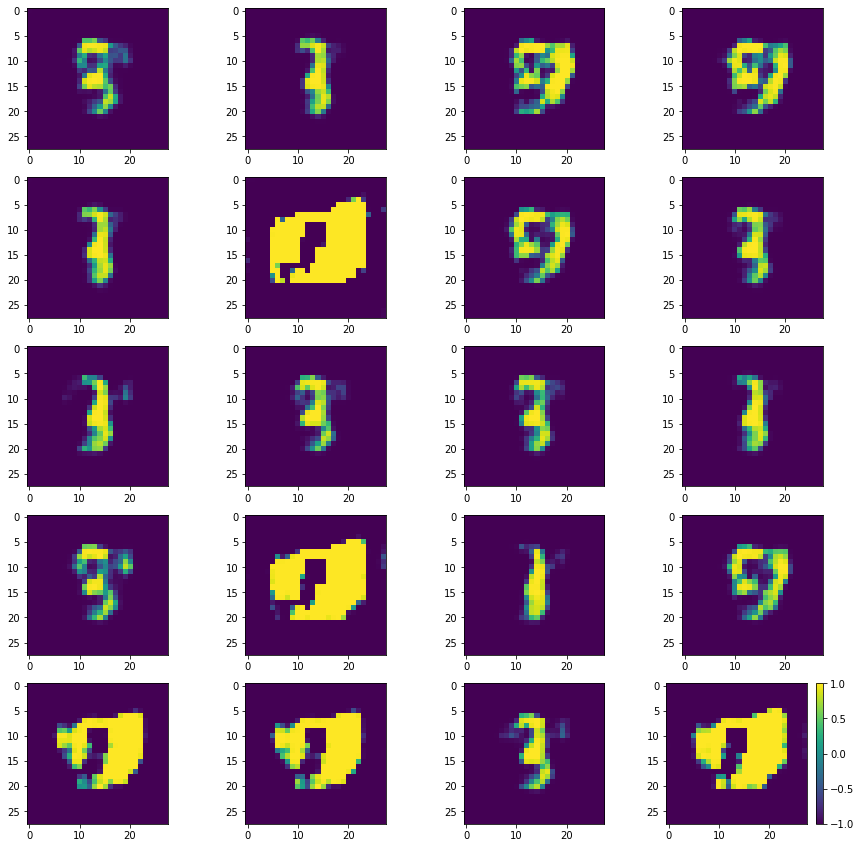

Batch_Num : 47
D_Loss   :   [10.81374454498291, 0.27364426851272583, 10.54010009765625, 0.5, 0.109375] ;    GAN_Loss   :  [19.318201065063477, 8.24036693572998, 11.077834129333496, 0.0, 0.064453125]
Batch_Num : 48
D_Loss   :   [10.208378791809082, 0.23076142370700836, 9.977617263793945, 0.48828125, 0.099609375] ;    GAN_Loss   :  [19.321699142456055, 7.73368501663208, 11.588014602661133, 0.0, 0.060546875]
Batch_Num : 49
D_Loss   :   [10.116016387939453, 0.2089177519083023, 9.907098770141602, 0.498046875, 0.06640625] ;    GAN_Loss   :  [18.795612335205078, 7.368861198425293, 11.426751136779785, 0.0, 0.083984375]
Batch_Num : 50
D_Loss   :   [9.80466079711914, 0.17592908442020416, 9.628731727600098, 0.498046875, 0.1015625] ;    GAN_Loss   :  [17.591156005859375, 6.813337326049805, 10.777819633483887, 0.0, 0.05078125]
Batch_Num : 51
D_Loss   :   [10.455522537231445, 0.202195405960083, 10.253327369689941, 0.4921875, 0.107421875] ;    GAN_Loss   :  [17.189380645751953, 6.6389665603637695, 10

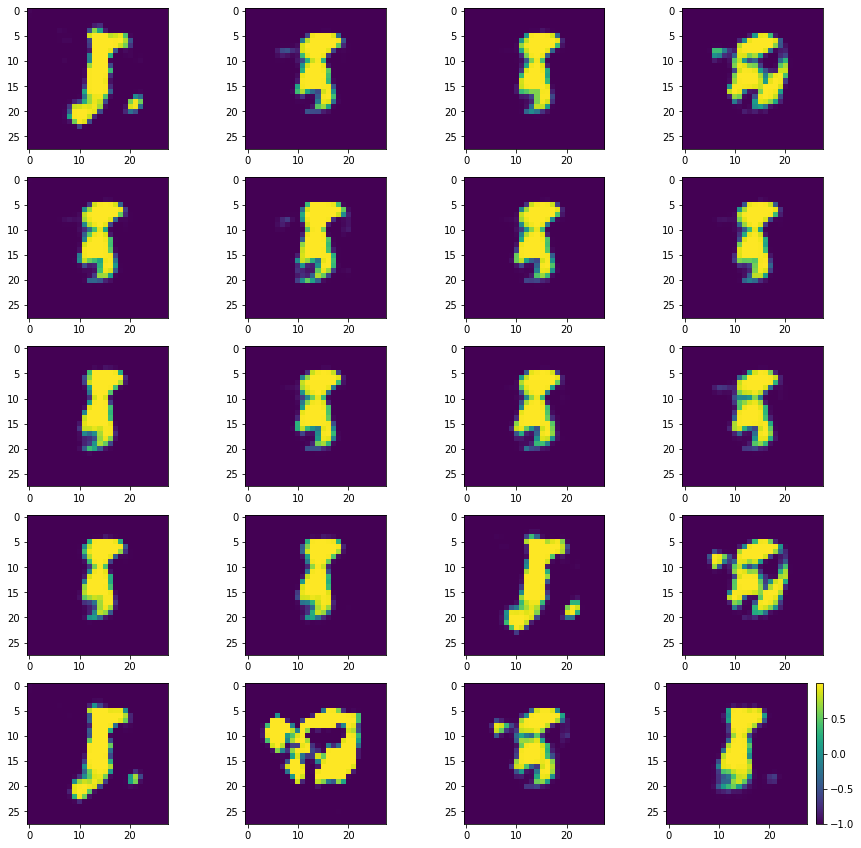

Batch_Num : 62
D_Loss   :   [9.806692123413086, 0.17936772108078003, 9.627324104309082, 0.5, 0.060546875] ;    GAN_Loss   :  [15.719059944152832, 4.947439193725586, 10.771620750427246, 0.0, 0.060546875]
Batch_Num : 63
D_Loss   :   [10.086133003234863, 0.2026570737361908, 9.883476257324219, 0.49609375, 0.064453125] ;    GAN_Loss   :  [15.164167404174805, 5.034444332122803, 10.129722595214844, 0.0, 0.056640625]
Batch_Num : 64
D_Loss   :   [10.070638656616211, 0.20465879142284393, 9.86598014831543, 0.49609375, 0.076171875] ;    GAN_Loss   :  [15.236059188842773, 4.93996524810791, 10.296093940734863, 0.0, 0.064453125]
Batch_Num : 65
D_Loss   :   [10.154867172241211, 0.15229065716266632, 10.00257682800293, 0.5, 0.05859375] ;    GAN_Loss   :  [15.65717887878418, 5.100426197052002, 10.556753158569336, 0.0, 0.044921875]
Batch_Num : 66
D_Loss   :   [10.808062553405762, 0.1790684312582016, 10.62899398803711, 0.494140625, 0.072265625] ;    GAN_Loss   :  [15.879507064819336, 5.2000837326049805, 10

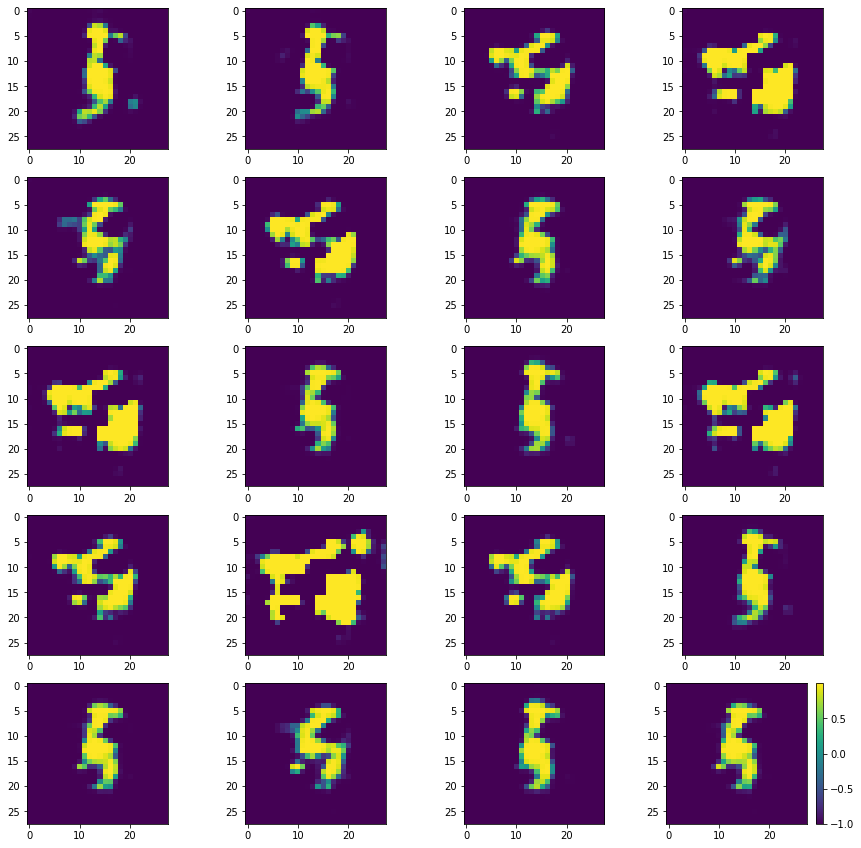

Batch_Num : 77
D_Loss   :   [10.09693431854248, 0.1889132410287857, 9.908020973205566, 0.498046875, 0.09765625] ;    GAN_Loss   :  [16.672054290771484, 5.5916242599487305, 11.08043098449707, 0.0, 0.064453125]
Batch_Num : 78
D_Loss   :   [9.732345581054688, 0.17127639055252075, 9.56106948852539, 0.5, 0.07421875] ;    GAN_Loss   :  [16.525428771972656, 5.644169807434082, 10.88125991821289, 0.0, 0.072265625]
Batch_Num : 79
D_Loss   :   [10.526761054992676, 0.18696342408657074, 10.339797973632812, 0.498046875, 0.095703125] ;    GAN_Loss   :  [16.367441177368164, 5.7282328605651855, 10.639208793640137, 0.0, 0.052734375]
Batch_Num : 80
D_Loss   :   [10.064313888549805, 0.17773829400539398, 9.886575698852539, 0.494140625, 0.095703125] ;    GAN_Loss   :  [16.755889892578125, 5.680568695068359, 11.075322151184082, 0.0, 0.080078125]
Batch_Num : 81
D_Loss   :   [10.318603515625, 0.1990024596452713, 10.119601249694824, 0.5, 0.078125] ;    GAN_Loss   :  [16.582786560058594, 5.849935531616211, 10.73

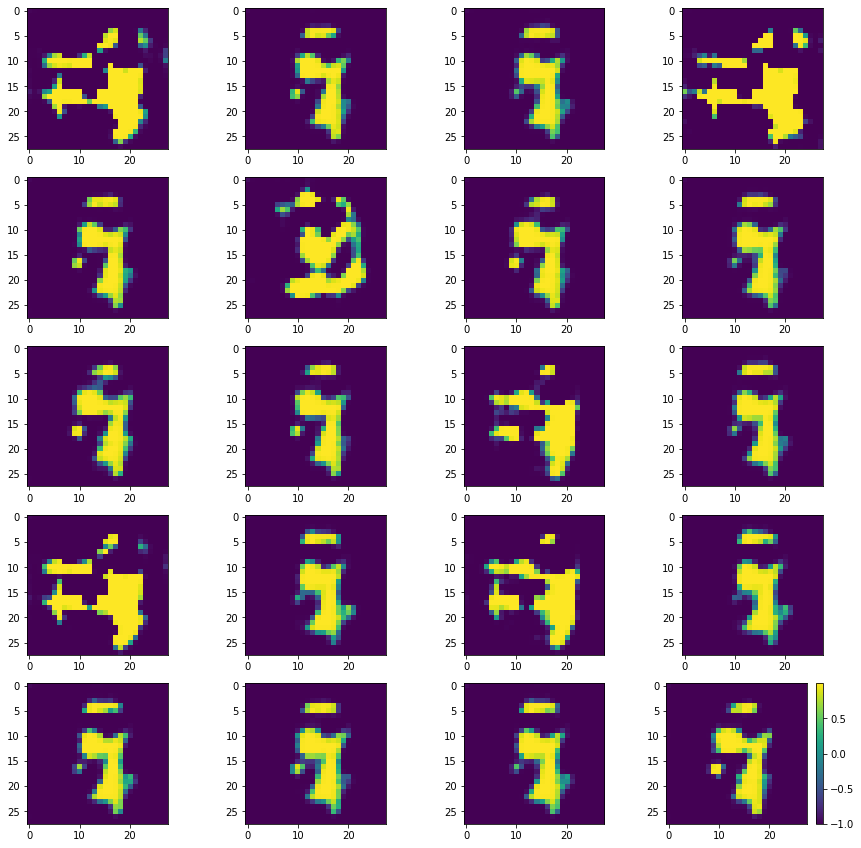

Batch_Num : 92
D_Loss   :   [10.225251197814941, 0.2142144739627838, 10.01103687286377, 0.4921875, 0.0625] ;    GAN_Loss   :  [15.036750793457031, 4.514218807220459, 10.52253246307373, 0.0, 0.041015625]
Batch_Num : 93
D_Loss   :   [10.612089157104492, 0.16302523016929626, 10.449064254760742, 0.49609375, 0.056640625] ;    GAN_Loss   :  [14.86192798614502, 4.00557804107666, 10.85634994506836, 0.0, 0.0546875]
Batch_Num : 94
D_Loss   :   [10.05290699005127, 0.18157050013542175, 9.871336936950684, 0.49609375, 0.080078125] ;    GAN_Loss   :  [13.83604621887207, 3.6979897022247314, 10.138056755065918, 0.0, 0.046875]
Batch_Num : 95
D_Loss   :   [10.242837905883789, 0.19761262834072113, 10.045225143432617, 0.4921875, 0.068359375] ;    GAN_Loss   :  [13.881704330444336, 3.197589635848999, 10.684114456176758, 0.0, 0.0546875]
Batch_Num : 96
D_Loss   :   [9.809209823608398, 0.20633091032505035, 9.60287857055664, 0.5, 0.091796875] ;    GAN_Loss   :  [13.05985164642334, 2.9589242935180664, 10.1009273

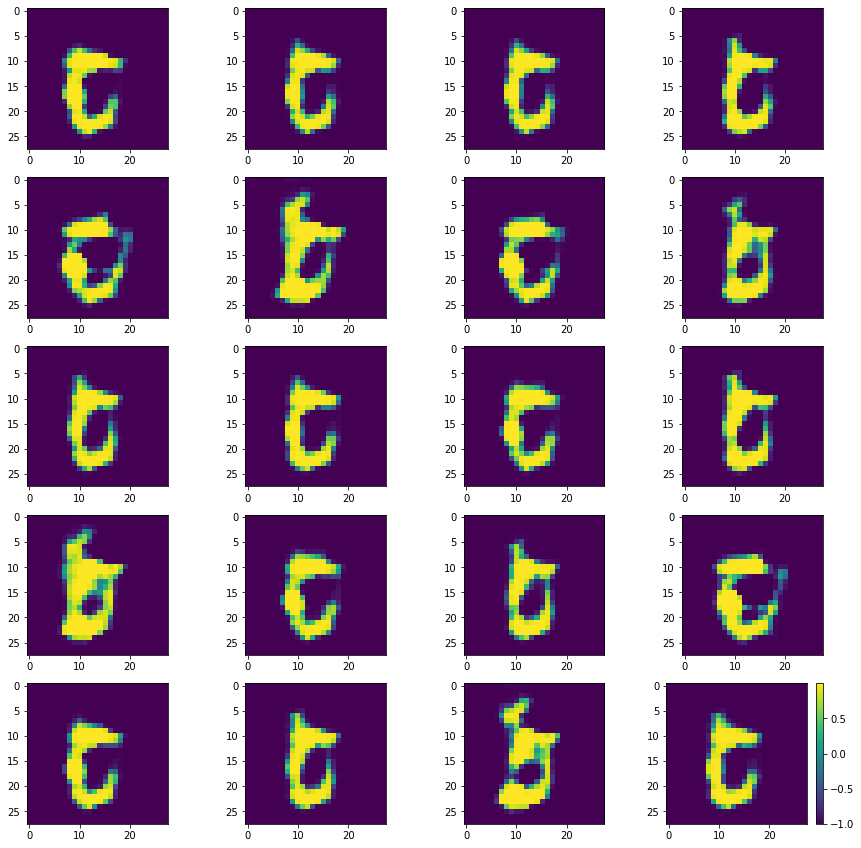

Batch_Num : 107
D_Loss   :   [10.070819854736328, 0.1949230432510376, 9.875896453857422, 0.498046875, 0.103515625] ;    GAN_Loss   :  [11.352022171020508, 1.3655245304107666, 9.98649787902832, 0.0, 0.103515625]
Batch_Num : 108
D_Loss   :   [9.461941719055176, 0.16193510591983795, 9.300006866455078, 0.5, 0.08984375] ;    GAN_Loss   :  [11.069512367248535, 1.200584053993225, 9.868927955627441, 0.0, 0.099609375]
Batch_Num : 109
D_Loss   :   [9.690361976623535, 0.1662161946296692, 9.52414608001709, 0.5, 0.076171875] ;    GAN_Loss   :  [11.302382469177246, 1.039398193359375, 10.262984275817871, 0.0, 0.08984375]
Batch_Num : 110
D_Loss   :   [10.397640228271484, 0.17734399437904358, 10.220295906066895, 0.49609375, 0.091796875] ;    GAN_Loss   :  [11.594791412353516, 0.9287457466125488, 10.666046142578125, 0.0, 0.115234375]
Batch_Num : 111
D_Loss   :   [9.60145092010498, 0.20248916745185852, 9.398962020874023, 0.490234375, 0.109375] ;    GAN_Loss   :  [10.93885326385498, 1.090505599975586, 9.8

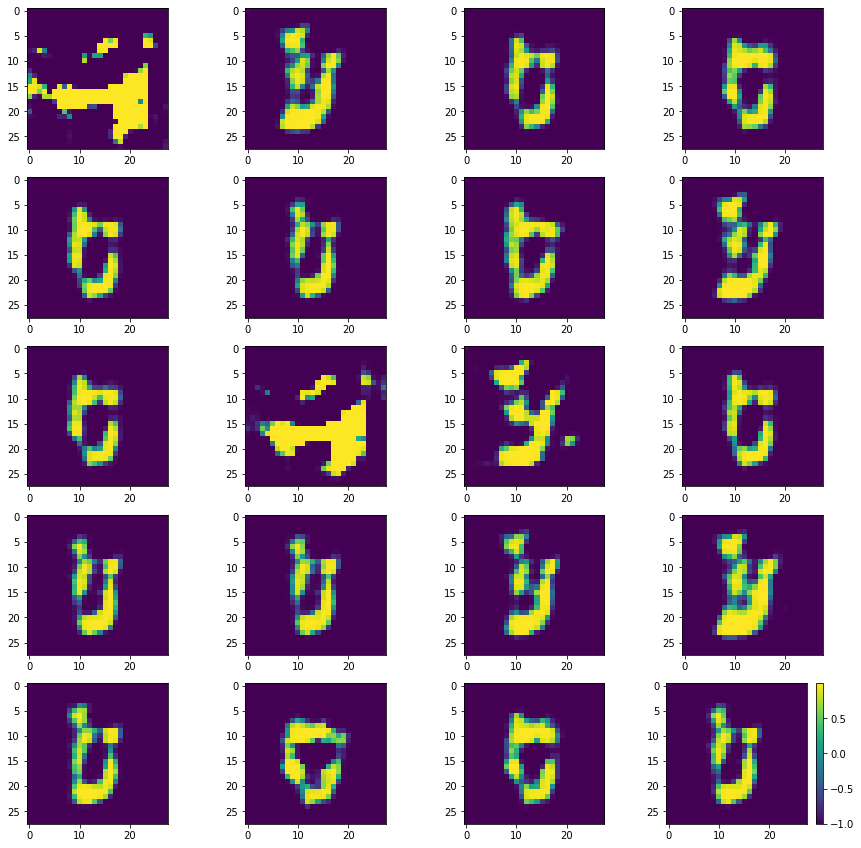

Batch_Num : 122
D_Loss   :   [10.553010940551758, 0.15171962976455688, 10.401290893554688, 0.49609375, 0.09765625] ;    GAN_Loss   :  [10.543381690979004, 0.4297129511833191, 10.113668441772461, 0.0, 0.080078125]
Batch_Num : 123
D_Loss   :   [9.934638023376465, 0.16035141050815582, 9.774286270141602, 0.5, 0.0859375] ;    GAN_Loss   :  [10.486438751220703, 0.528438925743103, 9.958000183105469, 0.0, 0.076171875]
Batch_Num : 124
D_Loss   :   [10.270352363586426, 0.1499113291501999, 10.120441436767578, 0.498046875, 0.115234375] ;    GAN_Loss   :  [10.708436965942383, 0.5490916967391968, 10.159345626831055, 0.0, 0.08984375]
Batch_Num : 125
D_Loss   :   [10.46274471282959, 0.16595150530338287, 10.296792984008789, 0.498046875, 0.103515625] ;    GAN_Loss   :  [11.067562103271484, 0.6012173295021057, 10.466344833374023, 0.0, 0.095703125]
Batch_Num : 126
D_Loss   :   [10.395928382873535, 0.14730116724967957, 10.248627662658691, 0.5, 0.08984375] ;    GAN_Loss   :  [10.870450973510742, 0.787974476

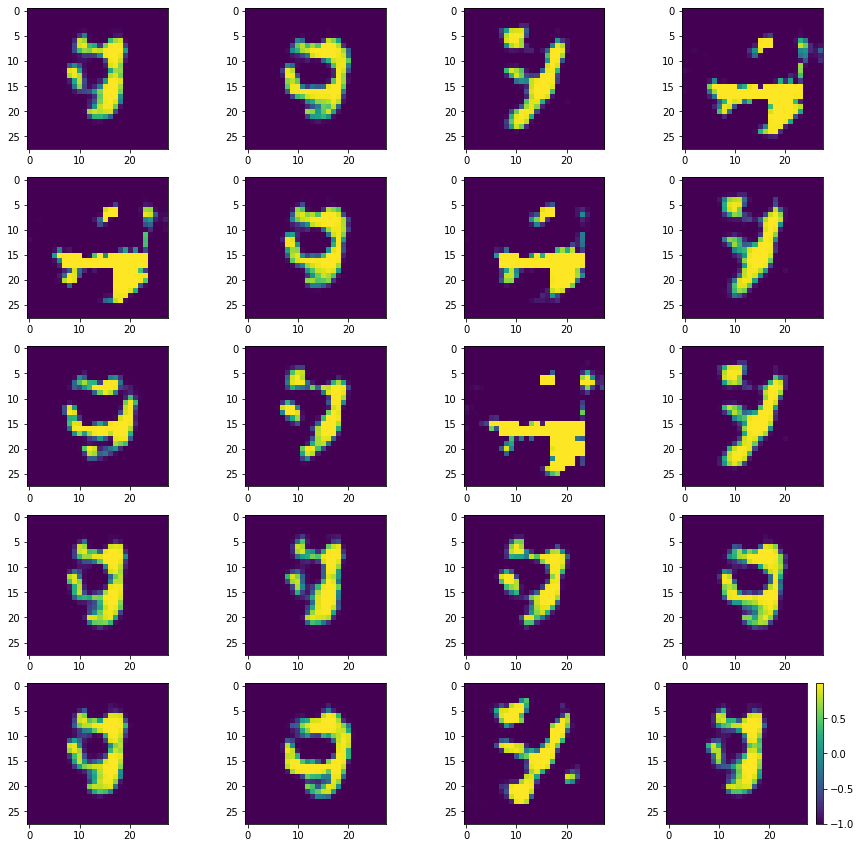

Batch_Num : 137
D_Loss   :   [10.929933547973633, 0.2915198802947998, 10.638413429260254, 0.49609375, 0.09375] ;    GAN_Loss   :  [15.623250961303711, 4.975428104400635, 10.647823333740234, 0.0, 0.1015625]
Batch_Num : 138
D_Loss   :   [10.131087303161621, 0.23516841232776642, 9.895918846130371, 0.484375, 0.1171875] ;    GAN_Loss   :  [15.453652381896973, 5.484805107116699, 9.968847274780273, 0.0, 0.10546875]
Batch_Num : 139
D_Loss   :   [10.013294219970703, 0.21286100149154663, 9.800433158874512, 0.490234375, 0.08984375] ;    GAN_Loss   :  [15.458166122436523, 5.600885391235352, 9.857280731201172, 0.0, 0.13671875]
Batch_Num : 140
D_Loss   :   [9.630603790283203, 0.23216018080711365, 9.398443222045898, 0.49609375, 0.103515625] ;    GAN_Loss   :  [15.567319869995117, 5.696197509765625, 9.871122360229492, 0.0, 0.126953125]
Batch_Num : 141
D_Loss   :   [10.235905647277832, 0.26219794154167175, 9.973708152770996, 0.49609375, 0.103515625] ;    GAN_Loss   :  [15.00322437286377, 5.197060585021

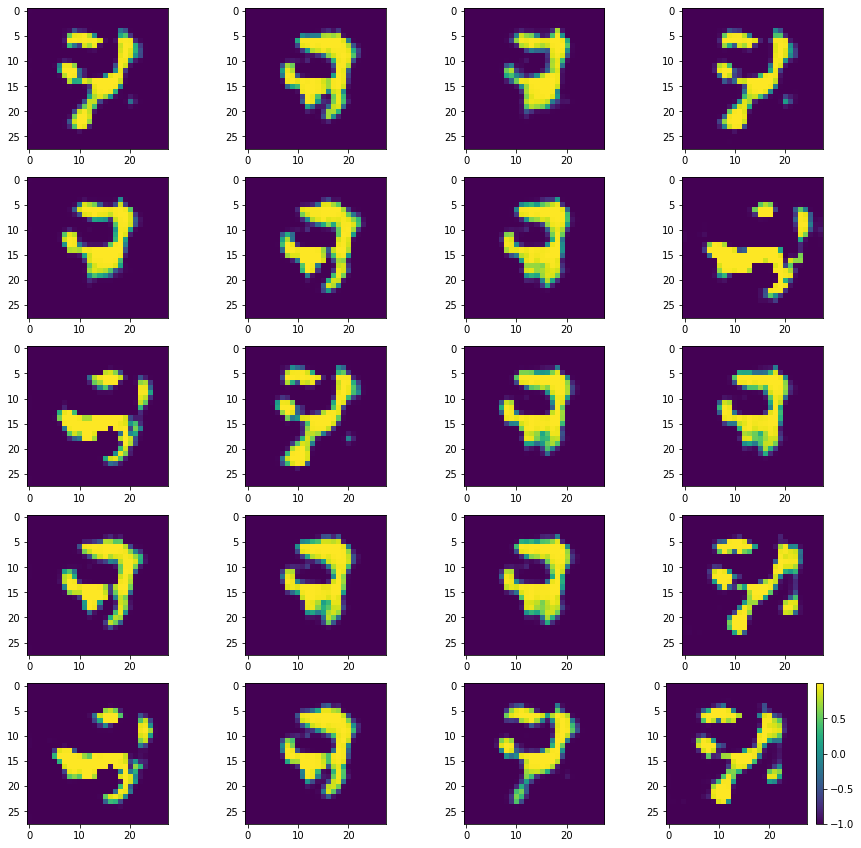

Batch_Num : 152
D_Loss   :   [9.86693286895752, 0.19751694798469543, 9.669415473937988, 0.48046875, 0.078125] ;    GAN_Loss   :  [14.356683731079102, 3.9872612953186035, 10.369422912597656, 0.0, 0.0546875]
Batch_Num : 153
D_Loss   :   [10.146777153015137, 0.2168506681919098, 9.929926872253418, 0.45703125, 0.09375] ;    GAN_Loss   :  [14.290403366088867, 4.037482738494873, 10.252920150756836, 0.0, 0.0703125]
Batch_Num : 154
D_Loss   :   [10.163311958312988, 0.25787967443466187, 9.90543270111084, 0.494140625, 0.126953125] ;    GAN_Loss   :  [15.359188079833984, 4.68312406539917, 10.676063537597656, 0.0, 0.095703125]
Batch_Num : 155
D_Loss   :   [10.451074600219727, 0.19156639277935028, 10.25950813293457, 0.498046875, 0.125] ;    GAN_Loss   :  [15.579108238220215, 5.297086715698242, 10.282021522521973, 0.0, 0.076171875]
Batch_Num : 156
D_Loss   :   [9.569190979003906, 0.19324254989624023, 9.375948905944824, 0.5, 0.099609375] ;    GAN_Loss   :  [14.97996711730957, 5.065706253051758, 9.9142

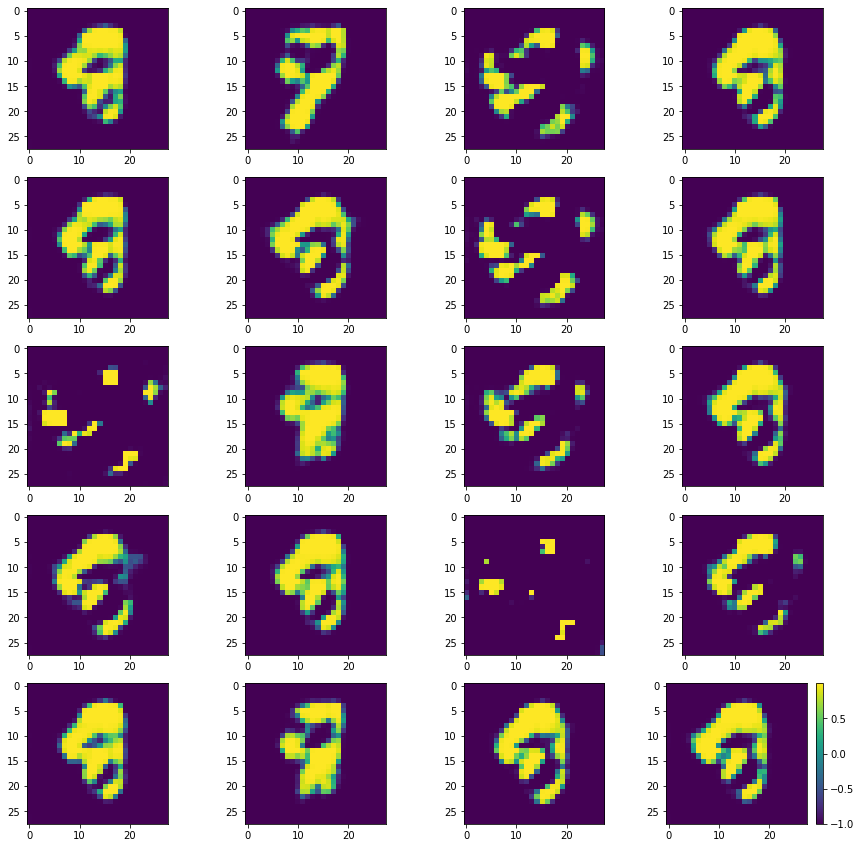

Batch_Num : 167
D_Loss   :   [10.587248802185059, 0.1940273642539978, 10.393221855163574, 0.48828125, 0.107421875] ;    GAN_Loss   :  [13.391443252563477, 3.0825867652893066, 10.308856964111328, 0.0, 0.099609375]
Batch_Num : 168
D_Loss   :   [9.577095031738281, 0.14985157549381256, 9.42724323272705, 0.5, 0.12109375] ;    GAN_Loss   :  [13.583467483520508, 2.991046190261841, 10.592421531677246, 0.0, 0.115234375]
Batch_Num : 169
D_Loss   :   [10.091970443725586, 0.1443326324224472, 9.947637557983398, 0.5, 0.11328125] ;    GAN_Loss   :  [13.232271194458008, 2.549736976623535, 10.682534217834473, 0.0, 0.12890625]
Batch_Num : 170
D_Loss   :   [10.101325035095215, 0.16362816095352173, 9.93769645690918, 0.5, 0.123046875] ;    GAN_Loss   :  [12.753533363342285, 2.2961606979370117, 10.457372665405273, 0.0, 0.099609375]
Batch_Num : 171
D_Loss   :   [10.472624778747559, 0.19184333086013794, 10.280781745910645, 0.4921875, 0.099609375] ;    GAN_Loss   :  [12.626855850219727, 2.187293529510498, 10.4

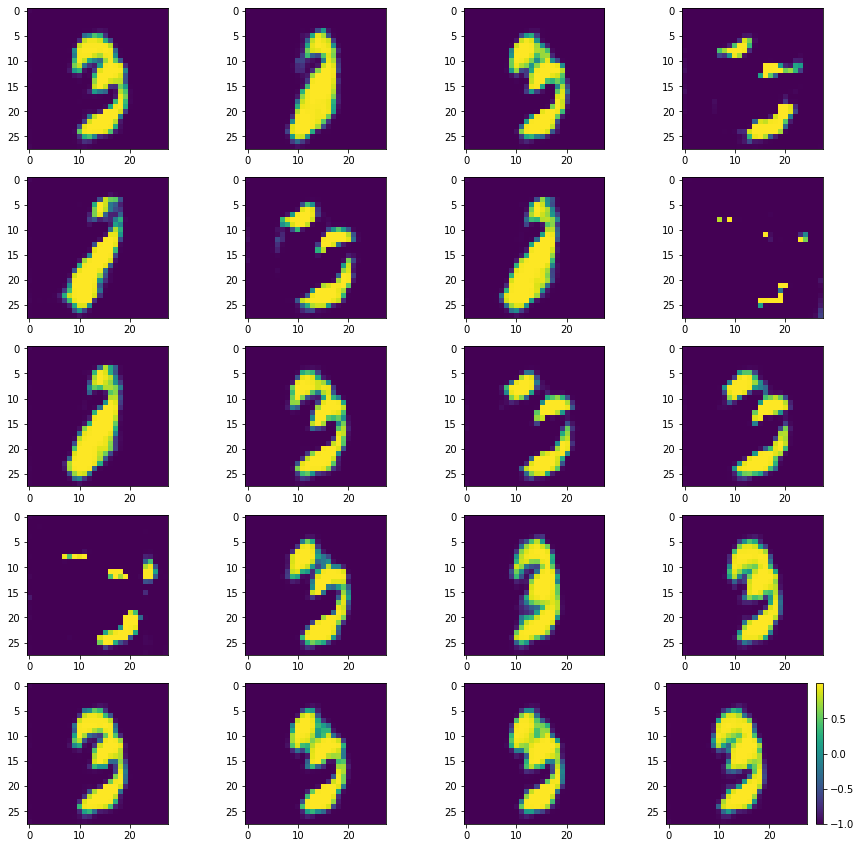

Batch_Num : 182
D_Loss   :   [9.826509475708008, 0.2515864670276642, 9.574922561645508, 0.5, 0.111328125] ;    GAN_Loss   :  [17.418907165527344, 6.672055244445801, 10.746850967407227, 0.0, 0.095703125]
Batch_Num : 183
D_Loss   :   [10.465569496154785, 0.23588988184928894, 10.229680061340332, 0.486328125, 0.11328125] ;    GAN_Loss   :  [17.32516860961914, 6.686899662017822, 10.63826847076416, 0.0, 0.087890625]
Batch_Num : 184
D_Loss   :   [9.94379711151123, 0.2197045385837555, 9.724092483520508, 0.498046875, 0.13671875] ;    GAN_Loss   :  [16.921049118041992, 6.721497535705566, 10.199551582336426, 0.0, 0.111328125]
Batch_Num : 185
D_Loss   :   [10.004473686218262, 0.22298194468021393, 9.78149127960205, 0.490234375, 0.12890625] ;    GAN_Loss   :  [16.73203468322754, 6.216909885406494, 10.515124320983887, 0.0, 0.1015625]
Batch_Num : 186
D_Loss   :   [9.594064712524414, 0.2230086624622345, 9.371055603027344, 0.490234375, 0.091796875] ;    GAN_Loss   :  [17.53520965576172, 6.75948143005371

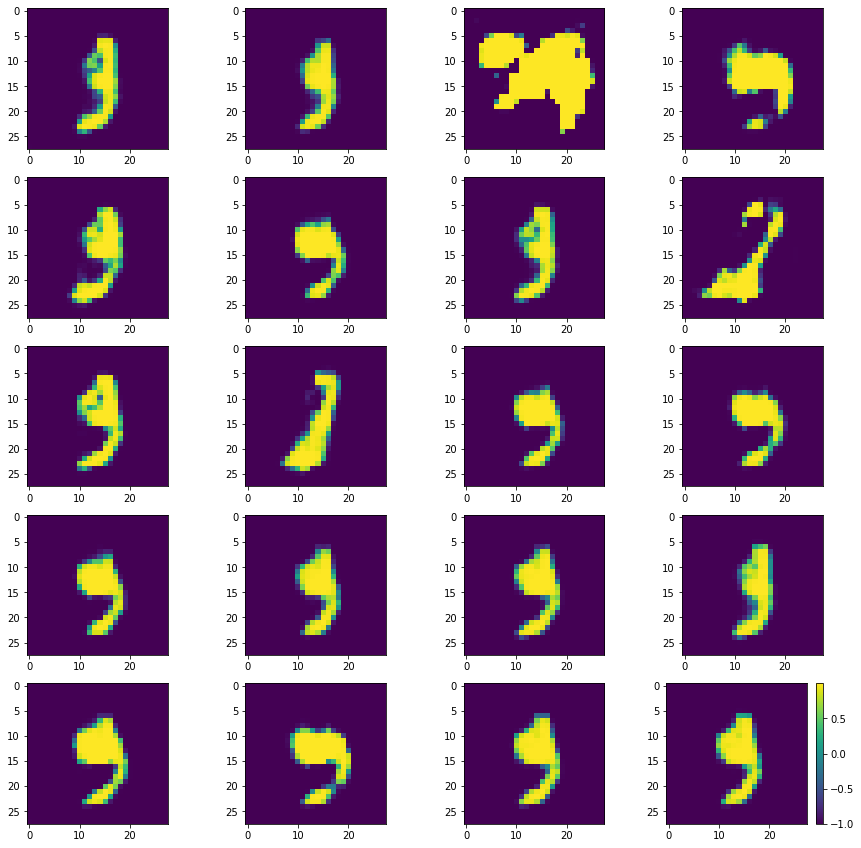

Batch_Num : 197
D_Loss   :   [10.076447486877441, 0.24114735424518585, 9.83530044555664, 0.486328125, 0.119140625] ;    GAN_Loss   :  [21.036123275756836, 10.276281356811523, 10.759841918945312, 0.0, 0.06640625]
Batch_Num : 198
D_Loss   :   [9.751819610595703, 0.20779651403427124, 9.544023513793945, 0.486328125, 0.095703125] ;    GAN_Loss   :  [20.644275665283203, 9.979533195495605, 10.664742469787598, 0.0, 0.052734375]
Batch_Num : 199
D_Loss   :   [10.738778114318848, 0.30466610193252563, 10.434111595153809, 0.490234375, 0.09375] ;    GAN_Loss   :  [23.999340057373047, 12.46981143951416, 11.529529571533203, 0.0, 0.068359375]
Batch_Num : 200
D_Loss   :   [10.242486953735352, 0.23129425942897797, 10.011192321777344, 0.48046875, 0.119140625] ;    GAN_Loss   :  [24.38745880126953, 13.367904663085938, 11.019554138183594, 0.0, 0.11328125]
Batch_Num : 201
D_Loss   :   [10.43921947479248, 0.19536399841308594, 10.243855476379395, 0.48828125, 0.10546875] ;    GAN_Loss   :  [24.7984619140625, 13

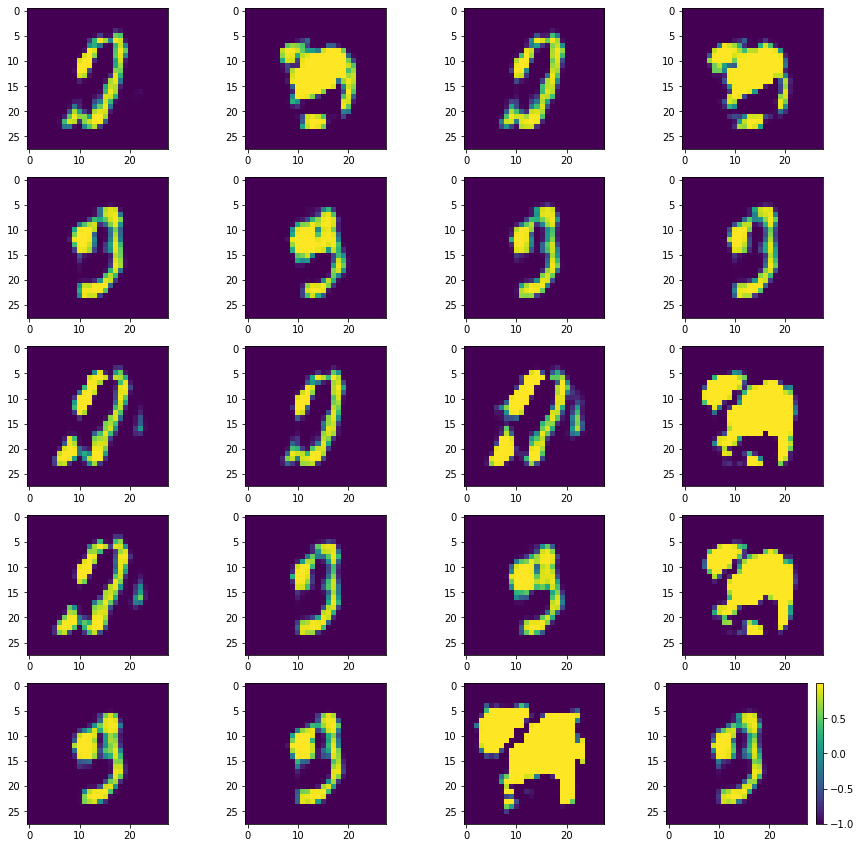

Batch_Num : 212
D_Loss   :   [10.99187183380127, 0.21609565615653992, 10.775775909423828, 0.490234375, 0.119140625] ;    GAN_Loss   :  [16.45488739013672, 6.3678202629089355, 10.087066650390625, 0.0, 0.091796875]
Batch_Num : 213
D_Loss   :   [9.723485946655273, 0.25065043568611145, 9.472835540771484, 0.4921875, 0.091796875] ;    GAN_Loss   :  [15.97006893157959, 6.041581153869629, 9.928487777709961, 0.0, 0.10546875]
Batch_Num : 214
D_Loss   :   [10.467486381530762, 0.23776160180568695, 10.229724884033203, 0.478515625, 0.119140625] ;    GAN_Loss   :  [16.61610984802246, 6.022117614746094, 10.593992233276367, 0.0, 0.103515625]
Batch_Num : 215
D_Loss   :   [9.314936637878418, 0.23583830893039703, 9.07909870147705, 0.490234375, 0.09765625] ;    GAN_Loss   :  [15.68050765991211, 5.929245471954346, 9.751262664794922, 0.0, 0.099609375]
Batch_Num : 216
D_Loss   :   [10.490958213806152, 0.2113155573606491, 10.279643058776855, 0.49609375, 0.091796875] ;    GAN_Loss   :  [16.763896942138672, 5.80

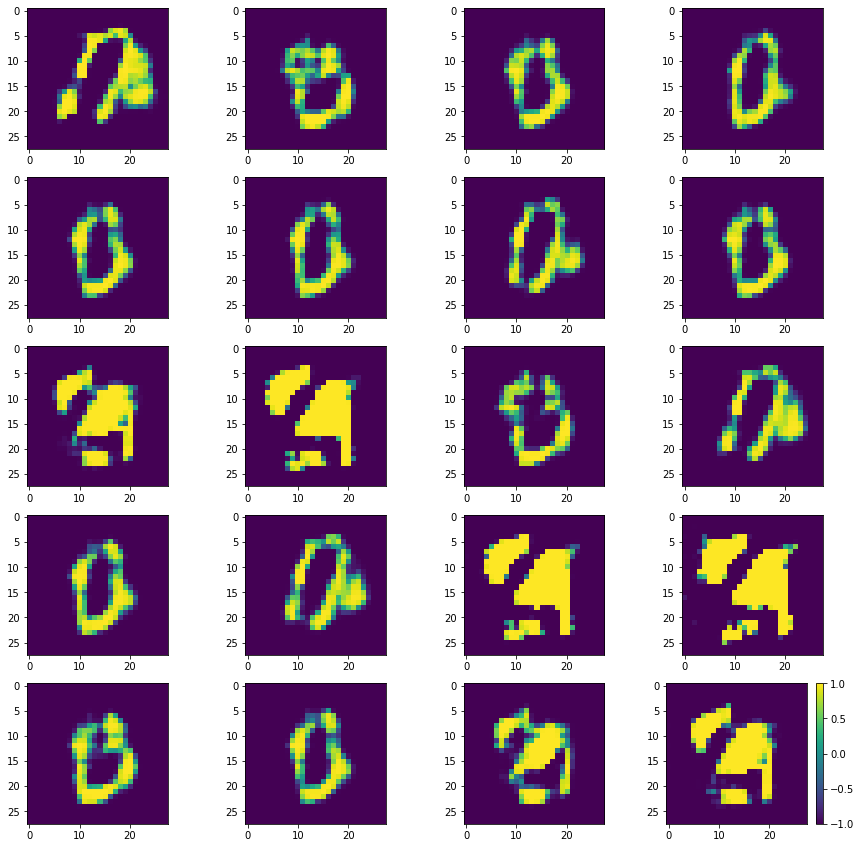

Batch_Num : 227
D_Loss   :   [9.314606666564941, 0.19137990474700928, 9.1232271194458, 0.48828125, 0.068359375] ;    GAN_Loss   :  [12.306733131408691, 1.8399124145507812, 10.46682071685791, 0.0, 0.08984375]
Batch_Num : 228
D_Loss   :   [10.422377586364746, 0.1944848895072937, 10.227892875671387, 0.486328125, 0.0703125] ;    GAN_Loss   :  [12.195882797241211, 1.5447349548339844, 10.651147842407227, 0.0, 0.064453125]
Batch_Num : 229
D_Loss   :   [9.842884063720703, 0.19051627814769745, 9.65236759185791, 0.4921875, 0.08203125] ;    GAN_Loss   :  [12.395122528076172, 1.8930325508117676, 10.502090454101562, 0.0, 0.05859375]
Batch_Num : 230
D_Loss   :   [10.142477989196777, 0.1738637238740921, 9.96861457824707, 0.49609375, 0.0859375] ;    GAN_Loss   :  [12.389041900634766, 1.912732481956482, 10.476309776306152, 0.0, 0.060546875]
Batch_Num : 231
D_Loss   :   [10.366891860961914, 0.15775983035564423, 10.209132194519043, 0.49609375, 0.099609375] ;    GAN_Loss   :  [12.041224479675293, 1.658795

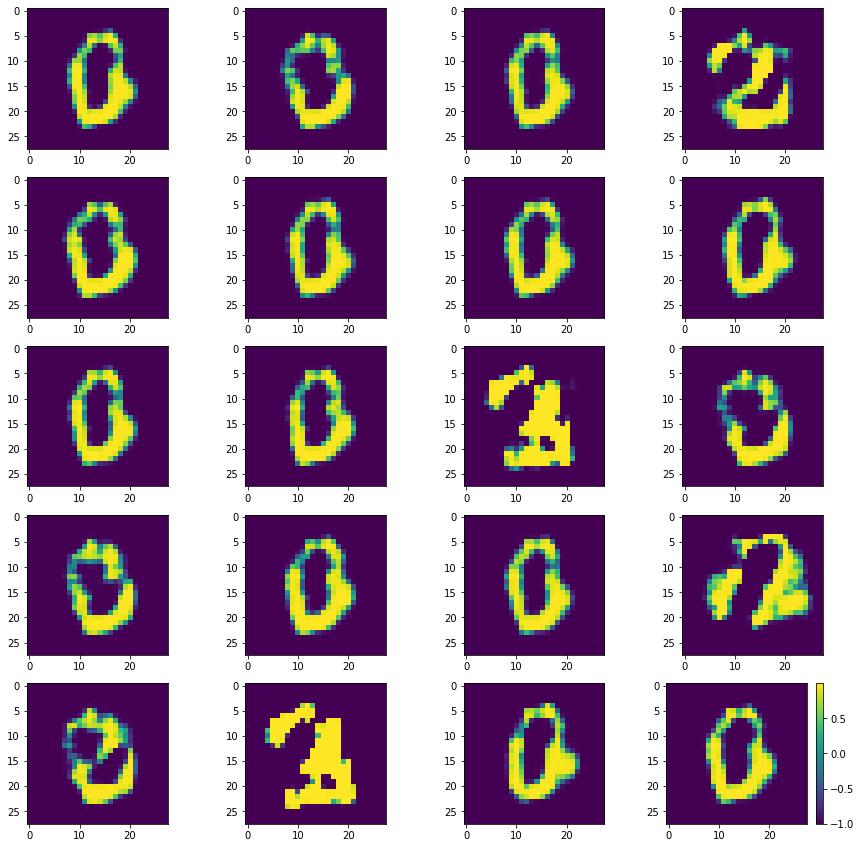

Batch_Num : 2
D_Loss   :   [10.195399284362793, 0.19779789447784424, 9.997601509094238, 0.5, 0.087890625] ;    GAN_Loss   :  [13.230619430541992, 2.5177271366119385, 10.712892532348633, 0.0, 0.0703125]
Batch_Num : 3
D_Loss   :   [10.220922470092773, 0.18696385622024536, 10.033958435058594, 0.498046875, 0.078125] ;    GAN_Loss   :  [12.24068832397461, 1.7969437837600708, 10.443744659423828, 0.0, 0.0625]
Batch_Num : 4
D_Loss   :   [10.390295028686523, 0.18706423044204712, 10.203230857849121, 0.4921875, 0.072265625] ;    GAN_Loss   :  [11.819265365600586, 1.4925963878631592, 10.326668739318848, 0.0, 0.087890625]
Batch_Num : 5
D_Loss   :   [10.254480361938477, 0.20168717205524445, 10.052793502807617, 0.5, 0.0703125] ;    GAN_Loss   :  [11.446404457092285, 1.2898318767547607, 10.156572341918945, 0.0, 0.0859375]
Batch_Num : 6
D_Loss   :   [10.542136192321777, 0.19069531559944153, 10.3514404296875, 0.494140625, 0.08203125] ;    GAN_Loss   :  [11.601945877075195, 1.3077465295791626, 10.2941989

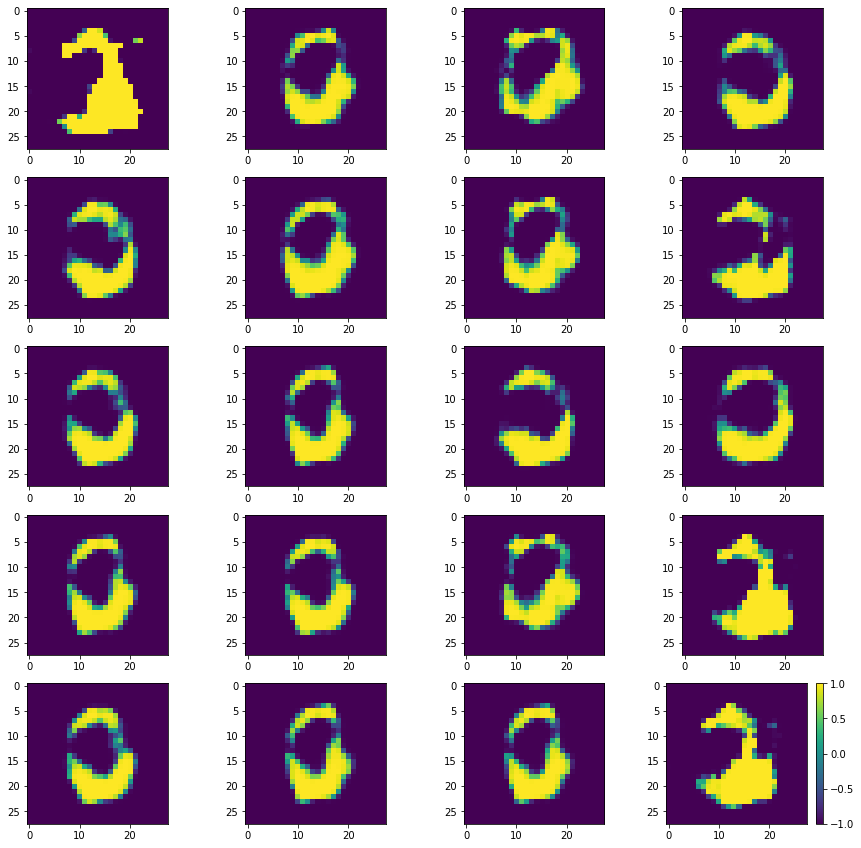

Batch_Num : 17
D_Loss   :   [9.818581581115723, 0.16708318889141083, 9.651498794555664, 0.494140625, 0.087890625] ;    GAN_Loss   :  [10.894586563110352, 1.1606948375701904, 9.733891487121582, 0.0, 0.091796875]
Batch_Num : 18
D_Loss   :   [9.97594165802002, 0.1699754297733307, 9.8059663772583, 0.5, 0.134765625] ;    GAN_Loss   :  [11.71218490600586, 1.038920521736145, 10.673264503479004, 0.0, 0.111328125]
Batch_Num : 19
D_Loss   :   [10.070905685424805, 0.19509157538414001, 9.875814437866211, 0.5, 0.087890625] ;    GAN_Loss   :  [10.949361801147461, 0.9952942132949829, 9.95406723022461, 0.0, 0.107421875]
Batch_Num : 20
D_Loss   :   [9.88895320892334, 0.1896982491016388, 9.699254989624023, 0.498046875, 0.09765625] ;    GAN_Loss   :  [11.652241706848145, 1.0903810262680054, 10.561861038208008, 0.0, 0.119140625]
Batch_Num : 21
D_Loss   :   [9.705466270446777, 0.16312864422798157, 9.542337417602539, 0.49609375, 0.107421875] ;    GAN_Loss   :  [11.35910415649414, 1.2329989671707153, 10.1261

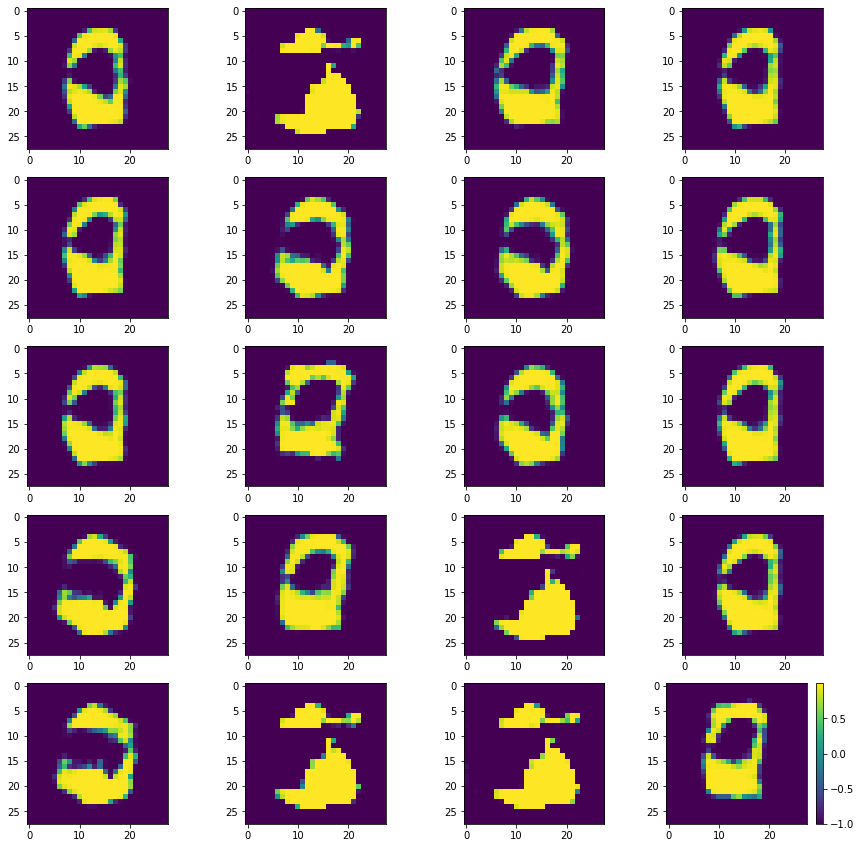

Batch_Num : 32
D_Loss   :   [9.763232231140137, 0.18714936077594757, 9.576083183288574, 0.49609375, 0.107421875] ;    GAN_Loss   :  [11.916954040527344, 1.5590240955352783, 10.357930183410645, 0.0, 0.15234375]
Batch_Num : 33
D_Loss   :   [10.324552536010742, 0.1615004539489746, 10.163052558898926, 0.5, 0.087890625] ;    GAN_Loss   :  [12.924422264099121, 2.04838490486145, 10.87603759765625, 0.0, 0.140625]
Batch_Num : 34
D_Loss   :   [10.423664093017578, 0.19992928206920624, 10.223734855651855, 0.5, 0.1171875] ;    GAN_Loss   :  [11.859950065612793, 1.9168001413345337, 9.94314956665039, 0.0, 0.123046875]
Batch_Num : 35
D_Loss   :   [9.611088752746582, 0.14738398790359497, 9.463705062866211, 0.5, 0.103515625] ;    GAN_Loss   :  [12.841835021972656, 2.257019519805908, 10.58481502532959, 0.0, 0.13671875]
Batch_Num : 36
D_Loss   :   [9.693184852600098, 0.15087822079658508, 9.542306900024414, 0.5, 0.09765625] ;    GAN_Loss   :  [13.643592834472656, 2.9140336513519287, 10.729558944702148, 0.0

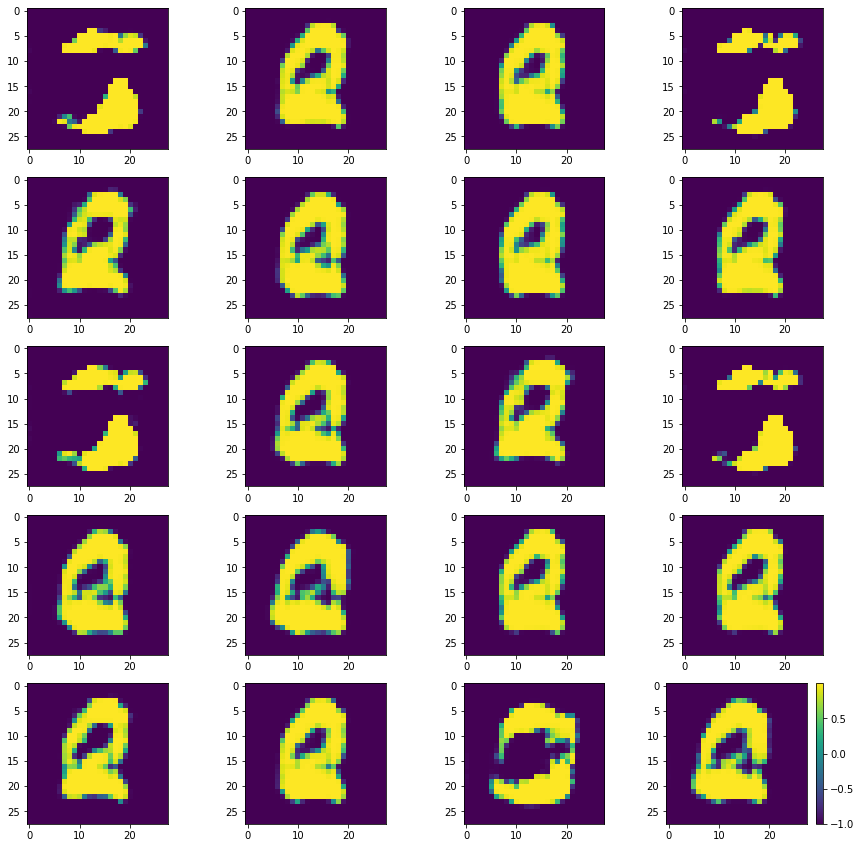

Batch_Num : 47
D_Loss   :   [10.67694091796875, 0.14521992206573486, 10.531721115112305, 0.5, 0.107421875] ;    GAN_Loss   :  [13.180667877197266, 3.041621685028076, 10.139045715332031, 0.0, 0.146484375]
Batch_Num : 48
D_Loss   :   [10.145306587219238, 0.16421012580394745, 9.981096267700195, 0.5, 0.10546875] ;    GAN_Loss   :  [13.96317195892334, 3.137350082397461, 10.825821876525879, 0.0, 0.173828125]
Batch_Num : 49
D_Loss   :   [10.055441856384277, 0.15139926970005035, 9.90404224395752, 0.498046875, 0.1015625] ;    GAN_Loss   :  [13.853686332702637, 2.8250505924224854, 11.02863597869873, 0.0, 0.12109375]
Batch_Num : 50
D_Loss   :   [9.806041717529297, 0.16961635649204254, 9.636425018310547, 0.5, 0.13671875] ;    GAN_Loss   :  [12.540127754211426, 2.221020460128784, 10.319107055664062, 0.0, 0.130859375]
Batch_Num : 51
D_Loss   :   [10.431539535522461, 0.1708911657333374, 10.260648727416992, 0.49609375, 0.12890625] ;    GAN_Loss   :  [11.890714645385742, 2.0179038047790527, 9.872810363

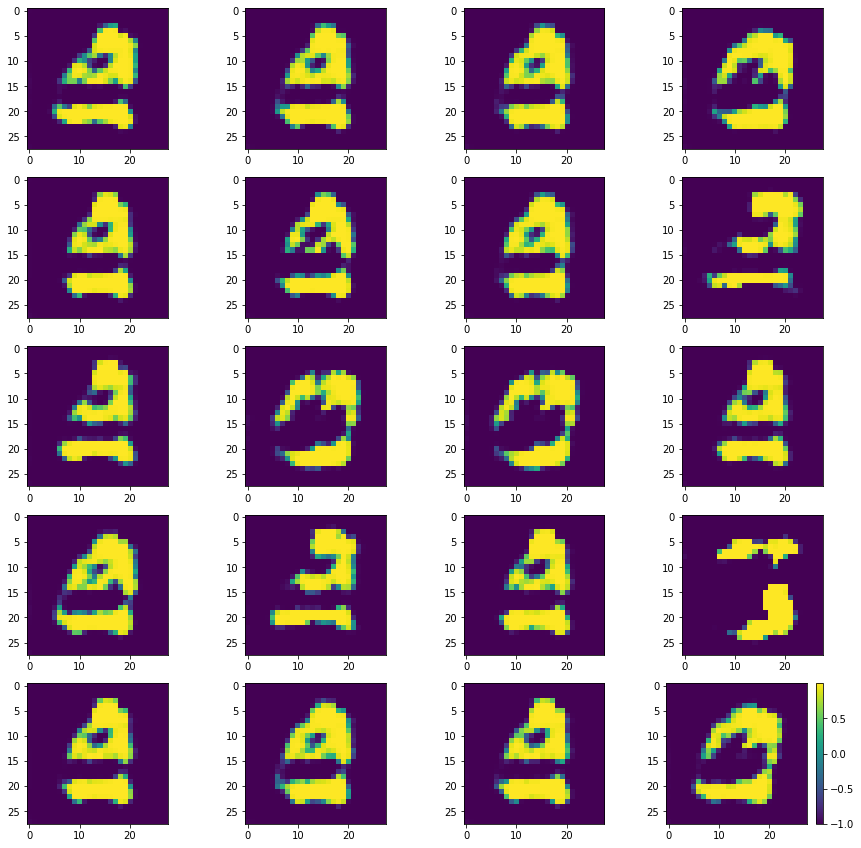

Batch_Num : 62
D_Loss   :   [9.781144142150879, 0.1528204381465912, 9.628323554992676, 0.5, 0.140625] ;    GAN_Loss   :  [11.367759704589844, 1.2413272857666016, 10.126432418823242, 0.0, 0.181640625]
Batch_Num : 63
D_Loss   :   [10.08210277557373, 0.19532261788845062, 9.88677978515625, 0.49609375, 0.119140625] ;    GAN_Loss   :  [11.906465530395508, 1.4016283750534058, 10.504837036132812, 0.0, 0.138671875]
Batch_Num : 64
D_Loss   :   [10.035505294799805, 0.1635337620973587, 9.871971130371094, 0.498046875, 0.115234375] ;    GAN_Loss   :  [11.821008682250977, 1.4315176010131836, 10.389491081237793, 0.0, 0.146484375]
Batch_Num : 65
D_Loss   :   [10.156455039978027, 0.14874319732189178, 10.007711410522461, 0.5, 0.140625] ;    GAN_Loss   :  [11.633245468139648, 1.240464210510254, 10.392781257629395, 0.0, 0.17578125]
Batch_Num : 66
D_Loss   :   [10.809074401855469, 0.1687454879283905, 10.640329360961914, 0.498046875, 0.111328125] ;    GAN_Loss   :  [12.261900901794434, 1.435286521911621, 10.

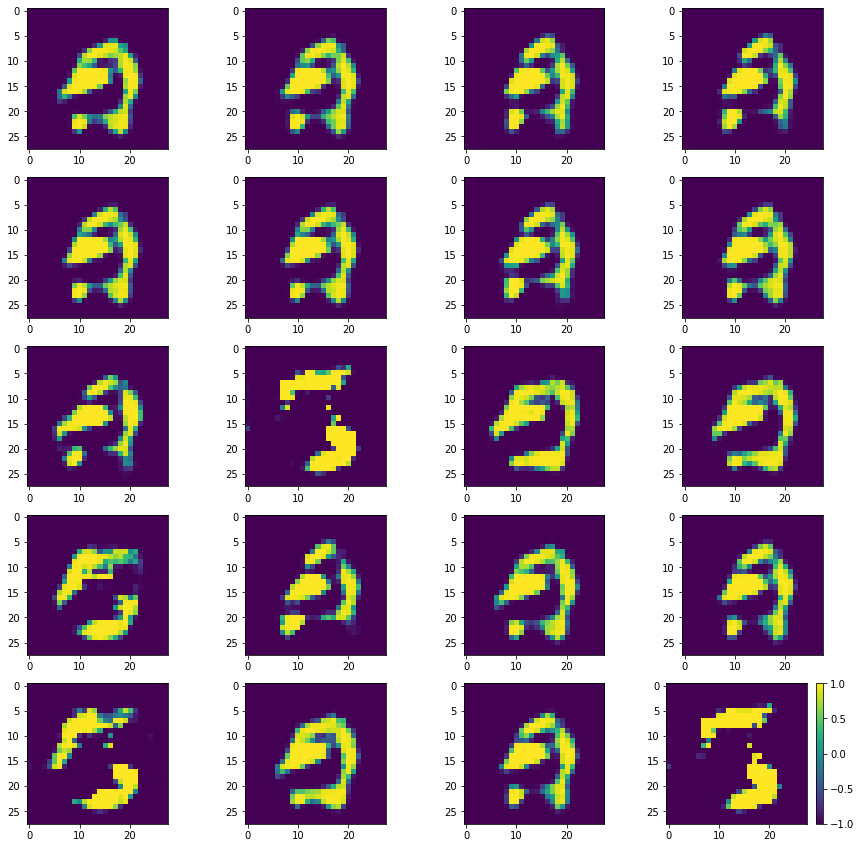

Batch_Num : 77
D_Loss   :   [10.161351203918457, 0.25074586272239685, 9.910605430603027, 0.48828125, 0.10546875] ;    GAN_Loss   :  [16.265544891357422, 5.447186470031738, 10.818358421325684, 0.0, 0.1171875]
Batch_Num : 78
D_Loss   :   [9.738273620605469, 0.17539429664611816, 9.56287956237793, 0.49609375, 0.125] ;    GAN_Loss   :  [18.349445343017578, 7.756278991699219, 10.59316635131836, 0.0, 0.1015625]
Batch_Num : 79
D_Loss   :   [10.516467094421387, 0.16952642798423767, 10.346940994262695, 0.498046875, 0.119140625] ;    GAN_Loss   :  [18.165510177612305, 7.857178688049316, 10.308331489562988, 0.0, 0.087890625]
Batch_Num : 80
D_Loss   :   [10.074405670166016, 0.19055429100990295, 9.883851051330566, 0.4921875, 0.142578125] ;    GAN_Loss   :  [17.135103225708008, 7.167385578155518, 9.967717170715332, 0.0, 0.095703125]
Batch_Num : 81
D_Loss   :   [10.344817161560059, 0.21680061519145966, 10.128016471862793, 0.486328125, 0.087890625] ;    GAN_Loss   :  [16.80008316040039, 6.3599348068237

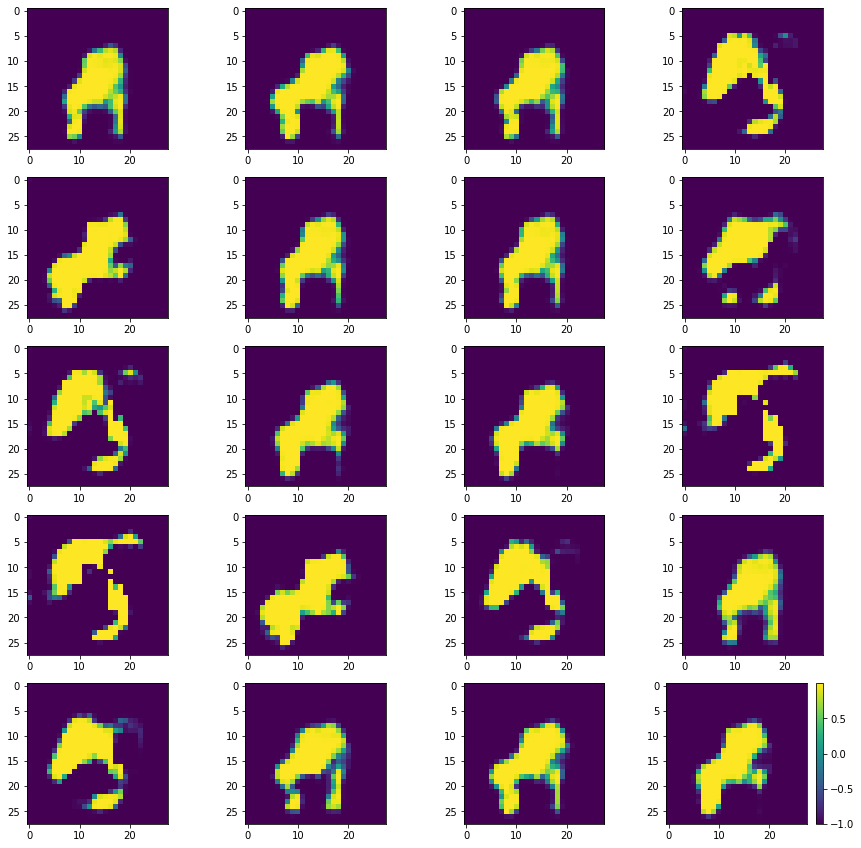

Batch_Num : 92
D_Loss   :   [10.160745620727539, 0.1463087648153305, 10.014436721801758, 0.5, 0.119140625] ;    GAN_Loss   :  [15.405497550964355, 4.597938537597656, 10.8075590133667, 0.0, 0.142578125]
Batch_Num : 93
D_Loss   :   [10.624350547790527, 0.15966501832008362, 10.464685440063477, 0.5, 0.109375] ;    GAN_Loss   :  [14.919243812561035, 4.222312927246094, 10.696930885314941, 0.0, 0.158203125]
Batch_Num : 94
D_Loss   :   [10.048209190368652, 0.17395484447479248, 9.87425422668457, 0.498046875, 0.091796875] ;    GAN_Loss   :  [14.76620101928711, 4.028098106384277, 10.738102912902832, 0.0, 0.1328125]
Batch_Num : 95
D_Loss   :   [10.229918479919434, 0.18086254596710205, 10.049056053161621, 0.486328125, 0.103515625] ;    GAN_Loss   :  [13.653389930725098, 3.482905387878418, 10.17048454284668, 0.0, 0.123046875]
Batch_Num : 96
D_Loss   :   [9.792399406433105, 0.18565334379673004, 9.606745719909668, 0.484375, 0.09765625] ;    GAN_Loss   :  [13.83896255493164, 3.403911590576172, 10.43505

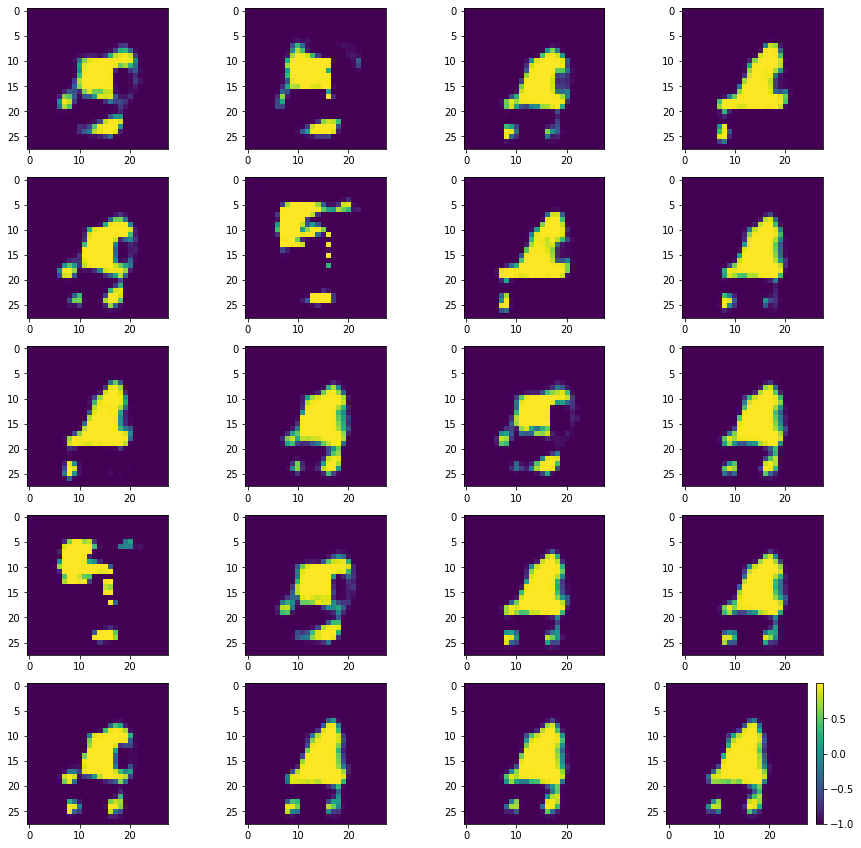

Batch_Num : 107
D_Loss   :   [10.034913063049316, 0.15935158729553223, 9.875561714172363, 0.494140625, 0.09375] ;    GAN_Loss   :  [14.792459487915039, 4.132667064666748, 10.65979290008545, 0.0, 0.154296875]
Batch_Num : 108
D_Loss   :   [9.473501205444336, 0.16987404227256775, 9.303627014160156, 0.49609375, 0.109375] ;    GAN_Loss   :  [14.72408676147461, 4.330053806304932, 10.394033432006836, 0.0, 0.150390625]
Batch_Num : 109
D_Loss   :   [9.695769309997559, 0.1711689531803131, 9.5246000289917, 0.5, 0.109375] ;    GAN_Loss   :  [14.956107139587402, 4.395510673522949, 10.560596466064453, 0.0, 0.1171875]
Batch_Num : 110
D_Loss   :   [10.377874374389648, 0.15786510705947876, 10.220008850097656, 0.498046875, 0.111328125] ;    GAN_Loss   :  [14.9144868850708, 4.555582046508789, 10.358904838562012, 0.0, 0.142578125]
Batch_Num : 111
D_Loss   :   [9.585458755493164, 0.18686185777187347, 9.39859676361084, 0.498046875, 0.099609375] ;    GAN_Loss   :  [15.227045059204102, 5.190370559692383, 10.0

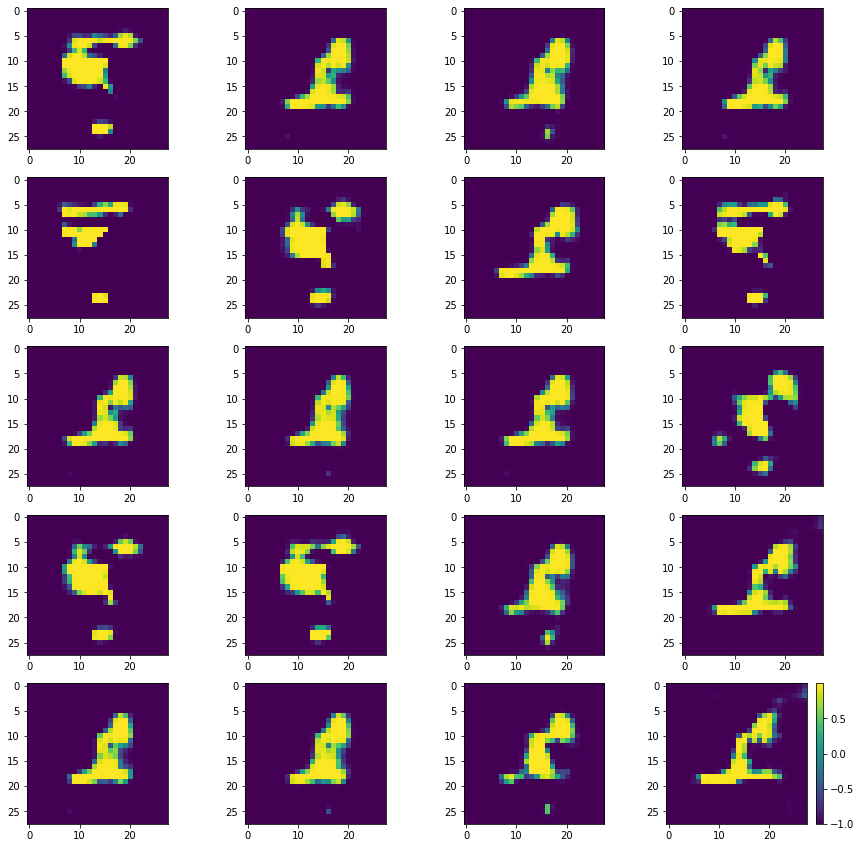

Batch_Num : 122
D_Loss   :   [10.578302383422852, 0.17504140734672546, 10.403261184692383, 0.5, 0.0859375] ;    GAN_Loss   :  [14.98609733581543, 4.505975246429443, 10.480121612548828, 0.0, 0.142578125]
Batch_Num : 123
D_Loss   :   [9.975897789001465, 0.19643634557724, 9.779461860656738, 0.5, 0.126953125] ;    GAN_Loss   :  [16.06166648864746, 5.3733625411987305, 10.68830394744873, 0.0, 0.12890625]
Batch_Num : 124
D_Loss   :   [10.294726371765137, 0.17238135635852814, 10.122344970703125, 0.5, 0.126953125] ;    GAN_Loss   :  [15.51256275177002, 5.178199768066406, 10.334362983703613, 0.0, 0.154296875]
Batch_Num : 125
D_Loss   :   [10.479283332824707, 0.17126409709453583, 10.308019638061523, 0.5, 0.111328125] ;    GAN_Loss   :  [17.394283294677734, 6.68465518951416, 10.70962905883789, 0.0, 0.1328125]
Batch_Num : 126
D_Loss   :   [10.427315711975098, 0.17940197885036469, 10.247913360595703, 0.498046875, 0.11328125] ;    GAN_Loss   :  [16.973791122436523, 6.394777297973633, 10.5790138244628

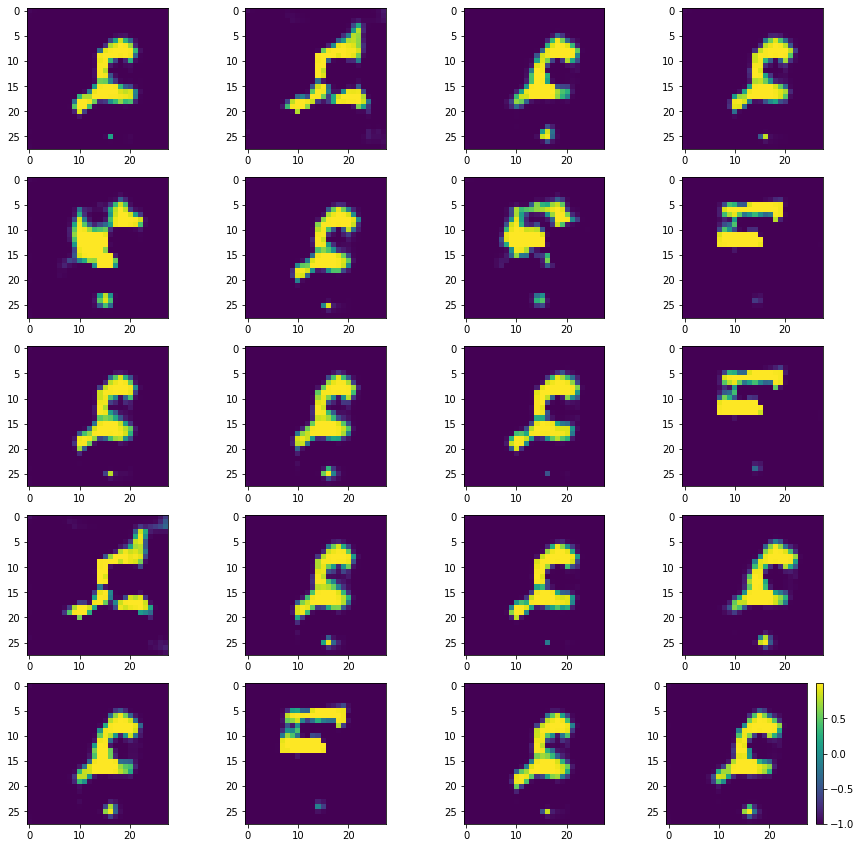

Batch_Num : 137
D_Loss   :   [10.809135437011719, 0.186369389295578, 10.622766494750977, 0.494140625, 0.099609375] ;    GAN_Loss   :  [16.161495208740234, 5.83543586730957, 10.326059341430664, 0.0, 0.12109375]
Batch_Num : 138
D_Loss   :   [10.060632705688477, 0.1667744219303131, 9.893857955932617, 0.498046875, 0.11328125] ;    GAN_Loss   :  [16.443212509155273, 5.563614368438721, 10.879597663879395, 0.0, 0.123046875]
Batch_Num : 139
D_Loss   :   [9.98372745513916, 0.1708538830280304, 9.812873840332031, 0.5, 0.140625] ;    GAN_Loss   :  [16.14777183532715, 5.669374942779541, 10.478397369384766, 0.0, 0.107421875]
Batch_Num : 140
D_Loss   :   [9.548977851867676, 0.15299247205257416, 9.39598560333252, 0.498046875, 0.107421875] ;    GAN_Loss   :  [15.977133750915527, 5.807355880737305, 10.169777870178223, 0.0, 0.12890625]
Batch_Num : 141
D_Loss   :   [10.136261940002441, 0.15829475224018097, 9.977967262268066, 0.498046875, 0.125] ;    GAN_Loss   :  [15.856853485107422, 5.564778804779053, 10

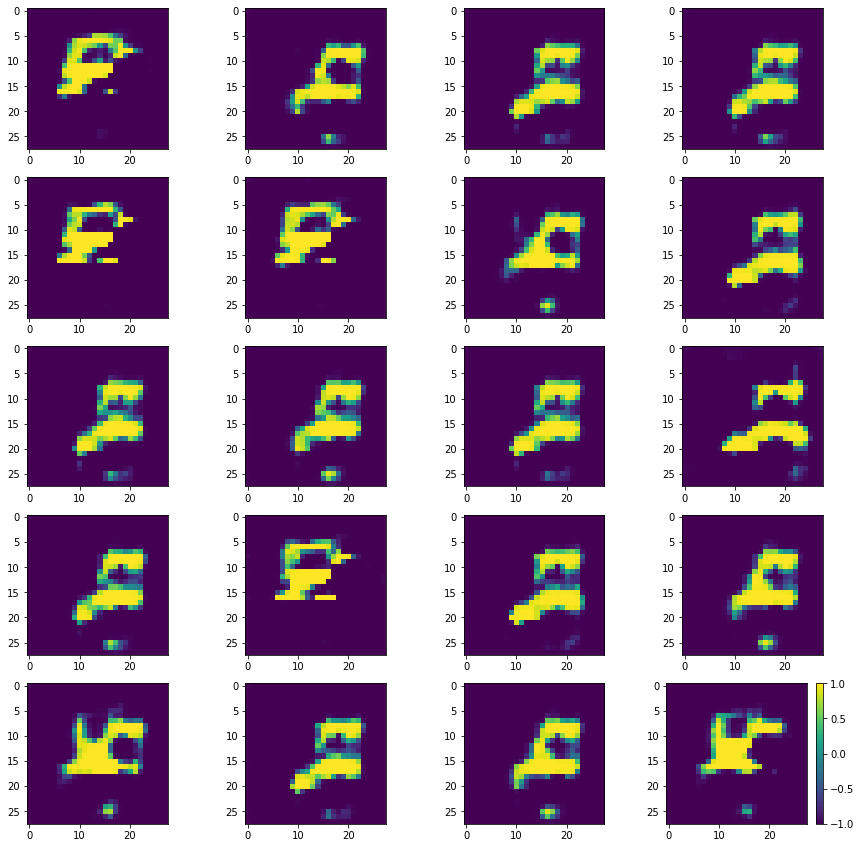

Batch_Num : 152
D_Loss   :   [9.816001892089844, 0.14473992586135864, 9.67126178741455, 0.5, 0.09765625] ;    GAN_Loss   :  [15.806740760803223, 5.217792510986328, 10.588948249816895, 0.0, 0.138671875]
Batch_Num : 153
D_Loss   :   [10.072491645812988, 0.14320014417171478, 9.929291725158691, 0.498046875, 0.119140625] ;    GAN_Loss   :  [15.18087387084961, 4.928629398345947, 10.252243995666504, 0.0, 0.123046875]
Batch_Num : 154
D_Loss   :   [10.060035705566406, 0.1657828390598297, 9.89425277709961, 0.5, 0.099609375] ;    GAN_Loss   :  [15.47991943359375, 5.023897171020508, 10.456022262573242, 0.0, 0.11328125]
Batch_Num : 155
D_Loss   :   [10.433759689331055, 0.18041396141052246, 10.253345489501953, 0.5, 0.095703125] ;    GAN_Loss   :  [15.57149887084961, 5.171004295349121, 10.400494575500488, 0.0, 0.1171875]
Batch_Num : 156
D_Loss   :   [9.51845645904541, 0.14864188432693481, 9.3698148727417, 0.5, 0.109375] ;    GAN_Loss   :  [15.641019821166992, 4.900315761566162, 10.740703582763672, 0.

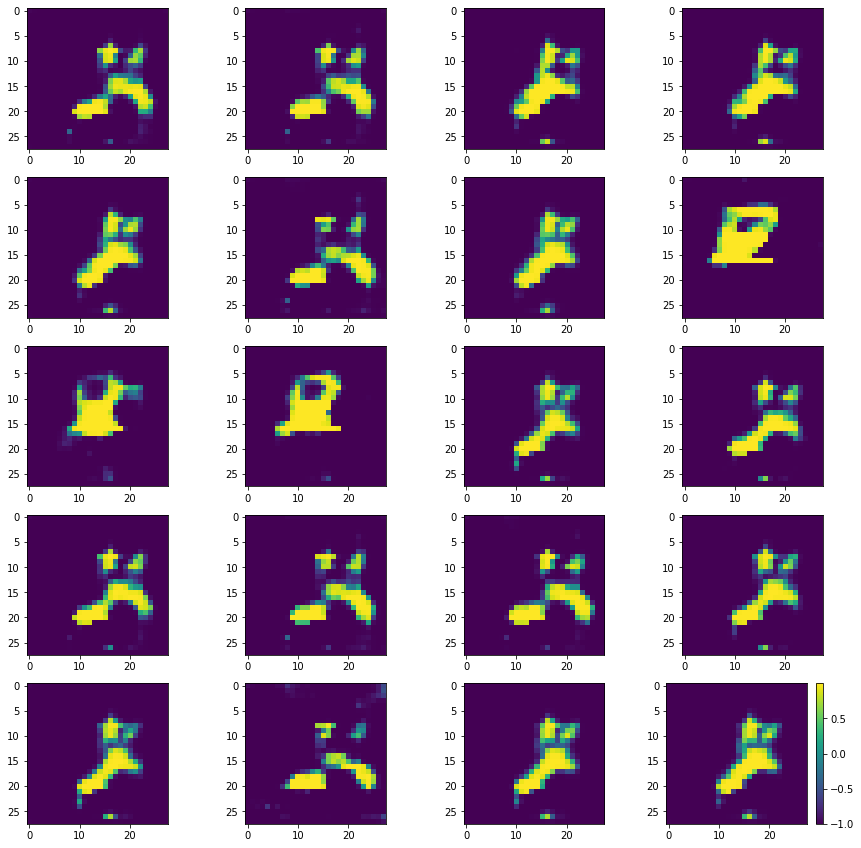

Batch_Num : 167
D_Loss   :   [10.556962013244629, 0.16725236177444458, 10.38970947265625, 0.5, 0.10546875] ;    GAN_Loss   :  [14.558063507080078, 4.496471881866455, 10.061591148376465, 0.0, 0.1015625]
Batch_Num : 168
D_Loss   :   [9.584162712097168, 0.15148024260997772, 9.432682037353516, 0.5, 0.08203125] ;    GAN_Loss   :  [15.374908447265625, 4.7304205894470215, 10.644488334655762, 0.0, 0.138671875]
Batch_Num : 169
D_Loss   :   [10.10694694519043, 0.16403935849666595, 9.942907333374023, 0.5, 0.0859375] ;    GAN_Loss   :  [15.960692405700684, 5.36251163482666, 10.598180770874023, 0.0, 0.140625]
Batch_Num : 170
D_Loss   :   [10.0637788772583, 0.13838326930999756, 9.925395965576172, 0.5, 0.078125] ;    GAN_Loss   :  [15.905658721923828, 5.394518852233887, 10.511139869689941, 0.0, 0.12890625]
Batch_Num : 171
D_Loss   :   [10.424886703491211, 0.15285904705524445, 10.272027969360352, 0.5, 0.099609375] ;    GAN_Loss   :  [16.175518035888672, 5.42345666885376, 10.752060890197754, 0.0, 0.119

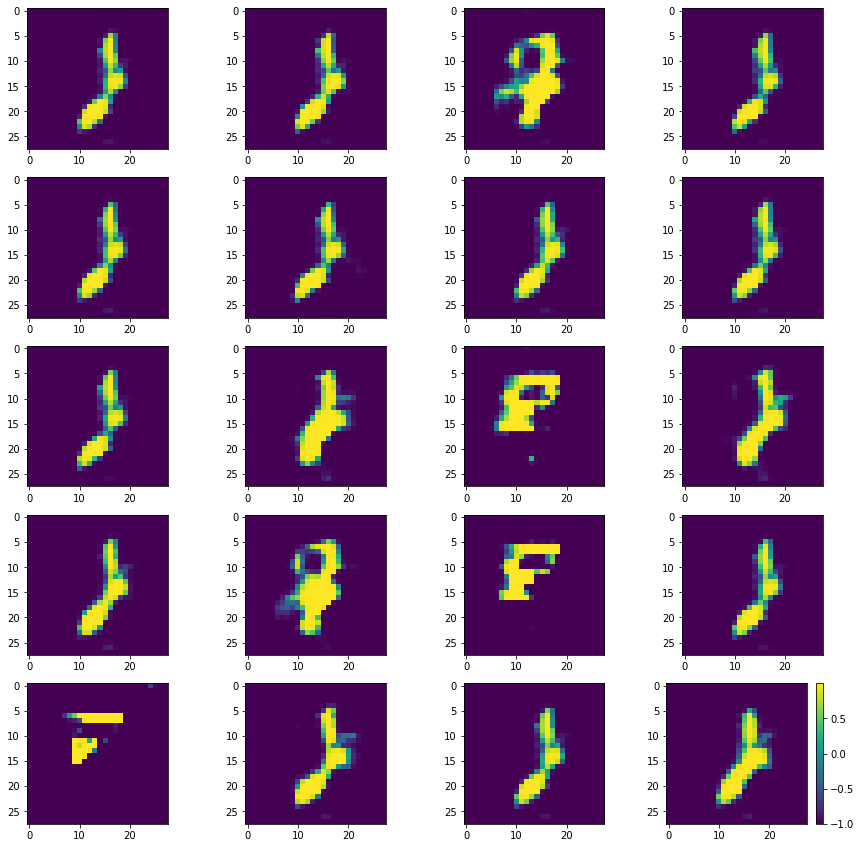

Batch_Num : 182
D_Loss   :   [9.756193161010742, 0.18183161318302155, 9.574361801147461, 0.498046875, 0.10546875] ;    GAN_Loss   :  [15.298852920532227, 5.4276204109191895, 9.871232986450195, 0.0, 0.109375]
Batch_Num : 183
D_Loss   :   [10.39417552947998, 0.16858746111392975, 10.225587844848633, 0.490234375, 0.109375] ;    GAN_Loss   :  [15.522489547729492, 5.532311916351318, 9.990177154541016, 0.0, 0.12109375]
Batch_Num : 184
D_Loss   :   [9.90141773223877, 0.19589689373970032, 9.705520629882812, 0.49609375, 0.107421875] ;    GAN_Loss   :  [15.954154968261719, 5.408185958862305, 10.545969009399414, 0.0, 0.130859375]
Batch_Num : 185
D_Loss   :   [9.97120475769043, 0.18967540562152863, 9.781529426574707, 0.494140625, 0.10546875] ;    GAN_Loss   :  [15.263315200805664, 5.139919757843018, 10.123394966125488, 0.0, 0.12109375]
Batch_Num : 186
D_Loss   :   [9.57882022857666, 0.2061370462179184, 9.37268352508545, 0.5, 0.087890625] ;    GAN_Loss   :  [16.011764526367188, 5.622493267059326, 10

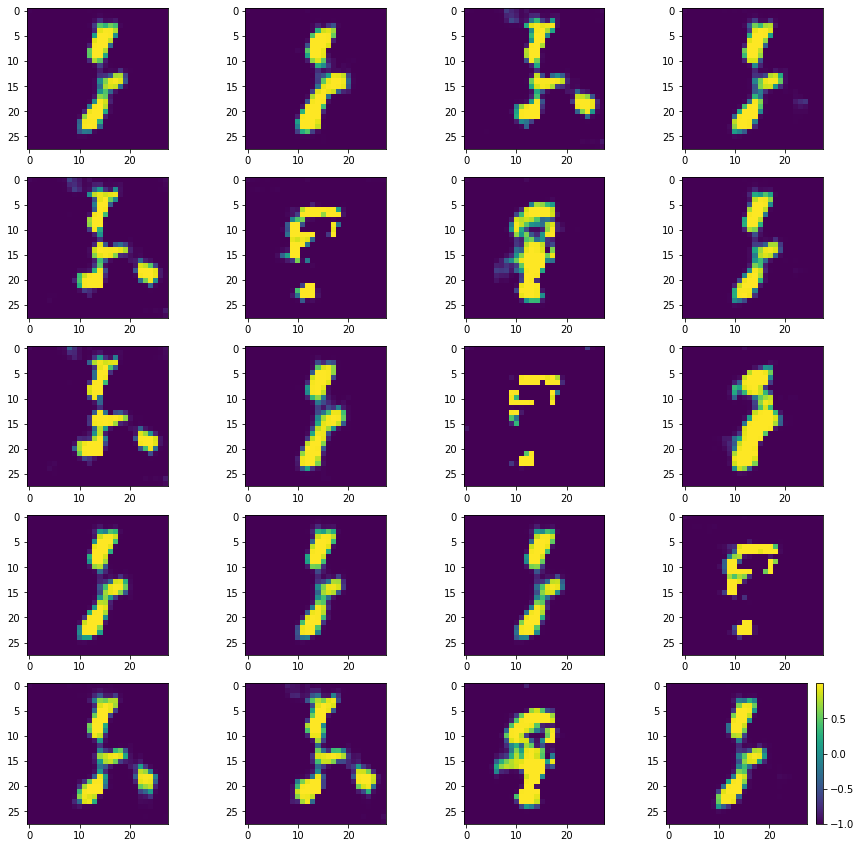

Batch_Num : 197
D_Loss   :   [10.000404357910156, 0.16854332387447357, 9.83186149597168, 0.49609375, 0.10546875] ;    GAN_Loss   :  [14.141477584838867, 3.919238805770874, 10.222238540649414, 0.0, 0.078125]
Batch_Num : 198
D_Loss   :   [9.705695152282715, 0.16378191113471985, 9.541913032531738, 0.498046875, 0.1171875] ;    GAN_Loss   :  [14.15761661529541, 3.85371470451355, 10.303901672363281, 0.0, 0.1328125]
Batch_Num : 199
D_Loss   :   [10.589640617370605, 0.15777568519115448, 10.431864738464355, 0.5, 0.119140625] ;    GAN_Loss   :  [14.364194869995117, 4.106534957885742, 10.257659912109375, 0.0, 0.1328125]
Batch_Num : 200
D_Loss   :   [10.200922966003418, 0.18620052933692932, 10.01472282409668, 0.5, 0.12109375] ;    GAN_Loss   :  [15.691020965576172, 5.0431013107299805, 10.647919654846191, 0.0, 0.125]
Batch_Num : 201
D_Loss   :   [10.413572311401367, 0.16815949976444244, 10.245412826538086, 0.5, 0.119140625] ;    GAN_Loss   :  [16.23672103881836, 6.069493770599365, 10.16722679138183

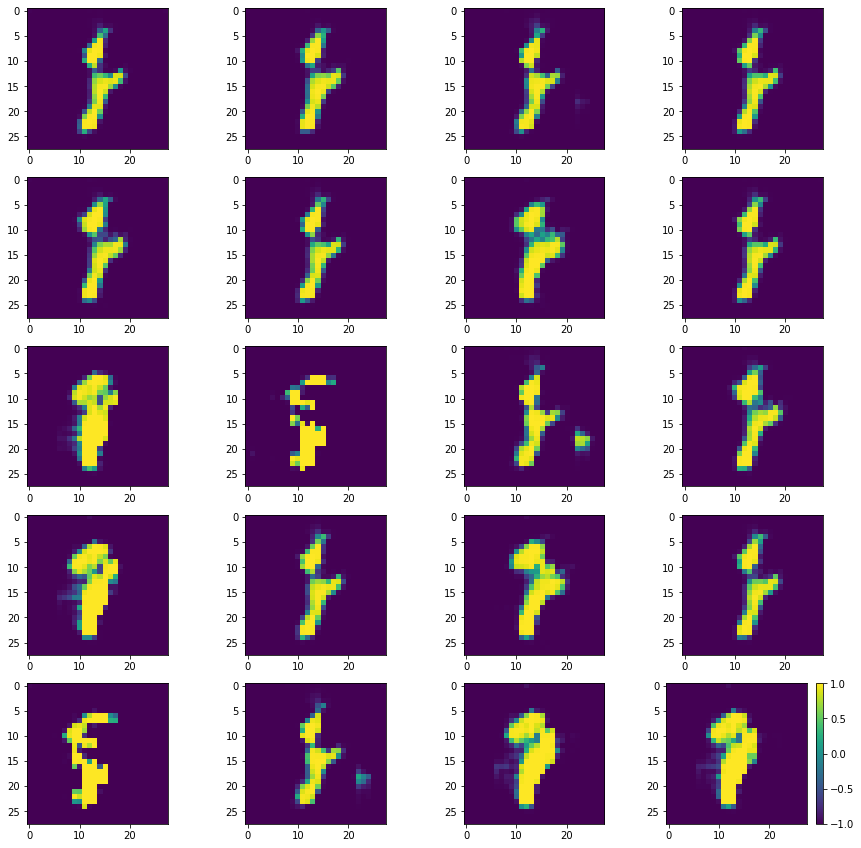

Batch_Num : 212
D_Loss   :   [10.948230743408203, 0.1716788411140442, 10.776552200317383, 0.498046875, 0.12890625] ;    GAN_Loss   :  [15.101552963256836, 5.025440692901611, 10.076112747192383, 0.0, 0.1015625]
Batch_Num : 213
D_Loss   :   [9.63604736328125, 0.17304730415344238, 9.463000297546387, 0.5, 0.111328125] ;    GAN_Loss   :  [15.53486156463623, 5.051043510437012, 10.483818054199219, 0.0, 0.107421875]
Batch_Num : 214
D_Loss   :   [10.441444396972656, 0.21595217287540436, 10.225492477416992, 0.5, 0.109375] ;    GAN_Loss   :  [15.568876266479492, 4.9878458976745605, 10.581029891967773, 0.0, 0.125]
Batch_Num : 215
D_Loss   :   [9.258463859558105, 0.1812499761581421, 9.077214241027832, 0.494140625, 0.08984375] ;    GAN_Loss   :  [15.416537284851074, 5.152552604675293, 10.263984680175781, 0.0, 0.115234375]
Batch_Num : 216
D_Loss   :   [10.451236724853516, 0.17325352132320404, 10.277983665466309, 0.498046875, 0.1171875] ;    GAN_Loss   :  [15.85965347290039, 5.6544270515441895, 10.205

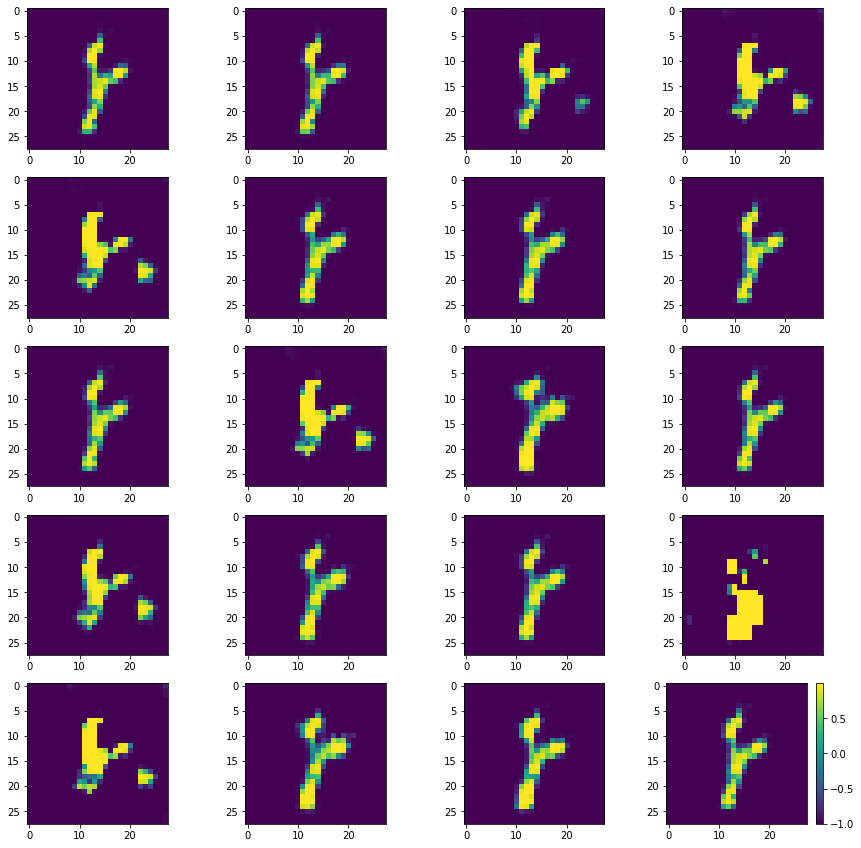

Batch_Num : 227
D_Loss   :   [9.265531539916992, 0.14732971787452698, 9.118202209472656, 0.5, 0.099609375] ;    GAN_Loss   :  [14.756730079650879, 4.862796783447266, 9.893933296203613, 0.0, 0.138671875]
Batch_Num : 228
D_Loss   :   [10.372815132141113, 0.14630162715911865, 10.226513862609863, 0.5, 0.12109375] ;    GAN_Loss   :  [15.480026245117188, 4.710856914520264, 10.769169807434082, 0.0, 0.115234375]
Batch_Num : 229
D_Loss   :   [9.804607391357422, 0.16035933792591095, 9.644248008728027, 0.5, 0.095703125] ;    GAN_Loss   :  [15.015604019165039, 4.696210861206055, 10.319393157958984, 0.0, 0.12109375]
Batch_Num : 230
D_Loss   :   [10.10590934753418, 0.13813751935958862, 9.967771530151367, 0.5, 0.099609375] ;    GAN_Loss   :  [14.47547721862793, 4.471904754638672, 10.003572463989258, 0.0, 0.123046875]
Batch_Num : 231
D_Loss   :   [10.359353065490723, 0.15129704773426056, 10.208056449890137, 0.5, 0.087890625] ;    GAN_Loss   :  [15.148110389709473, 4.603139877319336, 10.544970512390137

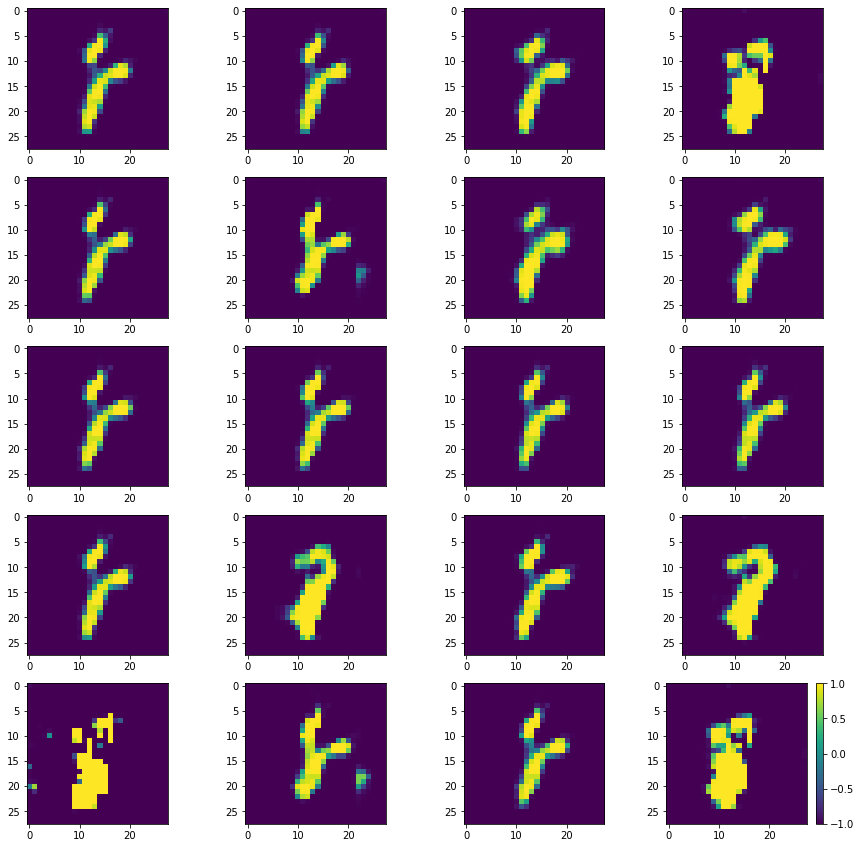

Batch_Num : 2
D_Loss   :   [10.1401948928833, 0.14428327977657318, 9.995911598205566, 0.5, 0.1328125] ;    GAN_Loss   :  [18.060791015625, 7.450189113616943, 10.610601425170898, 0.0, 0.09765625]
Batch_Num : 3
D_Loss   :   [10.174582481384277, 0.14677950739860535, 10.027803421020508, 0.5, 0.095703125] ;    GAN_Loss   :  [16.898534774780273, 6.257026195526123, 10.641509056091309, 0.0, 0.103515625]
Batch_Num : 4
D_Loss   :   [10.36316967010498, 0.16184884309768677, 10.20132064819336, 0.5, 0.109375] ;    GAN_Loss   :  [16.36004638671875, 5.980438232421875, 10.379609107971191, 0.0, 0.10546875]
Batch_Num : 5
D_Loss   :   [10.215563774108887, 0.17033705115318298, 10.04522705078125, 0.5, 0.09375] ;    GAN_Loss   :  [15.605566024780273, 5.57092809677124, 10.034638404846191, 0.0, 0.111328125]
Batch_Num : 6
D_Loss   :   [10.521440505981445, 0.1748996376991272, 10.346540451049805, 0.498046875, 0.099609375] ;    GAN_Loss   :  [16.624601364135742, 5.98399543762207, 10.640605926513672, 0.0, 0.1074218

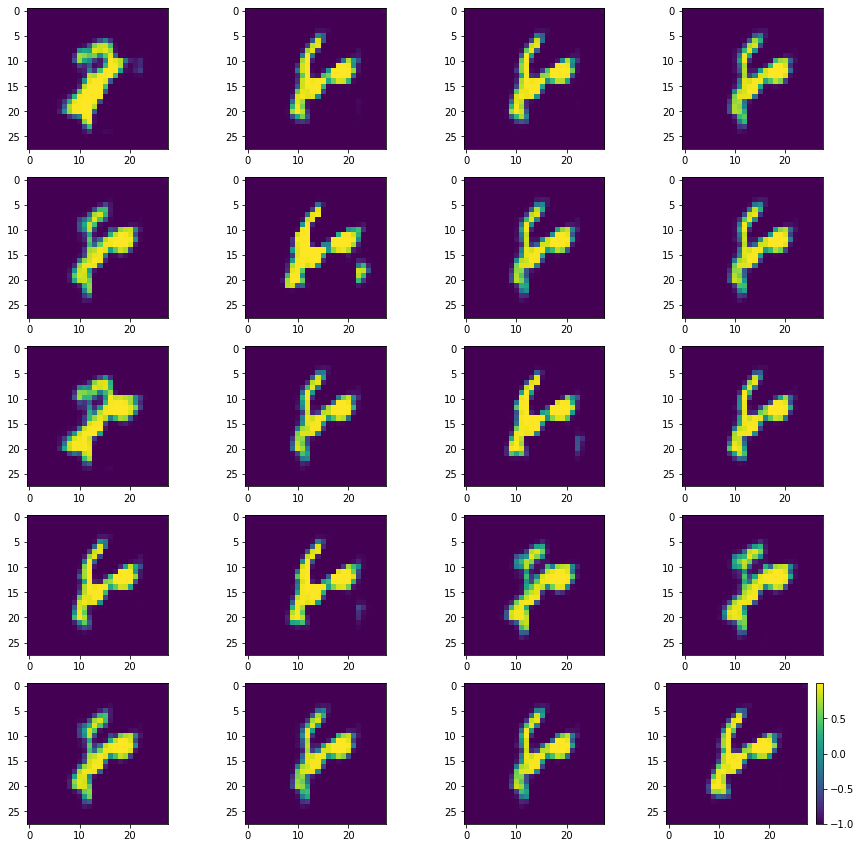

Batch_Num : 17
D_Loss   :   [9.803590774536133, 0.1533547043800354, 9.650236129760742, 0.5, 0.099609375] ;    GAN_Loss   :  [15.461618423461914, 5.088528156280518, 10.373090744018555, 0.0, 0.12109375]
Batch_Num : 18
D_Loss   :   [9.93496036529541, 0.1377500593662262, 9.797210693359375, 0.5, 0.119140625] ;    GAN_Loss   :  [14.990331649780273, 4.954845905303955, 10.03548526763916, 0.0, 0.119140625]
Batch_Num : 19
D_Loss   :   [10.021933555603027, 0.15460556745529175, 9.867327690124512, 0.5, 0.103515625] ;    GAN_Loss   :  [15.05539321899414, 4.936054229736328, 10.119338989257812, 0.0, 0.119140625]
Batch_Num : 20
D_Loss   :   [9.844297409057617, 0.15075699985027313, 9.693540573120117, 0.49609375, 0.1171875] ;    GAN_Loss   :  [15.10116195678711, 4.788807392120361, 10.312355041503906, 0.0, 0.134765625]
Batch_Num : 21
D_Loss   :   [9.71241569519043, 0.17240750789642334, 9.540008544921875, 0.4921875, 0.111328125] ;    GAN_Loss   :  [15.135011672973633, 4.959157943725586, 10.175853729248047,

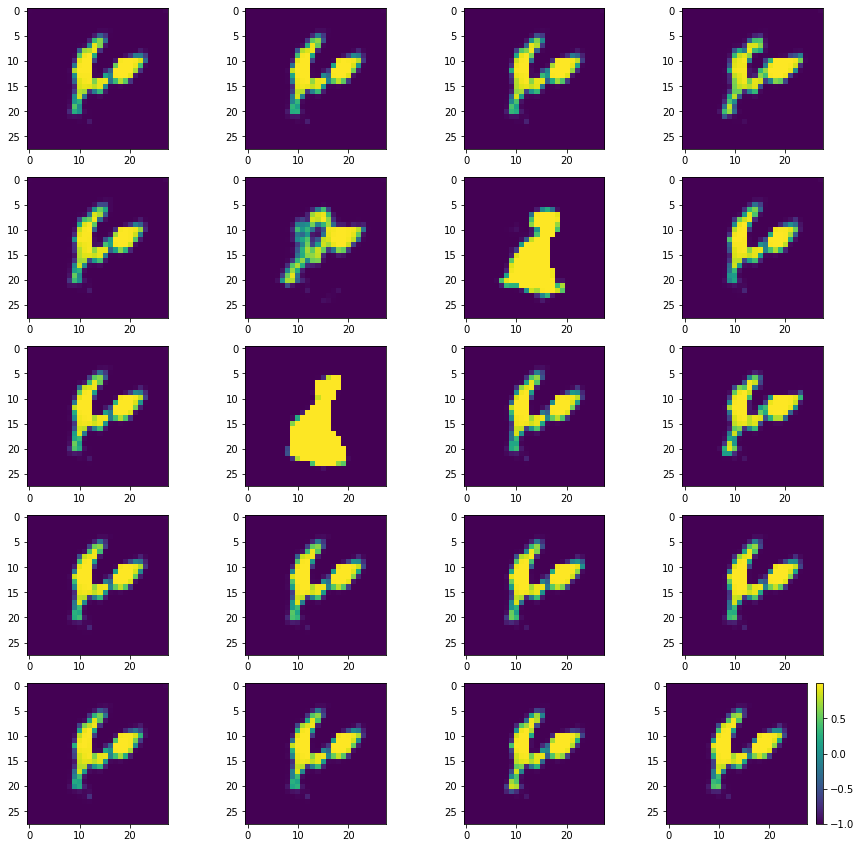

Batch_Num : 32
D_Loss   :   [9.729506492614746, 0.1638849675655365, 9.565621376037598, 0.498046875, 0.10546875] ;    GAN_Loss   :  [13.116142272949219, 2.9444446563720703, 10.171697616577148, 0.0, 0.1171875]
Batch_Num : 33
D_Loss   :   [10.323027610778809, 0.16644850373268127, 10.15657901763916, 0.5, 0.103515625] ;    GAN_Loss   :  [12.839635848999023, 2.864837646484375, 9.974798202514648, 0.0, 0.119140625]
Batch_Num : 34
D_Loss   :   [10.394675254821777, 0.1819922775030136, 10.212682723999023, 0.5, 0.09375] ;    GAN_Loss   :  [13.267962455749512, 3.573610305786133, 9.694352149963379, 0.0, 0.09765625]
Batch_Num : 35
D_Loss   :   [9.608445167541504, 0.14516869187355042, 9.463276863098145, 0.5, 0.083984375] ;    GAN_Loss   :  [13.64456558227539, 3.595508098602295, 10.049057006835938, 0.0, 0.11328125]
Batch_Num : 36
D_Loss   :   [9.680705070495605, 0.14178264141082764, 9.538922309875488, 0.498046875, 0.109375] ;    GAN_Loss   :  [13.757394790649414, 3.7534894943237305, 10.003905296325684,

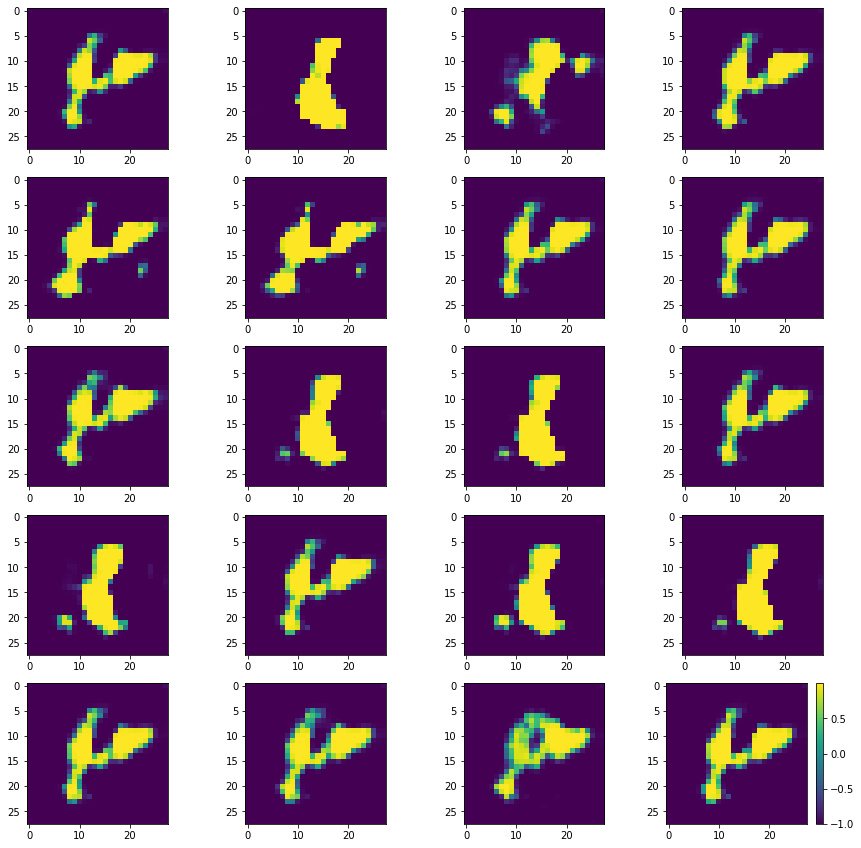

Batch_Num : 47
D_Loss   :   [10.681888580322266, 0.1543288230895996, 10.527560234069824, 0.5, 0.10546875] ;    GAN_Loss   :  [13.303075790405273, 3.240875720977783, 10.062200546264648, 0.0, 0.111328125]
Batch_Num : 48
D_Loss   :   [10.134838104248047, 0.1581072062253952, 9.976731300354004, 0.5, 0.11328125] ;    GAN_Loss   :  [13.20760440826416, 3.2588348388671875, 9.948769569396973, 0.0, 0.095703125]
Batch_Num : 49
D_Loss   :   [10.080445289611816, 0.17207659780979156, 9.908369064331055, 0.494140625, 0.087890625] ;    GAN_Loss   :  [14.014025688171387, 3.5848987102508545, 10.429126739501953, 0.0, 0.115234375]
Batch_Num : 50
D_Loss   :   [9.768028259277344, 0.14117670059204102, 9.626852035522461, 0.498046875, 0.119140625] ;    GAN_Loss   :  [14.248188972473145, 3.549896240234375, 10.69829273223877, 0.0, 0.12109375]
Batch_Num : 51
D_Loss   :   [10.432406425476074, 0.17147117853164673, 10.260934829711914, 0.5, 0.1015625] ;    GAN_Loss   :  [13.813396453857422, 3.174225330352783, 10.639171

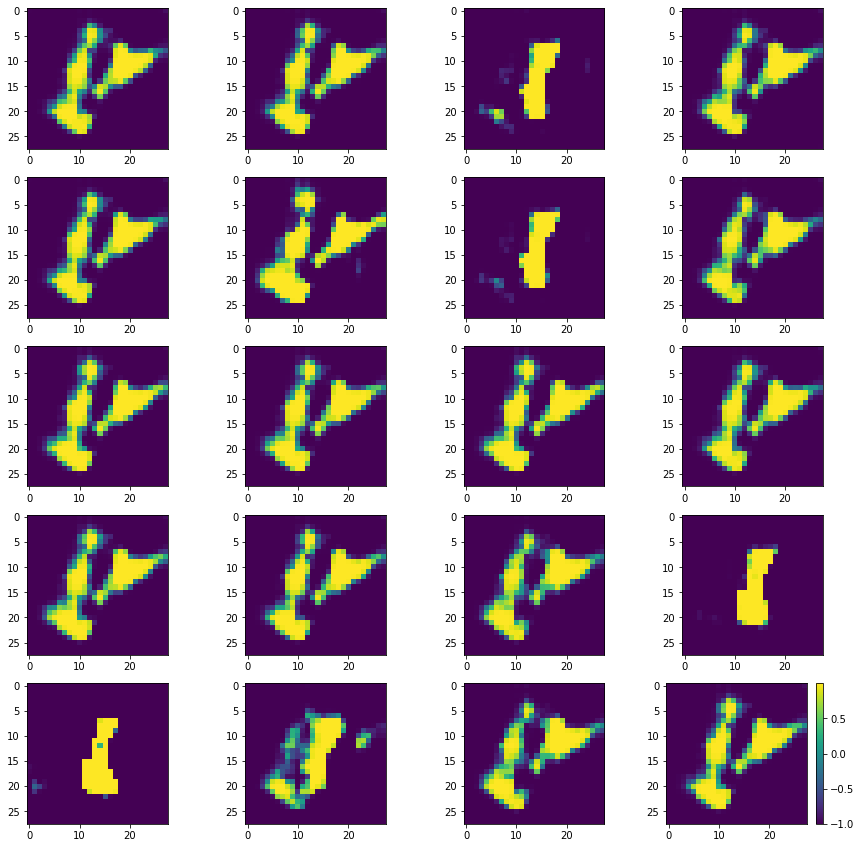

Batch_Num : 62
D_Loss   :   [9.774103164672852, 0.14747628569602966, 9.626626968383789, 0.498046875, 0.09375] ;    GAN_Loss   :  [13.117616653442383, 2.4470858573913574, 10.670530319213867, 0.0, 0.08984375]
Batch_Num : 63
D_Loss   :   [10.082651138305664, 0.19532859325408936, 9.887322425842285, 0.49609375, 0.107421875] ;    GAN_Loss   :  [13.700510025024414, 2.8558342456817627, 10.84467601776123, 0.0, 0.091796875]
Batch_Num : 64
D_Loss   :   [10.046784400939941, 0.17357312142848969, 9.873210906982422, 0.5, 0.11328125] ;    GAN_Loss   :  [14.120051383972168, 3.4318904876708984, 10.68816089630127, 0.0, 0.109375]
Batch_Num : 65
D_Loss   :   [10.125083923339844, 0.12238895893096924, 10.002695083618164, 0.5, 0.109375] ;    GAN_Loss   :  [14.357478141784668, 3.8934154510498047, 10.464062690734863, 0.0, 0.091796875]
Batch_Num : 66
D_Loss   :   [10.776500701904297, 0.1458645910024643, 10.630636215209961, 0.5, 0.087890625] ;    GAN_Loss   :  [15.990468978881836, 4.216846466064453, 11.7736225128

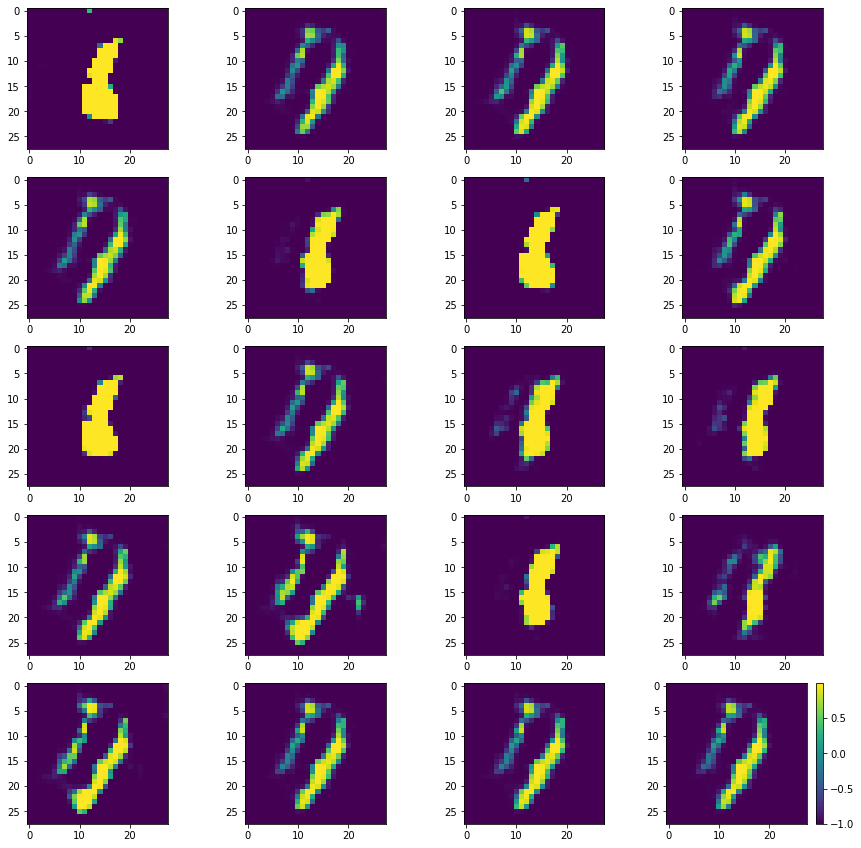

Batch_Num : 77
D_Loss   :   [10.073999404907227, 0.16466465592384338, 9.909335136413574, 0.498046875, 0.083984375] ;    GAN_Loss   :  [16.622730255126953, 5.496950149536133, 11.125781059265137, 0.0, 0.095703125]
Batch_Num : 78
D_Loss   :   [9.692459106445312, 0.1366872787475586, 9.555771827697754, 0.5, 0.0625] ;    GAN_Loss   :  [18.005733489990234, 6.408075332641602, 11.597657203674316, 0.0, 0.134765625]
Batch_Num : 79
D_Loss   :   [10.46916675567627, 0.13177281618118286, 10.337393760681152, 0.5, 0.103515625] ;    GAN_Loss   :  [17.189796447753906, 6.446825981140137, 10.742971420288086, 0.0, 0.123046875]
Batch_Num : 80
D_Loss   :   [10.046737670898438, 0.1535169780254364, 9.893220901489258, 0.5, 0.091796875] ;    GAN_Loss   :  [16.846837997436523, 6.003439426422119, 10.843399047851562, 0.0, 0.119140625]
Batch_Num : 81
D_Loss   :   [10.263980865478516, 0.14814621210098267, 10.11583423614502, 0.5, 0.07421875] ;    GAN_Loss   :  [16.150020599365234, 5.429389953613281, 10.72063159942627, 

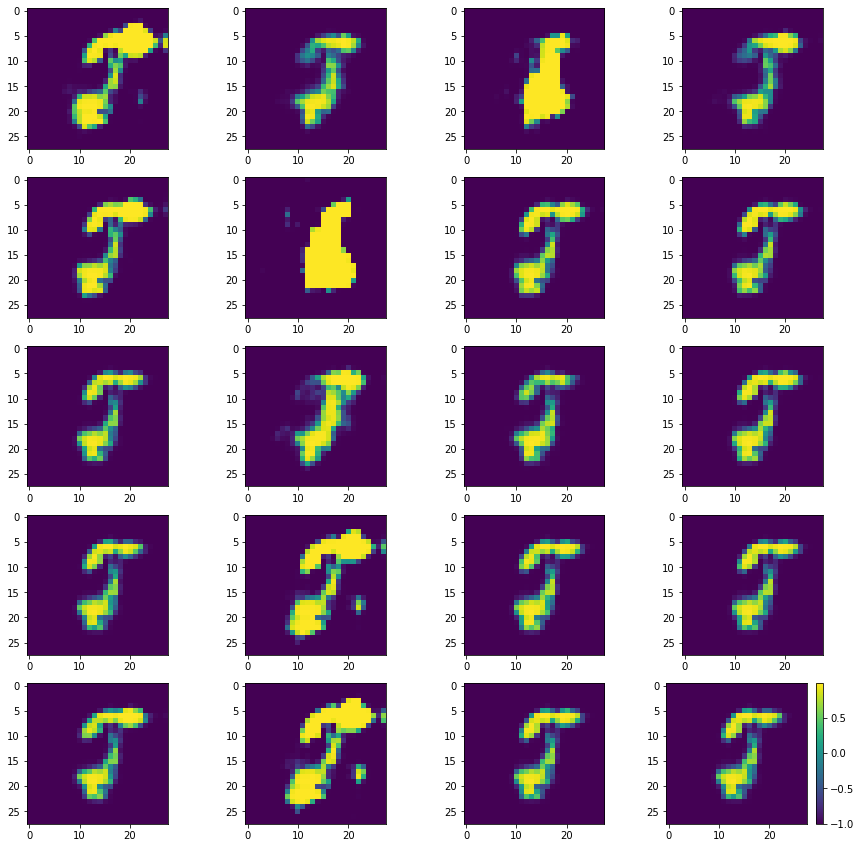

Batch_Num : 92
D_Loss   :   [10.264735221862793, 0.25028252601623535, 10.014452934265137, 0.4921875, 0.08984375] ;    GAN_Loss   :  [22.47168731689453, 11.243690490722656, 11.227995872497559, 0.0, 0.078125]
Batch_Num : 93
D_Loss   :   [10.637704849243164, 0.18199750781059265, 10.455707550048828, 0.498046875, 0.107421875] ;    GAN_Loss   :  [21.428081512451172, 7.668802738189697, 13.759279251098633, 0.0, 0.11328125]
Batch_Num : 94
D_Loss   :   [10.095039367675781, 0.22128280997276306, 9.873756408691406, 0.494140625, 0.12109375] ;    GAN_Loss   :  [20.269611358642578, 6.962673187255859, 13.306938171386719, 0.0, 0.10546875]
Batch_Num : 95
D_Loss   :   [10.294676780700684, 0.24293838441371918, 10.051738739013672, 0.494140625, 0.099609375] ;    GAN_Loss   :  [19.767929077148438, 6.6701436042785645, 13.097785949707031, 0.0, 0.1171875]
Batch_Num : 96
D_Loss   :   [9.831745147705078, 0.21019195020198822, 9.621553421020508, 0.5, 0.107421875] ;    GAN_Loss   :  [22.185890197753906, 8.16366958618

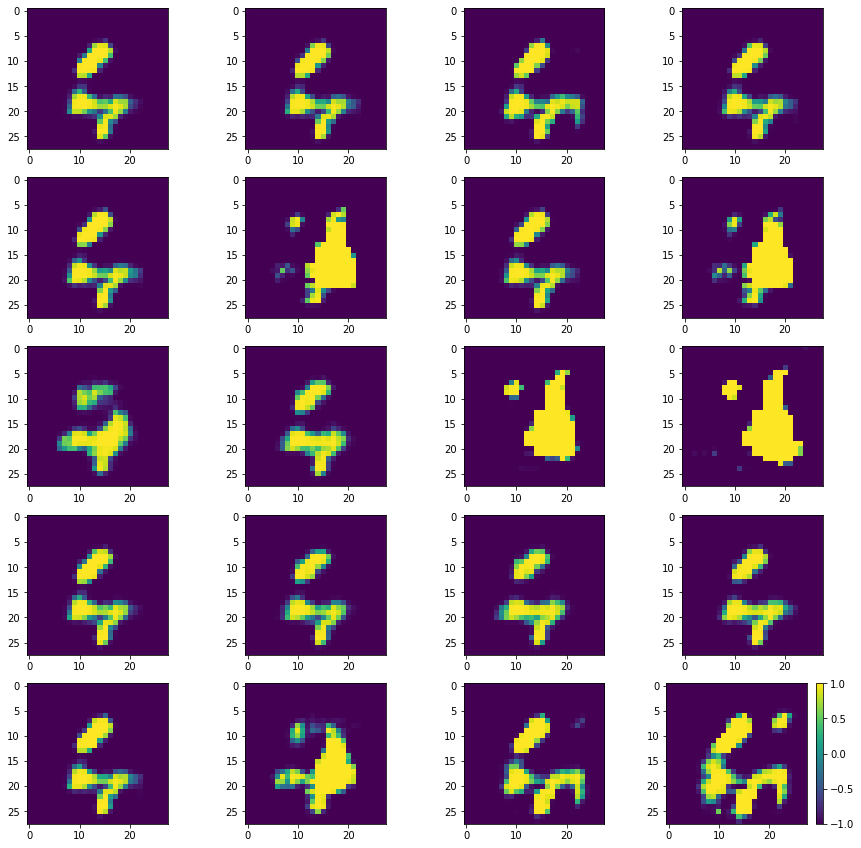

Batch_Num : 107
D_Loss   :   [10.082123756408691, 0.2069729119539261, 9.875150680541992, 0.490234375, 0.119140625] ;    GAN_Loss   :  [15.215652465820312, 4.40803861618042, 10.807613372802734, 0.0, 0.099609375]
Batch_Num : 108
D_Loss   :   [9.478903770446777, 0.17845095694065094, 9.300453186035156, 0.49609375, 0.099609375] ;    GAN_Loss   :  [15.17630672454834, 4.292489051818848, 10.883817672729492, 0.0, 0.11328125]
Batch_Num : 109
D_Loss   :   [9.722214698791504, 0.18196792900562286, 9.540246963500977, 0.498046875, 0.107421875] ;    GAN_Loss   :  [14.042428970336914, 3.729335308074951, 10.313093185424805, 0.0, 0.125]
Batch_Num : 110
D_Loss   :   [10.437520027160645, 0.2090962529182434, 10.228424072265625, 0.49609375, 0.095703125] ;    GAN_Loss   :  [13.767194747924805, 3.405905246734619, 10.361289024353027, 0.0, 0.1171875]
Batch_Num : 111
D_Loss   :   [9.632630348205566, 0.21893459558486938, 9.413695335388184, 0.494140625, 0.11328125] ;    GAN_Loss   :  [14.538824081420898, 4.07023382

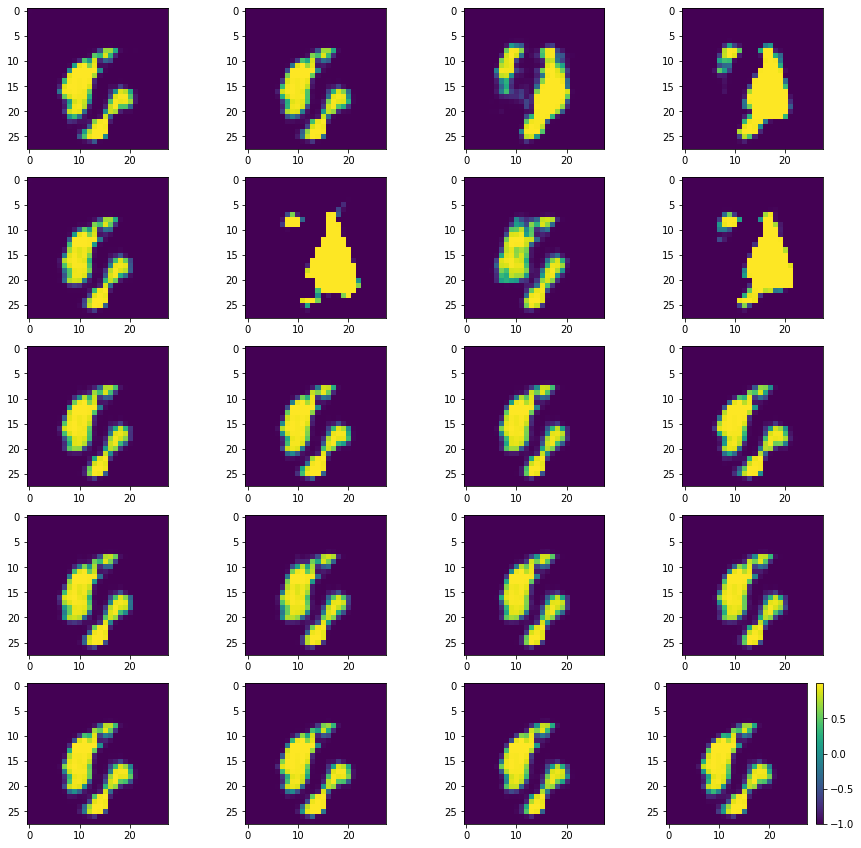

Batch_Num : 122
D_Loss   :   [10.55001449584961, 0.1498875468969345, 10.400127410888672, 0.5, 0.115234375] ;    GAN_Loss   :  [11.74215316772461, 1.951287031173706, 9.790865898132324, 0.0, 0.06640625]
Batch_Num : 123
D_Loss   :   [9.931343078613281, 0.1601465344429016, 9.771196365356445, 0.49609375, 0.08984375] ;    GAN_Loss   :  [11.526580810546875, 1.8069403171539307, 9.719640731811523, 0.0, 0.08203125]
Batch_Num : 124
D_Loss   :   [10.283175468444824, 0.16137218475341797, 10.121803283691406, 0.49609375, 0.091796875] ;    GAN_Loss   :  [12.084969520568848, 1.8520029783248901, 10.232966423034668, 0.0, 0.076171875]
Batch_Num : 125
D_Loss   :   [10.462934494018555, 0.1619003415107727, 10.301033973693848, 0.498046875, 0.09765625] ;    GAN_Loss   :  [12.307135581970215, 2.0238027572631836, 10.283332824707031, 0.0, 0.087890625]
Batch_Num : 126
D_Loss   :   [10.431586265563965, 0.17476409673690796, 10.25682258605957, 0.5, 0.072265625] ;    GAN_Loss   :  [12.767849922180176, 2.59475207328796

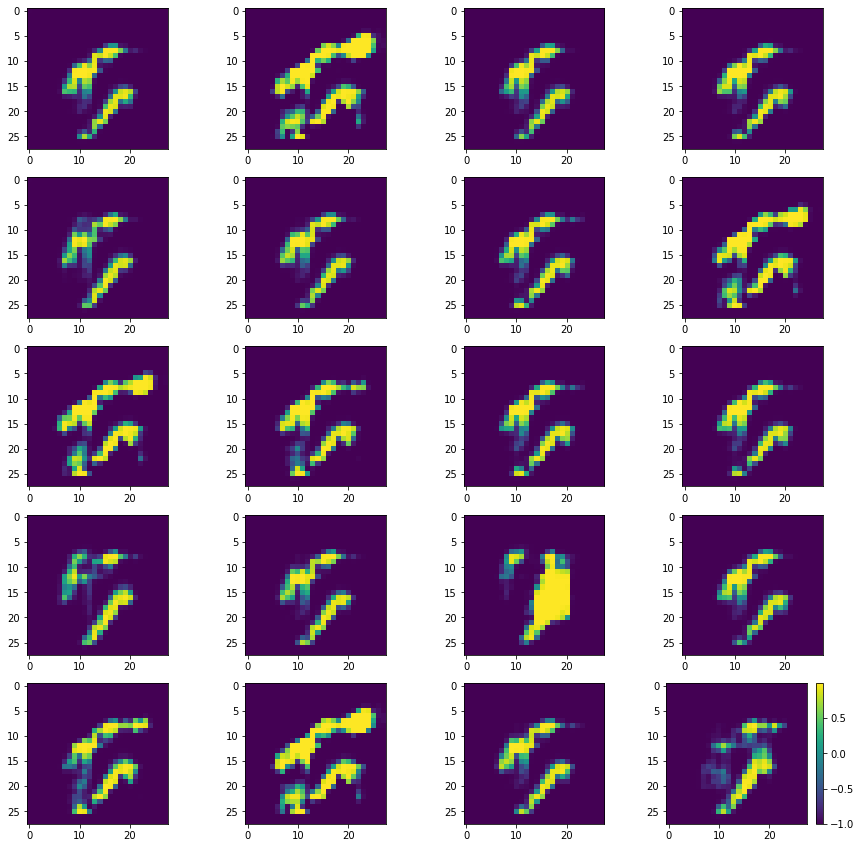

Batch_Num : 137
D_Loss   :   [10.778351783752441, 0.15718035399913788, 10.621170997619629, 0.5, 0.080078125] ;    GAN_Loss   :  [13.090715408325195, 2.6955437660217285, 10.395171165466309, 0.0, 0.064453125]
Batch_Num : 138
D_Loss   :   [10.042566299438477, 0.14512600004673004, 9.897439956665039, 0.5, 0.078125] ;    GAN_Loss   :  [12.935478210449219, 2.5733628273010254, 10.362114906311035, 0.0, 0.060546875]
Batch_Num : 139
D_Loss   :   [9.947176933288574, 0.15072238445281982, 9.796454429626465, 0.5, 0.0859375] ;    GAN_Loss   :  [12.384025573730469, 2.495945453643799, 9.888079643249512, 0.0, 0.080078125]
Batch_Num : 140
D_Loss   :   [9.541520118713379, 0.14495615661144257, 9.396563529968262, 0.5, 0.06640625] ;    GAN_Loss   :  [13.284171104431152, 2.652279853820801, 10.631891250610352, 0.0, 0.08203125]
Batch_Num : 141
D_Loss   :   [10.1162691116333, 0.1471663862466812, 9.96910285949707, 0.5, 0.072265625] ;    GAN_Loss   :  [12.171276092529297, 2.351375102996826, 9.819900512695312, 0.0, 

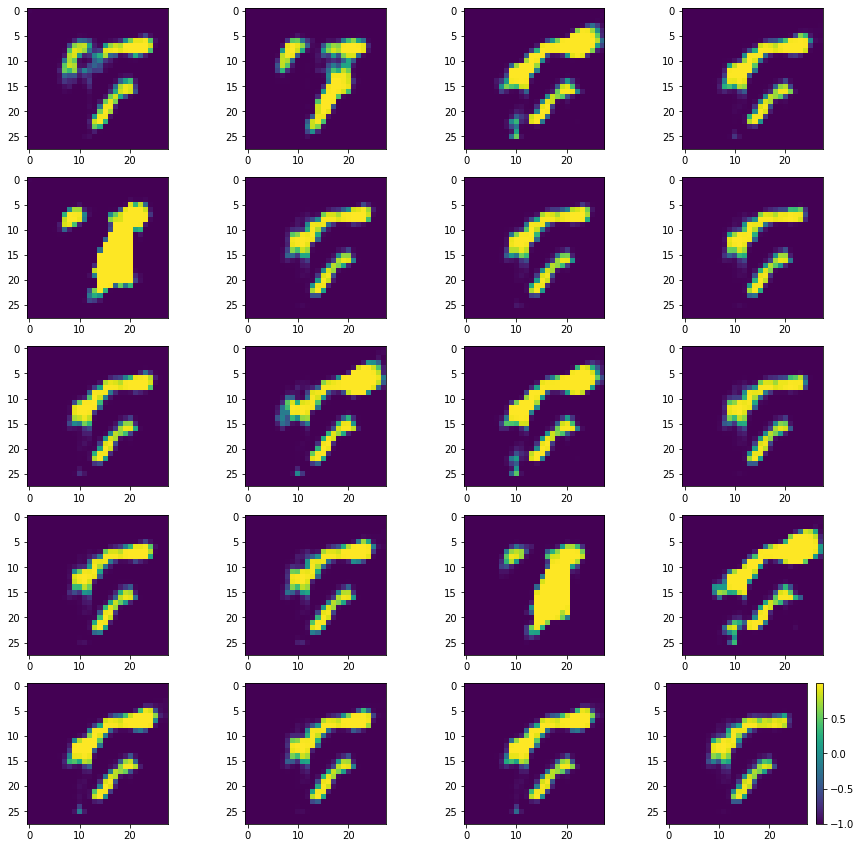

Batch_Num : 152
D_Loss   :   [9.832210540771484, 0.16255570948123932, 9.669654846191406, 0.498046875, 0.08203125] ;    GAN_Loss   :  [14.136320114135742, 3.3852405548095703, 10.751079559326172, 0.0, 0.0625]
Batch_Num : 153
D_Loss   :   [10.081964492797852, 0.15615107119083405, 9.925813674926758, 0.490234375, 0.076171875] ;    GAN_Loss   :  [13.421634674072266, 3.4021177291870117, 10.019516944885254, 0.0, 0.064453125]
Batch_Num : 154
D_Loss   :   [10.083779335021973, 0.19031241536140442, 9.89346694946289, 0.494140625, 0.1015625] ;    GAN_Loss   :  [14.15542221069336, 3.937340021133423, 10.218082427978516, 0.0, 0.068359375]
Batch_Num : 155
D_Loss   :   [10.424357414245605, 0.17180563509464264, 10.252552032470703, 0.490234375, 0.083984375] ;    GAN_Loss   :  [13.738449096679688, 3.617067813873291, 10.121380805969238, 0.0, 0.06640625]
Batch_Num : 156
D_Loss   :   [9.531815528869629, 0.16447851061820984, 9.367337226867676, 0.498046875, 0.0625] ;    GAN_Loss   :  [14.30107307434082, 3.615818

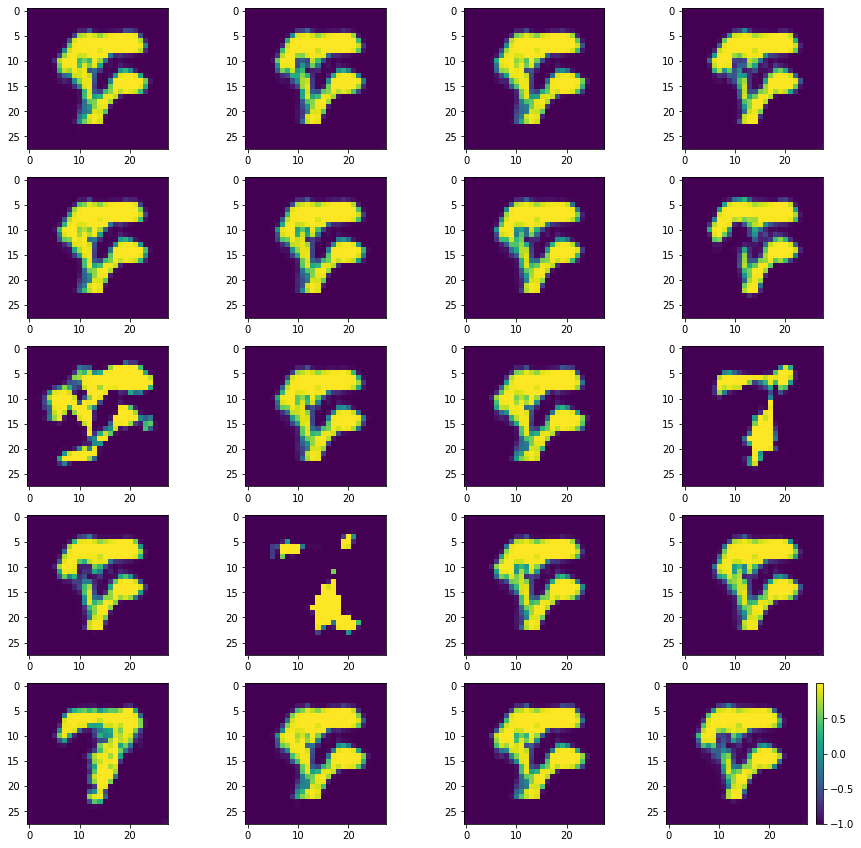

Batch_Num : 167
D_Loss   :   [10.675640106201172, 0.2758854925632477, 10.399754524230957, 0.453125, 0.060546875] ;    GAN_Loss   :  [12.25961685180664, 2.4182188510894775, 9.841398239135742, 0.0, 0.04296875]
Batch_Num : 168
D_Loss   :   [9.700507164001465, 0.2664656341075897, 9.434041976928711, 0.466796875, 0.07421875] ;    GAN_Loss   :  [12.435432434082031, 2.4008049964904785, 10.034626960754395, 0.0, 0.052734375]
Batch_Num : 169
D_Loss   :   [10.20071792602539, 0.24890786409378052, 9.951809883117676, 0.466796875, 0.068359375] ;    GAN_Loss   :  [11.47598648071289, 2.076139211654663, 9.399847030639648, 0.0, 0.060546875]
Batch_Num : 170
D_Loss   :   [10.184046745300293, 0.25552356243133545, 9.928523063659668, 0.474609375, 0.08984375] ;    GAN_Loss   :  [11.611669540405273, 1.7177259922027588, 9.893943786621094, 0.0, 0.078125]
Batch_Num : 171
D_Loss   :   [10.548577308654785, 0.27498859167099, 10.273589134216309, 0.4609375, 0.07421875] ;    GAN_Loss   :  [13.633268356323242, 2.924068689

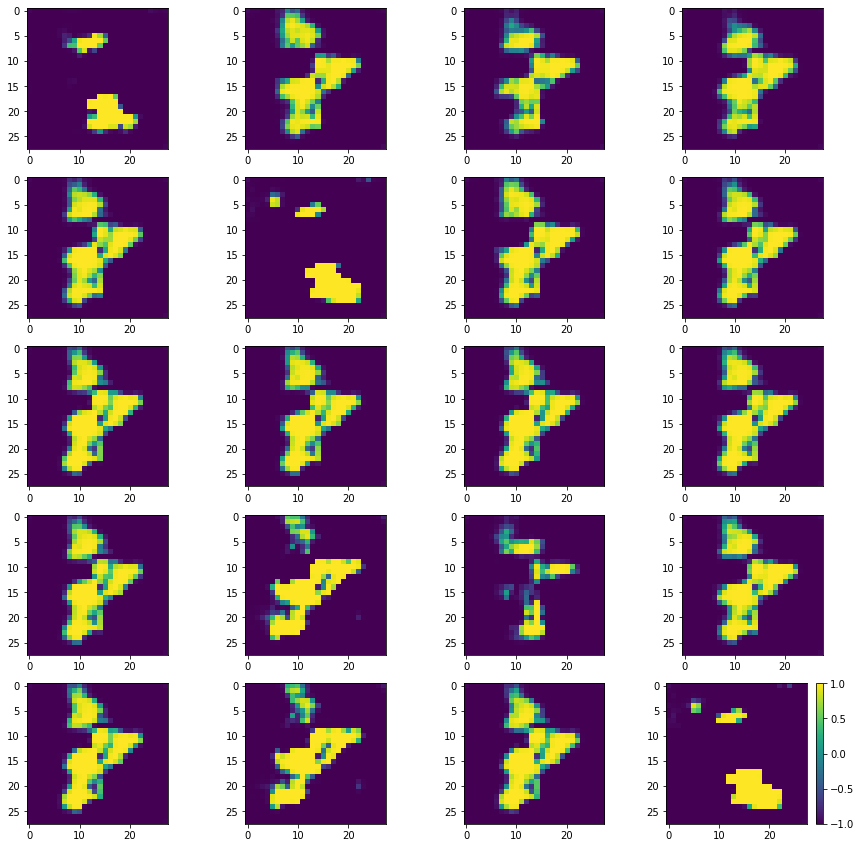

Batch_Num : 182
D_Loss   :   [9.755634307861328, 0.1711205095052719, 9.584513664245605, 0.49609375, 0.1171875] ;    GAN_Loss   :  [19.10687828063965, 7.3539605140686035, 11.752918243408203, 0.0, 0.119140625]
Batch_Num : 183
D_Loss   :   [10.375482559204102, 0.1465686410665512, 10.228914260864258, 0.498046875, 0.09765625] ;    GAN_Loss   :  [16.445091247558594, 5.713504791259766, 10.731586456298828, 0.0, 0.130859375]
Batch_Num : 184
D_Loss   :   [9.903635025024414, 0.19683797657489777, 9.706796646118164, 0.482421875, 0.09375] ;    GAN_Loss   :  [17.258726119995117, 5.816339492797852, 11.442386627197266, 0.0, 0.103515625]
Batch_Num : 185
D_Loss   :   [9.96645736694336, 0.17522242665290833, 9.791234970092773, 0.494140625, 0.099609375] ;    GAN_Loss   :  [16.226879119873047, 5.050717353820801, 11.176162719726562, 0.0, 0.099609375]
Batch_Num : 186
D_Loss   :   [9.57234001159668, 0.192991703748703, 9.379348754882812, 0.4921875, 0.095703125] ;    GAN_Loss   :  [15.059907913208008, 4.290746212

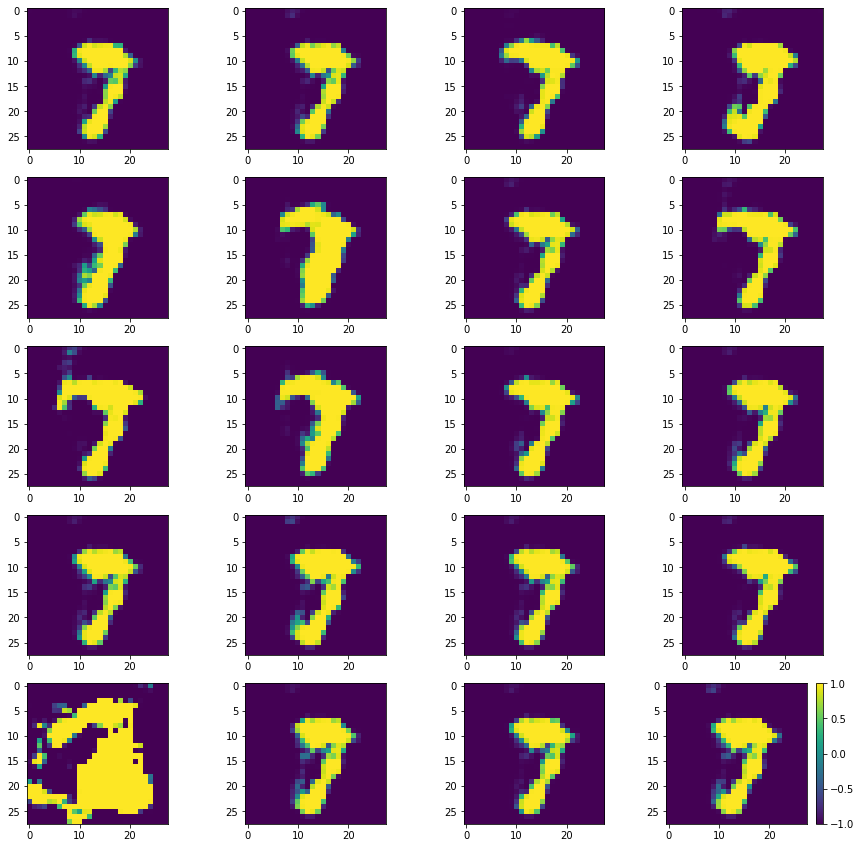

Batch_Num : 197
D_Loss   :   [10.078508377075195, 0.1927243173122406, 9.885784149169922, 0.5, 0.08203125] ;    GAN_Loss   :  [12.199206352233887, 1.2913525104522705, 10.907854080200195, 0.0, 0.068359375]
Batch_Num : 198
D_Loss   :   [9.753683090209961, 0.21016104519367218, 9.543521881103516, 0.494140625, 0.09375] ;    GAN_Loss   :  [13.469531059265137, 2.127971887588501, 11.341559410095215, 0.0, 0.076171875]
Batch_Num : 199
D_Loss   :   [10.663804054260254, 0.21159453690052032, 10.45220947265625, 0.5, 0.103515625] ;    GAN_Loss   :  [13.363945007324219, 2.5815937519073486, 10.78235149383545, 0.0, 0.052734375]
Batch_Num : 200
D_Loss   :   [10.243110656738281, 0.2225760817527771, 10.02053451538086, 0.498046875, 0.09765625] ;    GAN_Loss   :  [18.443744659423828, 5.522994518280029, 12.920750617980957, 0.0, 0.0625]
Batch_Num : 201
D_Loss   :   [10.463234901428223, 0.20710232853889465, 10.256132125854492, 0.49609375, 0.060546875] ;    GAN_Loss   :  [17.59192657470703, 5.512869358062744, 12.

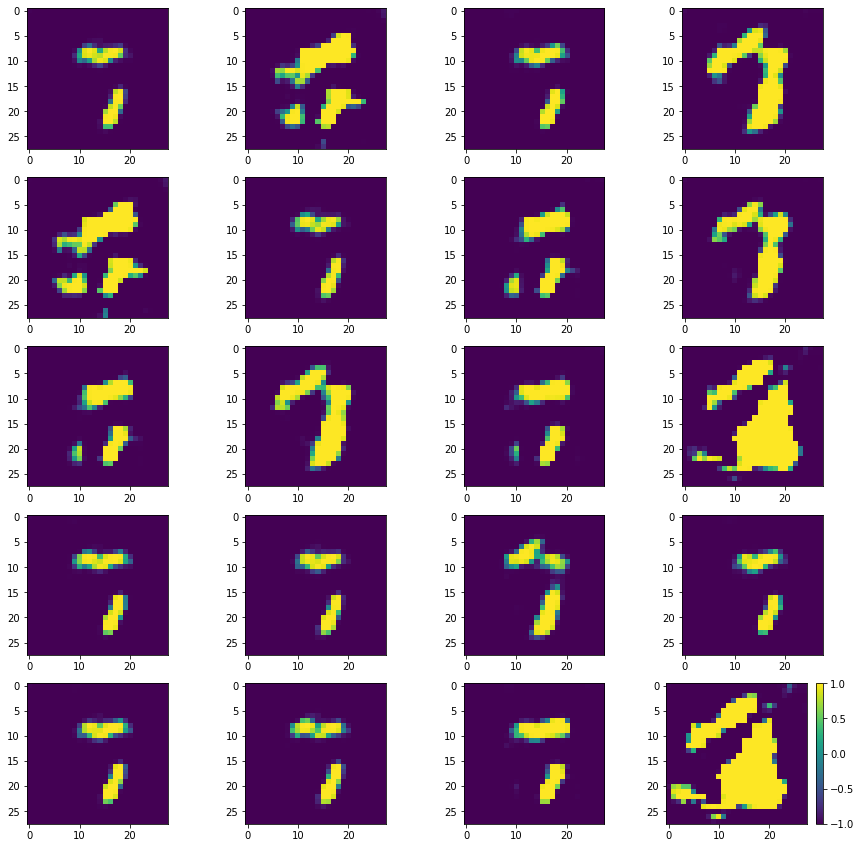

Batch_Num : 212
D_Loss   :   [10.942626953125, 0.16179285943508148, 10.780834197998047, 0.5, 0.07421875] ;    GAN_Loss   :  [24.084091186523438, 12.625909805297852, 11.45818042755127, 0.0, 0.10546875]
Batch_Num : 213
D_Loss   :   [9.626518249511719, 0.16233015060424805, 9.464188575744629, 0.5, 0.080078125] ;    GAN_Loss   :  [24.852354049682617, 13.61117172241211, 11.241182327270508, 0.0, 0.142578125]
Batch_Num : 214
D_Loss   :   [10.425154685974121, 0.19809851050376892, 10.227056503295898, 0.494140625, 0.08984375] ;    GAN_Loss   :  [24.51249885559082, 13.688620567321777, 10.823878288269043, 0.0, 0.091796875]
Batch_Num : 215
D_Loss   :   [9.241660118103027, 0.1735953986644745, 9.06806468963623, 0.486328125, 0.064453125] ;    GAN_Loss   :  [23.87293243408203, 12.955615997314453, 10.917315483093262, 0.0, 0.09375]
Batch_Num : 216
D_Loss   :   [10.443656921386719, 0.1644478589296341, 10.27920913696289, 0.49609375, 0.091796875] ;    GAN_Loss   :  [22.58998680114746, 11.711040496826172, 10.

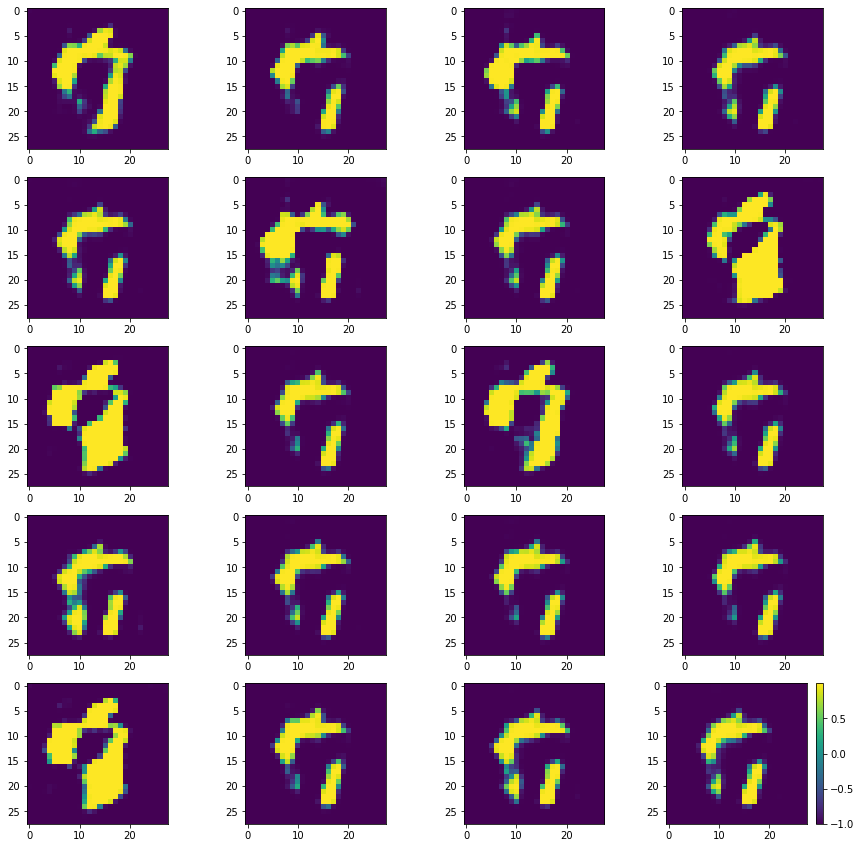

Batch_Num : 227
D_Loss   :   [9.28125, 0.15947286784648895, 9.121777534484863, 0.5, 0.07421875] ;    GAN_Loss   :  [17.087356567382812, 6.626302719116211, 10.461053848266602, 0.0, 0.119140625]
Batch_Num : 228
D_Loss   :   [10.364291191101074, 0.13922175765037537, 10.225069046020508, 0.5, 0.09375] ;    GAN_Loss   :  [16.27862548828125, 5.98689603805542, 10.291728973388672, 0.0, 0.087890625]
Batch_Num : 229
D_Loss   :   [9.780935287475586, 0.13906511664390564, 9.641870498657227, 0.5, 0.0703125] ;    GAN_Loss   :  [15.963255882263184, 5.657108306884766, 10.306147575378418, 0.0, 0.046875]
Batch_Num : 230
D_Loss   :   [10.0978422164917, 0.13036659359931946, 9.967475891113281, 0.5, 0.095703125] ;    GAN_Loss   :  [15.623918533325195, 5.28621244430542, 10.337705612182617, 0.0, 0.083984375]
Batch_Num : 231
D_Loss   :   [10.346714973449707, 0.13830626010894775, 10.20840835571289, 0.5, 0.08984375] ;    GAN_Loss   :  [15.397992134094238, 5.139336585998535, 10.258655548095703, 0.0, 0.0703125]
Batc

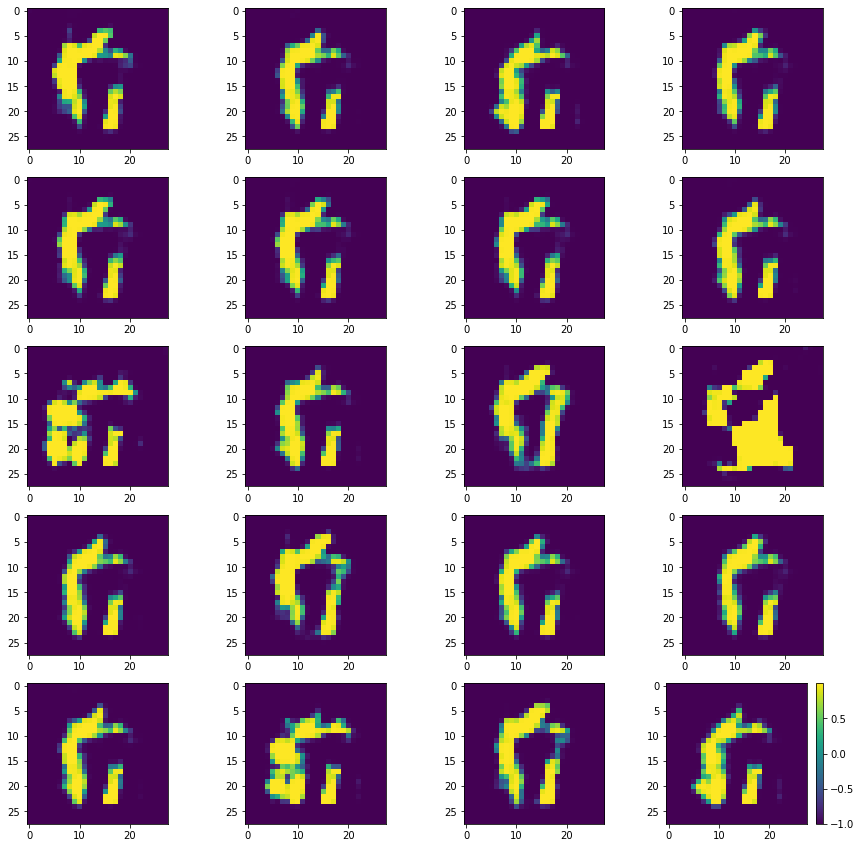

Batch_Num : 2
D_Loss   :   [10.149138450622559, 0.15392674505710602, 9.995211601257324, 0.5, 0.083984375] ;    GAN_Loss   :  [16.060028076171875, 5.9787421226501465, 10.08128547668457, 0.0, 0.0703125]
Batch_Num : 3
D_Loss   :   [10.174351692199707, 0.14671111106872559, 10.027640342712402, 0.5, 0.068359375] ;    GAN_Loss   :  [16.433765411376953, 5.898284435272217, 10.535480499267578, 0.0, 0.08984375]
Batch_Num : 4
D_Loss   :   [10.3566312789917, 0.1560729295015335, 10.20055866241455, 0.5, 0.080078125] ;    GAN_Loss   :  [15.804707527160645, 5.6147003173828125, 10.190007209777832, 0.0, 0.078125]
Batch_Num : 5
D_Loss   :   [10.21187686920166, 0.16270217299461365, 10.049174308776855, 0.5, 0.06640625] ;    GAN_Loss   :  [15.881431579589844, 5.404741287231445, 10.476690292358398, 0.0, 0.09765625]
Batch_Num : 6
D_Loss   :   [10.499283790588379, 0.15188324451446533, 10.347400665283203, 0.494140625, 0.068359375] ;    GAN_Loss   :  [15.356518745422363, 5.598783493041992, 9.757735252380371, 0.0,

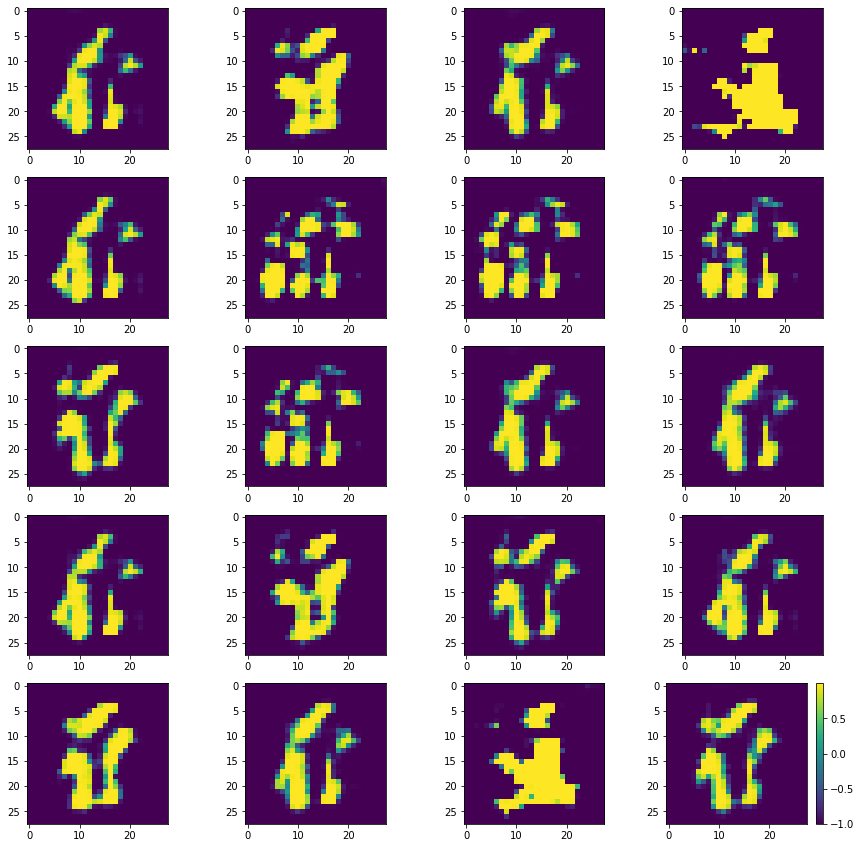

Batch_Num : 17
D_Loss   :   [9.803665161132812, 0.15035605430603027, 9.653308868408203, 0.5, 0.087890625] ;    GAN_Loss   :  [14.447999954223633, 4.146390438079834, 10.30160903930664, 0.0, 0.068359375]
Batch_Num : 18
D_Loss   :   [9.954569816589355, 0.15248295664787292, 9.80208683013916, 0.5, 0.080078125] ;    GAN_Loss   :  [14.457347869873047, 4.102087020874023, 10.355260848999023, 0.0, 0.060546875]
Batch_Num : 19
D_Loss   :   [10.023443222045898, 0.1563282608985901, 9.867115020751953, 0.5, 0.078125] ;    GAN_Loss   :  [14.19760513305664, 4.105530261993408, 10.092074394226074, 0.0, 0.078125]
Batch_Num : 20
D_Loss   :   [9.848679542541504, 0.15177315473556519, 9.696906089782715, 0.5, 0.06640625] ;    GAN_Loss   :  [14.207719802856445, 3.864816188812256, 10.342904090881348, 0.0, 0.06640625]
Batch_Num : 21
D_Loss   :   [9.68410587310791, 0.14351394772529602, 9.540592193603516, 0.5, 0.0625] ;    GAN_Loss   :  [13.858881950378418, 3.7353973388671875, 10.12348461151123, 0.0, 0.064453125]
Ba

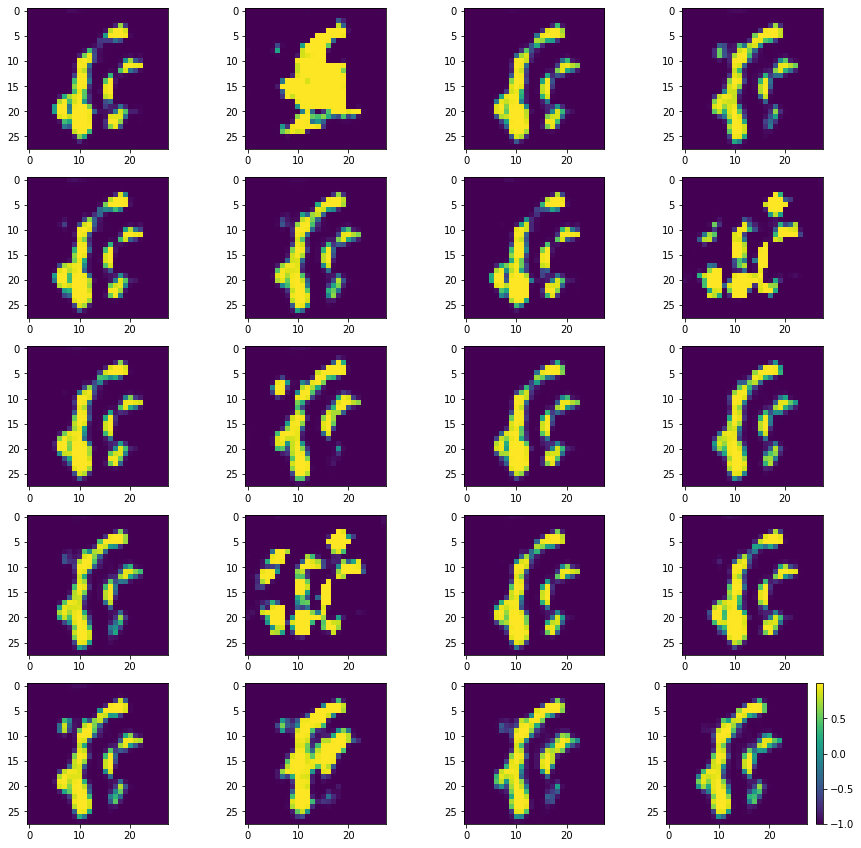

Batch_Num : 32
D_Loss   :   [9.745284080505371, 0.17255327105522156, 9.572731018066406, 0.5, 0.06640625] ;    GAN_Loss   :  [10.844484329223633, 1.0289720296859741, 9.815512657165527, 0.0, 0.11328125]
Batch_Num : 33
D_Loss   :   [10.31778335571289, 0.15704423189163208, 10.160738945007324, 0.498046875, 0.078125] ;    GAN_Loss   :  [11.30268383026123, 1.2652724981307983, 10.0374116897583, 0.0, 0.10546875]
Batch_Num : 34
D_Loss   :   [10.380575180053711, 0.16978681087493896, 10.21078872680664, 0.498046875, 0.076171875] ;    GAN_Loss   :  [12.201772689819336, 1.845220685005188, 10.356552124023438, 0.0, 0.076171875]
Batch_Num : 35
D_Loss   :   [9.613755226135254, 0.14951704442501068, 9.464238166809082, 0.5, 0.095703125] ;    GAN_Loss   :  [12.222003936767578, 1.7356524467468262, 10.48635196685791, 0.0, 0.091796875]
Batch_Num : 36
D_Loss   :   [9.684612274169922, 0.14604729413986206, 9.538564682006836, 0.5, 0.064453125] ;    GAN_Loss   :  [12.152749061584473, 1.8963184356689453, 10.256430625

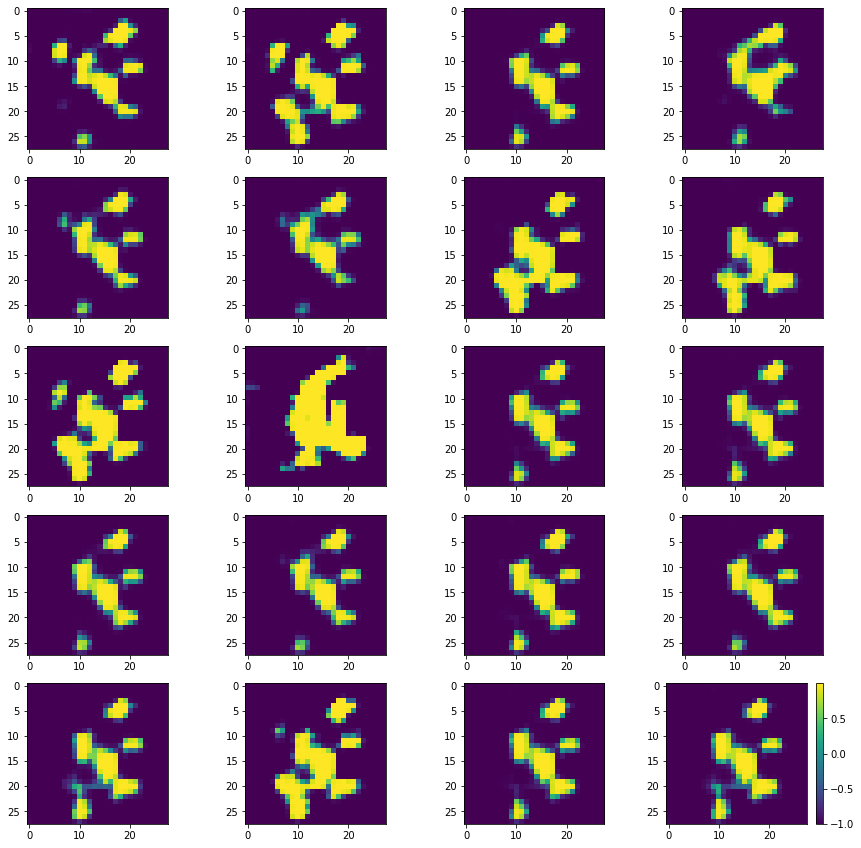

Batch_Num : 47
D_Loss   :   [10.73345947265625, 0.20523957908153534, 10.528220176696777, 0.5, 0.078125] ;    GAN_Loss   :  [11.455071449279785, 1.1893625259399414, 10.265708923339844, 0.0, 0.09375]
Batch_Num : 48
D_Loss   :   [10.155837059020996, 0.17877575755119324, 9.97706127166748, 0.5, 0.091796875] ;    GAN_Loss   :  [11.572755813598633, 1.2450830936431885, 10.327672958374023, 0.0, 0.09765625]
Batch_Num : 49
D_Loss   :   [10.074657440185547, 0.16892586648464203, 9.905731201171875, 0.5, 0.07421875] ;    GAN_Loss   :  [10.694456100463867, 1.023386001586914, 9.671070098876953, 0.0, 0.078125]
Batch_Num : 50
D_Loss   :   [9.779317855834961, 0.15043838322162628, 9.62887954711914, 0.5, 0.060546875] ;    GAN_Loss   :  [11.645163536071777, 1.433793067932129, 10.211370468139648, 0.0, 0.10546875]
Batch_Num : 51
D_Loss   :   [10.42629337310791, 0.1708703190088272, 10.255422592163086, 0.5, 0.087890625] ;    GAN_Loss   :  [11.925769805908203, 1.35784113407135, 10.567928314208984, 0.0, 0.08789062

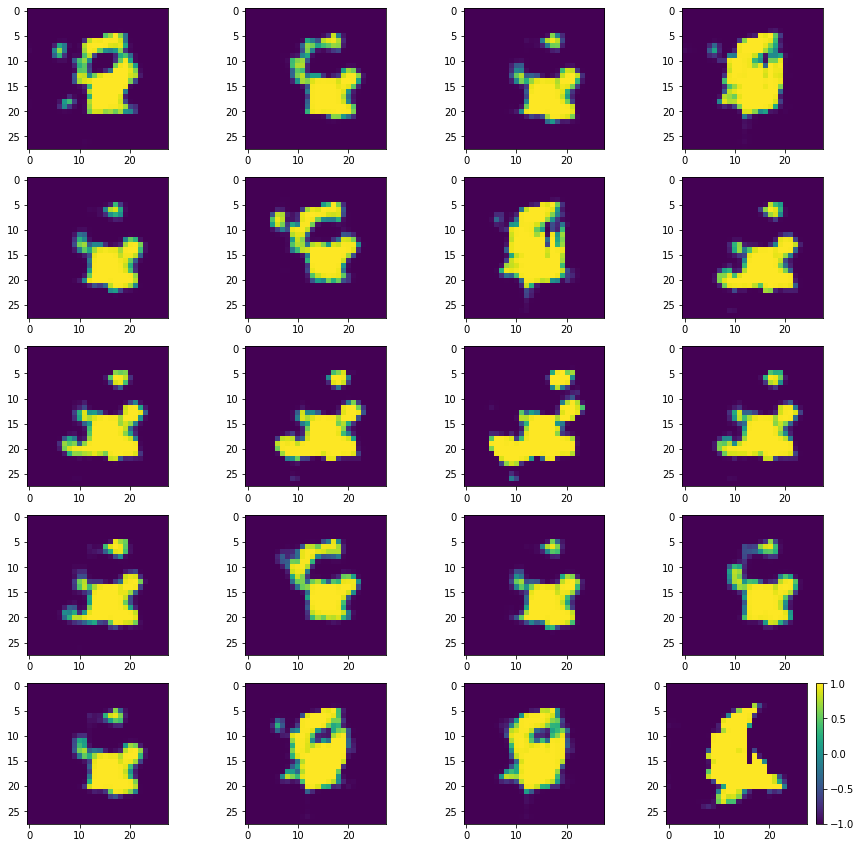

Batch_Num : 62
D_Loss   :   [9.823965072631836, 0.19838929176330566, 9.62557601928711, 0.5, 0.083984375] ;    GAN_Loss   :  [11.121809005737305, 1.0884195566177368, 10.0333890914917, 0.0, 0.09375]
Batch_Num : 63
D_Loss   :   [10.100728988647461, 0.21686682105064392, 9.883862495422363, 0.5, 0.095703125] ;    GAN_Loss   :  [11.53390121459961, 1.4648319482803345, 10.069068908691406, 0.0, 0.095703125]
Batch_Num : 64
D_Loss   :   [10.07359504699707, 0.20829617977142334, 9.865299224853516, 0.498046875, 0.083984375] ;    GAN_Loss   :  [12.027477264404297, 1.8314228057861328, 10.196054458618164, 0.0, 0.076171875]
Batch_Num : 65
D_Loss   :   [10.174160957336426, 0.17205101251602173, 10.00210952758789, 0.5, 0.083984375] ;    GAN_Loss   :  [12.037450790405273, 2.1593611240386963, 9.878089904785156, 0.0, 0.1015625]
Batch_Num : 66
D_Loss   :   [10.810972213745117, 0.18160024285316467, 10.629371643066406, 0.5, 0.099609375] ;    GAN_Loss   :  [12.613077163696289, 2.3988735675811768, 10.21420383453369

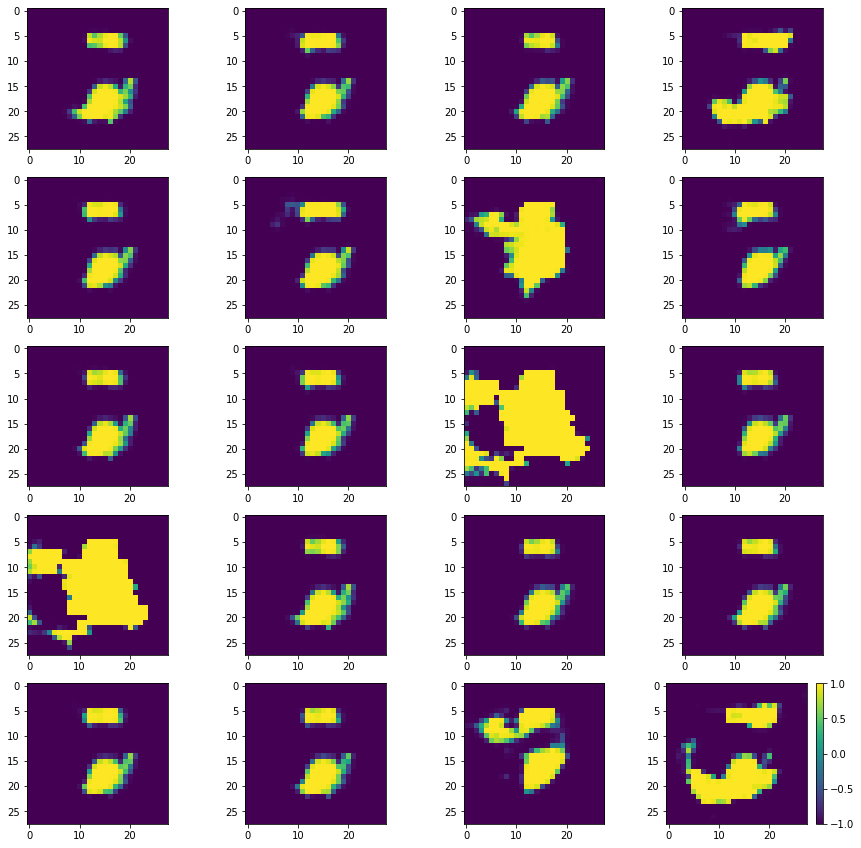

Batch_Num : 77
D_Loss   :   [10.088574409484863, 0.18111012876033783, 9.907464027404785, 0.49609375, 0.068359375] ;    GAN_Loss   :  [15.633723258972168, 5.802848815917969, 9.8308744430542, 0.0, 0.0703125]
Batch_Num : 78
D_Loss   :   [9.7099027633667, 0.15435026586055756, 9.55555248260498, 0.498046875, 0.068359375] ;    GAN_Loss   :  [16.01119613647461, 6.3692169189453125, 9.641979217529297, 0.0, 0.060546875]
Batch_Num : 79
D_Loss   :   [10.488080024719238, 0.15150289237499237, 10.336577415466309, 0.5, 0.064453125] ;    GAN_Loss   :  [16.570690155029297, 6.464637756347656, 10.10605239868164, 0.0, 0.064453125]
Batch_Num : 80
D_Loss   :   [10.024499893188477, 0.14265744388103485, 9.881842613220215, 0.498046875, 0.060546875] ;    GAN_Loss   :  [16.862075805664062, 6.472108840942383, 10.38996696472168, 0.0, 0.041015625]
Batch_Num : 81
D_Loss   :   [10.302260398864746, 0.18607428669929504, 10.116186141967773, 0.5, 0.07421875] ;    GAN_Loss   :  [16.943771362304688, 6.452630519866943, 10.491

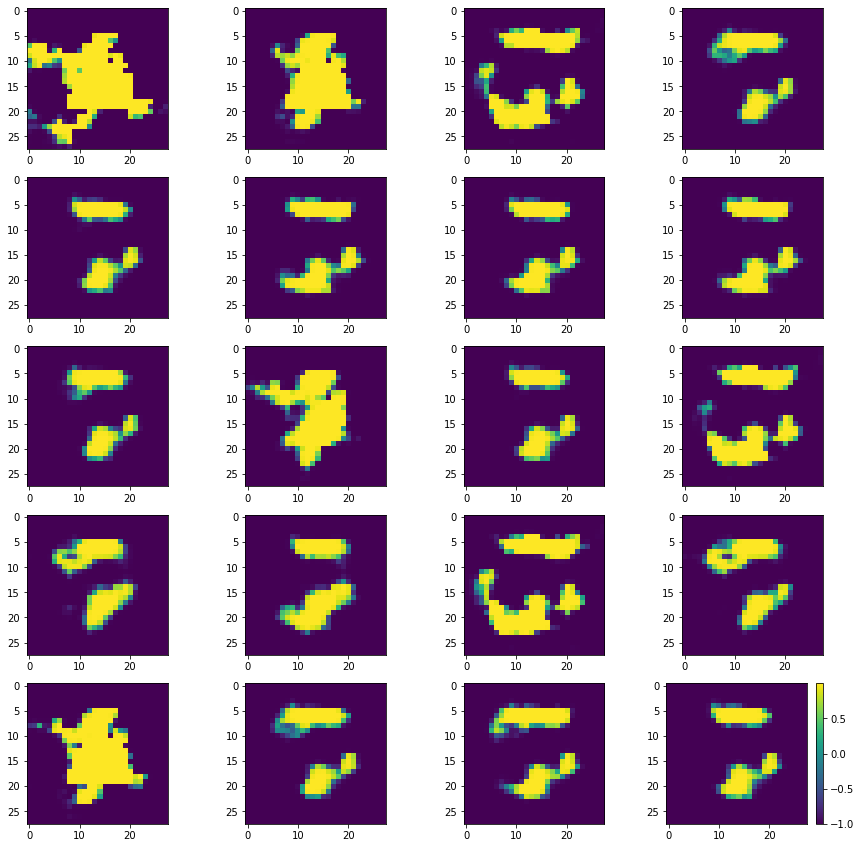

Batch_Num : 92
D_Loss   :   [10.183359146118164, 0.17286911606788635, 10.010490417480469, 0.5, 0.072265625] ;    GAN_Loss   :  [17.355796813964844, 6.596604347229004, 10.75919246673584, 0.0, 0.0703125]
Batch_Num : 93
D_Loss   :   [10.580680847167969, 0.13173338770866394, 10.44894790649414, 0.5, 0.068359375] ;    GAN_Loss   :  [17.4754581451416, 6.575045108795166, 10.900413513183594, 0.0, 0.056640625]
Batch_Num : 94
D_Loss   :   [10.016570091247559, 0.15024322271347046, 9.866327285766602, 0.5, 0.111328125] ;    GAN_Loss   :  [18.074562072753906, 6.521869659423828, 11.552691459655762, 0.0, 0.0703125]
Batch_Num : 95
D_Loss   :   [10.208255767822266, 0.1585163176059723, 10.049739837646484, 0.5, 0.0859375] ;    GAN_Loss   :  [17.85114097595215, 6.168851375579834, 11.682289123535156, 0.0, 0.056640625]
Batch_Num : 96
D_Loss   :   [9.749799728393555, 0.14434996247291565, 9.605449676513672, 0.5, 0.087890625] ;    GAN_Loss   :  [17.24677085876465, 6.211239337921143, 11.035531997680664, 0.0, 0.03

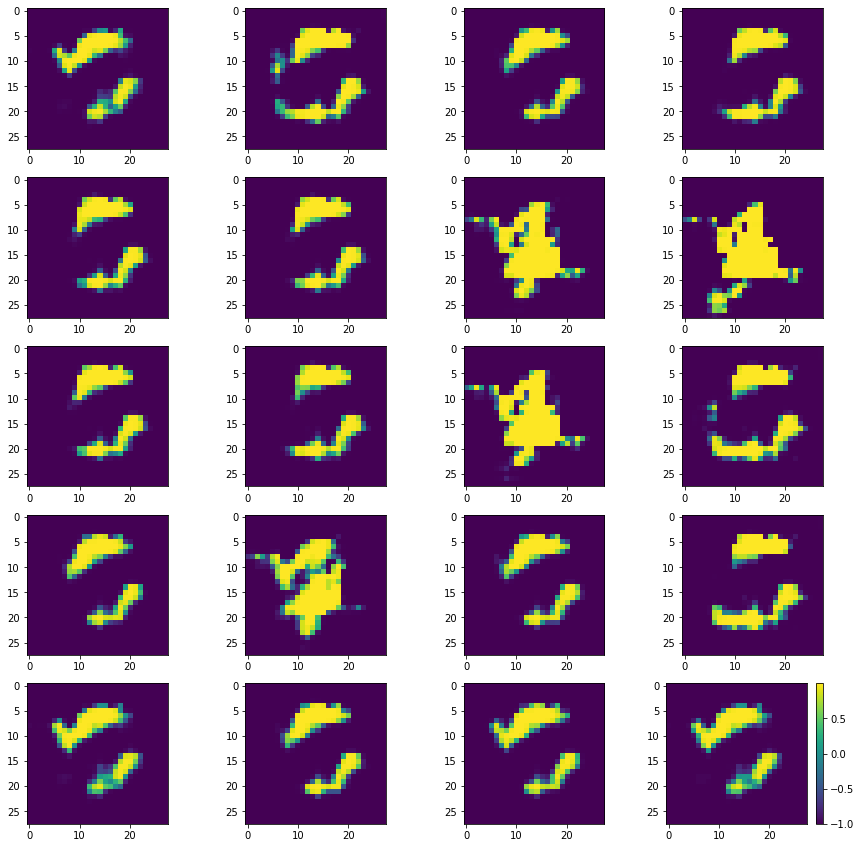

Batch_Num : 107
D_Loss   :   [10.03403091430664, 0.16011030972003937, 9.873920440673828, 0.49609375, 0.076171875] ;    GAN_Loss   :  [18.761219024658203, 5.88980770111084, 12.871410369873047, 0.0, 0.0546875]
Batch_Num : 108
D_Loss   :   [9.440370559692383, 0.14015237987041473, 9.30021858215332, 0.498046875, 0.072265625] ;    GAN_Loss   :  [19.162105560302734, 5.660496711730957, 13.501607894897461, 0.0, 0.083984375]
Batch_Num : 109
D_Loss   :   [9.663980484008789, 0.1405763328075409, 9.523404121398926, 0.498046875, 0.083984375] ;    GAN_Loss   :  [17.68716812133789, 5.4576263427734375, 12.229540824890137, 0.0, 0.068359375]
Batch_Num : 110
D_Loss   :   [10.376875877380371, 0.1590721756219864, 10.217803955078125, 0.490234375, 0.08984375] ;    GAN_Loss   :  [17.613731384277344, 5.282820224761963, 12.330911636352539, 0.0, 0.07421875]
Batch_Num : 111
D_Loss   :   [9.59044361114502, 0.19158148765563965, 9.3988618850708, 0.49609375, 0.068359375] ;    GAN_Loss   :  [17.602272033691406, 5.864089

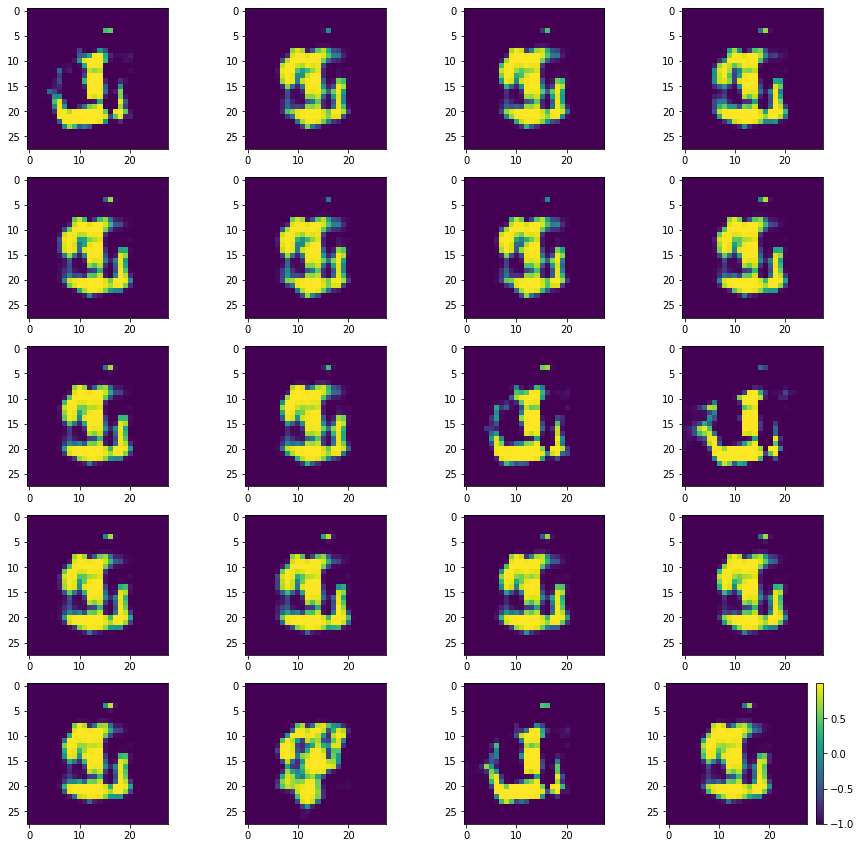

Batch_Num : 122
D_Loss   :   [10.578571319580078, 0.18153417110443115, 10.397037506103516, 0.498046875, 0.068359375] ;    GAN_Loss   :  [16.212493896484375, 5.807828903198242, 10.40466594696045, 0.0, 0.05859375]
Batch_Num : 123
D_Loss   :   [9.931513786315918, 0.15995283424854279, 9.771560668945312, 0.49609375, 0.068359375] ;    GAN_Loss   :  [15.446647644042969, 5.419276237487793, 10.027371406555176, 0.0, 0.060546875]
Batch_Num : 124
D_Loss   :   [10.290038108825684, 0.17502480745315552, 10.115013122558594, 0.49609375, 0.05859375] ;    GAN_Loss   :  [14.66303825378418, 4.260185718536377, 10.402853012084961, 0.0, 0.0390625]
Batch_Num : 125
D_Loss   :   [10.501317024230957, 0.20502826571464539, 10.29628849029541, 0.490234375, 0.072265625] ;    GAN_Loss   :  [14.16028118133545, 3.8841617107391357, 10.276119232177734, 0.0, 0.05859375]
Batch_Num : 126
D_Loss   :   [10.458459854125977, 0.21447698771953583, 10.243983268737793, 0.498046875, 0.060546875] ;    GAN_Loss   :  [13.121246337890625,

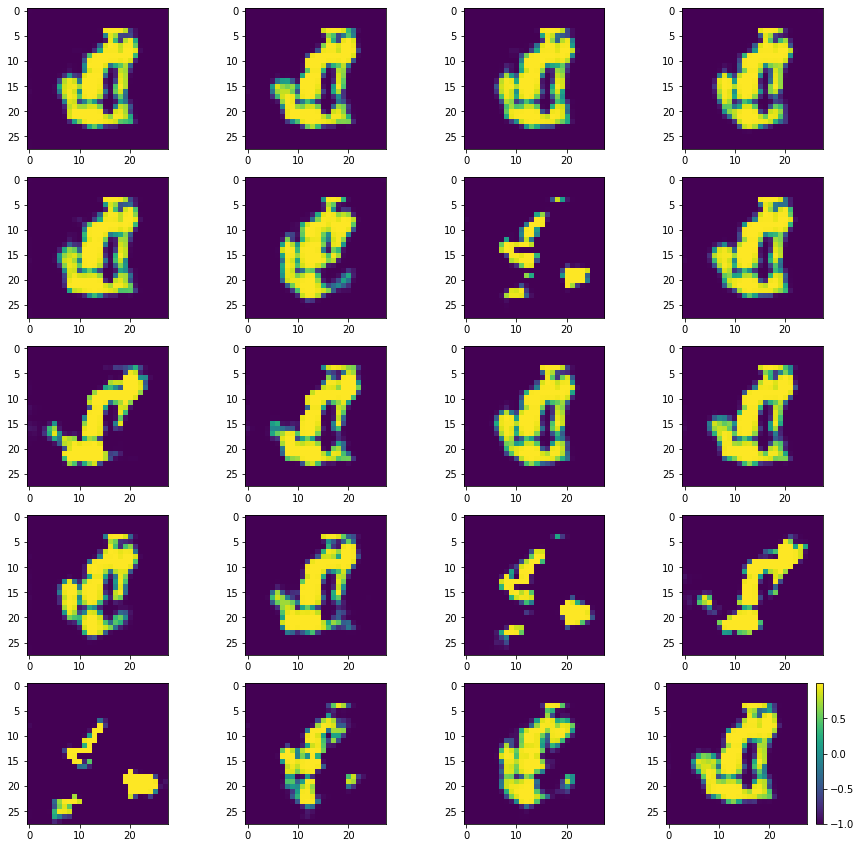

Batch_Num : 137
D_Loss   :   [10.788488388061523, 0.16628757119178772, 10.622200965881348, 0.5, 0.099609375] ;    GAN_Loss   :  [14.518056869506836, 2.7847564220428467, 11.73330020904541, 0.0, 0.123046875]
Batch_Num : 138
D_Loss   :   [10.052253723144531, 0.15984074771404266, 9.892413139343262, 0.498046875, 0.087890625] ;    GAN_Loss   :  [14.918755531311035, 2.683500051498413, 12.235255241394043, 0.0, 0.126953125]
Batch_Num : 139
D_Loss   :   [9.955888748168945, 0.1534801572561264, 9.802408218383789, 0.5, 0.09375] ;    GAN_Loss   :  [14.468606948852539, 2.4799065589904785, 11.988699913024902, 0.0, 0.09765625]
Batch_Num : 140
D_Loss   :   [9.545147895812988, 0.14501869678497314, 9.400129318237305, 0.5, 0.0859375] ;    GAN_Loss   :  [13.577577590942383, 2.06787109375, 11.509706497192383, 0.0, 0.1171875]
Batch_Num : 141
D_Loss   :   [10.173739433288574, 0.1741754561662674, 9.999564170837402, 0.5, 0.103515625] ;    GAN_Loss   :  [13.420964241027832, 1.8844746351242065, 11.536489486694336,

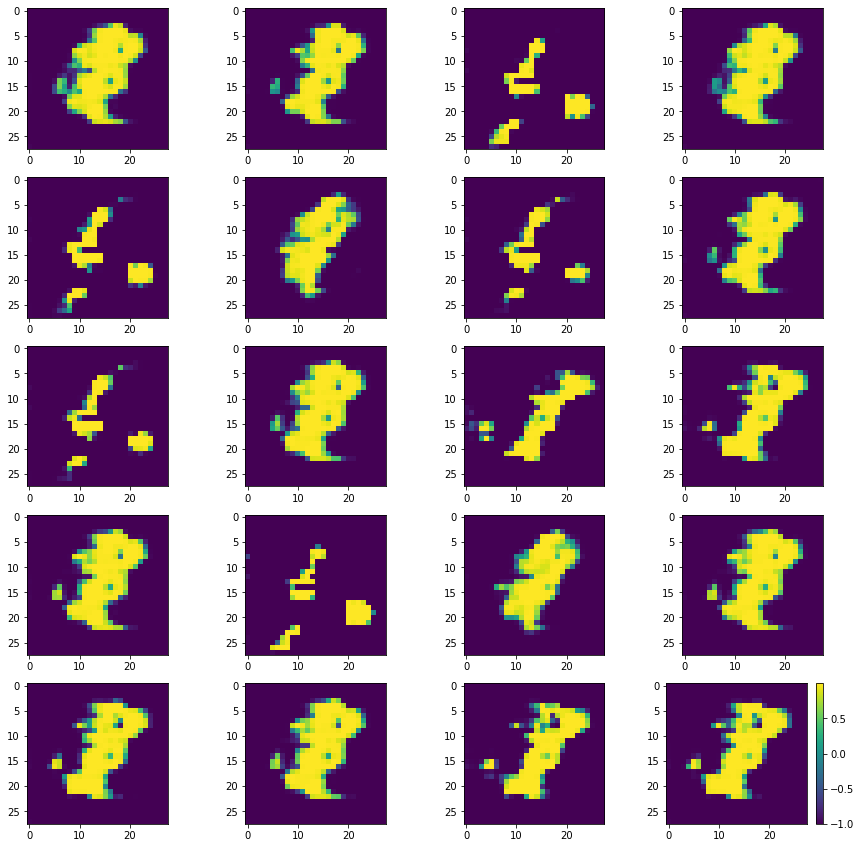

Batch_Num : 152
D_Loss   :   [9.809237480163574, 0.1304149329662323, 9.67882251739502, 0.5, 0.09765625] ;    GAN_Loss   :  [15.217132568359375, 3.210927963256836, 12.006204605102539, 0.0, 0.109375]
Batch_Num : 153
D_Loss   :   [10.059595108032227, 0.13396403193473816, 9.925631523132324, 0.5, 0.1015625] ;    GAN_Loss   :  [14.106008529663086, 2.6748147010803223, 11.431193351745605, 0.0, 0.12890625]
Batch_Num : 154
D_Loss   :   [10.08088207244873, 0.1720736026763916, 9.908808708190918, 0.5, 0.1015625] ;    GAN_Loss   :  [11.805142402648926, 1.6235908269882202, 10.181551933288574, 0.0, 0.109375]
Batch_Num : 155
D_Loss   :   [10.444326400756836, 0.18522901833057404, 10.2590970993042, 0.5, 0.15234375] ;    GAN_Loss   :  [13.088827133178711, 1.8942439556121826, 11.19458293914795, 0.0, 0.15234375]
Batch_Num : 156
D_Loss   :   [9.525067329406738, 0.14176791906356812, 9.383299827575684, 0.498046875, 0.11328125] ;    GAN_Loss   :  [12.249444961547852, 1.6784759759902954, 10.570968627929688, 0.0,

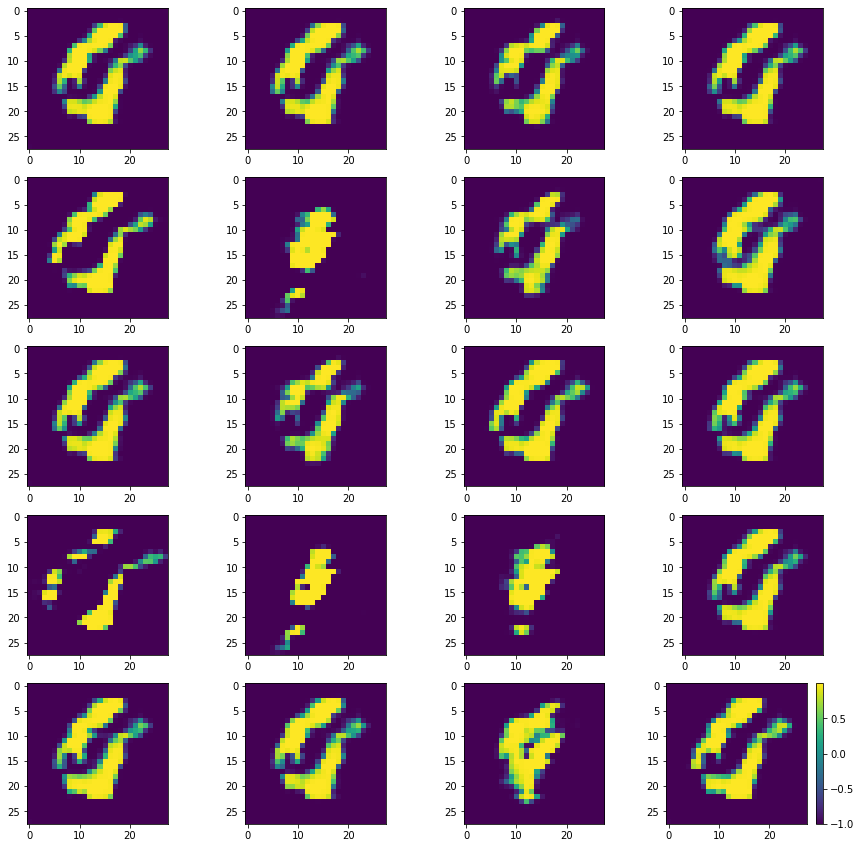

Batch_Num : 167
D_Loss   :   [10.530729293823242, 0.1381973922252655, 10.392532348632812, 0.5, 0.11328125] ;    GAN_Loss   :  [10.634977340698242, 0.766681432723999, 9.868295669555664, 0.0, 0.134765625]
Batch_Num : 168
D_Loss   :   [9.568333625793457, 0.13441389799118042, 9.433919906616211, 0.5, 0.123046875] ;    GAN_Loss   :  [10.756082534790039, 0.73711758852005, 10.018964767456055, 0.0, 0.12890625]
Batch_Num : 169
D_Loss   :   [10.076947212219238, 0.1291591078042984, 9.94778823852539, 0.5, 0.12109375] ;    GAN_Loss   :  [10.518983840942383, 0.6554494500160217, 9.863533973693848, 0.0, 0.1015625]
Batch_Num : 170
D_Loss   :   [10.05440902709961, 0.12895946204662323, 9.92544937133789, 0.5, 0.158203125] ;    GAN_Loss   :  [10.624411582946777, 0.6288375854492188, 9.995573997497559, 0.0, 0.126953125]
Batch_Num : 171
D_Loss   :   [10.403358459472656, 0.13147954642772675, 10.271879196166992, 0.49609375, 0.12890625] ;    GAN_Loss   :  [10.877788543701172, 0.6926167011260986, 10.18517208099365

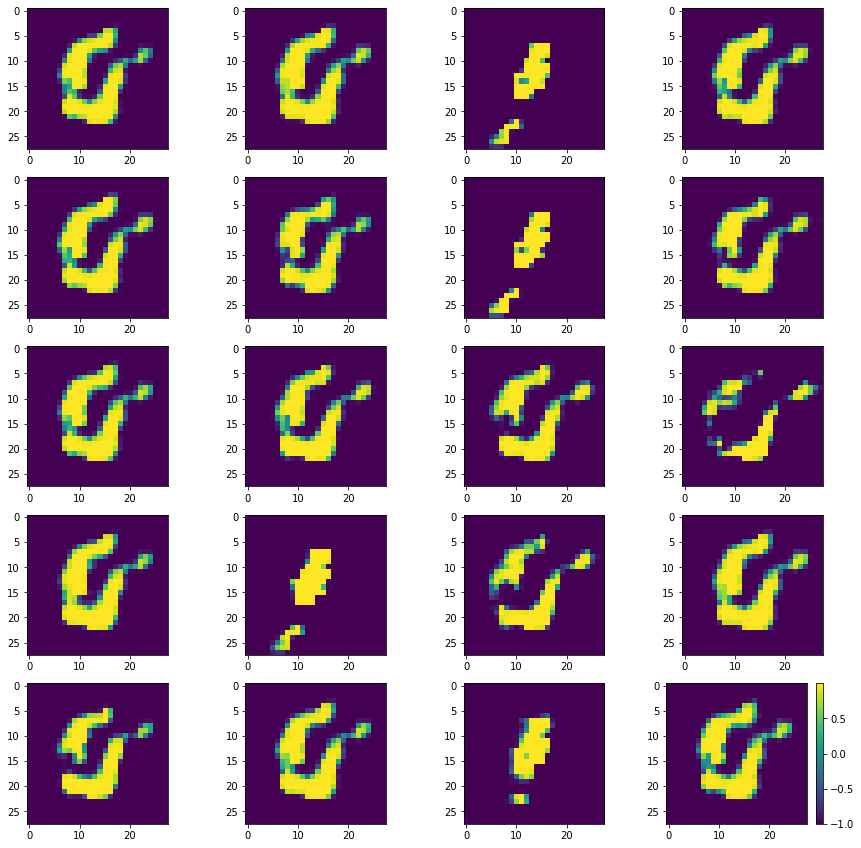

Batch_Num : 182
D_Loss   :   [9.702689170837402, 0.12658049166202545, 9.576108932495117, 0.5, 0.134765625] ;    GAN_Loss   :  [10.47373104095459, 0.5117108821868896, 9.962019920349121, 0.0, 0.125]
Batch_Num : 183
D_Loss   :   [10.351668357849121, 0.12265262752771378, 10.229015350341797, 0.5, 0.125] ;    GAN_Loss   :  [10.699894905090332, 0.481873095035553, 10.218021392822266, 0.0, 0.142578125]
Batch_Num : 184
D_Loss   :   [9.833192825317383, 0.12724457681179047, 9.705947875976562, 0.5, 0.107421875] ;    GAN_Loss   :  [10.838082313537598, 0.5790892839431763, 10.258993148803711, 0.0, 0.13671875]
Batch_Num : 185
D_Loss   :   [9.904499053955078, 0.12438136339187622, 9.780117988586426, 0.5, 0.12890625] ;    GAN_Loss   :  [11.056985855102539, 0.6774678230285645, 10.379518508911133, 0.0, 0.138671875]
Batch_Num : 186
D_Loss   :   [9.510599136352539, 0.1336577832698822, 9.376941680908203, 0.5, 0.109375] ;    GAN_Loss   :  [11.022844314575195, 0.789665937423706, 10.23317813873291, 0.0, 0.1464843

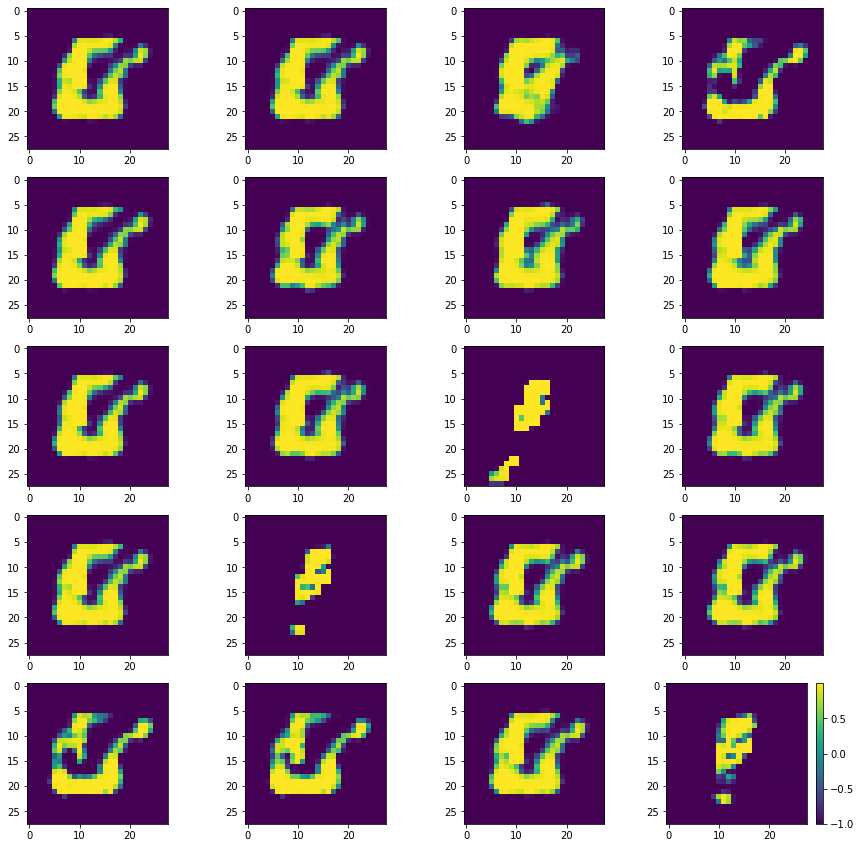

Batch_Num : 197
D_Loss   :   [9.973347663879395, 0.1341574788093567, 9.839190483093262, 0.5, 0.123046875] ;    GAN_Loss   :  [11.112714767456055, 1.119234561920166, 9.99347972869873, 0.0, 0.14453125]
Batch_Num : 198
D_Loss   :   [9.685455322265625, 0.14253593981266022, 9.542919158935547, 0.5, 0.1171875] ;    GAN_Loss   :  [11.934638977050781, 1.1957439184188843, 10.738895416259766, 0.0, 0.138671875]
Batch_Num : 199
D_Loss   :   [10.566950798034668, 0.13406449556350708, 10.432886123657227, 0.5, 0.1171875] ;    GAN_Loss   :  [11.676352500915527, 1.3772332668304443, 10.299118995666504, 0.0, 0.12890625]
Batch_Num : 200
D_Loss   :   [10.136404037475586, 0.12205606698989868, 10.014348030090332, 0.5, 0.134765625] ;    GAN_Loss   :  [11.977540969848633, 1.6036875247955322, 10.37385368347168, 0.0, 0.130859375]
Batch_Num : 201
D_Loss   :   [10.369661331176758, 0.12385327368974686, 10.245807647705078, 0.5, 0.130859375] ;    GAN_Loss   :  [11.971513748168945, 1.6080232858657837, 10.363490104675293

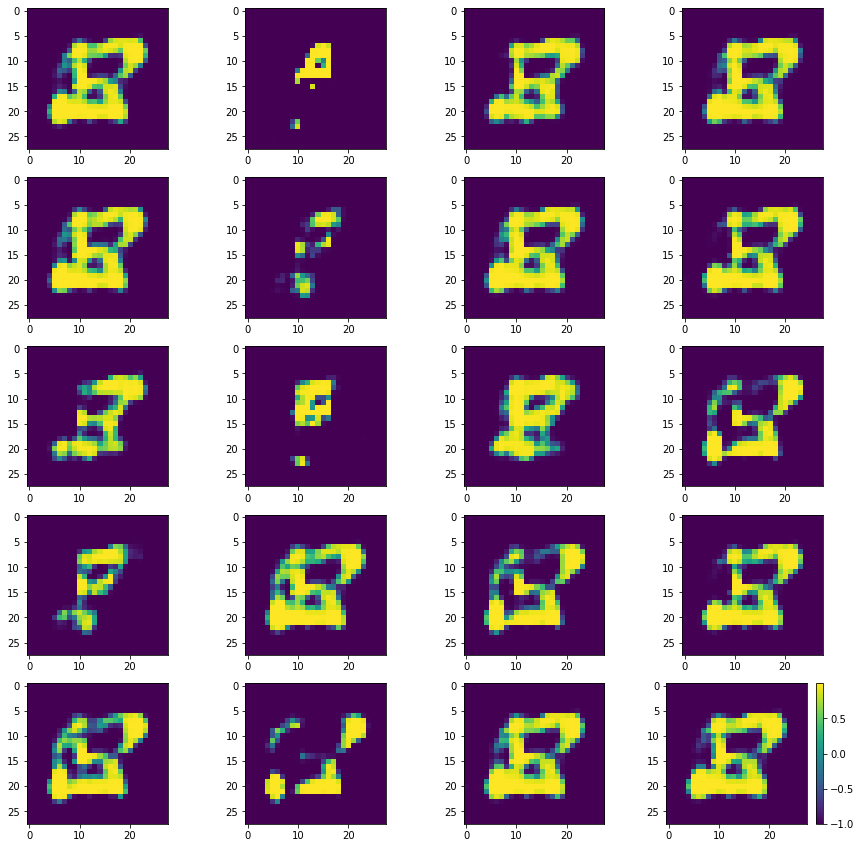

Batch_Num : 212
D_Loss   :   [10.903433799743652, 0.12754899263381958, 10.775884628295898, 0.498046875, 0.140625] ;    GAN_Loss   :  [12.000965118408203, 1.633569359779358, 10.367395401000977, 0.0, 0.119140625]
Batch_Num : 213
D_Loss   :   [9.5941801071167, 0.130143940448761, 9.464035987854004, 0.498046875, 0.138671875] ;    GAN_Loss   :  [11.7333345413208, 1.5101383924484253, 10.223196029663086, 0.0, 0.1328125]
Batch_Num : 214
D_Loss   :   [10.392902374267578, 0.1611429750919342, 10.231759071350098, 0.5, 0.1328125] ;    GAN_Loss   :  [11.693936347961426, 1.461674451828003, 10.232261657714844, 0.0, 0.11328125]
Batch_Num : 215
D_Loss   :   [9.223541259765625, 0.15495002269744873, 9.068591117858887, 0.498046875, 0.10546875] ;    GAN_Loss   :  [12.195027351379395, 2.100144624710083, 10.09488296508789, 0.0, 0.154296875]
Batch_Num : 216
D_Loss   :   [10.445575714111328, 0.15510228276252747, 10.290472984313965, 0.498046875, 0.138671875] ;    GAN_Loss   :  [11.907405853271484, 1.7564792633056

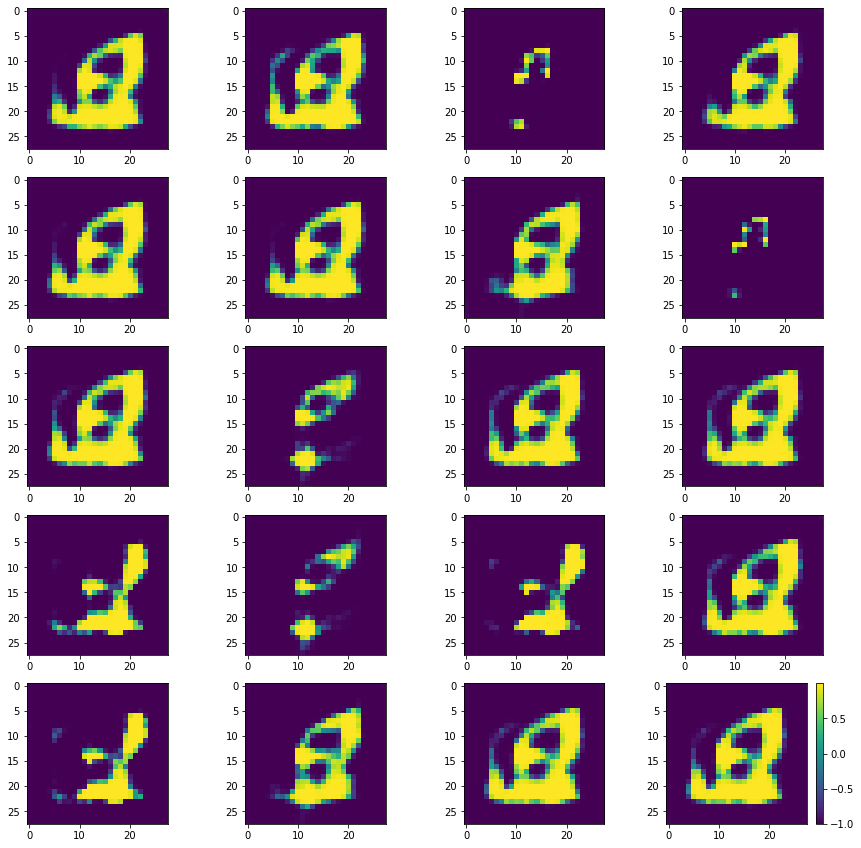

Batch_Num : 227
D_Loss   :   [9.265240669250488, 0.14413580298423767, 9.121105194091797, 0.5, 0.130859375] ;    GAN_Loss   :  [11.595046043395996, 1.5433731079101562, 10.05167293548584, 0.0, 0.138671875]
Batch_Num : 228
D_Loss   :   [10.353368759155273, 0.12418611347675323, 10.229182243347168, 0.5, 0.126953125] ;    GAN_Loss   :  [11.774558067321777, 1.347861409187317, 10.42669677734375, 0.0, 0.09765625]
Batch_Num : 229
D_Loss   :   [9.789172172546387, 0.14298950135707855, 9.646183013916016, 0.5, 0.091796875] ;    GAN_Loss   :  [11.508105278015137, 1.2749383449554443, 10.233166694641113, 0.0, 0.130859375]
Batch_Num : 230
D_Loss   :   [10.107291221618652, 0.13779368996620178, 9.969497680664062, 0.5, 0.11328125] ;    GAN_Loss   :  [11.89955997467041, 1.5777578353881836, 10.321802139282227, 0.0, 0.14453125]
Batch_Num : 231
D_Loss   :   [10.34759521484375, 0.13758215308189392, 10.210013389587402, 0.5, 0.130859375] ;    GAN_Loss   :  [11.74644660949707, 1.5555310249328613, 10.19091606140136

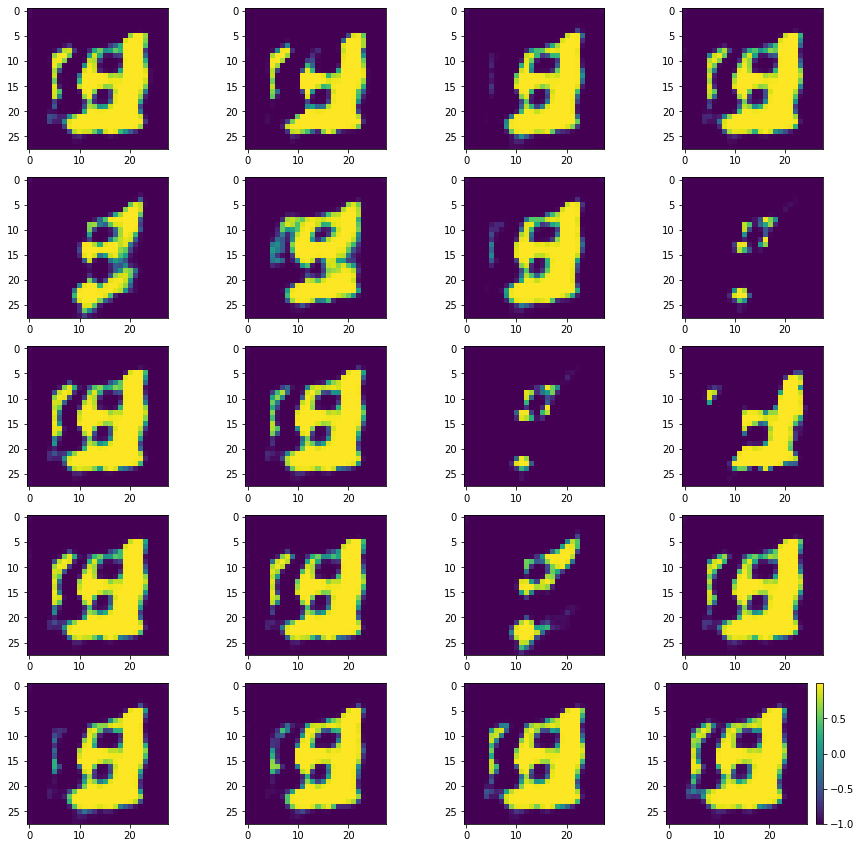

Batch_Num : 2
D_Loss   :   [10.121196746826172, 0.12497130781412125, 9.996225357055664, 0.498046875, 0.11328125] ;    GAN_Loss   :  [15.291444778442383, 3.8273141384124756, 11.464130401611328, 0.0, 0.103515625]
Batch_Num : 3
D_Loss   :   [10.178807258605957, 0.14484967291355133, 10.033957481384277, 0.498046875, 0.076171875] ;    GAN_Loss   :  [15.678121566772461, 3.4834935665130615, 12.19462776184082, 0.0, 0.078125]
Batch_Num : 4
D_Loss   :   [10.323224067687988, 0.12272107601165771, 10.2005033493042, 0.5, 0.078125] ;    GAN_Loss   :  [13.932916641235352, 3.1431632041931152, 10.789753913879395, 0.0, 0.087890625]
Batch_Num : 5
D_Loss   :   [10.229179382324219, 0.16719967126846313, 10.061979293823242, 0.498046875, 0.091796875] ;    GAN_Loss   :  [13.487327575683594, 2.720184087753296, 10.767143249511719, 0.0, 0.08203125]
Batch_Num : 6
D_Loss   :   [10.492505073547363, 0.1433766931295395, 10.349128723144531, 0.5, 0.099609375] ;    GAN_Loss   :  [17.254528045654297, 4.105469226837158, 13.1

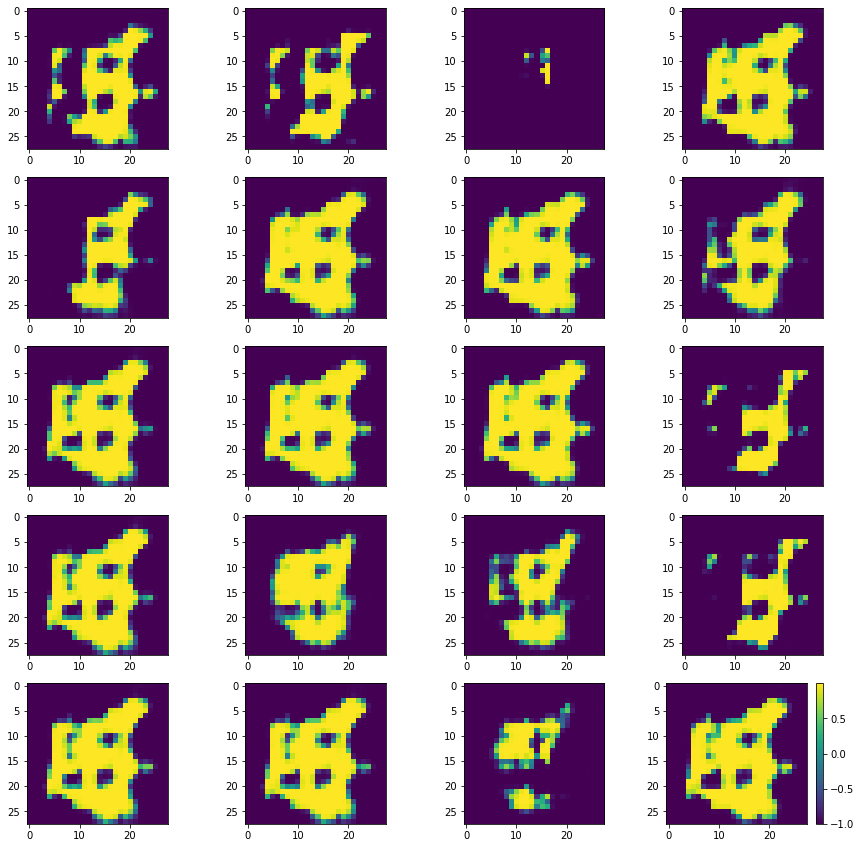

Batch_Num : 17
D_Loss   :   [9.789454460144043, 0.13217605650424957, 9.657278060913086, 0.5, 0.0859375] ;    GAN_Loss   :  [16.730083465576172, 4.619807243347168, 12.11027717590332, 0.0, 0.095703125]
Batch_Num : 18
D_Loss   :   [9.927382469177246, 0.1261342316865921, 9.801248550415039, 0.5, 0.095703125] ;    GAN_Loss   :  [16.850421905517578, 4.657791614532471, 12.192630767822266, 0.0, 0.111328125]
Batch_Num : 19
D_Loss   :   [10.000731468200684, 0.13165169954299927, 9.86907958984375, 0.5, 0.091796875] ;    GAN_Loss   :  [16.8337459564209, 4.908968448638916, 11.92477798461914, 0.0, 0.09375]
Batch_Num : 20
D_Loss   :   [9.831193923950195, 0.13519328832626343, 9.696001052856445, 0.5, 0.103515625] ;    GAN_Loss   :  [17.40658187866211, 5.158055782318115, 12.248525619506836, 0.0, 0.08984375]
Batch_Num : 21
D_Loss   :   [9.673124313354492, 0.13304834067821503, 9.54007625579834, 0.5, 0.09375] ;    GAN_Loss   :  [18.128253936767578, 5.89492130279541, 12.233332633972168, 0.0, 0.095703125]
Batc

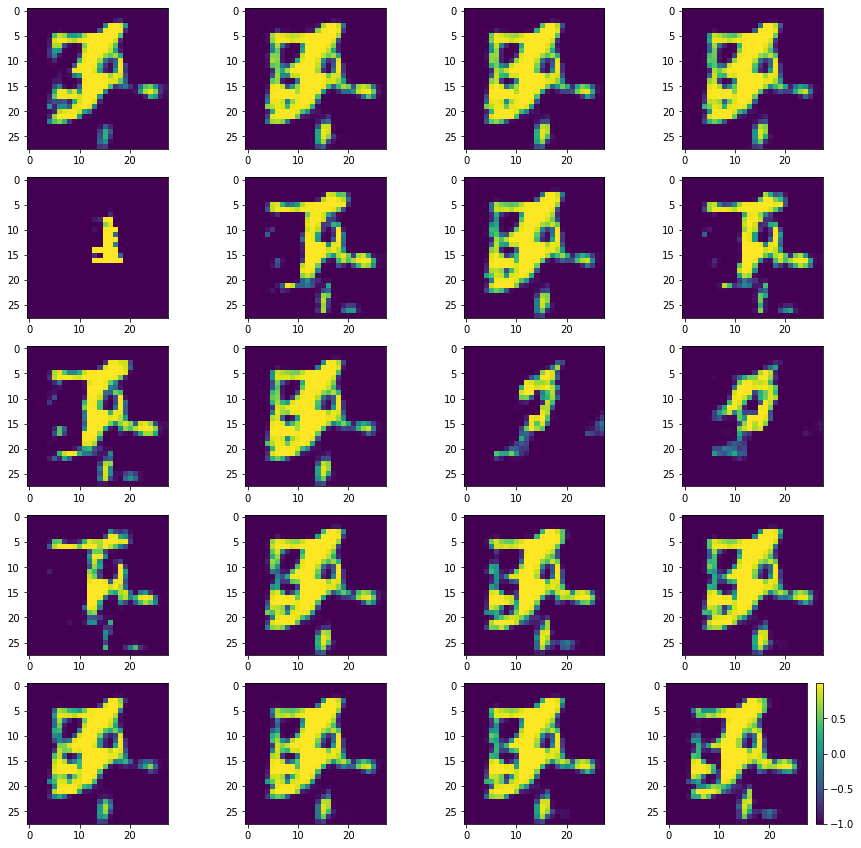

Batch_Num : 32
D_Loss   :   [9.761995315551758, 0.166105255484581, 9.595890045166016, 0.49609375, 0.06640625] ;    GAN_Loss   :  [17.30304527282715, 4.454060077667236, 12.84898567199707, 0.0, 0.087890625]
Batch_Num : 33
D_Loss   :   [10.32710075378418, 0.16162964701652527, 10.165471076965332, 0.490234375, 0.125] ;    GAN_Loss   :  [20.34465217590332, 5.169917583465576, 15.174734115600586, 0.0, 0.109375]
Batch_Num : 34
D_Loss   :   [10.409430503845215, 0.1767987310886383, 10.23263168334961, 0.490234375, 0.1171875] ;    GAN_Loss   :  [18.172897338867188, 4.882608890533447, 13.290287971496582, 0.0, 0.11328125]
Batch_Num : 35
D_Loss   :   [9.600712776184082, 0.13711324334144592, 9.46359920501709, 0.5, 0.109375] ;    GAN_Loss   :  [18.709190368652344, 5.116206169128418, 13.59298324584961, 0.0, 0.10546875]
Batch_Num : 36
D_Loss   :   [9.67490291595459, 0.13237789273262024, 9.542525291442871, 0.5, 0.126953125] ;    GAN_Loss   :  [17.895505905151367, 4.84905481338501, 13.0464506149292, 0.0, 0.

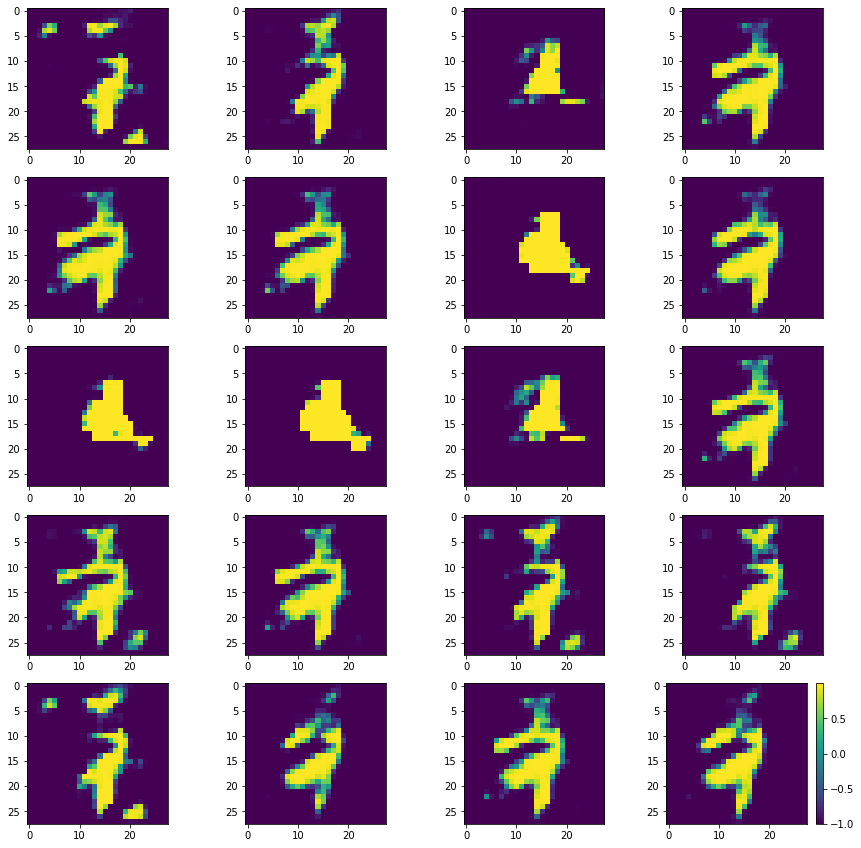

Batch_Num : 47
D_Loss   :   [10.7214937210083, 0.19054323434829712, 10.530950546264648, 0.48828125, 0.091796875] ;    GAN_Loss   :  [13.932354927062988, 1.683901071548462, 12.248454093933105, 0.0, 0.095703125]
Batch_Num : 48
D_Loss   :   [10.169499397277832, 0.15520158410072327, 10.014297485351562, 0.5, 0.1015625] ;    GAN_Loss   :  [12.08128547668457, 1.353195309638977, 10.728090286254883, 0.0, 0.083984375]
Batch_Num : 49
D_Loss   :   [10.065229415893555, 0.1476113200187683, 9.917617797851562, 0.5, 0.09765625] ;    GAN_Loss   :  [12.74439811706543, 1.8797307014465332, 10.864666938781738, 0.0, 0.09765625]
Batch_Num : 50
D_Loss   :   [9.768657684326172, 0.13849830627441406, 9.630159378051758, 0.5, 0.099609375] ;    GAN_Loss   :  [13.352340698242188, 2.1769728660583496, 11.175368309020996, 0.0, 0.095703125]
Batch_Num : 51
D_Loss   :   [10.429417610168457, 0.1534976214170456, 10.275919914245605, 0.5, 0.099609375] ;    GAN_Loss   :  [12.843039512634277, 1.968814492225647, 10.87422466278076

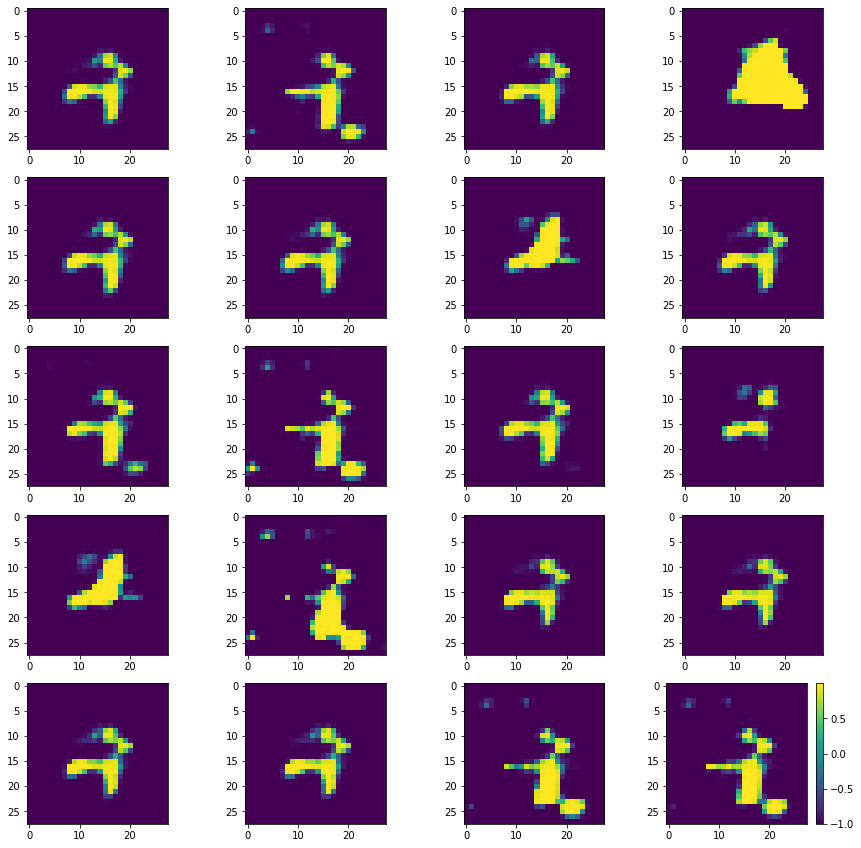

Batch_Num : 62
D_Loss   :   [9.778030395507812, 0.14612948894500732, 9.631900787353516, 0.5, 0.08984375] ;    GAN_Loss   :  [13.71151065826416, 2.816497564315796, 10.895012855529785, 0.0, 0.11328125]
Batch_Num : 63
D_Loss   :   [10.047765731811523, 0.15377451479434967, 9.893991470336914, 0.5, 0.095703125] ;    GAN_Loss   :  [14.871925354003906, 3.53139066696167, 11.340535163879395, 0.0, 0.111328125]
Batch_Num : 64
D_Loss   :   [10.03315544128418, 0.15467038750648499, 9.878484725952148, 0.5, 0.08984375] ;    GAN_Loss   :  [14.972871780395508, 3.776275634765625, 11.196596145629883, 0.0, 0.09765625]
Batch_Num : 65
D_Loss   :   [10.150390625, 0.14107964932918549, 10.009310722351074, 0.498046875, 0.095703125] ;    GAN_Loss   :  [17.287439346313477, 5.6476287841796875, 11.639810562133789, 0.0, 0.107421875]
Batch_Num : 66
D_Loss   :   [10.803552627563477, 0.14376108348369598, 10.659791946411133, 0.5, 0.107421875] ;    GAN_Loss   :  [17.81118392944336, 6.032957553863525, 11.778225898742676, 0.

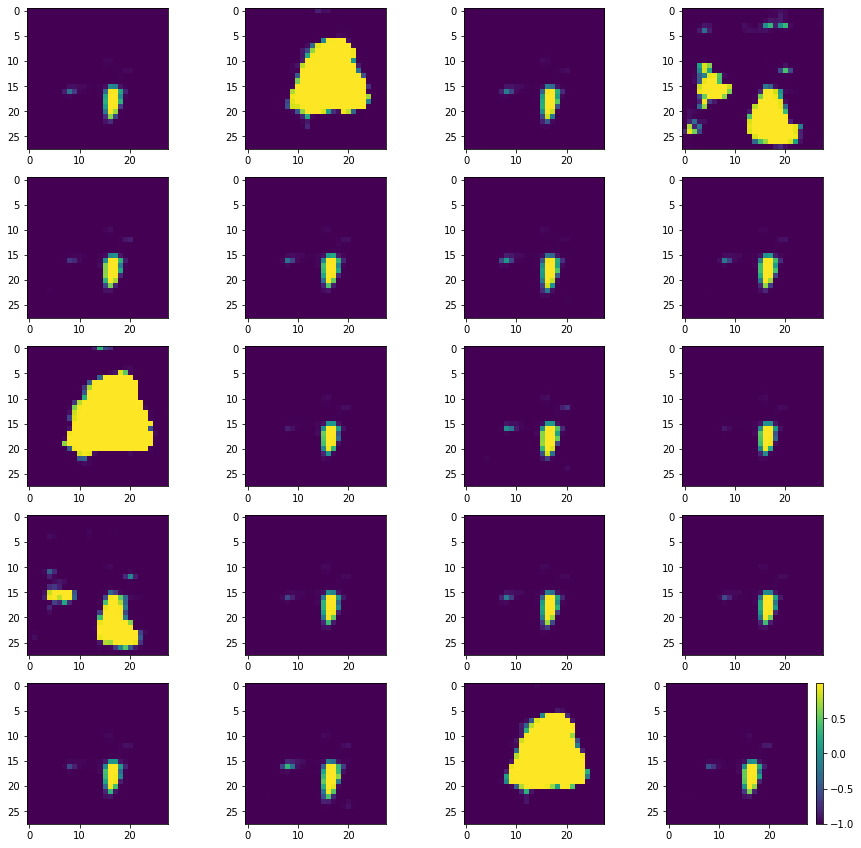

Batch_Num : 77
D_Loss   :   [10.047038078308105, 0.13273079693317413, 9.914307594299316, 0.5, 0.0859375] ;    GAN_Loss   :  [25.079687118530273, 11.885879516601562, 13.193807601928711, 0.0, 0.1015625]
Batch_Num : 78
D_Loss   :   [9.684796333312988, 0.1218097135424614, 9.562986373901367, 0.5, 0.095703125] ;    GAN_Loss   :  [28.48706817626953, 14.660128593444824, 13.826939582824707, 0.0, 0.1015625]
Batch_Num : 79
D_Loss   :   [10.465641021728516, 0.12437011301517487, 10.341270446777344, 0.5, 0.091796875] ;    GAN_Loss   :  [28.77057647705078, 14.161704063415527, 14.60887336730957, 0.0, 0.091796875]
Batch_Num : 80
D_Loss   :   [10.013387680053711, 0.12796957790851593, 9.885417938232422, 0.5, 0.1171875] ;    GAN_Loss   :  [26.858932495117188, 13.474678039550781, 13.38425350189209, 0.0, 0.130859375]
Batch_Num : 81
D_Loss   :   [10.2426118850708, 0.12511709332466125, 10.117494583129883, 0.5, 0.083984375] ;    GAN_Loss   :  [26.626632690429688, 12.65492057800293, 13.971712112426758, 0.0, 0.1

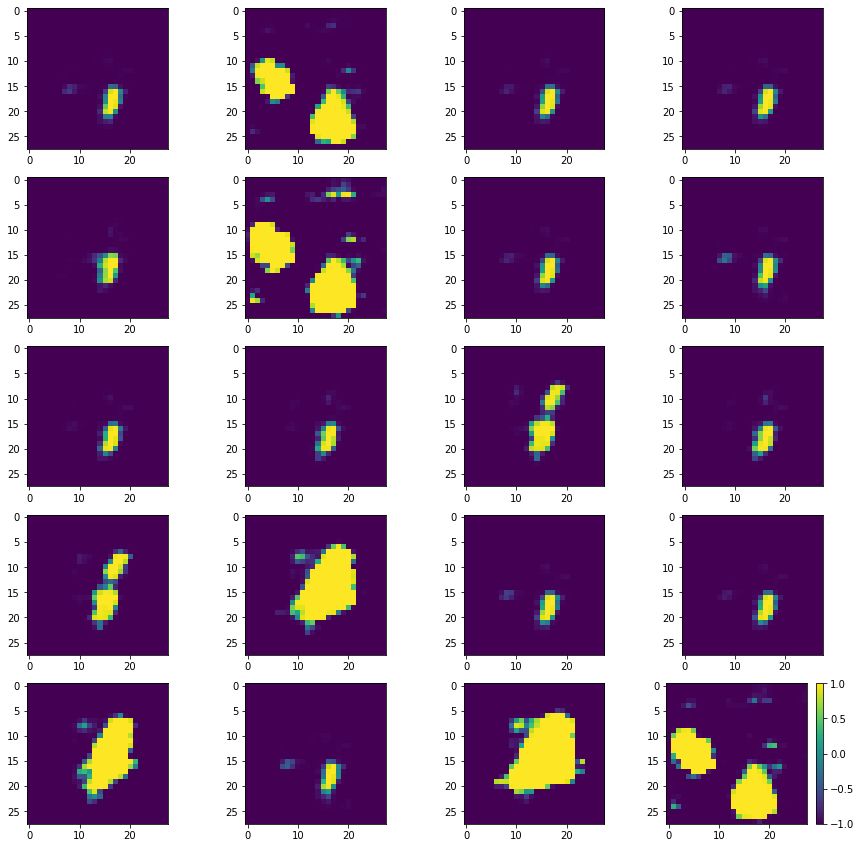

Batch_Num : 92
D_Loss   :   [10.138435363769531, 0.1239788606762886, 10.014456748962402, 0.5, 0.119140625] ;    GAN_Loss   :  [33.84504699707031, 18.1213436126709, 15.723703384399414, 0.0, 0.09375]
Batch_Num : 93
D_Loss   :   [10.570595741271973, 0.1178966835141182, 10.452698707580566, 0.5, 0.125] ;    GAN_Loss   :  [33.65988540649414, 18.064346313476562, 15.595539093017578, 0.0, 0.146484375]
Batch_Num : 94
D_Loss   :   [9.989147186279297, 0.12314550578594208, 9.866002082824707, 0.5, 0.091796875] ;    GAN_Loss   :  [33.05030059814453, 17.288394927978516, 15.761903762817383, 0.0, 0.12109375]
Batch_Num : 95
D_Loss   :   [10.178742408752441, 0.13174322247505188, 10.046998977661133, 0.498046875, 0.109375] ;    GAN_Loss   :  [32.01557540893555, 16.219379425048828, 15.796195983886719, 0.0, 0.09765625]
Batch_Num : 96
D_Loss   :   [9.723374366760254, 0.12267642468214035, 9.60069751739502, 0.5, 0.107421875] ;    GAN_Loss   :  [33.020809173583984, 17.3231143951416, 15.6976957321167, 0.0, 0.125]


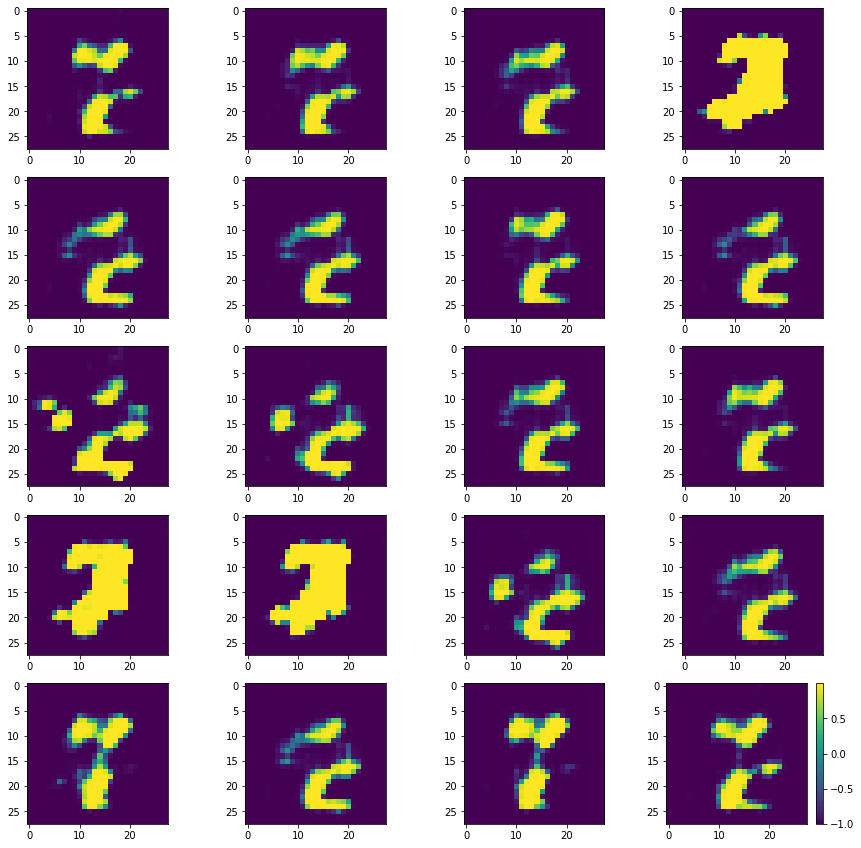

Batch_Num : 107
D_Loss   :   [10.051074028015137, 0.16668111085891724, 9.884392738342285, 0.4921875, 0.107421875] ;    GAN_Loss   :  [25.713825225830078, 8.6109037399292, 17.102922439575195, 0.0, 0.078125]
Batch_Num : 108
D_Loss   :   [9.477121353149414, 0.16857700049877167, 9.308544158935547, 0.494140625, 0.09375] ;    GAN_Loss   :  [23.93570327758789, 7.572649955749512, 16.363054275512695, 0.0, 0.064453125]
Batch_Num : 109
D_Loss   :   [9.73428726196289, 0.17673727869987488, 9.557550430297852, 0.498046875, 0.087890625] ;    GAN_Loss   :  [19.87577247619629, 5.3622894287109375, 14.513483047485352, 0.0, 0.0703125]
Batch_Num : 110
D_Loss   :   [10.533263206481934, 0.2598887085914612, 10.273374557495117, 0.4765625, 0.083984375] ;    GAN_Loss   :  [18.981674194335938, 5.300566673278809, 13.681108474731445, 0.0, 0.068359375]
Batch_Num : 111
D_Loss   :   [9.648017883300781, 0.2295514941215515, 9.418466567993164, 0.49609375, 0.099609375] ;    GAN_Loss   :  [24.608469009399414, 7.660390853881

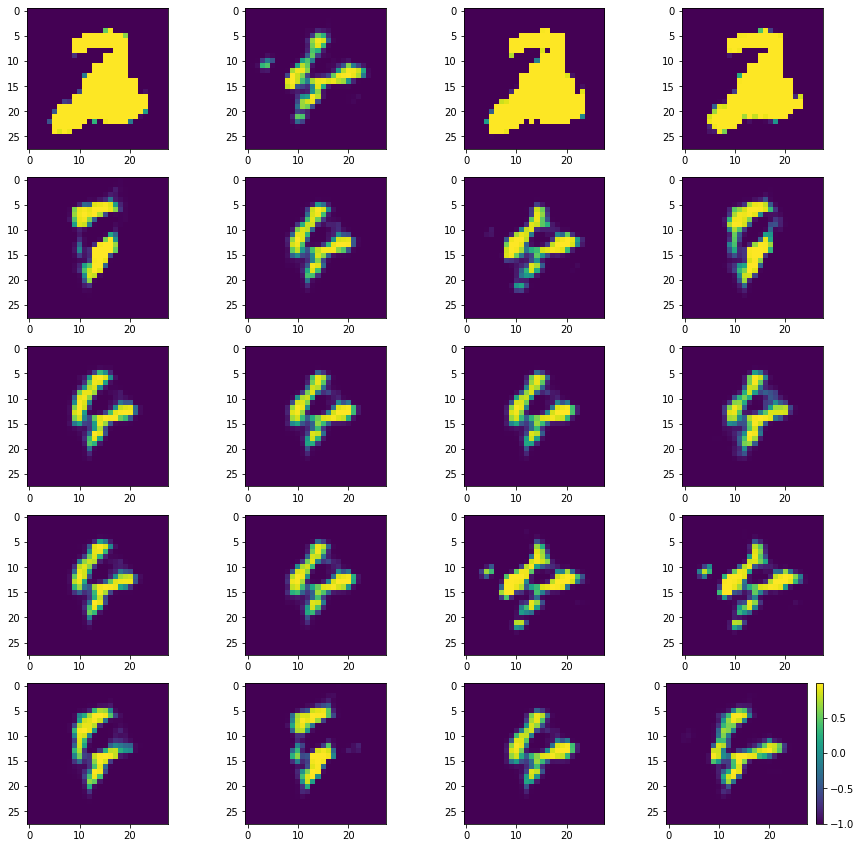

Batch_Num : 122
D_Loss   :   [10.58088493347168, 0.1726296842098236, 10.408255577087402, 0.5, 0.1328125] ;    GAN_Loss   :  [14.828351974487305, 4.699213027954102, 10.129138946533203, 0.0, 0.06640625]
Batch_Num : 123
D_Loss   :   [9.989346504211426, 0.2050626277923584, 9.784283638000488, 0.5, 0.1015625] ;    GAN_Loss   :  [17.629140853881836, 7.223594665527344, 10.405546188354492, 0.0, 0.09375]
Batch_Num : 124
D_Loss   :   [10.287766456604004, 0.17257119715213776, 10.115195274353027, 0.48828125, 0.083984375] ;    GAN_Loss   :  [16.412113189697266, 6.189026832580566, 10.223085403442383, 0.0, 0.076171875]
Batch_Num : 125
D_Loss   :   [10.483521461486816, 0.1738264262676239, 10.30969524383545, 0.5, 0.091796875] ;    GAN_Loss   :  [18.102724075317383, 7.2442708015441895, 10.858452796936035, 0.0, 0.083984375]
Batch_Num : 126
D_Loss   :   [10.410543441772461, 0.166545107960701, 10.243998527526855, 0.498046875, 0.083984375] ;    GAN_Loss   :  [17.198368072509766, 7.057833671569824, 10.1405344

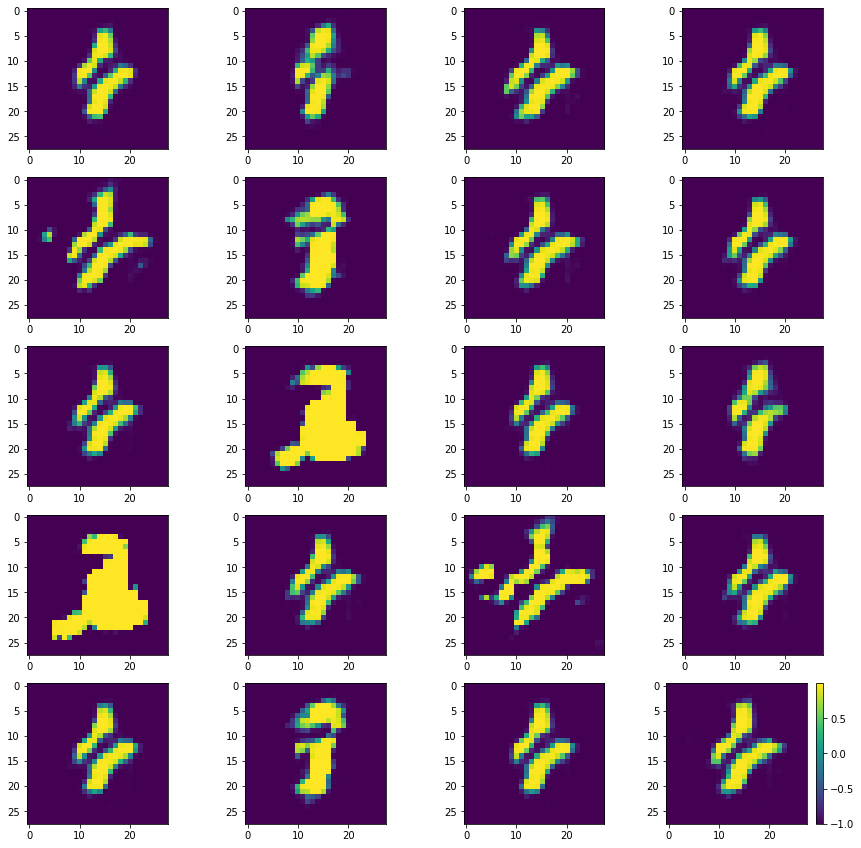

Batch_Num : 137
D_Loss   :   [10.813937187194824, 0.18855634331703186, 10.625380516052246, 0.5, 0.08203125] ;    GAN_Loss   :  [15.325997352600098, 5.40031623840332, 9.925681114196777, 0.0, 0.08203125]
Batch_Num : 138
D_Loss   :   [10.05627155303955, 0.16078510880470276, 9.895486831665039, 0.5, 0.095703125] ;    GAN_Loss   :  [15.609007835388184, 5.054729461669922, 10.554278373718262, 0.0, 0.0859375]
Batch_Num : 139
D_Loss   :   [9.978864669799805, 0.17037081718444824, 9.808493614196777, 0.498046875, 0.07421875] ;    GAN_Loss   :  [14.7200345993042, 4.575779914855957, 10.144254684448242, 0.0, 0.083984375]
Batch_Num : 140
D_Loss   :   [9.555015563964844, 0.1607104241847992, 9.394305229187012, 0.5, 0.11328125] ;    GAN_Loss   :  [14.28461742401123, 4.0599365234375, 10.22468090057373, 0.0, 0.083984375]
Batch_Num : 141
D_Loss   :   [10.122568130493164, 0.15382923185825348, 9.968738555908203, 0.498046875, 0.09765625] ;    GAN_Loss   :  [13.892853736877441, 3.4296839237213135, 10.46317005157

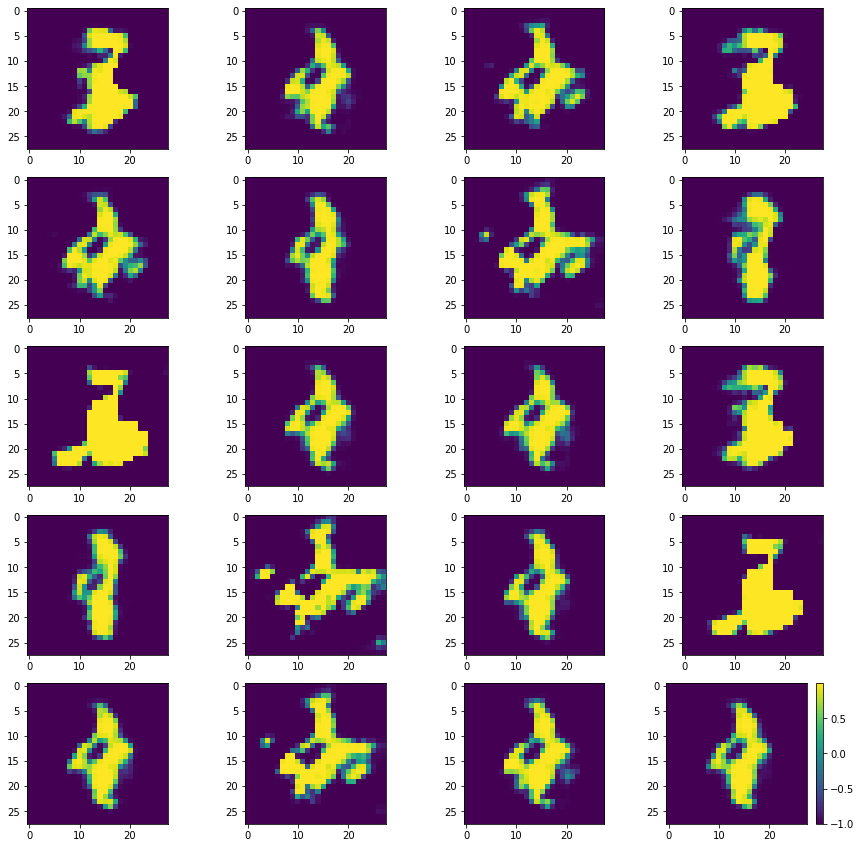

Batch_Num : 152
D_Loss   :   [9.824257850646973, 0.15414099395275116, 9.670116424560547, 0.5, 0.087890625] ;    GAN_Loss   :  [11.008870124816895, 1.070517897605896, 9.938352584838867, 0.0, 0.078125]
Batch_Num : 153
D_Loss   :   [10.087876319885254, 0.1622878611087799, 9.925588607788086, 0.5, 0.08984375] ;    GAN_Loss   :  [11.126940727233887, 0.884636640548706, 10.242303848266602, 0.0, 0.052734375]
Batch_Num : 154
D_Loss   :   [10.096672058105469, 0.20534636080265045, 9.891325950622559, 0.498046875, 0.107421875] ;    GAN_Loss   :  [10.706899642944336, 1.1403520107269287, 9.566547393798828, 0.0, 0.056640625]
Batch_Num : 155
D_Loss   :   [10.454171180725098, 0.20210573077201843, 10.252065658569336, 0.494140625, 0.099609375] ;    GAN_Loss   :  [11.697562217712402, 1.5468416213989258, 10.150720596313477, 0.0, 0.06640625]
Batch_Num : 156
D_Loss   :   [9.521960258483887, 0.15340150892734528, 9.368558883666992, 0.5, 0.107421875] ;    GAN_Loss   :  [10.929549217224121, 1.0511239767074585, 9.8

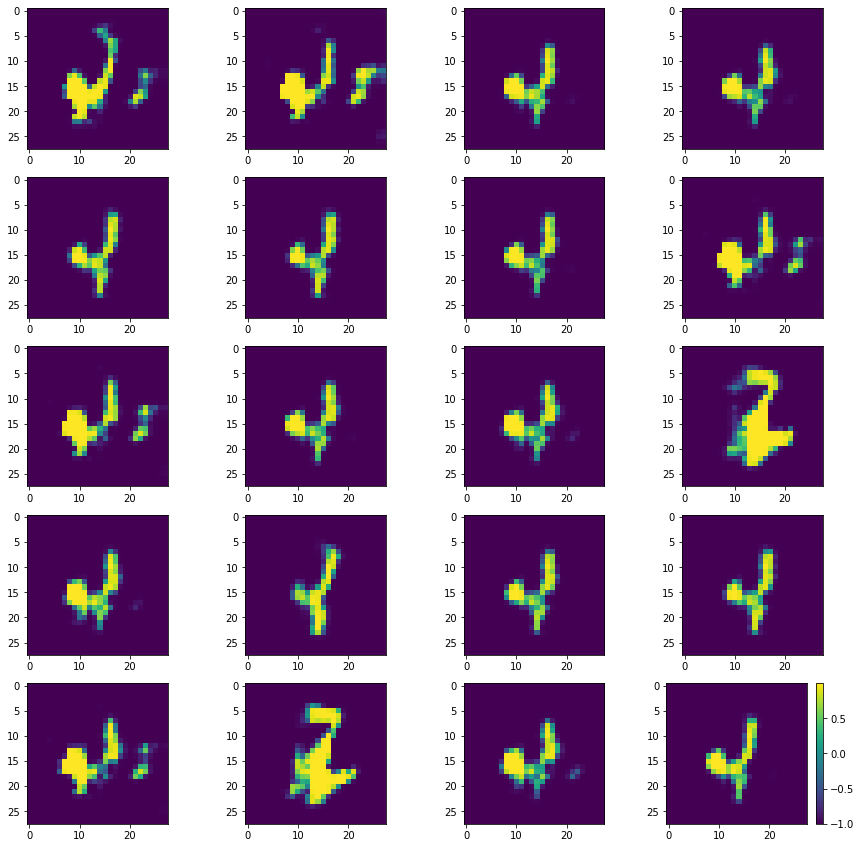

Batch_Num : 167
D_Loss   :   [10.591115951538086, 0.193848118185997, 10.397268295288086, 0.5, 0.083984375] ;    GAN_Loss   :  [15.550796508789062, 5.046193599700928, 10.504602432250977, 0.0, 0.10546875]
Batch_Num : 168
D_Loss   :   [9.591983795166016, 0.1558871865272522, 9.43609619140625, 0.5, 0.1171875] ;    GAN_Loss   :  [15.688642501831055, 5.138183116912842, 10.550458908081055, 0.0, 0.10546875]
Batch_Num : 169
D_Loss   :   [10.113486289978027, 0.16416797041893005, 9.949317932128906, 0.498046875, 0.087890625] ;    GAN_Loss   :  [16.46014976501465, 5.710653781890869, 10.749496459960938, 0.0, 0.08984375]
Batch_Num : 170
D_Loss   :   [10.073934555053711, 0.14556923508644104, 9.928365707397461, 0.498046875, 0.115234375] ;    GAN_Loss   :  [17.510093688964844, 6.200469017028809, 11.309625625610352, 0.0, 0.09765625]
Batch_Num : 171
D_Loss   :   [10.435589790344238, 0.16567130386829376, 10.269918441772461, 0.498046875, 0.134765625] ;    GAN_Loss   :  [17.40262222290039, 6.255958557128906, 

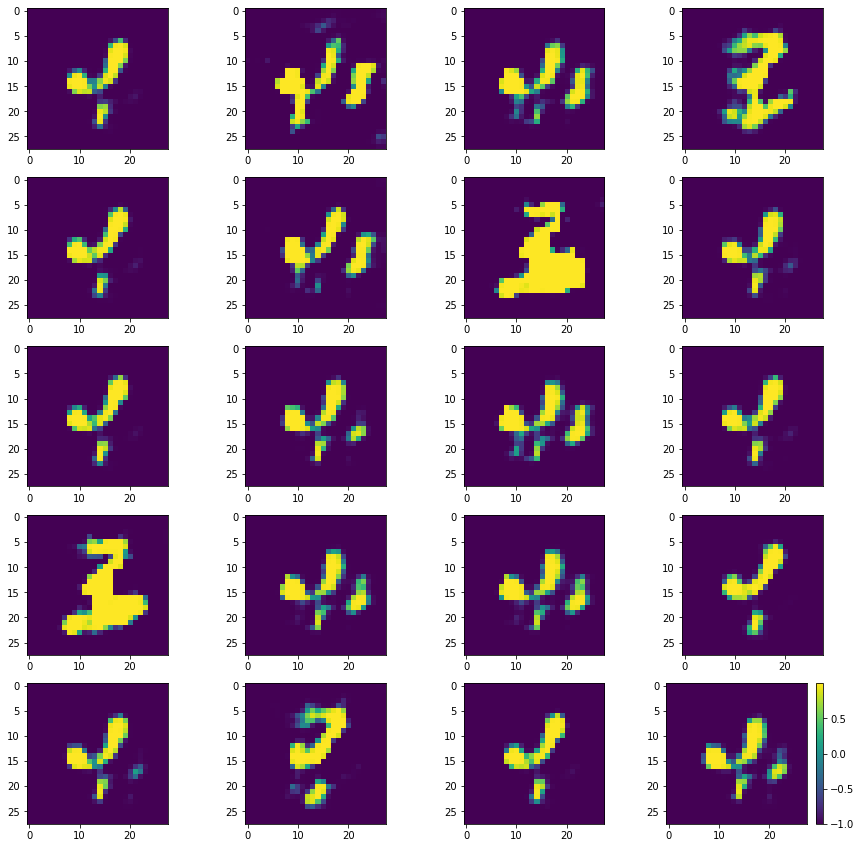

Batch_Num : 182
D_Loss   :   [9.71682071685791, 0.14156724512577057, 9.5752534866333, 0.5, 0.109375] ;    GAN_Loss   :  [16.386781692504883, 5.228582859039307, 11.158198356628418, 0.0, 0.109375]
Batch_Num : 183
D_Loss   :   [10.373761177062988, 0.1458645761013031, 10.227896690368652, 0.5, 0.099609375] ;    GAN_Loss   :  [17.02619171142578, 5.480550289154053, 11.54564094543457, 0.0, 0.123046875]
Batch_Num : 184
D_Loss   :   [9.841594696044922, 0.13625401258468628, 9.705340385437012, 0.5, 0.099609375] ;    GAN_Loss   :  [17.376977920532227, 5.6375298500061035, 11.739447593688965, 0.0, 0.10546875]
Batch_Num : 185
D_Loss   :   [9.917808532714844, 0.13721077144145966, 9.780597686767578, 0.5, 0.12890625] ;    GAN_Loss   :  [17.85421371459961, 5.891017436981201, 11.963196754455566, 0.0, 0.095703125]
Batch_Num : 186
D_Loss   :   [9.504010200500488, 0.13605612516403198, 9.36795425415039, 0.5, 0.115234375] ;    GAN_Loss   :  [16.240543365478516, 5.188197135925293, 11.052345275878906, 0.0, 0.1035

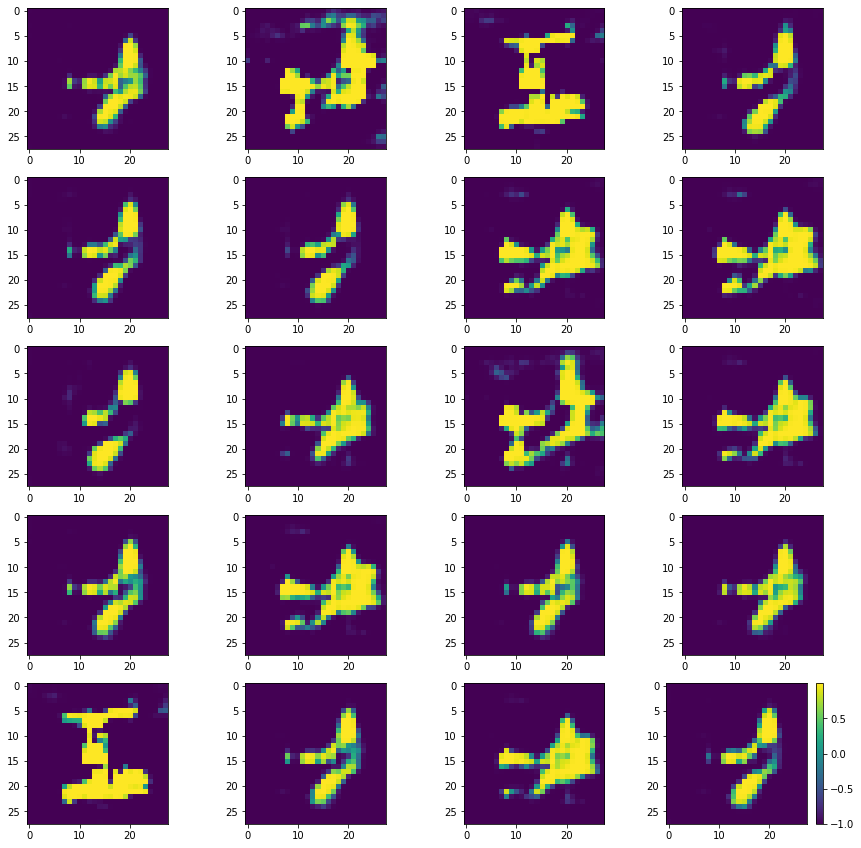

Batch_Num : 197
D_Loss   :   [9.979719161987305, 0.1425442099571228, 9.837175369262695, 0.498046875, 0.099609375] ;    GAN_Loss   :  [12.109819412231445, 1.8479866981506348, 10.261833190917969, 0.0, 0.109375]
Batch_Num : 198
D_Loss   :   [9.685914993286133, 0.14224013686180115, 9.54367446899414, 0.5, 0.09765625] ;    GAN_Loss   :  [12.278441429138184, 2.0278444290161133, 10.25059700012207, 0.0, 0.109375]
Batch_Num : 199
D_Loss   :   [10.597872734069824, 0.16035106778144836, 10.437521934509277, 0.498046875, 0.12109375] ;    GAN_Loss   :  [13.749072074890137, 2.8834924697875977, 10.865579605102539, 0.0, 0.08203125]
Batch_Num : 200
D_Loss   :   [10.177186965942383, 0.16170941293239594, 10.015477180480957, 0.49609375, 0.109375] ;    GAN_Loss   :  [14.902366638183594, 4.000950336456299, 10.901415824890137, 0.0, 0.09765625]
Batch_Num : 201
D_Loss   :   [10.384122848510742, 0.137827530503273, 10.246294975280762, 0.5, 0.095703125] ;    GAN_Loss   :  [15.634740829467773, 4.19427490234375, 11.44

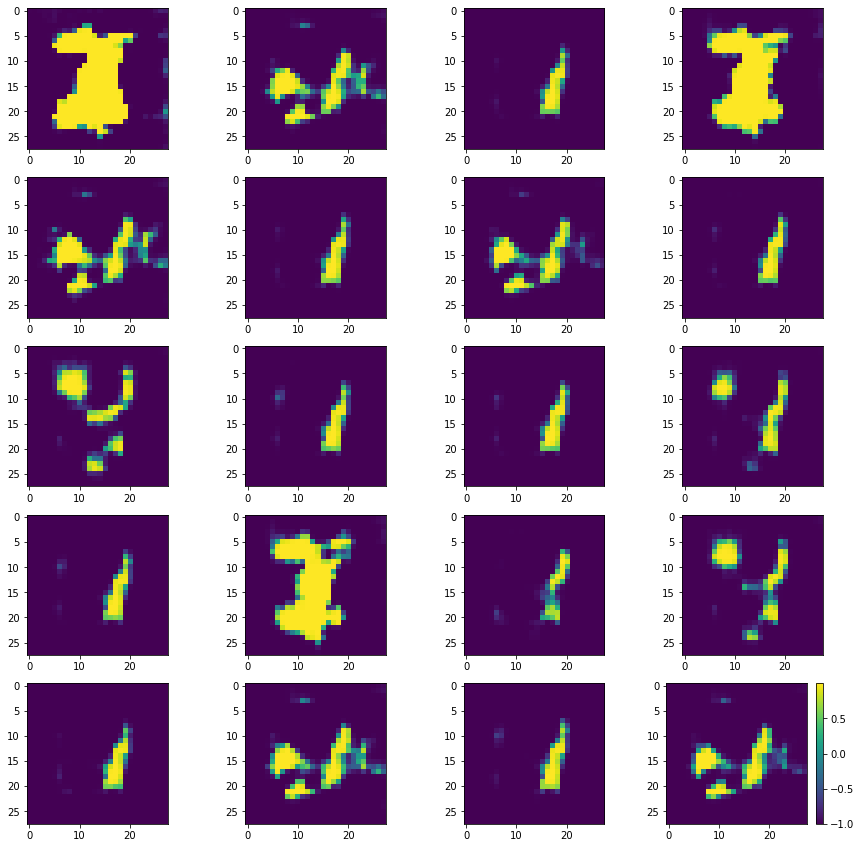

Batch_Num : 212
D_Loss   :   [10.934076309204102, 0.15658552944660187, 10.777490615844727, 0.494140625, 0.1015625] ;    GAN_Loss   :  [20.50271987915039, 8.794157028198242, 11.708563804626465, 0.0, 0.076171875]
Batch_Num : 213
D_Loss   :   [9.640974044799805, 0.15967199206352234, 9.481302261352539, 0.5, 0.111328125] ;    GAN_Loss   :  [22.77171516418457, 11.06597900390625, 11.70573616027832, 0.0, 0.09765625]
Batch_Num : 214
D_Loss   :   [10.386544227600098, 0.1580326408147812, 10.228511810302734, 0.490234375, 0.1171875] ;    GAN_Loss   :  [22.57298469543457, 10.417743682861328, 12.155241012573242, 0.0, 0.091796875]
Batch_Num : 215
D_Loss   :   [9.24502944946289, 0.16959920525550842, 9.075429916381836, 0.494140625, 0.09765625] ;    GAN_Loss   :  [19.49283790588379, 7.972364902496338, 11.520472526550293, 0.0, 0.123046875]
Batch_Num : 216
D_Loss   :   [10.46037483215332, 0.17042960226535797, 10.289945602416992, 0.5, 0.134765625] ;    GAN_Loss   :  [17.825504302978516, 6.533915042877197, 1

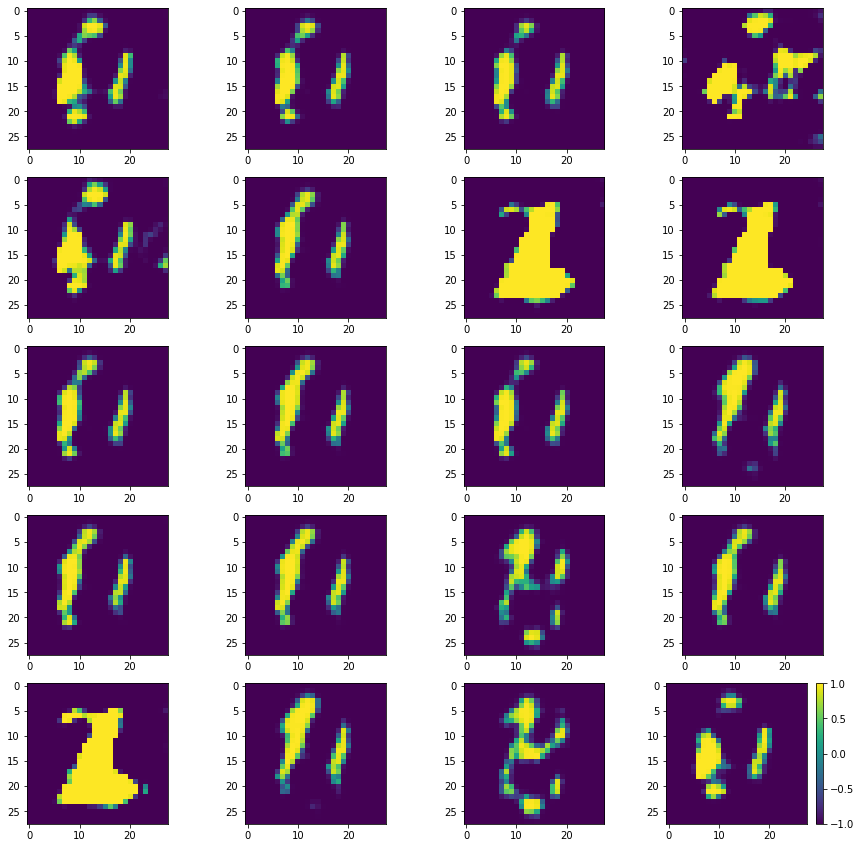

Batch_Num : 227
D_Loss   :   [9.331390380859375, 0.19870568811893463, 9.132684707641602, 0.498046875, 0.1015625] ;    GAN_Loss   :  [15.046344757080078, 4.73135232925415, 10.31499195098877, 0.0, 0.125]
Batch_Num : 228
D_Loss   :   [10.420196533203125, 0.1885952204465866, 10.23160171508789, 0.486328125, 0.0859375] ;    GAN_Loss   :  [15.646738052368164, 4.663934230804443, 10.982803344726562, 0.0, 0.041015625]
Batch_Num : 229
D_Loss   :   [9.843587875366211, 0.1836361140012741, 9.659952163696289, 0.5, 0.078125] ;    GAN_Loss   :  [15.425580024719238, 4.972792625427246, 10.452787399291992, 0.0, 0.0625]
Batch_Num : 230
D_Loss   :   [10.11767292022705, 0.14162153005599976, 9.976051330566406, 0.498046875, 0.076171875] ;    GAN_Loss   :  [16.25721549987793, 5.483839511871338, 10.77337646484375, 0.0, 0.08203125]
Batch_Num : 231
D_Loss   :   [10.356066703796387, 0.1368054896593094, 10.219261169433594, 0.5, 0.109375] ;    GAN_Loss   :  [15.731725692749023, 5.246412754058838, 10.485313415527344, 

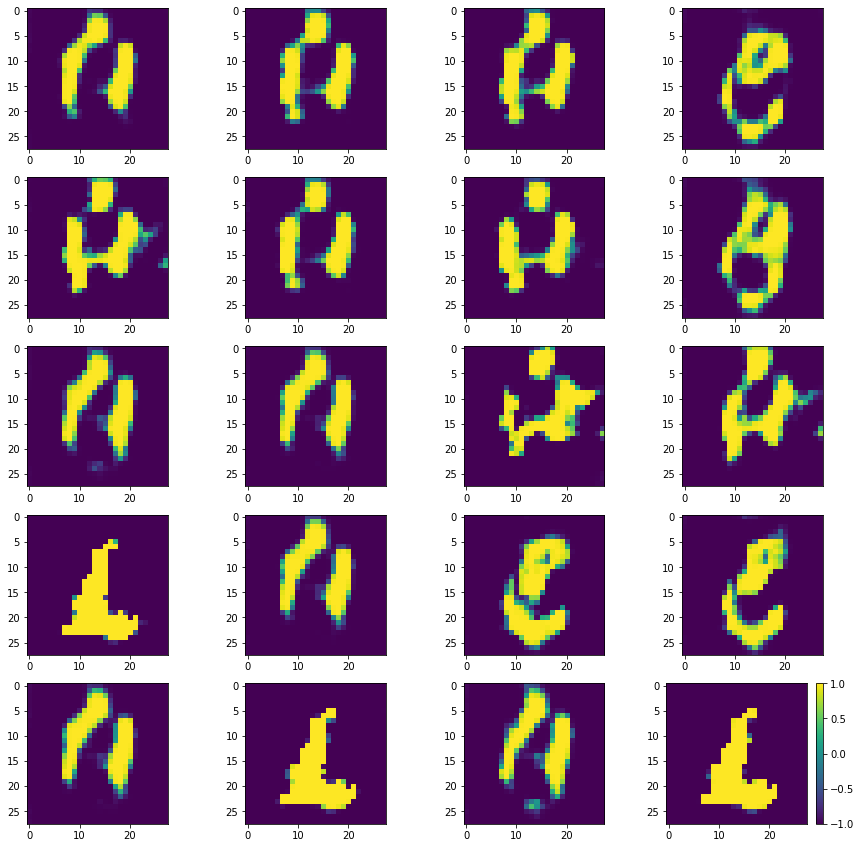

Batch_Num : 2
D_Loss   :   [10.217586517333984, 0.2149088829755783, 10.002677917480469, 0.486328125, 0.1015625] ;    GAN_Loss   :  [16.130008697509766, 5.460124969482422, 10.66988468170166, 0.0, 0.130859375]
Batch_Num : 3
D_Loss   :   [10.195316314697266, 0.16392862796783447, 10.031387329101562, 0.498046875, 0.123046875] ;    GAN_Loss   :  [14.981900215148926, 4.554020881652832, 10.427879333496094, 0.0, 0.11328125]
Batch_Num : 4
D_Loss   :   [10.380599021911621, 0.17409098148345947, 10.206507682800293, 0.5, 0.119140625] ;    GAN_Loss   :  [13.762011528015137, 3.650653123855591, 10.111358642578125, 0.0, 0.158203125]
Batch_Num : 5
D_Loss   :   [10.327351570129395, 0.25176680088043213, 10.075584411621094, 0.49609375, 0.130859375] ;    GAN_Loss   :  [13.484224319458008, 3.044466972351074, 10.439757347106934, 0.0, 0.1484375]
Batch_Num : 6
D_Loss   :   [10.544797897338867, 0.19812780618667603, 10.346670150756836, 0.490234375, 0.126953125] ;    GAN_Loss   :  [15.190702438354492, 4.39695405960

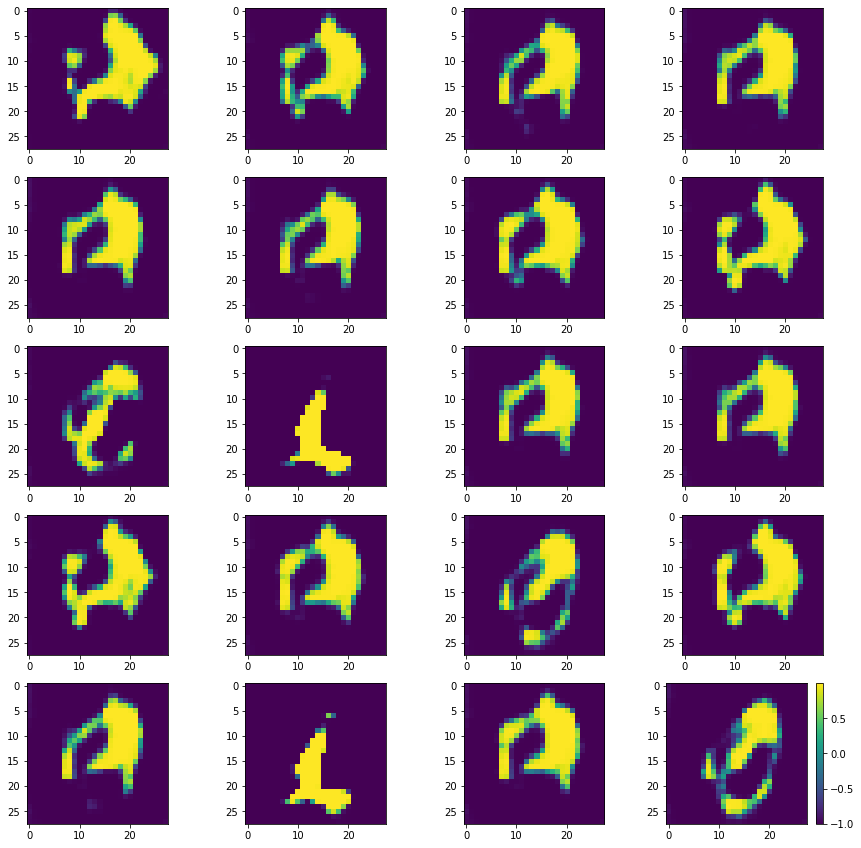

Batch_Num : 17
D_Loss   :   [9.805543899536133, 0.1528119593858719, 9.652731895446777, 0.498046875, 0.12109375] ;    GAN_Loss   :  [15.041410446166992, 4.791839599609375, 10.249570846557617, 0.0, 0.138671875]
Batch_Num : 18
D_Loss   :   [9.964449882507324, 0.1652323305606842, 9.799217224121094, 0.49609375, 0.10546875] ;    GAN_Loss   :  [14.917205810546875, 4.73042106628418, 10.186784744262695, 0.0, 0.123046875]
Batch_Num : 19
D_Loss   :   [10.042876243591309, 0.1730712652206421, 9.869805335998535, 0.494140625, 0.126953125] ;    GAN_Loss   :  [14.912481307983398, 4.903238296508789, 10.00924301147461, 0.0, 0.16796875]
Batch_Num : 20
D_Loss   :   [9.857571601867676, 0.15859687328338623, 9.698974609375, 0.498046875, 0.1328125] ;    GAN_Loss   :  [14.949864387512207, 4.640155792236328, 10.309708595275879, 0.0, 0.173828125]
Batch_Num : 21
D_Loss   :   [9.698808670043945, 0.1565721482038498, 9.542236328125, 0.5, 0.10546875] ;    GAN_Loss   :  [13.953250885009766, 4.194458484649658, 9.7587928

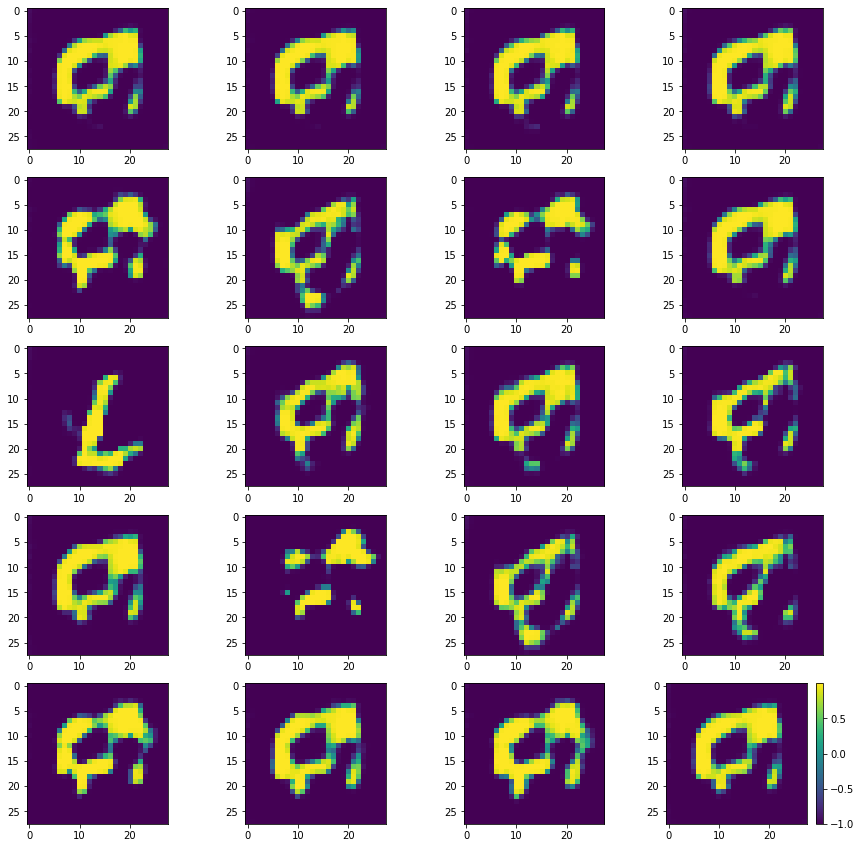

Batch_Num : 32
D_Loss   :   [9.71257209777832, 0.1450175940990448, 9.567554473876953, 0.498046875, 0.119140625] ;    GAN_Loss   :  [11.605039596557617, 1.4247530698776245, 10.180286407470703, 0.0, 0.1484375]
Batch_Num : 33
D_Loss   :   [10.312853813171387, 0.14757956564426422, 10.165274620056152, 0.5, 0.126953125] ;    GAN_Loss   :  [11.69454288482666, 1.2731115818023682, 10.421431541442871, 0.0, 0.158203125]
Batch_Num : 34
D_Loss   :   [10.363546371459961, 0.15287810564041138, 10.210668563842773, 0.498046875, 0.109375] ;    GAN_Loss   :  [12.13276195526123, 1.4612646102905273, 10.671497344970703, 0.0, 0.16796875]
Batch_Num : 35
D_Loss   :   [9.594295501708984, 0.12897339463233948, 9.465322494506836, 0.498046875, 0.1328125] ;    GAN_Loss   :  [11.872661590576172, 1.7998985052108765, 10.072763442993164, 0.0, 0.123046875]
Batch_Num : 36
D_Loss   :   [9.679763793945312, 0.1377996951341629, 9.541964530944824, 0.498046875, 0.1015625] ;    GAN_Loss   :  [12.262447357177734, 1.823049187660217

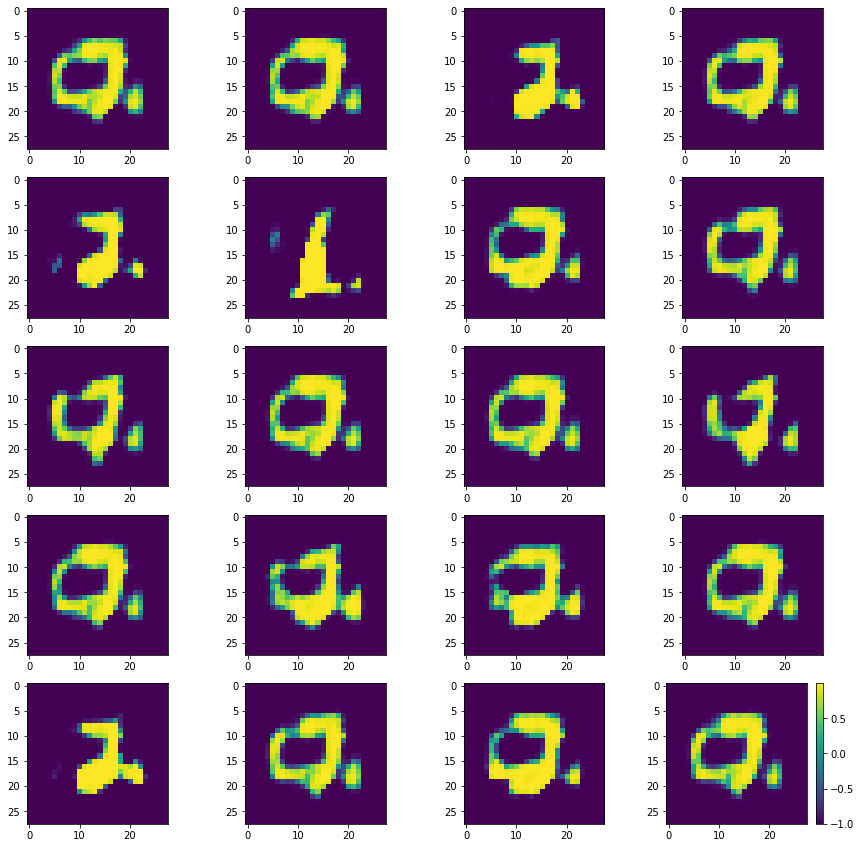

Batch_Num : 47
D_Loss   :   [10.683897972106934, 0.15612299740314484, 10.527774810791016, 0.494140625, 0.09375] ;    GAN_Loss   :  [12.516271591186523, 2.7495155334472656, 9.766756057739258, 0.0, 0.158203125]
Batch_Num : 48
D_Loss   :   [10.132550239562988, 0.15218758583068848, 9.980362892150879, 0.498046875, 0.099609375] ;    GAN_Loss   :  [12.846508979797363, 2.4632177352905273, 10.383291244506836, 0.0, 0.146484375]
Batch_Num : 49
D_Loss   :   [10.086641311645508, 0.1794377565383911, 9.907203674316406, 0.498046875, 0.099609375] ;    GAN_Loss   :  [13.161806106567383, 2.935264825820923, 10.226541519165039, 0.0, 0.14453125]
Batch_Num : 50
D_Loss   :   [9.77444839477539, 0.14689436554908752, 9.627553939819336, 0.498046875, 0.107421875] ;    GAN_Loss   :  [13.865062713623047, 3.3055667877197266, 10.55949592590332, 0.0, 0.12109375]
Batch_Num : 51
D_Loss   :   [10.448333740234375, 0.1944364607334137, 10.253897666931152, 0.490234375, 0.126953125] ;    GAN_Loss   :  [14.002641677856445, 3.65

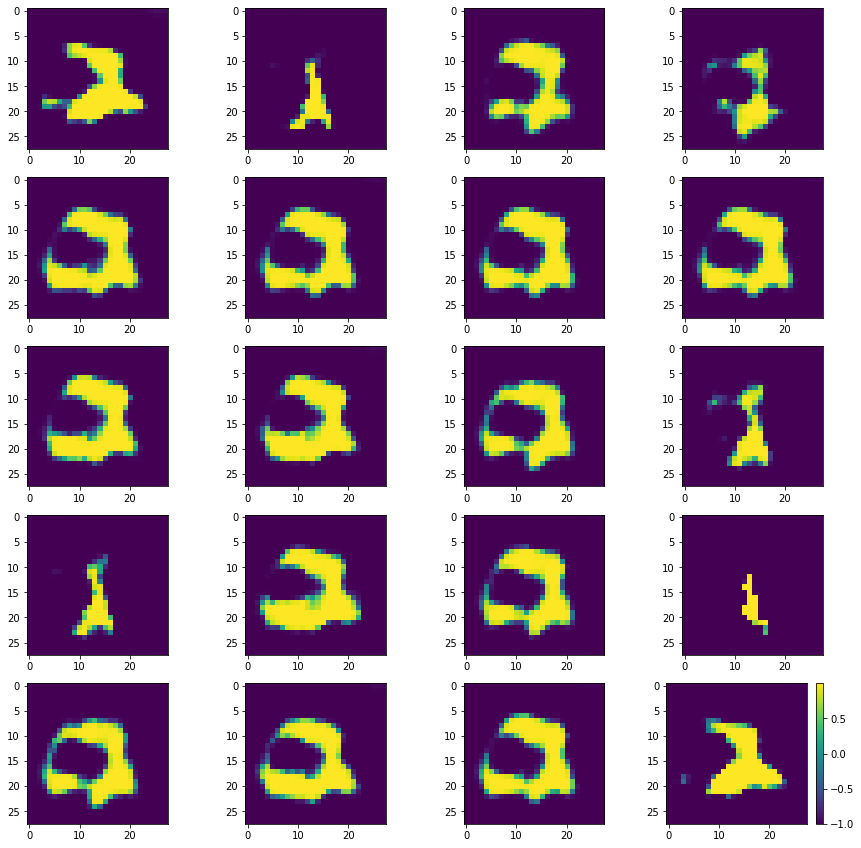

Batch_Num : 62
D_Loss   :   [9.780238151550293, 0.15383464097976685, 9.62640380859375, 0.498046875, 0.064453125] ;    GAN_Loss   :  [13.273100852966309, 3.398540735244751, 9.874560356140137, 0.0, 0.048828125]
Batch_Num : 63
D_Loss   :   [10.06814193725586, 0.18288956582546234, 9.885251998901367, 0.498046875, 0.0859375] ;    GAN_Loss   :  [13.601873397827148, 3.6672327518463135, 9.934640884399414, 0.0, 0.0625]
Batch_Num : 64
D_Loss   :   [10.055248260498047, 0.18896225094795227, 9.866286277770996, 0.49609375, 0.087890625] ;    GAN_Loss   :  [13.79472827911377, 3.9112446308135986, 9.88348388671875, 0.0, 0.09375]
Batch_Num : 65
D_Loss   :   [10.150351524353027, 0.14664970338344574, 10.003702163696289, 0.494140625, 0.09375] ;    GAN_Loss   :  [14.92730712890625, 5.068816661834717, 9.858489990234375, 0.0, 0.099609375]
Batch_Num : 66
D_Loss   :   [10.792983055114746, 0.16184179484844208, 10.631141662597656, 0.5, 0.10546875] ;    GAN_Loss   :  [16.538619995117188, 5.96816873550415, 10.5704517

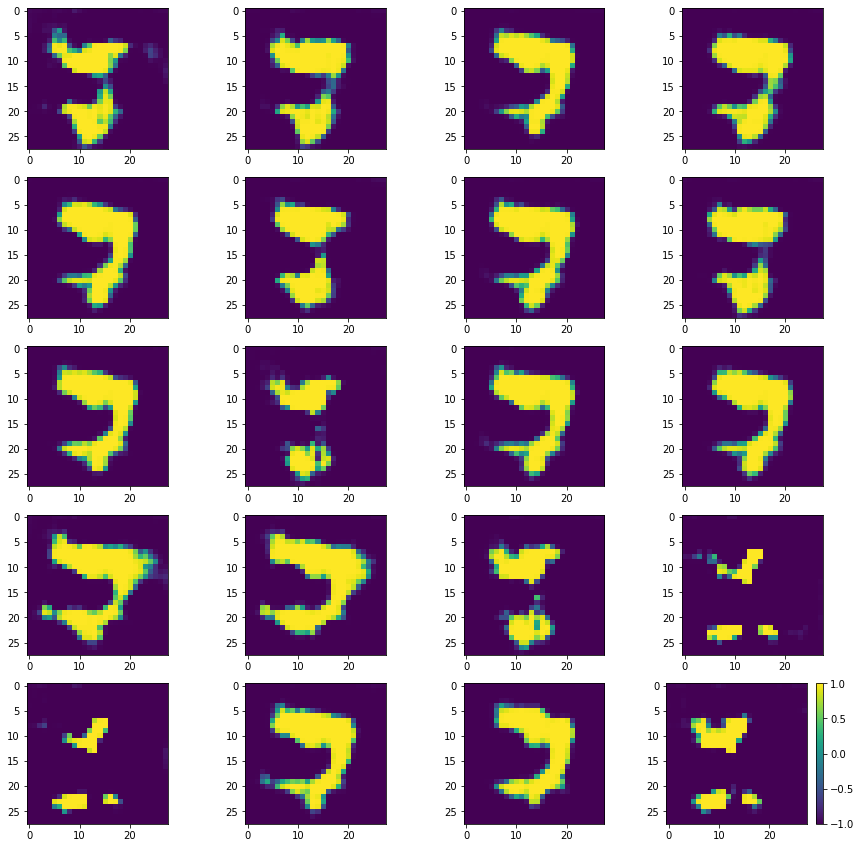

Batch_Num : 77
D_Loss   :   [10.133586883544922, 0.21994560956954956, 9.913640975952148, 0.486328125, 0.095703125] ;    GAN_Loss   :  [17.03009796142578, 6.581835746765137, 10.448263168334961, 0.0, 0.12890625]
Batch_Num : 78
D_Loss   :   [9.725431442260742, 0.16714821755886078, 9.558282852172852, 0.5, 0.078125] ;    GAN_Loss   :  [17.47566032409668, 6.536241054534912, 10.93941879272461, 0.0, 0.123046875]
Batch_Num : 79
D_Loss   :   [10.494962692260742, 0.15586388111114502, 10.339098930358887, 0.5, 0.09375] ;    GAN_Loss   :  [15.022743225097656, 5.171295642852783, 9.851447105407715, 0.0, 0.142578125]
Batch_Num : 80
D_Loss   :   [10.067008972167969, 0.18441292643547058, 9.882596015930176, 0.49609375, 0.14453125] ;    GAN_Loss   :  [14.603996276855469, 4.140539646148682, 10.463456153869629, 0.0, 0.158203125]
Batch_Num : 81
D_Loss   :   [10.295560836791992, 0.17980273067951202, 10.115757942199707, 0.5, 0.130859375] ;    GAN_Loss   :  [13.23247241973877, 3.482510805130005, 9.74996185302734

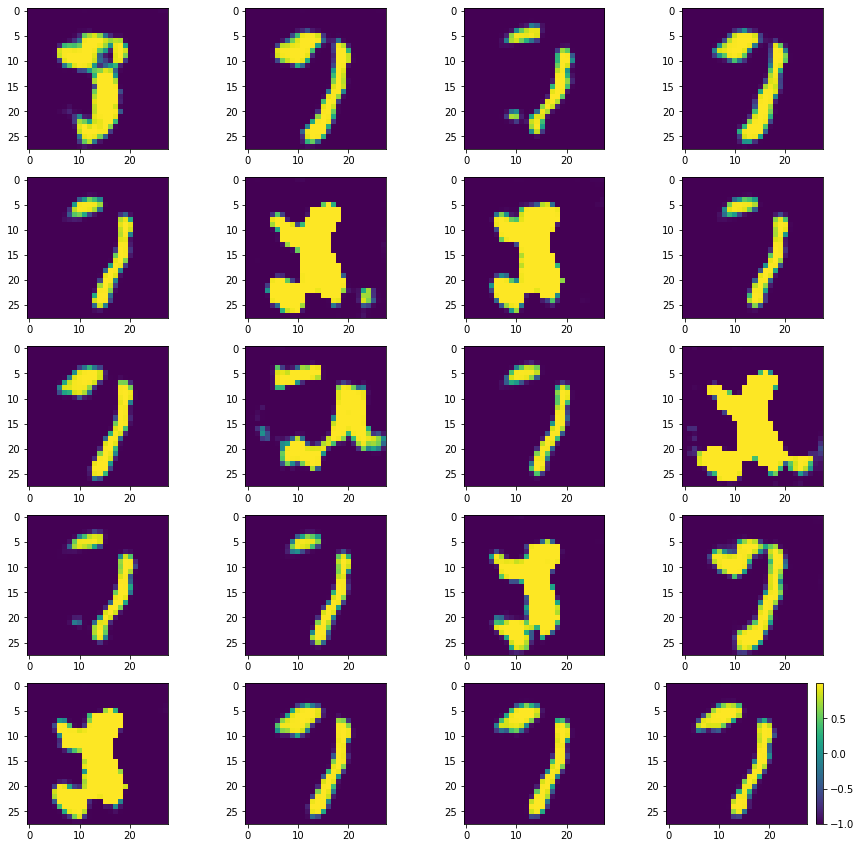

Batch_Num : 92
D_Loss   :   [10.17525863647461, 0.16290688514709473, 10.012351989746094, 0.498046875, 0.119140625] ;    GAN_Loss   :  [12.873028755187988, 2.7066802978515625, 10.166348457336426, 0.0, 0.12109375]
Batch_Num : 93
D_Loss   :   [10.61441421508789, 0.16306303441524506, 10.451351165771484, 0.5, 0.119140625] ;    GAN_Loss   :  [12.306754112243652, 2.1881351470947266, 10.118618965148926, 0.0, 0.09765625]
Batch_Num : 94
D_Loss   :   [10.05394458770752, 0.18840426206588745, 9.865540504455566, 0.49609375, 0.107421875] ;    GAN_Loss   :  [13.147052764892578, 2.687979221343994, 10.459074020385742, 0.0, 0.177734375]
Batch_Num : 95
D_Loss   :   [10.248104095458984, 0.20204734802246094, 10.046056747436523, 0.484375, 0.08984375] ;    GAN_Loss   :  [13.143621444702148, 2.6983962059020996, 10.44522476196289, 0.0, 0.177734375]
Batch_Num : 96
D_Loss   :   [9.777867317199707, 0.17525751888751984, 9.602609634399414, 0.49609375, 0.10546875] ;    GAN_Loss   :  [13.213088035583496, 3.04446697235

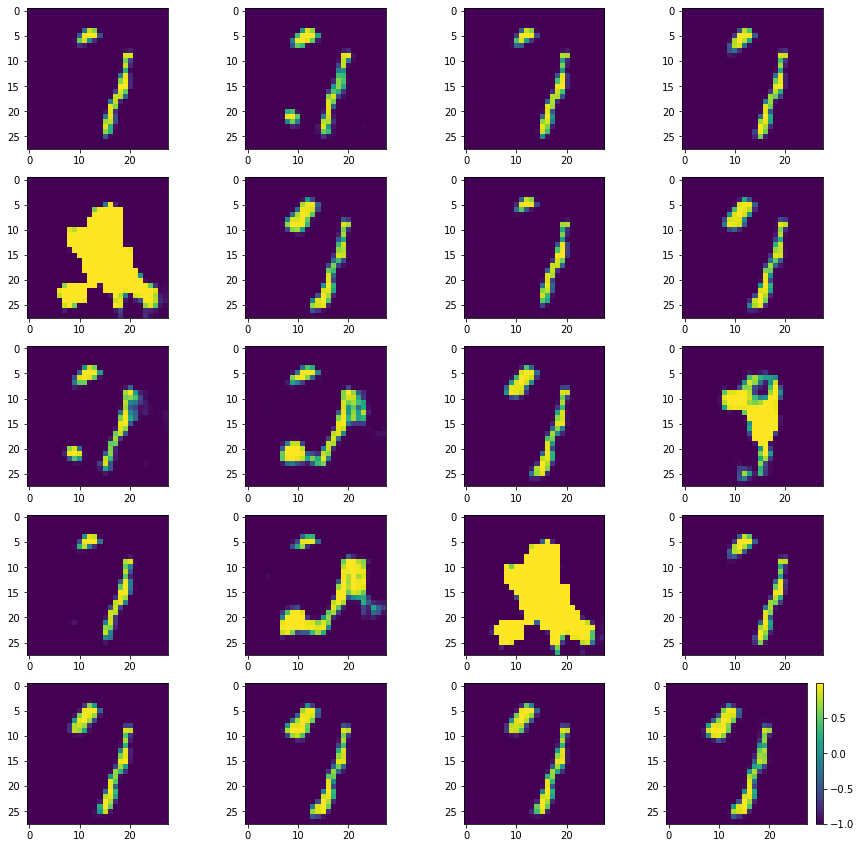

Batch_Num : 107
D_Loss   :   [10.020301818847656, 0.1469850391149521, 9.873316764831543, 0.49609375, 0.076171875] ;    GAN_Loss   :  [17.048439025878906, 6.789198875427246, 10.25924015045166, 0.0, 0.0703125]
Batch_Num : 108
D_Loss   :   [9.44035530090332, 0.14172953367233276, 9.298625946044922, 0.5, 0.099609375] ;    GAN_Loss   :  [16.96147918701172, 6.867430210113525, 10.094048500061035, 0.0, 0.06640625]
Batch_Num : 109
D_Loss   :   [9.650958061218262, 0.12926740944385529, 9.521690368652344, 0.5, 0.107421875] ;    GAN_Loss   :  [17.243026733398438, 6.7160420417785645, 10.526985168457031, 0.0, 0.068359375]
Batch_Num : 110
D_Loss   :   [10.369141578674316, 0.1528138369321823, 10.216327667236328, 0.4921875, 0.08984375] ;    GAN_Loss   :  [16.779882431030273, 6.447021007537842, 10.33286190032959, 0.0, 0.078125]
Batch_Num : 111
D_Loss   :   [9.546306610107422, 0.15290763974189758, 9.393399238586426, 0.49609375, 0.078125] ;    GAN_Loss   :  [17.491376876831055, 7.125855922698975, 10.3655204

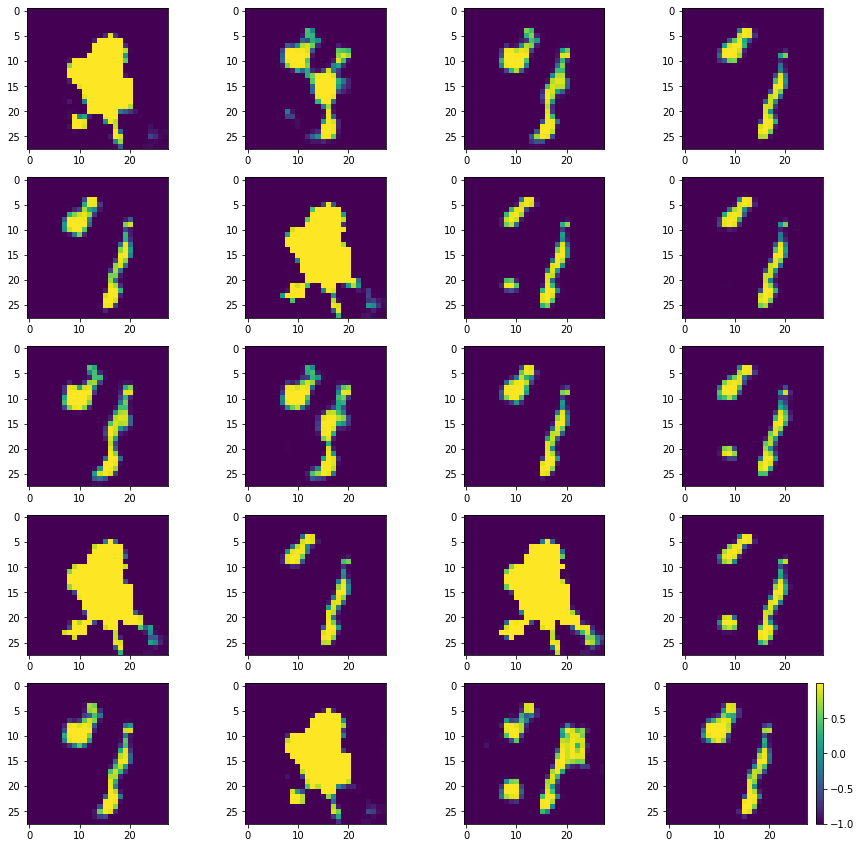

Batch_Num : 122
D_Loss   :   [10.523789405822754, 0.12639738619327545, 10.397392272949219, 0.5, 0.109375] ;    GAN_Loss   :  [17.564502716064453, 7.071991920471191, 10.492509841918945, 0.0, 0.099609375]
Batch_Num : 123
D_Loss   :   [9.899699211120605, 0.12936745584011078, 9.770331382751465, 0.5, 0.083984375] ;    GAN_Loss   :  [17.678306579589844, 7.443985939025879, 10.234319686889648, 0.0, 0.087890625]
Batch_Num : 124
D_Loss   :   [10.242376327514648, 0.12839382886886597, 10.113982200622559, 0.5, 0.10546875] ;    GAN_Loss   :  [17.489749908447266, 7.385240077972412, 10.104509353637695, 0.0, 0.07421875]
Batch_Num : 125
D_Loss   :   [10.431841850280762, 0.1342642605304718, 10.297577857971191, 0.5, 0.068359375] ;    GAN_Loss   :  [17.495662689208984, 7.493188858032227, 10.002474784851074, 0.0, 0.095703125]
Batch_Num : 126
D_Loss   :   [10.373584747314453, 0.13116739690303802, 10.242417335510254, 0.5, 0.09375] ;    GAN_Loss   :  [17.724010467529297, 7.617181777954102, 10.106829643249512, 

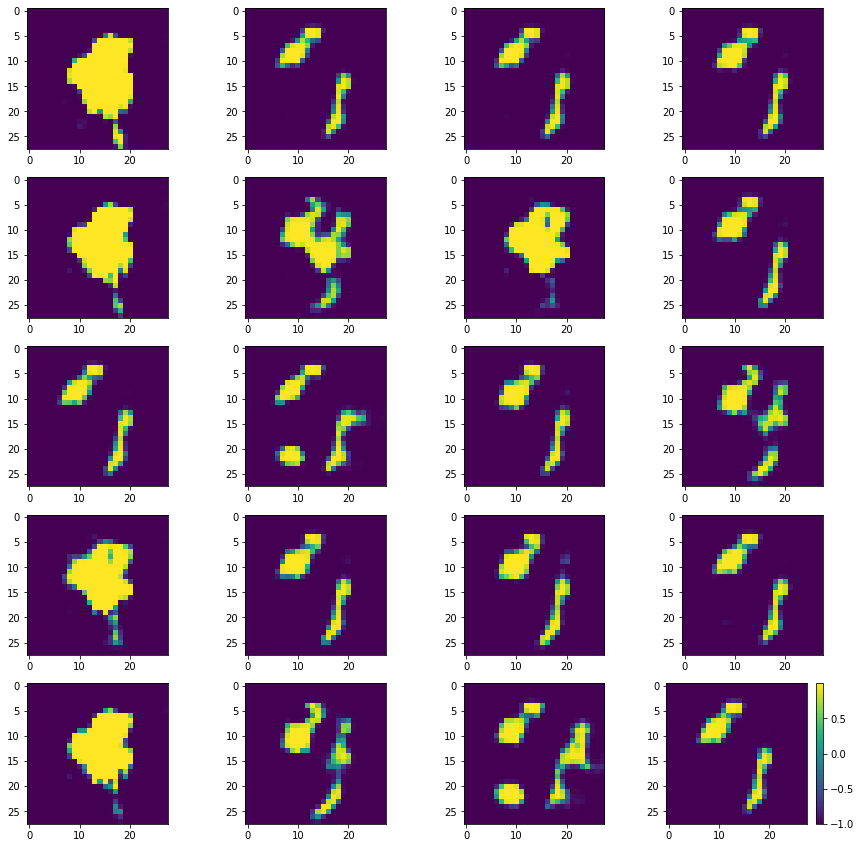

Batch_Num : 137
D_Loss   :   [10.763724327087402, 0.13966847956180573, 10.624055862426758, 0.498046875, 0.0859375] ;    GAN_Loss   :  [16.391626358032227, 6.27946662902832, 10.112159729003906, 0.0, 0.078125]
Batch_Num : 138
D_Loss   :   [10.031490325927734, 0.1410742998123169, 9.890416145324707, 0.49609375, 0.05859375] ;    GAN_Loss   :  [16.203704833984375, 6.03031063079834, 10.173393249511719, 0.0, 0.09375]
Batch_Num : 139
D_Loss   :   [9.935267448425293, 0.13789424300193787, 9.797372817993164, 0.498046875, 0.080078125] ;    GAN_Loss   :  [15.746307373046875, 5.67040491104126, 10.075902938842773, 0.0, 0.08203125]
Batch_Num : 140
D_Loss   :   [9.527339935302734, 0.13488692045211792, 9.39245319366455, 0.5, 0.072265625] ;    GAN_Loss   :  [16.069753646850586, 5.661348819732666, 10.408404350280762, 0.0, 0.0703125]
Batch_Num : 141
D_Loss   :   [10.09681224822998, 0.1293354630470276, 9.967476844787598, 0.5, 0.08203125] ;    GAN_Loss   :  [15.020792007446289, 5.283808708190918, 9.7369832992

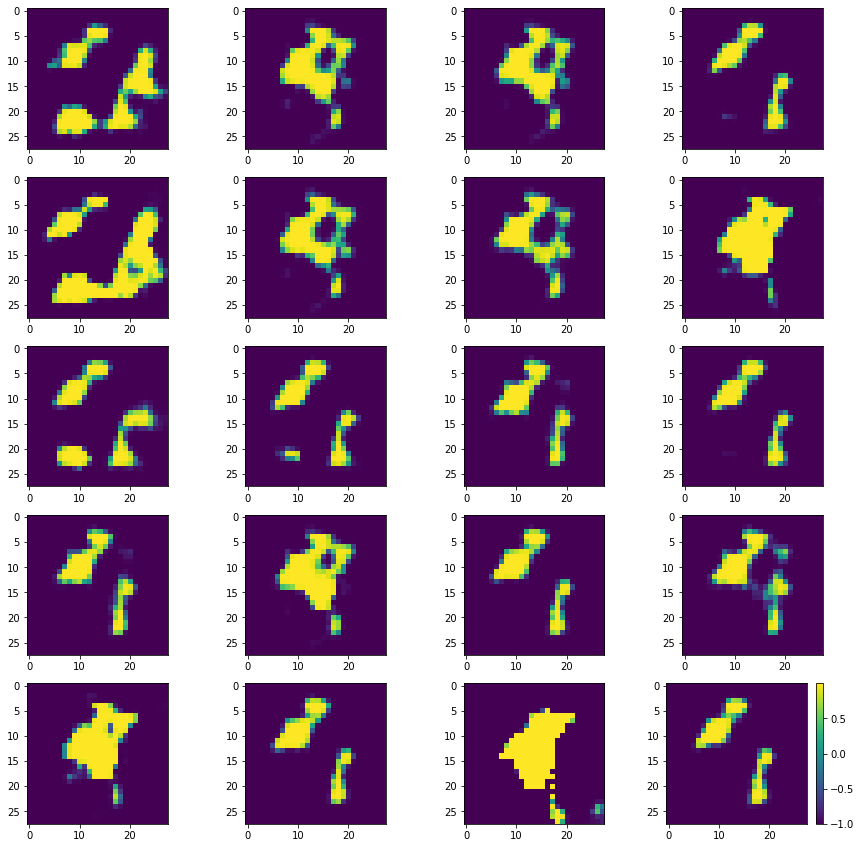

Batch_Num : 152
D_Loss   :   [9.78590202331543, 0.11852996796369553, 9.66737174987793, 0.5, 0.11328125] ;    GAN_Loss   :  [15.442716598510742, 4.941644191741943, 10.50107192993164, 0.0, 0.083984375]
Batch_Num : 153
D_Loss   :   [10.046102523803711, 0.1200292706489563, 9.92607307434082, 0.5, 0.083984375] ;    GAN_Loss   :  [15.422155380249023, 4.922581672668457, 10.499573707580566, 0.0, 0.087890625]
Batch_Num : 154
D_Loss   :   [10.023294448852539, 0.13000603020191193, 9.893288612365723, 0.5, 0.1015625] ;    GAN_Loss   :  [15.08212947845459, 5.501039505004883, 9.581089973449707, 0.0, 0.091796875]
Batch_Num : 155
D_Loss   :   [10.385202407836914, 0.13343946635723114, 10.251763343811035, 0.5, 0.0859375] ;    GAN_Loss   :  [16.092979431152344, 6.048336029052734, 10.044644355773926, 0.0, 0.072265625]
Batch_Num : 156
D_Loss   :   [9.48414421081543, 0.11738020181655884, 9.366764068603516, 0.5, 0.083984375] ;    GAN_Loss   :  [16.444841384887695, 6.246458530426025, 10.198382377624512, 0.0, 0.

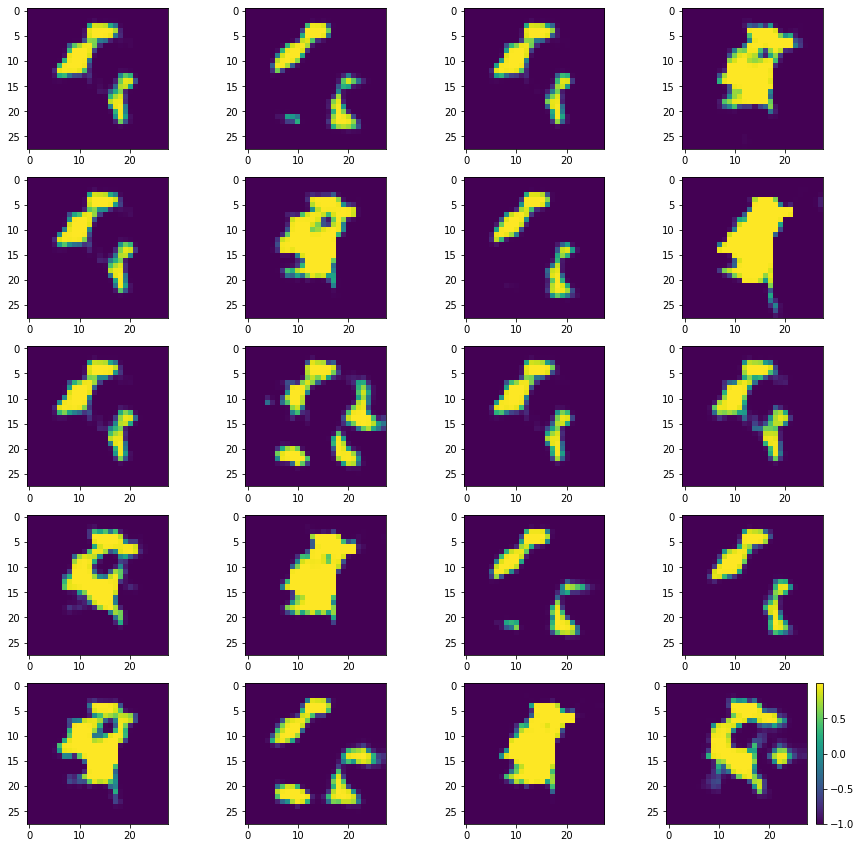

Batch_Num : 167
D_Loss   :   [10.549115180969238, 0.1588805615901947, 10.39023494720459, 0.5, 0.1015625] ;    GAN_Loss   :  [17.67821502685547, 7.543229103088379, 10.13498592376709, 0.0, 0.107421875]
Batch_Num : 168
D_Loss   :   [9.56281852722168, 0.13207809627056122, 9.430740356445312, 0.5, 0.08984375] ;    GAN_Loss   :  [18.35350799560547, 7.860976219177246, 10.492532730102539, 0.0, 0.130859375]
Batch_Num : 169
D_Loss   :   [10.069281578063965, 0.12720143795013428, 9.9420804977417, 0.5, 0.087890625] ;    GAN_Loss   :  [18.187496185302734, 7.811342239379883, 10.376154899597168, 0.0, 0.1328125]
Batch_Num : 170
D_Loss   :   [10.043442726135254, 0.11893588304519653, 9.924507141113281, 0.5, 0.09375] ;    GAN_Loss   :  [18.62918472290039, 7.681612014770508, 10.947572708129883, 0.0, 0.15234375]
Batch_Num : 171
D_Loss   :   [10.391594886779785, 0.12210752815008163, 10.269487380981445, 0.5, 0.080078125] ;    GAN_Loss   :  [17.846237182617188, 7.349693775177002, 10.496542930603027, 0.0, 0.1425

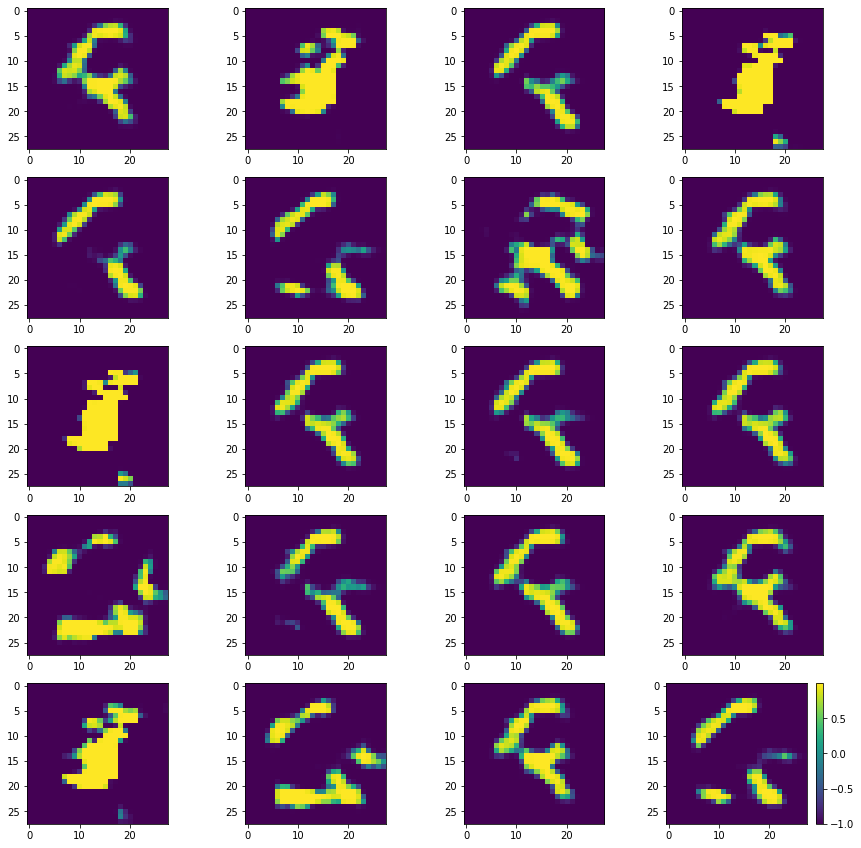

Batch_Num : 182
D_Loss   :   [9.710090637207031, 0.1357458084821701, 9.574344635009766, 0.5, 0.09765625] ;    GAN_Loss   :  [16.983169555664062, 6.282316207885742, 10.70085334777832, 0.0, 0.107421875]
Batch_Num : 183
D_Loss   :   [10.362478256225586, 0.1358553171157837, 10.226622581481934, 0.5, 0.12109375] ;    GAN_Loss   :  [17.317380905151367, 6.614471435546875, 10.702909469604492, 0.0, 0.1328125]
Batch_Num : 184
D_Loss   :   [9.840330123901367, 0.13600024580955505, 9.704329490661621, 0.5, 0.125] ;    GAN_Loss   :  [16.65702247619629, 6.371659278869629, 10.28536319732666, 0.0, 0.11328125]
Batch_Num : 185
D_Loss   :   [9.933011054992676, 0.15005579590797424, 9.782955169677734, 0.494140625, 0.103515625] ;    GAN_Loss   :  [16.50707244873047, 5.894708633422852, 10.612364768981934, 0.0, 0.109375]
Batch_Num : 186
D_Loss   :   [9.502607345581055, 0.1344282329082489, 9.368179321289062, 0.498046875, 0.09375] ;    GAN_Loss   :  [16.468908309936523, 5.581551551818848, 10.887356758117676, 0.0, 

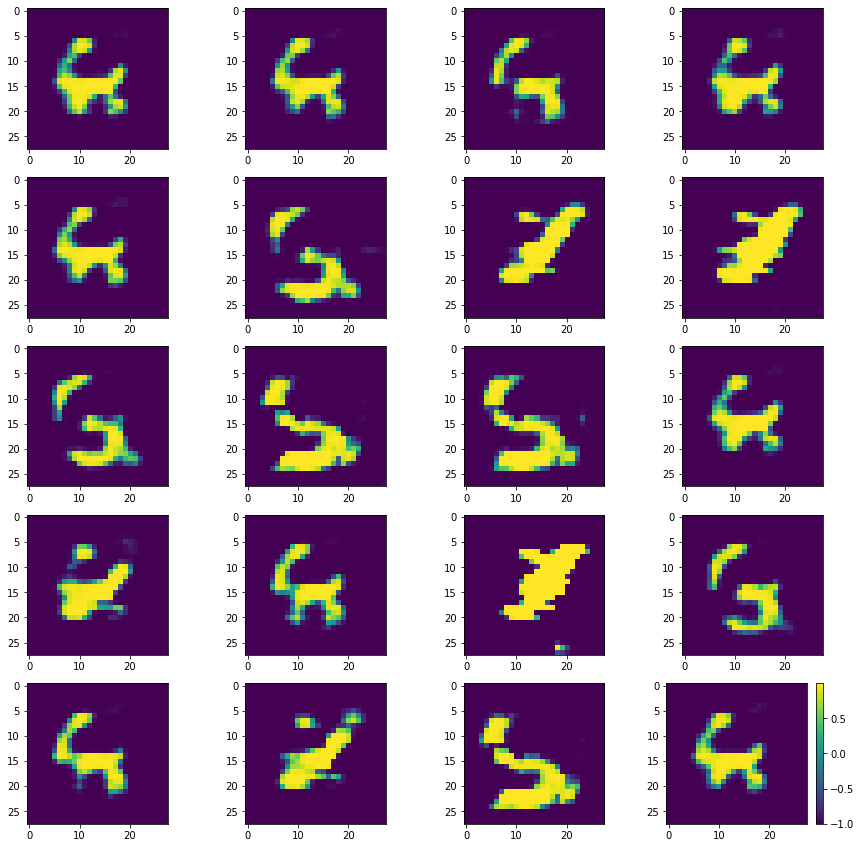

Batch_Num : 197
D_Loss   :   [10.008346557617188, 0.17507527768611908, 9.833271026611328, 0.498046875, 0.125] ;    GAN_Loss   :  [15.50078010559082, 4.926397800445557, 10.574381828308105, 0.0, 0.125]
Batch_Num : 198
D_Loss   :   [9.741028785705566, 0.1989171802997589, 9.54211139678955, 0.490234375, 0.1171875] ;    GAN_Loss   :  [16.140392303466797, 5.751808166503906, 10.388583183288574, 0.0, 0.126953125]
Batch_Num : 199
D_Loss   :   [10.6010103225708, 0.16796959936618805, 10.433040618896484, 0.4921875, 0.103515625] ;    GAN_Loss   :  [17.723106384277344, 6.778633117675781, 10.944473266601562, 0.0, 0.103515625]
Batch_Num : 200
D_Loss   :   [10.18870735168457, 0.17260076105594635, 10.016106605529785, 0.49609375, 0.103515625] ;    GAN_Loss   :  [18.261119842529297, 7.308403015136719, 10.952716827392578, 0.0, 0.111328125]
Batch_Num : 201
D_Loss   :   [10.425698280334473, 0.17885155975818634, 10.246847152709961, 0.490234375, 0.099609375] ;    GAN_Loss   :  [19.57505989074707, 8.718325614929

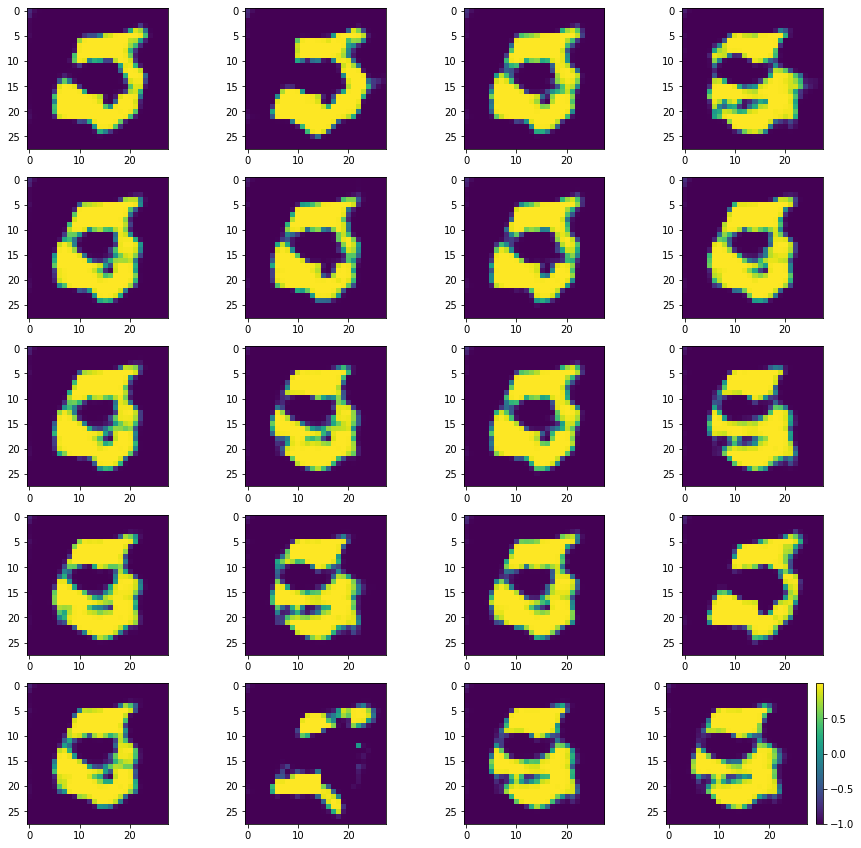

Batch_Num : 212
D_Loss   :   [10.961618423461914, 0.1844385713338852, 10.777179718017578, 0.494140625, 0.11328125] ;    GAN_Loss   :  [15.630422592163086, 5.42517614364624, 10.205245971679688, 0.0, 0.1640625]
Batch_Num : 213
D_Loss   :   [9.630945205688477, 0.16832110285758972, 9.462624549865723, 0.498046875, 0.126953125] ;    GAN_Loss   :  [15.741458892822266, 5.684539794921875, 10.05691909790039, 0.0, 0.154296875]
Batch_Num : 214
D_Loss   :   [10.413094520568848, 0.1855766773223877, 10.227518081665039, 0.49609375, 0.119140625] ;    GAN_Loss   :  [15.8792724609375, 5.602780818939209, 10.276491165161133, 0.0, 0.138671875]
Batch_Num : 215
D_Loss   :   [9.231236457824707, 0.16391746699810028, 9.0673189163208, 0.49609375, 0.087890625] ;    GAN_Loss   :  [16.010719299316406, 5.6465606689453125, 10.364158630371094, 0.0, 0.138671875]
Batch_Num : 216
D_Loss   :   [10.432689666748047, 0.15548627078533173, 10.277203559875488, 0.5, 0.11328125] ;    GAN_Loss   :  [16.18970489501953, 5.79662084579

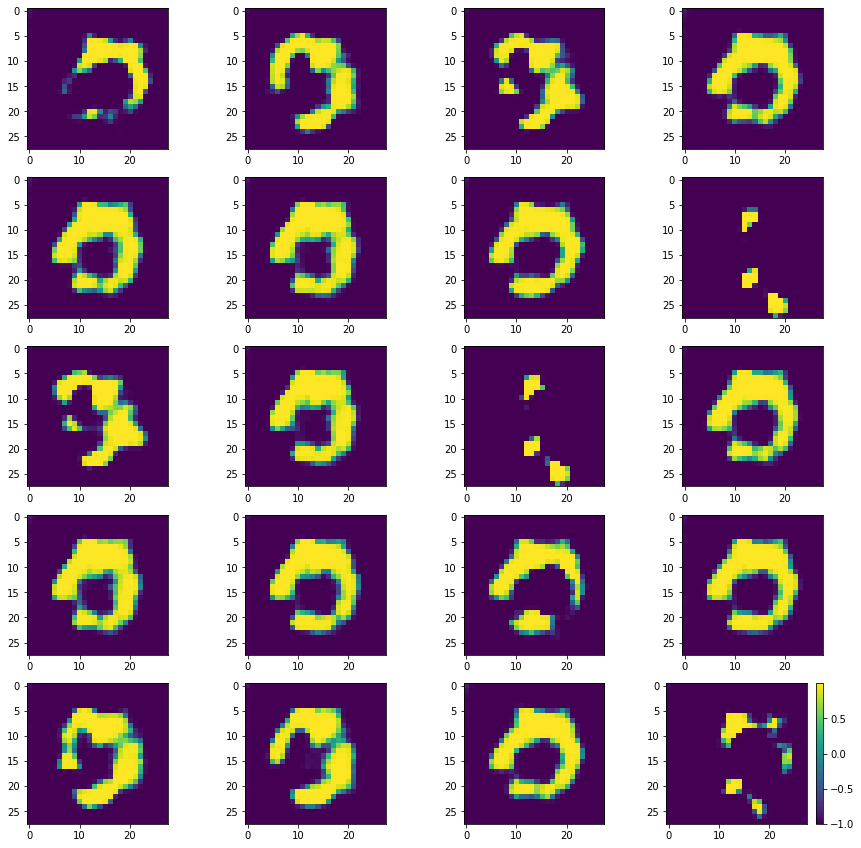

Batch_Num : 227
D_Loss   :   [9.315357208251953, 0.19295087456703186, 9.122406005859375, 0.49609375, 0.146484375] ;    GAN_Loss   :  [17.088293075561523, 6.861057758331299, 10.227235794067383, 0.0, 0.154296875]
Batch_Num : 228
D_Loss   :   [10.368937492370605, 0.14272436499595642, 10.226213455200195, 0.498046875, 0.154296875] ;    GAN_Loss   :  [17.109342575073242, 6.8422160148620605, 10.267126083374023, 0.0, 0.1640625]
Batch_Num : 229
D_Loss   :   [9.813820838928223, 0.16939300298690796, 9.644428253173828, 0.5, 0.125] ;    GAN_Loss   :  [16.77589225769043, 6.585491180419922, 10.190401077270508, 0.0, 0.17578125]
Batch_Num : 230
D_Loss   :   [10.120471954345703, 0.1504446566104889, 9.970026969909668, 0.49609375, 0.138671875] ;    GAN_Loss   :  [16.616748809814453, 6.621772766113281, 9.994976043701172, 0.0, 0.193359375]
Batch_Num : 231
D_Loss   :   [10.345356941223145, 0.13699325919151306, 10.20836353302002, 0.498046875, 0.103515625] ;    GAN_Loss   :  [16.963363647460938, 6.544049263000

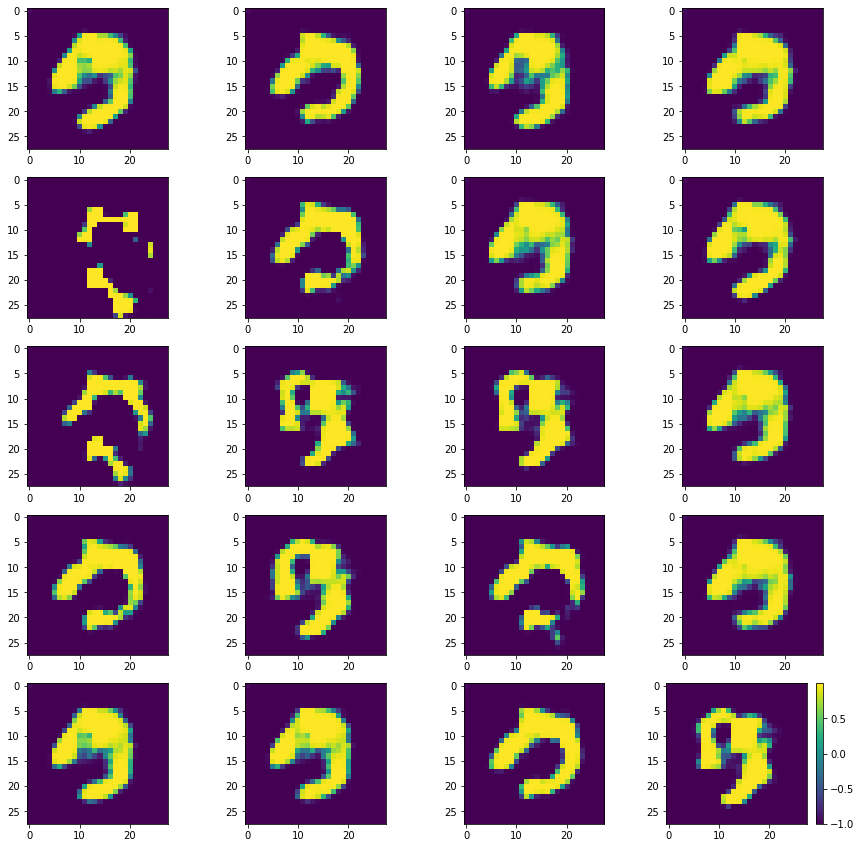

Batch_Num : 2
D_Loss   :   [10.134891510009766, 0.14095567166805267, 9.993935585021973, 0.5, 0.1015625] ;    GAN_Loss   :  [19.289356231689453, 8.753068923950195, 10.536287307739258, 0.0, 0.12109375]
Batch_Num : 3
D_Loss   :   [10.171753883361816, 0.1438388228416443, 10.027915000915527, 0.49609375, 0.12109375] ;    GAN_Loss   :  [18.241912841796875, 8.17101001739502, 10.070901870727539, 0.0, 0.14453125]
Batch_Num : 4
D_Loss   :   [10.341999053955078, 0.14095032215118408, 10.201048851013184, 0.5, 0.119140625] ;    GAN_Loss   :  [18.225433349609375, 7.783788204193115, 10.441645622253418, 0.0, 0.1484375]
Batch_Num : 5
D_Loss   :   [10.232651710510254, 0.1855691373348236, 10.047082901000977, 0.5, 0.107421875] ;    GAN_Loss   :  [18.08945083618164, 7.807934284210205, 10.281517028808594, 0.0, 0.12109375]
Batch_Num : 6
D_Loss   :   [10.496387481689453, 0.15102922916412354, 10.345357894897461, 0.494140625, 0.09375] ;    GAN_Loss   :  [17.960006713867188, 7.969174385070801, 9.990833282470703, 0

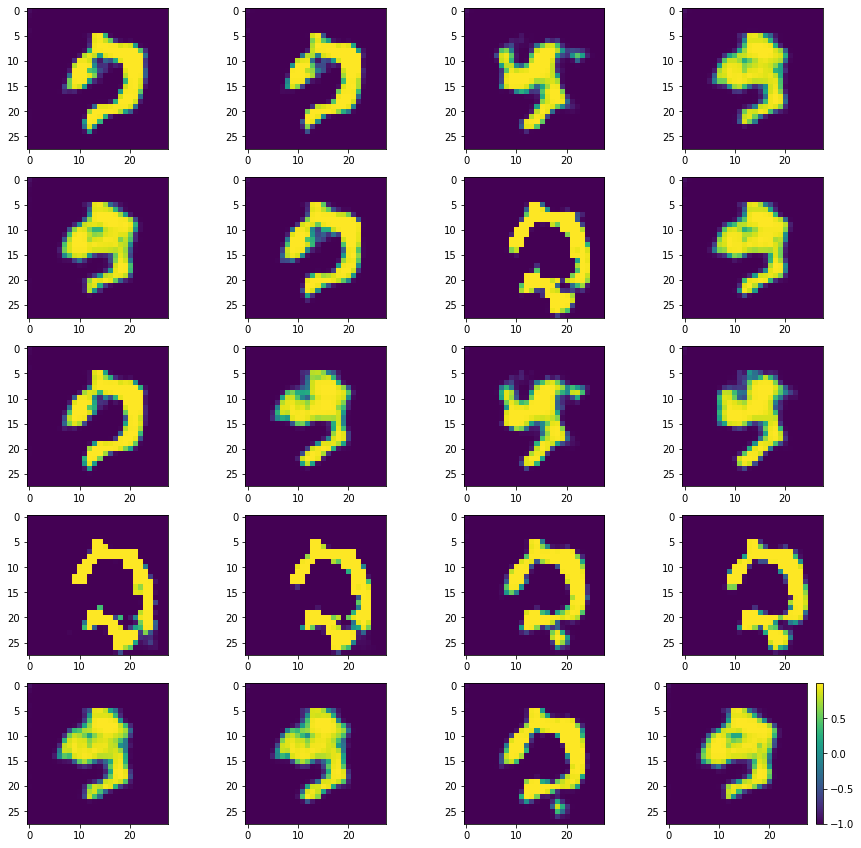

Batch_Num : 17
D_Loss   :   [9.819060325622559, 0.1674581617116928, 9.651601791381836, 0.494140625, 0.095703125] ;    GAN_Loss   :  [16.158924102783203, 6.033476829528809, 10.125446319580078, 0.0, 0.1171875]
Batch_Num : 18
D_Loss   :   [9.98062515258789, 0.17739741504192352, 9.803227424621582, 0.498046875, 0.1015625] ;    GAN_Loss   :  [16.880319595336914, 6.545381546020508, 10.334938049316406, 0.0, 0.12109375]
Batch_Num : 19
D_Loss   :   [10.13460922241211, 0.26610836386680603, 9.868500709533691, 0.484375, 0.125] ;    GAN_Loss   :  [17.660850524902344, 7.867121696472168, 9.79372787475586, 0.0, 0.12109375]
Batch_Num : 20
D_Loss   :   [9.888641357421875, 0.1932213455438614, 9.695420265197754, 0.486328125, 0.08984375] ;    GAN_Loss   :  [18.579708099365234, 8.023176193237305, 10.556530952453613, 0.0, 0.12890625]
Batch_Num : 21
D_Loss   :   [9.723043441772461, 0.1838637739419937, 9.539179801940918, 0.49609375, 0.0859375] ;    GAN_Loss   :  [18.491748809814453, 8.175810813903809, 10.315937

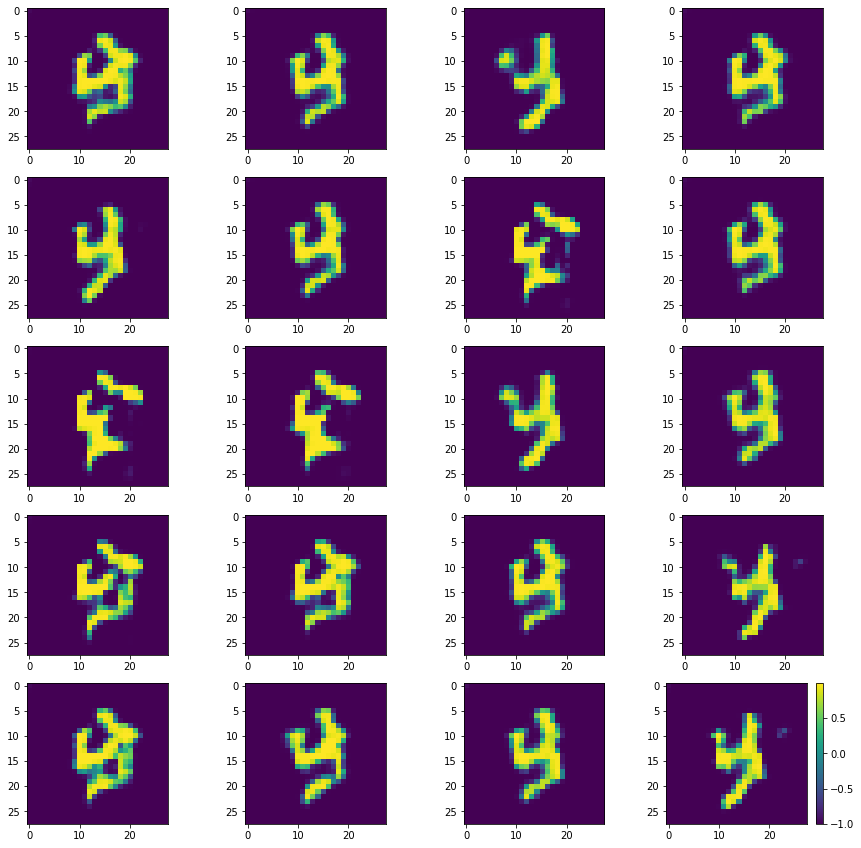

Batch_Num : 32
D_Loss   :   [9.736916542053223, 0.1679033637046814, 9.569013595581055, 0.5, 0.09375] ;    GAN_Loss   :  [17.11789321899414, 7.04483699798584, 10.073057174682617, 0.0, 0.142578125]
Batch_Num : 33
D_Loss   :   [10.308364868164062, 0.1489202380180359, 10.159444808959961, 0.5, 0.09765625] ;    GAN_Loss   :  [17.35388946533203, 7.129996299743652, 10.223892211914062, 0.0, 0.14453125]
Batch_Num : 34
D_Loss   :   [10.36563491821289, 0.15529611706733704, 10.210338592529297, 0.5, 0.10546875] ;    GAN_Loss   :  [18.542221069335938, 8.26318359375, 10.279038429260254, 0.0, 0.09765625]
Batch_Num : 35
D_Loss   :   [9.602567672729492, 0.14130482077598572, 9.461262702941895, 0.498046875, 0.09765625] ;    GAN_Loss   :  [19.00493621826172, 8.71183967590332, 10.293097496032715, 0.0, 0.12890625]
Batch_Num : 36
D_Loss   :   [9.678163528442383, 0.13975068926811218, 9.538413047790527, 0.494140625, 0.1171875] ;    GAN_Loss   :  [18.975276947021484, 8.764239311218262, 10.211038589477539, 0.0, 0.

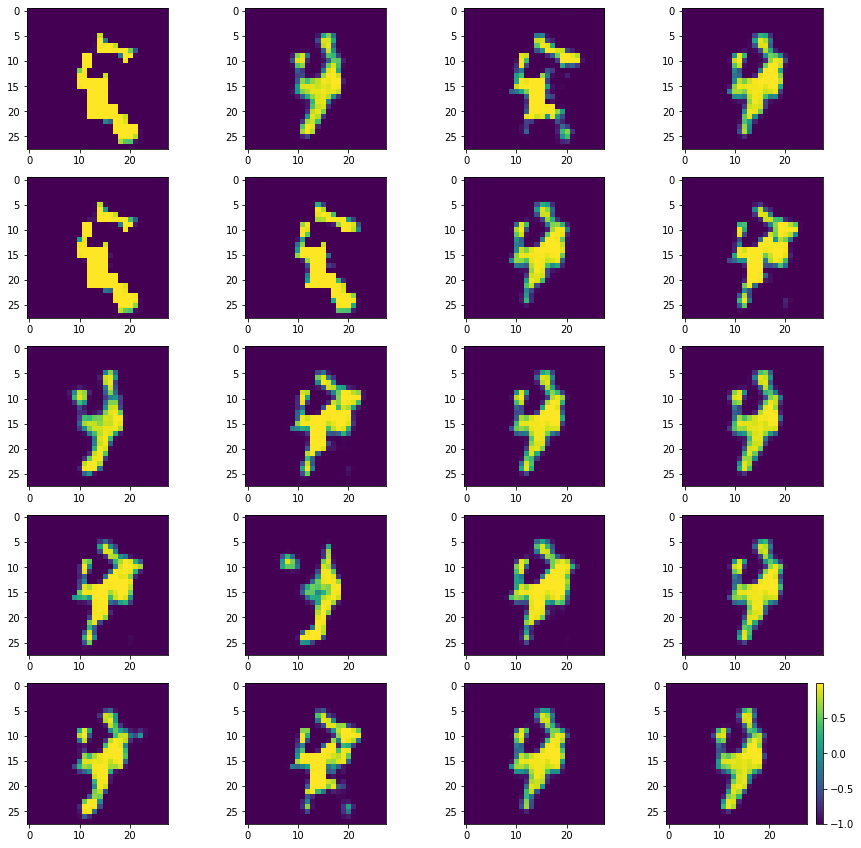

Batch_Num : 47
D_Loss   :   [10.692362785339355, 0.16668549180030823, 10.525677680969238, 0.5, 0.11328125] ;    GAN_Loss   :  [15.069488525390625, 5.043808460235596, 10.025680541992188, 0.0, 0.125]
Batch_Num : 48
D_Loss   :   [10.157843589782715, 0.18073733150959015, 9.977106094360352, 0.5, 0.10546875] ;    GAN_Loss   :  [15.903531074523926, 5.706974029541016, 10.19655704498291, 0.0, 0.12109375]
Batch_Num : 49
D_Loss   :   [10.056097984313965, 0.15692052245140076, 9.899177551269531, 0.5, 0.099609375] ;    GAN_Loss   :  [16.681447982788086, 6.428635120391846, 10.252813339233398, 0.0, 0.142578125]
Batch_Num : 50
D_Loss   :   [9.773428916931152, 0.14921924471855164, 9.6242094039917, 0.5, 0.12109375] ;    GAN_Loss   :  [16.440080642700195, 6.334367752075195, 10.105712890625, 0.0, 0.099609375]
Batch_Num : 51
D_Loss   :   [10.417939186096191, 0.16675278544425964, 10.25118637084961, 0.5, 0.10546875] ;    GAN_Loss   :  [16.700435638427734, 6.387979984283447, 10.312456130981445, 0.0, 0.13476562

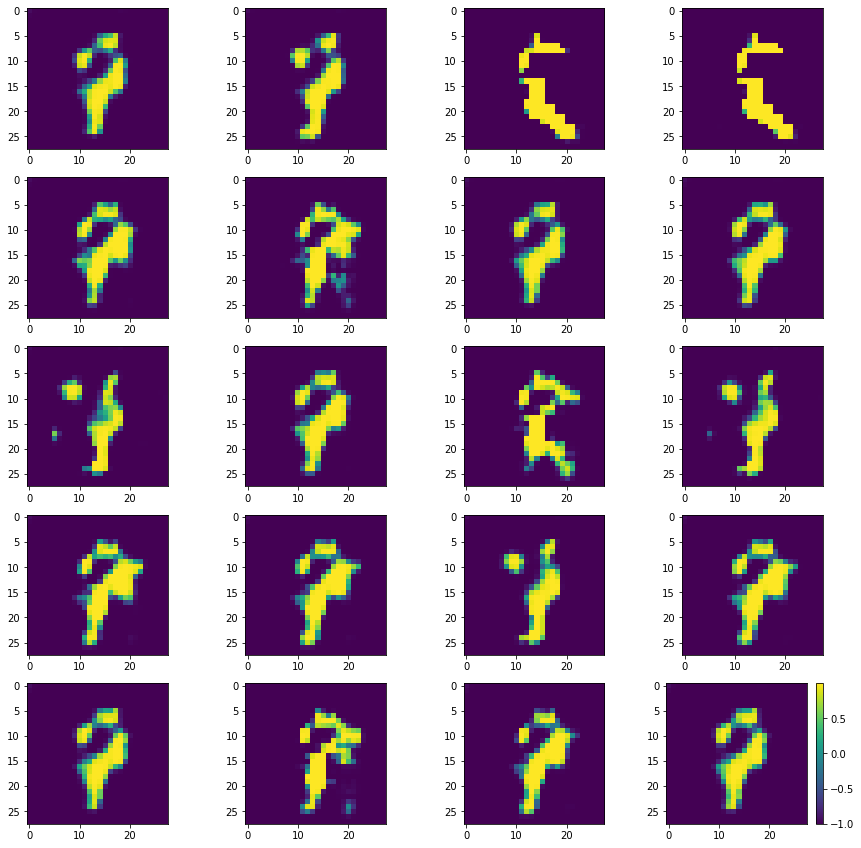

Batch_Num : 62
D_Loss   :   [9.764229774475098, 0.14010581374168396, 9.624123573303223, 0.5, 0.123046875] ;    GAN_Loss   :  [16.552812576293945, 6.205753326416016, 10.34705924987793, 0.0, 0.1171875]
Batch_Num : 63
D_Loss   :   [10.098797798156738, 0.21679256856441498, 9.88200569152832, 0.49609375, 0.103515625] ;    GAN_Loss   :  [16.1790714263916, 5.967024803161621, 10.21204662322998, 0.0, 0.1171875]
Batch_Num : 64
D_Loss   :   [10.063292503356934, 0.19834153354167938, 9.864951133728027, 0.5, 0.10546875] ;    GAN_Loss   :  [15.487802505493164, 5.618426322937012, 9.869376182556152, 0.0, 0.119140625]
Batch_Num : 65
D_Loss   :   [10.191287994384766, 0.18909430503845215, 10.002193450927734, 0.5, 0.111328125] ;    GAN_Loss   :  [15.51523208618164, 5.510147571563721, 10.005084991455078, 0.0, 0.119140625]
Batch_Num : 66
D_Loss   :   [10.796050071716309, 0.16728965938091278, 10.62876033782959, 0.5, 0.140625] ;    GAN_Loss   :  [15.69066047668457, 5.34255313873291, 10.34810733795166, 0.0, 0.10

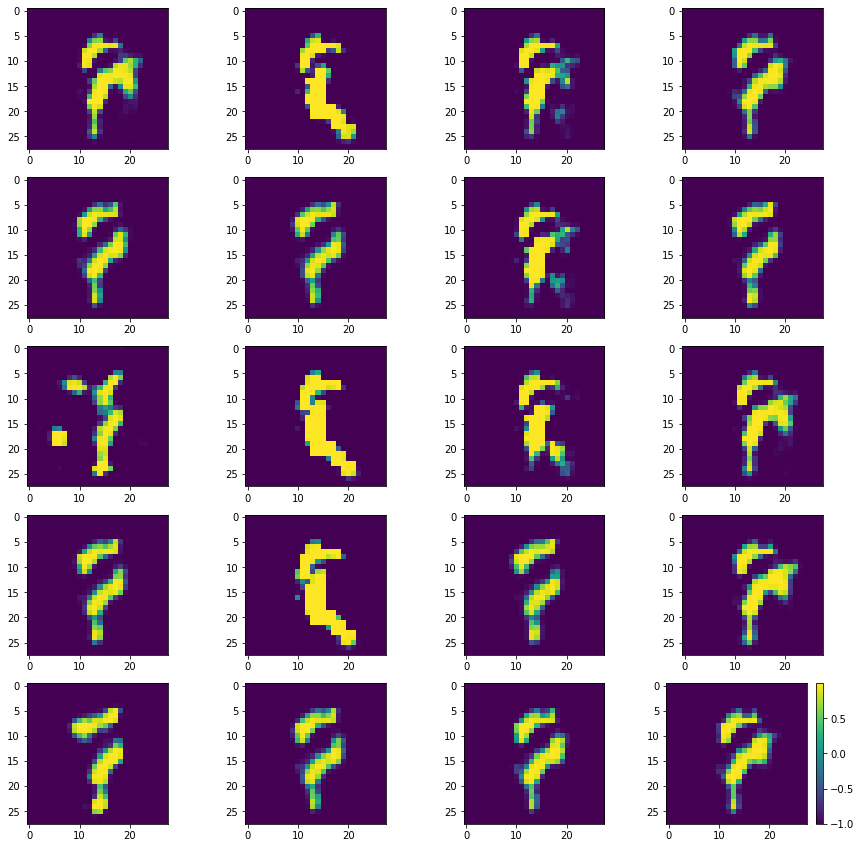

Batch_Num : 77
D_Loss   :   [10.0713472366333, 0.16385167837142944, 9.907495498657227, 0.4921875, 0.109375] ;    GAN_Loss   :  [15.400344848632812, 5.506092548370361, 9.89425277709961, 0.0, 0.107421875]
Batch_Num : 78
D_Loss   :   [9.689851760864258, 0.1322793960571289, 9.557572364807129, 0.498046875, 0.087890625] ;    GAN_Loss   :  [15.131482124328613, 5.341943740844727, 9.789538383483887, 0.0, 0.130859375]
Batch_Num : 79
D_Loss   :   [10.482288360595703, 0.14556792378425598, 10.33672046661377, 0.5, 0.103515625] ;    GAN_Loss   :  [15.358739852905273, 5.321176052093506, 10.03756332397461, 0.0, 0.125]
Batch_Num : 80
D_Loss   :   [10.03045654296875, 0.14860326051712036, 9.881853103637695, 0.49609375, 0.12109375] ;    GAN_Loss   :  [15.217971801757812, 4.784409046173096, 10.433563232421875, 0.0, 0.1328125]
Batch_Num : 81
D_Loss   :   [10.269505500793457, 0.1538616418838501, 10.115643501281738, 0.5, 0.08984375] ;    GAN_Loss   :  [14.980823516845703, 4.8912200927734375, 10.089603424072266

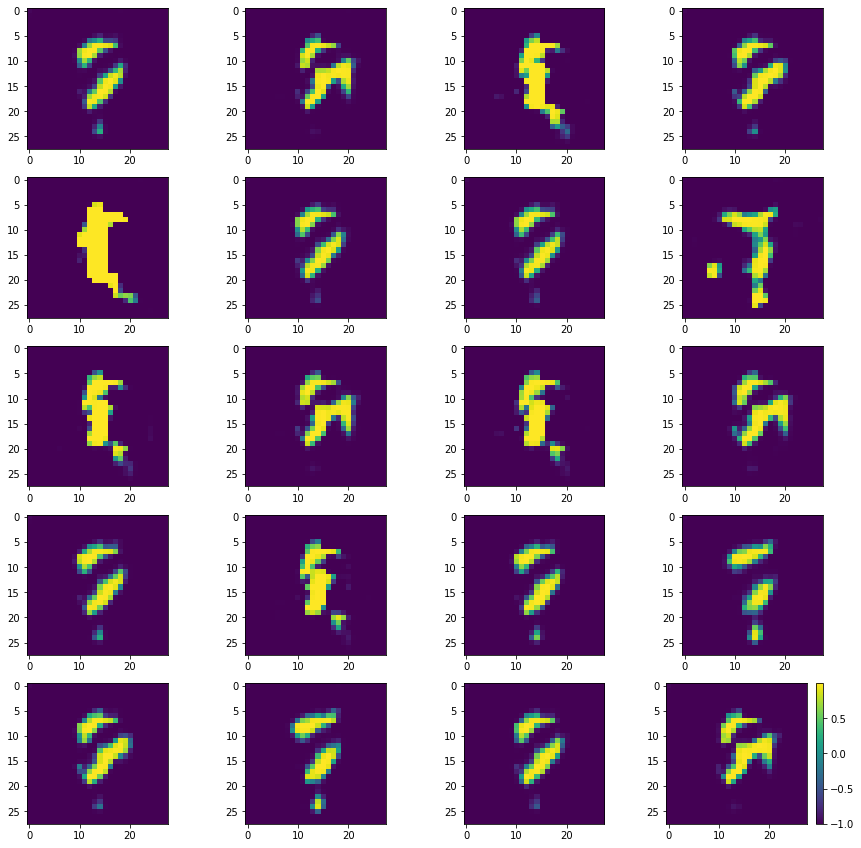

Batch_Num : 92
D_Loss   :   [10.139267921447754, 0.128531351685524, 10.010736465454102, 0.49609375, 0.126953125] ;    GAN_Loss   :  [15.476545333862305, 5.8244476318359375, 9.652097702026367, 0.0, 0.087890625]
Batch_Num : 93
D_Loss   :   [10.58251953125, 0.13422439992427826, 10.448295593261719, 0.5, 0.11328125] ;    GAN_Loss   :  [15.352092742919922, 5.622776508331299, 9.729316711425781, 0.0, 0.103515625]
Batch_Num : 94
D_Loss   :   [10.003617286682129, 0.13902615010738373, 9.864591598510742, 0.5, 0.1171875] ;    GAN_Loss   :  [16.483348846435547, 6.075307846069336, 10.408041954040527, 0.0, 0.09375]
Batch_Num : 95
D_Loss   :   [10.184677124023438, 0.13942575454711914, 10.04525089263916, 0.5, 0.109375] ;    GAN_Loss   :  [15.638334274291992, 6.126739501953125, 9.511594772338867, 0.0, 0.12109375]
Batch_Num : 96
D_Loss   :   [9.735416412353516, 0.13706614077091217, 9.598350524902344, 0.498046875, 0.10546875] ;    GAN_Loss   :  [15.63701057434082, 5.703425407409668, 9.933585166931152, 0.0,

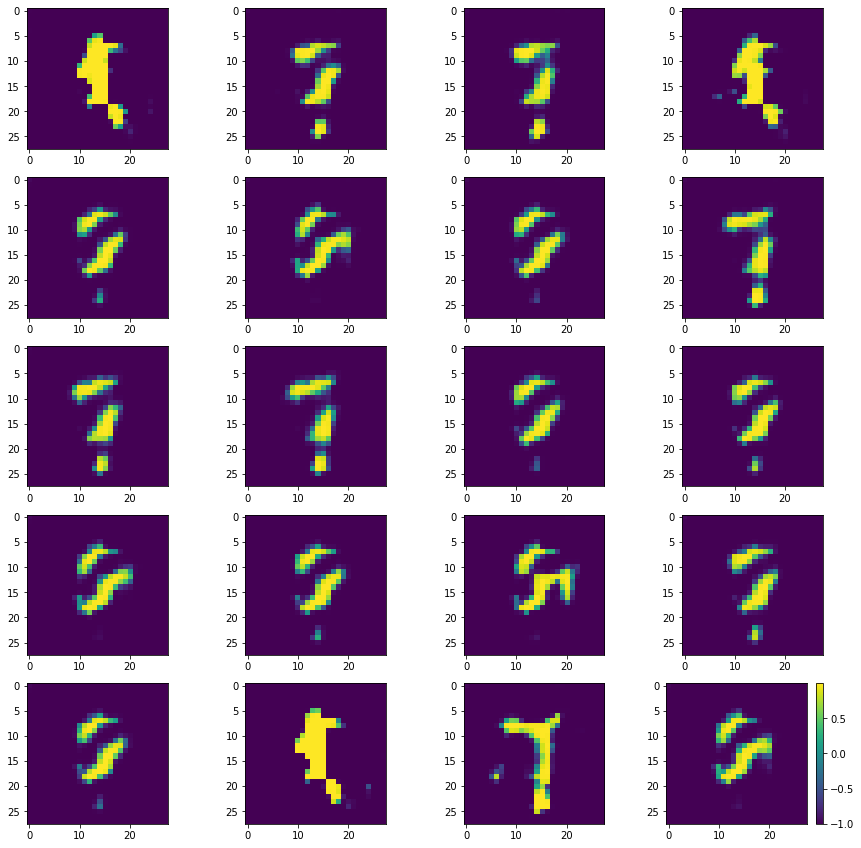

Batch_Num : 107
D_Loss   :   [9.997544288635254, 0.12441256642341614, 9.87313175201416, 0.5, 0.10546875] ;    GAN_Loss   :  [14.843957901000977, 4.8807244300842285, 9.96323299407959, 0.0, 0.134765625]
Batch_Num : 108
D_Loss   :   [9.422962188720703, 0.12473087757825851, 9.29823112487793, 0.5, 0.09375] ;    GAN_Loss   :  [14.316402435302734, 4.640910625457764, 9.675492286682129, 0.0, 0.09375]
Batch_Num : 109
D_Loss   :   [9.650277137756348, 0.12922534346580505, 9.521051406860352, 0.5, 0.123046875] ;    GAN_Loss   :  [14.373042106628418, 4.450218200683594, 9.922823905944824, 0.0, 0.12109375]
Batch_Num : 110
D_Loss   :   [10.351622581481934, 0.13529258966445923, 10.216329574584961, 0.5, 0.099609375] ;    GAN_Loss   :  [14.489810943603516, 4.558106422424316, 9.9317045211792, 0.0, 0.09765625]
Batch_Num : 111
D_Loss   :   [9.533447265625, 0.14083775877952576, 9.392609596252441, 0.5, 0.115234375] ;    GAN_Loss   :  [15.297779083251953, 5.080461025238037, 10.217318534851074, 0.0, 0.134765625]


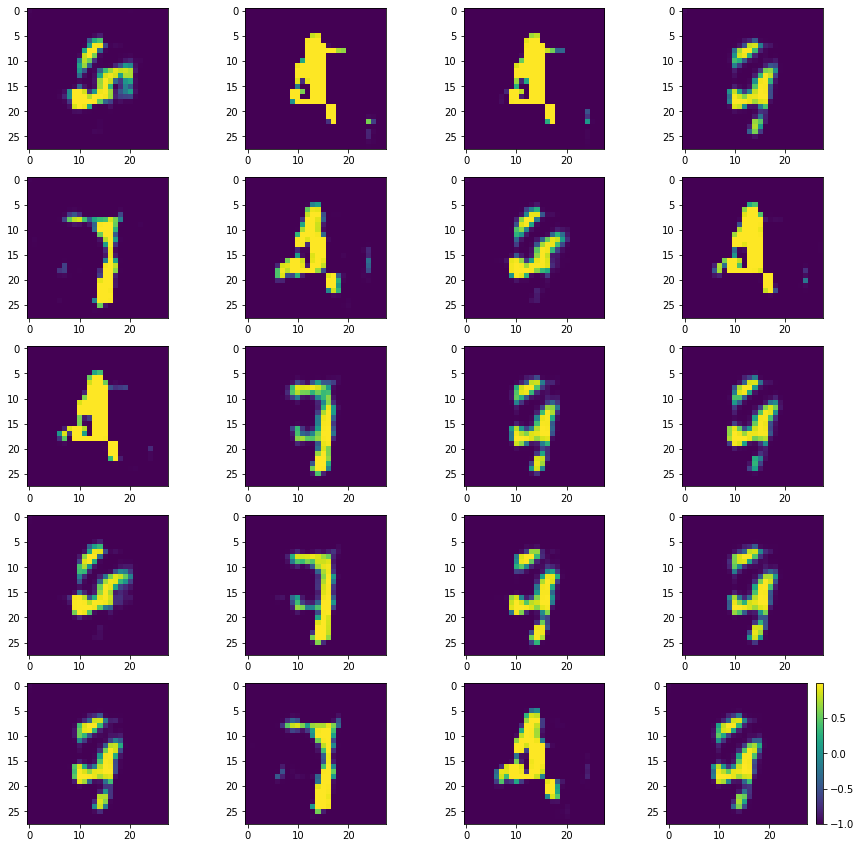

Batch_Num : 122
D_Loss   :   [10.551228523254395, 0.15426430106163025, 10.396964073181152, 0.498046875, 0.119140625] ;    GAN_Loss   :  [14.086370468139648, 4.162169933319092, 9.924201011657715, 0.0, 0.1015625]
Batch_Num : 123
D_Loss   :   [9.940516471862793, 0.17039787769317627, 9.770118713378906, 0.498046875, 0.119140625] ;    GAN_Loss   :  [13.404346466064453, 3.9156155586242676, 9.488730430603027, 0.0, 0.095703125]
Batch_Num : 124
D_Loss   :   [10.261170387268066, 0.14708752930164337, 10.114083290100098, 0.5, 0.099609375] ;    GAN_Loss   :  [13.713577270507812, 3.5639572143554688, 10.149620056152344, 0.0, 0.115234375]
Batch_Num : 125
D_Loss   :   [10.460626602172852, 0.16520625352859497, 10.29542064666748, 0.498046875, 0.107421875] ;    GAN_Loss   :  [14.224166870117188, 4.14570951461792, 10.07845687866211, 0.0, 0.08984375]
Batch_Num : 126
D_Loss   :   [10.383230209350586, 0.14108318090438843, 10.242147445678711, 0.494140625, 0.09765625] ;    GAN_Loss   :  [14.998611450195312, 4.98

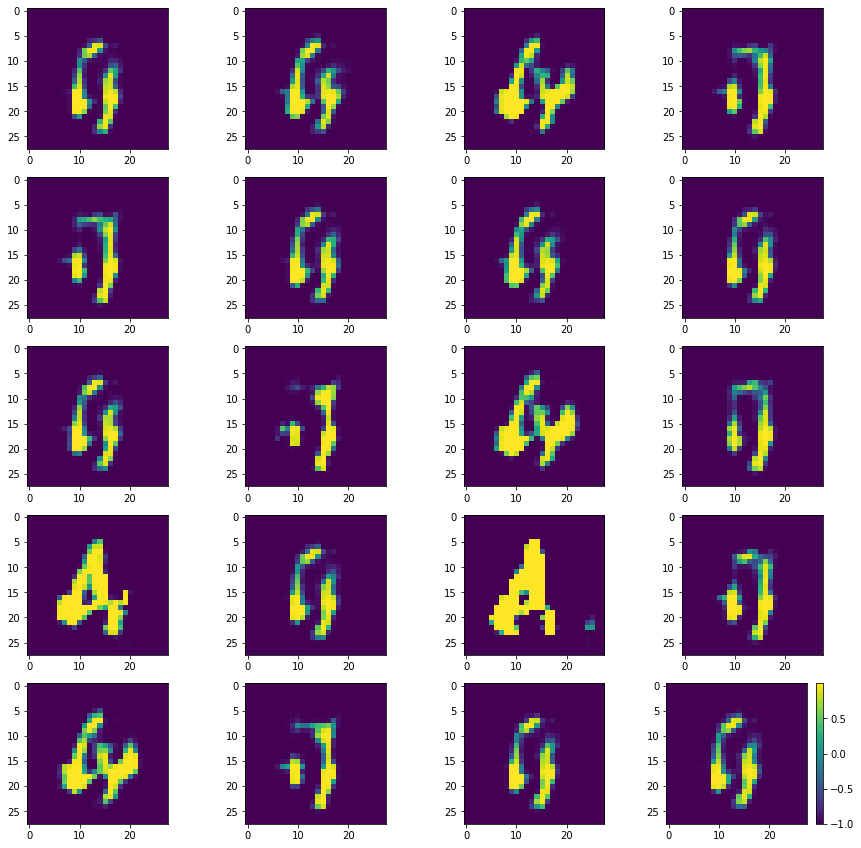

Batch_Num : 137
D_Loss   :   [10.805521011352539, 0.18546126782894135, 10.620059967041016, 0.490234375, 0.134765625] ;    GAN_Loss   :  [13.180137634277344, 3.456599712371826, 9.723538398742676, 0.0, 0.130859375]
Batch_Num : 138
D_Loss   :   [10.039458274841309, 0.14936672151088715, 9.890091896057129, 0.5, 0.095703125] ;    GAN_Loss   :  [13.512167930603027, 3.6729507446289062, 9.839217185974121, 0.0, 0.123046875]
Batch_Num : 139
D_Loss   :   [9.962140083312988, 0.16618607938289642, 9.795953750610352, 0.5, 0.0859375] ;    GAN_Loss   :  [13.575017929077148, 4.0040411949157715, 9.570976257324219, 0.0, 0.158203125]
Batch_Num : 140
D_Loss   :   [9.547074317932129, 0.15425419807434082, 9.392820358276367, 0.5, 0.111328125] ;    GAN_Loss   :  [14.245367050170898, 4.3170928955078125, 9.928274154663086, 0.0, 0.115234375]
Batch_Num : 141
D_Loss   :   [10.115996360778809, 0.14720667898654938, 9.968790054321289, 0.5, 0.1015625] ;    GAN_Loss   :  [14.096952438354492, 4.327197074890137, 9.769755363

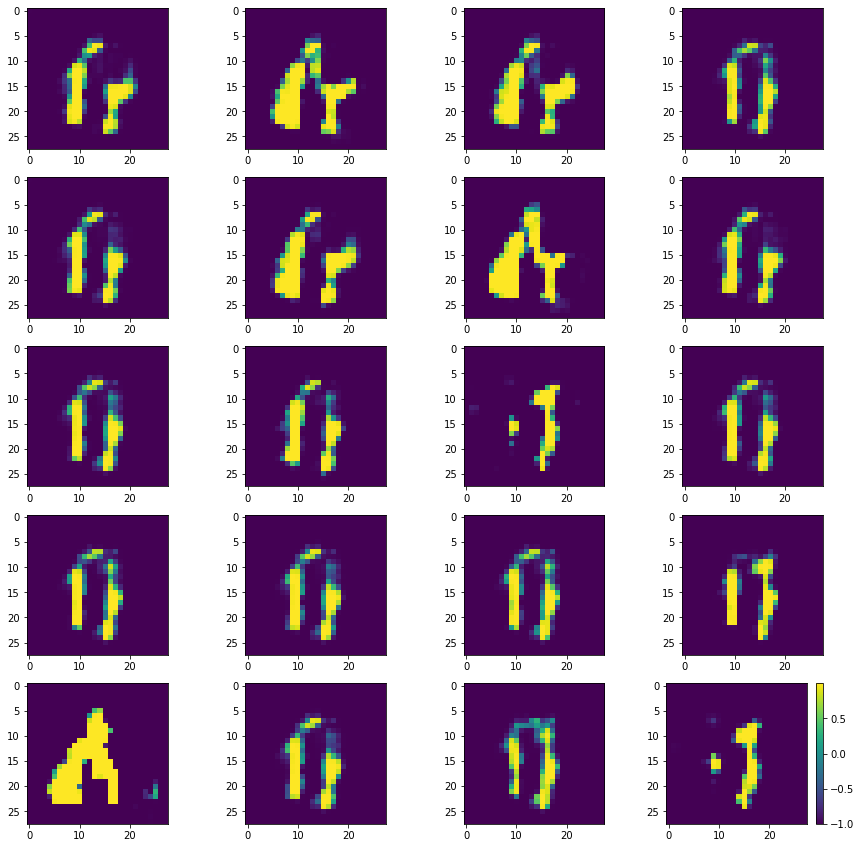

Batch_Num : 152
D_Loss   :   [9.797323226928711, 0.1303456872701645, 9.666977882385254, 0.5, 0.09375] ;    GAN_Loss   :  [15.505157470703125, 5.691583633422852, 9.813573837280273, 0.0, 0.099609375]
Batch_Num : 153
D_Loss   :   [10.051766395568848, 0.12729677557945251, 9.924469947814941, 0.498046875, 0.09765625] ;    GAN_Loss   :  [16.278614044189453, 5.9546051025390625, 10.324009895324707, 0.0, 0.091796875]
Batch_Num : 154
D_Loss   :   [10.02273178100586, 0.1319981813430786, 9.89073371887207, 0.5, 0.08203125] ;    GAN_Loss   :  [17.19486427307129, 6.347501277923584, 10.847363471984863, 0.0, 0.087890625]
Batch_Num : 155
D_Loss   :   [10.372879028320312, 0.12140755355358124, 10.251471519470215, 0.5, 0.12890625] ;    GAN_Loss   :  [17.295684814453125, 6.590242385864258, 10.70544147491455, 0.0, 0.11328125]
Batch_Num : 156
D_Loss   :   [9.48762321472168, 0.12115602940320969, 9.366467475891113, 0.5, 0.109375] ;    GAN_Loss   :  [17.04521369934082, 6.331836700439453, 10.713376998901367, 0.0, 

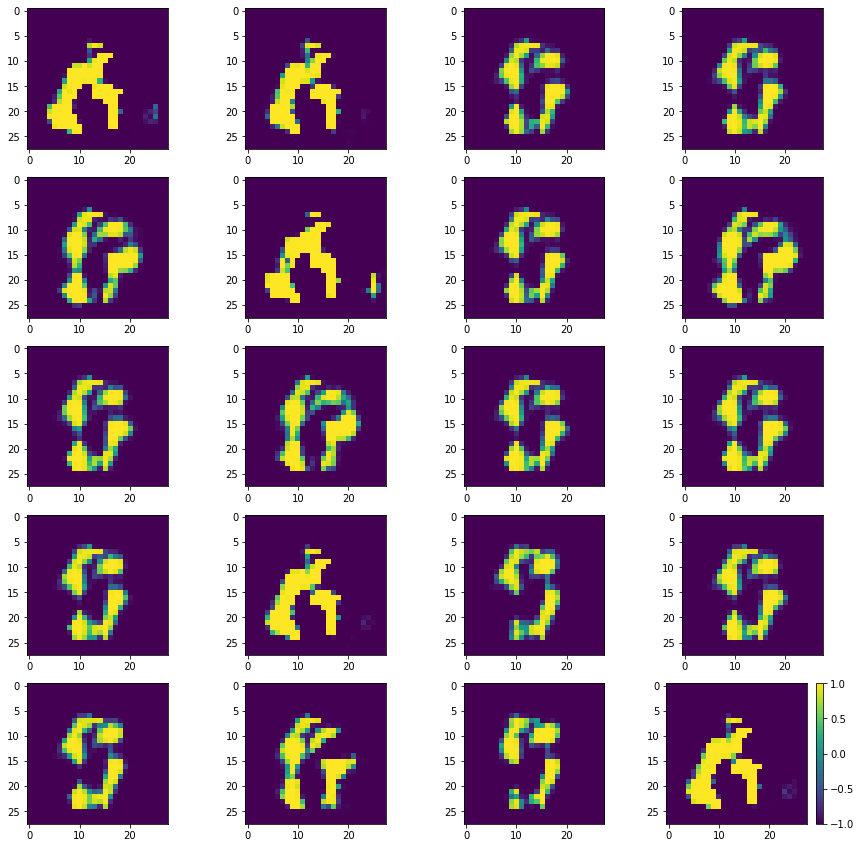

Batch_Num : 167
D_Loss   :   [10.570016860961914, 0.18177004158496857, 10.388246536254883, 0.5, 0.080078125] ;    GAN_Loss   :  [15.32607364654541, 4.922226905822754, 10.403846740722656, 0.0, 0.07421875]
Batch_Num : 168
D_Loss   :   [9.607712745666504, 0.17746974527835846, 9.430242538452148, 0.5, 0.072265625] ;    GAN_Loss   :  [14.782747268676758, 4.731916904449463, 10.050830841064453, 0.0, 0.05078125]
Batch_Num : 169
D_Loss   :   [10.102978706359863, 0.15745744109153748, 9.945521354675293, 0.5, 0.078125] ;    GAN_Loss   :  [15.057069778442383, 4.588379859924316, 10.468689918518066, 0.0, 0.04296875]
Batch_Num : 170
D_Loss   :   [10.0789213180542, 0.1529047191143036, 9.926016807556152, 0.5, 0.087890625] ;    GAN_Loss   :  [14.496516227722168, 4.212678909301758, 10.28383731842041, 0.0, 0.083984375]
Batch_Num : 171
D_Loss   :   [10.429975509643555, 0.1597059965133667, 10.270269393920898, 0.5, 0.08203125] ;    GAN_Loss   :  [14.074204444885254, 3.390292167663574, 10.68391227722168, 0.0, 0

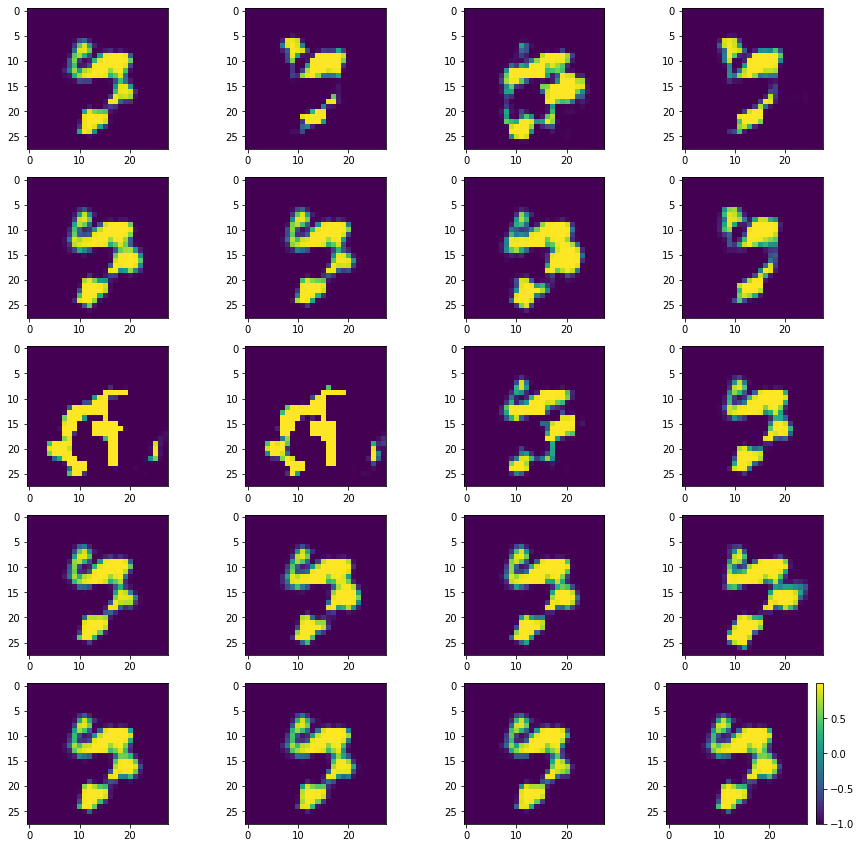

Batch_Num : 182
D_Loss   :   [9.707279205322266, 0.13425028324127197, 9.573028564453125, 0.5, 0.099609375] ;    GAN_Loss   :  [14.823074340820312, 4.504049301147461, 10.319025039672852, 0.0, 0.1484375]
Batch_Num : 183
D_Loss   :   [10.353466987609863, 0.12864814698696136, 10.22481918334961, 0.5, 0.103515625] ;    GAN_Loss   :  [14.581003189086914, 4.717123031616211, 9.863880157470703, 0.0, 0.150390625]
Batch_Num : 184
D_Loss   :   [9.840683937072754, 0.13916391134262085, 9.701519966125488, 0.5, 0.091796875] ;    GAN_Loss   :  [14.89621353149414, 4.607282638549805, 10.288930892944336, 0.0, 0.13671875]
Batch_Num : 185
D_Loss   :   [9.9276762008667, 0.14819218218326569, 9.779483795166016, 0.5, 0.095703125] ;    GAN_Loss   :  [14.441944122314453, 4.275010108947754, 10.1669340133667, 0.0, 0.115234375]
Batch_Num : 186
D_Loss   :   [9.506950378417969, 0.13889333605766296, 9.368057250976562, 0.5, 0.109375] ;    GAN_Loss   :  [14.117772102355957, 4.052309036254883, 10.065463066101074, 0.0, 0.11

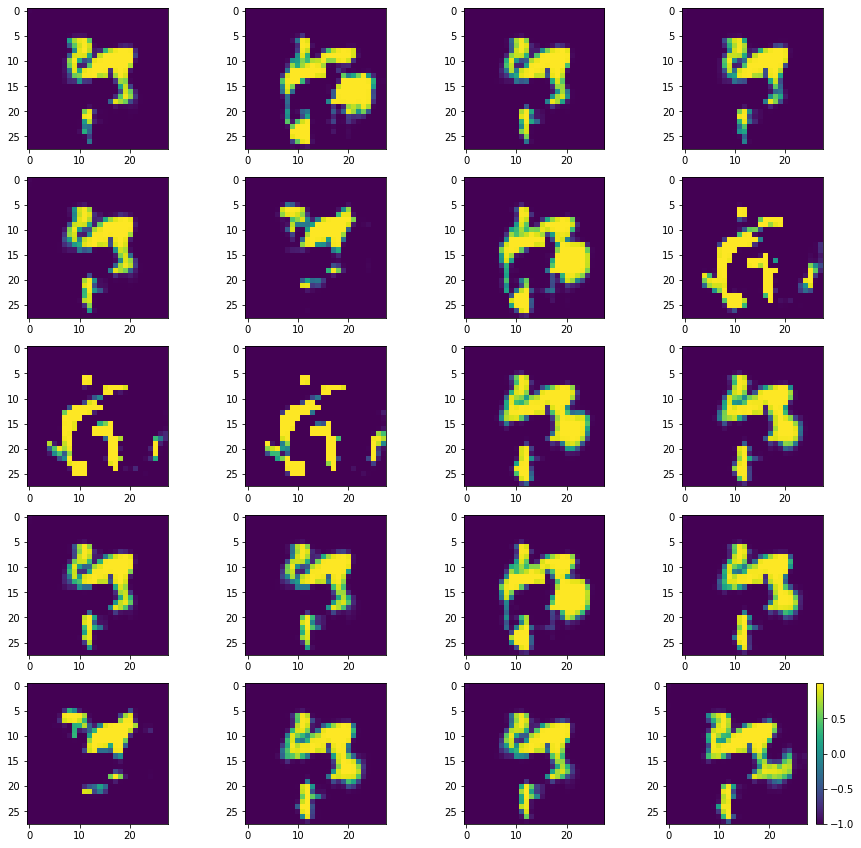

Batch_Num : 197
D_Loss   :   [9.95277214050293, 0.12171326577663422, 9.831058502197266, 0.5, 0.08203125] ;    GAN_Loss   :  [15.281763076782227, 4.557928562164307, 10.723834991455078, 0.0, 0.078125]
Batch_Num : 198
D_Loss   :   [9.661420822143555, 0.12307886779308319, 9.538341522216797, 0.498046875, 0.06640625] ;    GAN_Loss   :  [15.046160697937012, 3.8010425567626953, 11.245118141174316, 0.0, 0.072265625]
Batch_Num : 199
D_Loss   :   [10.563554763793945, 0.12883910536766052, 10.434715270996094, 0.5, 0.0859375] ;    GAN_Loss   :  [14.310303688049316, 3.314846992492676, 10.99545669555664, 0.0, 0.076171875]
Batch_Num : 200
D_Loss   :   [10.140193939208984, 0.12992271780967712, 10.010271072387695, 0.5, 0.07421875] ;    GAN_Loss   :  [14.185135841369629, 3.3842344284057617, 10.800901412963867, 0.0, 0.080078125]
Batch_Num : 201
D_Loss   :   [10.376554489135742, 0.1335740089416504, 10.24298095703125, 0.49609375, 0.076171875] ;    GAN_Loss   :  [14.869415283203125, 3.69994854927063, 11.16946

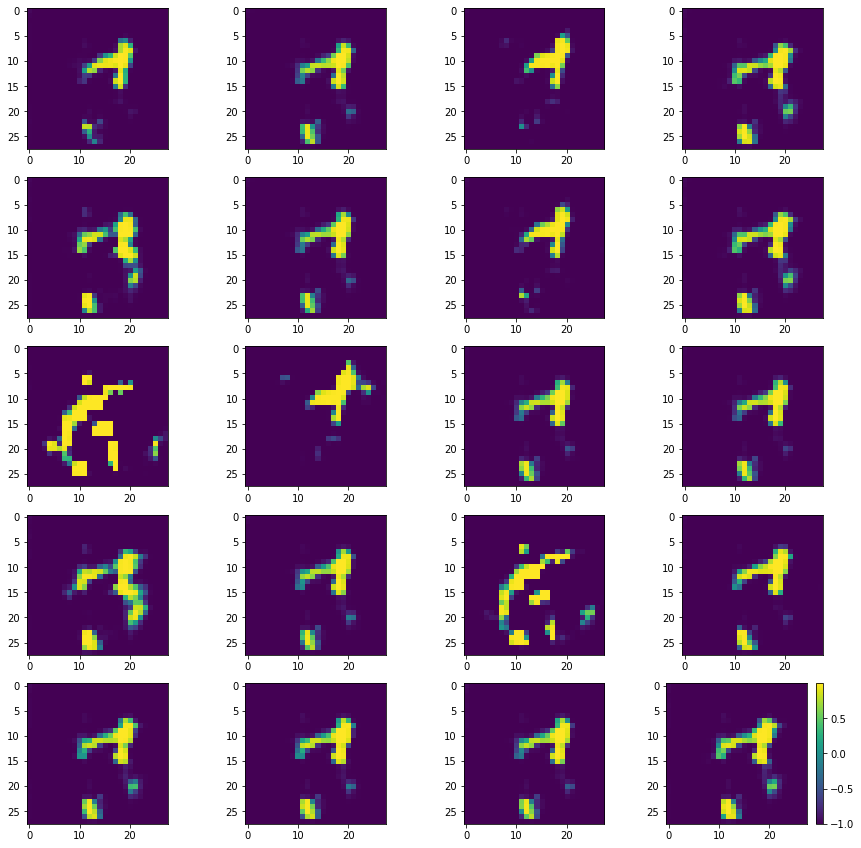

Batch_Num : 212
D_Loss   :   [10.894740104675293, 0.12056027352809906, 10.774179458618164, 0.5, 0.078125] ;    GAN_Loss   :  [19.372098922729492, 7.054442405700684, 12.317656517028809, 0.0, 0.0703125]
Batch_Num : 213
D_Loss   :   [9.588252067565918, 0.12635920941829681, 9.461893081665039, 0.5, 0.06640625] ;    GAN_Loss   :  [19.726516723632812, 7.195064067840576, 12.531452178955078, 0.0, 0.064453125]
Batch_Num : 214
D_Loss   :   [10.349225997924805, 0.12403327226638794, 10.22519302368164, 0.5, 0.080078125] ;    GAN_Loss   :  [21.896352767944336, 9.431665420532227, 12.46468734741211, 0.0, 0.06640625]
Batch_Num : 215
D_Loss   :   [9.191959381103516, 0.12510541081428528, 9.066853523254395, 0.5, 0.05859375] ;    GAN_Loss   :  [21.038211822509766, 8.285528182983398, 12.75268268585205, 0.0, 0.0703125]
Batch_Num : 216
D_Loss   :   [10.398248672485352, 0.12184982746839523, 10.276398658752441, 0.5, 0.087890625] ;    GAN_Loss   :  [20.137937545776367, 7.316122531890869, 12.821815490722656, 0.0, 

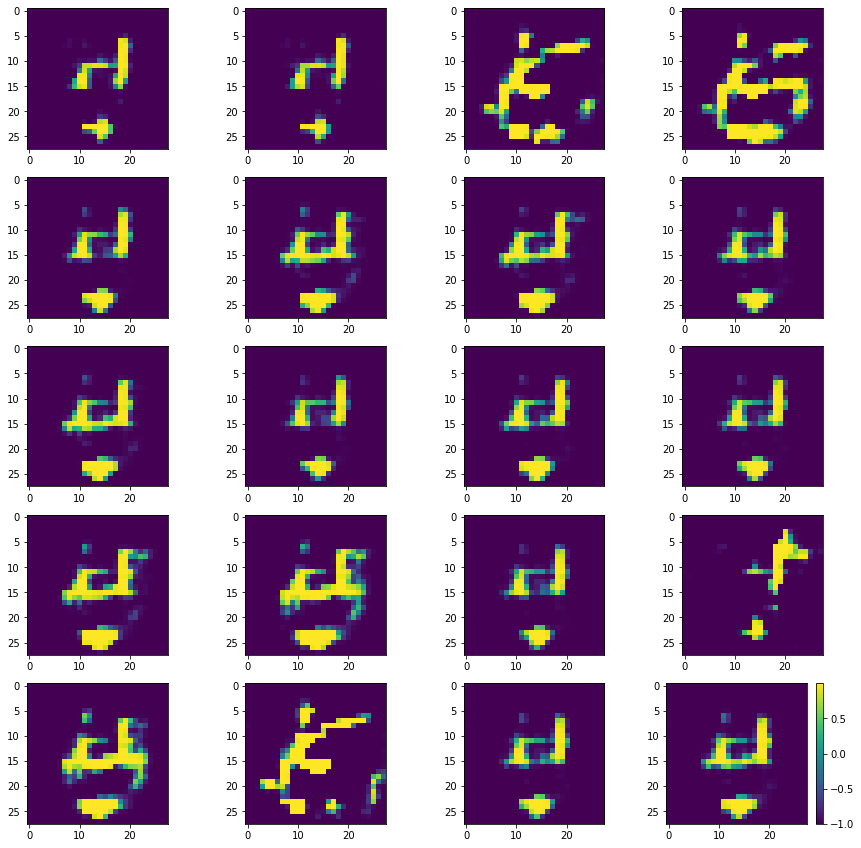

Batch_Num : 227
D_Loss   :   [9.237465858459473, 0.11979356408119202, 9.117671966552734, 0.5, 0.083984375] ;    GAN_Loss   :  [15.262795448303223, 4.212703704833984, 11.050091743469238, 0.0, 0.064453125]
Batch_Num : 228
D_Loss   :   [10.358824729919434, 0.13307923078536987, 10.22574520111084, 0.5, 0.078125] ;    GAN_Loss   :  [15.206184387207031, 3.7403931617736816, 11.465790748596191, 0.0, 0.064453125]
Batch_Num : 229
D_Loss   :   [9.761260032653809, 0.11961906403303146, 9.641640663146973, 0.5, 0.087890625] ;    GAN_Loss   :  [15.184038162231445, 3.8910391330718994, 11.292999267578125, 0.0, 0.072265625]
Batch_Num : 230
D_Loss   :   [10.086105346679688, 0.11852504312992096, 9.96757984161377, 0.5, 0.05859375] ;    GAN_Loss   :  [15.44710922241211, 4.080790042877197, 11.366318702697754, 0.0, 0.0703125]
Batch_Num : 231
D_Loss   :   [10.320462226867676, 0.1119338795542717, 10.208528518676758, 0.5, 0.07421875] ;    GAN_Loss   :  [14.716623306274414, 3.494513750076294, 11.2221097946167, 0.0,

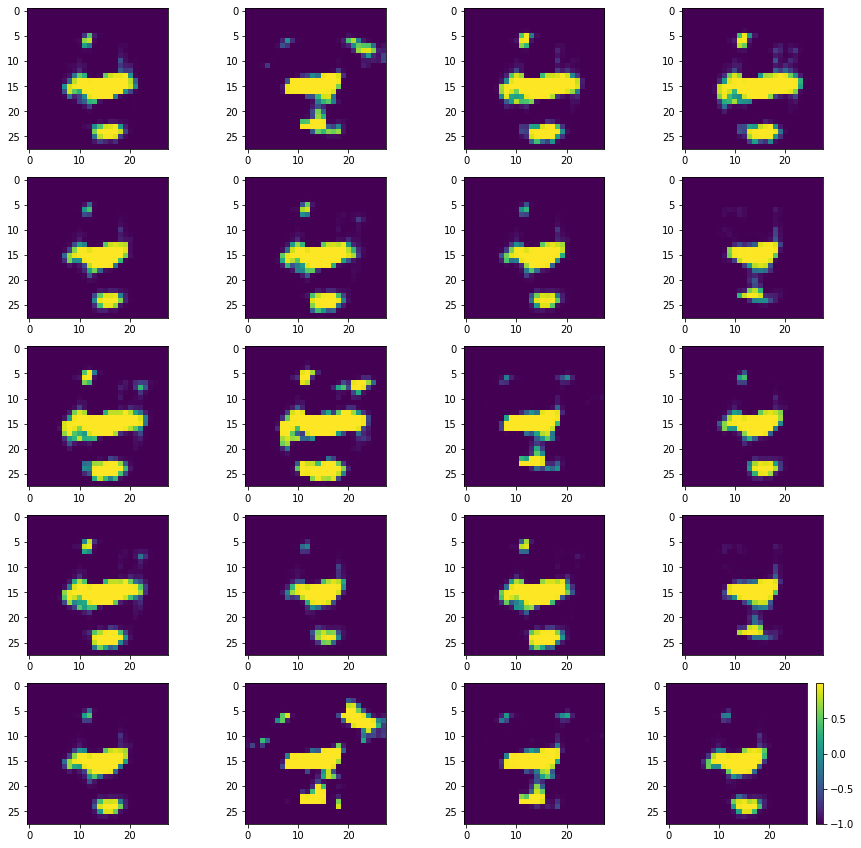

Batch_Num : 2
D_Loss   :   [10.156718254089355, 0.16162599623203278, 9.995092391967773, 0.498046875, 0.12890625] ;    GAN_Loss   :  [18.726741790771484, 8.189986228942871, 10.53675651550293, 0.0, 0.056640625]
Batch_Num : 3
D_Loss   :   [10.184956550598145, 0.15696817636489868, 10.02798843383789, 0.494140625, 0.099609375] ;    GAN_Loss   :  [17.344947814941406, 7.196572303771973, 10.14837646484375, 0.0, 0.09375]
Batch_Num : 4
D_Loss   :   [10.387089729309082, 0.18516004085540771, 10.201930046081543, 0.4921875, 0.123046875] ;    GAN_Loss   :  [16.056861877441406, 6.582914352416992, 9.473946571350098, 0.0, 0.06640625]
Batch_Num : 5
D_Loss   :   [10.223029136657715, 0.17785970866680145, 10.045169830322266, 0.490234375, 0.130859375] ;    GAN_Loss   :  [15.380268096923828, 5.994511127471924, 9.385757446289062, 0.0, 0.0625]
Batch_Num : 6
D_Loss   :   [10.525339126586914, 0.17769187688827515, 10.347647666931152, 0.4921875, 0.130859375] ;    GAN_Loss   :  [15.80720329284668, 5.9361395835876465,

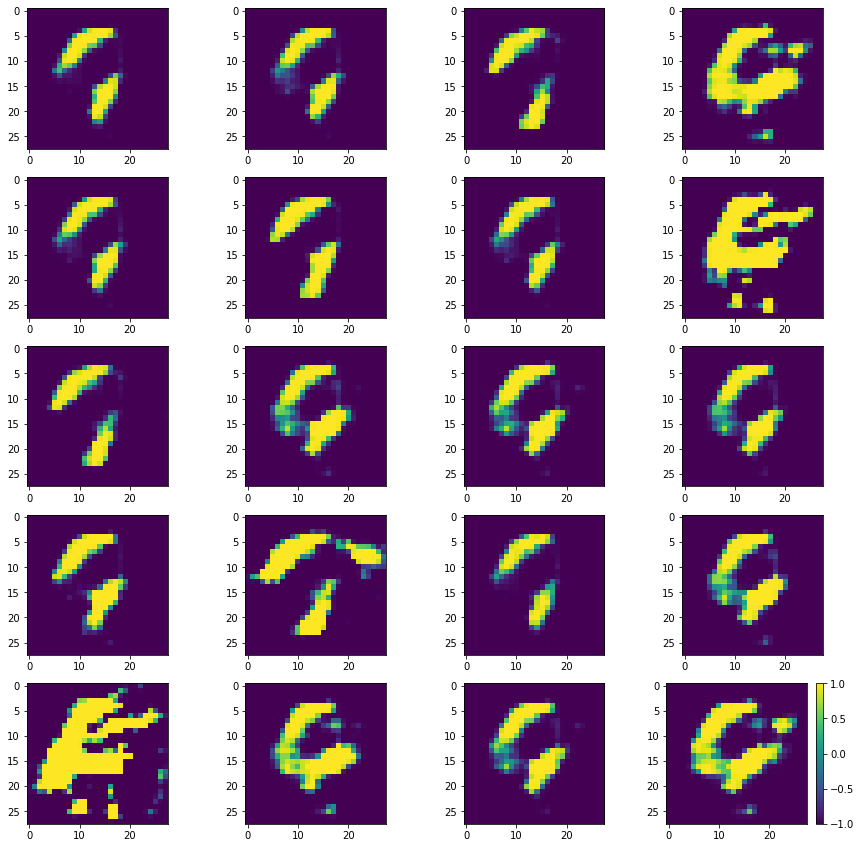

Batch_Num : 17
D_Loss   :   [9.798650741577148, 0.14534354209899902, 9.65330696105957, 0.5, 0.103515625] ;    GAN_Loss   :  [17.986413955688477, 5.168667793273926, 12.81774616241455, 0.0, 0.134765625]
Batch_Num : 18
D_Loss   :   [9.950244903564453, 0.14415095746517181, 9.8060941696167, 0.5, 0.103515625] ;    GAN_Loss   :  [18.801273345947266, 5.897891998291016, 12.90338134765625, 0.0, 0.123046875]
Batch_Num : 19
D_Loss   :   [10.022189140319824, 0.14334848523139954, 9.878840446472168, 0.5, 0.08984375] ;    GAN_Loss   :  [20.094215393066406, 7.058915615081787, 13.035300254821777, 0.0, 0.1015625]
Batch_Num : 20
D_Loss   :   [9.83398151397705, 0.1383894383907318, 9.695591926574707, 0.498046875, 0.0703125] ;    GAN_Loss   :  [20.126842498779297, 7.118701457977295, 13.00814151763916, 0.0, 0.080078125]
Batch_Num : 21
D_Loss   :   [9.661340713500977, 0.1182936504483223, 9.543046951293945, 0.5, 0.09765625] ;    GAN_Loss   :  [18.669116973876953, 6.3422017097473145, 12.32691478729248, 0.0, 0.11

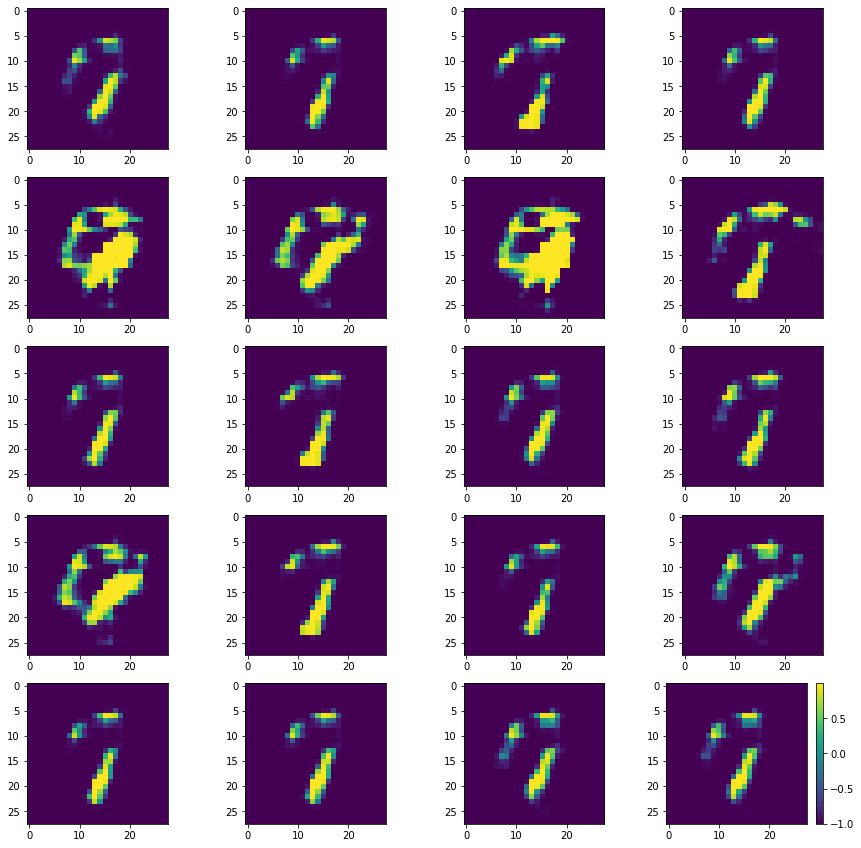

Batch_Num : 32
D_Loss   :   [9.733272552490234, 0.15878748893737793, 9.574484825134277, 0.498046875, 0.078125] ;    GAN_Loss   :  [15.537059783935547, 3.83866548538208, 11.698393821716309, 0.0, 0.064453125]
Batch_Num : 33
D_Loss   :   [10.31436538696289, 0.15120045840740204, 10.163165092468262, 0.4921875, 0.083984375] ;    GAN_Loss   :  [15.425875663757324, 3.4272072315216064, 11.998668670654297, 0.0, 0.064453125]
Batch_Num : 34
D_Loss   :   [10.361393928527832, 0.14874492585659027, 10.21264934539795, 0.49609375, 0.099609375] ;    GAN_Loss   :  [16.64669418334961, 4.2652907371521, 12.381402969360352, 0.0, 0.0703125]
Batch_Num : 35
D_Loss   :   [9.60805892944336, 0.14220598340034485, 9.465852737426758, 0.5, 0.091796875] ;    GAN_Loss   :  [17.755149841308594, 4.911246299743652, 12.843902587890625, 0.0, 0.0703125]
Batch_Num : 36
D_Loss   :   [9.69061279296875, 0.1446014940738678, 9.546010971069336, 0.5, 0.08203125] ;    GAN_Loss   :  [16.83534812927246, 4.590611934661865, 12.244735717773

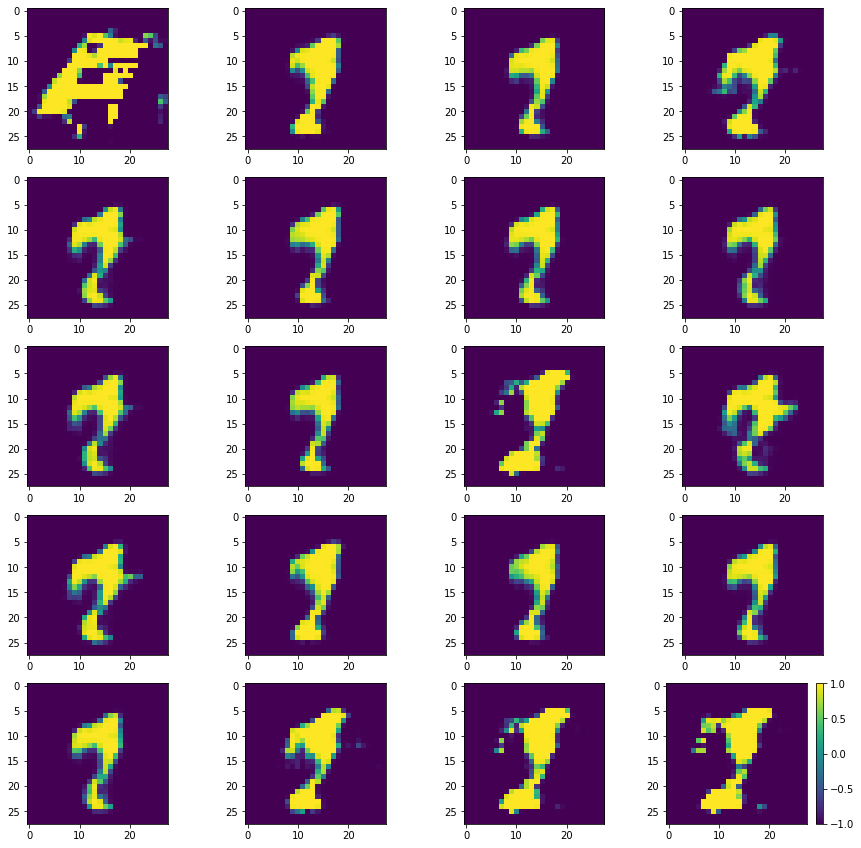

Batch_Num : 47
D_Loss   :   [10.661839485168457, 0.1358916461467743, 10.525947570800781, 0.5, 0.083984375] ;    GAN_Loss   :  [11.147316932678223, 1.094229817390442, 10.05308723449707, 0.0, 0.06640625]
Batch_Num : 48
D_Loss   :   [10.110827445983887, 0.13405364751815796, 9.976774215698242, 0.5, 0.09765625] ;    GAN_Loss   :  [11.072144508361816, 1.104651689529419, 9.967493057250977, 0.0, 0.0859375]
Batch_Num : 49
D_Loss   :   [10.033151626586914, 0.13013862073421478, 9.903013229370117, 0.5, 0.076171875] ;    GAN_Loss   :  [10.967694282531738, 1.0498802661895752, 9.917814254760742, 0.0, 0.078125]
Batch_Num : 50
D_Loss   :   [9.752419471740723, 0.12504138052463531, 9.627378463745117, 0.5, 0.09765625] ;    GAN_Loss   :  [10.899199485778809, 0.8775640726089478, 10.021635055541992, 0.0, 0.080078125]
Batch_Num : 51
D_Loss   :   [10.428115844726562, 0.17031338810920715, 10.25780200958252, 0.5, 0.115234375] ;    GAN_Loss   :  [11.154850959777832, 0.7782784700393677, 10.376572608947754, 0.0, 0.

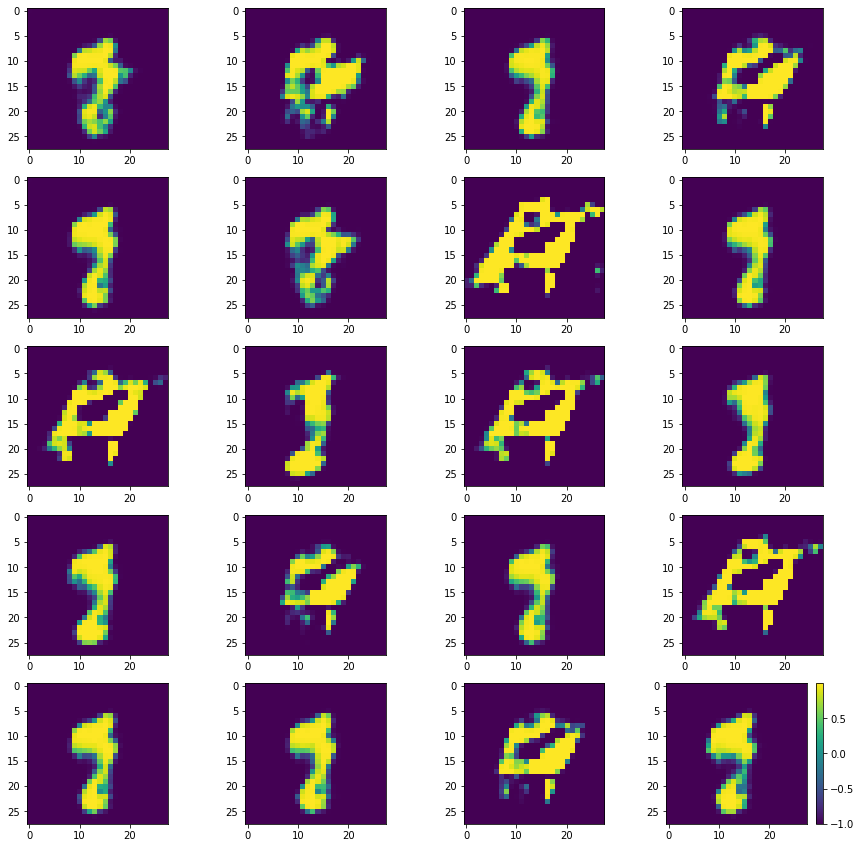

Batch_Num : 62
D_Loss   :   [9.744257926940918, 0.11972307413816452, 9.624534606933594, 0.5, 0.068359375] ;    GAN_Loss   :  [10.686576843261719, 0.5651593804359436, 10.121417045593262, 0.0, 0.076171875]
Batch_Num : 63
D_Loss   :   [10.014573097229004, 0.127724289894104, 9.886848449707031, 0.5, 0.09375] ;    GAN_Loss   :  [10.887748718261719, 0.5373458862304688, 10.35040283203125, 0.0, 0.06640625]
Batch_Num : 64
D_Loss   :   [9.994291305541992, 0.12770648300647736, 9.866584777832031, 0.5, 0.08203125] ;    GAN_Loss   :  [10.37088680267334, 0.41670718789100647, 9.954179763793945, 0.0, 0.05859375]
Batch_Num : 65
D_Loss   :   [10.1297025680542, 0.12607787549495697, 10.00362491607666, 0.5, 0.08984375] ;    GAN_Loss   :  [10.580321311950684, 0.3846692442893982, 10.19565200805664, 0.0, 0.08984375]
Batch_Num : 66
D_Loss   :   [10.76472282409668, 0.13160741329193115, 10.633115768432617, 0.5, 0.06640625] ;    GAN_Loss   :  [10.546265602111816, 0.40251636505126953, 10.143749237060547, 0.0, 0.0683

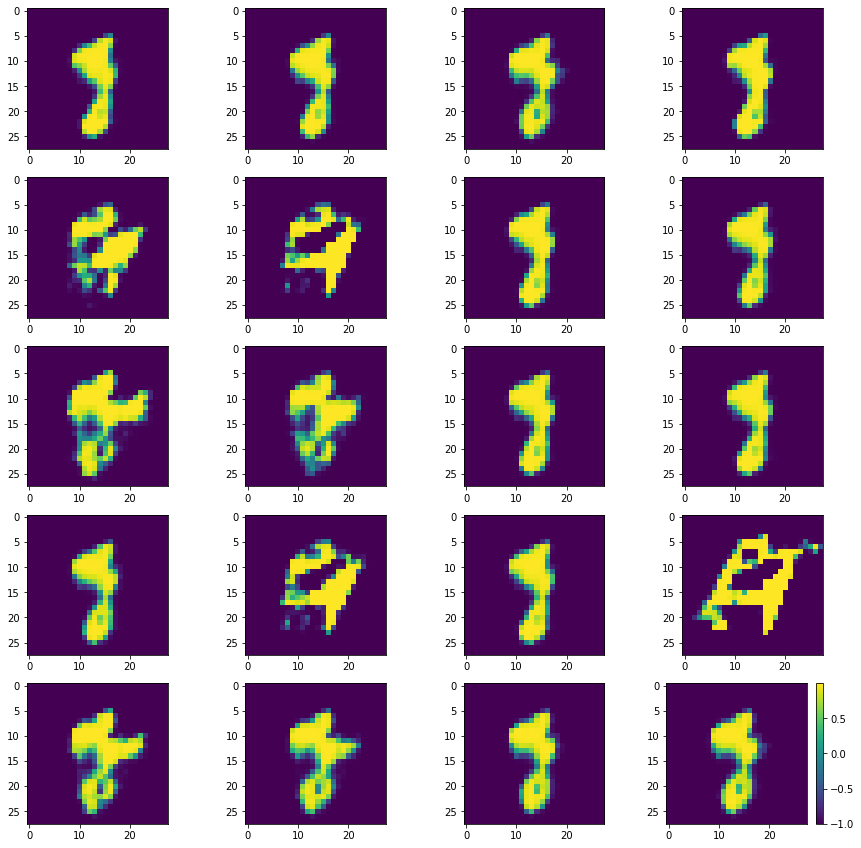

Batch_Num : 77
D_Loss   :   [10.036632537841797, 0.12546293437480927, 9.91117000579834, 0.5, 0.10546875] ;    GAN_Loss   :  [10.307036399841309, 0.3916064500808716, 9.915430068969727, 0.0, 0.099609375]
Batch_Num : 78
D_Loss   :   [9.677840232849121, 0.121495321393013, 9.556344985961914, 0.5, 0.078125] ;    GAN_Loss   :  [11.100334167480469, 0.5166642069816589, 10.583669662475586, 0.0, 0.0703125]
Batch_Num : 79
D_Loss   :   [10.458574295043945, 0.12097730487585068, 10.337596893310547, 0.5, 0.072265625] ;    GAN_Loss   :  [10.574913024902344, 0.48853179812431335, 10.086380958557129, 0.0, 0.072265625]
Batch_Num : 80
D_Loss   :   [10.000207901000977, 0.11774978041648865, 9.882457733154297, 0.5, 0.08203125] ;    GAN_Loss   :  [10.849213600158691, 0.44275838136672974, 10.406455039978027, 0.0, 0.09375]
Batch_Num : 81
D_Loss   :   [10.236335754394531, 0.12244541943073273, 10.113890647888184, 0.5, 0.091796875] ;    GAN_Loss   :  [10.61166763305664, 0.4217909276485443, 10.189876556396484, 0.0, 0

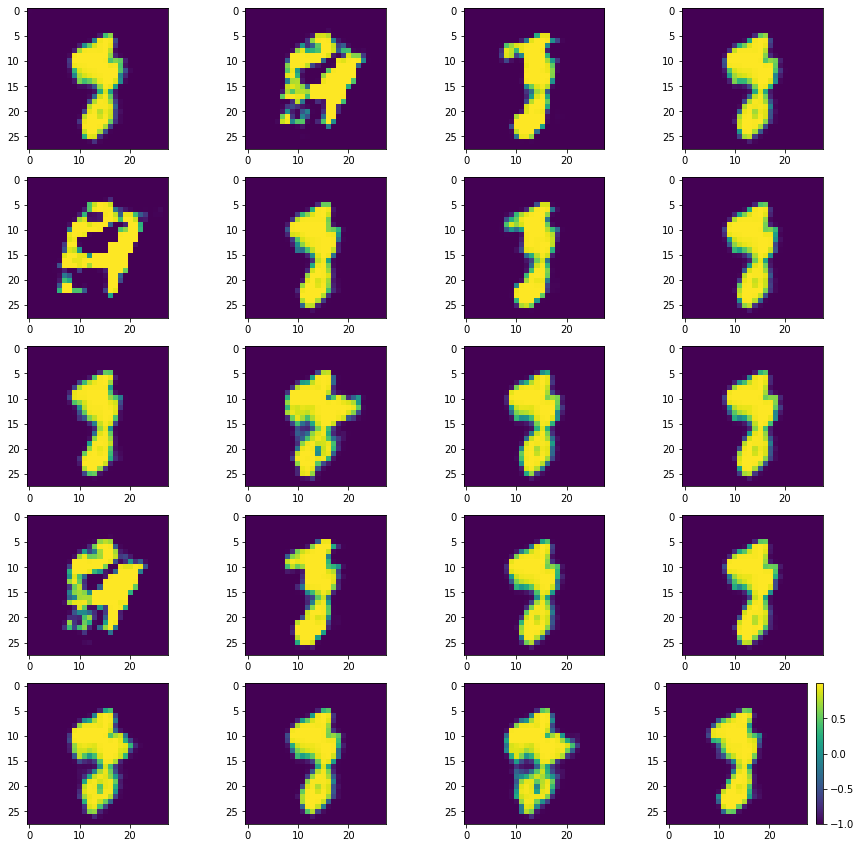

Batch_Num : 92
D_Loss   :   [10.127354621887207, 0.11458870023488998, 10.012765884399414, 0.5, 0.06640625] ;    GAN_Loss   :  [10.251334190368652, 0.39929917454719543, 9.852034568786621, 0.0, 0.09375]
Batch_Num : 93
D_Loss   :   [10.569108963012695, 0.11936044692993164, 10.449748992919922, 0.5, 0.078125] ;    GAN_Loss   :  [10.01784610748291, 0.41334062814712524, 9.60450553894043, 0.0, 0.076171875]
Batch_Num : 94
D_Loss   :   [9.976106643676758, 0.11171917617321014, 9.864387512207031, 0.5, 0.09375] ;    GAN_Loss   :  [10.088789939880371, 0.3774423897266388, 9.711347579956055, 0.0, 0.119140625]
Batch_Num : 95
D_Loss   :   [10.16580581665039, 0.11902416497468948, 10.046781539916992, 0.5, 0.091796875] ;    GAN_Loss   :  [10.458109855651855, 0.34681636095046997, 10.11129379272461, 0.0, 0.103515625]
Batch_Num : 96
D_Loss   :   [9.712318420410156, 0.11381909996271133, 9.598499298095703, 0.5, 0.07421875] ;    GAN_Loss   :  [10.14235782623291, 0.36303409934043884, 9.77932357788086, 0.0, 0.1210

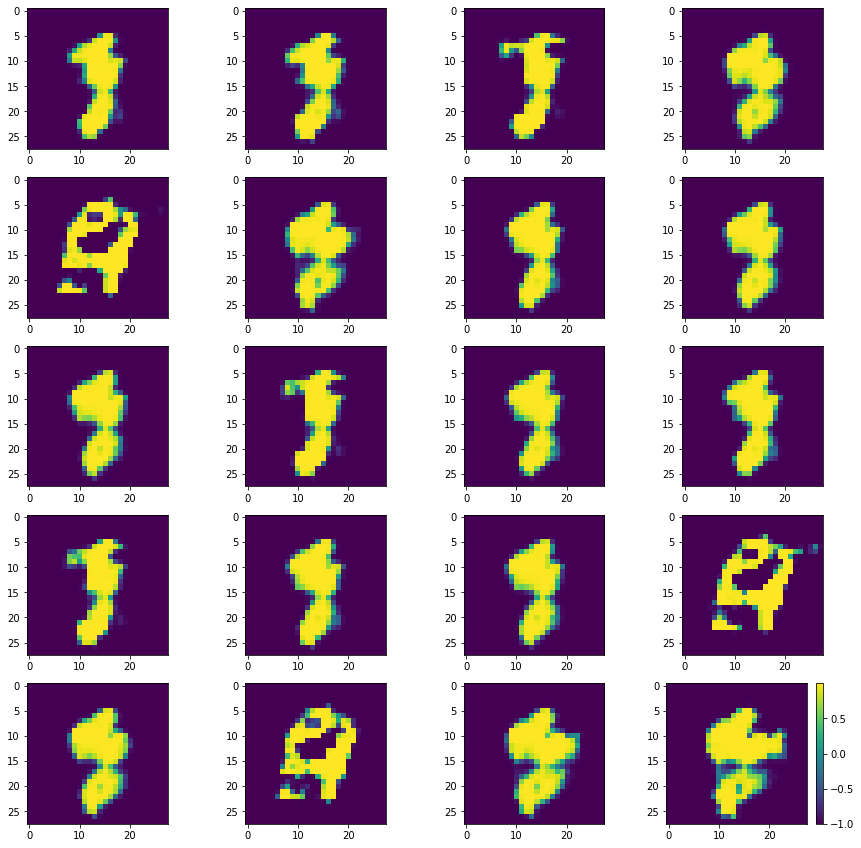

Batch_Num : 107
D_Loss   :   [9.990415573120117, 0.11683575809001923, 9.873579978942871, 0.5, 0.0703125] ;    GAN_Loss   :  [10.6974458694458, 0.41831129789352417, 10.279134750366211, 0.0, 0.12109375]
Batch_Num : 108
D_Loss   :   [9.421095848083496, 0.1172075942158699, 9.303888320922852, 0.5, 0.080078125] ;    GAN_Loss   :  [10.596867561340332, 0.407835453748703, 10.189032554626465, 0.0, 0.1015625]
Batch_Num : 109
D_Loss   :   [9.633891105651855, 0.1124725416302681, 9.521418571472168, 0.5, 0.0625] ;    GAN_Loss   :  [10.061859130859375, 0.4306795001029968, 9.631179809570312, 0.0, 0.080078125]
Batch_Num : 110
D_Loss   :   [10.329082489013672, 0.11230622977018356, 10.216775894165039, 0.5, 0.076171875] ;    GAN_Loss   :  [11.079462051391602, 0.41588011384010315, 10.663581848144531, 0.0, 0.103515625]
Batch_Num : 111
D_Loss   :   [9.518009185791016, 0.12494313716888428, 9.39306640625, 0.5, 0.0625] ;    GAN_Loss   :  [10.240910530090332, 0.48343217372894287, 9.757478713989258, 0.0, 0.1015625

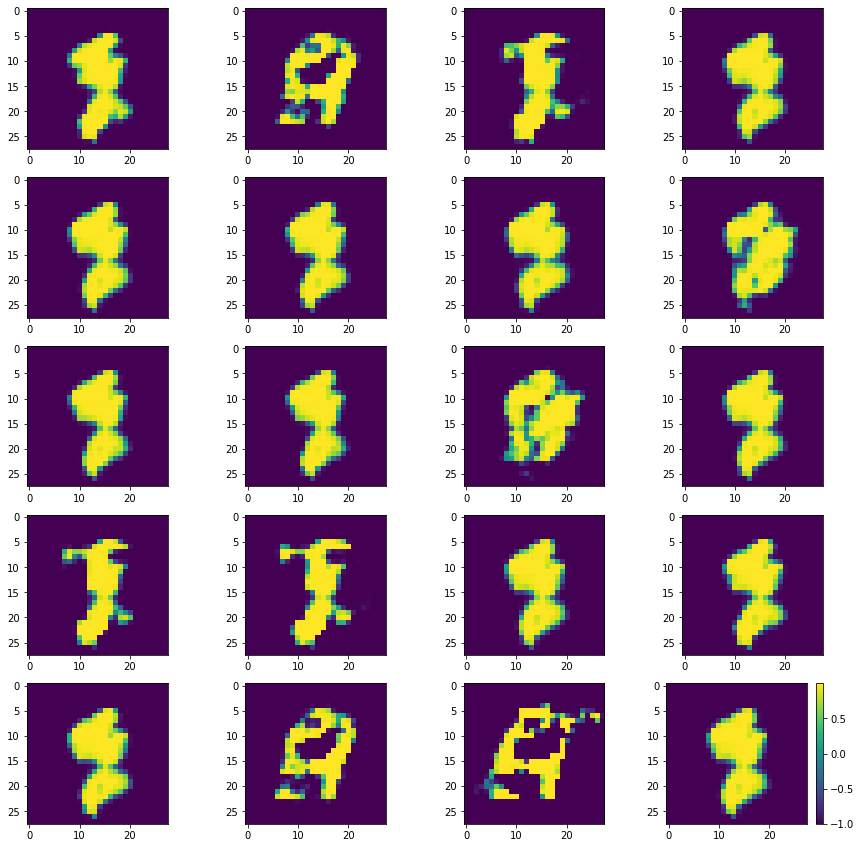

Batch_Num : 122
D_Loss   :   [10.506163597106934, 0.1096065491437912, 10.396556854248047, 0.5, 0.083984375] ;    GAN_Loss   :  [10.154852867126465, 0.46731480956077576, 9.687538146972656, 0.0, 0.103515625]
Batch_Num : 123
D_Loss   :   [9.880462646484375, 0.11043736338615417, 9.770025253295898, 0.5, 0.076171875] ;    GAN_Loss   :  [10.16806411743164, 0.41370755434036255, 9.754356384277344, 0.0, 0.091796875]
Batch_Num : 124
D_Loss   :   [10.234234809875488, 0.12056346237659454, 10.11367130279541, 0.5, 0.068359375] ;    GAN_Loss   :  [10.610922813415527, 0.4750474989414215, 10.135875701904297, 0.0, 0.123046875]
Batch_Num : 125
D_Loss   :   [10.422138214111328, 0.1243598535656929, 10.297778129577637, 0.5, 0.095703125] ;    GAN_Loss   :  [10.442609786987305, 0.47425413131713867, 9.968355178833008, 0.0, 0.099609375]
Batch_Num : 126
D_Loss   :   [10.360837936401367, 0.11880607903003693, 10.242032051086426, 0.5, 0.1171875] ;    GAN_Loss   :  [10.686429023742676, 0.5497309565544128, 10.13669776

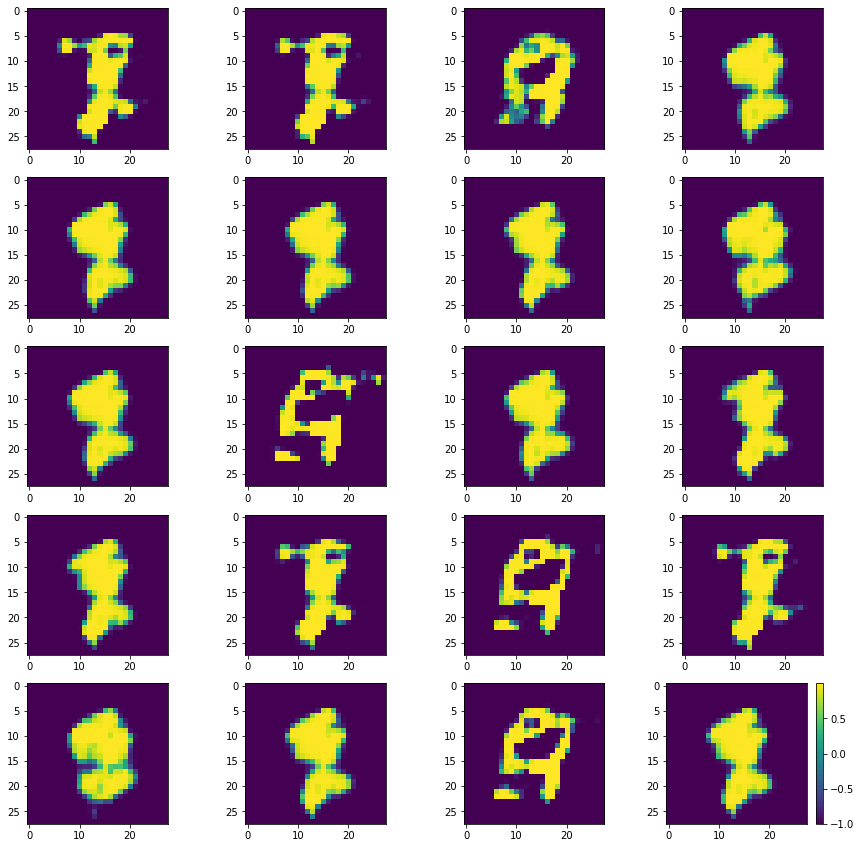

Batch_Num : 137
D_Loss   :   [10.745750427246094, 0.12468770891427994, 10.621062278747559, 0.5, 0.107421875] ;    GAN_Loss   :  [10.88476848602295, 0.4842972457408905, 10.400471687316895, 0.0, 0.12109375]
Batch_Num : 138
D_Loss   :   [10.012211799621582, 0.12155820429325104, 9.890653610229492, 0.5, 0.080078125] ;    GAN_Loss   :  [10.406824111938477, 0.5568984150886536, 9.849925994873047, 0.0, 0.09375]
Batch_Num : 139
D_Loss   :   [9.925376892089844, 0.12906689941883087, 9.796310424804688, 0.5, 0.09765625] ;    GAN_Loss   :  [10.491292953491211, 0.6060466170310974, 9.885246276855469, 0.0, 0.09765625]
Batch_Num : 140
D_Loss   :   [9.510290145874023, 0.11782320588827133, 9.39246654510498, 0.5, 0.083984375] ;    GAN_Loss   :  [10.972570419311523, 0.9199407696723938, 10.052629470825195, 0.0, 0.09765625]
Batch_Num : 141
D_Loss   :   [10.085885047912598, 0.11476562172174454, 9.97111988067627, 0.5, 0.078125] ;    GAN_Loss   :  [10.779755592346191, 0.6116628050804138, 10.168092727661133, 0.0, 

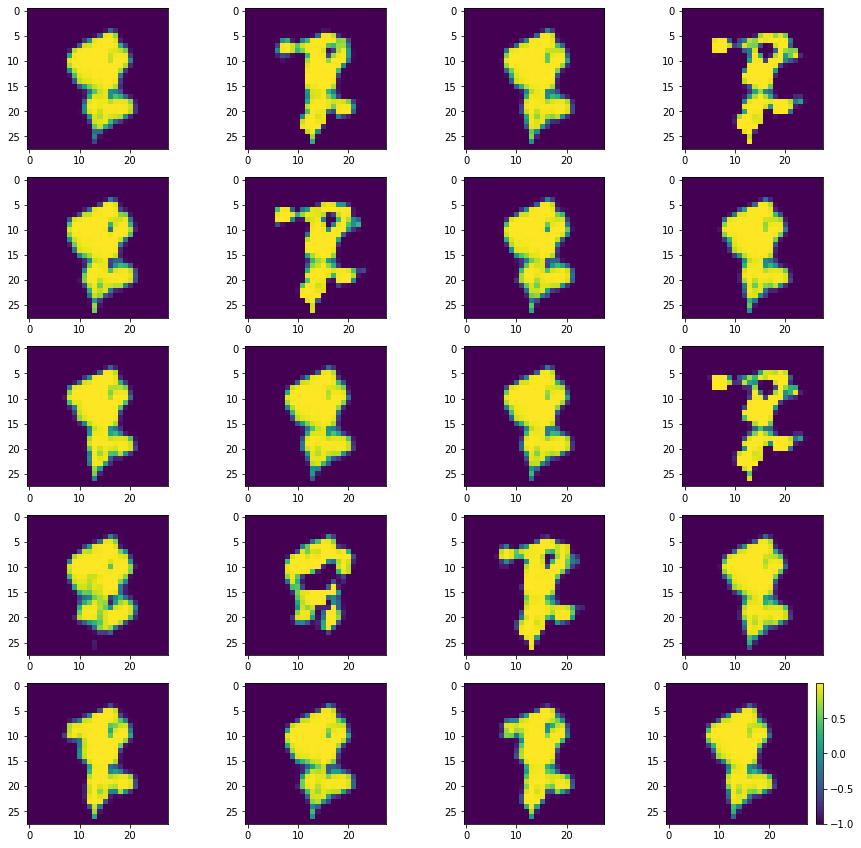

Batch_Num : 152
D_Loss   :   [9.784493446350098, 0.11714470386505127, 9.667348861694336, 0.5, 0.134765625] ;    GAN_Loss   :  [10.397521018981934, 0.6819679737091064, 9.715553283691406, 0.0, 0.095703125]
Batch_Num : 153
D_Loss   :   [10.046154975891113, 0.12123925238847733, 9.924915313720703, 0.5, 0.126953125] ;    GAN_Loss   :  [11.188587188720703, 0.6776467561721802, 10.510940551757812, 0.0, 0.09765625]
Batch_Num : 154
D_Loss   :   [10.059717178344727, 0.16658815741539001, 9.893129348754883, 0.5, 0.138671875] ;    GAN_Loss   :  [10.288899421691895, 0.5246579647064209, 9.764241218566895, 0.0, 0.099609375]
Batch_Num : 155
D_Loss   :   [10.402416229248047, 0.15092018246650696, 10.251496315002441, 0.5, 0.12890625] ;    GAN_Loss   :  [11.021278381347656, 0.598360538482666, 10.422917366027832, 0.0, 0.12890625]
Batch_Num : 156
D_Loss   :   [9.487530708312988, 0.12104738503694534, 9.366483688354492, 0.5, 0.134765625] ;    GAN_Loss   :  [10.306845664978027, 0.5965490937232971, 9.7102966308593

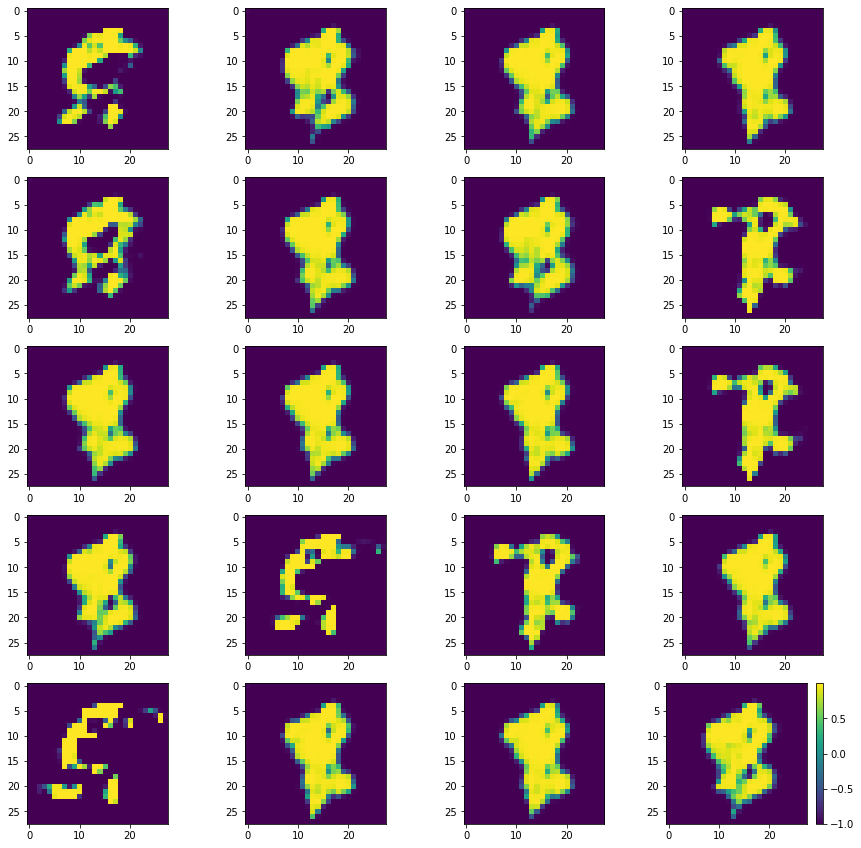

Batch_Num : 167
D_Loss   :   [10.511205673217773, 0.12280053645372391, 10.388404846191406, 0.5, 0.125] ;    GAN_Loss   :  [10.816208839416504, 0.8122463822364807, 10.003962516784668, 0.0, 0.1015625]
Batch_Num : 168
D_Loss   :   [9.578180313110352, 0.1499740332365036, 9.428206443786621, 0.5, 0.091796875] ;    GAN_Loss   :  [10.478719711303711, 0.8024992942810059, 9.676219940185547, 0.0, 0.1015625]
Batch_Num : 169
D_Loss   :   [10.0796480178833, 0.1311779022216797, 9.948470115661621, 0.5, 0.119140625] ;    GAN_Loss   :  [10.926886558532715, 0.9847916960716248, 9.942094802856445, 0.0, 0.103515625]
Batch_Num : 170
D_Loss   :   [10.04797077178955, 0.12322286516427994, 9.924747467041016, 0.5, 0.087890625] ;    GAN_Loss   :  [11.213092803955078, 0.9628901481628418, 10.250203132629395, 0.0, 0.07421875]
Batch_Num : 171
D_Loss   :   [10.389892578125, 0.12174244225025177, 10.268150329589844, 0.5, 0.111328125] ;    GAN_Loss   :  [11.048301696777344, 0.8750124573707581, 10.17328929901123, 0.0, 0.11

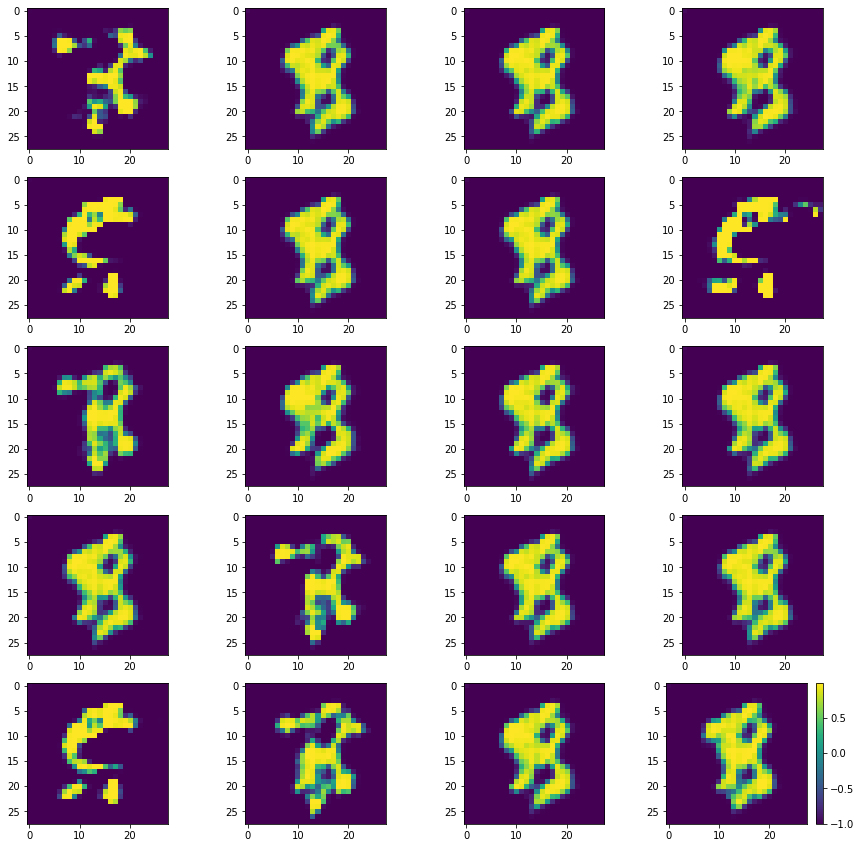

Batch_Num : 182
D_Loss   :   [9.701020240783691, 0.1283620297908783, 9.57265853881836, 0.5, 0.12109375] ;    GAN_Loss   :  [10.267426490783691, 0.5983407497406006, 9.669085502624512, 0.0, 0.103515625]
Batch_Num : 183
D_Loss   :   [10.380523681640625, 0.1550198793411255, 10.225503921508789, 0.5, 0.107421875] ;    GAN_Loss   :  [10.791452407836914, 0.6924452781677246, 10.099006652832031, 0.0, 0.095703125]
Batch_Num : 184
D_Loss   :   [9.83102035522461, 0.12908746302127838, 9.701932907104492, 0.5, 0.10546875] ;    GAN_Loss   :  [10.51555061340332, 0.6360140442848206, 9.879536628723145, 0.0, 0.10546875]
Batch_Num : 185
D_Loss   :   [9.899093627929688, 0.1200033649802208, 9.77908992767334, 0.5, 0.095703125] ;    GAN_Loss   :  [10.534317016601562, 0.5950883030891418, 9.939229011535645, 0.0, 0.115234375]
Batch_Num : 186
D_Loss   :   [9.50737476348877, 0.1398077756166458, 9.36756706237793, 0.5, 0.08203125] ;    GAN_Loss   :  [10.549484252929688, 0.5339035987854004, 10.015580177307129, 0.0, 0.1

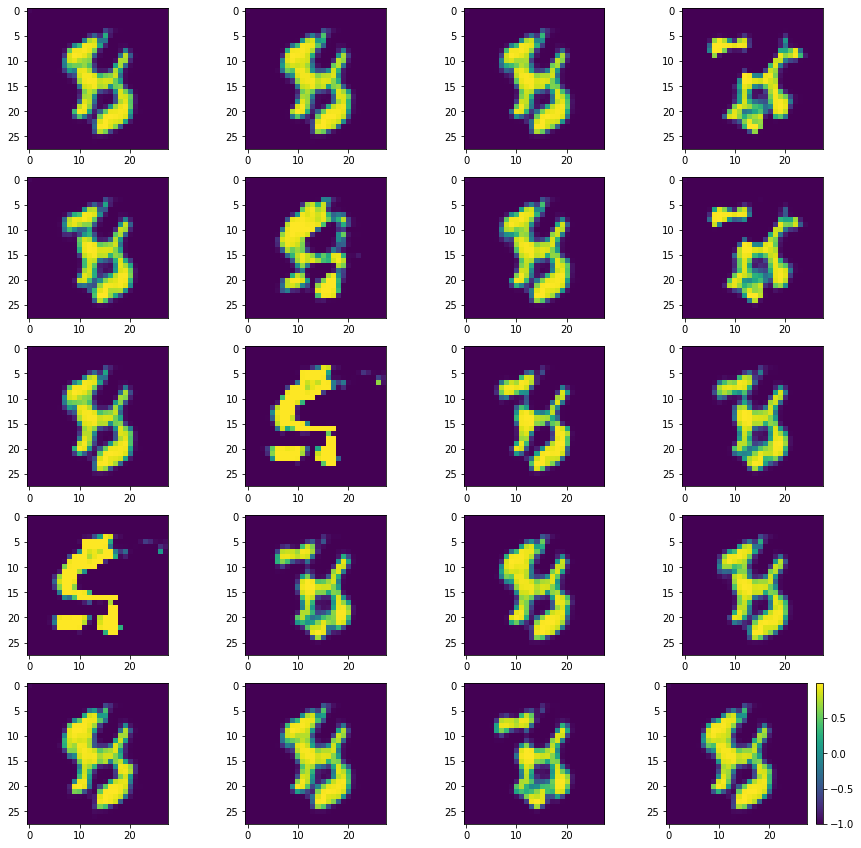

Batch_Num : 197
D_Loss   :   [9.965312957763672, 0.13516005873680115, 9.83015251159668, 0.498046875, 0.109375] ;    GAN_Loss   :  [10.399751663208008, 0.3138850927352905, 10.085866928100586, 0.0, 0.095703125]
Batch_Num : 198
D_Loss   :   [9.657079696655273, 0.11873899400234222, 9.53834056854248, 0.5, 0.107421875] ;    GAN_Loss   :  [10.546707153320312, 0.2931160628795624, 10.253591537475586, 0.0, 0.078125]
Batch_Num : 199
D_Loss   :   [10.582928657531738, 0.1508491039276123, 10.432079315185547, 0.5, 0.125] ;    GAN_Loss   :  [10.62459659576416, 0.5648446679115295, 10.059751510620117, 0.0, 0.087890625]
Batch_Num : 200
D_Loss   :   [10.138389587402344, 0.1281396746635437, 10.010250091552734, 0.498046875, 0.111328125] ;    GAN_Loss   :  [10.589862823486328, 0.5079579949378967, 10.081904411315918, 0.0, 0.087890625]
Batch_Num : 201
D_Loss   :   [10.364673614501953, 0.12273362278938293, 10.241939544677734, 0.498046875, 0.109375] ;    GAN_Loss   :  [10.493532180786133, 0.5299444198608398, 9.9

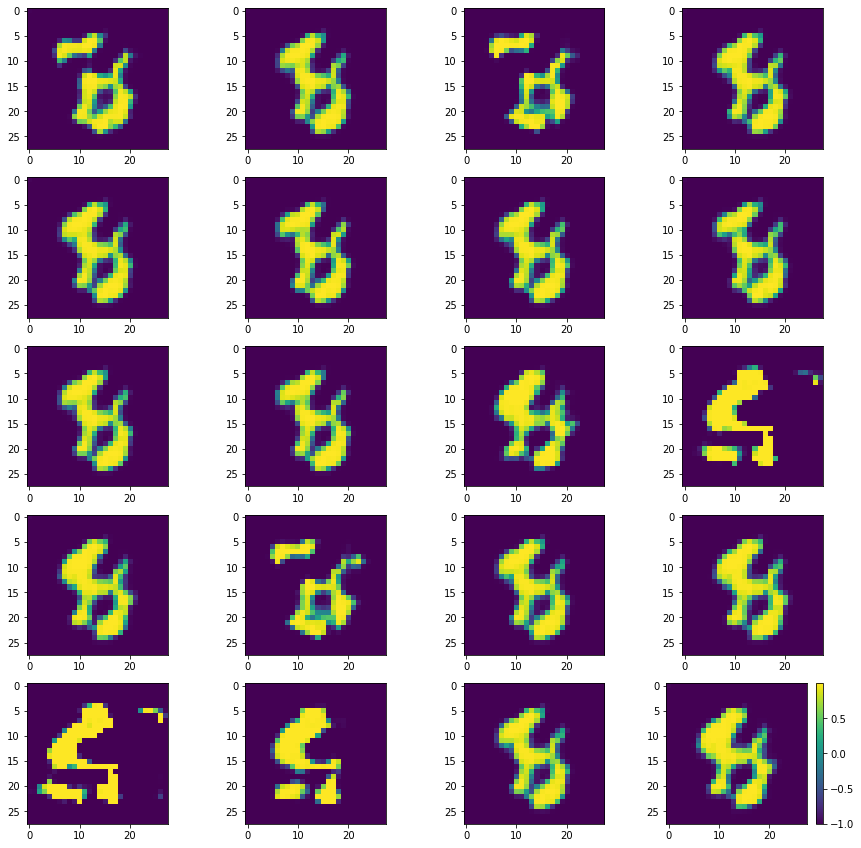

Batch_Num : 212
D_Loss   :   [10.887947082519531, 0.11355292797088623, 10.774394035339355, 0.5, 0.10546875] ;    GAN_Loss   :  [10.726564407348633, 0.5649586915969849, 10.161605834960938, 0.0, 0.119140625]
Batch_Num : 213
D_Loss   :   [9.592399597167969, 0.13032644987106323, 9.46207332611084, 0.5, 0.08984375] ;    GAN_Loss   :  [10.307180404663086, 0.41507816314697266, 9.892102241516113, 0.0, 0.125]
Batch_Num : 214
D_Loss   :   [10.360331535339355, 0.1354673206806183, 10.22486400604248, 0.5, 0.109375] ;    GAN_Loss   :  [10.377102851867676, 0.5109459757804871, 9.866156578063965, 0.0, 0.123046875]
Batch_Num : 215
D_Loss   :   [9.221144676208496, 0.15093711018562317, 9.070207595825195, 0.5, 0.115234375] ;    GAN_Loss   :  [10.454103469848633, 0.44775256514549255, 10.00635051727295, 0.0, 0.103515625]
Batch_Num : 216
D_Loss   :   [10.400726318359375, 0.12349522113800049, 10.277231216430664, 0.5, 0.11328125] ;    GAN_Loss   :  [10.287810325622559, 0.4515834152698517, 9.836226463317871, 0.0,

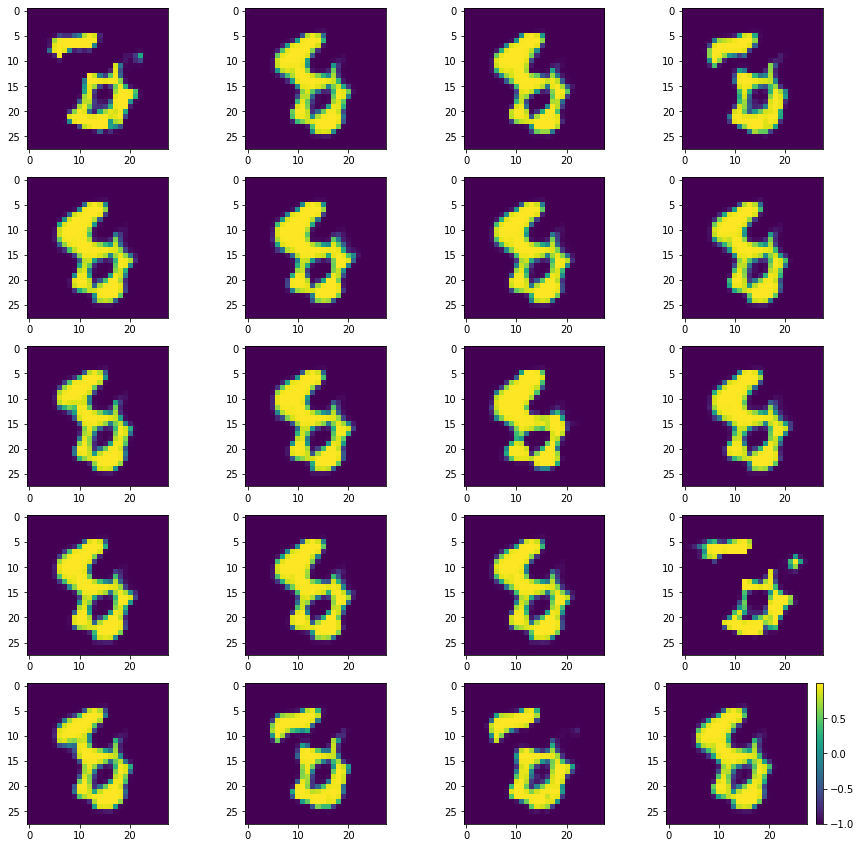

Batch_Num : 227
D_Loss   :   [9.238826751708984, 0.12096573412418365, 9.117860794067383, 0.5, 0.09375] ;    GAN_Loss   :  [10.585848808288574, 0.4635481536388397, 10.12230110168457, 0.0, 0.109375]
Batch_Num : 228
D_Loss   :   [10.333398818969727, 0.1086168885231018, 10.22478199005127, 0.5, 0.11328125] ;    GAN_Loss   :  [10.63331413269043, 0.5154781341552734, 10.117835998535156, 0.0, 0.115234375]
Batch_Num : 229
D_Loss   :   [9.750473022460938, 0.10938895493745804, 9.641083717346191, 0.5, 0.064453125] ;    GAN_Loss   :  [10.58642864227295, 0.48595020174980164, 10.100478172302246, 0.0, 0.12890625]
Batch_Num : 230
D_Loss   :   [10.077374458312988, 0.10999187082052231, 9.967382431030273, 0.5, 0.076171875] ;    GAN_Loss   :  [10.59814739227295, 0.4372679889202118, 10.160879135131836, 0.0, 0.134765625]
Batch_Num : 231
D_Loss   :   [10.317708015441895, 0.11009981483221054, 10.207608222961426, 0.5, 0.115234375] ;    GAN_Loss   :  [10.332480430603027, 0.44434019923210144, 9.888140678405762, 0.

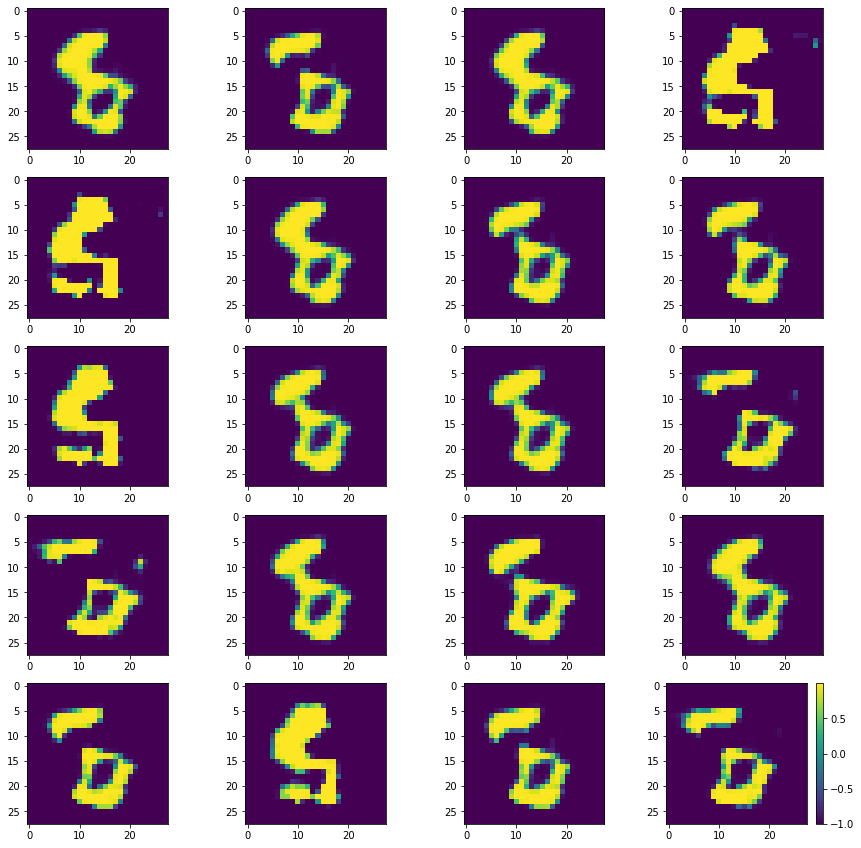

Batch_Num : 2
D_Loss   :   [10.181108474731445, 0.18754132091999054, 9.99356746673584, 0.5, 0.083984375] ;    GAN_Loss   :  [13.273850440979004, 3.7665321826934814, 9.507318496704102, 0.0, 0.09765625]
Batch_Num : 3
D_Loss   :   [10.154709815979004, 0.127144917845726, 10.027565002441406, 0.5, 0.10546875] ;    GAN_Loss   :  [15.743328094482422, 5.253747463226318, 10.489581108093262, 0.0, 0.07421875]
Batch_Num : 4
D_Loss   :   [10.326330184936523, 0.126743882894516, 10.199585914611816, 0.5, 0.1171875] ;    GAN_Loss   :  [13.789239883422852, 3.6886425018310547, 10.100597381591797, 0.0, 0.0859375]
Batch_Num : 5
D_Loss   :   [10.180977821350098, 0.13488301634788513, 10.04609489440918, 0.49609375, 0.08984375] ;    GAN_Loss   :  [12.703147888183594, 2.8865957260131836, 9.81655216217041, 0.0, 0.107421875]
Batch_Num : 6
D_Loss   :   [10.46657657623291, 0.12108100205659866, 10.345495223999023, 0.5, 0.125] ;    GAN_Loss   :  [12.359658241271973, 1.8980830907821655, 10.461575508117676, 0.0, 0.08789

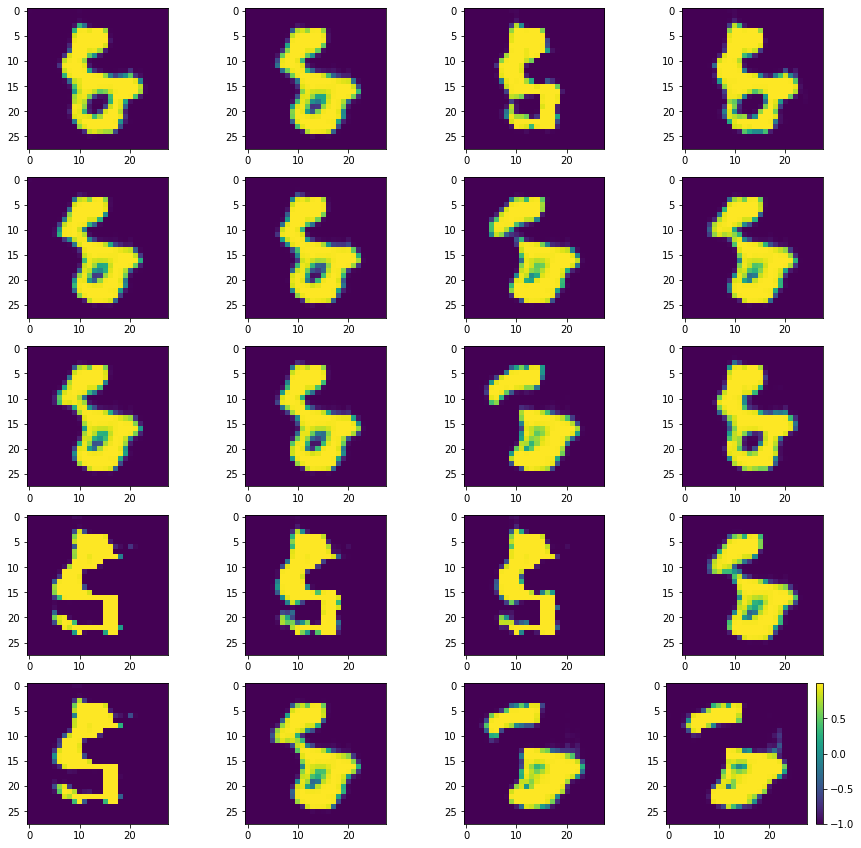

Batch_Num : 17
D_Loss   :   [9.761309623718262, 0.11149033159017563, 9.649819374084473, 0.5, 0.09765625] ;    GAN_Loss   :  [11.957661628723145, 1.218561053276062, 10.739100456237793, 0.0, 0.134765625]
Batch_Num : 18
D_Loss   :   [9.907465934753418, 0.11040273308753967, 9.797062873840332, 0.5, 0.06640625] ;    GAN_Loss   :  [10.900123596191406, 0.8480117321014404, 10.052111625671387, 0.0, 0.09375]
Batch_Num : 19
D_Loss   :   [9.984419822692871, 0.11999595910310745, 9.864423751831055, 0.5, 0.076171875] ;    GAN_Loss   :  [10.702349662780762, 0.8715134859085083, 9.830836296081543, 0.0, 0.091796875]
Batch_Num : 20
D_Loss   :   [9.810246467590332, 0.1174405887722969, 9.692806243896484, 0.5, 0.083984375] ;    GAN_Loss   :  [10.556472778320312, 0.7536437511444092, 9.802828788757324, 0.0, 0.150390625]
Batch_Num : 21
D_Loss   :   [9.651687622070312, 0.11287353187799454, 9.538814544677734, 0.5, 0.064453125] ;    GAN_Loss   :  [11.082649230957031, 0.850673496723175, 10.231975555419922, 0.0, 0.09

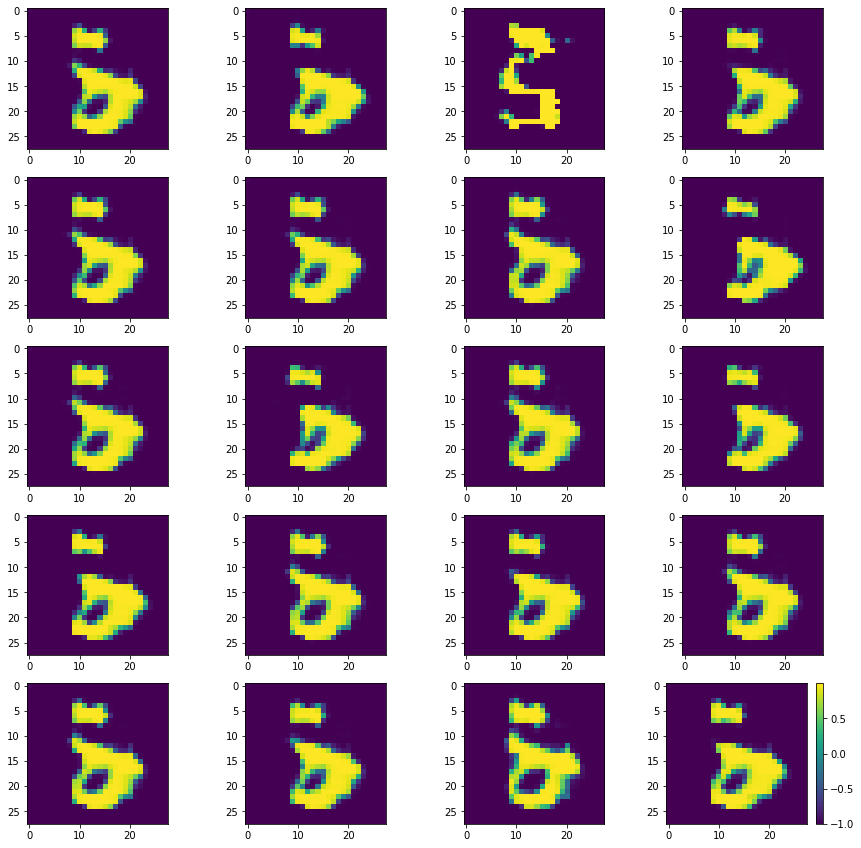

Batch_Num : 32
D_Loss   :   [9.720931053161621, 0.15633061528205872, 9.564599990844727, 0.498046875, 0.09375] ;    GAN_Loss   :  [11.499802589416504, 1.4349021911621094, 10.064900398254395, 0.0, 0.064453125]
Batch_Num : 33
D_Loss   :   [10.274393081665039, 0.11815836280584335, 10.156234741210938, 0.498046875, 0.099609375] ;    GAN_Loss   :  [12.051830291748047, 1.4864392280578613, 10.565390586853027, 0.0, 0.0859375]
Batch_Num : 34
D_Loss   :   [10.358680725097656, 0.14810630679130554, 10.21057415008545, 0.5, 0.107421875] ;    GAN_Loss   :  [11.945169448852539, 1.812868356704712, 10.132301330566406, 0.0, 0.107421875]
Batch_Num : 35
D_Loss   :   [9.583573341369629, 0.12270542234182358, 9.460867881774902, 0.5, 0.06640625] ;    GAN_Loss   :  [11.51909351348877, 1.768306016921997, 9.750787734985352, 0.0, 0.119140625]
Batch_Num : 36
D_Loss   :   [9.672711372375488, 0.13459135591983795, 9.53812026977539, 0.5, 0.109375] ;    GAN_Loss   :  [12.107433319091797, 1.7732348442077637, 10.33419895172

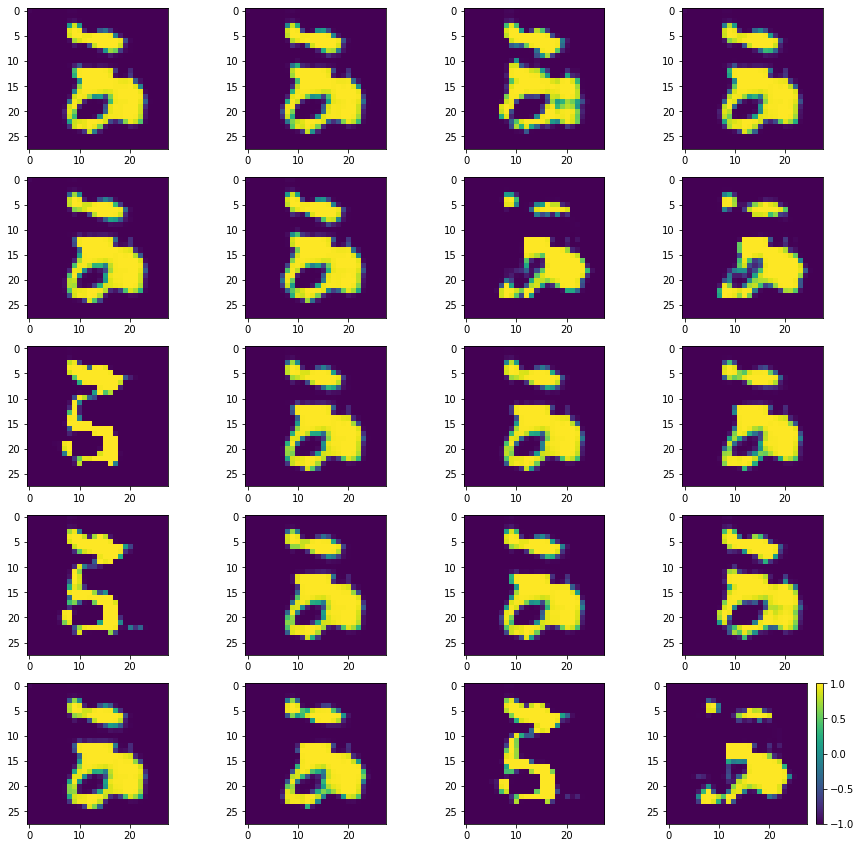

Batch_Num : 47
D_Loss   :   [10.646313667297363, 0.1210779994726181, 10.525236129760742, 0.5, 0.1015625] ;    GAN_Loss   :  [12.1987943649292, 2.236773729324341, 9.962020874023438, 0.0, 0.048828125]
Batch_Num : 48
D_Loss   :   [10.109846115112305, 0.13401636481285095, 9.975830078125, 0.498046875, 0.08203125] ;    GAN_Loss   :  [11.94627857208252, 1.6039037704467773, 10.342374801635742, 0.0, 0.048828125]
Batch_Num : 49
D_Loss   :   [10.06536865234375, 0.1667403131723404, 9.898628234863281, 0.498046875, 0.087890625] ;    GAN_Loss   :  [11.47928524017334, 1.2226835489273071, 10.256601333618164, 0.0, 0.03515625]
Batch_Num : 50
D_Loss   :   [9.76079273223877, 0.13686367869377136, 9.623929023742676, 0.5, 0.09765625] ;    GAN_Loss   :  [10.799788475036621, 0.870374321937561, 9.929413795471191, 0.0, 0.0546875]
Batch_Num : 51
D_Loss   :   [10.390093803405762, 0.13958381116390228, 10.250510215759277, 0.5, 0.091796875] ;    GAN_Loss   :  [10.618658065795898, 0.685154378414154, 9.933504104614258, 

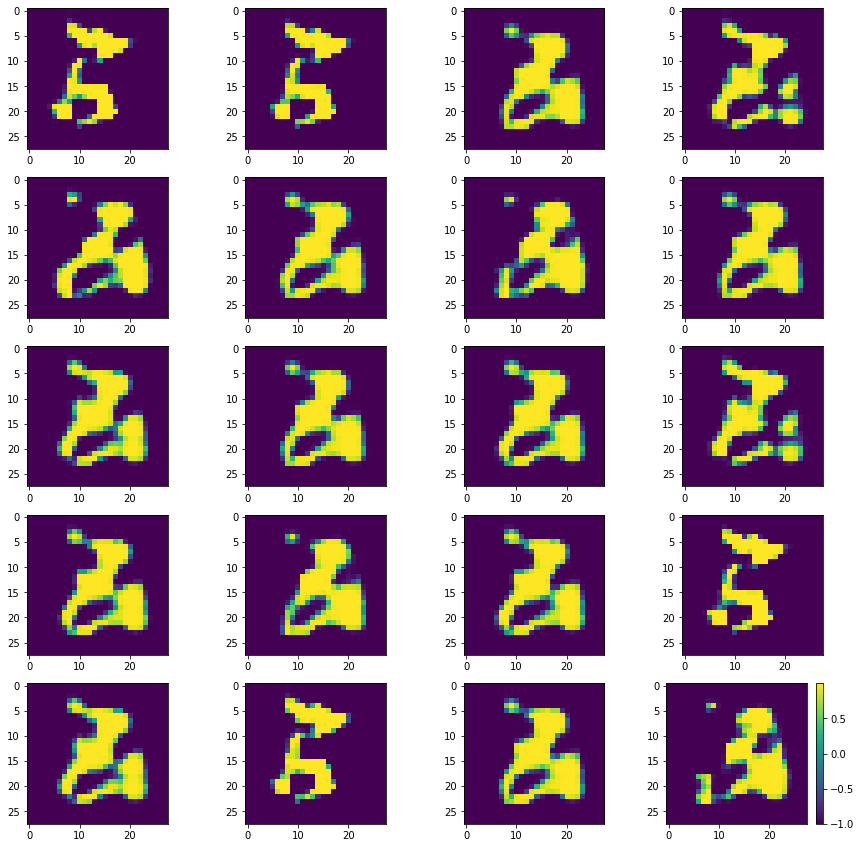

Batch_Num : 62
D_Loss   :   [9.74250602722168, 0.11854959279298782, 9.623956680297852, 0.5, 0.078125] ;    GAN_Loss   :  [10.883623123168945, 1.1295136213302612, 9.754109382629395, 0.0, 0.0546875]
Batch_Num : 63
D_Loss   :   [10.000624656677246, 0.11919485032558441, 9.881429672241211, 0.5, 0.060546875] ;    GAN_Loss   :  [10.726454734802246, 0.9084199070930481, 9.818035125732422, 0.0, 0.048828125]
Batch_Num : 64
D_Loss   :   [9.980921745300293, 0.11667326092720032, 9.864248275756836, 0.5, 0.10546875] ;    GAN_Loss   :  [11.149163246154785, 0.7647170424461365, 10.384446144104004, 0.0, 0.064453125]
Batch_Num : 65
D_Loss   :   [10.118668556213379, 0.1169867217540741, 10.00168228149414, 0.5, 0.0625] ;    GAN_Loss   :  [10.97961711883545, 0.7492791414260864, 10.230338096618652, 0.0, 0.064453125]
Batch_Num : 66
D_Loss   :   [10.759081840515137, 0.1308797299861908, 10.628202438354492, 0.5, 0.060546875] ;    GAN_Loss   :  [10.364246368408203, 0.6448938846588135, 9.719352722167969, 0.0, 0.05664

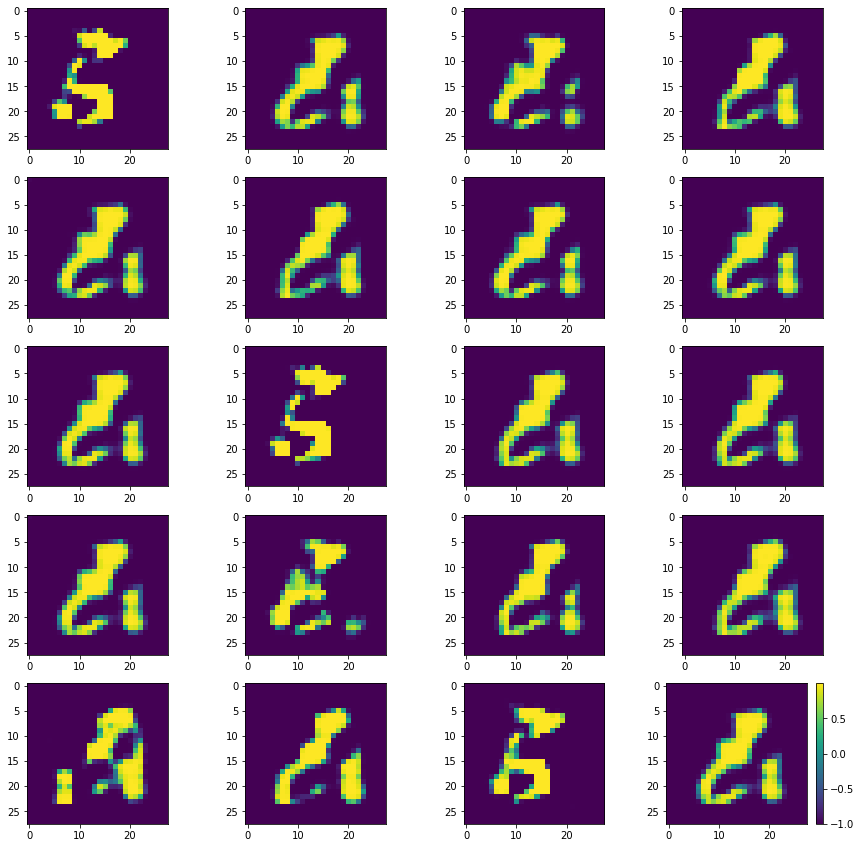

Batch_Num : 77
D_Loss   :   [10.054368019104004, 0.14649231731891632, 9.907876014709473, 0.5, 0.078125] ;    GAN_Loss   :  [10.858972549438477, 0.8769798278808594, 9.981992721557617, 0.0, 0.046875]
Batch_Num : 78
D_Loss   :   [9.683393478393555, 0.12808845937252045, 9.555305480957031, 0.5, 0.076171875] ;    GAN_Loss   :  [10.858491897583008, 0.999812126159668, 9.85867977142334, 0.0, 0.052734375]
Batch_Num : 79
D_Loss   :   [10.467978477478027, 0.131672665476799, 10.336305618286133, 0.5, 0.087890625] ;    GAN_Loss   :  [11.8583345413208, 1.436810851097107, 10.421524047851562, 0.0, 0.046875]
Batch_Num : 80
D_Loss   :   [10.0137939453125, 0.13236507773399353, 9.881428718566895, 0.498046875, 0.091796875] ;    GAN_Loss   :  [12.021608352661133, 1.772665023803711, 10.248943328857422, 0.0, 0.064453125]
Batch_Num : 81
D_Loss   :   [10.255598068237305, 0.14242637157440186, 10.113171577453613, 0.5, 0.095703125] ;    GAN_Loss   :  [11.219528198242188, 1.2761785984039307, 9.943349838256836, 0.0, 0

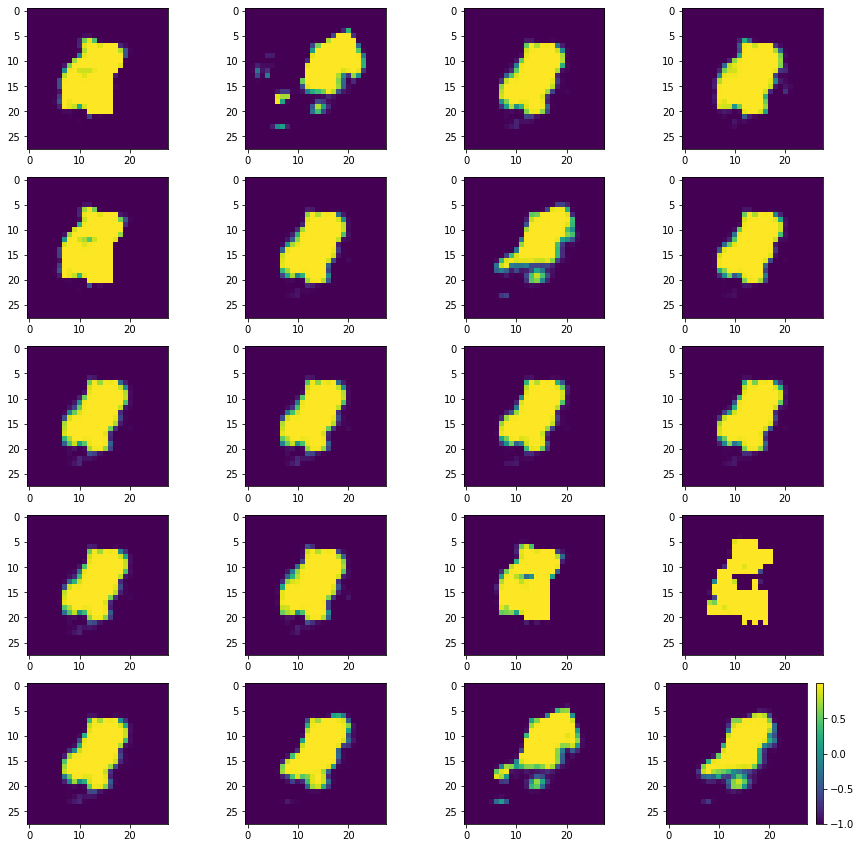

Batch_Num : 92
D_Loss   :   [10.18418025970459, 0.16661228239536285, 10.01756763458252, 0.5, 0.09375] ;    GAN_Loss   :  [32.3966178894043, 20.386173248291016, 12.010445594787598, 0.0, 0.09765625]
Batch_Num : 93
D_Loss   :   [10.616604804992676, 0.16483426094055176, 10.451770782470703, 0.494140625, 0.09765625] ;    GAN_Loss   :  [31.947696685791016, 20.12285041809082, 11.824845314025879, 0.0, 0.0859375]
Batch_Num : 94
D_Loss   :   [10.030076026916504, 0.16371826827526093, 9.866357803344727, 0.5, 0.07421875] ;    GAN_Loss   :  [32.484962463378906, 20.617488861083984, 11.867471694946289, 0.0, 0.107421875]
Batch_Num : 95
D_Loss   :   [10.206470489501953, 0.16030636429786682, 10.046164512634277, 0.5, 0.078125] ;    GAN_Loss   :  [33.999664306640625, 22.960485458374023, 11.039180755615234, 0.0, 0.064453125]
Batch_Num : 96
D_Loss   :   [9.784340858459473, 0.18283076584339142, 9.601510047912598, 0.494140625, 0.08984375] ;    GAN_Loss   :  [38.32853317260742, 26.137908935546875, 12.19062328338

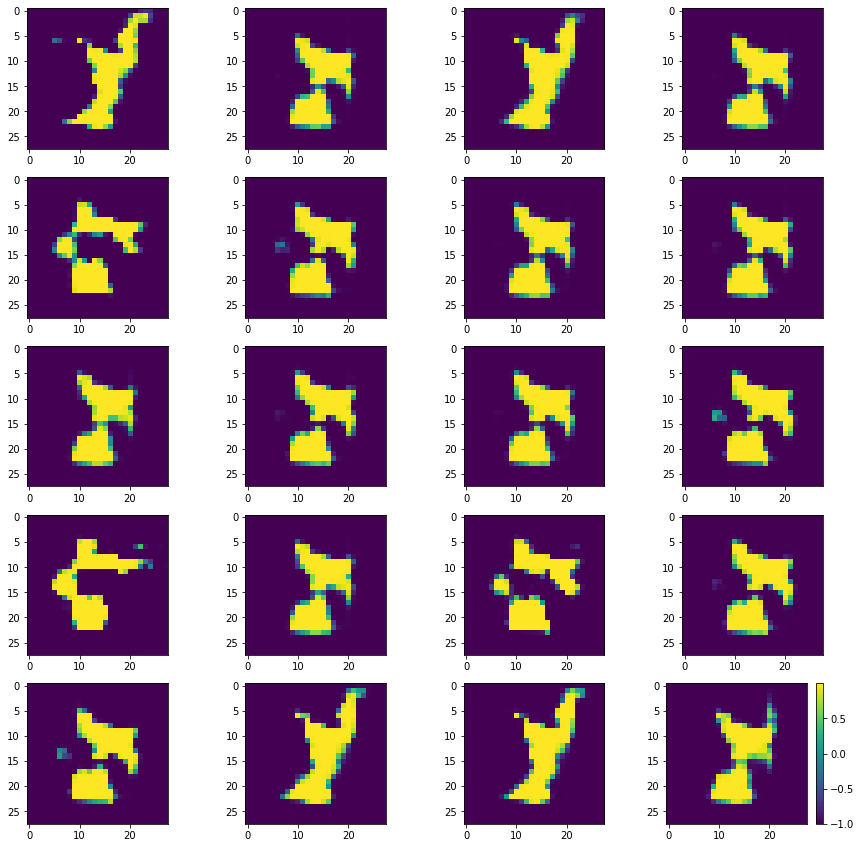

Batch_Num : 107
D_Loss   :   [10.004589080810547, 0.13137349486351013, 9.873215675354004, 0.498046875, 0.072265625] ;    GAN_Loss   :  [32.21393966674805, 20.040002822875977, 12.17393684387207, 0.0, 0.078125]
Batch_Num : 108
D_Loss   :   [9.454607009887695, 0.14868734776973724, 9.305919647216797, 0.5, 0.08203125] ;    GAN_Loss   :  [28.720014572143555, 17.624465942382812, 11.095548629760742, 0.0, 0.099609375]
Batch_Num : 109
D_Loss   :   [9.651599884033203, 0.13000601530075073, 9.521594047546387, 0.5, 0.072265625] ;    GAN_Loss   :  [26.968379974365234, 15.413700103759766, 11.554679870605469, 0.0, 0.068359375]
Batch_Num : 110
D_Loss   :   [10.425562858581543, 0.2017764300107956, 10.223786354064941, 0.49609375, 0.107421875] ;    GAN_Loss   :  [26.634838104248047, 15.566143035888672, 11.068695068359375, 0.0, 0.099609375]
Batch_Num : 111
D_Loss   :   [9.637078285217285, 0.2318214327096939, 9.405257225036621, 0.5, 0.068359375] ;    GAN_Loss   :  [29.499418258666992, 18.000608444213867, 11.

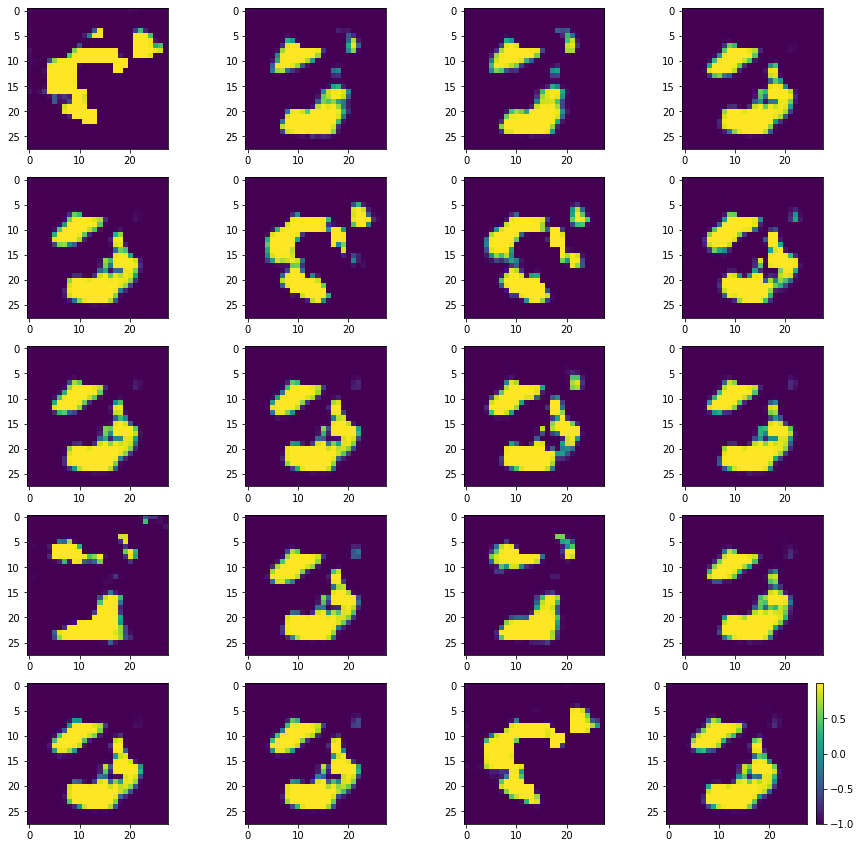

Batch_Num : 122
D_Loss   :   [10.58769416809082, 0.18920454382896423, 10.398489952087402, 0.498046875, 0.08984375] ;    GAN_Loss   :  [14.937957763671875, 4.439733982086182, 10.498224258422852, 0.0, 0.11328125]
Batch_Num : 123
D_Loss   :   [9.949653625488281, 0.1769694685935974, 9.772684097290039, 0.5, 0.11328125] ;    GAN_Loss   :  [17.277114868164062, 6.987939357757568, 10.289175033569336, 0.0, 0.072265625]
Batch_Num : 124
D_Loss   :   [10.25025463104248, 0.13654543459415436, 10.113709449768066, 0.498046875, 0.076171875] ;    GAN_Loss   :  [19.16606903076172, 9.002718925476074, 10.163349151611328, 0.0, 0.103515625]
Batch_Num : 125
D_Loss   :   [10.437834739685059, 0.1385864019393921, 10.299248695373535, 0.5, 0.095703125] ;    GAN_Loss   :  [20.251005172729492, 9.652714729309082, 10.59829044342041, 0.0, 0.111328125]
Batch_Num : 126
D_Loss   :   [10.37213134765625, 0.12524449825286865, 10.24688720703125, 0.5, 0.111328125] ;    GAN_Loss   :  [19.498451232910156, 9.301116943359375, 10.19

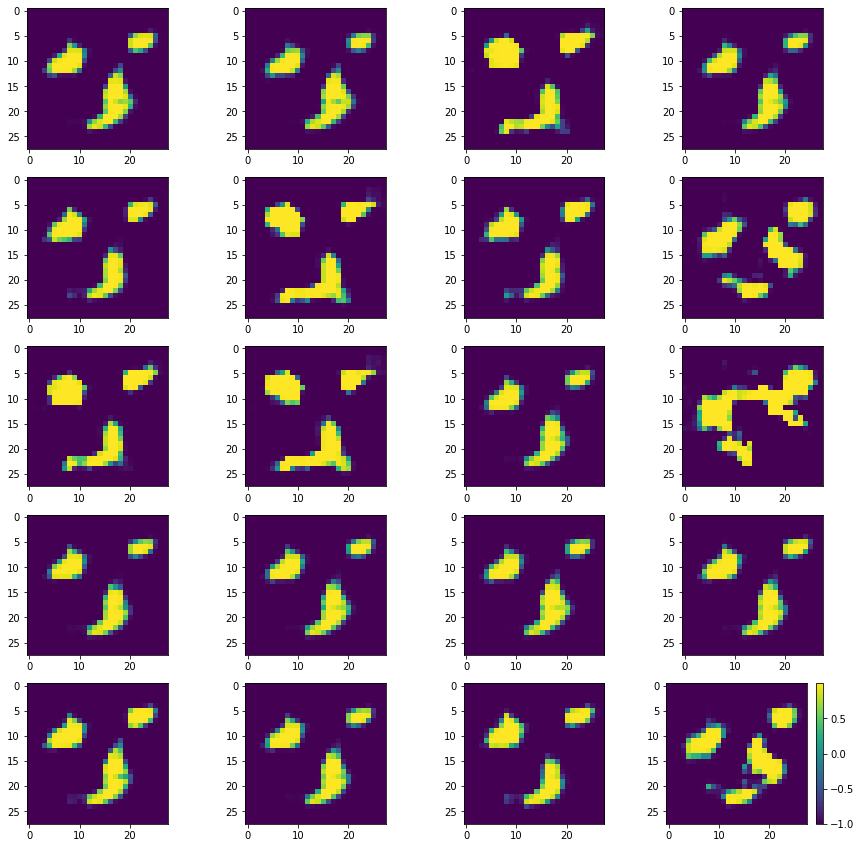

Batch_Num : 137
D_Loss   :   [10.764233589172363, 0.13559158146381378, 10.628642082214355, 0.5, 0.13671875] ;    GAN_Loss   :  [16.905710220336914, 6.908733367919922, 9.996976852416992, 0.0, 0.138671875]
Batch_Num : 138
D_Loss   :   [10.03113842010498, 0.14067775011062622, 9.890460968017578, 0.5, 0.111328125] ;    GAN_Loss   :  [17.504844665527344, 7.628083229064941, 9.876761436462402, 0.0, 0.13671875]
Batch_Num : 139
D_Loss   :   [9.909754753112793, 0.11338523775339127, 9.796369552612305, 0.5, 0.12890625] ;    GAN_Loss   :  [17.11233901977539, 7.104031085968018, 10.008307456970215, 0.0, 0.12890625]
Batch_Num : 140
D_Loss   :   [9.50157356262207, 0.1090952455997467, 9.392477989196777, 0.5, 0.099609375] ;    GAN_Loss   :  [20.297348022460938, 9.940043449401855, 10.357304573059082, 0.0, 0.103515625]
Batch_Num : 141
D_Loss   :   [10.098426818847656, 0.12890782952308655, 9.969518661499023, 0.5, 0.10546875] ;    GAN_Loss   :  [16.937686920166016, 6.758838653564453, 10.178849220275879, 0.0, 

KeyboardInterrupt: ignored

In [ ]:

def train_generator_discriminator (g_model, d_model, gan_model, datasetx, datasety, epochs = 50, input_len = 100, batch_size = 256):
    num_batches = floor(datasetx.shape[0]/batch_size);
    for i in range(epochs):
        print('Epoch : '+ str(i+1))
        for j in range(num_batches):
            print('Batch_Num : '+ str(j+1))
            image_batch = datasetx[j*batch_size : (j+1)*batch_size]
            label_batch = datasety[j*batch_size : (j+1)*batch_size]

            # generate a new batch of noise
            noise = np.random.uniform(-1, 1, (len(image_batch), latent_size))

            # sample some labels from p_c
            sampled_labels = np.random.randint(0, num_classes, len(image_batch))

            # generate a batch of fake images, using the generated labels as a
            # conditioner. We reshape the sampled labels to be
            # (len(image_batch), 1) so that we can feed them into the embedding
            # layer as a length one sequence
            generated_images = generator.predict([noise, sampled_labels.reshape((-1, 1))], verbose=0)

            x = np.concatenate((image_batch, generated_images))

            soft_zero, soft_one = 0, 0.95

            y = np.array([soft_one] * len(image_batch) + [soft_zero] * len(image_batch))
            aux_y = np.concatenate((label_batch, sampled_labels), axis=0)

            disc_sample_weight = [np.ones(2 * len(image_batch)),
                                  np.concatenate((np.ones(len(image_batch)) * 2,
                                                  np.zeros(len(image_batch))))]

            # see if the discriminator can figure itself out...
            d_loss = d_model.train_on_batch(x, [y, aux_y], sample_weight=disc_sample_weight)
            # make new noise. we generate 2 * batch size here such that we have
            # the generator optimize over an identical number of images as the
            # discriminator
            noise = np.random.uniform(-1, 1, (2 * len(image_batch), latent_size))
            sampled_labels = np.random.randint(0, num_classes, 2 * len(image_batch))

            # we want to train the generator to trick the discriminator
            # For the generator, we want all the {fake, not-fake} labels to say
            # not-fake
            trick = np.ones(2 * len(image_batch)) * soft_one

            gan_loss = gan_model.train_on_batch( [noise, sampled_labels.reshape((-1, 1))], [trick, sampled_labels])

            print("D_Loss   :   "+str(d_loss)+" ;    GAN_Loss   :  "+str(gan_loss))


            if j%15 == 0:
              noise = np.random.uniform(-1, 1, (20, latent_size))

            # sample some labels from p_c
              sampled_labels = np.random.randint(0, num_classes, 20)
              data = [noise, sampled_labels.reshape((-1, 1))]
              plot_predictions(generator, data)


'''
            print('Batch_Num : '+ str(j+1))
            d_model.trainable = True
            generator_x, generator_y = generator_fake_samples(input_len, floor(batch_size/2))
            fakex = g_model(generator_x)
            fakey = np.ones((floor(batch_size/2),1))
            realx, realy = discriminator_real_samples(dataset, floor(batch_size/2))
            print(fakex.shape, fakey.shape, realx.shape, realy.shape)
            batchx = np.concatenate((fakex, realx))
            batchy = np.concatenate((fakey, realy), axis = 0)
            d_model.fit(batchx, batchy)
            d_model.trainable = False
            gan_model.fit(generator_x, generator_y)
            if(j%30==0):
                x, _ = generator_fake_samples(10, 24)
                plot_predictions(generator, x)
        if (i%5==0):
            gan_model.save('Gan_'+str(1+i/5)+'.h5')
            
            
gan = load_model("GAN_1.h5")   '''      
train_generator_discriminator(generator, discriminator, gan, trainx, trainy)

In [ ]:
generator.save("Generator1.h5")
discriminator.save("Discriminator1.h5")
gan.save("GAN1.h5")
#files.download("GAN1.h5")
files.download("Generator1.h5")
files.download("Discriminator1.h5")